In [1]:
from __future__ import division

import math
import cv2
import numpy as np
import matplotlib.pyplot as plt

from keras.preprocessing.image import Iterator
from keras.utils.np_utils import to_categorical
import keras.backend as K


def angle_difference(x, y):
    """
    Calculate minimum difference between two angles.
    """
    return 180 - abs(abs(x - y) - 180)


def angle_error(y_true, y_pred):
    """
    Calculate the mean diference between the true angles
                                            and the predicted angles. Ea`~~~~
    """
    diff = angle_difference(K.argmax(y_true), K.argmax(y_pred))
    return K.mean(K.cast(K.abs(diff), K.floatx()))


def angle_error_regression(y_true, y_pred):
    """
    Calculate the mean diference between the true angles
    and the predicted angles. Each angle is represented
    as a float number between 0 and 1.
    """
    return K.mean(angle_difference(y_true * 360, y_pred * 360))


def binarize_images(x):
    """
    Convert images to range 0-1 and binarize them by making
    0 the values below 0.1 and 1 the values above 0.1.
    """
    x /= 255
    x[x >= 0.1] = 1
    x[x < 0.1] = 0
    return x


def rotate(image, angle):
    """
    Rotates an OpenCV 2 / NumPy image about it's centre by the given angle
    (in degrees). The returned image will be large enough to hold the entire
    new image, with a black background
    Source: http://stackoverflow.com/questions/16702966/rotate-image-and-crop-out-black-borders
    """
    # Get the image size
    # No that's not an error - NumPy stores image matricies backwards
    image_size = (image.shape[1], image.shape[0])
    image_center = tuple(np.array(image_size) / 2)

    # Convert the OpenCV 3x2 rotation matrix to 3x3
    rot_mat = np.vstack(
        [cv2.getRotationMatrix2D(image_center, angle, 1.0), [0, 0, 1]]
    )

    rot_mat_notranslate = np.matrix(rot_mat[0:2, 0:2])

    # Shorthand for below calcs
    image_w2 = image_size[0] * 0.5
    image_h2 = image_size[1] * 0.5

    # Obtain the rotated coordinates of the image corners
    rotated_coords = [
        (np.array([-image_w2,  image_h2]) * rot_mat_notranslate).A[0],
        (np.array([ image_w2,  image_h2]) * rot_mat_notranslate).A[0],
        (np.array([-image_w2, -image_h2]) * rot_mat_notranslate).A[0],
        (np.array([ image_w2, -image_h2]) * rot_mat_notranslate).A[0]
    ]

    # Find the size of the new image
    x_coords = [pt[0] for pt in rotated_coords]
    x_pos = [x for x in x_coords if x > 0]
    x_neg = [x for x in x_coords if x < 0]

    y_coords = [pt[1] for pt in rotated_coords]
    y_pos = [y for y in y_coords if y > 0]
    y_neg = [y for y in y_coords if y < 0]

    right_bound = max(x_pos)
    left_bound = min(x_neg)
    top_bound = max(y_pos)
    bot_bound = min(y_neg)

    new_w = int(abs(right_bound - left_bound))
    new_h = int(abs(top_bound - bot_bound))

    # We require a translation matrix to keep the image centred
    trans_mat = np.matrix([
        [1, 0, int(new_w * 0.5 - image_w2)],
        [0, 1, int(new_h * 0.5 - image_h2)],
        [0, 0, 1]
    ])

    # Compute the tranform for the combined rotation and translation
    affine_mat = (np.matrix(trans_mat) * np.matrix(rot_mat))[0:2, :]

    # Apply the transform
    result = cv2.warpAffine(
        image,
        affine_mat,
        (new_w, new_h),
        flags=cv2.INTER_LINEAR
    )

    return result


def largest_rotated_rect(w, h, angle):
    """
    Given a rectangle of size wxh that has been rotated by 'angle' (in
    radians), computes the width and height of the largest possible
    axis-aligned rectangle within the rotated rectangle.
    Original JS code by 'Andri' and Magnus Hoff from Stack Overflow
    Converted to Python by Aaron Snoswell
    Source: http://stackoverflow.com/questions/16702966/rotate-image-and-crop-out-black-borders
    """

    quadrant = int(math.floor(angle / (math.pi / 2))) & 3
    sign_alpha = angle if ((quadrant & 1) == 0) else math.pi - angle
    alpha = (sign_alpha % math.pi + math.pi) % math.pi

    bb_w = w * math.cos(alpha) + h * math.sin(alpha)
    bb_h = w * math.sin(alpha) + h * math.cos(alpha)

    gamma = math.atan2(bb_w, bb_w) if (w < h) else math.atan2(bb_w, bb_w)

    delta = math.pi - alpha - gamma

    length = h if (w < h) else w

    d = length * math.cos(alpha)
    a = d * math.sin(alpha) / math.sin(delta)

    y = a * math.cos(gamma)
    x = y * math.tan(gamma)

    return (
        bb_w - 2 * x,
        bb_h - 2 * y
    )


def crop_around_center(image, width, height):
    """
    Given a NumPy / OpenCV 2 image, crops it to the given width and height,
    around it's centre point
    Source: http://stackoverflow.com/questions/16702966/rotate-image-and-crop-out-black-borders
    """

    image_size = (image.shape[1], image.shape[0])
    image_center = (int(image_size[0] * 0.5), int(image_size[1] * 0.5))

    if(width > image_size[0]):
        width = image_size[0]

    if(height > image_size[1]):
        height = image_size[1]

    x1 = int(image_center[0] - width * 0.5)
    x2 = int(image_center[0] + width * 0.5)
    y1 = int(image_center[1] - height * 0.5)
    y2 = int(image_center[1] + height * 0.5)

    return image[y1:y2, x1:x2]


def crop_largest_rectangle(image, angle, height, width):
    """
    Crop around the center the largest possible rectangle
    found with largest_rotated_rect.
    """
    return crop_around_center(
        image,
        *largest_rotated_rect(
            width,
            height,
            math.radians(angle)
        )
    )


def generate_rotated_image(image, angle, size=None, crop_center=False,
                           crop_largest_rect=False):
    """
    Generate a valid rotated image for the RotNetDataGenerator. If the
    image is rectangular, the crop_center option should be used to make
    it square. To crop out the black borders after rotation, use the
    crop_largest_rect option. To resize the final image, use the size
    option.
    """
    height, width = image.shape[:2]
    if crop_center:
        if width < height:
            height = width
        else:
            width = height

    image = rotate(image, angle)

    if crop_largest_rect:
        image = crop_largest_rectangle(image, angle, height, width)

    if size:
        image = cv2.resize(image, size)

    return image


class RotNetDataGenerator(Iterator):
    """
    Given a NumPy array of images or a list of image paths,
    generate batches of rotated images and rotation angles on-the-fly.
    """

    def __init__(self, input, input_shape=None, color_mode='rgb', batch_size=64,
                 one_hot=True, preprocess_func=None, rotate=True, crop_center=False,
                 crop_largest_rect=False, shuffle=False, seed=None):

        self.images = None
        self.filenames = None
        self.input_shape = input_shape
        self.color_mode = color_mode
        self.batch_size = batch_size
        self.one_hot = one_hot
        self.preprocess_func = preprocess_func
        self.rotate = rotate
        self.crop_center = crop_center
        self.crop_largest_rect = crop_largest_rect
        self.shuffle = shuffle

        if self.color_mode not in {'rgb', 'grayscale'}:
            raise ValueError('Invalid color mode:', self.color_mode,
                             '; expected "rgb" or "grayscale".')

        # check whether the input is a NumPy array or a list of paths
        if isinstance(input, (np.ndarray)):
            self.images = input
            N = self.images.shape[0]
            if not self.input_shape:
                self.input_shape = self.images.shape[1:]
                # add dimension if the images are greyscale
                if len(self.input_shape) == 2:
                    self.input_shape = self.input_shape + (1,)
        else:
            self.filenames = input
            N = len(self.filenames)

        super(RotNetDataGenerator, self).__init__(N, batch_size, shuffle, seed)

    def _get_batches_of_transformed_samples(self, index_array):
        # create array to hold the images
        batch_x = np.zeros((len(index_array),) + self.input_shape, dtype='float32')
        # create array to hold the labels
        batch_y = np.zeros(len(index_array), dtype='float32')

        # iterate through the current batch
        for i, j in enumerate(index_array):
            if self.filenames is None:
                image = self.images[j]
            else:
                is_color = int(self.color_mode == 'rgb')
                image = cv2.imread(self.filenames[j], is_color)
                if is_color:
                    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

            if self.rotate:
                # get a random angle
                

                #foo = [0,90,180,270,355]
                #print(random.choice(foo))
                rotation_angle = np.random.randint(360)
                #rotation_angle =random.choice(foo) 
            else:
                rotation_angle = 0

            # generate the rotated image
            rotated_image = generate_rotated_image(
                image,
                rotation_angle,
                size=self.input_shape[:2],
                crop_center=self.crop_center,
                crop_largest_rect=self.crop_largest_rect
            )

            # add dimension to account for the channels if the image is greyscale
            if rotated_image.ndim == 2:
                rotated_image = np.expand_dims(rotated_image, axis=2)

            # store the image and label in their corresponding batches
            batch_x[i] = rotated_image
            batch_y[i] = rotation_angle

        if self.one_hot:
            # convert the numerical labels to binary labels
            batch_y = to_categorical(batch_y, 360)
        else:
            batch_y /= 360

        # preprocess input images
        if self.preprocess_func:
            batch_x = self.preprocess_func(batch_x)

        return batch_x, batch_y

    def next(self):
        with self.lock:
            # get input data index and size of the current batch
            index_array = next(self.index_generator)
        # create array to hold the images
        return self._get_batches_of_transformed_samples(index_array)


def display_examples(model, input, num_images=5, size=None, crop_center=False,
                     crop_largest_rect=False, preprocess_func=None, save_path=None):
    """
    Given a model that predicts the rotation angle of an image,
    and a NumPy array of images or a list of image paths, display
    the specified number of example images in three columns:
    Original, Rotated and Corrected.
    """

    if isinstance(input, (np.ndarray)):
        images = input
        N, h, w = images.shape[:3]
        if not size:
            size = (h, w)
        indexes = np.random.choice(N, num_images)
        images = images[indexes, ...]
    else:
        images = []
        filenames = input
        N = len(filenames)
        indexes = np.random.choice(N, num_images)
        for i in indexes:
            image = cv2.imread(filenames[i])
            image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
            images.append(image)
        images = np.asarray(images)

    x = []
    y = []
    for image in images:
        rotation_angle = np.random.randint(360)
        rotated_image = generate_rotated_image(
            image,
            rotation_angle,
            size=size,
            crop_center=crop_center,
            crop_largest_rect=crop_largest_rect
        )
        x.append(rotated_image)
        y.append(rotation_angle)

    x = np.asarray(x, dtype='float32')
    y = np.asarray(y, dtype='float32')

    if x.ndim == 3:
        x = np.expand_dims(x, axis=3)

    y = to_categorical(y, 360)

    x_rot = np.copy(x)

    if preprocess_func:
        x = preprocess_func(x)

    y = np.argmax(y, axis=1)
    y_pred = np.argmax(model.predict(x), axis=1)

    plt.figure(figsize=(10.0, 2 * num_images))

    title_fontdict = {
        'fontsize': 14,
        'fontweight': 'bold'
    }

    fig_number = 0
    for rotated_image, true_angle, predicted_angle in zip(x_rot, y, y_pred):
        original_image = rotate(rotated_image, -true_angle)
        if crop_largest_rect:
            original_image = crop_largest_rectangle(original_image, -true_angle, *size)

        corrected_image = rotate(rotated_image, -predicted_angle)
        if crop_largest_rect:
            corrected_image = crop_largest_rectangle(corrected_image, -predicted_angle, *size)

        if x.shape[3] == 1:
            options = {'cmap': 'gray'}
        else:
            options = {}

        fig_number += 1
        ax = plt.subplot(num_images, 3, fig_number)
        if fig_number == 1:
            plt.title('Original\n', fontdict=title_fontdict)
        plt.imshow(np.squeeze(original_image).astype('uint8'), **options)
        plt.axis('off')

        fig_number += 1
        ax = plt.subplot(num_images, 3, fig_number)
        if fig_number == 2:
            plt.title('Rotated\n', fontdict=title_fontdict)
        ax.text(
            0.5, 1.03, 'Angle: {0}'.format(true_angle),
            horizontalalignment='center',
            transform=ax.transAxes,
            fontsize=11
        )
        plt.imshow(np.squeeze(rotated_image).astype('uint8'), **options)
        plt.axis('off')

        fig_number += 1
        ax = plt.subplot(num_images, 3, fig_number)
        corrected_angle = angle_difference(predicted_angle, true_angle)
        if fig_number == 3:
            plt.title('Corrected\n', fontdict=title_fontdict)
        ax.text(
            0.5, 1.03, 'Angle: {0}'.format(corrected_angle),
            horizontalalignment='center',
            transform=ax.transAxes,
            fontsize=11
        )
        plt.imshow(np.squeeze(corrected_image).astype('uint8'), **options)
        plt.axis('off')

    plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)

    if save_path:
        plt.savefig(save_path)

/home/paperspace/anaconda3/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
import tensorflow as tf
TF_CUDNN_WORKSPACE_LIMIT_IN_MB=6000

In [3]:
from __future__ import division

import math
import cv2
import numpy as np
#import matplotlib.pyplot as plt

from keras.preprocessing.image import Iterator
from keras.utils.np_utils import to_categorical
import keras.backend as K
from __future__ import print_function

import os
import sys

from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard
from keras.datasets import mnist
from keras.layers import Dense, Dropout, Flatten, Input
from keras.layers import Conv2D, MaxPooling2D
from keras.models import Model

In [5]:
## Resizing
import os
rootDir = "/home/paperspace"
num=0
image_paths = []

for dir_, _, files in os.walk(rootDir):
    for fileName in files:
        if fileName.endswith(".tif"):
            relDir = os.path.relpath(dir_, rootDir)
            relFile = os.path.join(relDir, fileName)
            relFile = os.path.join(os.getcwd(), relFile)
            img = cv2.imread(relFile)
            if img is not None:
             gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
             resize_img = cv2.resize(img  , (224 , 224))
             cv2.imwrite('gausin_'+str(num)+'.jpg', resize_img)
             print('gausin_'+str(num)+'.jpg')
             image_paths.append(relFile)
             num= num+1

gausin_0.jpg
gausin_1.jpg
gausin_2.jpg
gausin_3.jpg
gausin_4.jpg
gausin_5.jpg
gausin_6.jpg
gausin_7.jpg
gausin_8.jpg
gausin_9.jpg
gausin_10.jpg
gausin_11.jpg
gausin_12.jpg
gausin_13.jpg
gausin_14.jpg
gausin_15.jpg
gausin_16.jpg
gausin_17.jpg
gausin_18.jpg
gausin_19.jpg
gausin_20.jpg
gausin_21.jpg
gausin_22.jpg
gausin_23.jpg
gausin_24.jpg
gausin_25.jpg
gausin_26.jpg
gausin_27.jpg
gausin_28.jpg
gausin_29.jpg
gausin_30.jpg
gausin_31.jpg
gausin_32.jpg
gausin_33.jpg
gausin_34.jpg
gausin_35.jpg
gausin_36.jpg
gausin_37.jpg
gausin_38.jpg
gausin_39.jpg
gausin_40.jpg
gausin_41.jpg
gausin_42.jpg
gausin_43.jpg
gausin_44.jpg
gausin_45.jpg
gausin_46.jpg
gausin_47.jpg
gausin_48.jpg
gausin_49.jpg
gausin_50.jpg
gausin_51.jpg
gausin_52.jpg
gausin_53.jpg
gausin_54.jpg
gausin_55.jpg
gausin_56.jpg
gausin_57.jpg
gausin_58.jpg
gausin_59.jpg
gausin_60.jpg
gausin_61.jpg
gausin_62.jpg
gausin_63.jpg
gausin_64.jpg
gausin_65.jpg
gausin_66.jpg
gausin_67.jpg
gausin_68.jpg
gausin_69.jpg
gausin_70.jpg
gausin_71.jpg
ga

gausin_561.jpg
gausin_562.jpg
gausin_563.jpg
gausin_564.jpg
gausin_565.jpg
gausin_566.jpg
gausin_567.jpg
gausin_568.jpg
gausin_569.jpg
gausin_570.jpg
gausin_571.jpg
gausin_572.jpg
gausin_573.jpg
gausin_574.jpg
gausin_575.jpg
gausin_576.jpg
gausin_577.jpg
gausin_578.jpg
gausin_579.jpg
gausin_580.jpg
gausin_581.jpg
gausin_582.jpg
gausin_583.jpg
gausin_584.jpg
gausin_585.jpg
gausin_586.jpg
gausin_587.jpg
gausin_588.jpg
gausin_589.jpg
gausin_590.jpg
gausin_591.jpg
gausin_592.jpg
gausin_593.jpg
gausin_594.jpg
gausin_595.jpg
gausin_596.jpg
gausin_597.jpg
gausin_598.jpg
gausin_599.jpg
gausin_600.jpg
gausin_601.jpg
gausin_602.jpg
gausin_603.jpg
gausin_604.jpg
gausin_605.jpg
gausin_606.jpg
gausin_607.jpg
gausin_608.jpg
gausin_609.jpg
gausin_610.jpg
gausin_611.jpg
gausin_612.jpg
gausin_613.jpg
gausin_614.jpg
gausin_615.jpg
gausin_616.jpg
gausin_617.jpg
gausin_618.jpg
gausin_619.jpg
gausin_620.jpg
gausin_621.jpg
gausin_622.jpg
gausin_623.jpg
gausin_624.jpg
gausin_625.jpg
gausin_626.jpg
gausin_627

gausin_1126.jpg
gausin_1127.jpg
gausin_1128.jpg
gausin_1129.jpg
gausin_1130.jpg
gausin_1131.jpg
gausin_1132.jpg
gausin_1133.jpg
gausin_1134.jpg
gausin_1135.jpg
gausin_1136.jpg
gausin_1137.jpg
gausin_1138.jpg
gausin_1139.jpg
gausin_1140.jpg
gausin_1141.jpg
gausin_1142.jpg
gausin_1143.jpg
gausin_1144.jpg
gausin_1145.jpg
gausin_1146.jpg
gausin_1147.jpg
gausin_1148.jpg
gausin_1149.jpg
gausin_1150.jpg
gausin_1151.jpg
gausin_1152.jpg
gausin_1153.jpg
gausin_1154.jpg
gausin_1155.jpg
gausin_1156.jpg
gausin_1157.jpg
gausin_1158.jpg
gausin_1159.jpg
gausin_1160.jpg
gausin_1161.jpg
gausin_1162.jpg
gausin_1163.jpg
gausin_1164.jpg
gausin_1165.jpg
gausin_1166.jpg
gausin_1167.jpg
gausin_1168.jpg
gausin_1169.jpg
gausin_1170.jpg
gausin_1171.jpg
gausin_1172.jpg
gausin_1173.jpg
gausin_1174.jpg
gausin_1175.jpg
gausin_1176.jpg
gausin_1177.jpg
gausin_1178.jpg
gausin_1179.jpg
gausin_1180.jpg
gausin_1181.jpg
gausin_1182.jpg
gausin_1183.jpg
gausin_1184.jpg
gausin_1185.jpg
gausin_1186.jpg
gausin_1187.jpg
gausin_1

gausin_1661.jpg
gausin_1662.jpg
gausin_1663.jpg
gausin_1664.jpg
gausin_1665.jpg
gausin_1666.jpg
gausin_1667.jpg
gausin_1668.jpg
gausin_1669.jpg
gausin_1670.jpg
gausin_1671.jpg
gausin_1672.jpg
gausin_1673.jpg
gausin_1674.jpg
gausin_1675.jpg
gausin_1676.jpg
gausin_1677.jpg
gausin_1678.jpg
gausin_1679.jpg
gausin_1680.jpg
gausin_1681.jpg
gausin_1682.jpg
gausin_1683.jpg
gausin_1684.jpg
gausin_1685.jpg
gausin_1686.jpg
gausin_1687.jpg
gausin_1688.jpg
gausin_1689.jpg
gausin_1690.jpg
gausin_1691.jpg
gausin_1692.jpg
gausin_1693.jpg
gausin_1694.jpg
gausin_1695.jpg
gausin_1696.jpg
gausin_1697.jpg
gausin_1698.jpg
gausin_1699.jpg
gausin_1700.jpg
gausin_1701.jpg
gausin_1702.jpg
gausin_1703.jpg
gausin_1704.jpg
gausin_1705.jpg
gausin_1706.jpg
gausin_1707.jpg
gausin_1708.jpg
gausin_1709.jpg
gausin_1710.jpg
gausin_1711.jpg
gausin_1712.jpg
gausin_1713.jpg
gausin_1714.jpg
gausin_1715.jpg
gausin_1716.jpg
gausin_1717.jpg
gausin_1718.jpg
gausin_1719.jpg
gausin_1720.jpg
gausin_1721.jpg
gausin_1722.jpg
gausin_1

gausin_2180.jpg
gausin_2181.jpg
gausin_2182.jpg
gausin_2183.jpg
gausin_2184.jpg
gausin_2185.jpg
gausin_2186.jpg
gausin_2187.jpg
gausin_2188.jpg
gausin_2189.jpg
gausin_2190.jpg
gausin_2191.jpg
gausin_2192.jpg
gausin_2193.jpg
gausin_2194.jpg
gausin_2195.jpg
gausin_2196.jpg
gausin_2197.jpg
gausin_2198.jpg
gausin_2199.jpg
gausin_2200.jpg
gausin_2201.jpg
gausin_2202.jpg
gausin_2203.jpg
gausin_2204.jpg
gausin_2205.jpg
gausin_2206.jpg
gausin_2207.jpg
gausin_2208.jpg
gausin_2209.jpg
gausin_2210.jpg
gausin_2211.jpg
gausin_2212.jpg
gausin_2213.jpg
gausin_2214.jpg
gausin_2215.jpg
gausin_2216.jpg
gausin_2217.jpg
gausin_2218.jpg
gausin_2219.jpg
gausin_2220.jpg
gausin_2221.jpg
gausin_2222.jpg
gausin_2223.jpg
gausin_2224.jpg
gausin_2225.jpg
gausin_2226.jpg
gausin_2227.jpg
gausin_2228.jpg
gausin_2229.jpg
gausin_2230.jpg
gausin_2231.jpg
gausin_2232.jpg
gausin_2233.jpg
gausin_2234.jpg
gausin_2235.jpg
gausin_2236.jpg
gausin_2237.jpg
gausin_2238.jpg
gausin_2239.jpg
gausin_2240.jpg
gausin_2241.jpg
gausin_2

gausin_2712.jpg
gausin_2713.jpg
gausin_2714.jpg
gausin_2715.jpg
gausin_2716.jpg
gausin_2717.jpg
gausin_2718.jpg
gausin_2719.jpg
gausin_2720.jpg
gausin_2721.jpg
gausin_2722.jpg
gausin_2723.jpg
gausin_2724.jpg
gausin_2725.jpg
gausin_2726.jpg
gausin_2727.jpg
gausin_2728.jpg
gausin_2729.jpg
gausin_2730.jpg
gausin_2731.jpg
gausin_2732.jpg
gausin_2733.jpg
gausin_2734.jpg
gausin_2735.jpg
gausin_2736.jpg
gausin_2737.jpg
gausin_2738.jpg
gausin_2739.jpg
gausin_2740.jpg
gausin_2741.jpg
gausin_2742.jpg
gausin_2743.jpg
gausin_2744.jpg
gausin_2745.jpg
gausin_2746.jpg
gausin_2747.jpg
gausin_2748.jpg
gausin_2749.jpg
gausin_2750.jpg
gausin_2751.jpg
gausin_2752.jpg
gausin_2753.jpg
gausin_2754.jpg
gausin_2755.jpg
gausin_2756.jpg
gausin_2757.jpg
gausin_2758.jpg
gausin_2759.jpg
gausin_2760.jpg
gausin_2761.jpg
gausin_2762.jpg
gausin_2763.jpg
gausin_2764.jpg
gausin_2765.jpg
gausin_2766.jpg
gausin_2767.jpg
gausin_2768.jpg
gausin_2769.jpg
gausin_2770.jpg
gausin_2771.jpg
gausin_2772.jpg
gausin_2773.jpg
gausin_2

gausin_3237.jpg
gausin_3238.jpg
gausin_3239.jpg
gausin_3240.jpg
gausin_3241.jpg
gausin_3242.jpg
gausin_3243.jpg
gausin_3244.jpg
gausin_3245.jpg
gausin_3246.jpg
gausin_3247.jpg
gausin_3248.jpg
gausin_3249.jpg
gausin_3250.jpg
gausin_3251.jpg
gausin_3252.jpg
gausin_3253.jpg
gausin_3254.jpg
gausin_3255.jpg
gausin_3256.jpg
gausin_3257.jpg
gausin_3258.jpg
gausin_3259.jpg
gausin_3260.jpg
gausin_3261.jpg
gausin_3262.jpg
gausin_3263.jpg
gausin_3264.jpg
gausin_3265.jpg
gausin_3266.jpg
gausin_3267.jpg
gausin_3268.jpg
gausin_3269.jpg
gausin_3270.jpg
gausin_3271.jpg
gausin_3272.jpg
gausin_3273.jpg
gausin_3274.jpg
gausin_3275.jpg
gausin_3276.jpg
gausin_3277.jpg
gausin_3278.jpg
gausin_3279.jpg
gausin_3280.jpg
gausin_3281.jpg
gausin_3282.jpg
gausin_3283.jpg
gausin_3284.jpg
gausin_3285.jpg
gausin_3286.jpg
gausin_3287.jpg
gausin_3288.jpg
gausin_3289.jpg
gausin_3290.jpg
gausin_3291.jpg
gausin_3292.jpg
gausin_3293.jpg
gausin_3294.jpg
gausin_3295.jpg
gausin_3296.jpg
gausin_3297.jpg
gausin_3298.jpg
gausin_3

gausin_3768.jpg
gausin_3769.jpg
gausin_3770.jpg
gausin_3771.jpg
gausin_3772.jpg
gausin_3773.jpg
gausin_3774.jpg
gausin_3775.jpg
gausin_3776.jpg
gausin_3777.jpg
gausin_3778.jpg
gausin_3779.jpg
gausin_3780.jpg
gausin_3781.jpg
gausin_3782.jpg
gausin_3783.jpg
gausin_3784.jpg
gausin_3785.jpg
gausin_3786.jpg
gausin_3787.jpg
gausin_3788.jpg
gausin_3789.jpg
gausin_3790.jpg
gausin_3791.jpg
gausin_3792.jpg
gausin_3793.jpg
gausin_3794.jpg
gausin_3795.jpg
gausin_3796.jpg
gausin_3797.jpg
gausin_3798.jpg
gausin_3799.jpg
gausin_3800.jpg
gausin_3801.jpg
gausin_3802.jpg
gausin_3803.jpg
gausin_3804.jpg
gausin_3805.jpg
gausin_3806.jpg
gausin_3807.jpg
gausin_3808.jpg
gausin_3809.jpg
gausin_3810.jpg
gausin_3811.jpg
gausin_3812.jpg
gausin_3813.jpg
gausin_3814.jpg
gausin_3815.jpg
gausin_3816.jpg
gausin_3817.jpg
gausin_3818.jpg
gausin_3819.jpg
gausin_3820.jpg
gausin_3821.jpg
gausin_3822.jpg
gausin_3823.jpg
gausin_3824.jpg
gausin_3825.jpg
gausin_3826.jpg
gausin_3827.jpg
gausin_3828.jpg
gausin_3829.jpg
gausin_3

gausin_4281.jpg
gausin_4282.jpg
gausin_4283.jpg
gausin_4284.jpg
gausin_4285.jpg
gausin_4286.jpg
gausin_4287.jpg
gausin_4288.jpg
gausin_4289.jpg
gausin_4290.jpg
gausin_4291.jpg
gausin_4292.jpg
gausin_4293.jpg
gausin_4294.jpg
gausin_4295.jpg
gausin_4296.jpg
gausin_4297.jpg
gausin_4298.jpg
gausin_4299.jpg
gausin_4300.jpg
gausin_4301.jpg
gausin_4302.jpg
gausin_4303.jpg
gausin_4304.jpg
gausin_4305.jpg
gausin_4306.jpg
gausin_4307.jpg
gausin_4308.jpg
gausin_4309.jpg
gausin_4310.jpg
gausin_4311.jpg
gausin_4312.jpg
gausin_4313.jpg
gausin_4314.jpg
gausin_4315.jpg
gausin_4316.jpg
gausin_4317.jpg
gausin_4318.jpg
gausin_4319.jpg
gausin_4320.jpg
gausin_4321.jpg
gausin_4322.jpg
gausin_4323.jpg
gausin_4324.jpg
gausin_4325.jpg
gausin_4326.jpg
gausin_4327.jpg
gausin_4328.jpg
gausin_4329.jpg
gausin_4330.jpg
gausin_4331.jpg
gausin_4332.jpg
gausin_4333.jpg
gausin_4334.jpg
gausin_4335.jpg
gausin_4336.jpg
gausin_4337.jpg
gausin_4338.jpg
gausin_4339.jpg
gausin_4340.jpg
gausin_4341.jpg
gausin_4342.jpg
gausin_4

gausin_4815.jpg
gausin_4816.jpg
gausin_4817.jpg
gausin_4818.jpg
gausin_4819.jpg
gausin_4820.jpg
gausin_4821.jpg
gausin_4822.jpg
gausin_4823.jpg
gausin_4824.jpg
gausin_4825.jpg
gausin_4826.jpg
gausin_4827.jpg
gausin_4828.jpg
gausin_4829.jpg
gausin_4830.jpg
gausin_4831.jpg
gausin_4832.jpg
gausin_4833.jpg
gausin_4834.jpg
gausin_4835.jpg
gausin_4836.jpg
gausin_4837.jpg
gausin_4838.jpg
gausin_4839.jpg
gausin_4840.jpg
gausin_4841.jpg
gausin_4842.jpg
gausin_4843.jpg
gausin_4844.jpg
gausin_4845.jpg
gausin_4846.jpg
gausin_4847.jpg
gausin_4848.jpg
gausin_4849.jpg
gausin_4850.jpg
gausin_4851.jpg
gausin_4852.jpg
gausin_4853.jpg
gausin_4854.jpg
gausin_4855.jpg
gausin_4856.jpg
gausin_4857.jpg
gausin_4858.jpg
gausin_4859.jpg
gausin_4860.jpg
gausin_4861.jpg
gausin_4862.jpg
gausin_4863.jpg
gausin_4864.jpg
gausin_4865.jpg
gausin_4866.jpg
gausin_4867.jpg
gausin_4868.jpg
gausin_4869.jpg
gausin_4870.jpg
gausin_4871.jpg
gausin_4872.jpg
gausin_4873.jpg
gausin_4874.jpg
gausin_4875.jpg
gausin_4876.jpg
gausin_4

gausin_5332.jpg
gausin_5333.jpg
gausin_5334.jpg
gausin_5335.jpg
gausin_5336.jpg
gausin_5337.jpg
gausin_5338.jpg
gausin_5339.jpg
gausin_5340.jpg
gausin_5341.jpg
gausin_5342.jpg
gausin_5343.jpg
gausin_5344.jpg
gausin_5345.jpg
gausin_5346.jpg
gausin_5347.jpg
gausin_5348.jpg
gausin_5349.jpg
gausin_5350.jpg
gausin_5351.jpg
gausin_5352.jpg
gausin_5353.jpg
gausin_5354.jpg
gausin_5355.jpg
gausin_5356.jpg
gausin_5357.jpg
gausin_5358.jpg
gausin_5359.jpg
gausin_5360.jpg
gausin_5361.jpg
gausin_5362.jpg
gausin_5363.jpg
gausin_5364.jpg
gausin_5365.jpg
gausin_5366.jpg
gausin_5367.jpg
gausin_5368.jpg
gausin_5369.jpg
gausin_5370.jpg
gausin_5371.jpg
gausin_5372.jpg
gausin_5373.jpg
gausin_5374.jpg
gausin_5375.jpg
gausin_5376.jpg
gausin_5377.jpg
gausin_5378.jpg
gausin_5379.jpg
gausin_5380.jpg
gausin_5381.jpg
gausin_5382.jpg
gausin_5383.jpg
gausin_5384.jpg
gausin_5385.jpg
gausin_5386.jpg
gausin_5387.jpg
gausin_5388.jpg
gausin_5389.jpg
gausin_5390.jpg
gausin_5391.jpg
gausin_5392.jpg
gausin_5393.jpg
gausin_5

gausin_5851.jpg
gausin_5852.jpg
gausin_5853.jpg
gausin_5854.jpg
gausin_5855.jpg
gausin_5856.jpg
gausin_5857.jpg
gausin_5858.jpg
gausin_5859.jpg
gausin_5860.jpg
gausin_5861.jpg
gausin_5862.jpg
gausin_5863.jpg
gausin_5864.jpg
gausin_5865.jpg
gausin_5866.jpg
gausin_5867.jpg
gausin_5868.jpg
gausin_5869.jpg
gausin_5870.jpg
gausin_5871.jpg
gausin_5872.jpg
gausin_5873.jpg
gausin_5874.jpg
gausin_5875.jpg
gausin_5876.jpg
gausin_5877.jpg
gausin_5878.jpg
gausin_5879.jpg
gausin_5880.jpg
gausin_5881.jpg
gausin_5882.jpg
gausin_5883.jpg
gausin_5884.jpg
gausin_5885.jpg
gausin_5886.jpg
gausin_5887.jpg
gausin_5888.jpg
gausin_5889.jpg
gausin_5890.jpg
gausin_5891.jpg
gausin_5892.jpg
gausin_5893.jpg
gausin_5894.jpg
gausin_5895.jpg
gausin_5896.jpg
gausin_5897.jpg
gausin_5898.jpg
gausin_5899.jpg
gausin_5900.jpg
gausin_5901.jpg
gausin_5902.jpg
gausin_5903.jpg
gausin_5904.jpg
gausin_5905.jpg
gausin_5906.jpg
gausin_5907.jpg
gausin_5908.jpg
gausin_5909.jpg
gausin_5910.jpg
gausin_5911.jpg
gausin_5912.jpg
gausin_5

gausin_6390.jpg
gausin_6391.jpg
gausin_6392.jpg
gausin_6393.jpg
gausin_6394.jpg
gausin_6395.jpg
gausin_6396.jpg
gausin_6397.jpg
gausin_6398.jpg
gausin_6399.jpg
gausin_6400.jpg
gausin_6401.jpg
gausin_6402.jpg
gausin_6403.jpg
gausin_6404.jpg
gausin_6405.jpg
gausin_6406.jpg
gausin_6407.jpg
gausin_6408.jpg
gausin_6409.jpg
gausin_6410.jpg
gausin_6411.jpg
gausin_6412.jpg
gausin_6413.jpg
gausin_6414.jpg
gausin_6415.jpg
gausin_6416.jpg
gausin_6417.jpg
gausin_6418.jpg
gausin_6419.jpg
gausin_6420.jpg
gausin_6421.jpg
gausin_6422.jpg
gausin_6423.jpg
gausin_6424.jpg
gausin_6425.jpg
gausin_6426.jpg
gausin_6427.jpg
gausin_6428.jpg
gausin_6429.jpg
gausin_6430.jpg
gausin_6431.jpg
gausin_6432.jpg
gausin_6433.jpg
gausin_6434.jpg
gausin_6435.jpg
gausin_6436.jpg
gausin_6437.jpg
gausin_6438.jpg
gausin_6439.jpg
gausin_6440.jpg
gausin_6441.jpg
gausin_6442.jpg
gausin_6443.jpg
gausin_6444.jpg
gausin_6445.jpg
gausin_6446.jpg
gausin_6447.jpg
gausin_6448.jpg
gausin_6449.jpg
gausin_6450.jpg
gausin_6451.jpg
gausin_6

gausin_6920.jpg
gausin_6921.jpg
gausin_6922.jpg
gausin_6923.jpg
gausin_6924.jpg
gausin_6925.jpg
gausin_6926.jpg
gausin_6927.jpg
gausin_6928.jpg
gausin_6929.jpg
gausin_6930.jpg
gausin_6931.jpg
gausin_6932.jpg
gausin_6933.jpg
gausin_6934.jpg
gausin_6935.jpg
gausin_6936.jpg
gausin_6937.jpg
gausin_6938.jpg
gausin_6939.jpg
gausin_6940.jpg
gausin_6941.jpg
gausin_6942.jpg
gausin_6943.jpg
gausin_6944.jpg
gausin_6945.jpg
gausin_6946.jpg
gausin_6947.jpg
gausin_6948.jpg
gausin_6949.jpg
gausin_6950.jpg
gausin_6951.jpg
gausin_6952.jpg
gausin_6953.jpg
gausin_6954.jpg
gausin_6955.jpg
gausin_6956.jpg
gausin_6957.jpg
gausin_6958.jpg
gausin_6959.jpg
gausin_6960.jpg
gausin_6961.jpg
gausin_6962.jpg
gausin_6963.jpg
gausin_6964.jpg
gausin_6965.jpg
gausin_6966.jpg
gausin_6967.jpg
gausin_6968.jpg
gausin_6969.jpg
gausin_6970.jpg
gausin_6971.jpg
gausin_6972.jpg
gausin_6973.jpg
gausin_6974.jpg
gausin_6975.jpg
gausin_6976.jpg
gausin_6977.jpg
gausin_6978.jpg
gausin_6979.jpg
gausin_6980.jpg
gausin_6981.jpg
gausin_6

gausin_7433.jpg
gausin_7434.jpg
gausin_7435.jpg
gausin_7436.jpg
gausin_7437.jpg
gausin_7438.jpg
gausin_7439.jpg
gausin_7440.jpg
gausin_7441.jpg
gausin_7442.jpg
gausin_7443.jpg
gausin_7444.jpg
gausin_7445.jpg
gausin_7446.jpg
gausin_7447.jpg
gausin_7448.jpg
gausin_7449.jpg
gausin_7450.jpg
gausin_7451.jpg
gausin_7452.jpg
gausin_7453.jpg
gausin_7454.jpg
gausin_7455.jpg
gausin_7456.jpg
gausin_7457.jpg
gausin_7458.jpg
gausin_7459.jpg
gausin_7460.jpg
gausin_7461.jpg
gausin_7462.jpg
gausin_7463.jpg
gausin_7464.jpg
gausin_7465.jpg
gausin_7466.jpg
gausin_7467.jpg
gausin_7468.jpg
gausin_7469.jpg
gausin_7470.jpg
gausin_7471.jpg
gausin_7472.jpg
gausin_7473.jpg
gausin_7474.jpg
gausin_7475.jpg
gausin_7476.jpg
gausin_7477.jpg
gausin_7478.jpg
gausin_7479.jpg
gausin_7480.jpg
gausin_7481.jpg
gausin_7482.jpg
gausin_7483.jpg
gausin_7484.jpg
gausin_7485.jpg
gausin_7486.jpg
gausin_7487.jpg
gausin_7488.jpg
gausin_7489.jpg
gausin_7490.jpg
gausin_7491.jpg
gausin_7492.jpg
gausin_7493.jpg
gausin_7494.jpg
gausin_7

gausin_7947.jpg
gausin_7948.jpg
gausin_7949.jpg
gausin_7950.jpg
gausin_7951.jpg
gausin_7952.jpg
gausin_7953.jpg
gausin_7954.jpg
gausin_7955.jpg
gausin_7956.jpg
gausin_7957.jpg
gausin_7958.jpg
gausin_7959.jpg
gausin_7960.jpg
gausin_7961.jpg
gausin_7962.jpg
gausin_7963.jpg
gausin_7964.jpg
gausin_7965.jpg
gausin_7966.jpg
gausin_7967.jpg
gausin_7968.jpg
gausin_7969.jpg
gausin_7970.jpg
gausin_7971.jpg
gausin_7972.jpg
gausin_7973.jpg
gausin_7974.jpg
gausin_7975.jpg
gausin_7976.jpg
gausin_7977.jpg
gausin_7978.jpg
gausin_7979.jpg
gausin_7980.jpg
gausin_7981.jpg
gausin_7982.jpg
gausin_7983.jpg
gausin_7984.jpg
gausin_7985.jpg
gausin_7986.jpg
gausin_7987.jpg
gausin_7988.jpg
gausin_7989.jpg
gausin_7990.jpg
gausin_7991.jpg
gausin_7992.jpg
gausin_7993.jpg
gausin_7994.jpg
gausin_7995.jpg
gausin_7996.jpg
gausin_7997.jpg
gausin_7998.jpg
gausin_7999.jpg
gausin_8000.jpg
gausin_8001.jpg
gausin_8002.jpg
gausin_8003.jpg
gausin_8004.jpg
gausin_8005.jpg
gausin_8006.jpg
gausin_8007.jpg
gausin_8008.jpg
gausin_8

gausin_8482.jpg
gausin_8483.jpg
gausin_8484.jpg
gausin_8485.jpg
gausin_8486.jpg
gausin_8487.jpg
gausin_8488.jpg
gausin_8489.jpg
gausin_8490.jpg
gausin_8491.jpg
gausin_8492.jpg
gausin_8493.jpg
gausin_8494.jpg
gausin_8495.jpg
gausin_8496.jpg
gausin_8497.jpg
gausin_8498.jpg
gausin_8499.jpg
gausin_8500.jpg
gausin_8501.jpg
gausin_8502.jpg
gausin_8503.jpg
gausin_8504.jpg
gausin_8505.jpg
gausin_8506.jpg
gausin_8507.jpg
gausin_8508.jpg
gausin_8509.jpg
gausin_8510.jpg
gausin_8511.jpg
gausin_8512.jpg
gausin_8513.jpg
gausin_8514.jpg
gausin_8515.jpg
gausin_8516.jpg
gausin_8517.jpg
gausin_8518.jpg
gausin_8519.jpg
gausin_8520.jpg
gausin_8521.jpg
gausin_8522.jpg
gausin_8523.jpg
gausin_8524.jpg
gausin_8525.jpg
gausin_8526.jpg
gausin_8527.jpg
gausin_8528.jpg
gausin_8529.jpg
gausin_8530.jpg
gausin_8531.jpg
gausin_8532.jpg
gausin_8533.jpg
gausin_8534.jpg
gausin_8535.jpg
gausin_8536.jpg
gausin_8537.jpg
gausin_8538.jpg
gausin_8539.jpg
gausin_8540.jpg
gausin_8541.jpg
gausin_8542.jpg
gausin_8543.jpg
gausin_8

gausin_9021.jpg
gausin_9022.jpg
gausin_9023.jpg
gausin_9024.jpg
gausin_9025.jpg
gausin_9026.jpg
gausin_9027.jpg
gausin_9028.jpg
gausin_9029.jpg
gausin_9030.jpg
gausin_9031.jpg
gausin_9032.jpg
gausin_9033.jpg
gausin_9034.jpg
gausin_9035.jpg
gausin_9036.jpg
gausin_9037.jpg
gausin_9038.jpg
gausin_9039.jpg
gausin_9040.jpg
gausin_9041.jpg
gausin_9042.jpg
gausin_9043.jpg
gausin_9044.jpg
gausin_9045.jpg
gausin_9046.jpg
gausin_9047.jpg
gausin_9048.jpg
gausin_9049.jpg
gausin_9050.jpg
gausin_9051.jpg
gausin_9052.jpg
gausin_9053.jpg
gausin_9054.jpg
gausin_9055.jpg
gausin_9056.jpg
gausin_9057.jpg
gausin_9058.jpg
gausin_9059.jpg
gausin_9060.jpg
gausin_9061.jpg
gausin_9062.jpg
gausin_9063.jpg
gausin_9064.jpg
gausin_9065.jpg
gausin_9066.jpg
gausin_9067.jpg
gausin_9068.jpg
gausin_9069.jpg
gausin_9070.jpg
gausin_9071.jpg
gausin_9072.jpg
gausin_9073.jpg
gausin_9074.jpg
gausin_9075.jpg
gausin_9076.jpg
gausin_9077.jpg
gausin_9078.jpg
gausin_9079.jpg
gausin_9080.jpg
gausin_9081.jpg
gausin_9082.jpg
gausin_9

gausin_9538.jpg
gausin_9539.jpg
gausin_9540.jpg
gausin_9541.jpg
gausin_9542.jpg
gausin_9543.jpg
gausin_9544.jpg
gausin_9545.jpg
gausin_9546.jpg
gausin_9547.jpg
gausin_9548.jpg
gausin_9549.jpg
gausin_9550.jpg
gausin_9551.jpg
gausin_9552.jpg
gausin_9553.jpg
gausin_9554.jpg
gausin_9555.jpg
gausin_9556.jpg
gausin_9557.jpg
gausin_9558.jpg
gausin_9559.jpg
gausin_9560.jpg
gausin_9561.jpg
gausin_9562.jpg
gausin_9563.jpg
gausin_9564.jpg
gausin_9565.jpg
gausin_9566.jpg
gausin_9567.jpg
gausin_9568.jpg
gausin_9569.jpg
gausin_9570.jpg
gausin_9571.jpg
gausin_9572.jpg
gausin_9573.jpg
gausin_9574.jpg
gausin_9575.jpg
gausin_9576.jpg
gausin_9577.jpg
gausin_9578.jpg
gausin_9579.jpg
gausin_9580.jpg
gausin_9581.jpg
gausin_9582.jpg
gausin_9583.jpg
gausin_9584.jpg
gausin_9585.jpg
gausin_9586.jpg
gausin_9587.jpg
gausin_9588.jpg
gausin_9589.jpg
gausin_9590.jpg
gausin_9591.jpg
gausin_9592.jpg
gausin_9593.jpg
gausin_9594.jpg
gausin_9595.jpg
gausin_9596.jpg
gausin_9597.jpg
gausin_9598.jpg
gausin_9599.jpg
gausin_9

gausin_10055.jpg
gausin_10056.jpg
gausin_10057.jpg
gausin_10058.jpg
gausin_10059.jpg
gausin_10060.jpg
gausin_10061.jpg
gausin_10062.jpg
gausin_10063.jpg
gausin_10064.jpg
gausin_10065.jpg
gausin_10066.jpg
gausin_10067.jpg
gausin_10068.jpg
gausin_10069.jpg
gausin_10070.jpg
gausin_10071.jpg
gausin_10072.jpg
gausin_10073.jpg
gausin_10074.jpg
gausin_10075.jpg
gausin_10076.jpg
gausin_10077.jpg
gausin_10078.jpg
gausin_10079.jpg
gausin_10080.jpg
gausin_10081.jpg
gausin_10082.jpg
gausin_10083.jpg
gausin_10084.jpg
gausin_10085.jpg
gausin_10086.jpg
gausin_10087.jpg
gausin_10088.jpg
gausin_10089.jpg
gausin_10090.jpg
gausin_10091.jpg
gausin_10092.jpg
gausin_10093.jpg
gausin_10094.jpg
gausin_10095.jpg
gausin_10096.jpg
gausin_10097.jpg
gausin_10098.jpg
gausin_10099.jpg
gausin_10100.jpg
gausin_10101.jpg
gausin_10102.jpg
gausin_10103.jpg
gausin_10104.jpg
gausin_10105.jpg
gausin_10106.jpg
gausin_10107.jpg
gausin_10108.jpg
gausin_10109.jpg
gausin_10110.jpg
gausin_10111.jpg
gausin_10112.jpg
gausin_10113.j

gausin_10539.jpg
gausin_10540.jpg
gausin_10541.jpg
gausin_10542.jpg
gausin_10543.jpg
gausin_10544.jpg
gausin_10545.jpg
gausin_10546.jpg
gausin_10547.jpg
gausin_10548.jpg
gausin_10549.jpg
gausin_10550.jpg
gausin_10551.jpg
gausin_10552.jpg
gausin_10553.jpg
gausin_10554.jpg
gausin_10555.jpg
gausin_10556.jpg
gausin_10557.jpg
gausin_10558.jpg
gausin_10559.jpg
gausin_10560.jpg
gausin_10561.jpg
gausin_10562.jpg
gausin_10563.jpg
gausin_10564.jpg
gausin_10565.jpg
gausin_10566.jpg
gausin_10567.jpg
gausin_10568.jpg
gausin_10569.jpg
gausin_10570.jpg
gausin_10571.jpg
gausin_10572.jpg
gausin_10573.jpg
gausin_10574.jpg
gausin_10575.jpg
gausin_10576.jpg
gausin_10577.jpg
gausin_10578.jpg
gausin_10579.jpg
gausin_10580.jpg
gausin_10581.jpg
gausin_10582.jpg
gausin_10583.jpg
gausin_10584.jpg
gausin_10585.jpg
gausin_10586.jpg
gausin_10587.jpg
gausin_10588.jpg
gausin_10589.jpg
gausin_10590.jpg
gausin_10591.jpg
gausin_10592.jpg
gausin_10593.jpg
gausin_10594.jpg
gausin_10595.jpg
gausin_10596.jpg
gausin_10597.j

gausin_11033.jpg
gausin_11034.jpg
gausin_11035.jpg
gausin_11036.jpg
gausin_11037.jpg
gausin_11038.jpg
gausin_11039.jpg
gausin_11040.jpg
gausin_11041.jpg
gausin_11042.jpg
gausin_11043.jpg
gausin_11044.jpg
gausin_11045.jpg
gausin_11046.jpg
gausin_11047.jpg
gausin_11048.jpg
gausin_11049.jpg
gausin_11050.jpg
gausin_11051.jpg
gausin_11052.jpg
gausin_11053.jpg
gausin_11054.jpg
gausin_11055.jpg
gausin_11056.jpg
gausin_11057.jpg
gausin_11058.jpg
gausin_11059.jpg
gausin_11060.jpg
gausin_11061.jpg
gausin_11062.jpg
gausin_11063.jpg
gausin_11064.jpg
gausin_11065.jpg
gausin_11066.jpg
gausin_11067.jpg
gausin_11068.jpg
gausin_11069.jpg
gausin_11070.jpg
gausin_11071.jpg
gausin_11072.jpg
gausin_11073.jpg
gausin_11074.jpg
gausin_11075.jpg
gausin_11076.jpg
gausin_11077.jpg
gausin_11078.jpg
gausin_11079.jpg
gausin_11080.jpg
gausin_11081.jpg
gausin_11082.jpg
gausin_11083.jpg
gausin_11084.jpg
gausin_11085.jpg
gausin_11086.jpg
gausin_11087.jpg
gausin_11088.jpg
gausin_11089.jpg
gausin_11090.jpg
gausin_11091.j

gausin_11525.jpg
gausin_11526.jpg
gausin_11527.jpg
gausin_11528.jpg
gausin_11529.jpg
gausin_11530.jpg
gausin_11531.jpg
gausin_11532.jpg
gausin_11533.jpg
gausin_11534.jpg
gausin_11535.jpg
gausin_11536.jpg
gausin_11537.jpg
gausin_11538.jpg
gausin_11539.jpg
gausin_11540.jpg
gausin_11541.jpg
gausin_11542.jpg
gausin_11543.jpg
gausin_11544.jpg
gausin_11545.jpg
gausin_11546.jpg
gausin_11547.jpg
gausin_11548.jpg
gausin_11549.jpg
gausin_11550.jpg
gausin_11551.jpg
gausin_11552.jpg
gausin_11553.jpg
gausin_11554.jpg
gausin_11555.jpg
gausin_11556.jpg
gausin_11557.jpg
gausin_11558.jpg
gausin_11559.jpg
gausin_11560.jpg
gausin_11561.jpg
gausin_11562.jpg
gausin_11563.jpg
gausin_11564.jpg
gausin_11565.jpg
gausin_11566.jpg
gausin_11567.jpg
gausin_11568.jpg
gausin_11569.jpg
gausin_11570.jpg
gausin_11571.jpg
gausin_11572.jpg
gausin_11573.jpg
gausin_11574.jpg
gausin_11575.jpg
gausin_11576.jpg
gausin_11577.jpg
gausin_11578.jpg
gausin_11579.jpg
gausin_11580.jpg
gausin_11581.jpg
gausin_11582.jpg
gausin_11583.j

gausin_12012.jpg
gausin_12013.jpg
gausin_12014.jpg
gausin_12015.jpg
gausin_12016.jpg
gausin_12017.jpg
gausin_12018.jpg
gausin_12019.jpg
gausin_12020.jpg
gausin_12021.jpg
gausin_12022.jpg
gausin_12023.jpg
gausin_12024.jpg
gausin_12025.jpg
gausin_12026.jpg
gausin_12027.jpg
gausin_12028.jpg
gausin_12029.jpg
gausin_12030.jpg
gausin_12031.jpg
gausin_12032.jpg
gausin_12033.jpg
gausin_12034.jpg
gausin_12035.jpg
gausin_12036.jpg
gausin_12037.jpg
gausin_12038.jpg
gausin_12039.jpg
gausin_12040.jpg
gausin_12041.jpg
gausin_12042.jpg
gausin_12043.jpg
gausin_12044.jpg
gausin_12045.jpg
gausin_12046.jpg
gausin_12047.jpg
gausin_12048.jpg
gausin_12049.jpg
gausin_12050.jpg
gausin_12051.jpg
gausin_12052.jpg
gausin_12053.jpg
gausin_12054.jpg
gausin_12055.jpg
gausin_12056.jpg
gausin_12057.jpg
gausin_12058.jpg
gausin_12059.jpg
gausin_12060.jpg
gausin_12061.jpg
gausin_12062.jpg
gausin_12063.jpg
gausin_12064.jpg
gausin_12065.jpg
gausin_12066.jpg
gausin_12067.jpg
gausin_12068.jpg
gausin_12069.jpg
gausin_12070.j

gausin_12506.jpg
gausin_12507.jpg
gausin_12508.jpg
gausin_12509.jpg
gausin_12510.jpg
gausin_12511.jpg
gausin_12512.jpg
gausin_12513.jpg
gausin_12514.jpg
gausin_12515.jpg
gausin_12516.jpg
gausin_12517.jpg
gausin_12518.jpg
gausin_12519.jpg
gausin_12520.jpg
gausin_12521.jpg
gausin_12522.jpg
gausin_12523.jpg
gausin_12524.jpg
gausin_12525.jpg
gausin_12526.jpg
gausin_12527.jpg
gausin_12528.jpg
gausin_12529.jpg
gausin_12530.jpg
gausin_12531.jpg
gausin_12532.jpg
gausin_12533.jpg
gausin_12534.jpg
gausin_12535.jpg
gausin_12536.jpg
gausin_12537.jpg
gausin_12538.jpg
gausin_12539.jpg
gausin_12540.jpg
gausin_12541.jpg
gausin_12542.jpg
gausin_12543.jpg
gausin_12544.jpg
gausin_12545.jpg
gausin_12546.jpg
gausin_12547.jpg
gausin_12548.jpg
gausin_12549.jpg
gausin_12550.jpg
gausin_12551.jpg
gausin_12552.jpg
gausin_12553.jpg
gausin_12554.jpg
gausin_12555.jpg
gausin_12556.jpg
gausin_12557.jpg
gausin_12558.jpg
gausin_12559.jpg
gausin_12560.jpg
gausin_12561.jpg
gausin_12562.jpg
gausin_12563.jpg
gausin_12564.j

gausin_12994.jpg
gausin_12995.jpg
gausin_12996.jpg
gausin_12997.jpg
gausin_12998.jpg
gausin_12999.jpg
gausin_13000.jpg
gausin_13001.jpg
gausin_13002.jpg
gausin_13003.jpg
gausin_13004.jpg
gausin_13005.jpg
gausin_13006.jpg
gausin_13007.jpg
gausin_13008.jpg
gausin_13009.jpg
gausin_13010.jpg
gausin_13011.jpg
gausin_13012.jpg
gausin_13013.jpg
gausin_13014.jpg
gausin_13015.jpg
gausin_13016.jpg
gausin_13017.jpg
gausin_13018.jpg
gausin_13019.jpg
gausin_13020.jpg
gausin_13021.jpg
gausin_13022.jpg
gausin_13023.jpg
gausin_13024.jpg
gausin_13025.jpg
gausin_13026.jpg
gausin_13027.jpg
gausin_13028.jpg
gausin_13029.jpg
gausin_13030.jpg
gausin_13031.jpg
gausin_13032.jpg
gausin_13033.jpg
gausin_13034.jpg
gausin_13035.jpg
gausin_13036.jpg
gausin_13037.jpg
gausin_13038.jpg
gausin_13039.jpg
gausin_13040.jpg
gausin_13041.jpg
gausin_13042.jpg
gausin_13043.jpg
gausin_13044.jpg
gausin_13045.jpg
gausin_13046.jpg
gausin_13047.jpg
gausin_13048.jpg
gausin_13049.jpg
gausin_13050.jpg
gausin_13051.jpg
gausin_13052.j

gausin_13481.jpg
gausin_13482.jpg
gausin_13483.jpg
gausin_13484.jpg
gausin_13485.jpg
gausin_13486.jpg
gausin_13487.jpg
gausin_13488.jpg
gausin_13489.jpg
gausin_13490.jpg
gausin_13491.jpg
gausin_13492.jpg
gausin_13493.jpg
gausin_13494.jpg
gausin_13495.jpg
gausin_13496.jpg
gausin_13497.jpg
gausin_13498.jpg
gausin_13499.jpg
gausin_13500.jpg
gausin_13501.jpg
gausin_13502.jpg
gausin_13503.jpg
gausin_13504.jpg
gausin_13505.jpg
gausin_13506.jpg
gausin_13507.jpg
gausin_13508.jpg
gausin_13509.jpg
gausin_13510.jpg
gausin_13511.jpg
gausin_13512.jpg
gausin_13513.jpg
gausin_13514.jpg
gausin_13515.jpg
gausin_13516.jpg
gausin_13517.jpg
gausin_13518.jpg
gausin_13519.jpg
gausin_13520.jpg
gausin_13521.jpg
gausin_13522.jpg
gausin_13523.jpg
gausin_13524.jpg
gausin_13525.jpg
gausin_13526.jpg
gausin_13527.jpg
gausin_13528.jpg
gausin_13529.jpg
gausin_13530.jpg
gausin_13531.jpg
gausin_13532.jpg
gausin_13533.jpg
gausin_13534.jpg
gausin_13535.jpg
gausin_13536.jpg
gausin_13537.jpg
gausin_13538.jpg
gausin_13539.j

gausin_13966.jpg
gausin_13967.jpg
gausin_13968.jpg
gausin_13969.jpg
gausin_13970.jpg
gausin_13971.jpg
gausin_13972.jpg
gausin_13973.jpg
gausin_13974.jpg
gausin_13975.jpg
gausin_13976.jpg
gausin_13977.jpg
gausin_13978.jpg
gausin_13979.jpg
gausin_13980.jpg
gausin_13981.jpg
gausin_13982.jpg
gausin_13983.jpg
gausin_13984.jpg
gausin_13985.jpg
gausin_13986.jpg
gausin_13987.jpg
gausin_13988.jpg
gausin_13989.jpg
gausin_13990.jpg
gausin_13991.jpg
gausin_13992.jpg
gausin_13993.jpg
gausin_13994.jpg
gausin_13995.jpg
gausin_13996.jpg
gausin_13997.jpg
gausin_13998.jpg
gausin_13999.jpg
gausin_14000.jpg
gausin_14001.jpg
gausin_14002.jpg
gausin_14003.jpg
gausin_14004.jpg
gausin_14005.jpg
gausin_14006.jpg
gausin_14007.jpg
gausin_14008.jpg
gausin_14009.jpg
gausin_14010.jpg
gausin_14011.jpg
gausin_14012.jpg
gausin_14013.jpg
gausin_14014.jpg
gausin_14015.jpg
gausin_14016.jpg
gausin_14017.jpg
gausin_14018.jpg
gausin_14019.jpg
gausin_14020.jpg
gausin_14021.jpg
gausin_14022.jpg
gausin_14023.jpg
gausin_14024.j

gausin_14465.jpg
gausin_14466.jpg
gausin_14467.jpg
gausin_14468.jpg
gausin_14469.jpg
gausin_14470.jpg
gausin_14471.jpg
gausin_14472.jpg
gausin_14473.jpg
gausin_14474.jpg
gausin_14475.jpg
gausin_14476.jpg
gausin_14477.jpg
gausin_14478.jpg
gausin_14479.jpg
gausin_14480.jpg
gausin_14481.jpg
gausin_14482.jpg
gausin_14483.jpg
gausin_14484.jpg
gausin_14485.jpg
gausin_14486.jpg
gausin_14487.jpg
gausin_14488.jpg
gausin_14489.jpg
gausin_14490.jpg
gausin_14491.jpg
gausin_14492.jpg
gausin_14493.jpg
gausin_14494.jpg
gausin_14495.jpg
gausin_14496.jpg
gausin_14497.jpg
gausin_14498.jpg
gausin_14499.jpg
gausin_14500.jpg
gausin_14501.jpg
gausin_14502.jpg
gausin_14503.jpg
gausin_14504.jpg
gausin_14505.jpg
gausin_14506.jpg
gausin_14507.jpg
gausin_14508.jpg
gausin_14509.jpg
gausin_14510.jpg
gausin_14511.jpg
gausin_14512.jpg
gausin_14513.jpg
gausin_14514.jpg
gausin_14515.jpg
gausin_14516.jpg
gausin_14517.jpg
gausin_14518.jpg
gausin_14519.jpg
gausin_14520.jpg
gausin_14521.jpg
gausin_14522.jpg
gausin_14523.j

gausin_14952.jpg
gausin_14953.jpg
gausin_14954.jpg
gausin_14955.jpg
gausin_14956.jpg
gausin_14957.jpg
gausin_14958.jpg
gausin_14959.jpg
gausin_14960.jpg
gausin_14961.jpg
gausin_14962.jpg
gausin_14963.jpg
gausin_14964.jpg
gausin_14965.jpg
gausin_14966.jpg
gausin_14967.jpg
gausin_14968.jpg
gausin_14969.jpg
gausin_14970.jpg
gausin_14971.jpg
gausin_14972.jpg
gausin_14973.jpg
gausin_14974.jpg
gausin_14975.jpg
gausin_14976.jpg
gausin_14977.jpg
gausin_14978.jpg
gausin_14979.jpg
gausin_14980.jpg
gausin_14981.jpg
gausin_14982.jpg
gausin_14983.jpg
gausin_14984.jpg
gausin_14985.jpg
gausin_14986.jpg
gausin_14987.jpg
gausin_14988.jpg
gausin_14989.jpg
gausin_14990.jpg
gausin_14991.jpg
gausin_14992.jpg
gausin_14993.jpg
gausin_14994.jpg
gausin_14995.jpg
gausin_14996.jpg
gausin_14997.jpg
gausin_14998.jpg
gausin_14999.jpg
gausin_15000.jpg
gausin_15001.jpg
gausin_15002.jpg
gausin_15003.jpg
gausin_15004.jpg
gausin_15005.jpg
gausin_15006.jpg
gausin_15007.jpg
gausin_15008.jpg
gausin_15009.jpg
gausin_15010.j

gausin_15457.jpg
gausin_15458.jpg
gausin_15459.jpg
gausin_15460.jpg
gausin_15461.jpg
gausin_15462.jpg
gausin_15463.jpg
gausin_15464.jpg
gausin_15465.jpg
gausin_15466.jpg
gausin_15467.jpg
gausin_15468.jpg
gausin_15469.jpg
gausin_15470.jpg
gausin_15471.jpg
gausin_15472.jpg
gausin_15473.jpg
gausin_15474.jpg
gausin_15475.jpg
gausin_15476.jpg
gausin_15477.jpg
gausin_15478.jpg
gausin_15479.jpg
gausin_15480.jpg
gausin_15481.jpg
gausin_15482.jpg
gausin_15483.jpg
gausin_15484.jpg
gausin_15485.jpg
gausin_15486.jpg
gausin_15487.jpg
gausin_15488.jpg
gausin_15489.jpg
gausin_15490.jpg
gausin_15491.jpg
gausin_15492.jpg
gausin_15493.jpg
gausin_15494.jpg
gausin_15495.jpg
gausin_15496.jpg
gausin_15497.jpg
gausin_15498.jpg
gausin_15499.jpg
gausin_15500.jpg
gausin_15501.jpg
gausin_15502.jpg
gausin_15503.jpg
gausin_15504.jpg
gausin_15505.jpg
gausin_15506.jpg
gausin_15507.jpg
gausin_15508.jpg
gausin_15509.jpg
gausin_15510.jpg
gausin_15511.jpg
gausin_15512.jpg
gausin_15513.jpg
gausin_15514.jpg
gausin_15515.j

gausin_15950.jpg
gausin_15951.jpg
gausin_15952.jpg
gausin_15953.jpg
gausin_15954.jpg
gausin_15955.jpg
gausin_15956.jpg
gausin_15957.jpg
gausin_15958.jpg
gausin_15959.jpg
gausin_15960.jpg
gausin_15961.jpg
gausin_15962.jpg
gausin_15963.jpg
gausin_15964.jpg
gausin_15965.jpg
gausin_15966.jpg
gausin_15967.jpg
gausin_15968.jpg
gausin_15969.jpg
gausin_15970.jpg
gausin_15971.jpg
gausin_15972.jpg
gausin_15973.jpg
gausin_15974.jpg
gausin_15975.jpg
gausin_15976.jpg
gausin_15977.jpg
gausin_15978.jpg
gausin_15979.jpg
gausin_15980.jpg
gausin_15981.jpg
gausin_15982.jpg
gausin_15983.jpg
gausin_15984.jpg
gausin_15985.jpg
gausin_15986.jpg
gausin_15987.jpg
gausin_15988.jpg
gausin_15989.jpg
gausin_15990.jpg
gausin_15991.jpg
gausin_15992.jpg
gausin_15993.jpg
gausin_15994.jpg
gausin_15995.jpg
gausin_15996.jpg
gausin_15997.jpg
gausin_15998.jpg
gausin_15999.jpg
gausin_16000.jpg
gausin_16001.jpg
gausin_16002.jpg
gausin_16003.jpg
gausin_16004.jpg
gausin_16005.jpg
gausin_16006.jpg
gausin_16007.jpg
gausin_16008.j

gausin_16438.jpg
gausin_16439.jpg
gausin_16440.jpg
gausin_16441.jpg
gausin_16442.jpg
gausin_16443.jpg
gausin_16444.jpg
gausin_16445.jpg
gausin_16446.jpg
gausin_16447.jpg
gausin_16448.jpg
gausin_16449.jpg
gausin_16450.jpg
gausin_16451.jpg
gausin_16452.jpg
gausin_16453.jpg
gausin_16454.jpg
gausin_16455.jpg
gausin_16456.jpg
gausin_16457.jpg
gausin_16458.jpg
gausin_16459.jpg
gausin_16460.jpg
gausin_16461.jpg
gausin_16462.jpg
gausin_16463.jpg
gausin_16464.jpg
gausin_16465.jpg
gausin_16466.jpg
gausin_16467.jpg
gausin_16468.jpg
gausin_16469.jpg
gausin_16470.jpg
gausin_16471.jpg
gausin_16472.jpg
gausin_16473.jpg
gausin_16474.jpg
gausin_16475.jpg
gausin_16476.jpg
gausin_16477.jpg
gausin_16478.jpg
gausin_16479.jpg
gausin_16480.jpg
gausin_16481.jpg
gausin_16482.jpg
gausin_16483.jpg
gausin_16484.jpg
gausin_16485.jpg
gausin_16486.jpg
gausin_16487.jpg
gausin_16488.jpg
gausin_16489.jpg
gausin_16490.jpg
gausin_16491.jpg
gausin_16492.jpg
gausin_16493.jpg
gausin_16494.jpg
gausin_16495.jpg
gausin_16496.j

gausin_16927.jpg
gausin_16928.jpg
gausin_16929.jpg
gausin_16930.jpg
gausin_16931.jpg
gausin_16932.jpg
gausin_16933.jpg
gausin_16934.jpg
gausin_16935.jpg
gausin_16936.jpg
gausin_16937.jpg
gausin_16938.jpg
gausin_16939.jpg
gausin_16940.jpg
gausin_16941.jpg
gausin_16942.jpg
gausin_16943.jpg
gausin_16944.jpg
gausin_16945.jpg
gausin_16946.jpg
gausin_16947.jpg
gausin_16948.jpg
gausin_16949.jpg
gausin_16950.jpg
gausin_16951.jpg
gausin_16952.jpg
gausin_16953.jpg
gausin_16954.jpg
gausin_16955.jpg
gausin_16956.jpg
gausin_16957.jpg
gausin_16958.jpg
gausin_16959.jpg
gausin_16960.jpg
gausin_16961.jpg
gausin_16962.jpg
gausin_16963.jpg
gausin_16964.jpg
gausin_16965.jpg
gausin_16966.jpg
gausin_16967.jpg
gausin_16968.jpg
gausin_16969.jpg
gausin_16970.jpg
gausin_16971.jpg
gausin_16972.jpg
gausin_16973.jpg
gausin_16974.jpg
gausin_16975.jpg
gausin_16976.jpg
gausin_16977.jpg
gausin_16978.jpg
gausin_16979.jpg
gausin_16980.jpg
gausin_16981.jpg
gausin_16982.jpg
gausin_16983.jpg
gausin_16984.jpg
gausin_16985.j

gausin_17429.jpg
gausin_17430.jpg
gausin_17431.jpg
gausin_17432.jpg
gausin_17433.jpg
gausin_17434.jpg
gausin_17435.jpg
gausin_17436.jpg
gausin_17437.jpg
gausin_17438.jpg
gausin_17439.jpg
gausin_17440.jpg
gausin_17441.jpg
gausin_17442.jpg
gausin_17443.jpg
gausin_17444.jpg
gausin_17445.jpg
gausin_17446.jpg
gausin_17447.jpg
gausin_17448.jpg
gausin_17449.jpg
gausin_17450.jpg
gausin_17451.jpg
gausin_17452.jpg
gausin_17453.jpg
gausin_17454.jpg
gausin_17455.jpg
gausin_17456.jpg
gausin_17457.jpg
gausin_17458.jpg
gausin_17459.jpg
gausin_17460.jpg
gausin_17461.jpg
gausin_17462.jpg
gausin_17463.jpg
gausin_17464.jpg
gausin_17465.jpg
gausin_17466.jpg
gausin_17467.jpg
gausin_17468.jpg
gausin_17469.jpg
gausin_17470.jpg
gausin_17471.jpg
gausin_17472.jpg
gausin_17473.jpg
gausin_17474.jpg
gausin_17475.jpg
gausin_17476.jpg
gausin_17477.jpg
gausin_17478.jpg
gausin_17479.jpg
gausin_17480.jpg
gausin_17481.jpg
gausin_17482.jpg
gausin_17483.jpg
gausin_17484.jpg
gausin_17485.jpg
gausin_17486.jpg
gausin_17487.j

gausin_17915.jpg
gausin_17916.jpg
gausin_17917.jpg
gausin_17918.jpg
gausin_17919.jpg
gausin_17920.jpg
gausin_17921.jpg
gausin_17922.jpg
gausin_17923.jpg
gausin_17924.jpg
gausin_17925.jpg
gausin_17926.jpg
gausin_17927.jpg
gausin_17928.jpg
gausin_17929.jpg
gausin_17930.jpg
gausin_17931.jpg
gausin_17932.jpg
gausin_17933.jpg
gausin_17934.jpg
gausin_17935.jpg
gausin_17936.jpg
gausin_17937.jpg
gausin_17938.jpg
gausin_17939.jpg
gausin_17940.jpg
gausin_17941.jpg
gausin_17942.jpg
gausin_17943.jpg
gausin_17944.jpg
gausin_17945.jpg
gausin_17946.jpg
gausin_17947.jpg
gausin_17948.jpg
gausin_17949.jpg
gausin_17950.jpg
gausin_17951.jpg
gausin_17952.jpg
gausin_17953.jpg
gausin_17954.jpg
gausin_17955.jpg
gausin_17956.jpg
gausin_17957.jpg
gausin_17958.jpg
gausin_17959.jpg
gausin_17960.jpg
gausin_17961.jpg
gausin_17962.jpg
gausin_17963.jpg
gausin_17964.jpg
gausin_17965.jpg
gausin_17966.jpg
gausin_17967.jpg
gausin_17968.jpg
gausin_17969.jpg
gausin_17970.jpg
gausin_17971.jpg
gausin_17972.jpg
gausin_17973.j

gausin_18412.jpg
gausin_18413.jpg
gausin_18414.jpg
gausin_18415.jpg
gausin_18416.jpg
gausin_18417.jpg
gausin_18418.jpg
gausin_18419.jpg
gausin_18420.jpg
gausin_18421.jpg
gausin_18422.jpg
gausin_18423.jpg
gausin_18424.jpg
gausin_18425.jpg
gausin_18426.jpg
gausin_18427.jpg
gausin_18428.jpg
gausin_18429.jpg
gausin_18430.jpg
gausin_18431.jpg
gausin_18432.jpg
gausin_18433.jpg
gausin_18434.jpg
gausin_18435.jpg
gausin_18436.jpg
gausin_18437.jpg
gausin_18438.jpg
gausin_18439.jpg
gausin_18440.jpg
gausin_18441.jpg
gausin_18442.jpg
gausin_18443.jpg
gausin_18444.jpg
gausin_18445.jpg
gausin_18446.jpg
gausin_18447.jpg
gausin_18448.jpg
gausin_18449.jpg
gausin_18450.jpg
gausin_18451.jpg
gausin_18452.jpg
gausin_18453.jpg
gausin_18454.jpg
gausin_18455.jpg
gausin_18456.jpg
gausin_18457.jpg
gausin_18458.jpg
gausin_18459.jpg
gausin_18460.jpg
gausin_18461.jpg
gausin_18462.jpg
gausin_18463.jpg
gausin_18464.jpg
gausin_18465.jpg
gausin_18466.jpg
gausin_18467.jpg
gausin_18468.jpg
gausin_18469.jpg
gausin_18470.j

gausin_18898.jpg
gausin_18899.jpg
gausin_18900.jpg
gausin_18901.jpg
gausin_18902.jpg
gausin_18903.jpg
gausin_18904.jpg
gausin_18905.jpg
gausin_18906.jpg
gausin_18907.jpg
gausin_18908.jpg
gausin_18909.jpg
gausin_18910.jpg
gausin_18911.jpg
gausin_18912.jpg
gausin_18913.jpg
gausin_18914.jpg
gausin_18915.jpg
gausin_18916.jpg
gausin_18917.jpg
gausin_18918.jpg
gausin_18919.jpg
gausin_18920.jpg
gausin_18921.jpg
gausin_18922.jpg
gausin_18923.jpg
gausin_18924.jpg
gausin_18925.jpg
gausin_18926.jpg
gausin_18927.jpg
gausin_18928.jpg
gausin_18929.jpg
gausin_18930.jpg
gausin_18931.jpg
gausin_18932.jpg
gausin_18933.jpg
gausin_18934.jpg
gausin_18935.jpg
gausin_18936.jpg
gausin_18937.jpg
gausin_18938.jpg
gausin_18939.jpg
gausin_18940.jpg
gausin_18941.jpg
gausin_18942.jpg
gausin_18943.jpg
gausin_18944.jpg
gausin_18945.jpg
gausin_18946.jpg
gausin_18947.jpg
gausin_18948.jpg
gausin_18949.jpg
gausin_18950.jpg
gausin_18951.jpg
gausin_18952.jpg
gausin_18953.jpg
gausin_18954.jpg
gausin_18955.jpg
gausin_18956.j

gausin_19394.jpg
gausin_19395.jpg
gausin_19396.jpg
gausin_19397.jpg
gausin_19398.jpg
gausin_19399.jpg
gausin_19400.jpg
gausin_19401.jpg
gausin_19402.jpg
gausin_19403.jpg
gausin_19404.jpg
gausin_19405.jpg
gausin_19406.jpg
gausin_19407.jpg
gausin_19408.jpg
gausin_19409.jpg
gausin_19410.jpg
gausin_19411.jpg
gausin_19412.jpg
gausin_19413.jpg
gausin_19414.jpg
gausin_19415.jpg
gausin_19416.jpg
gausin_19417.jpg
gausin_19418.jpg
gausin_19419.jpg
gausin_19420.jpg
gausin_19421.jpg
gausin_19422.jpg
gausin_19423.jpg
gausin_19424.jpg
gausin_19425.jpg
gausin_19426.jpg
gausin_19427.jpg
gausin_19428.jpg
gausin_19429.jpg
gausin_19430.jpg
gausin_19431.jpg
gausin_19432.jpg
gausin_19433.jpg
gausin_19434.jpg
gausin_19435.jpg
gausin_19436.jpg
gausin_19437.jpg
gausin_19438.jpg
gausin_19439.jpg
gausin_19440.jpg
gausin_19441.jpg
gausin_19442.jpg
gausin_19443.jpg
gausin_19444.jpg
gausin_19445.jpg
gausin_19446.jpg
gausin_19447.jpg
gausin_19448.jpg
gausin_19449.jpg
gausin_19450.jpg
gausin_19451.jpg
gausin_19452.j

gausin_19886.jpg
gausin_19887.jpg
gausin_19888.jpg
gausin_19889.jpg
gausin_19890.jpg
gausin_19891.jpg
gausin_19892.jpg
gausin_19893.jpg
gausin_19894.jpg
gausin_19895.jpg
gausin_19896.jpg
gausin_19897.jpg
gausin_19898.jpg
gausin_19899.jpg
gausin_19900.jpg
gausin_19901.jpg
gausin_19902.jpg
gausin_19903.jpg
gausin_19904.jpg
gausin_19905.jpg
gausin_19906.jpg
gausin_19907.jpg
gausin_19908.jpg
gausin_19909.jpg
gausin_19910.jpg
gausin_19911.jpg
gausin_19912.jpg
gausin_19913.jpg
gausin_19914.jpg
gausin_19915.jpg
gausin_19916.jpg
gausin_19917.jpg
gausin_19918.jpg
gausin_19919.jpg
gausin_19920.jpg
gausin_19921.jpg
gausin_19922.jpg
gausin_19923.jpg
gausin_19924.jpg
gausin_19925.jpg
gausin_19926.jpg
gausin_19927.jpg
gausin_19928.jpg
gausin_19929.jpg
gausin_19930.jpg
gausin_19931.jpg
gausin_19932.jpg
gausin_19933.jpg
gausin_19934.jpg
gausin_19935.jpg
gausin_19936.jpg
gausin_19937.jpg
gausin_19938.jpg
gausin_19939.jpg
gausin_19940.jpg
gausin_19941.jpg
gausin_19942.jpg
gausin_19943.jpg
gausin_19944.j

gausin_20369.jpg
gausin_20370.jpg
gausin_20371.jpg
gausin_20372.jpg
gausin_20373.jpg
gausin_20374.jpg
gausin_20375.jpg
gausin_20376.jpg
gausin_20377.jpg
gausin_20378.jpg
gausin_20379.jpg
gausin_20380.jpg
gausin_20381.jpg
gausin_20382.jpg
gausin_20383.jpg
gausin_20384.jpg
gausin_20385.jpg
gausin_20386.jpg
gausin_20387.jpg
gausin_20388.jpg
gausin_20389.jpg
gausin_20390.jpg
gausin_20391.jpg
gausin_20392.jpg
gausin_20393.jpg
gausin_20394.jpg
gausin_20395.jpg
gausin_20396.jpg
gausin_20397.jpg
gausin_20398.jpg
gausin_20399.jpg
gausin_20400.jpg
gausin_20401.jpg
gausin_20402.jpg
gausin_20403.jpg
gausin_20404.jpg
gausin_20405.jpg
gausin_20406.jpg
gausin_20407.jpg
gausin_20408.jpg
gausin_20409.jpg
gausin_20410.jpg
gausin_20411.jpg
gausin_20412.jpg
gausin_20413.jpg
gausin_20414.jpg
gausin_20415.jpg
gausin_20416.jpg
gausin_20417.jpg
gausin_20418.jpg
gausin_20419.jpg
gausin_20420.jpg
gausin_20421.jpg
gausin_20422.jpg
gausin_20423.jpg
gausin_20424.jpg
gausin_20425.jpg
gausin_20426.jpg
gausin_20427.j

gausin_20873.jpg
gausin_20874.jpg
gausin_20875.jpg
gausin_20876.jpg
gausin_20877.jpg
gausin_20878.jpg
gausin_20879.jpg
gausin_20880.jpg
gausin_20881.jpg
gausin_20882.jpg
gausin_20883.jpg
gausin_20884.jpg
gausin_20885.jpg
gausin_20886.jpg
gausin_20887.jpg
gausin_20888.jpg
gausin_20889.jpg
gausin_20890.jpg
gausin_20891.jpg
gausin_20892.jpg
gausin_20893.jpg
gausin_20894.jpg
gausin_20895.jpg
gausin_20896.jpg
gausin_20897.jpg
gausin_20898.jpg
gausin_20899.jpg
gausin_20900.jpg
gausin_20901.jpg
gausin_20902.jpg
gausin_20903.jpg
gausin_20904.jpg
gausin_20905.jpg
gausin_20906.jpg
gausin_20907.jpg
gausin_20908.jpg
gausin_20909.jpg
gausin_20910.jpg
gausin_20911.jpg
gausin_20912.jpg
gausin_20913.jpg
gausin_20914.jpg
gausin_20915.jpg
gausin_20916.jpg
gausin_20917.jpg
gausin_20918.jpg
gausin_20919.jpg
gausin_20920.jpg
gausin_20921.jpg
gausin_20922.jpg
gausin_20923.jpg
gausin_20924.jpg
gausin_20925.jpg
gausin_20926.jpg
gausin_20927.jpg
gausin_20928.jpg
gausin_20929.jpg
gausin_20930.jpg
gausin_20931.j

gausin_21356.jpg
gausin_21357.jpg
gausin_21358.jpg
gausin_21359.jpg
gausin_21360.jpg
gausin_21361.jpg
gausin_21362.jpg
gausin_21363.jpg
gausin_21364.jpg
gausin_21365.jpg
gausin_21366.jpg
gausin_21367.jpg
gausin_21368.jpg
gausin_21369.jpg
gausin_21370.jpg
gausin_21371.jpg
gausin_21372.jpg
gausin_21373.jpg
gausin_21374.jpg
gausin_21375.jpg
gausin_21376.jpg
gausin_21377.jpg
gausin_21378.jpg
gausin_21379.jpg
gausin_21380.jpg
gausin_21381.jpg
gausin_21382.jpg
gausin_21383.jpg
gausin_21384.jpg
gausin_21385.jpg
gausin_21386.jpg
gausin_21387.jpg
gausin_21388.jpg
gausin_21389.jpg
gausin_21390.jpg
gausin_21391.jpg
gausin_21392.jpg
gausin_21393.jpg
gausin_21394.jpg
gausin_21395.jpg
gausin_21396.jpg
gausin_21397.jpg
gausin_21398.jpg
gausin_21399.jpg
gausin_21400.jpg
gausin_21401.jpg
gausin_21402.jpg
gausin_21403.jpg
gausin_21404.jpg
gausin_21405.jpg
gausin_21406.jpg
gausin_21407.jpg
gausin_21408.jpg
gausin_21409.jpg
gausin_21410.jpg
gausin_21411.jpg
gausin_21412.jpg
gausin_21413.jpg
gausin_21414.j

gausin_21845.jpg
gausin_21846.jpg
gausin_21847.jpg
gausin_21848.jpg
gausin_21849.jpg
gausin_21850.jpg
gausin_21851.jpg
gausin_21852.jpg
gausin_21853.jpg
gausin_21854.jpg
gausin_21855.jpg
gausin_21856.jpg
gausin_21857.jpg
gausin_21858.jpg
gausin_21859.jpg
gausin_21860.jpg
gausin_21861.jpg
gausin_21862.jpg
gausin_21863.jpg
gausin_21864.jpg
gausin_21865.jpg
gausin_21866.jpg
gausin_21867.jpg
gausin_21868.jpg
gausin_21869.jpg
gausin_21870.jpg
gausin_21871.jpg
gausin_21872.jpg
gausin_21873.jpg
gausin_21874.jpg
gausin_21875.jpg
gausin_21876.jpg
gausin_21877.jpg
gausin_21878.jpg
gausin_21879.jpg
gausin_21880.jpg
gausin_21881.jpg
gausin_21882.jpg
gausin_21883.jpg
gausin_21884.jpg
gausin_21885.jpg
gausin_21886.jpg
gausin_21887.jpg
gausin_21888.jpg
gausin_21889.jpg
gausin_21890.jpg
gausin_21891.jpg
gausin_21892.jpg
gausin_21893.jpg
gausin_21894.jpg
gausin_21895.jpg
gausin_21896.jpg
gausin_21897.jpg
gausin_21898.jpg
gausin_21899.jpg
gausin_21900.jpg
gausin_21901.jpg
gausin_21902.jpg
gausin_21903.j

gausin_22337.jpg
gausin_22338.jpg
gausin_22339.jpg
gausin_22340.jpg
gausin_22341.jpg
gausin_22342.jpg
gausin_22343.jpg
gausin_22344.jpg
gausin_22345.jpg
gausin_22346.jpg
gausin_22347.jpg
gausin_22348.jpg
gausin_22349.jpg
gausin_22350.jpg
gausin_22351.jpg
gausin_22352.jpg
gausin_22353.jpg
gausin_22354.jpg
gausin_22355.jpg
gausin_22356.jpg
gausin_22357.jpg
gausin_22358.jpg
gausin_22359.jpg
gausin_22360.jpg
gausin_22361.jpg
gausin_22362.jpg
gausin_22363.jpg
gausin_22364.jpg
gausin_22365.jpg
gausin_22366.jpg
gausin_22367.jpg
gausin_22368.jpg
gausin_22369.jpg
gausin_22370.jpg
gausin_22371.jpg
gausin_22372.jpg
gausin_22373.jpg
gausin_22374.jpg
gausin_22375.jpg
gausin_22376.jpg
gausin_22377.jpg
gausin_22378.jpg
gausin_22379.jpg
gausin_22380.jpg
gausin_22381.jpg
gausin_22382.jpg
gausin_22383.jpg
gausin_22384.jpg
gausin_22385.jpg
gausin_22386.jpg
gausin_22387.jpg
gausin_22388.jpg
gausin_22389.jpg
gausin_22390.jpg
gausin_22391.jpg
gausin_22392.jpg
gausin_22393.jpg
gausin_22394.jpg
gausin_22395.j

gausin_22839.jpg
gausin_22840.jpg
gausin_22841.jpg
gausin_22842.jpg
gausin_22843.jpg
gausin_22844.jpg
gausin_22845.jpg
gausin_22846.jpg
gausin_22847.jpg
gausin_22848.jpg
gausin_22849.jpg
gausin_22850.jpg
gausin_22851.jpg
gausin_22852.jpg
gausin_22853.jpg
gausin_22854.jpg
gausin_22855.jpg
gausin_22856.jpg
gausin_22857.jpg
gausin_22858.jpg
gausin_22859.jpg
gausin_22860.jpg
gausin_22861.jpg
gausin_22862.jpg
gausin_22863.jpg
gausin_22864.jpg
gausin_22865.jpg
gausin_22866.jpg
gausin_22867.jpg
gausin_22868.jpg
gausin_22869.jpg
gausin_22870.jpg
gausin_22871.jpg
gausin_22872.jpg
gausin_22873.jpg
gausin_22874.jpg
gausin_22875.jpg
gausin_22876.jpg
gausin_22877.jpg
gausin_22878.jpg
gausin_22879.jpg
gausin_22880.jpg
gausin_22881.jpg
gausin_22882.jpg
gausin_22883.jpg
gausin_22884.jpg
gausin_22885.jpg
gausin_22886.jpg
gausin_22887.jpg
gausin_22888.jpg
gausin_22889.jpg
gausin_22890.jpg
gausin_22891.jpg
gausin_22892.jpg
gausin_22893.jpg
gausin_22894.jpg
gausin_22895.jpg
gausin_22896.jpg
gausin_22897.j

gausin_23339.jpg
gausin_23340.jpg
gausin_23341.jpg
gausin_23342.jpg
gausin_23343.jpg
gausin_23344.jpg
gausin_23345.jpg
gausin_23346.jpg
gausin_23347.jpg
gausin_23348.jpg
gausin_23349.jpg
gausin_23350.jpg
gausin_23351.jpg
gausin_23352.jpg
gausin_23353.jpg
gausin_23354.jpg
gausin_23355.jpg
gausin_23356.jpg
gausin_23357.jpg
gausin_23358.jpg
gausin_23359.jpg
gausin_23360.jpg
gausin_23361.jpg
gausin_23362.jpg
gausin_23363.jpg
gausin_23364.jpg
gausin_23365.jpg
gausin_23366.jpg
gausin_23367.jpg
gausin_23368.jpg
gausin_23369.jpg
gausin_23370.jpg
gausin_23371.jpg
gausin_23372.jpg
gausin_23373.jpg
gausin_23374.jpg
gausin_23375.jpg
gausin_23376.jpg
gausin_23377.jpg
gausin_23378.jpg
gausin_23379.jpg
gausin_23380.jpg
gausin_23381.jpg
gausin_23382.jpg
gausin_23383.jpg
gausin_23384.jpg
gausin_23385.jpg
gausin_23386.jpg
gausin_23387.jpg
gausin_23388.jpg
gausin_23389.jpg
gausin_23390.jpg
gausin_23391.jpg
gausin_23392.jpg
gausin_23393.jpg
gausin_23394.jpg
gausin_23395.jpg
gausin_23396.jpg
gausin_23397.j

gausin_23832.jpg
gausin_23833.jpg
gausin_23834.jpg
gausin_23835.jpg
gausin_23836.jpg
gausin_23837.jpg
gausin_23838.jpg
gausin_23839.jpg
gausin_23840.jpg
gausin_23841.jpg
gausin_23842.jpg
gausin_23843.jpg
gausin_23844.jpg
gausin_23845.jpg
gausin_23846.jpg
gausin_23847.jpg
gausin_23848.jpg
gausin_23849.jpg
gausin_23850.jpg
gausin_23851.jpg
gausin_23852.jpg
gausin_23853.jpg
gausin_23854.jpg
gausin_23855.jpg
gausin_23856.jpg
gausin_23857.jpg
gausin_23858.jpg
gausin_23859.jpg
gausin_23860.jpg
gausin_23861.jpg
gausin_23862.jpg
gausin_23863.jpg
gausin_23864.jpg
gausin_23865.jpg
gausin_23866.jpg
gausin_23867.jpg
gausin_23868.jpg
gausin_23869.jpg
gausin_23870.jpg
gausin_23871.jpg
gausin_23872.jpg
gausin_23873.jpg
gausin_23874.jpg
gausin_23875.jpg
gausin_23876.jpg
gausin_23877.jpg
gausin_23878.jpg
gausin_23879.jpg
gausin_23880.jpg
gausin_23881.jpg
gausin_23882.jpg
gausin_23883.jpg
gausin_23884.jpg
gausin_23885.jpg
gausin_23886.jpg
gausin_23887.jpg
gausin_23888.jpg
gausin_23889.jpg
gausin_23890.j

gausin_24319.jpg
gausin_24320.jpg
gausin_24321.jpg
gausin_24322.jpg
gausin_24323.jpg
gausin_24324.jpg
gausin_24325.jpg
gausin_24326.jpg
gausin_24327.jpg
gausin_24328.jpg
gausin_24329.jpg
gausin_24330.jpg
gausin_24331.jpg
gausin_24332.jpg
gausin_24333.jpg
gausin_24334.jpg
gausin_24335.jpg
gausin_24336.jpg
gausin_24337.jpg
gausin_24338.jpg
gausin_24339.jpg
gausin_24340.jpg
gausin_24341.jpg
gausin_24342.jpg
gausin_24343.jpg
gausin_24344.jpg
gausin_24345.jpg
gausin_24346.jpg
gausin_24347.jpg
gausin_24348.jpg
gausin_24349.jpg
gausin_24350.jpg
gausin_24351.jpg
gausin_24352.jpg
gausin_24353.jpg
gausin_24354.jpg
gausin_24355.jpg
gausin_24356.jpg
gausin_24357.jpg
gausin_24358.jpg
gausin_24359.jpg
gausin_24360.jpg
gausin_24361.jpg
gausin_24362.jpg
gausin_24363.jpg
gausin_24364.jpg
gausin_24365.jpg
gausin_24366.jpg
gausin_24367.jpg
gausin_24368.jpg
gausin_24369.jpg
gausin_24370.jpg
gausin_24371.jpg
gausin_24372.jpg
gausin_24373.jpg
gausin_24374.jpg
gausin_24375.jpg
gausin_24376.jpg
gausin_24377.j

gausin_24814.jpg
gausin_24815.jpg
gausin_24816.jpg
gausin_24817.jpg
gausin_24818.jpg
gausin_24819.jpg
gausin_24820.jpg
gausin_24821.jpg
gausin_24822.jpg
gausin_24823.jpg
gausin_24824.jpg
gausin_24825.jpg
gausin_24826.jpg
gausin_24827.jpg
gausin_24828.jpg
gausin_24829.jpg
gausin_24830.jpg
gausin_24831.jpg
gausin_24832.jpg
gausin_24833.jpg
gausin_24834.jpg
gausin_24835.jpg
gausin_24836.jpg
gausin_24837.jpg
gausin_24838.jpg
gausin_24839.jpg
gausin_24840.jpg
gausin_24841.jpg
gausin_24842.jpg
gausin_24843.jpg
gausin_24844.jpg
gausin_24845.jpg
gausin_24846.jpg
gausin_24847.jpg
gausin_24848.jpg
gausin_24849.jpg
gausin_24850.jpg
gausin_24851.jpg
gausin_24852.jpg
gausin_24853.jpg
gausin_24854.jpg
gausin_24855.jpg
gausin_24856.jpg
gausin_24857.jpg
gausin_24858.jpg
gausin_24859.jpg
gausin_24860.jpg
gausin_24861.jpg
gausin_24862.jpg
gausin_24863.jpg
gausin_24864.jpg
gausin_24865.jpg
gausin_24866.jpg
gausin_24867.jpg
gausin_24868.jpg
gausin_24869.jpg
gausin_24870.jpg
gausin_24871.jpg
gausin_24872.j

gausin_25306.jpg
gausin_25307.jpg
gausin_25308.jpg
gausin_25309.jpg
gausin_25310.jpg
gausin_25311.jpg
gausin_25312.jpg
gausin_25313.jpg
gausin_25314.jpg
gausin_25315.jpg
gausin_25316.jpg
gausin_25317.jpg
gausin_25318.jpg
gausin_25319.jpg
gausin_25320.jpg
gausin_25321.jpg
gausin_25322.jpg
gausin_25323.jpg
gausin_25324.jpg
gausin_25325.jpg
gausin_25326.jpg
gausin_25327.jpg
gausin_25328.jpg
gausin_25329.jpg
gausin_25330.jpg
gausin_25331.jpg
gausin_25332.jpg
gausin_25333.jpg
gausin_25334.jpg
gausin_25335.jpg
gausin_25336.jpg
gausin_25337.jpg
gausin_25338.jpg
gausin_25339.jpg
gausin_25340.jpg
gausin_25341.jpg
gausin_25342.jpg
gausin_25343.jpg
gausin_25344.jpg
gausin_25345.jpg
gausin_25346.jpg
gausin_25347.jpg
gausin_25348.jpg
gausin_25349.jpg
gausin_25350.jpg
gausin_25351.jpg
gausin_25352.jpg
gausin_25353.jpg
gausin_25354.jpg
gausin_25355.jpg
gausin_25356.jpg
gausin_25357.jpg
gausin_25358.jpg
gausin_25359.jpg
gausin_25360.jpg
gausin_25361.jpg
gausin_25362.jpg
gausin_25363.jpg
gausin_25364.j

gausin_25794.jpg
gausin_25795.jpg
gausin_25796.jpg
gausin_25797.jpg
gausin_25798.jpg
gausin_25799.jpg
gausin_25800.jpg
gausin_25801.jpg
gausin_25802.jpg
gausin_25803.jpg
gausin_25804.jpg
gausin_25805.jpg
gausin_25806.jpg
gausin_25807.jpg
gausin_25808.jpg
gausin_25809.jpg
gausin_25810.jpg
gausin_25811.jpg
gausin_25812.jpg
gausin_25813.jpg
gausin_25814.jpg
gausin_25815.jpg
gausin_25816.jpg
gausin_25817.jpg
gausin_25818.jpg
gausin_25819.jpg
gausin_25820.jpg
gausin_25821.jpg
gausin_25822.jpg
gausin_25823.jpg
gausin_25824.jpg
gausin_25825.jpg
gausin_25826.jpg
gausin_25827.jpg
gausin_25828.jpg
gausin_25829.jpg
gausin_25830.jpg
gausin_25831.jpg
gausin_25832.jpg
gausin_25833.jpg
gausin_25834.jpg
gausin_25835.jpg
gausin_25836.jpg
gausin_25837.jpg
gausin_25838.jpg
gausin_25839.jpg
gausin_25840.jpg
gausin_25841.jpg
gausin_25842.jpg
gausin_25843.jpg
gausin_25844.jpg
gausin_25845.jpg
gausin_25846.jpg
gausin_25847.jpg
gausin_25848.jpg
gausin_25849.jpg
gausin_25850.jpg
gausin_25851.jpg
gausin_25852.j

gausin_26300.jpg
gausin_26301.jpg
gausin_26302.jpg
gausin_26303.jpg
gausin_26304.jpg
gausin_26305.jpg
gausin_26306.jpg
gausin_26307.jpg
gausin_26308.jpg
gausin_26309.jpg
gausin_26310.jpg
gausin_26311.jpg
gausin_26312.jpg
gausin_26313.jpg
gausin_26314.jpg
gausin_26315.jpg
gausin_26316.jpg
gausin_26317.jpg
gausin_26318.jpg
gausin_26319.jpg
gausin_26320.jpg
gausin_26321.jpg
gausin_26322.jpg
gausin_26323.jpg
gausin_26324.jpg
gausin_26325.jpg
gausin_26326.jpg
gausin_26327.jpg
gausin_26328.jpg
gausin_26329.jpg
gausin_26330.jpg
gausin_26331.jpg
gausin_26332.jpg
gausin_26333.jpg
gausin_26334.jpg
gausin_26335.jpg
gausin_26336.jpg
gausin_26337.jpg
gausin_26338.jpg
gausin_26339.jpg
gausin_26340.jpg
gausin_26341.jpg
gausin_26342.jpg
gausin_26343.jpg
gausin_26344.jpg
gausin_26345.jpg
gausin_26346.jpg
gausin_26347.jpg
gausin_26348.jpg
gausin_26349.jpg
gausin_26350.jpg
gausin_26351.jpg
gausin_26352.jpg
gausin_26353.jpg
gausin_26354.jpg
gausin_26355.jpg
gausin_26356.jpg
gausin_26357.jpg
gausin_26358.j

gausin_26791.jpg
gausin_26792.jpg
gausin_26793.jpg
gausin_26794.jpg
gausin_26795.jpg
gausin_26796.jpg
gausin_26797.jpg
gausin_26798.jpg
gausin_26799.jpg
gausin_26800.jpg
gausin_26801.jpg
gausin_26802.jpg
gausin_26803.jpg
gausin_26804.jpg
gausin_26805.jpg
gausin_26806.jpg
gausin_26807.jpg
gausin_26808.jpg
gausin_26809.jpg
gausin_26810.jpg
gausin_26811.jpg
gausin_26812.jpg
gausin_26813.jpg
gausin_26814.jpg
gausin_26815.jpg
gausin_26816.jpg
gausin_26817.jpg
gausin_26818.jpg
gausin_26819.jpg
gausin_26820.jpg
gausin_26821.jpg
gausin_26822.jpg
gausin_26823.jpg
gausin_26824.jpg
gausin_26825.jpg
gausin_26826.jpg
gausin_26827.jpg
gausin_26828.jpg
gausin_26829.jpg
gausin_26830.jpg
gausin_26831.jpg
gausin_26832.jpg
gausin_26833.jpg
gausin_26834.jpg
gausin_26835.jpg
gausin_26836.jpg
gausin_26837.jpg
gausin_26838.jpg
gausin_26839.jpg
gausin_26840.jpg
gausin_26841.jpg
gausin_26842.jpg
gausin_26843.jpg
gausin_26844.jpg
gausin_26845.jpg
gausin_26846.jpg
gausin_26847.jpg
gausin_26848.jpg
gausin_26849.j

gausin_27296.jpg
gausin_27297.jpg
gausin_27298.jpg
gausin_27299.jpg
gausin_27300.jpg
gausin_27301.jpg
gausin_27302.jpg
gausin_27303.jpg
gausin_27304.jpg
gausin_27305.jpg
gausin_27306.jpg
gausin_27307.jpg
gausin_27308.jpg
gausin_27309.jpg
gausin_27310.jpg
gausin_27311.jpg
gausin_27312.jpg
gausin_27313.jpg
gausin_27314.jpg
gausin_27315.jpg
gausin_27316.jpg
gausin_27317.jpg
gausin_27318.jpg
gausin_27319.jpg
gausin_27320.jpg
gausin_27321.jpg
gausin_27322.jpg
gausin_27323.jpg
gausin_27324.jpg
gausin_27325.jpg
gausin_27326.jpg
gausin_27327.jpg
gausin_27328.jpg
gausin_27329.jpg
gausin_27330.jpg
gausin_27331.jpg
gausin_27332.jpg
gausin_27333.jpg
gausin_27334.jpg
gausin_27335.jpg
gausin_27336.jpg
gausin_27337.jpg
gausin_27338.jpg
gausin_27339.jpg
gausin_27340.jpg
gausin_27341.jpg
gausin_27342.jpg
gausin_27343.jpg
gausin_27344.jpg
gausin_27345.jpg
gausin_27346.jpg
gausin_27347.jpg
gausin_27348.jpg
gausin_27349.jpg
gausin_27350.jpg
gausin_27351.jpg
gausin_27352.jpg
gausin_27353.jpg
gausin_27354.j

gausin_27789.jpg
gausin_27790.jpg
gausin_27791.jpg
gausin_27792.jpg
gausin_27793.jpg
gausin_27794.jpg
gausin_27795.jpg
gausin_27796.jpg
gausin_27797.jpg
gausin_27798.jpg
gausin_27799.jpg
gausin_27800.jpg
gausin_27801.jpg
gausin_27802.jpg
gausin_27803.jpg
gausin_27804.jpg
gausin_27805.jpg
gausin_27806.jpg
gausin_27807.jpg
gausin_27808.jpg
gausin_27809.jpg
gausin_27810.jpg
gausin_27811.jpg
gausin_27812.jpg
gausin_27813.jpg
gausin_27814.jpg
gausin_27815.jpg
gausin_27816.jpg
gausin_27817.jpg
gausin_27818.jpg
gausin_27819.jpg
gausin_27820.jpg
gausin_27821.jpg
gausin_27822.jpg
gausin_27823.jpg
gausin_27824.jpg
gausin_27825.jpg
gausin_27826.jpg
gausin_27827.jpg
gausin_27828.jpg
gausin_27829.jpg
gausin_27830.jpg
gausin_27831.jpg
gausin_27832.jpg
gausin_27833.jpg
gausin_27834.jpg
gausin_27835.jpg
gausin_27836.jpg
gausin_27837.jpg
gausin_27838.jpg
gausin_27839.jpg
gausin_27840.jpg
gausin_27841.jpg
gausin_27842.jpg
gausin_27843.jpg
gausin_27844.jpg
gausin_27845.jpg
gausin_27846.jpg
gausin_27847.j

gausin_28289.jpg
gausin_28290.jpg
gausin_28291.jpg
gausin_28292.jpg
gausin_28293.jpg
gausin_28294.jpg
gausin_28295.jpg
gausin_28296.jpg
gausin_28297.jpg
gausin_28298.jpg
gausin_28299.jpg
gausin_28300.jpg
gausin_28301.jpg
gausin_28302.jpg
gausin_28303.jpg
gausin_28304.jpg
gausin_28305.jpg
gausin_28306.jpg
gausin_28307.jpg
gausin_28308.jpg
gausin_28309.jpg
gausin_28310.jpg
gausin_28311.jpg
gausin_28312.jpg
gausin_28313.jpg
gausin_28314.jpg
gausin_28315.jpg
gausin_28316.jpg
gausin_28317.jpg
gausin_28318.jpg
gausin_28319.jpg
gausin_28320.jpg
gausin_28321.jpg
gausin_28322.jpg
gausin_28323.jpg
gausin_28324.jpg
gausin_28325.jpg
gausin_28326.jpg
gausin_28327.jpg
gausin_28328.jpg
gausin_28329.jpg
gausin_28330.jpg
gausin_28331.jpg
gausin_28332.jpg
gausin_28333.jpg
gausin_28334.jpg
gausin_28335.jpg
gausin_28336.jpg
gausin_28337.jpg
gausin_28338.jpg
gausin_28339.jpg
gausin_28340.jpg
gausin_28341.jpg
gausin_28342.jpg
gausin_28343.jpg
gausin_28344.jpg
gausin_28345.jpg
gausin_28346.jpg
gausin_28347.j

gausin_28771.jpg
gausin_28772.jpg
gausin_28773.jpg
gausin_28774.jpg
gausin_28775.jpg
gausin_28776.jpg
gausin_28777.jpg
gausin_28778.jpg
gausin_28779.jpg
gausin_28780.jpg
gausin_28781.jpg
gausin_28782.jpg
gausin_28783.jpg
gausin_28784.jpg
gausin_28785.jpg
gausin_28786.jpg
gausin_28787.jpg
gausin_28788.jpg
gausin_28789.jpg
gausin_28790.jpg
gausin_28791.jpg
gausin_28792.jpg
gausin_28793.jpg
gausin_28794.jpg
gausin_28795.jpg
gausin_28796.jpg
gausin_28797.jpg
gausin_28798.jpg
gausin_28799.jpg
gausin_28800.jpg
gausin_28801.jpg
gausin_28802.jpg
gausin_28803.jpg
gausin_28804.jpg
gausin_28805.jpg
gausin_28806.jpg
gausin_28807.jpg
gausin_28808.jpg
gausin_28809.jpg
gausin_28810.jpg
gausin_28811.jpg
gausin_28812.jpg
gausin_28813.jpg
gausin_28814.jpg
gausin_28815.jpg
gausin_28816.jpg
gausin_28817.jpg
gausin_28818.jpg
gausin_28819.jpg
gausin_28820.jpg
gausin_28821.jpg
gausin_28822.jpg
gausin_28823.jpg
gausin_28824.jpg
gausin_28825.jpg
gausin_28826.jpg
gausin_28827.jpg
gausin_28828.jpg
gausin_28829.j

gausin_29271.jpg
gausin_29272.jpg
gausin_29273.jpg
gausin_29274.jpg
gausin_29275.jpg
gausin_29276.jpg
gausin_29277.jpg
gausin_29278.jpg
gausin_29279.jpg
gausin_29280.jpg
gausin_29281.jpg
gausin_29282.jpg
gausin_29283.jpg
gausin_29284.jpg
gausin_29285.jpg
gausin_29286.jpg
gausin_29287.jpg
gausin_29288.jpg
gausin_29289.jpg
gausin_29290.jpg
gausin_29291.jpg
gausin_29292.jpg
gausin_29293.jpg
gausin_29294.jpg
gausin_29295.jpg
gausin_29296.jpg
gausin_29297.jpg
gausin_29298.jpg
gausin_29299.jpg
gausin_29300.jpg
gausin_29301.jpg
gausin_29302.jpg
gausin_29303.jpg
gausin_29304.jpg
gausin_29305.jpg
gausin_29306.jpg
gausin_29307.jpg
gausin_29308.jpg
gausin_29309.jpg
gausin_29310.jpg
gausin_29311.jpg
gausin_29312.jpg
gausin_29313.jpg
gausin_29314.jpg
gausin_29315.jpg
gausin_29316.jpg
gausin_29317.jpg
gausin_29318.jpg
gausin_29319.jpg
gausin_29320.jpg
gausin_29321.jpg
gausin_29322.jpg
gausin_29323.jpg
gausin_29324.jpg
gausin_29325.jpg
gausin_29326.jpg
gausin_29327.jpg
gausin_29328.jpg
gausin_29329.j

gausin_29767.jpg
gausin_29768.jpg
gausin_29769.jpg
gausin_29770.jpg
gausin_29771.jpg
gausin_29772.jpg
gausin_29773.jpg
gausin_29774.jpg
gausin_29775.jpg
gausin_29776.jpg
gausin_29777.jpg
gausin_29778.jpg
gausin_29779.jpg
gausin_29780.jpg
gausin_29781.jpg
gausin_29782.jpg
gausin_29783.jpg
gausin_29784.jpg
gausin_29785.jpg
gausin_29786.jpg
gausin_29787.jpg
gausin_29788.jpg
gausin_29789.jpg
gausin_29790.jpg
gausin_29791.jpg
gausin_29792.jpg
gausin_29793.jpg
gausin_29794.jpg
gausin_29795.jpg
gausin_29796.jpg
gausin_29797.jpg
gausin_29798.jpg
gausin_29799.jpg
gausin_29800.jpg
gausin_29801.jpg
gausin_29802.jpg
gausin_29803.jpg
gausin_29804.jpg
gausin_29805.jpg
gausin_29806.jpg
gausin_29807.jpg
gausin_29808.jpg
gausin_29809.jpg
gausin_29810.jpg
gausin_29811.jpg
gausin_29812.jpg
gausin_29813.jpg
gausin_29814.jpg
gausin_29815.jpg
gausin_29816.jpg
gausin_29817.jpg
gausin_29818.jpg
gausin_29819.jpg
gausin_29820.jpg
gausin_29821.jpg
gausin_29822.jpg
gausin_29823.jpg
gausin_29824.jpg
gausin_29825.j

gausin_30266.jpg
gausin_30267.jpg
gausin_30268.jpg
gausin_30269.jpg
gausin_30270.jpg
gausin_30271.jpg
gausin_30272.jpg
gausin_30273.jpg
gausin_30274.jpg
gausin_30275.jpg
gausin_30276.jpg
gausin_30277.jpg
gausin_30278.jpg
gausin_30279.jpg
gausin_30280.jpg
gausin_30281.jpg
gausin_30282.jpg
gausin_30283.jpg
gausin_30284.jpg
gausin_30285.jpg
gausin_30286.jpg
gausin_30287.jpg
gausin_30288.jpg
gausin_30289.jpg
gausin_30290.jpg
gausin_30291.jpg
gausin_30292.jpg
gausin_30293.jpg
gausin_30294.jpg
gausin_30295.jpg
gausin_30296.jpg
gausin_30297.jpg
gausin_30298.jpg
gausin_30299.jpg
gausin_30300.jpg
gausin_30301.jpg
gausin_30302.jpg
gausin_30303.jpg
gausin_30304.jpg
gausin_30305.jpg
gausin_30306.jpg
gausin_30307.jpg
gausin_30308.jpg
gausin_30309.jpg
gausin_30310.jpg
gausin_30311.jpg
gausin_30312.jpg
gausin_30313.jpg
gausin_30314.jpg
gausin_30315.jpg
gausin_30316.jpg
gausin_30317.jpg
gausin_30318.jpg
gausin_30319.jpg
gausin_30320.jpg
gausin_30321.jpg
gausin_30322.jpg
gausin_30323.jpg
gausin_30324.j

gausin_30765.jpg
gausin_30766.jpg
gausin_30767.jpg
gausin_30768.jpg
gausin_30769.jpg
gausin_30770.jpg
gausin_30771.jpg
gausin_30772.jpg
gausin_30773.jpg
gausin_30774.jpg
gausin_30775.jpg
gausin_30776.jpg
gausin_30777.jpg
gausin_30778.jpg
gausin_30779.jpg
gausin_30780.jpg
gausin_30781.jpg
gausin_30782.jpg
gausin_30783.jpg
gausin_30784.jpg
gausin_30785.jpg
gausin_30786.jpg
gausin_30787.jpg
gausin_30788.jpg
gausin_30789.jpg
gausin_30790.jpg
gausin_30791.jpg
gausin_30792.jpg
gausin_30793.jpg
gausin_30794.jpg
gausin_30795.jpg
gausin_30796.jpg
gausin_30797.jpg
gausin_30798.jpg
gausin_30799.jpg
gausin_30800.jpg
gausin_30801.jpg
gausin_30802.jpg
gausin_30803.jpg
gausin_30804.jpg
gausin_30805.jpg
gausin_30806.jpg
gausin_30807.jpg
gausin_30808.jpg
gausin_30809.jpg
gausin_30810.jpg
gausin_30811.jpg
gausin_30812.jpg
gausin_30813.jpg
gausin_30814.jpg
gausin_30815.jpg
gausin_30816.jpg
gausin_30817.jpg
gausin_30818.jpg
gausin_30819.jpg
gausin_30820.jpg
gausin_30821.jpg
gausin_30822.jpg
gausin_30823.j

gausin_31264.jpg
gausin_31265.jpg
gausin_31266.jpg
gausin_31267.jpg
gausin_31268.jpg
gausin_31269.jpg
gausin_31270.jpg
gausin_31271.jpg
gausin_31272.jpg
gausin_31273.jpg
gausin_31274.jpg
gausin_31275.jpg
gausin_31276.jpg
gausin_31277.jpg
gausin_31278.jpg
gausin_31279.jpg
gausin_31280.jpg
gausin_31281.jpg
gausin_31282.jpg
gausin_31283.jpg
gausin_31284.jpg
gausin_31285.jpg
gausin_31286.jpg
gausin_31287.jpg
gausin_31288.jpg
gausin_31289.jpg
gausin_31290.jpg
gausin_31291.jpg
gausin_31292.jpg
gausin_31293.jpg
gausin_31294.jpg
gausin_31295.jpg
gausin_31296.jpg
gausin_31297.jpg
gausin_31298.jpg
gausin_31299.jpg
gausin_31300.jpg
gausin_31301.jpg
gausin_31302.jpg
gausin_31303.jpg
gausin_31304.jpg
gausin_31305.jpg
gausin_31306.jpg
gausin_31307.jpg
gausin_31308.jpg
gausin_31309.jpg
gausin_31310.jpg
gausin_31311.jpg
gausin_31312.jpg
gausin_31313.jpg
gausin_31314.jpg
gausin_31315.jpg
gausin_31316.jpg
gausin_31317.jpg
gausin_31318.jpg
gausin_31319.jpg
gausin_31320.jpg
gausin_31321.jpg
gausin_31322.j

gausin_31759.jpg
gausin_31760.jpg
gausin_31761.jpg
gausin_31762.jpg
gausin_31763.jpg
gausin_31764.jpg
gausin_31765.jpg
gausin_31766.jpg
gausin_31767.jpg
gausin_31768.jpg
gausin_31769.jpg
gausin_31770.jpg
gausin_31771.jpg
gausin_31772.jpg
gausin_31773.jpg
gausin_31774.jpg
gausin_31775.jpg
gausin_31776.jpg
gausin_31777.jpg
gausin_31778.jpg
gausin_31779.jpg
gausin_31780.jpg
gausin_31781.jpg
gausin_31782.jpg
gausin_31783.jpg
gausin_31784.jpg
gausin_31785.jpg
gausin_31786.jpg
gausin_31787.jpg
gausin_31788.jpg
gausin_31789.jpg
gausin_31790.jpg
gausin_31791.jpg
gausin_31792.jpg
gausin_31793.jpg
gausin_31794.jpg
gausin_31795.jpg
gausin_31796.jpg
gausin_31797.jpg
gausin_31798.jpg
gausin_31799.jpg
gausin_31800.jpg
gausin_31801.jpg
gausin_31802.jpg
gausin_31803.jpg
gausin_31804.jpg
gausin_31805.jpg
gausin_31806.jpg
gausin_31807.jpg
gausin_31808.jpg
gausin_31809.jpg
gausin_31810.jpg
gausin_31811.jpg
gausin_31812.jpg
gausin_31813.jpg
gausin_31814.jpg
gausin_31815.jpg
gausin_31816.jpg
gausin_31817.j

gausin_32254.jpg
gausin_32255.jpg
gausin_32256.jpg
gausin_32257.jpg
gausin_32258.jpg
gausin_32259.jpg
gausin_32260.jpg
gausin_32261.jpg
gausin_32262.jpg
gausin_32263.jpg
gausin_32264.jpg
gausin_32265.jpg
gausin_32266.jpg
gausin_32267.jpg
gausin_32268.jpg
gausin_32269.jpg
gausin_32270.jpg
gausin_32271.jpg
gausin_32272.jpg
gausin_32273.jpg
gausin_32274.jpg
gausin_32275.jpg
gausin_32276.jpg
gausin_32277.jpg
gausin_32278.jpg
gausin_32279.jpg
gausin_32280.jpg
gausin_32281.jpg
gausin_32282.jpg
gausin_32283.jpg
gausin_32284.jpg
gausin_32285.jpg
gausin_32286.jpg
gausin_32287.jpg
gausin_32288.jpg
gausin_32289.jpg
gausin_32290.jpg
gausin_32291.jpg
gausin_32292.jpg
gausin_32293.jpg
gausin_32294.jpg
gausin_32295.jpg
gausin_32296.jpg
gausin_32297.jpg
gausin_32298.jpg
gausin_32299.jpg
gausin_32300.jpg
gausin_32301.jpg
gausin_32302.jpg
gausin_32303.jpg
gausin_32304.jpg
gausin_32305.jpg
gausin_32306.jpg
gausin_32307.jpg
gausin_32308.jpg
gausin_32309.jpg
gausin_32310.jpg
gausin_32311.jpg
gausin_32312.j

gausin_32755.jpg
gausin_32756.jpg
gausin_32757.jpg
gausin_32758.jpg
gausin_32759.jpg
gausin_32760.jpg
gausin_32761.jpg
gausin_32762.jpg
gausin_32763.jpg
gausin_32764.jpg
gausin_32765.jpg
gausin_32766.jpg
gausin_32767.jpg
gausin_32768.jpg
gausin_32769.jpg
gausin_32770.jpg
gausin_32771.jpg
gausin_32772.jpg
gausin_32773.jpg
gausin_32774.jpg
gausin_32775.jpg
gausin_32776.jpg
gausin_32777.jpg
gausin_32778.jpg
gausin_32779.jpg
gausin_32780.jpg
gausin_32781.jpg
gausin_32782.jpg
gausin_32783.jpg
gausin_32784.jpg
gausin_32785.jpg
gausin_32786.jpg
gausin_32787.jpg
gausin_32788.jpg
gausin_32789.jpg
gausin_32790.jpg
gausin_32791.jpg
gausin_32792.jpg
gausin_32793.jpg
gausin_32794.jpg
gausin_32795.jpg
gausin_32796.jpg
gausin_32797.jpg
gausin_32798.jpg
gausin_32799.jpg
gausin_32800.jpg
gausin_32801.jpg
gausin_32802.jpg
gausin_32803.jpg
gausin_32804.jpg
gausin_32805.jpg
gausin_32806.jpg
gausin_32807.jpg
gausin_32808.jpg
gausin_32809.jpg
gausin_32810.jpg
gausin_32811.jpg
gausin_32812.jpg
gausin_32813.j

gausin_33238.jpg
gausin_33239.jpg
gausin_33240.jpg
gausin_33241.jpg
gausin_33242.jpg
gausin_33243.jpg
gausin_33244.jpg
gausin_33245.jpg
gausin_33246.jpg
gausin_33247.jpg
gausin_33248.jpg
gausin_33249.jpg
gausin_33250.jpg
gausin_33251.jpg
gausin_33252.jpg
gausin_33253.jpg
gausin_33254.jpg
gausin_33255.jpg
gausin_33256.jpg
gausin_33257.jpg
gausin_33258.jpg
gausin_33259.jpg
gausin_33260.jpg
gausin_33261.jpg
gausin_33262.jpg
gausin_33263.jpg
gausin_33264.jpg
gausin_33265.jpg
gausin_33266.jpg
gausin_33267.jpg
gausin_33268.jpg
gausin_33269.jpg
gausin_33270.jpg
gausin_33271.jpg
gausin_33272.jpg
gausin_33273.jpg
gausin_33274.jpg
gausin_33275.jpg
gausin_33276.jpg
gausin_33277.jpg
gausin_33278.jpg
gausin_33279.jpg
gausin_33280.jpg
gausin_33281.jpg
gausin_33282.jpg
gausin_33283.jpg
gausin_33284.jpg
gausin_33285.jpg
gausin_33286.jpg
gausin_33287.jpg
gausin_33288.jpg
gausin_33289.jpg
gausin_33290.jpg
gausin_33291.jpg
gausin_33292.jpg
gausin_33293.jpg
gausin_33294.jpg
gausin_33295.jpg
gausin_33296.j

gausin_33745.jpg
gausin_33746.jpg
gausin_33747.jpg
gausin_33748.jpg
gausin_33749.jpg
gausin_33750.jpg
gausin_33751.jpg
gausin_33752.jpg
gausin_33753.jpg
gausin_33754.jpg
gausin_33755.jpg
gausin_33756.jpg
gausin_33757.jpg
gausin_33758.jpg
gausin_33759.jpg
gausin_33760.jpg
gausin_33761.jpg
gausin_33762.jpg
gausin_33763.jpg
gausin_33764.jpg
gausin_33765.jpg
gausin_33766.jpg
gausin_33767.jpg
gausin_33768.jpg
gausin_33769.jpg
gausin_33770.jpg
gausin_33771.jpg
gausin_33772.jpg
gausin_33773.jpg
gausin_33774.jpg
gausin_33775.jpg
gausin_33776.jpg
gausin_33777.jpg
gausin_33778.jpg
gausin_33779.jpg
gausin_33780.jpg
gausin_33781.jpg
gausin_33782.jpg
gausin_33783.jpg
gausin_33784.jpg
gausin_33785.jpg
gausin_33786.jpg
gausin_33787.jpg
gausin_33788.jpg
gausin_33789.jpg
gausin_33790.jpg
gausin_33791.jpg
gausin_33792.jpg
gausin_33793.jpg
gausin_33794.jpg
gausin_33795.jpg
gausin_33796.jpg
gausin_33797.jpg
gausin_33798.jpg
gausin_33799.jpg
gausin_33800.jpg
gausin_33801.jpg
gausin_33802.jpg
gausin_33803.j

gausin_34227.jpg
gausin_34228.jpg
gausin_34229.jpg
gausin_34230.jpg
gausin_34231.jpg
gausin_34232.jpg
gausin_34233.jpg
gausin_34234.jpg
gausin_34235.jpg
gausin_34236.jpg
gausin_34237.jpg
gausin_34238.jpg
gausin_34239.jpg
gausin_34240.jpg
gausin_34241.jpg
gausin_34242.jpg
gausin_34243.jpg
gausin_34244.jpg
gausin_34245.jpg
gausin_34246.jpg
gausin_34247.jpg
gausin_34248.jpg
gausin_34249.jpg
gausin_34250.jpg
gausin_34251.jpg
gausin_34252.jpg
gausin_34253.jpg
gausin_34254.jpg
gausin_34255.jpg
gausin_34256.jpg
gausin_34257.jpg
gausin_34258.jpg
gausin_34259.jpg
gausin_34260.jpg
gausin_34261.jpg
gausin_34262.jpg
gausin_34263.jpg
gausin_34264.jpg
gausin_34265.jpg
gausin_34266.jpg
gausin_34267.jpg
gausin_34268.jpg
gausin_34269.jpg
gausin_34270.jpg
gausin_34271.jpg
gausin_34272.jpg
gausin_34273.jpg
gausin_34274.jpg
gausin_34275.jpg
gausin_34276.jpg
gausin_34277.jpg
gausin_34278.jpg
gausin_34279.jpg
gausin_34280.jpg
gausin_34281.jpg
gausin_34282.jpg
gausin_34283.jpg
gausin_34284.jpg
gausin_34285.j

gausin_34735.jpg
gausin_34736.jpg
gausin_34737.jpg
gausin_34738.jpg
gausin_34739.jpg
gausin_34740.jpg
gausin_34741.jpg
gausin_34742.jpg
gausin_34743.jpg
gausin_34744.jpg
gausin_34745.jpg
gausin_34746.jpg
gausin_34747.jpg
gausin_34748.jpg
gausin_34749.jpg
gausin_34750.jpg
gausin_34751.jpg
gausin_34752.jpg
gausin_34753.jpg
gausin_34754.jpg
gausin_34755.jpg
gausin_34756.jpg
gausin_34757.jpg
gausin_34758.jpg
gausin_34759.jpg
gausin_34760.jpg
gausin_34761.jpg
gausin_34762.jpg
gausin_34763.jpg
gausin_34764.jpg
gausin_34765.jpg
gausin_34766.jpg
gausin_34767.jpg
gausin_34768.jpg
gausin_34769.jpg
gausin_34770.jpg
gausin_34771.jpg
gausin_34772.jpg
gausin_34773.jpg
gausin_34774.jpg
gausin_34775.jpg
gausin_34776.jpg
gausin_34777.jpg
gausin_34778.jpg
gausin_34779.jpg
gausin_34780.jpg
gausin_34781.jpg
gausin_34782.jpg
gausin_34783.jpg
gausin_34784.jpg
gausin_34785.jpg
gausin_34786.jpg
gausin_34787.jpg
gausin_34788.jpg
gausin_34789.jpg
gausin_34790.jpg
gausin_34791.jpg
gausin_34792.jpg
gausin_34793.j

gausin_35232.jpg
gausin_35233.jpg
gausin_35234.jpg
gausin_35235.jpg
gausin_35236.jpg
gausin_35237.jpg
gausin_35238.jpg
gausin_35239.jpg
gausin_35240.jpg
gausin_35241.jpg
gausin_35242.jpg
gausin_35243.jpg
gausin_35244.jpg
gausin_35245.jpg
gausin_35246.jpg
gausin_35247.jpg
gausin_35248.jpg
gausin_35249.jpg
gausin_35250.jpg
gausin_35251.jpg
gausin_35252.jpg
gausin_35253.jpg
gausin_35254.jpg
gausin_35255.jpg
gausin_35256.jpg
gausin_35257.jpg
gausin_35258.jpg
gausin_35259.jpg
gausin_35260.jpg
gausin_35261.jpg
gausin_35262.jpg
gausin_35263.jpg
gausin_35264.jpg
gausin_35265.jpg
gausin_35266.jpg
gausin_35267.jpg
gausin_35268.jpg
gausin_35269.jpg
gausin_35270.jpg
gausin_35271.jpg
gausin_35272.jpg
gausin_35273.jpg
gausin_35274.jpg
gausin_35275.jpg
gausin_35276.jpg
gausin_35277.jpg
gausin_35278.jpg
gausin_35279.jpg
gausin_35280.jpg
gausin_35281.jpg
gausin_35282.jpg
gausin_35283.jpg
gausin_35284.jpg
gausin_35285.jpg
gausin_35286.jpg
gausin_35287.jpg
gausin_35288.jpg
gausin_35289.jpg
gausin_35290.j

gausin_35715.jpg
gausin_35716.jpg
gausin_35717.jpg
gausin_35718.jpg
gausin_35719.jpg
gausin_35720.jpg
gausin_35721.jpg
gausin_35722.jpg
gausin_35723.jpg
gausin_35724.jpg
gausin_35725.jpg
gausin_35726.jpg
gausin_35727.jpg
gausin_35728.jpg
gausin_35729.jpg
gausin_35730.jpg
gausin_35731.jpg
gausin_35732.jpg
gausin_35733.jpg
gausin_35734.jpg
gausin_35735.jpg
gausin_35736.jpg
gausin_35737.jpg
gausin_35738.jpg
gausin_35739.jpg
gausin_35740.jpg
gausin_35741.jpg
gausin_35742.jpg
gausin_35743.jpg
gausin_35744.jpg
gausin_35745.jpg
gausin_35746.jpg
gausin_35747.jpg
gausin_35748.jpg
gausin_35749.jpg
gausin_35750.jpg
gausin_35751.jpg
gausin_35752.jpg
gausin_35753.jpg
gausin_35754.jpg
gausin_35755.jpg
gausin_35756.jpg
gausin_35757.jpg
gausin_35758.jpg
gausin_35759.jpg
gausin_35760.jpg
gausin_35761.jpg
gausin_35762.jpg
gausin_35763.jpg
gausin_35764.jpg
gausin_35765.jpg
gausin_35766.jpg
gausin_35767.jpg
gausin_35768.jpg
gausin_35769.jpg
gausin_35770.jpg
gausin_35771.jpg
gausin_35772.jpg
gausin_35773.j

gausin_36211.jpg
gausin_36212.jpg
gausin_36213.jpg
gausin_36214.jpg
gausin_36215.jpg
gausin_36216.jpg
gausin_36217.jpg
gausin_36218.jpg
gausin_36219.jpg
gausin_36220.jpg
gausin_36221.jpg
gausin_36222.jpg
gausin_36223.jpg
gausin_36224.jpg
gausin_36225.jpg
gausin_36226.jpg
gausin_36227.jpg
gausin_36228.jpg
gausin_36229.jpg
gausin_36230.jpg
gausin_36231.jpg
gausin_36232.jpg
gausin_36233.jpg
gausin_36234.jpg
gausin_36235.jpg
gausin_36236.jpg
gausin_36237.jpg
gausin_36238.jpg
gausin_36239.jpg
gausin_36240.jpg
gausin_36241.jpg
gausin_36242.jpg
gausin_36243.jpg
gausin_36244.jpg
gausin_36245.jpg
gausin_36246.jpg
gausin_36247.jpg
gausin_36248.jpg
gausin_36249.jpg
gausin_36250.jpg
gausin_36251.jpg
gausin_36252.jpg
gausin_36253.jpg
gausin_36254.jpg
gausin_36255.jpg
gausin_36256.jpg
gausin_36257.jpg
gausin_36258.jpg
gausin_36259.jpg
gausin_36260.jpg
gausin_36261.jpg
gausin_36262.jpg
gausin_36263.jpg
gausin_36264.jpg
gausin_36265.jpg
gausin_36266.jpg
gausin_36267.jpg
gausin_36268.jpg
gausin_36269.j

gausin_36702.jpg
gausin_36703.jpg
gausin_36704.jpg
gausin_36705.jpg
gausin_36706.jpg
gausin_36707.jpg
gausin_36708.jpg
gausin_36709.jpg
gausin_36710.jpg
gausin_36711.jpg
gausin_36712.jpg
gausin_36713.jpg
gausin_36714.jpg
gausin_36715.jpg
gausin_36716.jpg
gausin_36717.jpg
gausin_36718.jpg
gausin_36719.jpg
gausin_36720.jpg
gausin_36721.jpg
gausin_36722.jpg
gausin_36723.jpg
gausin_36724.jpg
gausin_36725.jpg
gausin_36726.jpg
gausin_36727.jpg
gausin_36728.jpg
gausin_36729.jpg
gausin_36730.jpg
gausin_36731.jpg
gausin_36732.jpg
gausin_36733.jpg
gausin_36734.jpg
gausin_36735.jpg
gausin_36736.jpg
gausin_36737.jpg
gausin_36738.jpg
gausin_36739.jpg
gausin_36740.jpg
gausin_36741.jpg
gausin_36742.jpg
gausin_36743.jpg
gausin_36744.jpg
gausin_36745.jpg
gausin_36746.jpg
gausin_36747.jpg
gausin_36748.jpg
gausin_36749.jpg
gausin_36750.jpg
gausin_36751.jpg
gausin_36752.jpg
gausin_36753.jpg
gausin_36754.jpg
gausin_36755.jpg
gausin_36756.jpg
gausin_36757.jpg
gausin_36758.jpg
gausin_36759.jpg
gausin_36760.j

gausin_37194.jpg
gausin_37195.jpg
gausin_37196.jpg
gausin_37197.jpg
gausin_37198.jpg
gausin_37199.jpg
gausin_37200.jpg
gausin_37201.jpg
gausin_37202.jpg
gausin_37203.jpg
gausin_37204.jpg
gausin_37205.jpg
gausin_37206.jpg
gausin_37207.jpg
gausin_37208.jpg
gausin_37209.jpg
gausin_37210.jpg
gausin_37211.jpg
gausin_37212.jpg
gausin_37213.jpg
gausin_37214.jpg
gausin_37215.jpg
gausin_37216.jpg
gausin_37217.jpg
gausin_37218.jpg
gausin_37219.jpg
gausin_37220.jpg
gausin_37221.jpg
gausin_37222.jpg
gausin_37223.jpg
gausin_37224.jpg
gausin_37225.jpg
gausin_37226.jpg
gausin_37227.jpg
gausin_37228.jpg
gausin_37229.jpg
gausin_37230.jpg
gausin_37231.jpg
gausin_37232.jpg
gausin_37233.jpg
gausin_37234.jpg
gausin_37235.jpg
gausin_37236.jpg
gausin_37237.jpg
gausin_37238.jpg
gausin_37239.jpg
gausin_37240.jpg
gausin_37241.jpg
gausin_37242.jpg
gausin_37243.jpg
gausin_37244.jpg
gausin_37245.jpg
gausin_37246.jpg
gausin_37247.jpg
gausin_37248.jpg
gausin_37249.jpg
gausin_37250.jpg
gausin_37251.jpg
gausin_37252.j

gausin_37684.jpg
gausin_37685.jpg
gausin_37686.jpg
gausin_37687.jpg
gausin_37688.jpg
gausin_37689.jpg
gausin_37690.jpg
gausin_37691.jpg
gausin_37692.jpg
gausin_37693.jpg
gausin_37694.jpg
gausin_37695.jpg
gausin_37696.jpg
gausin_37697.jpg
gausin_37698.jpg
gausin_37699.jpg
gausin_37700.jpg
gausin_37701.jpg
gausin_37702.jpg
gausin_37703.jpg
gausin_37704.jpg
gausin_37705.jpg
gausin_37706.jpg
gausin_37707.jpg
gausin_37708.jpg
gausin_37709.jpg
gausin_37710.jpg
gausin_37711.jpg
gausin_37712.jpg
gausin_37713.jpg
gausin_37714.jpg
gausin_37715.jpg
gausin_37716.jpg
gausin_37717.jpg
gausin_37718.jpg
gausin_37719.jpg
gausin_37720.jpg
gausin_37721.jpg
gausin_37722.jpg
gausin_37723.jpg
gausin_37724.jpg
gausin_37725.jpg
gausin_37726.jpg
gausin_37727.jpg
gausin_37728.jpg
gausin_37729.jpg
gausin_37730.jpg
gausin_37731.jpg
gausin_37732.jpg
gausin_37733.jpg
gausin_37734.jpg
gausin_37735.jpg
gausin_37736.jpg
gausin_37737.jpg
gausin_37738.jpg
gausin_37739.jpg
gausin_37740.jpg
gausin_37741.jpg
gausin_37742.j

gausin_38192.jpg
gausin_38193.jpg
gausin_38194.jpg
gausin_38195.jpg
gausin_38196.jpg
gausin_38197.jpg
gausin_38198.jpg
gausin_38199.jpg
gausin_38200.jpg
gausin_38201.jpg
gausin_38202.jpg
gausin_38203.jpg
gausin_38204.jpg
gausin_38205.jpg
gausin_38206.jpg
gausin_38207.jpg
gausin_38208.jpg
gausin_38209.jpg
gausin_38210.jpg
gausin_38211.jpg
gausin_38212.jpg
gausin_38213.jpg
gausin_38214.jpg
gausin_38215.jpg
gausin_38216.jpg
gausin_38217.jpg
gausin_38218.jpg
gausin_38219.jpg
gausin_38220.jpg
gausin_38221.jpg
gausin_38222.jpg
gausin_38223.jpg
gausin_38224.jpg
gausin_38225.jpg
gausin_38226.jpg
gausin_38227.jpg
gausin_38228.jpg
gausin_38229.jpg
gausin_38230.jpg
gausin_38231.jpg
gausin_38232.jpg
gausin_38233.jpg
gausin_38234.jpg
gausin_38235.jpg
gausin_38236.jpg
gausin_38237.jpg
gausin_38238.jpg
gausin_38239.jpg
gausin_38240.jpg
gausin_38241.jpg
gausin_38242.jpg
gausin_38243.jpg
gausin_38244.jpg
gausin_38245.jpg
gausin_38246.jpg
gausin_38247.jpg
gausin_38248.jpg
gausin_38249.jpg
gausin_38250.j

gausin_38679.jpg
gausin_38680.jpg
gausin_38681.jpg
gausin_38682.jpg
gausin_38683.jpg
gausin_38684.jpg
gausin_38685.jpg
gausin_38686.jpg
gausin_38687.jpg
gausin_38688.jpg
gausin_38689.jpg
gausin_38690.jpg
gausin_38691.jpg
gausin_38692.jpg
gausin_38693.jpg
gausin_38694.jpg
gausin_38695.jpg
gausin_38696.jpg
gausin_38697.jpg
gausin_38698.jpg
gausin_38699.jpg
gausin_38700.jpg
gausin_38701.jpg
gausin_38702.jpg
gausin_38703.jpg
gausin_38704.jpg
gausin_38705.jpg
gausin_38706.jpg
gausin_38707.jpg
gausin_38708.jpg
gausin_38709.jpg
gausin_38710.jpg
gausin_38711.jpg
gausin_38712.jpg
gausin_38713.jpg
gausin_38714.jpg
gausin_38715.jpg
gausin_38716.jpg
gausin_38717.jpg
gausin_38718.jpg
gausin_38719.jpg
gausin_38720.jpg
gausin_38721.jpg
gausin_38722.jpg
gausin_38723.jpg
gausin_38724.jpg
gausin_38725.jpg
gausin_38726.jpg
gausin_38727.jpg
gausin_38728.jpg
gausin_38729.jpg
gausin_38730.jpg
gausin_38731.jpg
gausin_38732.jpg
gausin_38733.jpg
gausin_38734.jpg
gausin_38735.jpg
gausin_38736.jpg
gausin_38737.j

gausin_39173.jpg
gausin_39174.jpg
gausin_39175.jpg
gausin_39176.jpg
gausin_39177.jpg
gausin_39178.jpg
gausin_39179.jpg
gausin_39180.jpg
gausin_39181.jpg
gausin_39182.jpg
gausin_39183.jpg
gausin_39184.jpg
gausin_39185.jpg
gausin_39186.jpg
gausin_39187.jpg
gausin_39188.jpg
gausin_39189.jpg
gausin_39190.jpg
gausin_39191.jpg
gausin_39192.jpg
gausin_39193.jpg
gausin_39194.jpg
gausin_39195.jpg
gausin_39196.jpg
gausin_39197.jpg
gausin_39198.jpg
gausin_39199.jpg
gausin_39200.jpg
gausin_39201.jpg
gausin_39202.jpg
gausin_39203.jpg
gausin_39204.jpg
gausin_39205.jpg
gausin_39206.jpg
gausin_39207.jpg
gausin_39208.jpg
gausin_39209.jpg
gausin_39210.jpg
gausin_39211.jpg
gausin_39212.jpg
gausin_39213.jpg
gausin_39214.jpg
gausin_39215.jpg
gausin_39216.jpg
gausin_39217.jpg
gausin_39218.jpg
gausin_39219.jpg
gausin_39220.jpg
gausin_39221.jpg
gausin_39222.jpg
gausin_39223.jpg
gausin_39224.jpg
gausin_39225.jpg
gausin_39226.jpg
gausin_39227.jpg
gausin_39228.jpg
gausin_39229.jpg
gausin_39230.jpg
gausin_39231.j

gausin_39669.jpg
gausin_39670.jpg
gausin_39671.jpg
gausin_39672.jpg
gausin_39673.jpg
gausin_39674.jpg
gausin_39675.jpg
gausin_39676.jpg
gausin_39677.jpg
gausin_39678.jpg
gausin_39679.jpg
gausin_39680.jpg
gausin_39681.jpg
gausin_39682.jpg
gausin_39683.jpg
gausin_39684.jpg
gausin_39685.jpg
gausin_39686.jpg
gausin_39687.jpg
gausin_39688.jpg
gausin_39689.jpg
gausin_39690.jpg
gausin_39691.jpg
gausin_39692.jpg
gausin_39693.jpg
gausin_39694.jpg
gausin_39695.jpg
gausin_39696.jpg
gausin_39697.jpg
gausin_39698.jpg
gausin_39699.jpg
gausin_39700.jpg
gausin_39701.jpg
gausin_39702.jpg
gausin_39703.jpg
gausin_39704.jpg
gausin_39705.jpg
gausin_39706.jpg
gausin_39707.jpg
gausin_39708.jpg
gausin_39709.jpg
gausin_39710.jpg
gausin_39711.jpg
gausin_39712.jpg
gausin_39713.jpg
gausin_39714.jpg
gausin_39715.jpg
gausin_39716.jpg
gausin_39717.jpg
gausin_39718.jpg
gausin_39719.jpg
gausin_39720.jpg
gausin_39721.jpg
gausin_39722.jpg
gausin_39723.jpg
gausin_39724.jpg
gausin_39725.jpg
gausin_39726.jpg
gausin_39727.j

gausin_40153.jpg
gausin_40154.jpg
gausin_40155.jpg
gausin_40156.jpg
gausin_40157.jpg
gausin_40158.jpg
gausin_40159.jpg
gausin_40160.jpg
gausin_40161.jpg
gausin_40162.jpg
gausin_40163.jpg
gausin_40164.jpg
gausin_40165.jpg
gausin_40166.jpg
gausin_40167.jpg
gausin_40168.jpg
gausin_40169.jpg
gausin_40170.jpg
gausin_40171.jpg
gausin_40172.jpg
gausin_40173.jpg
gausin_40174.jpg
gausin_40175.jpg
gausin_40176.jpg
gausin_40177.jpg
gausin_40178.jpg
gausin_40179.jpg
gausin_40180.jpg
gausin_40181.jpg
gausin_40182.jpg
gausin_40183.jpg
gausin_40184.jpg
gausin_40185.jpg
gausin_40186.jpg
gausin_40187.jpg
gausin_40188.jpg
gausin_40189.jpg
gausin_40190.jpg
gausin_40191.jpg
gausin_40192.jpg
gausin_40193.jpg
gausin_40194.jpg
gausin_40195.jpg
gausin_40196.jpg
gausin_40197.jpg
gausin_40198.jpg
gausin_40199.jpg
gausin_40200.jpg
gausin_40201.jpg
gausin_40202.jpg
gausin_40203.jpg
gausin_40204.jpg
gausin_40205.jpg
gausin_40206.jpg
gausin_40207.jpg
gausin_40208.jpg
gausin_40209.jpg
gausin_40210.jpg
gausin_40211.j

gausin_40642.jpg
gausin_40643.jpg
gausin_40644.jpg
gausin_40645.jpg
gausin_40646.jpg
gausin_40647.jpg
gausin_40648.jpg
gausin_40649.jpg
gausin_40650.jpg
gausin_40651.jpg
gausin_40652.jpg
gausin_40653.jpg
gausin_40654.jpg
gausin_40655.jpg
gausin_40656.jpg
gausin_40657.jpg
gausin_40658.jpg
gausin_40659.jpg
gausin_40660.jpg
gausin_40661.jpg
gausin_40662.jpg
gausin_40663.jpg
gausin_40664.jpg
gausin_40665.jpg
gausin_40666.jpg
gausin_40667.jpg
gausin_40668.jpg
gausin_40669.jpg
gausin_40670.jpg
gausin_40671.jpg
gausin_40672.jpg
gausin_40673.jpg
gausin_40674.jpg
gausin_40675.jpg
gausin_40676.jpg
gausin_40677.jpg
gausin_40678.jpg
gausin_40679.jpg
gausin_40680.jpg
gausin_40681.jpg
gausin_40682.jpg
gausin_40683.jpg
gausin_40684.jpg
gausin_40685.jpg
gausin_40686.jpg
gausin_40687.jpg
gausin_40688.jpg
gausin_40689.jpg
gausin_40690.jpg
gausin_40691.jpg
gausin_40692.jpg
gausin_40693.jpg
gausin_40694.jpg
gausin_40695.jpg
gausin_40696.jpg
gausin_40697.jpg
gausin_40698.jpg
gausin_40699.jpg
gausin_40700.j

gausin_41143.jpg
gausin_41144.jpg
gausin_41145.jpg
gausin_41146.jpg
gausin_41147.jpg
gausin_41148.jpg
gausin_41149.jpg
gausin_41150.jpg
gausin_41151.jpg
gausin_41152.jpg
gausin_41153.jpg
gausin_41154.jpg
gausin_41155.jpg
gausin_41156.jpg
gausin_41157.jpg
gausin_41158.jpg
gausin_41159.jpg
gausin_41160.jpg
gausin_41161.jpg
gausin_41162.jpg
gausin_41163.jpg
gausin_41164.jpg
gausin_41165.jpg
gausin_41166.jpg
gausin_41167.jpg
gausin_41168.jpg
gausin_41169.jpg
gausin_41170.jpg
gausin_41171.jpg
gausin_41172.jpg
gausin_41173.jpg
gausin_41174.jpg
gausin_41175.jpg
gausin_41176.jpg
gausin_41177.jpg
gausin_41178.jpg
gausin_41179.jpg
gausin_41180.jpg
gausin_41181.jpg
gausin_41182.jpg
gausin_41183.jpg
gausin_41184.jpg
gausin_41185.jpg
gausin_41186.jpg
gausin_41187.jpg
gausin_41188.jpg
gausin_41189.jpg
gausin_41190.jpg
gausin_41191.jpg
gausin_41192.jpg
gausin_41193.jpg
gausin_41194.jpg
gausin_41195.jpg
gausin_41196.jpg
gausin_41197.jpg
gausin_41198.jpg
gausin_41199.jpg
gausin_41200.jpg
gausin_41201.j

gausin_41633.jpg
gausin_41634.jpg
gausin_41635.jpg
gausin_41636.jpg
gausin_41637.jpg
gausin_41638.jpg
gausin_41639.jpg
gausin_41640.jpg
gausin_41641.jpg
gausin_41642.jpg
gausin_41643.jpg
gausin_41644.jpg
gausin_41645.jpg
gausin_41646.jpg
gausin_41647.jpg
gausin_41648.jpg
gausin_41649.jpg
gausin_41650.jpg
gausin_41651.jpg
gausin_41652.jpg
gausin_41653.jpg
gausin_41654.jpg
gausin_41655.jpg
gausin_41656.jpg
gausin_41657.jpg
gausin_41658.jpg
gausin_41659.jpg
gausin_41660.jpg
gausin_41661.jpg
gausin_41662.jpg
gausin_41663.jpg
gausin_41664.jpg
gausin_41665.jpg
gausin_41666.jpg
gausin_41667.jpg
gausin_41668.jpg
gausin_41669.jpg
gausin_41670.jpg
gausin_41671.jpg
gausin_41672.jpg
gausin_41673.jpg
gausin_41674.jpg
gausin_41675.jpg
gausin_41676.jpg
gausin_41677.jpg
gausin_41678.jpg
gausin_41679.jpg
gausin_41680.jpg
gausin_41681.jpg
gausin_41682.jpg
gausin_41683.jpg
gausin_41684.jpg
gausin_41685.jpg
gausin_41686.jpg
gausin_41687.jpg
gausin_41688.jpg
gausin_41689.jpg
gausin_41690.jpg
gausin_41691.j

gausin_42135.jpg
gausin_42136.jpg
gausin_42137.jpg
gausin_42138.jpg
gausin_42139.jpg
gausin_42140.jpg
gausin_42141.jpg
gausin_42142.jpg
gausin_42143.jpg
gausin_42144.jpg
gausin_42145.jpg
gausin_42146.jpg
gausin_42147.jpg
gausin_42148.jpg
gausin_42149.jpg
gausin_42150.jpg
gausin_42151.jpg
gausin_42152.jpg
gausin_42153.jpg
gausin_42154.jpg
gausin_42155.jpg
gausin_42156.jpg
gausin_42157.jpg
gausin_42158.jpg
gausin_42159.jpg
gausin_42160.jpg
gausin_42161.jpg
gausin_42162.jpg
gausin_42163.jpg
gausin_42164.jpg
gausin_42165.jpg
gausin_42166.jpg
gausin_42167.jpg
gausin_42168.jpg
gausin_42169.jpg
gausin_42170.jpg
gausin_42171.jpg
gausin_42172.jpg
gausin_42173.jpg
gausin_42174.jpg
gausin_42175.jpg
gausin_42176.jpg
gausin_42177.jpg
gausin_42178.jpg
gausin_42179.jpg
gausin_42180.jpg
gausin_42181.jpg
gausin_42182.jpg
gausin_42183.jpg
gausin_42184.jpg
gausin_42185.jpg
gausin_42186.jpg
gausin_42187.jpg
gausin_42188.jpg
gausin_42189.jpg
gausin_42190.jpg
gausin_42191.jpg
gausin_42192.jpg
gausin_42193.j

gausin_42628.jpg
gausin_42629.jpg
gausin_42630.jpg
gausin_42631.jpg
gausin_42632.jpg
gausin_42633.jpg
gausin_42634.jpg
gausin_42635.jpg
gausin_42636.jpg
gausin_42637.jpg
gausin_42638.jpg
gausin_42639.jpg
gausin_42640.jpg
gausin_42641.jpg
gausin_42642.jpg
gausin_42643.jpg
gausin_42644.jpg
gausin_42645.jpg
gausin_42646.jpg
gausin_42647.jpg
gausin_42648.jpg
gausin_42649.jpg
gausin_42650.jpg
gausin_42651.jpg
gausin_42652.jpg
gausin_42653.jpg
gausin_42654.jpg
gausin_42655.jpg
gausin_42656.jpg
gausin_42657.jpg
gausin_42658.jpg
gausin_42659.jpg
gausin_42660.jpg
gausin_42661.jpg
gausin_42662.jpg
gausin_42663.jpg
gausin_42664.jpg
gausin_42665.jpg
gausin_42666.jpg
gausin_42667.jpg
gausin_42668.jpg
gausin_42669.jpg
gausin_42670.jpg
gausin_42671.jpg
gausin_42672.jpg
gausin_42673.jpg
gausin_42674.jpg
gausin_42675.jpg
gausin_42676.jpg
gausin_42677.jpg
gausin_42678.jpg
gausin_42679.jpg
gausin_42680.jpg
gausin_42681.jpg
gausin_42682.jpg
gausin_42683.jpg
gausin_42684.jpg
gausin_42685.jpg
gausin_42686.j

gausin_43124.jpg
gausin_43125.jpg
gausin_43126.jpg
gausin_43127.jpg
gausin_43128.jpg
gausin_43129.jpg
gausin_43130.jpg
gausin_43131.jpg
gausin_43132.jpg
gausin_43133.jpg
gausin_43134.jpg
gausin_43135.jpg
gausin_43136.jpg
gausin_43137.jpg
gausin_43138.jpg
gausin_43139.jpg
gausin_43140.jpg
gausin_43141.jpg
gausin_43142.jpg
gausin_43143.jpg
gausin_43144.jpg
gausin_43145.jpg
gausin_43146.jpg
gausin_43147.jpg
gausin_43148.jpg
gausin_43149.jpg
gausin_43150.jpg
gausin_43151.jpg
gausin_43152.jpg
gausin_43153.jpg
gausin_43154.jpg
gausin_43155.jpg
gausin_43156.jpg
gausin_43157.jpg
gausin_43158.jpg
gausin_43159.jpg
gausin_43160.jpg
gausin_43161.jpg
gausin_43162.jpg
gausin_43163.jpg
gausin_43164.jpg
gausin_43165.jpg
gausin_43166.jpg
gausin_43167.jpg
gausin_43168.jpg
gausin_43169.jpg
gausin_43170.jpg
gausin_43171.jpg
gausin_43172.jpg
gausin_43173.jpg
gausin_43174.jpg
gausin_43175.jpg
gausin_43176.jpg
gausin_43177.jpg
gausin_43178.jpg
gausin_43179.jpg
gausin_43180.jpg
gausin_43181.jpg
gausin_43182.j

gausin_43629.jpg
gausin_43630.jpg
gausin_43631.jpg
gausin_43632.jpg
gausin_43633.jpg
gausin_43634.jpg
gausin_43635.jpg
gausin_43636.jpg
gausin_43637.jpg
gausin_43638.jpg
gausin_43639.jpg
gausin_43640.jpg
gausin_43641.jpg
gausin_43642.jpg
gausin_43643.jpg
gausin_43644.jpg
gausin_43645.jpg
gausin_43646.jpg
gausin_43647.jpg
gausin_43648.jpg
gausin_43649.jpg
gausin_43650.jpg
gausin_43651.jpg
gausin_43652.jpg
gausin_43653.jpg
gausin_43654.jpg
gausin_43655.jpg
gausin_43656.jpg
gausin_43657.jpg
gausin_43658.jpg
gausin_43659.jpg
gausin_43660.jpg
gausin_43661.jpg
gausin_43662.jpg
gausin_43663.jpg
gausin_43664.jpg
gausin_43665.jpg
gausin_43666.jpg
gausin_43667.jpg
gausin_43668.jpg
gausin_43669.jpg
gausin_43670.jpg
gausin_43671.jpg
gausin_43672.jpg
gausin_43673.jpg
gausin_43674.jpg
gausin_43675.jpg
gausin_43676.jpg
gausin_43677.jpg
gausin_43678.jpg
gausin_43679.jpg
gausin_43680.jpg
gausin_43681.jpg
gausin_43682.jpg
gausin_43683.jpg
gausin_43684.jpg
gausin_43685.jpg
gausin_43686.jpg
gausin_43687.j

gausin_44131.jpg
gausin_44132.jpg
gausin_44133.jpg
gausin_44134.jpg
gausin_44135.jpg
gausin_44136.jpg
gausin_44137.jpg
gausin_44138.jpg
gausin_44139.jpg
gausin_44140.jpg
gausin_44141.jpg
gausin_44142.jpg
gausin_44143.jpg
gausin_44144.jpg
gausin_44145.jpg
gausin_44146.jpg
gausin_44147.jpg
gausin_44148.jpg
gausin_44149.jpg
gausin_44150.jpg
gausin_44151.jpg
gausin_44152.jpg
gausin_44153.jpg
gausin_44154.jpg
gausin_44155.jpg
gausin_44156.jpg
gausin_44157.jpg
gausin_44158.jpg
gausin_44159.jpg
gausin_44160.jpg
gausin_44161.jpg
gausin_44162.jpg
gausin_44163.jpg
gausin_44164.jpg
gausin_44165.jpg
gausin_44166.jpg
gausin_44167.jpg
gausin_44168.jpg
gausin_44169.jpg
gausin_44170.jpg
gausin_44171.jpg
gausin_44172.jpg
gausin_44173.jpg
gausin_44174.jpg
gausin_44175.jpg
gausin_44176.jpg
gausin_44177.jpg
gausin_44178.jpg
gausin_44179.jpg
gausin_44180.jpg
gausin_44181.jpg
gausin_44182.jpg
gausin_44183.jpg
gausin_44184.jpg
gausin_44185.jpg
gausin_44186.jpg
gausin_44187.jpg
gausin_44188.jpg
gausin_44189.j

gausin_44629.jpg
gausin_44630.jpg
gausin_44631.jpg
gausin_44632.jpg
gausin_44633.jpg
gausin_44634.jpg
gausin_44635.jpg
gausin_44636.jpg
gausin_44637.jpg
gausin_44638.jpg
gausin_44639.jpg
gausin_44640.jpg
gausin_44641.jpg
gausin_44642.jpg
gausin_44643.jpg
gausin_44644.jpg
gausin_44645.jpg
gausin_44646.jpg
gausin_44647.jpg
gausin_44648.jpg
gausin_44649.jpg
gausin_44650.jpg
gausin_44651.jpg
gausin_44652.jpg
gausin_44653.jpg
gausin_44654.jpg
gausin_44655.jpg
gausin_44656.jpg
gausin_44657.jpg
gausin_44658.jpg
gausin_44659.jpg
gausin_44660.jpg
gausin_44661.jpg
gausin_44662.jpg
gausin_44663.jpg
gausin_44664.jpg
gausin_44665.jpg
gausin_44666.jpg
gausin_44667.jpg
gausin_44668.jpg
gausin_44669.jpg
gausin_44670.jpg
gausin_44671.jpg
gausin_44672.jpg
gausin_44673.jpg
gausin_44674.jpg
gausin_44675.jpg
gausin_44676.jpg
gausin_44677.jpg
gausin_44678.jpg
gausin_44679.jpg
gausin_44680.jpg
gausin_44681.jpg
gausin_44682.jpg
gausin_44683.jpg
gausin_44684.jpg
gausin_44685.jpg
gausin_44686.jpg
gausin_44687.j

gausin_45111.jpg
gausin_45112.jpg
gausin_45113.jpg
gausin_45114.jpg
gausin_45115.jpg
gausin_45116.jpg
gausin_45117.jpg
gausin_45118.jpg
gausin_45119.jpg
gausin_45120.jpg
gausin_45121.jpg
gausin_45122.jpg
gausin_45123.jpg
gausin_45124.jpg
gausin_45125.jpg
gausin_45126.jpg
gausin_45127.jpg
gausin_45128.jpg
gausin_45129.jpg
gausin_45130.jpg
gausin_45131.jpg
gausin_45132.jpg
gausin_45133.jpg
gausin_45134.jpg
gausin_45135.jpg
gausin_45136.jpg
gausin_45137.jpg
gausin_45138.jpg
gausin_45139.jpg
gausin_45140.jpg
gausin_45141.jpg
gausin_45142.jpg
gausin_45143.jpg
gausin_45144.jpg
gausin_45145.jpg
gausin_45146.jpg
gausin_45147.jpg
gausin_45148.jpg
gausin_45149.jpg
gausin_45150.jpg
gausin_45151.jpg
gausin_45152.jpg
gausin_45153.jpg
gausin_45154.jpg
gausin_45155.jpg
gausin_45156.jpg
gausin_45157.jpg
gausin_45158.jpg
gausin_45159.jpg
gausin_45160.jpg
gausin_45161.jpg
gausin_45162.jpg
gausin_45163.jpg
gausin_45164.jpg
gausin_45165.jpg
gausin_45166.jpg
gausin_45167.jpg
gausin_45168.jpg
gausin_45169.j

gausin_45594.jpg
gausin_45595.jpg
gausin_45596.jpg
gausin_45597.jpg
gausin_45598.jpg
gausin_45599.jpg
gausin_45600.jpg
gausin_45601.jpg
gausin_45602.jpg
gausin_45603.jpg
gausin_45604.jpg
gausin_45605.jpg
gausin_45606.jpg
gausin_45607.jpg
gausin_45608.jpg
gausin_45609.jpg
gausin_45610.jpg
gausin_45611.jpg
gausin_45612.jpg
gausin_45613.jpg
gausin_45614.jpg
gausin_45615.jpg
gausin_45616.jpg
gausin_45617.jpg
gausin_45618.jpg
gausin_45619.jpg
gausin_45620.jpg
gausin_45621.jpg
gausin_45622.jpg
gausin_45623.jpg
gausin_45624.jpg
gausin_45625.jpg
gausin_45626.jpg
gausin_45627.jpg
gausin_45628.jpg
gausin_45629.jpg
gausin_45630.jpg
gausin_45631.jpg
gausin_45632.jpg
gausin_45633.jpg
gausin_45634.jpg
gausin_45635.jpg
gausin_45636.jpg
gausin_45637.jpg
gausin_45638.jpg
gausin_45639.jpg
gausin_45640.jpg
gausin_45641.jpg
gausin_45642.jpg
gausin_45643.jpg
gausin_45644.jpg
gausin_45645.jpg
gausin_45646.jpg
gausin_45647.jpg
gausin_45648.jpg
gausin_45649.jpg
gausin_45650.jpg
gausin_45651.jpg
gausin_45652.j

gausin_46089.jpg
gausin_46090.jpg
gausin_46091.jpg
gausin_46092.jpg
gausin_46093.jpg
gausin_46094.jpg
gausin_46095.jpg
gausin_46096.jpg
gausin_46097.jpg
gausin_46098.jpg
gausin_46099.jpg
gausin_46100.jpg
gausin_46101.jpg
gausin_46102.jpg
gausin_46103.jpg
gausin_46104.jpg
gausin_46105.jpg
gausin_46106.jpg
gausin_46107.jpg
gausin_46108.jpg
gausin_46109.jpg
gausin_46110.jpg
gausin_46111.jpg
gausin_46112.jpg
gausin_46113.jpg
gausin_46114.jpg
gausin_46115.jpg
gausin_46116.jpg
gausin_46117.jpg
gausin_46118.jpg
gausin_46119.jpg
gausin_46120.jpg
gausin_46121.jpg
gausin_46122.jpg
gausin_46123.jpg
gausin_46124.jpg
gausin_46125.jpg
gausin_46126.jpg
gausin_46127.jpg
gausin_46128.jpg
gausin_46129.jpg
gausin_46130.jpg
gausin_46131.jpg
gausin_46132.jpg
gausin_46133.jpg
gausin_46134.jpg
gausin_46135.jpg
gausin_46136.jpg
gausin_46137.jpg
gausin_46138.jpg
gausin_46139.jpg
gausin_46140.jpg
gausin_46141.jpg
gausin_46142.jpg
gausin_46143.jpg
gausin_46144.jpg
gausin_46145.jpg
gausin_46146.jpg
gausin_46147.j

gausin_46589.jpg
gausin_46590.jpg
gausin_46591.jpg
gausin_46592.jpg
gausin_46593.jpg
gausin_46594.jpg
gausin_46595.jpg
gausin_46596.jpg
gausin_46597.jpg
gausin_46598.jpg
gausin_46599.jpg
gausin_46600.jpg
gausin_46601.jpg
gausin_46602.jpg
gausin_46603.jpg
gausin_46604.jpg
gausin_46605.jpg
gausin_46606.jpg
gausin_46607.jpg
gausin_46608.jpg
gausin_46609.jpg
gausin_46610.jpg
gausin_46611.jpg
gausin_46612.jpg
gausin_46613.jpg
gausin_46614.jpg
gausin_46615.jpg
gausin_46616.jpg
gausin_46617.jpg
gausin_46618.jpg
gausin_46619.jpg
gausin_46620.jpg
gausin_46621.jpg
gausin_46622.jpg
gausin_46623.jpg
gausin_46624.jpg
gausin_46625.jpg
gausin_46626.jpg
gausin_46627.jpg
gausin_46628.jpg
gausin_46629.jpg
gausin_46630.jpg
gausin_46631.jpg
gausin_46632.jpg
gausin_46633.jpg
gausin_46634.jpg
gausin_46635.jpg
gausin_46636.jpg
gausin_46637.jpg
gausin_46638.jpg
gausin_46639.jpg
gausin_46640.jpg
gausin_46641.jpg
gausin_46642.jpg
gausin_46643.jpg
gausin_46644.jpg
gausin_46645.jpg
gausin_46646.jpg
gausin_46647.j

gausin_47089.jpg
gausin_47090.jpg
gausin_47091.jpg
gausin_47092.jpg
gausin_47093.jpg
gausin_47094.jpg
gausin_47095.jpg
gausin_47096.jpg
gausin_47097.jpg
gausin_47098.jpg
gausin_47099.jpg
gausin_47100.jpg
gausin_47101.jpg
gausin_47102.jpg
gausin_47103.jpg
gausin_47104.jpg
gausin_47105.jpg
gausin_47106.jpg
gausin_47107.jpg
gausin_47108.jpg
gausin_47109.jpg
gausin_47110.jpg
gausin_47111.jpg
gausin_47112.jpg
gausin_47113.jpg
gausin_47114.jpg
gausin_47115.jpg
gausin_47116.jpg
gausin_47117.jpg
gausin_47118.jpg
gausin_47119.jpg
gausin_47120.jpg
gausin_47121.jpg
gausin_47122.jpg
gausin_47123.jpg
gausin_47124.jpg
gausin_47125.jpg
gausin_47126.jpg
gausin_47127.jpg
gausin_47128.jpg
gausin_47129.jpg
gausin_47130.jpg
gausin_47131.jpg
gausin_47132.jpg
gausin_47133.jpg
gausin_47134.jpg
gausin_47135.jpg
gausin_47136.jpg
gausin_47137.jpg
gausin_47138.jpg
gausin_47139.jpg
gausin_47140.jpg
gausin_47141.jpg
gausin_47142.jpg
gausin_47143.jpg
gausin_47144.jpg
gausin_47145.jpg
gausin_47146.jpg
gausin_47147.j

gausin_47588.jpg
gausin_47589.jpg
gausin_47590.jpg
gausin_47591.jpg
gausin_47592.jpg
gausin_47593.jpg
gausin_47594.jpg
gausin_47595.jpg
gausin_47596.jpg
gausin_47597.jpg
gausin_47598.jpg
gausin_47599.jpg
gausin_47600.jpg
gausin_47601.jpg
gausin_47602.jpg
gausin_47603.jpg
gausin_47604.jpg
gausin_47605.jpg
gausin_47606.jpg
gausin_47607.jpg
gausin_47608.jpg
gausin_47609.jpg
gausin_47610.jpg
gausin_47611.jpg
gausin_47612.jpg
gausin_47613.jpg
gausin_47614.jpg
gausin_47615.jpg
gausin_47616.jpg
gausin_47617.jpg
gausin_47618.jpg
gausin_47619.jpg
gausin_47620.jpg
gausin_47621.jpg
gausin_47622.jpg
gausin_47623.jpg
gausin_47624.jpg
gausin_47625.jpg
gausin_47626.jpg
gausin_47627.jpg
gausin_47628.jpg
gausin_47629.jpg
gausin_47630.jpg
gausin_47631.jpg
gausin_47632.jpg
gausin_47633.jpg
gausin_47634.jpg
gausin_47635.jpg
gausin_47636.jpg
gausin_47637.jpg
gausin_47638.jpg
gausin_47639.jpg
gausin_47640.jpg
gausin_47641.jpg
gausin_47642.jpg
gausin_47643.jpg
gausin_47644.jpg
gausin_47645.jpg
gausin_47646.j

gausin_48079.jpg
gausin_48080.jpg
gausin_48081.jpg
gausin_48082.jpg
gausin_48083.jpg
gausin_48084.jpg
gausin_48085.jpg
gausin_48086.jpg
gausin_48087.jpg
gausin_48088.jpg
gausin_48089.jpg
gausin_48090.jpg
gausin_48091.jpg
gausin_48092.jpg
gausin_48093.jpg
gausin_48094.jpg
gausin_48095.jpg
gausin_48096.jpg
gausin_48097.jpg
gausin_48098.jpg
gausin_48099.jpg
gausin_48100.jpg
gausin_48101.jpg
gausin_48102.jpg
gausin_48103.jpg
gausin_48104.jpg
gausin_48105.jpg
gausin_48106.jpg
gausin_48107.jpg
gausin_48108.jpg
gausin_48109.jpg
gausin_48110.jpg
gausin_48111.jpg
gausin_48112.jpg
gausin_48113.jpg
gausin_48114.jpg
gausin_48115.jpg
gausin_48116.jpg
gausin_48117.jpg
gausin_48118.jpg
gausin_48119.jpg
gausin_48120.jpg
gausin_48121.jpg
gausin_48122.jpg
gausin_48123.jpg
gausin_48124.jpg
gausin_48125.jpg
gausin_48126.jpg
gausin_48127.jpg
gausin_48128.jpg
gausin_48129.jpg
gausin_48130.jpg
gausin_48131.jpg
gausin_48132.jpg
gausin_48133.jpg
gausin_48134.jpg
gausin_48135.jpg
gausin_48136.jpg
gausin_48137.j

gausin_48584.jpg
gausin_48585.jpg
gausin_48586.jpg
gausin_48587.jpg
gausin_48588.jpg
gausin_48589.jpg
gausin_48590.jpg
gausin_48591.jpg
gausin_48592.jpg
gausin_48593.jpg
gausin_48594.jpg
gausin_48595.jpg
gausin_48596.jpg
gausin_48597.jpg
gausin_48598.jpg
gausin_48599.jpg
gausin_48600.jpg
gausin_48601.jpg
gausin_48602.jpg
gausin_48603.jpg
gausin_48604.jpg
gausin_48605.jpg
gausin_48606.jpg
gausin_48607.jpg
gausin_48608.jpg
gausin_48609.jpg
gausin_48610.jpg
gausin_48611.jpg
gausin_48612.jpg
gausin_48613.jpg
gausin_48614.jpg
gausin_48615.jpg
gausin_48616.jpg
gausin_48617.jpg
gausin_48618.jpg
gausin_48619.jpg
gausin_48620.jpg
gausin_48621.jpg
gausin_48622.jpg
gausin_48623.jpg
gausin_48624.jpg
gausin_48625.jpg
gausin_48626.jpg
gausin_48627.jpg
gausin_48628.jpg
gausin_48629.jpg
gausin_48630.jpg
gausin_48631.jpg
gausin_48632.jpg
gausin_48633.jpg
gausin_48634.jpg
gausin_48635.jpg
gausin_48636.jpg
gausin_48637.jpg
gausin_48638.jpg
gausin_48639.jpg
gausin_48640.jpg
gausin_48641.jpg
gausin_48642.j

gausin_49066.jpg
gausin_49067.jpg
gausin_49068.jpg
gausin_49069.jpg
gausin_49070.jpg
gausin_49071.jpg
gausin_49072.jpg
gausin_49073.jpg
gausin_49074.jpg
gausin_49075.jpg
gausin_49076.jpg
gausin_49077.jpg
gausin_49078.jpg
gausin_49079.jpg
gausin_49080.jpg
gausin_49081.jpg
gausin_49082.jpg
gausin_49083.jpg
gausin_49084.jpg
gausin_49085.jpg
gausin_49086.jpg
gausin_49087.jpg
gausin_49088.jpg
gausin_49089.jpg
gausin_49090.jpg
gausin_49091.jpg
gausin_49092.jpg
gausin_49093.jpg
gausin_49094.jpg
gausin_49095.jpg
gausin_49096.jpg
gausin_49097.jpg
gausin_49098.jpg
gausin_49099.jpg
gausin_49100.jpg
gausin_49101.jpg
gausin_49102.jpg
gausin_49103.jpg
gausin_49104.jpg
gausin_49105.jpg
gausin_49106.jpg
gausin_49107.jpg
gausin_49108.jpg
gausin_49109.jpg
gausin_49110.jpg
gausin_49111.jpg
gausin_49112.jpg
gausin_49113.jpg
gausin_49114.jpg
gausin_49115.jpg
gausin_49116.jpg
gausin_49117.jpg
gausin_49118.jpg
gausin_49119.jpg
gausin_49120.jpg
gausin_49121.jpg
gausin_49122.jpg
gausin_49123.jpg
gausin_49124.j

gausin_49569.jpg
gausin_49570.jpg
gausin_49571.jpg
gausin_49572.jpg
gausin_49573.jpg
gausin_49574.jpg
gausin_49575.jpg
gausin_49576.jpg
gausin_49577.jpg
gausin_49578.jpg
gausin_49579.jpg
gausin_49580.jpg
gausin_49581.jpg
gausin_49582.jpg
gausin_49583.jpg
gausin_49584.jpg
gausin_49585.jpg
gausin_49586.jpg
gausin_49587.jpg
gausin_49588.jpg
gausin_49589.jpg
gausin_49590.jpg
gausin_49591.jpg
gausin_49592.jpg
gausin_49593.jpg
gausin_49594.jpg
gausin_49595.jpg
gausin_49596.jpg
gausin_49597.jpg
gausin_49598.jpg
gausin_49599.jpg
gausin_49600.jpg
gausin_49601.jpg
gausin_49602.jpg
gausin_49603.jpg
gausin_49604.jpg
gausin_49605.jpg
gausin_49606.jpg
gausin_49607.jpg
gausin_49608.jpg
gausin_49609.jpg
gausin_49610.jpg
gausin_49611.jpg
gausin_49612.jpg
gausin_49613.jpg
gausin_49614.jpg
gausin_49615.jpg
gausin_49616.jpg
gausin_49617.jpg
gausin_49618.jpg
gausin_49619.jpg
gausin_49620.jpg
gausin_49621.jpg
gausin_49622.jpg
gausin_49623.jpg
gausin_49624.jpg
gausin_49625.jpg
gausin_49626.jpg
gausin_49627.j

gausin_50059.jpg
gausin_50060.jpg
gausin_50061.jpg
gausin_50062.jpg
gausin_50063.jpg
gausin_50064.jpg
gausin_50065.jpg
gausin_50066.jpg
gausin_50067.jpg
gausin_50068.jpg
gausin_50069.jpg
gausin_50070.jpg
gausin_50071.jpg
gausin_50072.jpg
gausin_50073.jpg
gausin_50074.jpg
gausin_50075.jpg
gausin_50076.jpg
gausin_50077.jpg
gausin_50078.jpg
gausin_50079.jpg
gausin_50080.jpg
gausin_50081.jpg
gausin_50082.jpg
gausin_50083.jpg
gausin_50084.jpg
gausin_50085.jpg
gausin_50086.jpg
gausin_50087.jpg
gausin_50088.jpg
gausin_50089.jpg
gausin_50090.jpg
gausin_50091.jpg
gausin_50092.jpg
gausin_50093.jpg
gausin_50094.jpg
gausin_50095.jpg
gausin_50096.jpg
gausin_50097.jpg
gausin_50098.jpg
gausin_50099.jpg
gausin_50100.jpg
gausin_50101.jpg
gausin_50102.jpg
gausin_50103.jpg
gausin_50104.jpg
gausin_50105.jpg
gausin_50106.jpg
gausin_50107.jpg
gausin_50108.jpg
gausin_50109.jpg
gausin_50110.jpg
gausin_50111.jpg
gausin_50112.jpg
gausin_50113.jpg
gausin_50114.jpg
gausin_50115.jpg
gausin_50116.jpg
gausin_50117.j

gausin_50563.jpg
gausin_50564.jpg
gausin_50565.jpg
gausin_50566.jpg
gausin_50567.jpg
gausin_50568.jpg
gausin_50569.jpg
gausin_50570.jpg
gausin_50571.jpg
gausin_50572.jpg
gausin_50573.jpg
gausin_50574.jpg
gausin_50575.jpg
gausin_50576.jpg
gausin_50577.jpg
gausin_50578.jpg
gausin_50579.jpg
gausin_50580.jpg
gausin_50581.jpg
gausin_50582.jpg
gausin_50583.jpg
gausin_50584.jpg
gausin_50585.jpg
gausin_50586.jpg
gausin_50587.jpg
gausin_50588.jpg
gausin_50589.jpg
gausin_50590.jpg
gausin_50591.jpg
gausin_50592.jpg
gausin_50593.jpg
gausin_50594.jpg
gausin_50595.jpg
gausin_50596.jpg
gausin_50597.jpg
gausin_50598.jpg
gausin_50599.jpg
gausin_50600.jpg
gausin_50601.jpg
gausin_50602.jpg
gausin_50603.jpg
gausin_50604.jpg
gausin_50605.jpg
gausin_50606.jpg
gausin_50607.jpg
gausin_50608.jpg
gausin_50609.jpg
gausin_50610.jpg
gausin_50611.jpg
gausin_50612.jpg
gausin_50613.jpg
gausin_50614.jpg
gausin_50615.jpg
gausin_50616.jpg
gausin_50617.jpg
gausin_50618.jpg
gausin_50619.jpg
gausin_50620.jpg
gausin_50621.j

gausin_51047.jpg
gausin_51048.jpg
gausin_51049.jpg
gausin_51050.jpg
gausin_51051.jpg
gausin_51052.jpg
gausin_51053.jpg
gausin_51054.jpg
gausin_51055.jpg
gausin_51056.jpg
gausin_51057.jpg
gausin_51058.jpg
gausin_51059.jpg
gausin_51060.jpg
gausin_51061.jpg
gausin_51062.jpg
gausin_51063.jpg
gausin_51064.jpg
gausin_51065.jpg
gausin_51066.jpg
gausin_51067.jpg
gausin_51068.jpg
gausin_51069.jpg
gausin_51070.jpg
gausin_51071.jpg
gausin_51072.jpg
gausin_51073.jpg
gausin_51074.jpg
gausin_51075.jpg
gausin_51076.jpg
gausin_51077.jpg
gausin_51078.jpg
gausin_51079.jpg
gausin_51080.jpg
gausin_51081.jpg
gausin_51082.jpg
gausin_51083.jpg
gausin_51084.jpg
gausin_51085.jpg
gausin_51086.jpg
gausin_51087.jpg
gausin_51088.jpg
gausin_51089.jpg
gausin_51090.jpg
gausin_51091.jpg
gausin_51092.jpg
gausin_51093.jpg
gausin_51094.jpg
gausin_51095.jpg
gausin_51096.jpg
gausin_51097.jpg
gausin_51098.jpg
gausin_51099.jpg
gausin_51100.jpg
gausin_51101.jpg
gausin_51102.jpg
gausin_51103.jpg
gausin_51104.jpg
gausin_51105.j

gausin_51532.jpg
gausin_51533.jpg
gausin_51534.jpg
gausin_51535.jpg
gausin_51536.jpg
gausin_51537.jpg
gausin_51538.jpg
gausin_51539.jpg
gausin_51540.jpg
gausin_51541.jpg
gausin_51542.jpg
gausin_51543.jpg
gausin_51544.jpg
gausin_51545.jpg
gausin_51546.jpg
gausin_51547.jpg
gausin_51548.jpg
gausin_51549.jpg
gausin_51550.jpg
gausin_51551.jpg
gausin_51552.jpg
gausin_51553.jpg
gausin_51554.jpg
gausin_51555.jpg
gausin_51556.jpg
gausin_51557.jpg
gausin_51558.jpg
gausin_51559.jpg
gausin_51560.jpg
gausin_51561.jpg
gausin_51562.jpg
gausin_51563.jpg
gausin_51564.jpg
gausin_51565.jpg
gausin_51566.jpg
gausin_51567.jpg
gausin_51568.jpg
gausin_51569.jpg
gausin_51570.jpg
gausin_51571.jpg
gausin_51572.jpg
gausin_51573.jpg
gausin_51574.jpg
gausin_51575.jpg
gausin_51576.jpg
gausin_51577.jpg
gausin_51578.jpg
gausin_51579.jpg
gausin_51580.jpg
gausin_51581.jpg
gausin_51582.jpg
gausin_51583.jpg
gausin_51584.jpg
gausin_51585.jpg
gausin_51586.jpg
gausin_51587.jpg
gausin_51588.jpg
gausin_51589.jpg
gausin_51590.j

gausin_52030.jpg
gausin_52031.jpg
gausin_52032.jpg
gausin_52033.jpg
gausin_52034.jpg
gausin_52035.jpg
gausin_52036.jpg
gausin_52037.jpg
gausin_52038.jpg
gausin_52039.jpg
gausin_52040.jpg
gausin_52041.jpg
gausin_52042.jpg
gausin_52043.jpg
gausin_52044.jpg
gausin_52045.jpg
gausin_52046.jpg
gausin_52047.jpg
gausin_52048.jpg
gausin_52049.jpg
gausin_52050.jpg
gausin_52051.jpg
gausin_52052.jpg
gausin_52053.jpg
gausin_52054.jpg
gausin_52055.jpg
gausin_52056.jpg
gausin_52057.jpg
gausin_52058.jpg
gausin_52059.jpg
gausin_52060.jpg
gausin_52061.jpg
gausin_52062.jpg
gausin_52063.jpg
gausin_52064.jpg
gausin_52065.jpg
gausin_52066.jpg
gausin_52067.jpg
gausin_52068.jpg
gausin_52069.jpg
gausin_52070.jpg
gausin_52071.jpg
gausin_52072.jpg
gausin_52073.jpg
gausin_52074.jpg
gausin_52075.jpg
gausin_52076.jpg
gausin_52077.jpg
gausin_52078.jpg
gausin_52079.jpg
gausin_52080.jpg
gausin_52081.jpg
gausin_52082.jpg
gausin_52083.jpg
gausin_52084.jpg
gausin_52085.jpg
gausin_52086.jpg
gausin_52087.jpg
gausin_52088.j

gausin_52532.jpg
gausin_52533.jpg
gausin_52534.jpg
gausin_52535.jpg
gausin_52536.jpg
gausin_52537.jpg
gausin_52538.jpg
gausin_52539.jpg
gausin_52540.jpg
gausin_52541.jpg
gausin_52542.jpg
gausin_52543.jpg
gausin_52544.jpg
gausin_52545.jpg
gausin_52546.jpg
gausin_52547.jpg
gausin_52548.jpg
gausin_52549.jpg
gausin_52550.jpg
gausin_52551.jpg
gausin_52552.jpg
gausin_52553.jpg
gausin_52554.jpg
gausin_52555.jpg
gausin_52556.jpg
gausin_52557.jpg
gausin_52558.jpg
gausin_52559.jpg
gausin_52560.jpg
gausin_52561.jpg
gausin_52562.jpg
gausin_52563.jpg
gausin_52564.jpg
gausin_52565.jpg
gausin_52566.jpg
gausin_52567.jpg
gausin_52568.jpg
gausin_52569.jpg
gausin_52570.jpg
gausin_52571.jpg
gausin_52572.jpg
gausin_52573.jpg
gausin_52574.jpg
gausin_52575.jpg
gausin_52576.jpg
gausin_52577.jpg
gausin_52578.jpg
gausin_52579.jpg
gausin_52580.jpg
gausin_52581.jpg
gausin_52582.jpg
gausin_52583.jpg
gausin_52584.jpg
gausin_52585.jpg
gausin_52586.jpg
gausin_52587.jpg
gausin_52588.jpg
gausin_52589.jpg
gausin_52590.j

gausin_53027.jpg
gausin_53028.jpg
gausin_53029.jpg
gausin_53030.jpg
gausin_53031.jpg
gausin_53032.jpg
gausin_53033.jpg
gausin_53034.jpg
gausin_53035.jpg
gausin_53036.jpg
gausin_53037.jpg
gausin_53038.jpg
gausin_53039.jpg
gausin_53040.jpg
gausin_53041.jpg
gausin_53042.jpg
gausin_53043.jpg
gausin_53044.jpg
gausin_53045.jpg
gausin_53046.jpg
gausin_53047.jpg
gausin_53048.jpg
gausin_53049.jpg
gausin_53050.jpg
gausin_53051.jpg
gausin_53052.jpg
gausin_53053.jpg
gausin_53054.jpg
gausin_53055.jpg
gausin_53056.jpg
gausin_53057.jpg
gausin_53058.jpg
gausin_53059.jpg
gausin_53060.jpg
gausin_53061.jpg
gausin_53062.jpg
gausin_53063.jpg
gausin_53064.jpg
gausin_53065.jpg
gausin_53066.jpg
gausin_53067.jpg
gausin_53068.jpg
gausin_53069.jpg
gausin_53070.jpg
gausin_53071.jpg
gausin_53072.jpg
gausin_53073.jpg
gausin_53074.jpg
gausin_53075.jpg
gausin_53076.jpg
gausin_53077.jpg
gausin_53078.jpg
gausin_53079.jpg
gausin_53080.jpg
gausin_53081.jpg
gausin_53082.jpg
gausin_53083.jpg
gausin_53084.jpg
gausin_53085.j

gausin_53513.jpg
gausin_53514.jpg
gausin_53515.jpg
gausin_53516.jpg
gausin_53517.jpg
gausin_53518.jpg
gausin_53519.jpg
gausin_53520.jpg
gausin_53521.jpg
gausin_53522.jpg
gausin_53523.jpg
gausin_53524.jpg
gausin_53525.jpg
gausin_53526.jpg
gausin_53527.jpg
gausin_53528.jpg
gausin_53529.jpg
gausin_53530.jpg
gausin_53531.jpg
gausin_53532.jpg
gausin_53533.jpg
gausin_53534.jpg
gausin_53535.jpg
gausin_53536.jpg
gausin_53537.jpg
gausin_53538.jpg
gausin_53539.jpg
gausin_53540.jpg
gausin_53541.jpg
gausin_53542.jpg
gausin_53543.jpg
gausin_53544.jpg
gausin_53545.jpg
gausin_53546.jpg
gausin_53547.jpg
gausin_53548.jpg
gausin_53549.jpg
gausin_53550.jpg
gausin_53551.jpg
gausin_53552.jpg
gausin_53553.jpg
gausin_53554.jpg
gausin_53555.jpg
gausin_53556.jpg
gausin_53557.jpg
gausin_53558.jpg
gausin_53559.jpg
gausin_53560.jpg
gausin_53561.jpg
gausin_53562.jpg
gausin_53563.jpg
gausin_53564.jpg
gausin_53565.jpg
gausin_53566.jpg
gausin_53567.jpg
gausin_53568.jpg
gausin_53569.jpg
gausin_53570.jpg
gausin_53571.j

gausin_54016.jpg
gausin_54017.jpg
gausin_54018.jpg
gausin_54019.jpg
gausin_54020.jpg
gausin_54021.jpg
gausin_54022.jpg
gausin_54023.jpg
gausin_54024.jpg
gausin_54025.jpg
gausin_54026.jpg
gausin_54027.jpg
gausin_54028.jpg
gausin_54029.jpg
gausin_54030.jpg
gausin_54031.jpg
gausin_54032.jpg
gausin_54033.jpg
gausin_54034.jpg
gausin_54035.jpg
gausin_54036.jpg
gausin_54037.jpg
gausin_54038.jpg
gausin_54039.jpg
gausin_54040.jpg
gausin_54041.jpg
gausin_54042.jpg
gausin_54043.jpg
gausin_54044.jpg
gausin_54045.jpg
gausin_54046.jpg
gausin_54047.jpg
gausin_54048.jpg
gausin_54049.jpg
gausin_54050.jpg
gausin_54051.jpg
gausin_54052.jpg
gausin_54053.jpg
gausin_54054.jpg
gausin_54055.jpg
gausin_54056.jpg
gausin_54057.jpg
gausin_54058.jpg
gausin_54059.jpg
gausin_54060.jpg
gausin_54061.jpg
gausin_54062.jpg
gausin_54063.jpg
gausin_54064.jpg
gausin_54065.jpg
gausin_54066.jpg
gausin_54067.jpg
gausin_54068.jpg
gausin_54069.jpg
gausin_54070.jpg
gausin_54071.jpg
gausin_54072.jpg
gausin_54073.jpg
gausin_54074.j

gausin_54511.jpg
gausin_54512.jpg
gausin_54513.jpg
gausin_54514.jpg
gausin_54515.jpg
gausin_54516.jpg
gausin_54517.jpg
gausin_54518.jpg
gausin_54519.jpg
gausin_54520.jpg
gausin_54521.jpg
gausin_54522.jpg
gausin_54523.jpg
gausin_54524.jpg
gausin_54525.jpg
gausin_54526.jpg
gausin_54527.jpg
gausin_54528.jpg
gausin_54529.jpg
gausin_54530.jpg
gausin_54531.jpg
gausin_54532.jpg
gausin_54533.jpg
gausin_54534.jpg
gausin_54535.jpg
gausin_54536.jpg
gausin_54537.jpg
gausin_54538.jpg
gausin_54539.jpg
gausin_54540.jpg
gausin_54541.jpg
gausin_54542.jpg
gausin_54543.jpg
gausin_54544.jpg
gausin_54545.jpg
gausin_54546.jpg
gausin_54547.jpg
gausin_54548.jpg
gausin_54549.jpg
gausin_54550.jpg
gausin_54551.jpg
gausin_54552.jpg
gausin_54553.jpg
gausin_54554.jpg
gausin_54555.jpg
gausin_54556.jpg
gausin_54557.jpg
gausin_54558.jpg
gausin_54559.jpg
gausin_54560.jpg
gausin_54561.jpg
gausin_54562.jpg
gausin_54563.jpg
gausin_54564.jpg
gausin_54565.jpg
gausin_54566.jpg
gausin_54567.jpg
gausin_54568.jpg
gausin_54569.j

gausin_54999.jpg
gausin_55000.jpg
gausin_55001.jpg
gausin_55002.jpg
gausin_55003.jpg
gausin_55004.jpg
gausin_55005.jpg
gausin_55006.jpg
gausin_55007.jpg
gausin_55008.jpg
gausin_55009.jpg
gausin_55010.jpg
gausin_55011.jpg
gausin_55012.jpg
gausin_55013.jpg
gausin_55014.jpg
gausin_55015.jpg
gausin_55016.jpg
gausin_55017.jpg
gausin_55018.jpg
gausin_55019.jpg
gausin_55020.jpg
gausin_55021.jpg
gausin_55022.jpg
gausin_55023.jpg
gausin_55024.jpg
gausin_55025.jpg
gausin_55026.jpg
gausin_55027.jpg
gausin_55028.jpg
gausin_55029.jpg
gausin_55030.jpg
gausin_55031.jpg
gausin_55032.jpg
gausin_55033.jpg
gausin_55034.jpg
gausin_55035.jpg
gausin_55036.jpg
gausin_55037.jpg
gausin_55038.jpg
gausin_55039.jpg
gausin_55040.jpg
gausin_55041.jpg
gausin_55042.jpg
gausin_55043.jpg
gausin_55044.jpg
gausin_55045.jpg
gausin_55046.jpg
gausin_55047.jpg
gausin_55048.jpg
gausin_55049.jpg
gausin_55050.jpg
gausin_55051.jpg
gausin_55052.jpg
gausin_55053.jpg
gausin_55054.jpg
gausin_55055.jpg
gausin_55056.jpg
gausin_55057.j

gausin_55482.jpg
gausin_55483.jpg
gausin_55484.jpg
gausin_55485.jpg
gausin_55486.jpg
gausin_55487.jpg
gausin_55488.jpg
gausin_55489.jpg
gausin_55490.jpg
gausin_55491.jpg
gausin_55492.jpg
gausin_55493.jpg
gausin_55494.jpg
gausin_55495.jpg
gausin_55496.jpg
gausin_55497.jpg
gausin_55498.jpg
gausin_55499.jpg
gausin_55500.jpg
gausin_55501.jpg
gausin_55502.jpg
gausin_55503.jpg
gausin_55504.jpg
gausin_55505.jpg
gausin_55506.jpg
gausin_55507.jpg
gausin_55508.jpg
gausin_55509.jpg
gausin_55510.jpg
gausin_55511.jpg
gausin_55512.jpg
gausin_55513.jpg
gausin_55514.jpg
gausin_55515.jpg
gausin_55516.jpg
gausin_55517.jpg
gausin_55518.jpg
gausin_55519.jpg
gausin_55520.jpg
gausin_55521.jpg
gausin_55522.jpg
gausin_55523.jpg
gausin_55524.jpg
gausin_55525.jpg
gausin_55526.jpg
gausin_55527.jpg
gausin_55528.jpg
gausin_55529.jpg
gausin_55530.jpg
gausin_55531.jpg
gausin_55532.jpg
gausin_55533.jpg
gausin_55534.jpg
gausin_55535.jpg
gausin_55536.jpg
gausin_55537.jpg
gausin_55538.jpg
gausin_55539.jpg
gausin_55540.j

gausin_55982.jpg
gausin_55983.jpg
gausin_55984.jpg
gausin_55985.jpg
gausin_55986.jpg
gausin_55987.jpg
gausin_55988.jpg
gausin_55989.jpg
gausin_55990.jpg
gausin_55991.jpg
gausin_55992.jpg
gausin_55993.jpg
gausin_55994.jpg
gausin_55995.jpg
gausin_55996.jpg
gausin_55997.jpg
gausin_55998.jpg
gausin_55999.jpg
gausin_56000.jpg
gausin_56001.jpg
gausin_56002.jpg
gausin_56003.jpg
gausin_56004.jpg
gausin_56005.jpg
gausin_56006.jpg
gausin_56007.jpg
gausin_56008.jpg
gausin_56009.jpg
gausin_56010.jpg
gausin_56011.jpg
gausin_56012.jpg
gausin_56013.jpg
gausin_56014.jpg
gausin_56015.jpg
gausin_56016.jpg
gausin_56017.jpg
gausin_56018.jpg
gausin_56019.jpg
gausin_56020.jpg
gausin_56021.jpg
gausin_56022.jpg
gausin_56023.jpg
gausin_56024.jpg
gausin_56025.jpg
gausin_56026.jpg
gausin_56027.jpg
gausin_56028.jpg
gausin_56029.jpg
gausin_56030.jpg
gausin_56031.jpg
gausin_56032.jpg
gausin_56033.jpg
gausin_56034.jpg
gausin_56035.jpg
gausin_56036.jpg
gausin_56037.jpg
gausin_56038.jpg
gausin_56039.jpg
gausin_56040.j

gausin_56485.jpg
gausin_56486.jpg
gausin_56487.jpg
gausin_56488.jpg
gausin_56489.jpg
gausin_56490.jpg
gausin_56491.jpg
gausin_56492.jpg
gausin_56493.jpg
gausin_56494.jpg
gausin_56495.jpg
gausin_56496.jpg
gausin_56497.jpg
gausin_56498.jpg
gausin_56499.jpg
gausin_56500.jpg
gausin_56501.jpg
gausin_56502.jpg
gausin_56503.jpg
gausin_56504.jpg
gausin_56505.jpg
gausin_56506.jpg
gausin_56507.jpg
gausin_56508.jpg
gausin_56509.jpg
gausin_56510.jpg
gausin_56511.jpg
gausin_56512.jpg
gausin_56513.jpg
gausin_56514.jpg
gausin_56515.jpg
gausin_56516.jpg
gausin_56517.jpg
gausin_56518.jpg
gausin_56519.jpg
gausin_56520.jpg
gausin_56521.jpg
gausin_56522.jpg
gausin_56523.jpg
gausin_56524.jpg
gausin_56525.jpg
gausin_56526.jpg
gausin_56527.jpg
gausin_56528.jpg
gausin_56529.jpg
gausin_56530.jpg
gausin_56531.jpg
gausin_56532.jpg
gausin_56533.jpg
gausin_56534.jpg
gausin_56535.jpg
gausin_56536.jpg
gausin_56537.jpg
gausin_56538.jpg
gausin_56539.jpg
gausin_56540.jpg
gausin_56541.jpg
gausin_56542.jpg
gausin_56543.j

gausin_56990.jpg
gausin_56991.jpg
gausin_56992.jpg
gausin_56993.jpg
gausin_56994.jpg
gausin_56995.jpg
gausin_56996.jpg
gausin_56997.jpg
gausin_56998.jpg
gausin_56999.jpg
gausin_57000.jpg
gausin_57001.jpg
gausin_57002.jpg
gausin_57003.jpg
gausin_57004.jpg
gausin_57005.jpg
gausin_57006.jpg
gausin_57007.jpg
gausin_57008.jpg
gausin_57009.jpg
gausin_57010.jpg
gausin_57011.jpg
gausin_57012.jpg
gausin_57013.jpg
gausin_57014.jpg
gausin_57015.jpg
gausin_57016.jpg
gausin_57017.jpg
gausin_57018.jpg
gausin_57019.jpg
gausin_57020.jpg
gausin_57021.jpg
gausin_57022.jpg
gausin_57023.jpg
gausin_57024.jpg
gausin_57025.jpg
gausin_57026.jpg
gausin_57027.jpg
gausin_57028.jpg
gausin_57029.jpg
gausin_57030.jpg
gausin_57031.jpg
gausin_57032.jpg
gausin_57033.jpg
gausin_57034.jpg
gausin_57035.jpg
gausin_57036.jpg
gausin_57037.jpg
gausin_57038.jpg
gausin_57039.jpg
gausin_57040.jpg
gausin_57041.jpg
gausin_57042.jpg
gausin_57043.jpg
gausin_57044.jpg
gausin_57045.jpg
gausin_57046.jpg
gausin_57047.jpg
gausin_57048.j

gausin_57482.jpg
gausin_57483.jpg
gausin_57484.jpg
gausin_57485.jpg
gausin_57486.jpg
gausin_57487.jpg
gausin_57488.jpg
gausin_57489.jpg
gausin_57490.jpg
gausin_57491.jpg
gausin_57492.jpg
gausin_57493.jpg
gausin_57494.jpg
gausin_57495.jpg
gausin_57496.jpg
gausin_57497.jpg
gausin_57498.jpg
gausin_57499.jpg
gausin_57500.jpg
gausin_57501.jpg
gausin_57502.jpg
gausin_57503.jpg
gausin_57504.jpg
gausin_57505.jpg
gausin_57506.jpg
gausin_57507.jpg
gausin_57508.jpg
gausin_57509.jpg
gausin_57510.jpg
gausin_57511.jpg
gausin_57512.jpg
gausin_57513.jpg
gausin_57514.jpg
gausin_57515.jpg
gausin_57516.jpg
gausin_57517.jpg
gausin_57518.jpg
gausin_57519.jpg
gausin_57520.jpg
gausin_57521.jpg
gausin_57522.jpg
gausin_57523.jpg
gausin_57524.jpg
gausin_57525.jpg
gausin_57526.jpg
gausin_57527.jpg
gausin_57528.jpg
gausin_57529.jpg
gausin_57530.jpg
gausin_57531.jpg
gausin_57532.jpg
gausin_57533.jpg
gausin_57534.jpg
gausin_57535.jpg
gausin_57536.jpg
gausin_57537.jpg
gausin_57538.jpg
gausin_57539.jpg
gausin_57540.j

gausin_57983.jpg
gausin_57984.jpg
gausin_57985.jpg
gausin_57986.jpg
gausin_57987.jpg
gausin_57988.jpg
gausin_57989.jpg
gausin_57990.jpg
gausin_57991.jpg
gausin_57992.jpg
gausin_57993.jpg
gausin_57994.jpg
gausin_57995.jpg
gausin_57996.jpg
gausin_57997.jpg
gausin_57998.jpg
gausin_57999.jpg
gausin_58000.jpg
gausin_58001.jpg
gausin_58002.jpg
gausin_58003.jpg
gausin_58004.jpg
gausin_58005.jpg
gausin_58006.jpg
gausin_58007.jpg
gausin_58008.jpg
gausin_58009.jpg
gausin_58010.jpg
gausin_58011.jpg
gausin_58012.jpg
gausin_58013.jpg
gausin_58014.jpg
gausin_58015.jpg
gausin_58016.jpg
gausin_58017.jpg
gausin_58018.jpg
gausin_58019.jpg
gausin_58020.jpg
gausin_58021.jpg
gausin_58022.jpg
gausin_58023.jpg
gausin_58024.jpg
gausin_58025.jpg
gausin_58026.jpg
gausin_58027.jpg
gausin_58028.jpg
gausin_58029.jpg
gausin_58030.jpg
gausin_58031.jpg
gausin_58032.jpg
gausin_58033.jpg
gausin_58034.jpg
gausin_58035.jpg
gausin_58036.jpg
gausin_58037.jpg
gausin_58038.jpg
gausin_58039.jpg
gausin_58040.jpg
gausin_58041.j

gausin_58490.jpg
gausin_58491.jpg
gausin_58492.jpg
gausin_58493.jpg
gausin_58494.jpg
gausin_58495.jpg
gausin_58496.jpg
gausin_58497.jpg
gausin_58498.jpg
gausin_58499.jpg
gausin_58500.jpg
gausin_58501.jpg
gausin_58502.jpg
gausin_58503.jpg
gausin_58504.jpg
gausin_58505.jpg
gausin_58506.jpg
gausin_58507.jpg
gausin_58508.jpg
gausin_58509.jpg
gausin_58510.jpg
gausin_58511.jpg
gausin_58512.jpg
gausin_58513.jpg
gausin_58514.jpg
gausin_58515.jpg
gausin_58516.jpg
gausin_58517.jpg
gausin_58518.jpg
gausin_58519.jpg
gausin_58520.jpg
gausin_58521.jpg
gausin_58522.jpg
gausin_58523.jpg
gausin_58524.jpg
gausin_58525.jpg
gausin_58526.jpg
gausin_58527.jpg
gausin_58528.jpg
gausin_58529.jpg
gausin_58530.jpg
gausin_58531.jpg
gausin_58532.jpg
gausin_58533.jpg
gausin_58534.jpg
gausin_58535.jpg
gausin_58536.jpg
gausin_58537.jpg
gausin_58538.jpg
gausin_58539.jpg
gausin_58540.jpg
gausin_58541.jpg
gausin_58542.jpg
gausin_58543.jpg
gausin_58544.jpg
gausin_58545.jpg
gausin_58546.jpg
gausin_58547.jpg
gausin_58548.j

gausin_58983.jpg
gausin_58984.jpg
gausin_58985.jpg
gausin_58986.jpg
gausin_58987.jpg
gausin_58988.jpg
gausin_58989.jpg
gausin_58990.jpg
gausin_58991.jpg
gausin_58992.jpg
gausin_58993.jpg
gausin_58994.jpg
gausin_58995.jpg
gausin_58996.jpg
gausin_58997.jpg
gausin_58998.jpg
gausin_58999.jpg
gausin_59000.jpg
gausin_59001.jpg
gausin_59002.jpg
gausin_59003.jpg
gausin_59004.jpg
gausin_59005.jpg
gausin_59006.jpg
gausin_59007.jpg
gausin_59008.jpg
gausin_59009.jpg
gausin_59010.jpg
gausin_59011.jpg
gausin_59012.jpg
gausin_59013.jpg
gausin_59014.jpg
gausin_59015.jpg
gausin_59016.jpg
gausin_59017.jpg
gausin_59018.jpg
gausin_59019.jpg
gausin_59020.jpg
gausin_59021.jpg
gausin_59022.jpg
gausin_59023.jpg
gausin_59024.jpg
gausin_59025.jpg
gausin_59026.jpg
gausin_59027.jpg
gausin_59028.jpg
gausin_59029.jpg
gausin_59030.jpg
gausin_59031.jpg
gausin_59032.jpg
gausin_59033.jpg
gausin_59034.jpg
gausin_59035.jpg
gausin_59036.jpg
gausin_59037.jpg
gausin_59038.jpg
gausin_59039.jpg
gausin_59040.jpg
gausin_59041.j

gausin_59474.jpg
gausin_59475.jpg
gausin_59476.jpg
gausin_59477.jpg
gausin_59478.jpg
gausin_59479.jpg
gausin_59480.jpg
gausin_59481.jpg
gausin_59482.jpg
gausin_59483.jpg
gausin_59484.jpg
gausin_59485.jpg
gausin_59486.jpg
gausin_59487.jpg
gausin_59488.jpg
gausin_59489.jpg
gausin_59490.jpg
gausin_59491.jpg
gausin_59492.jpg
gausin_59493.jpg
gausin_59494.jpg
gausin_59495.jpg
gausin_59496.jpg
gausin_59497.jpg
gausin_59498.jpg
gausin_59499.jpg
gausin_59500.jpg
gausin_59501.jpg
gausin_59502.jpg
gausin_59503.jpg
gausin_59504.jpg
gausin_59505.jpg
gausin_59506.jpg
gausin_59507.jpg
gausin_59508.jpg
gausin_59509.jpg
gausin_59510.jpg
gausin_59511.jpg
gausin_59512.jpg
gausin_59513.jpg
gausin_59514.jpg
gausin_59515.jpg
gausin_59516.jpg
gausin_59517.jpg
gausin_59518.jpg
gausin_59519.jpg
gausin_59520.jpg
gausin_59521.jpg
gausin_59522.jpg
gausin_59523.jpg
gausin_59524.jpg
gausin_59525.jpg
gausin_59526.jpg
gausin_59527.jpg
gausin_59528.jpg
gausin_59529.jpg
gausin_59530.jpg
gausin_59531.jpg
gausin_59532.j

gausin_59958.jpg
gausin_59959.jpg
gausin_59960.jpg
gausin_59961.jpg
gausin_59962.jpg
gausin_59963.jpg
gausin_59964.jpg
gausin_59965.jpg
gausin_59966.jpg
gausin_59967.jpg
gausin_59968.jpg
gausin_59969.jpg
gausin_59970.jpg
gausin_59971.jpg
gausin_59972.jpg
gausin_59973.jpg
gausin_59974.jpg
gausin_59975.jpg
gausin_59976.jpg
gausin_59977.jpg
gausin_59978.jpg
gausin_59979.jpg
gausin_59980.jpg
gausin_59981.jpg
gausin_59982.jpg
gausin_59983.jpg
gausin_59984.jpg
gausin_59985.jpg
gausin_59986.jpg
gausin_59987.jpg
gausin_59988.jpg
gausin_59989.jpg
gausin_59990.jpg
gausin_59991.jpg
gausin_59992.jpg
gausin_59993.jpg
gausin_59994.jpg
gausin_59995.jpg
gausin_59996.jpg
gausin_59997.jpg
gausin_59998.jpg
gausin_59999.jpg
gausin_60000.jpg
gausin_60001.jpg
gausin_60002.jpg
gausin_60003.jpg
gausin_60004.jpg
gausin_60005.jpg
gausin_60006.jpg
gausin_60007.jpg
gausin_60008.jpg
gausin_60009.jpg
gausin_60010.jpg
gausin_60011.jpg
gausin_60012.jpg
gausin_60013.jpg
gausin_60014.jpg
gausin_60015.jpg
gausin_60016.j

gausin_60463.jpg
gausin_60464.jpg
gausin_60465.jpg
gausin_60466.jpg
gausin_60467.jpg
gausin_60468.jpg
gausin_60469.jpg
gausin_60470.jpg
gausin_60471.jpg
gausin_60472.jpg
gausin_60473.jpg
gausin_60474.jpg
gausin_60475.jpg
gausin_60476.jpg
gausin_60477.jpg
gausin_60478.jpg
gausin_60479.jpg
gausin_60480.jpg
gausin_60481.jpg
gausin_60482.jpg
gausin_60483.jpg
gausin_60484.jpg
gausin_60485.jpg
gausin_60486.jpg
gausin_60487.jpg
gausin_60488.jpg
gausin_60489.jpg
gausin_60490.jpg
gausin_60491.jpg
gausin_60492.jpg
gausin_60493.jpg
gausin_60494.jpg
gausin_60495.jpg
gausin_60496.jpg
gausin_60497.jpg
gausin_60498.jpg
gausin_60499.jpg
gausin_60500.jpg
gausin_60501.jpg
gausin_60502.jpg
gausin_60503.jpg
gausin_60504.jpg
gausin_60505.jpg
gausin_60506.jpg
gausin_60507.jpg
gausin_60508.jpg
gausin_60509.jpg
gausin_60510.jpg
gausin_60511.jpg
gausin_60512.jpg
gausin_60513.jpg
gausin_60514.jpg
gausin_60515.jpg
gausin_60516.jpg
gausin_60517.jpg
gausin_60518.jpg
gausin_60519.jpg
gausin_60520.jpg
gausin_60521.j

gausin_60959.jpg
gausin_60960.jpg
gausin_60961.jpg
gausin_60962.jpg
gausin_60963.jpg
gausin_60964.jpg
gausin_60965.jpg
gausin_60966.jpg
gausin_60967.jpg
gausin_60968.jpg
gausin_60969.jpg
gausin_60970.jpg
gausin_60971.jpg
gausin_60972.jpg
gausin_60973.jpg
gausin_60974.jpg
gausin_60975.jpg
gausin_60976.jpg
gausin_60977.jpg
gausin_60978.jpg
gausin_60979.jpg
gausin_60980.jpg
gausin_60981.jpg
gausin_60982.jpg
gausin_60983.jpg
gausin_60984.jpg
gausin_60985.jpg
gausin_60986.jpg
gausin_60987.jpg
gausin_60988.jpg
gausin_60989.jpg
gausin_60990.jpg
gausin_60991.jpg
gausin_60992.jpg
gausin_60993.jpg
gausin_60994.jpg
gausin_60995.jpg
gausin_60996.jpg
gausin_60997.jpg
gausin_60998.jpg
gausin_60999.jpg
gausin_61000.jpg
gausin_61001.jpg
gausin_61002.jpg
gausin_61003.jpg
gausin_61004.jpg
gausin_61005.jpg
gausin_61006.jpg
gausin_61007.jpg
gausin_61008.jpg
gausin_61009.jpg
gausin_61010.jpg
gausin_61011.jpg
gausin_61012.jpg
gausin_61013.jpg
gausin_61014.jpg
gausin_61015.jpg
gausin_61016.jpg
gausin_61017.j

gausin_61457.jpg
gausin_61458.jpg
gausin_61459.jpg
gausin_61460.jpg
gausin_61461.jpg
gausin_61462.jpg
gausin_61463.jpg
gausin_61464.jpg
gausin_61465.jpg
gausin_61466.jpg
gausin_61467.jpg
gausin_61468.jpg
gausin_61469.jpg
gausin_61470.jpg
gausin_61471.jpg
gausin_61472.jpg
gausin_61473.jpg
gausin_61474.jpg
gausin_61475.jpg
gausin_61476.jpg
gausin_61477.jpg
gausin_61478.jpg
gausin_61479.jpg
gausin_61480.jpg
gausin_61481.jpg
gausin_61482.jpg
gausin_61483.jpg
gausin_61484.jpg
gausin_61485.jpg
gausin_61486.jpg
gausin_61487.jpg
gausin_61488.jpg
gausin_61489.jpg
gausin_61490.jpg
gausin_61491.jpg
gausin_61492.jpg
gausin_61493.jpg
gausin_61494.jpg
gausin_61495.jpg
gausin_61496.jpg
gausin_61497.jpg
gausin_61498.jpg
gausin_61499.jpg
gausin_61500.jpg
gausin_61501.jpg
gausin_61502.jpg
gausin_61503.jpg
gausin_61504.jpg
gausin_61505.jpg
gausin_61506.jpg
gausin_61507.jpg
gausin_61508.jpg
gausin_61509.jpg
gausin_61510.jpg
gausin_61511.jpg
gausin_61512.jpg
gausin_61513.jpg
gausin_61514.jpg
gausin_61515.j

gausin_61962.jpg
gausin_61963.jpg
gausin_61964.jpg
gausin_61965.jpg
gausin_61966.jpg
gausin_61967.jpg
gausin_61968.jpg
gausin_61969.jpg
gausin_61970.jpg
gausin_61971.jpg
gausin_61972.jpg
gausin_61973.jpg
gausin_61974.jpg
gausin_61975.jpg
gausin_61976.jpg
gausin_61977.jpg
gausin_61978.jpg
gausin_61979.jpg
gausin_61980.jpg
gausin_61981.jpg
gausin_61982.jpg
gausin_61983.jpg
gausin_61984.jpg
gausin_61985.jpg
gausin_61986.jpg
gausin_61987.jpg
gausin_61988.jpg
gausin_61989.jpg
gausin_61990.jpg
gausin_61991.jpg
gausin_61992.jpg
gausin_61993.jpg
gausin_61994.jpg
gausin_61995.jpg
gausin_61996.jpg
gausin_61997.jpg
gausin_61998.jpg
gausin_61999.jpg
gausin_62000.jpg
gausin_62001.jpg
gausin_62002.jpg
gausin_62003.jpg
gausin_62004.jpg
gausin_62005.jpg
gausin_62006.jpg
gausin_62007.jpg
gausin_62008.jpg
gausin_62009.jpg
gausin_62010.jpg
gausin_62011.jpg
gausin_62012.jpg
gausin_62013.jpg
gausin_62014.jpg
gausin_62015.jpg
gausin_62016.jpg
gausin_62017.jpg
gausin_62018.jpg
gausin_62019.jpg
gausin_62020.j

gausin_62468.jpg
gausin_62469.jpg
gausin_62470.jpg
gausin_62471.jpg
gausin_62472.jpg
gausin_62473.jpg
gausin_62474.jpg
gausin_62475.jpg
gausin_62476.jpg
gausin_62477.jpg
gausin_62478.jpg
gausin_62479.jpg
gausin_62480.jpg
gausin_62481.jpg
gausin_62482.jpg
gausin_62483.jpg
gausin_62484.jpg
gausin_62485.jpg
gausin_62486.jpg
gausin_62487.jpg
gausin_62488.jpg
gausin_62489.jpg
gausin_62490.jpg
gausin_62491.jpg
gausin_62492.jpg
gausin_62493.jpg
gausin_62494.jpg
gausin_62495.jpg
gausin_62496.jpg
gausin_62497.jpg
gausin_62498.jpg
gausin_62499.jpg
gausin_62500.jpg
gausin_62501.jpg
gausin_62502.jpg
gausin_62503.jpg
gausin_62504.jpg
gausin_62505.jpg
gausin_62506.jpg
gausin_62507.jpg
gausin_62508.jpg
gausin_62509.jpg
gausin_62510.jpg
gausin_62511.jpg
gausin_62512.jpg
gausin_62513.jpg
gausin_62514.jpg
gausin_62515.jpg
gausin_62516.jpg
gausin_62517.jpg
gausin_62518.jpg
gausin_62519.jpg
gausin_62520.jpg
gausin_62521.jpg
gausin_62522.jpg
gausin_62523.jpg
gausin_62524.jpg
gausin_62525.jpg
gausin_62526.j

gausin_62959.jpg
gausin_62960.jpg
gausin_62961.jpg
gausin_62962.jpg
gausin_62963.jpg
gausin_62964.jpg
gausin_62965.jpg
gausin_62966.jpg
gausin_62967.jpg
gausin_62968.jpg
gausin_62969.jpg
gausin_62970.jpg
gausin_62971.jpg
gausin_62972.jpg
gausin_62973.jpg
gausin_62974.jpg
gausin_62975.jpg
gausin_62976.jpg
gausin_62977.jpg
gausin_62978.jpg
gausin_62979.jpg
gausin_62980.jpg
gausin_62981.jpg
gausin_62982.jpg
gausin_62983.jpg
gausin_62984.jpg
gausin_62985.jpg
gausin_62986.jpg
gausin_62987.jpg
gausin_62988.jpg
gausin_62989.jpg
gausin_62990.jpg
gausin_62991.jpg
gausin_62992.jpg
gausin_62993.jpg
gausin_62994.jpg
gausin_62995.jpg
gausin_62996.jpg
gausin_62997.jpg
gausin_62998.jpg
gausin_62999.jpg
gausin_63000.jpg
gausin_63001.jpg
gausin_63002.jpg
gausin_63003.jpg
gausin_63004.jpg
gausin_63005.jpg
gausin_63006.jpg
gausin_63007.jpg
gausin_63008.jpg
gausin_63009.jpg
gausin_63010.jpg
gausin_63011.jpg
gausin_63012.jpg
gausin_63013.jpg
gausin_63014.jpg
gausin_63015.jpg
gausin_63016.jpg
gausin_63017.j

gausin_63448.jpg
gausin_63449.jpg
gausin_63450.jpg
gausin_63451.jpg
gausin_63452.jpg
gausin_63453.jpg
gausin_63454.jpg
gausin_63455.jpg
gausin_63456.jpg
gausin_63457.jpg
gausin_63458.jpg
gausin_63459.jpg
gausin_63460.jpg
gausin_63461.jpg
gausin_63462.jpg
gausin_63463.jpg
gausin_63464.jpg
gausin_63465.jpg
gausin_63466.jpg
gausin_63467.jpg
gausin_63468.jpg
gausin_63469.jpg
gausin_63470.jpg
gausin_63471.jpg
gausin_63472.jpg
gausin_63473.jpg
gausin_63474.jpg
gausin_63475.jpg
gausin_63476.jpg
gausin_63477.jpg
gausin_63478.jpg
gausin_63479.jpg
gausin_63480.jpg
gausin_63481.jpg
gausin_63482.jpg
gausin_63483.jpg
gausin_63484.jpg
gausin_63485.jpg
gausin_63486.jpg
gausin_63487.jpg
gausin_63488.jpg
gausin_63489.jpg
gausin_63490.jpg
gausin_63491.jpg
gausin_63492.jpg
gausin_63493.jpg
gausin_63494.jpg
gausin_63495.jpg
gausin_63496.jpg
gausin_63497.jpg
gausin_63498.jpg
gausin_63499.jpg
gausin_63500.jpg
gausin_63501.jpg
gausin_63502.jpg
gausin_63503.jpg
gausin_63504.jpg
gausin_63505.jpg
gausin_63506.j

gausin_63949.jpg
gausin_63950.jpg
gausin_63951.jpg
gausin_63952.jpg
gausin_63953.jpg
gausin_63954.jpg
gausin_63955.jpg
gausin_63956.jpg
gausin_63957.jpg
gausin_63958.jpg
gausin_63959.jpg
gausin_63960.jpg
gausin_63961.jpg
gausin_63962.jpg
gausin_63963.jpg
gausin_63964.jpg
gausin_63965.jpg
gausin_63966.jpg
gausin_63967.jpg
gausin_63968.jpg
gausin_63969.jpg
gausin_63970.jpg
gausin_63971.jpg
gausin_63972.jpg
gausin_63973.jpg
gausin_63974.jpg
gausin_63975.jpg
gausin_63976.jpg
gausin_63977.jpg
gausin_63978.jpg
gausin_63979.jpg
gausin_63980.jpg
gausin_63981.jpg
gausin_63982.jpg
gausin_63983.jpg
gausin_63984.jpg
gausin_63985.jpg
gausin_63986.jpg
gausin_63987.jpg
gausin_63988.jpg
gausin_63989.jpg
gausin_63990.jpg
gausin_63991.jpg
gausin_63992.jpg
gausin_63993.jpg
gausin_63994.jpg
gausin_63995.jpg
gausin_63996.jpg
gausin_63997.jpg
gausin_63998.jpg
gausin_63999.jpg
gausin_64000.jpg
gausin_64001.jpg
gausin_64002.jpg
gausin_64003.jpg
gausin_64004.jpg
gausin_64005.jpg
gausin_64006.jpg
gausin_64007.j

gausin_64431.jpg
gausin_64432.jpg
gausin_64433.jpg
gausin_64434.jpg
gausin_64435.jpg
gausin_64436.jpg
gausin_64437.jpg
gausin_64438.jpg
gausin_64439.jpg
gausin_64440.jpg
gausin_64441.jpg
gausin_64442.jpg
gausin_64443.jpg
gausin_64444.jpg
gausin_64445.jpg
gausin_64446.jpg
gausin_64447.jpg
gausin_64448.jpg
gausin_64449.jpg
gausin_64450.jpg
gausin_64451.jpg
gausin_64452.jpg
gausin_64453.jpg
gausin_64454.jpg
gausin_64455.jpg
gausin_64456.jpg
gausin_64457.jpg
gausin_64458.jpg
gausin_64459.jpg
gausin_64460.jpg
gausin_64461.jpg
gausin_64462.jpg
gausin_64463.jpg
gausin_64464.jpg
gausin_64465.jpg
gausin_64466.jpg
gausin_64467.jpg
gausin_64468.jpg
gausin_64469.jpg
gausin_64470.jpg
gausin_64471.jpg
gausin_64472.jpg
gausin_64473.jpg
gausin_64474.jpg
gausin_64475.jpg
gausin_64476.jpg
gausin_64477.jpg
gausin_64478.jpg
gausin_64479.jpg
gausin_64480.jpg
gausin_64481.jpg
gausin_64482.jpg
gausin_64483.jpg
gausin_64484.jpg
gausin_64485.jpg
gausin_64486.jpg
gausin_64487.jpg
gausin_64488.jpg
gausin_64489.j

gausin_64913.jpg
gausin_64914.jpg
gausin_64915.jpg
gausin_64916.jpg
gausin_64917.jpg
gausin_64918.jpg
gausin_64919.jpg
gausin_64920.jpg
gausin_64921.jpg
gausin_64922.jpg
gausin_64923.jpg
gausin_64924.jpg
gausin_64925.jpg
gausin_64926.jpg
gausin_64927.jpg
gausin_64928.jpg
gausin_64929.jpg
gausin_64930.jpg
gausin_64931.jpg
gausin_64932.jpg
gausin_64933.jpg
gausin_64934.jpg
gausin_64935.jpg
gausin_64936.jpg
gausin_64937.jpg
gausin_64938.jpg
gausin_64939.jpg
gausin_64940.jpg
gausin_64941.jpg
gausin_64942.jpg
gausin_64943.jpg
gausin_64944.jpg
gausin_64945.jpg
gausin_64946.jpg
gausin_64947.jpg
gausin_64948.jpg
gausin_64949.jpg
gausin_64950.jpg
gausin_64951.jpg
gausin_64952.jpg
gausin_64953.jpg
gausin_64954.jpg
gausin_64955.jpg
gausin_64956.jpg
gausin_64957.jpg
gausin_64958.jpg
gausin_64959.jpg
gausin_64960.jpg
gausin_64961.jpg
gausin_64962.jpg
gausin_64963.jpg
gausin_64964.jpg
gausin_64965.jpg
gausin_64966.jpg
gausin_64967.jpg
gausin_64968.jpg
gausin_64969.jpg
gausin_64970.jpg
gausin_64971.j

gausin_65402.jpg
gausin_65403.jpg
gausin_65404.jpg
gausin_65405.jpg
gausin_65406.jpg
gausin_65407.jpg
gausin_65408.jpg
gausin_65409.jpg
gausin_65410.jpg
gausin_65411.jpg
gausin_65412.jpg
gausin_65413.jpg
gausin_65414.jpg
gausin_65415.jpg
gausin_65416.jpg
gausin_65417.jpg
gausin_65418.jpg
gausin_65419.jpg
gausin_65420.jpg
gausin_65421.jpg
gausin_65422.jpg
gausin_65423.jpg
gausin_65424.jpg
gausin_65425.jpg
gausin_65426.jpg
gausin_65427.jpg
gausin_65428.jpg
gausin_65429.jpg
gausin_65430.jpg
gausin_65431.jpg
gausin_65432.jpg
gausin_65433.jpg
gausin_65434.jpg
gausin_65435.jpg
gausin_65436.jpg
gausin_65437.jpg
gausin_65438.jpg
gausin_65439.jpg
gausin_65440.jpg
gausin_65441.jpg
gausin_65442.jpg
gausin_65443.jpg
gausin_65444.jpg
gausin_65445.jpg
gausin_65446.jpg
gausin_65447.jpg
gausin_65448.jpg
gausin_65449.jpg
gausin_65450.jpg
gausin_65451.jpg
gausin_65452.jpg
gausin_65453.jpg
gausin_65454.jpg
gausin_65455.jpg
gausin_65456.jpg
gausin_65457.jpg
gausin_65458.jpg
gausin_65459.jpg
gausin_65460.j

gausin_65888.jpg
gausin_65889.jpg
gausin_65890.jpg
gausin_65891.jpg
gausin_65892.jpg
gausin_65893.jpg
gausin_65894.jpg
gausin_65895.jpg
gausin_65896.jpg
gausin_65897.jpg
gausin_65898.jpg
gausin_65899.jpg
gausin_65900.jpg
gausin_65901.jpg
gausin_65902.jpg
gausin_65903.jpg
gausin_65904.jpg
gausin_65905.jpg
gausin_65906.jpg
gausin_65907.jpg
gausin_65908.jpg
gausin_65909.jpg
gausin_65910.jpg
gausin_65911.jpg
gausin_65912.jpg
gausin_65913.jpg
gausin_65914.jpg
gausin_65915.jpg
gausin_65916.jpg
gausin_65917.jpg
gausin_65918.jpg
gausin_65919.jpg
gausin_65920.jpg
gausin_65921.jpg
gausin_65922.jpg
gausin_65923.jpg
gausin_65924.jpg
gausin_65925.jpg
gausin_65926.jpg
gausin_65927.jpg
gausin_65928.jpg
gausin_65929.jpg
gausin_65930.jpg
gausin_65931.jpg
gausin_65932.jpg
gausin_65933.jpg
gausin_65934.jpg
gausin_65935.jpg
gausin_65936.jpg
gausin_65937.jpg
gausin_65938.jpg
gausin_65939.jpg
gausin_65940.jpg
gausin_65941.jpg
gausin_65942.jpg
gausin_65943.jpg
gausin_65944.jpg
gausin_65945.jpg
gausin_65946.j

gausin_66372.jpg
gausin_66373.jpg
gausin_66374.jpg
gausin_66375.jpg
gausin_66376.jpg
gausin_66377.jpg
gausin_66378.jpg
gausin_66379.jpg
gausin_66380.jpg
gausin_66381.jpg
gausin_66382.jpg
gausin_66383.jpg
gausin_66384.jpg
gausin_66385.jpg
gausin_66386.jpg
gausin_66387.jpg
gausin_66388.jpg
gausin_66389.jpg
gausin_66390.jpg
gausin_66391.jpg
gausin_66392.jpg
gausin_66393.jpg
gausin_66394.jpg
gausin_66395.jpg
gausin_66396.jpg
gausin_66397.jpg
gausin_66398.jpg
gausin_66399.jpg
gausin_66400.jpg
gausin_66401.jpg
gausin_66402.jpg
gausin_66403.jpg
gausin_66404.jpg
gausin_66405.jpg
gausin_66406.jpg
gausin_66407.jpg
gausin_66408.jpg
gausin_66409.jpg
gausin_66410.jpg
gausin_66411.jpg
gausin_66412.jpg
gausin_66413.jpg
gausin_66414.jpg
gausin_66415.jpg
gausin_66416.jpg
gausin_66417.jpg
gausin_66418.jpg
gausin_66419.jpg
gausin_66420.jpg
gausin_66421.jpg
gausin_66422.jpg
gausin_66423.jpg
gausin_66424.jpg
gausin_66425.jpg
gausin_66426.jpg
gausin_66427.jpg
gausin_66428.jpg
gausin_66429.jpg
gausin_66430.j

gausin_66860.jpg
gausin_66861.jpg
gausin_66862.jpg
gausin_66863.jpg
gausin_66864.jpg
gausin_66865.jpg
gausin_66866.jpg
gausin_66867.jpg
gausin_66868.jpg
gausin_66869.jpg
gausin_66870.jpg
gausin_66871.jpg
gausin_66872.jpg
gausin_66873.jpg
gausin_66874.jpg
gausin_66875.jpg
gausin_66876.jpg
gausin_66877.jpg
gausin_66878.jpg
gausin_66879.jpg
gausin_66880.jpg
gausin_66881.jpg
gausin_66882.jpg
gausin_66883.jpg
gausin_66884.jpg
gausin_66885.jpg
gausin_66886.jpg
gausin_66887.jpg
gausin_66888.jpg
gausin_66889.jpg
gausin_66890.jpg
gausin_66891.jpg
gausin_66892.jpg
gausin_66893.jpg
gausin_66894.jpg
gausin_66895.jpg
gausin_66896.jpg
gausin_66897.jpg
gausin_66898.jpg
gausin_66899.jpg
gausin_66900.jpg
gausin_66901.jpg
gausin_66902.jpg
gausin_66903.jpg
gausin_66904.jpg
gausin_66905.jpg
gausin_66906.jpg
gausin_66907.jpg
gausin_66908.jpg
gausin_66909.jpg
gausin_66910.jpg
gausin_66911.jpg
gausin_66912.jpg
gausin_66913.jpg
gausin_66914.jpg
gausin_66915.jpg
gausin_66916.jpg
gausin_66917.jpg
gausin_66918.j

gausin_67361.jpg
gausin_67362.jpg
gausin_67363.jpg
gausin_67364.jpg
gausin_67365.jpg
gausin_67366.jpg
gausin_67367.jpg
gausin_67368.jpg
gausin_67369.jpg
gausin_67370.jpg
gausin_67371.jpg
gausin_67372.jpg
gausin_67373.jpg
gausin_67374.jpg
gausin_67375.jpg
gausin_67376.jpg
gausin_67377.jpg
gausin_67378.jpg
gausin_67379.jpg
gausin_67380.jpg
gausin_67381.jpg
gausin_67382.jpg
gausin_67383.jpg
gausin_67384.jpg
gausin_67385.jpg
gausin_67386.jpg
gausin_67387.jpg
gausin_67388.jpg
gausin_67389.jpg
gausin_67390.jpg
gausin_67391.jpg
gausin_67392.jpg
gausin_67393.jpg
gausin_67394.jpg
gausin_67395.jpg
gausin_67396.jpg
gausin_67397.jpg
gausin_67398.jpg
gausin_67399.jpg
gausin_67400.jpg
gausin_67401.jpg
gausin_67402.jpg
gausin_67403.jpg
gausin_67404.jpg
gausin_67405.jpg
gausin_67406.jpg
gausin_67407.jpg
gausin_67408.jpg
gausin_67409.jpg
gausin_67410.jpg
gausin_67411.jpg
gausin_67412.jpg
gausin_67413.jpg
gausin_67414.jpg
gausin_67415.jpg
gausin_67416.jpg
gausin_67417.jpg
gausin_67418.jpg
gausin_67419.j

gausin_67850.jpg
gausin_67851.jpg
gausin_67852.jpg
gausin_67853.jpg
gausin_67854.jpg
gausin_67855.jpg
gausin_67856.jpg
gausin_67857.jpg
gausin_67858.jpg
gausin_67859.jpg
gausin_67860.jpg
gausin_67861.jpg
gausin_67862.jpg
gausin_67863.jpg
gausin_67864.jpg
gausin_67865.jpg
gausin_67866.jpg
gausin_67867.jpg
gausin_67868.jpg
gausin_67869.jpg
gausin_67870.jpg
gausin_67871.jpg
gausin_67872.jpg
gausin_67873.jpg
gausin_67874.jpg
gausin_67875.jpg
gausin_67876.jpg
gausin_67877.jpg
gausin_67878.jpg
gausin_67879.jpg
gausin_67880.jpg
gausin_67881.jpg
gausin_67882.jpg
gausin_67883.jpg
gausin_67884.jpg
gausin_67885.jpg
gausin_67886.jpg
gausin_67887.jpg
gausin_67888.jpg
gausin_67889.jpg
gausin_67890.jpg
gausin_67891.jpg
gausin_67892.jpg
gausin_67893.jpg
gausin_67894.jpg
gausin_67895.jpg
gausin_67896.jpg
gausin_67897.jpg
gausin_67898.jpg
gausin_67899.jpg
gausin_67900.jpg
gausin_67901.jpg
gausin_67902.jpg
gausin_67903.jpg
gausin_67904.jpg
gausin_67905.jpg
gausin_67906.jpg
gausin_67907.jpg
gausin_67908.j

gausin_68346.jpg
gausin_68347.jpg
gausin_68348.jpg
gausin_68349.jpg
gausin_68350.jpg
gausin_68351.jpg
gausin_68352.jpg
gausin_68353.jpg
gausin_68354.jpg
gausin_68355.jpg
gausin_68356.jpg
gausin_68357.jpg
gausin_68358.jpg
gausin_68359.jpg
gausin_68360.jpg
gausin_68361.jpg
gausin_68362.jpg
gausin_68363.jpg
gausin_68364.jpg
gausin_68365.jpg
gausin_68366.jpg
gausin_68367.jpg
gausin_68368.jpg
gausin_68369.jpg
gausin_68370.jpg
gausin_68371.jpg
gausin_68372.jpg
gausin_68373.jpg
gausin_68374.jpg
gausin_68375.jpg
gausin_68376.jpg
gausin_68377.jpg
gausin_68378.jpg
gausin_68379.jpg
gausin_68380.jpg
gausin_68381.jpg
gausin_68382.jpg
gausin_68383.jpg
gausin_68384.jpg
gausin_68385.jpg
gausin_68386.jpg
gausin_68387.jpg
gausin_68388.jpg
gausin_68389.jpg
gausin_68390.jpg
gausin_68391.jpg
gausin_68392.jpg
gausin_68393.jpg
gausin_68394.jpg
gausin_68395.jpg
gausin_68396.jpg
gausin_68397.jpg
gausin_68398.jpg
gausin_68399.jpg
gausin_68400.jpg
gausin_68401.jpg
gausin_68402.jpg
gausin_68403.jpg
gausin_68404.j

gausin_68834.jpg
gausin_68835.jpg
gausin_68836.jpg
gausin_68837.jpg
gausin_68838.jpg
gausin_68839.jpg
gausin_68840.jpg
gausin_68841.jpg
gausin_68842.jpg
gausin_68843.jpg
gausin_68844.jpg
gausin_68845.jpg
gausin_68846.jpg
gausin_68847.jpg
gausin_68848.jpg
gausin_68849.jpg
gausin_68850.jpg
gausin_68851.jpg
gausin_68852.jpg
gausin_68853.jpg
gausin_68854.jpg
gausin_68855.jpg
gausin_68856.jpg
gausin_68857.jpg
gausin_68858.jpg
gausin_68859.jpg
gausin_68860.jpg
gausin_68861.jpg
gausin_68862.jpg
gausin_68863.jpg
gausin_68864.jpg
gausin_68865.jpg
gausin_68866.jpg
gausin_68867.jpg
gausin_68868.jpg
gausin_68869.jpg
gausin_68870.jpg
gausin_68871.jpg
gausin_68872.jpg
gausin_68873.jpg
gausin_68874.jpg
gausin_68875.jpg
gausin_68876.jpg
gausin_68877.jpg
gausin_68878.jpg
gausin_68879.jpg
gausin_68880.jpg
gausin_68881.jpg
gausin_68882.jpg
gausin_68883.jpg
gausin_68884.jpg
gausin_68885.jpg
gausin_68886.jpg
gausin_68887.jpg
gausin_68888.jpg
gausin_68889.jpg
gausin_68890.jpg
gausin_68891.jpg
gausin_68892.j

gausin_69330.jpg
gausin_69331.jpg
gausin_69332.jpg
gausin_69333.jpg
gausin_69334.jpg
gausin_69335.jpg
gausin_69336.jpg
gausin_69337.jpg
gausin_69338.jpg
gausin_69339.jpg
gausin_69340.jpg
gausin_69341.jpg
gausin_69342.jpg
gausin_69343.jpg
gausin_69344.jpg
gausin_69345.jpg
gausin_69346.jpg
gausin_69347.jpg
gausin_69348.jpg
gausin_69349.jpg
gausin_69350.jpg
gausin_69351.jpg
gausin_69352.jpg
gausin_69353.jpg
gausin_69354.jpg
gausin_69355.jpg
gausin_69356.jpg
gausin_69357.jpg
gausin_69358.jpg
gausin_69359.jpg
gausin_69360.jpg
gausin_69361.jpg
gausin_69362.jpg
gausin_69363.jpg
gausin_69364.jpg
gausin_69365.jpg
gausin_69366.jpg
gausin_69367.jpg
gausin_69368.jpg
gausin_69369.jpg
gausin_69370.jpg
gausin_69371.jpg
gausin_69372.jpg
gausin_69373.jpg
gausin_69374.jpg
gausin_69375.jpg
gausin_69376.jpg
gausin_69377.jpg
gausin_69378.jpg
gausin_69379.jpg
gausin_69380.jpg
gausin_69381.jpg
gausin_69382.jpg
gausin_69383.jpg
gausin_69384.jpg
gausin_69385.jpg
gausin_69386.jpg
gausin_69387.jpg
gausin_69388.j

gausin_69836.jpg
gausin_69837.jpg
gausin_69838.jpg
gausin_69839.jpg
gausin_69840.jpg
gausin_69841.jpg
gausin_69842.jpg
gausin_69843.jpg
gausin_69844.jpg
gausin_69845.jpg
gausin_69846.jpg
gausin_69847.jpg
gausin_69848.jpg
gausin_69849.jpg
gausin_69850.jpg
gausin_69851.jpg
gausin_69852.jpg
gausin_69853.jpg
gausin_69854.jpg
gausin_69855.jpg
gausin_69856.jpg
gausin_69857.jpg
gausin_69858.jpg
gausin_69859.jpg
gausin_69860.jpg
gausin_69861.jpg
gausin_69862.jpg
gausin_69863.jpg
gausin_69864.jpg
gausin_69865.jpg
gausin_69866.jpg
gausin_69867.jpg
gausin_69868.jpg
gausin_69869.jpg
gausin_69870.jpg
gausin_69871.jpg
gausin_69872.jpg
gausin_69873.jpg
gausin_69874.jpg
gausin_69875.jpg
gausin_69876.jpg
gausin_69877.jpg
gausin_69878.jpg
gausin_69879.jpg
gausin_69880.jpg
gausin_69881.jpg
gausin_69882.jpg
gausin_69883.jpg
gausin_69884.jpg
gausin_69885.jpg
gausin_69886.jpg
gausin_69887.jpg
gausin_69888.jpg
gausin_69889.jpg
gausin_69890.jpg
gausin_69891.jpg
gausin_69892.jpg
gausin_69893.jpg
gausin_69894.j

gausin_70332.jpg
gausin_70333.jpg
gausin_70334.jpg
gausin_70335.jpg
gausin_70336.jpg
gausin_70337.jpg
gausin_70338.jpg
gausin_70339.jpg
gausin_70340.jpg
gausin_70341.jpg
gausin_70342.jpg
gausin_70343.jpg
gausin_70344.jpg
gausin_70345.jpg
gausin_70346.jpg
gausin_70347.jpg
gausin_70348.jpg
gausin_70349.jpg
gausin_70350.jpg
gausin_70351.jpg
gausin_70352.jpg
gausin_70353.jpg
gausin_70354.jpg
gausin_70355.jpg
gausin_70356.jpg
gausin_70357.jpg
gausin_70358.jpg
gausin_70359.jpg
gausin_70360.jpg
gausin_70361.jpg
gausin_70362.jpg
gausin_70363.jpg
gausin_70364.jpg
gausin_70365.jpg
gausin_70366.jpg
gausin_70367.jpg
gausin_70368.jpg
gausin_70369.jpg
gausin_70370.jpg
gausin_70371.jpg
gausin_70372.jpg
gausin_70373.jpg
gausin_70374.jpg
gausin_70375.jpg
gausin_70376.jpg
gausin_70377.jpg
gausin_70378.jpg
gausin_70379.jpg
gausin_70380.jpg
gausin_70381.jpg
gausin_70382.jpg
gausin_70383.jpg
gausin_70384.jpg
gausin_70385.jpg
gausin_70386.jpg
gausin_70387.jpg
gausin_70388.jpg
gausin_70389.jpg
gausin_70390.j

gausin_70820.jpg
gausin_70821.jpg
gausin_70822.jpg
gausin_70823.jpg
gausin_70824.jpg
gausin_70825.jpg
gausin_70826.jpg
gausin_70827.jpg
gausin_70828.jpg
gausin_70829.jpg
gausin_70830.jpg
gausin_70831.jpg
gausin_70832.jpg
gausin_70833.jpg
gausin_70834.jpg
gausin_70835.jpg
gausin_70836.jpg
gausin_70837.jpg
gausin_70838.jpg
gausin_70839.jpg
gausin_70840.jpg
gausin_70841.jpg
gausin_70842.jpg
gausin_70843.jpg
gausin_70844.jpg
gausin_70845.jpg
gausin_70846.jpg
gausin_70847.jpg
gausin_70848.jpg
gausin_70849.jpg
gausin_70850.jpg
gausin_70851.jpg
gausin_70852.jpg
gausin_70853.jpg
gausin_70854.jpg
gausin_70855.jpg
gausin_70856.jpg
gausin_70857.jpg
gausin_70858.jpg
gausin_70859.jpg
gausin_70860.jpg
gausin_70861.jpg
gausin_70862.jpg
gausin_70863.jpg
gausin_70864.jpg
gausin_70865.jpg
gausin_70866.jpg
gausin_70867.jpg
gausin_70868.jpg
gausin_70869.jpg
gausin_70870.jpg
gausin_70871.jpg
gausin_70872.jpg
gausin_70873.jpg
gausin_70874.jpg
gausin_70875.jpg
gausin_70876.jpg
gausin_70877.jpg
gausin_70878.j

gausin_71327.jpg
gausin_71328.jpg
gausin_71329.jpg
gausin_71330.jpg
gausin_71331.jpg
gausin_71332.jpg
gausin_71333.jpg
gausin_71334.jpg
gausin_71335.jpg
gausin_71336.jpg
gausin_71337.jpg
gausin_71338.jpg
gausin_71339.jpg
gausin_71340.jpg
gausin_71341.jpg
gausin_71342.jpg
gausin_71343.jpg
gausin_71344.jpg
gausin_71345.jpg
gausin_71346.jpg
gausin_71347.jpg
gausin_71348.jpg
gausin_71349.jpg
gausin_71350.jpg
gausin_71351.jpg
gausin_71352.jpg
gausin_71353.jpg
gausin_71354.jpg
gausin_71355.jpg
gausin_71356.jpg
gausin_71357.jpg
gausin_71358.jpg
gausin_71359.jpg
gausin_71360.jpg
gausin_71361.jpg
gausin_71362.jpg
gausin_71363.jpg
gausin_71364.jpg
gausin_71365.jpg
gausin_71366.jpg
gausin_71367.jpg
gausin_71368.jpg
gausin_71369.jpg
gausin_71370.jpg
gausin_71371.jpg
gausin_71372.jpg
gausin_71373.jpg
gausin_71374.jpg
gausin_71375.jpg
gausin_71376.jpg
gausin_71377.jpg
gausin_71378.jpg
gausin_71379.jpg
gausin_71380.jpg
gausin_71381.jpg
gausin_71382.jpg
gausin_71383.jpg
gausin_71384.jpg
gausin_71385.j

gausin_71823.jpg
gausin_71824.jpg
gausin_71825.jpg
gausin_71826.jpg
gausin_71827.jpg
gausin_71828.jpg
gausin_71829.jpg
gausin_71830.jpg
gausin_71831.jpg
gausin_71832.jpg
gausin_71833.jpg
gausin_71834.jpg
gausin_71835.jpg
gausin_71836.jpg
gausin_71837.jpg
gausin_71838.jpg
gausin_71839.jpg
gausin_71840.jpg
gausin_71841.jpg
gausin_71842.jpg
gausin_71843.jpg
gausin_71844.jpg
gausin_71845.jpg
gausin_71846.jpg
gausin_71847.jpg
gausin_71848.jpg
gausin_71849.jpg
gausin_71850.jpg
gausin_71851.jpg
gausin_71852.jpg
gausin_71853.jpg
gausin_71854.jpg
gausin_71855.jpg
gausin_71856.jpg
gausin_71857.jpg
gausin_71858.jpg
gausin_71859.jpg
gausin_71860.jpg
gausin_71861.jpg
gausin_71862.jpg
gausin_71863.jpg
gausin_71864.jpg
gausin_71865.jpg
gausin_71866.jpg
gausin_71867.jpg
gausin_71868.jpg
gausin_71869.jpg
gausin_71870.jpg
gausin_71871.jpg
gausin_71872.jpg
gausin_71873.jpg
gausin_71874.jpg
gausin_71875.jpg
gausin_71876.jpg
gausin_71877.jpg
gausin_71878.jpg
gausin_71879.jpg
gausin_71880.jpg
gausin_71881.j

gausin_72329.jpg
gausin_72330.jpg
gausin_72331.jpg
gausin_72332.jpg
gausin_72333.jpg
gausin_72334.jpg
gausin_72335.jpg
gausin_72336.jpg
gausin_72337.jpg
gausin_72338.jpg
gausin_72339.jpg
gausin_72340.jpg
gausin_72341.jpg
gausin_72342.jpg
gausin_72343.jpg
gausin_72344.jpg
gausin_72345.jpg
gausin_72346.jpg
gausin_72347.jpg
gausin_72348.jpg
gausin_72349.jpg
gausin_72350.jpg
gausin_72351.jpg
gausin_72352.jpg
gausin_72353.jpg
gausin_72354.jpg
gausin_72355.jpg
gausin_72356.jpg
gausin_72357.jpg
gausin_72358.jpg
gausin_72359.jpg
gausin_72360.jpg
gausin_72361.jpg
gausin_72362.jpg
gausin_72363.jpg
gausin_72364.jpg
gausin_72365.jpg
gausin_72366.jpg
gausin_72367.jpg
gausin_72368.jpg
gausin_72369.jpg
gausin_72370.jpg
gausin_72371.jpg
gausin_72372.jpg
gausin_72373.jpg
gausin_72374.jpg
gausin_72375.jpg
gausin_72376.jpg
gausin_72377.jpg
gausin_72378.jpg
gausin_72379.jpg
gausin_72380.jpg
gausin_72381.jpg
gausin_72382.jpg
gausin_72383.jpg
gausin_72384.jpg
gausin_72385.jpg
gausin_72386.jpg
gausin_72387.j

gausin_72811.jpg
gausin_72812.jpg
gausin_72813.jpg
gausin_72814.jpg
gausin_72815.jpg
gausin_72816.jpg
gausin_72817.jpg
gausin_72818.jpg
gausin_72819.jpg
gausin_72820.jpg
gausin_72821.jpg
gausin_72822.jpg
gausin_72823.jpg
gausin_72824.jpg
gausin_72825.jpg
gausin_72826.jpg
gausin_72827.jpg
gausin_72828.jpg
gausin_72829.jpg
gausin_72830.jpg
gausin_72831.jpg
gausin_72832.jpg
gausin_72833.jpg
gausin_72834.jpg
gausin_72835.jpg
gausin_72836.jpg
gausin_72837.jpg
gausin_72838.jpg
gausin_72839.jpg
gausin_72840.jpg
gausin_72841.jpg
gausin_72842.jpg
gausin_72843.jpg
gausin_72844.jpg
gausin_72845.jpg
gausin_72846.jpg
gausin_72847.jpg
gausin_72848.jpg
gausin_72849.jpg
gausin_72850.jpg
gausin_72851.jpg
gausin_72852.jpg
gausin_72853.jpg
gausin_72854.jpg
gausin_72855.jpg
gausin_72856.jpg
gausin_72857.jpg
gausin_72858.jpg
gausin_72859.jpg
gausin_72860.jpg
gausin_72861.jpg
gausin_72862.jpg
gausin_72863.jpg
gausin_72864.jpg
gausin_72865.jpg
gausin_72866.jpg
gausin_72867.jpg
gausin_72868.jpg
gausin_72869.j

gausin_73311.jpg
gausin_73312.jpg
gausin_73313.jpg
gausin_73314.jpg
gausin_73315.jpg
gausin_73316.jpg
gausin_73317.jpg
gausin_73318.jpg
gausin_73319.jpg
gausin_73320.jpg
gausin_73321.jpg
gausin_73322.jpg
gausin_73323.jpg
gausin_73324.jpg
gausin_73325.jpg
gausin_73326.jpg
gausin_73327.jpg
gausin_73328.jpg
gausin_73329.jpg
gausin_73330.jpg
gausin_73331.jpg
gausin_73332.jpg
gausin_73333.jpg
gausin_73334.jpg
gausin_73335.jpg
gausin_73336.jpg
gausin_73337.jpg
gausin_73338.jpg
gausin_73339.jpg
gausin_73340.jpg
gausin_73341.jpg
gausin_73342.jpg
gausin_73343.jpg
gausin_73344.jpg
gausin_73345.jpg
gausin_73346.jpg
gausin_73347.jpg
gausin_73348.jpg
gausin_73349.jpg
gausin_73350.jpg
gausin_73351.jpg
gausin_73352.jpg
gausin_73353.jpg
gausin_73354.jpg
gausin_73355.jpg
gausin_73356.jpg
gausin_73357.jpg
gausin_73358.jpg
gausin_73359.jpg
gausin_73360.jpg
gausin_73361.jpg
gausin_73362.jpg
gausin_73363.jpg
gausin_73364.jpg
gausin_73365.jpg
gausin_73366.jpg
gausin_73367.jpg
gausin_73368.jpg
gausin_73369.j

gausin_73816.jpg
gausin_73817.jpg
gausin_73818.jpg
gausin_73819.jpg
gausin_73820.jpg
gausin_73821.jpg
gausin_73822.jpg
gausin_73823.jpg
gausin_73824.jpg
gausin_73825.jpg
gausin_73826.jpg
gausin_73827.jpg
gausin_73828.jpg
gausin_73829.jpg
gausin_73830.jpg
gausin_73831.jpg
gausin_73832.jpg
gausin_73833.jpg
gausin_73834.jpg
gausin_73835.jpg
gausin_73836.jpg
gausin_73837.jpg
gausin_73838.jpg
gausin_73839.jpg
gausin_73840.jpg
gausin_73841.jpg
gausin_73842.jpg
gausin_73843.jpg
gausin_73844.jpg
gausin_73845.jpg
gausin_73846.jpg
gausin_73847.jpg
gausin_73848.jpg
gausin_73849.jpg
gausin_73850.jpg
gausin_73851.jpg
gausin_73852.jpg
gausin_73853.jpg
gausin_73854.jpg
gausin_73855.jpg
gausin_73856.jpg
gausin_73857.jpg
gausin_73858.jpg
gausin_73859.jpg
gausin_73860.jpg
gausin_73861.jpg
gausin_73862.jpg
gausin_73863.jpg
gausin_73864.jpg
gausin_73865.jpg
gausin_73866.jpg
gausin_73867.jpg
gausin_73868.jpg
gausin_73869.jpg
gausin_73870.jpg
gausin_73871.jpg
gausin_73872.jpg
gausin_73873.jpg
gausin_73874.j

gausin_74322.jpg
gausin_74323.jpg
gausin_74324.jpg
gausin_74325.jpg
gausin_74326.jpg
gausin_74327.jpg
gausin_74328.jpg
gausin_74329.jpg
gausin_74330.jpg
gausin_74331.jpg
gausin_74332.jpg
gausin_74333.jpg
gausin_74334.jpg
gausin_74335.jpg
gausin_74336.jpg
gausin_74337.jpg
gausin_74338.jpg
gausin_74339.jpg
gausin_74340.jpg
gausin_74341.jpg
gausin_74342.jpg
gausin_74343.jpg
gausin_74344.jpg
gausin_74345.jpg
gausin_74346.jpg
gausin_74347.jpg
gausin_74348.jpg
gausin_74349.jpg
gausin_74350.jpg
gausin_74351.jpg
gausin_74352.jpg
gausin_74353.jpg
gausin_74354.jpg
gausin_74355.jpg
gausin_74356.jpg
gausin_74357.jpg
gausin_74358.jpg
gausin_74359.jpg
gausin_74360.jpg
gausin_74361.jpg
gausin_74362.jpg
gausin_74363.jpg
gausin_74364.jpg
gausin_74365.jpg
gausin_74366.jpg
gausin_74367.jpg
gausin_74368.jpg
gausin_74369.jpg
gausin_74370.jpg
gausin_74371.jpg
gausin_74372.jpg
gausin_74373.jpg
gausin_74374.jpg
gausin_74375.jpg
gausin_74376.jpg
gausin_74377.jpg
gausin_74378.jpg
gausin_74379.jpg
gausin_74380.j

gausin_74827.jpg
gausin_74828.jpg
gausin_74829.jpg
gausin_74830.jpg
gausin_74831.jpg
gausin_74832.jpg
gausin_74833.jpg
gausin_74834.jpg
gausin_74835.jpg
gausin_74836.jpg
gausin_74837.jpg
gausin_74838.jpg
gausin_74839.jpg
gausin_74840.jpg
gausin_74841.jpg
gausin_74842.jpg
gausin_74843.jpg
gausin_74844.jpg
gausin_74845.jpg
gausin_74846.jpg
gausin_74847.jpg
gausin_74848.jpg
gausin_74849.jpg
gausin_74850.jpg
gausin_74851.jpg
gausin_74852.jpg
gausin_74853.jpg
gausin_74854.jpg
gausin_74855.jpg
gausin_74856.jpg
gausin_74857.jpg
gausin_74858.jpg
gausin_74859.jpg
gausin_74860.jpg
gausin_74861.jpg
gausin_74862.jpg
gausin_74863.jpg
gausin_74864.jpg
gausin_74865.jpg
gausin_74866.jpg
gausin_74867.jpg
gausin_74868.jpg
gausin_74869.jpg
gausin_74870.jpg
gausin_74871.jpg
gausin_74872.jpg
gausin_74873.jpg
gausin_74874.jpg
gausin_74875.jpg
gausin_74876.jpg
gausin_74877.jpg
gausin_74878.jpg
gausin_74879.jpg
gausin_74880.jpg
gausin_74881.jpg
gausin_74882.jpg
gausin_74883.jpg
gausin_74884.jpg
gausin_74885.j

gausin_75316.jpg
gausin_75317.jpg
gausin_75318.jpg
gausin_75319.jpg
gausin_75320.jpg
gausin_75321.jpg
gausin_75322.jpg
gausin_75323.jpg
gausin_75324.jpg
gausin_75325.jpg
gausin_75326.jpg
gausin_75327.jpg
gausin_75328.jpg
gausin_75329.jpg
gausin_75330.jpg
gausin_75331.jpg
gausin_75332.jpg
gausin_75333.jpg
gausin_75334.jpg
gausin_75335.jpg
gausin_75336.jpg
gausin_75337.jpg
gausin_75338.jpg
gausin_75339.jpg
gausin_75340.jpg
gausin_75341.jpg
gausin_75342.jpg
gausin_75343.jpg
gausin_75344.jpg
gausin_75345.jpg
gausin_75346.jpg
gausin_75347.jpg
gausin_75348.jpg
gausin_75349.jpg
gausin_75350.jpg
gausin_75351.jpg
gausin_75352.jpg
gausin_75353.jpg
gausin_75354.jpg
gausin_75355.jpg
gausin_75356.jpg
gausin_75357.jpg
gausin_75358.jpg
gausin_75359.jpg
gausin_75360.jpg
gausin_75361.jpg
gausin_75362.jpg
gausin_75363.jpg
gausin_75364.jpg
gausin_75365.jpg
gausin_75366.jpg
gausin_75367.jpg
gausin_75368.jpg
gausin_75369.jpg
gausin_75370.jpg
gausin_75371.jpg
gausin_75372.jpg
gausin_75373.jpg
gausin_75374.j

gausin_75814.jpg
gausin_75815.jpg
gausin_75816.jpg
gausin_75817.jpg
gausin_75818.jpg
gausin_75819.jpg
gausin_75820.jpg
gausin_75821.jpg
gausin_75822.jpg
gausin_75823.jpg
gausin_75824.jpg
gausin_75825.jpg
gausin_75826.jpg
gausin_75827.jpg
gausin_75828.jpg
gausin_75829.jpg
gausin_75830.jpg
gausin_75831.jpg
gausin_75832.jpg
gausin_75833.jpg
gausin_75834.jpg
gausin_75835.jpg
gausin_75836.jpg
gausin_75837.jpg
gausin_75838.jpg
gausin_75839.jpg
gausin_75840.jpg
gausin_75841.jpg
gausin_75842.jpg
gausin_75843.jpg
gausin_75844.jpg
gausin_75845.jpg
gausin_75846.jpg
gausin_75847.jpg
gausin_75848.jpg
gausin_75849.jpg
gausin_75850.jpg
gausin_75851.jpg
gausin_75852.jpg
gausin_75853.jpg
gausin_75854.jpg
gausin_75855.jpg
gausin_75856.jpg
gausin_75857.jpg
gausin_75858.jpg
gausin_75859.jpg
gausin_75860.jpg
gausin_75861.jpg
gausin_75862.jpg
gausin_75863.jpg
gausin_75864.jpg
gausin_75865.jpg
gausin_75866.jpg
gausin_75867.jpg
gausin_75868.jpg
gausin_75869.jpg
gausin_75870.jpg
gausin_75871.jpg
gausin_75872.j

gausin_76308.jpg
gausin_76309.jpg
gausin_76310.jpg
gausin_76311.jpg
gausin_76312.jpg
gausin_76313.jpg
gausin_76314.jpg
gausin_76315.jpg
gausin_76316.jpg
gausin_76317.jpg
gausin_76318.jpg
gausin_76319.jpg
gausin_76320.jpg
gausin_76321.jpg
gausin_76322.jpg
gausin_76323.jpg
gausin_76324.jpg
gausin_76325.jpg
gausin_76326.jpg
gausin_76327.jpg
gausin_76328.jpg
gausin_76329.jpg
gausin_76330.jpg
gausin_76331.jpg
gausin_76332.jpg
gausin_76333.jpg
gausin_76334.jpg
gausin_76335.jpg
gausin_76336.jpg
gausin_76337.jpg
gausin_76338.jpg
gausin_76339.jpg
gausin_76340.jpg
gausin_76341.jpg
gausin_76342.jpg
gausin_76343.jpg
gausin_76344.jpg
gausin_76345.jpg
gausin_76346.jpg
gausin_76347.jpg
gausin_76348.jpg
gausin_76349.jpg
gausin_76350.jpg
gausin_76351.jpg
gausin_76352.jpg
gausin_76353.jpg
gausin_76354.jpg
gausin_76355.jpg
gausin_76356.jpg
gausin_76357.jpg
gausin_76358.jpg
gausin_76359.jpg
gausin_76360.jpg
gausin_76361.jpg
gausin_76362.jpg
gausin_76363.jpg
gausin_76364.jpg
gausin_76365.jpg
gausin_76366.j

gausin_76810.jpg
gausin_76811.jpg
gausin_76812.jpg
gausin_76813.jpg
gausin_76814.jpg
gausin_76815.jpg
gausin_76816.jpg
gausin_76817.jpg
gausin_76818.jpg
gausin_76819.jpg
gausin_76820.jpg
gausin_76821.jpg
gausin_76822.jpg
gausin_76823.jpg
gausin_76824.jpg
gausin_76825.jpg
gausin_76826.jpg
gausin_76827.jpg
gausin_76828.jpg
gausin_76829.jpg
gausin_76830.jpg
gausin_76831.jpg
gausin_76832.jpg
gausin_76833.jpg
gausin_76834.jpg
gausin_76835.jpg
gausin_76836.jpg
gausin_76837.jpg
gausin_76838.jpg
gausin_76839.jpg
gausin_76840.jpg
gausin_76841.jpg
gausin_76842.jpg
gausin_76843.jpg
gausin_76844.jpg
gausin_76845.jpg
gausin_76846.jpg
gausin_76847.jpg
gausin_76848.jpg
gausin_76849.jpg
gausin_76850.jpg
gausin_76851.jpg
gausin_76852.jpg
gausin_76853.jpg
gausin_76854.jpg
gausin_76855.jpg
gausin_76856.jpg
gausin_76857.jpg
gausin_76858.jpg
gausin_76859.jpg
gausin_76860.jpg
gausin_76861.jpg
gausin_76862.jpg
gausin_76863.jpg
gausin_76864.jpg
gausin_76865.jpg
gausin_76866.jpg
gausin_76867.jpg
gausin_76868.j

gausin_77315.jpg
gausin_77316.jpg
gausin_77317.jpg
gausin_77318.jpg
gausin_77319.jpg
gausin_77320.jpg
gausin_77321.jpg
gausin_77322.jpg
gausin_77323.jpg
gausin_77324.jpg
gausin_77325.jpg
gausin_77326.jpg
gausin_77327.jpg
gausin_77328.jpg
gausin_77329.jpg
gausin_77330.jpg
gausin_77331.jpg
gausin_77332.jpg
gausin_77333.jpg
gausin_77334.jpg
gausin_77335.jpg
gausin_77336.jpg
gausin_77337.jpg
gausin_77338.jpg
gausin_77339.jpg
gausin_77340.jpg
gausin_77341.jpg
gausin_77342.jpg
gausin_77343.jpg
gausin_77344.jpg
gausin_77345.jpg
gausin_77346.jpg
gausin_77347.jpg
gausin_77348.jpg
gausin_77349.jpg
gausin_77350.jpg
gausin_77351.jpg
gausin_77352.jpg
gausin_77353.jpg
gausin_77354.jpg
gausin_77355.jpg
gausin_77356.jpg
gausin_77357.jpg
gausin_77358.jpg
gausin_77359.jpg
gausin_77360.jpg
gausin_77361.jpg
gausin_77362.jpg
gausin_77363.jpg
gausin_77364.jpg
gausin_77365.jpg
gausin_77366.jpg
gausin_77367.jpg
gausin_77368.jpg
gausin_77369.jpg
gausin_77370.jpg
gausin_77371.jpg
gausin_77372.jpg
gausin_77373.j

gausin_77803.jpg
gausin_77804.jpg
gausin_77805.jpg
gausin_77806.jpg
gausin_77807.jpg
gausin_77808.jpg
gausin_77809.jpg
gausin_77810.jpg
gausin_77811.jpg
gausin_77812.jpg
gausin_77813.jpg
gausin_77814.jpg
gausin_77815.jpg
gausin_77816.jpg
gausin_77817.jpg
gausin_77818.jpg
gausin_77819.jpg
gausin_77820.jpg
gausin_77821.jpg
gausin_77822.jpg
gausin_77823.jpg
gausin_77824.jpg
gausin_77825.jpg
gausin_77826.jpg
gausin_77827.jpg
gausin_77828.jpg
gausin_77829.jpg
gausin_77830.jpg
gausin_77831.jpg
gausin_77832.jpg
gausin_77833.jpg
gausin_77834.jpg
gausin_77835.jpg
gausin_77836.jpg
gausin_77837.jpg
gausin_77838.jpg
gausin_77839.jpg
gausin_77840.jpg
gausin_77841.jpg
gausin_77842.jpg
gausin_77843.jpg
gausin_77844.jpg
gausin_77845.jpg
gausin_77846.jpg
gausin_77847.jpg
gausin_77848.jpg
gausin_77849.jpg
gausin_77850.jpg
gausin_77851.jpg
gausin_77852.jpg
gausin_77853.jpg
gausin_77854.jpg
gausin_77855.jpg
gausin_77856.jpg
gausin_77857.jpg
gausin_77858.jpg
gausin_77859.jpg
gausin_77860.jpg
gausin_77861.j

gausin_78289.jpg
gausin_78290.jpg
gausin_78291.jpg
gausin_78292.jpg
gausin_78293.jpg
gausin_78294.jpg
gausin_78295.jpg
gausin_78296.jpg
gausin_78297.jpg
gausin_78298.jpg
gausin_78299.jpg
gausin_78300.jpg
gausin_78301.jpg
gausin_78302.jpg
gausin_78303.jpg
gausin_78304.jpg
gausin_78305.jpg
gausin_78306.jpg
gausin_78307.jpg
gausin_78308.jpg
gausin_78309.jpg
gausin_78310.jpg
gausin_78311.jpg
gausin_78312.jpg
gausin_78313.jpg
gausin_78314.jpg
gausin_78315.jpg
gausin_78316.jpg
gausin_78317.jpg
gausin_78318.jpg
gausin_78319.jpg
gausin_78320.jpg
gausin_78321.jpg
gausin_78322.jpg
gausin_78323.jpg
gausin_78324.jpg
gausin_78325.jpg
gausin_78326.jpg
gausin_78327.jpg
gausin_78328.jpg
gausin_78329.jpg
gausin_78330.jpg
gausin_78331.jpg
gausin_78332.jpg
gausin_78333.jpg
gausin_78334.jpg
gausin_78335.jpg
gausin_78336.jpg
gausin_78337.jpg
gausin_78338.jpg
gausin_78339.jpg
gausin_78340.jpg
gausin_78341.jpg
gausin_78342.jpg
gausin_78343.jpg
gausin_78344.jpg
gausin_78345.jpg
gausin_78346.jpg
gausin_78347.j

gausin_78784.jpg
gausin_78785.jpg
gausin_78786.jpg
gausin_78787.jpg
gausin_78788.jpg
gausin_78789.jpg
gausin_78790.jpg
gausin_78791.jpg
gausin_78792.jpg
gausin_78793.jpg
gausin_78794.jpg
gausin_78795.jpg
gausin_78796.jpg
gausin_78797.jpg
gausin_78798.jpg
gausin_78799.jpg
gausin_78800.jpg
gausin_78801.jpg
gausin_78802.jpg
gausin_78803.jpg
gausin_78804.jpg
gausin_78805.jpg
gausin_78806.jpg
gausin_78807.jpg
gausin_78808.jpg
gausin_78809.jpg
gausin_78810.jpg
gausin_78811.jpg
gausin_78812.jpg
gausin_78813.jpg
gausin_78814.jpg
gausin_78815.jpg
gausin_78816.jpg
gausin_78817.jpg
gausin_78818.jpg
gausin_78819.jpg
gausin_78820.jpg
gausin_78821.jpg
gausin_78822.jpg
gausin_78823.jpg
gausin_78824.jpg
gausin_78825.jpg
gausin_78826.jpg
gausin_78827.jpg
gausin_78828.jpg
gausin_78829.jpg
gausin_78830.jpg
gausin_78831.jpg
gausin_78832.jpg
gausin_78833.jpg
gausin_78834.jpg
gausin_78835.jpg
gausin_78836.jpg
gausin_78837.jpg
gausin_78838.jpg
gausin_78839.jpg
gausin_78840.jpg
gausin_78841.jpg
gausin_78842.j

gausin_79275.jpg
gausin_79276.jpg
gausin_79277.jpg
gausin_79278.jpg
gausin_79279.jpg
gausin_79280.jpg
gausin_79281.jpg
gausin_79282.jpg
gausin_79283.jpg
gausin_79284.jpg
gausin_79285.jpg
gausin_79286.jpg
gausin_79287.jpg
gausin_79288.jpg
gausin_79289.jpg
gausin_79290.jpg
gausin_79291.jpg
gausin_79292.jpg
gausin_79293.jpg
gausin_79294.jpg
gausin_79295.jpg
gausin_79296.jpg
gausin_79297.jpg
gausin_79298.jpg
gausin_79299.jpg
gausin_79300.jpg
gausin_79301.jpg
gausin_79302.jpg
gausin_79303.jpg
gausin_79304.jpg
gausin_79305.jpg
gausin_79306.jpg
gausin_79307.jpg
gausin_79308.jpg
gausin_79309.jpg
gausin_79310.jpg
gausin_79311.jpg
gausin_79312.jpg
gausin_79313.jpg
gausin_79314.jpg
gausin_79315.jpg
gausin_79316.jpg
gausin_79317.jpg
gausin_79318.jpg
gausin_79319.jpg
gausin_79320.jpg
gausin_79321.jpg
gausin_79322.jpg
gausin_79323.jpg
gausin_79324.jpg
gausin_79325.jpg
gausin_79326.jpg
gausin_79327.jpg
gausin_79328.jpg
gausin_79329.jpg
gausin_79330.jpg
gausin_79331.jpg
gausin_79332.jpg
gausin_79333.j

gausin_79759.jpg
gausin_79760.jpg
gausin_79761.jpg
gausin_79762.jpg
gausin_79763.jpg
gausin_79764.jpg
gausin_79765.jpg
gausin_79766.jpg
gausin_79767.jpg
gausin_79768.jpg
gausin_79769.jpg
gausin_79770.jpg
gausin_79771.jpg
gausin_79772.jpg
gausin_79773.jpg
gausin_79774.jpg
gausin_79775.jpg
gausin_79776.jpg
gausin_79777.jpg
gausin_79778.jpg
gausin_79779.jpg
gausin_79780.jpg
gausin_79781.jpg
gausin_79782.jpg
gausin_79783.jpg
gausin_79784.jpg
gausin_79785.jpg
gausin_79786.jpg
gausin_79787.jpg
gausin_79788.jpg
gausin_79789.jpg
gausin_79790.jpg
gausin_79791.jpg
gausin_79792.jpg
gausin_79793.jpg
gausin_79794.jpg
gausin_79795.jpg
gausin_79796.jpg
gausin_79797.jpg
gausin_79798.jpg
gausin_79799.jpg
gausin_79800.jpg
gausin_79801.jpg
gausin_79802.jpg
gausin_79803.jpg
gausin_79804.jpg
gausin_79805.jpg
gausin_79806.jpg
gausin_79807.jpg
gausin_79808.jpg
gausin_79809.jpg
gausin_79810.jpg
gausin_79811.jpg
gausin_79812.jpg
gausin_79813.jpg
gausin_79814.jpg
gausin_79815.jpg
gausin_79816.jpg
gausin_79817.j

gausin_80262.jpg
gausin_80263.jpg
gausin_80264.jpg
gausin_80265.jpg
gausin_80266.jpg
gausin_80267.jpg
gausin_80268.jpg
gausin_80269.jpg
gausin_80270.jpg
gausin_80271.jpg
gausin_80272.jpg
gausin_80273.jpg
gausin_80274.jpg
gausin_80275.jpg
gausin_80276.jpg
gausin_80277.jpg
gausin_80278.jpg
gausin_80279.jpg
gausin_80280.jpg
gausin_80281.jpg
gausin_80282.jpg
gausin_80283.jpg
gausin_80284.jpg
gausin_80285.jpg
gausin_80286.jpg
gausin_80287.jpg
gausin_80288.jpg
gausin_80289.jpg
gausin_80290.jpg
gausin_80291.jpg
gausin_80292.jpg
gausin_80293.jpg
gausin_80294.jpg
gausin_80295.jpg
gausin_80296.jpg
gausin_80297.jpg
gausin_80298.jpg
gausin_80299.jpg
gausin_80300.jpg
gausin_80301.jpg
gausin_80302.jpg
gausin_80303.jpg
gausin_80304.jpg
gausin_80305.jpg
gausin_80306.jpg
gausin_80307.jpg
gausin_80308.jpg
gausin_80309.jpg
gausin_80310.jpg
gausin_80311.jpg
gausin_80312.jpg
gausin_80313.jpg
gausin_80314.jpg
gausin_80315.jpg
gausin_80316.jpg
gausin_80317.jpg
gausin_80318.jpg
gausin_80319.jpg
gausin_80320.j

gausin_80757.jpg
gausin_80758.jpg
gausin_80759.jpg
gausin_80760.jpg
gausin_80761.jpg
gausin_80762.jpg
gausin_80763.jpg
gausin_80764.jpg
gausin_80765.jpg
gausin_80766.jpg
gausin_80767.jpg
gausin_80768.jpg
gausin_80769.jpg
gausin_80770.jpg
gausin_80771.jpg
gausin_80772.jpg
gausin_80773.jpg
gausin_80774.jpg
gausin_80775.jpg
gausin_80776.jpg
gausin_80777.jpg
gausin_80778.jpg
gausin_80779.jpg
gausin_80780.jpg
gausin_80781.jpg
gausin_80782.jpg
gausin_80783.jpg
gausin_80784.jpg
gausin_80785.jpg
gausin_80786.jpg
gausin_80787.jpg
gausin_80788.jpg
gausin_80789.jpg
gausin_80790.jpg
gausin_80791.jpg
gausin_80792.jpg
gausin_80793.jpg
gausin_80794.jpg
gausin_80795.jpg
gausin_80796.jpg
gausin_80797.jpg
gausin_80798.jpg
gausin_80799.jpg
gausin_80800.jpg
gausin_80801.jpg
gausin_80802.jpg
gausin_80803.jpg
gausin_80804.jpg
gausin_80805.jpg
gausin_80806.jpg
gausin_80807.jpg
gausin_80808.jpg
gausin_80809.jpg
gausin_80810.jpg
gausin_80811.jpg
gausin_80812.jpg
gausin_80813.jpg
gausin_80814.jpg
gausin_80815.j

gausin_81248.jpg
gausin_81249.jpg
gausin_81250.jpg
gausin_81251.jpg
gausin_81252.jpg
gausin_81253.jpg
gausin_81254.jpg
gausin_81255.jpg
gausin_81256.jpg
gausin_81257.jpg
gausin_81258.jpg
gausin_81259.jpg
gausin_81260.jpg
gausin_81261.jpg
gausin_81262.jpg
gausin_81263.jpg
gausin_81264.jpg
gausin_81265.jpg
gausin_81266.jpg
gausin_81267.jpg
gausin_81268.jpg
gausin_81269.jpg
gausin_81270.jpg
gausin_81271.jpg
gausin_81272.jpg
gausin_81273.jpg
gausin_81274.jpg
gausin_81275.jpg
gausin_81276.jpg
gausin_81277.jpg
gausin_81278.jpg
gausin_81279.jpg
gausin_81280.jpg
gausin_81281.jpg
gausin_81282.jpg
gausin_81283.jpg
gausin_81284.jpg
gausin_81285.jpg
gausin_81286.jpg
gausin_81287.jpg
gausin_81288.jpg
gausin_81289.jpg
gausin_81290.jpg
gausin_81291.jpg
gausin_81292.jpg
gausin_81293.jpg
gausin_81294.jpg
gausin_81295.jpg
gausin_81296.jpg
gausin_81297.jpg
gausin_81298.jpg
gausin_81299.jpg
gausin_81300.jpg
gausin_81301.jpg
gausin_81302.jpg
gausin_81303.jpg
gausin_81304.jpg
gausin_81305.jpg
gausin_81306.j

gausin_81745.jpg
gausin_81746.jpg
gausin_81747.jpg
gausin_81748.jpg
gausin_81749.jpg
gausin_81750.jpg
gausin_81751.jpg
gausin_81752.jpg
gausin_81753.jpg
gausin_81754.jpg
gausin_81755.jpg
gausin_81756.jpg
gausin_81757.jpg
gausin_81758.jpg
gausin_81759.jpg
gausin_81760.jpg
gausin_81761.jpg
gausin_81762.jpg
gausin_81763.jpg
gausin_81764.jpg
gausin_81765.jpg
gausin_81766.jpg
gausin_81767.jpg
gausin_81768.jpg
gausin_81769.jpg
gausin_81770.jpg
gausin_81771.jpg
gausin_81772.jpg
gausin_81773.jpg
gausin_81774.jpg
gausin_81775.jpg
gausin_81776.jpg
gausin_81777.jpg
gausin_81778.jpg
gausin_81779.jpg
gausin_81780.jpg
gausin_81781.jpg
gausin_81782.jpg
gausin_81783.jpg
gausin_81784.jpg
gausin_81785.jpg
gausin_81786.jpg
gausin_81787.jpg
gausin_81788.jpg
gausin_81789.jpg
gausin_81790.jpg
gausin_81791.jpg
gausin_81792.jpg
gausin_81793.jpg
gausin_81794.jpg
gausin_81795.jpg
gausin_81796.jpg
gausin_81797.jpg
gausin_81798.jpg
gausin_81799.jpg
gausin_81800.jpg
gausin_81801.jpg
gausin_81802.jpg
gausin_81803.j

gausin_82238.jpg
gausin_82239.jpg
gausin_82240.jpg
gausin_82241.jpg
gausin_82242.jpg
gausin_82243.jpg
gausin_82244.jpg
gausin_82245.jpg
gausin_82246.jpg
gausin_82247.jpg
gausin_82248.jpg
gausin_82249.jpg
gausin_82250.jpg
gausin_82251.jpg
gausin_82252.jpg
gausin_82253.jpg
gausin_82254.jpg
gausin_82255.jpg
gausin_82256.jpg
gausin_82257.jpg
gausin_82258.jpg
gausin_82259.jpg
gausin_82260.jpg
gausin_82261.jpg
gausin_82262.jpg
gausin_82263.jpg
gausin_82264.jpg
gausin_82265.jpg
gausin_82266.jpg
gausin_82267.jpg
gausin_82268.jpg
gausin_82269.jpg
gausin_82270.jpg
gausin_82271.jpg
gausin_82272.jpg
gausin_82273.jpg
gausin_82274.jpg
gausin_82275.jpg
gausin_82276.jpg
gausin_82277.jpg
gausin_82278.jpg
gausin_82279.jpg
gausin_82280.jpg
gausin_82281.jpg
gausin_82282.jpg
gausin_82283.jpg
gausin_82284.jpg
gausin_82285.jpg
gausin_82286.jpg
gausin_82287.jpg
gausin_82288.jpg
gausin_82289.jpg
gausin_82290.jpg
gausin_82291.jpg
gausin_82292.jpg
gausin_82293.jpg
gausin_82294.jpg
gausin_82295.jpg
gausin_82296.j

gausin_82731.jpg
gausin_82732.jpg
gausin_82733.jpg
gausin_82734.jpg
gausin_82735.jpg
gausin_82736.jpg
gausin_82737.jpg
gausin_82738.jpg
gausin_82739.jpg
gausin_82740.jpg
gausin_82741.jpg
gausin_82742.jpg
gausin_82743.jpg
gausin_82744.jpg
gausin_82745.jpg
gausin_82746.jpg
gausin_82747.jpg
gausin_82748.jpg
gausin_82749.jpg
gausin_82750.jpg
gausin_82751.jpg
gausin_82752.jpg
gausin_82753.jpg
gausin_82754.jpg
gausin_82755.jpg
gausin_82756.jpg
gausin_82757.jpg
gausin_82758.jpg
gausin_82759.jpg
gausin_82760.jpg
gausin_82761.jpg
gausin_82762.jpg
gausin_82763.jpg
gausin_82764.jpg
gausin_82765.jpg
gausin_82766.jpg
gausin_82767.jpg
gausin_82768.jpg
gausin_82769.jpg
gausin_82770.jpg
gausin_82771.jpg
gausin_82772.jpg
gausin_82773.jpg
gausin_82774.jpg
gausin_82775.jpg
gausin_82776.jpg
gausin_82777.jpg
gausin_82778.jpg
gausin_82779.jpg
gausin_82780.jpg
gausin_82781.jpg
gausin_82782.jpg
gausin_82783.jpg
gausin_82784.jpg
gausin_82785.jpg
gausin_82786.jpg
gausin_82787.jpg
gausin_82788.jpg
gausin_82789.j

gausin_83226.jpg
gausin_83227.jpg
gausin_83228.jpg
gausin_83229.jpg
gausin_83230.jpg
gausin_83231.jpg
gausin_83232.jpg
gausin_83233.jpg
gausin_83234.jpg
gausin_83235.jpg
gausin_83236.jpg
gausin_83237.jpg
gausin_83238.jpg
gausin_83239.jpg
gausin_83240.jpg
gausin_83241.jpg
gausin_83242.jpg
gausin_83243.jpg
gausin_83244.jpg
gausin_83245.jpg
gausin_83246.jpg
gausin_83247.jpg
gausin_83248.jpg
gausin_83249.jpg
gausin_83250.jpg
gausin_83251.jpg
gausin_83252.jpg
gausin_83253.jpg
gausin_83254.jpg
gausin_83255.jpg
gausin_83256.jpg
gausin_83257.jpg
gausin_83258.jpg
gausin_83259.jpg
gausin_83260.jpg
gausin_83261.jpg
gausin_83262.jpg
gausin_83263.jpg
gausin_83264.jpg
gausin_83265.jpg
gausin_83266.jpg
gausin_83267.jpg
gausin_83268.jpg
gausin_83269.jpg
gausin_83270.jpg
gausin_83271.jpg
gausin_83272.jpg
gausin_83273.jpg
gausin_83274.jpg
gausin_83275.jpg
gausin_83276.jpg
gausin_83277.jpg
gausin_83278.jpg
gausin_83279.jpg
gausin_83280.jpg
gausin_83281.jpg
gausin_83282.jpg
gausin_83283.jpg
gausin_83284.j

gausin_83714.jpg
gausin_83715.jpg
gausin_83716.jpg
gausin_83717.jpg
gausin_83718.jpg
gausin_83719.jpg
gausin_83720.jpg
gausin_83721.jpg
gausin_83722.jpg
gausin_83723.jpg
gausin_83724.jpg
gausin_83725.jpg
gausin_83726.jpg
gausin_83727.jpg
gausin_83728.jpg
gausin_83729.jpg
gausin_83730.jpg
gausin_83731.jpg
gausin_83732.jpg
gausin_83733.jpg
gausin_83734.jpg
gausin_83735.jpg
gausin_83736.jpg
gausin_83737.jpg
gausin_83738.jpg
gausin_83739.jpg
gausin_83740.jpg
gausin_83741.jpg
gausin_83742.jpg
gausin_83743.jpg
gausin_83744.jpg
gausin_83745.jpg
gausin_83746.jpg
gausin_83747.jpg
gausin_83748.jpg
gausin_83749.jpg
gausin_83750.jpg
gausin_83751.jpg
gausin_83752.jpg
gausin_83753.jpg
gausin_83754.jpg
gausin_83755.jpg
gausin_83756.jpg
gausin_83757.jpg
gausin_83758.jpg
gausin_83759.jpg
gausin_83760.jpg
gausin_83761.jpg
gausin_83762.jpg
gausin_83763.jpg
gausin_83764.jpg
gausin_83765.jpg
gausin_83766.jpg
gausin_83767.jpg
gausin_83768.jpg
gausin_83769.jpg
gausin_83770.jpg
gausin_83771.jpg
gausin_83772.j

gausin_84214.jpg
gausin_84215.jpg
gausin_84216.jpg
gausin_84217.jpg
gausin_84218.jpg
gausin_84219.jpg
gausin_84220.jpg
gausin_84221.jpg
gausin_84222.jpg
gausin_84223.jpg
gausin_84224.jpg
gausin_84225.jpg
gausin_84226.jpg
gausin_84227.jpg
gausin_84228.jpg
gausin_84229.jpg
gausin_84230.jpg
gausin_84231.jpg
gausin_84232.jpg
gausin_84233.jpg
gausin_84234.jpg
gausin_84235.jpg
gausin_84236.jpg
gausin_84237.jpg
gausin_84238.jpg
gausin_84239.jpg
gausin_84240.jpg
gausin_84241.jpg
gausin_84242.jpg
gausin_84243.jpg
gausin_84244.jpg
gausin_84245.jpg
gausin_84246.jpg
gausin_84247.jpg
gausin_84248.jpg
gausin_84249.jpg
gausin_84250.jpg
gausin_84251.jpg
gausin_84252.jpg
gausin_84253.jpg
gausin_84254.jpg
gausin_84255.jpg
gausin_84256.jpg
gausin_84257.jpg
gausin_84258.jpg
gausin_84259.jpg
gausin_84260.jpg
gausin_84261.jpg
gausin_84262.jpg
gausin_84263.jpg
gausin_84264.jpg
gausin_84265.jpg
gausin_84266.jpg
gausin_84267.jpg
gausin_84268.jpg
gausin_84269.jpg
gausin_84270.jpg
gausin_84271.jpg
gausin_84272.j

gausin_84720.jpg
gausin_84721.jpg
gausin_84722.jpg
gausin_84723.jpg
gausin_84724.jpg
gausin_84725.jpg
gausin_84726.jpg
gausin_84727.jpg
gausin_84728.jpg
gausin_84729.jpg
gausin_84730.jpg
gausin_84731.jpg
gausin_84732.jpg
gausin_84733.jpg
gausin_84734.jpg
gausin_84735.jpg
gausin_84736.jpg
gausin_84737.jpg
gausin_84738.jpg
gausin_84739.jpg
gausin_84740.jpg
gausin_84741.jpg
gausin_84742.jpg
gausin_84743.jpg
gausin_84744.jpg
gausin_84745.jpg
gausin_84746.jpg
gausin_84747.jpg
gausin_84748.jpg
gausin_84749.jpg
gausin_84750.jpg
gausin_84751.jpg
gausin_84752.jpg
gausin_84753.jpg
gausin_84754.jpg
gausin_84755.jpg
gausin_84756.jpg
gausin_84757.jpg
gausin_84758.jpg
gausin_84759.jpg
gausin_84760.jpg
gausin_84761.jpg
gausin_84762.jpg
gausin_84763.jpg
gausin_84764.jpg
gausin_84765.jpg
gausin_84766.jpg
gausin_84767.jpg
gausin_84768.jpg
gausin_84769.jpg
gausin_84770.jpg
gausin_84771.jpg
gausin_84772.jpg
gausin_84773.jpg
gausin_84774.jpg
gausin_84775.jpg
gausin_84776.jpg
gausin_84777.jpg
gausin_84778.j

gausin_85213.jpg
gausin_85214.jpg
gausin_85215.jpg
gausin_85216.jpg
gausin_85217.jpg
gausin_85218.jpg
gausin_85219.jpg
gausin_85220.jpg
gausin_85221.jpg
gausin_85222.jpg
gausin_85223.jpg
gausin_85224.jpg
gausin_85225.jpg
gausin_85226.jpg
gausin_85227.jpg
gausin_85228.jpg
gausin_85229.jpg
gausin_85230.jpg
gausin_85231.jpg
gausin_85232.jpg
gausin_85233.jpg
gausin_85234.jpg
gausin_85235.jpg
gausin_85236.jpg
gausin_85237.jpg
gausin_85238.jpg
gausin_85239.jpg
gausin_85240.jpg
gausin_85241.jpg
gausin_85242.jpg
gausin_85243.jpg
gausin_85244.jpg
gausin_85245.jpg
gausin_85246.jpg
gausin_85247.jpg
gausin_85248.jpg
gausin_85249.jpg
gausin_85250.jpg
gausin_85251.jpg
gausin_85252.jpg
gausin_85253.jpg
gausin_85254.jpg
gausin_85255.jpg
gausin_85256.jpg
gausin_85257.jpg
gausin_85258.jpg
gausin_85259.jpg
gausin_85260.jpg
gausin_85261.jpg
gausin_85262.jpg
gausin_85263.jpg
gausin_85264.jpg
gausin_85265.jpg
gausin_85266.jpg
gausin_85267.jpg
gausin_85268.jpg
gausin_85269.jpg
gausin_85270.jpg
gausin_85271.j

gausin_85712.jpg
gausin_85713.jpg
gausin_85714.jpg
gausin_85715.jpg
gausin_85716.jpg
gausin_85717.jpg
gausin_85718.jpg
gausin_85719.jpg
gausin_85720.jpg
gausin_85721.jpg
gausin_85722.jpg
gausin_85723.jpg
gausin_85724.jpg
gausin_85725.jpg
gausin_85726.jpg
gausin_85727.jpg
gausin_85728.jpg
gausin_85729.jpg
gausin_85730.jpg
gausin_85731.jpg
gausin_85732.jpg
gausin_85733.jpg
gausin_85734.jpg
gausin_85735.jpg
gausin_85736.jpg
gausin_85737.jpg
gausin_85738.jpg
gausin_85739.jpg
gausin_85740.jpg
gausin_85741.jpg
gausin_85742.jpg
gausin_85743.jpg
gausin_85744.jpg
gausin_85745.jpg
gausin_85746.jpg
gausin_85747.jpg
gausin_85748.jpg
gausin_85749.jpg
gausin_85750.jpg
gausin_85751.jpg
gausin_85752.jpg
gausin_85753.jpg
gausin_85754.jpg
gausin_85755.jpg
gausin_85756.jpg
gausin_85757.jpg
gausin_85758.jpg
gausin_85759.jpg
gausin_85760.jpg
gausin_85761.jpg
gausin_85762.jpg
gausin_85763.jpg
gausin_85764.jpg
gausin_85765.jpg
gausin_85766.jpg
gausin_85767.jpg
gausin_85768.jpg
gausin_85769.jpg
gausin_85770.j

gausin_86207.jpg
gausin_86208.jpg
gausin_86209.jpg
gausin_86210.jpg
gausin_86211.jpg
gausin_86212.jpg
gausin_86213.jpg
gausin_86214.jpg
gausin_86215.jpg
gausin_86216.jpg
gausin_86217.jpg
gausin_86218.jpg
gausin_86219.jpg
gausin_86220.jpg
gausin_86221.jpg
gausin_86222.jpg
gausin_86223.jpg
gausin_86224.jpg
gausin_86225.jpg
gausin_86226.jpg
gausin_86227.jpg
gausin_86228.jpg
gausin_86229.jpg
gausin_86230.jpg
gausin_86231.jpg
gausin_86232.jpg
gausin_86233.jpg
gausin_86234.jpg
gausin_86235.jpg
gausin_86236.jpg
gausin_86237.jpg
gausin_86238.jpg
gausin_86239.jpg
gausin_86240.jpg
gausin_86241.jpg
gausin_86242.jpg
gausin_86243.jpg
gausin_86244.jpg
gausin_86245.jpg
gausin_86246.jpg
gausin_86247.jpg
gausin_86248.jpg
gausin_86249.jpg
gausin_86250.jpg
gausin_86251.jpg
gausin_86252.jpg
gausin_86253.jpg
gausin_86254.jpg
gausin_86255.jpg
gausin_86256.jpg
gausin_86257.jpg
gausin_86258.jpg
gausin_86259.jpg
gausin_86260.jpg
gausin_86261.jpg
gausin_86262.jpg
gausin_86263.jpg
gausin_86264.jpg
gausin_86265.j

gausin_86696.jpg
gausin_86697.jpg
gausin_86698.jpg
gausin_86699.jpg
gausin_86700.jpg
gausin_86701.jpg
gausin_86702.jpg
gausin_86703.jpg
gausin_86704.jpg
gausin_86705.jpg
gausin_86706.jpg
gausin_86707.jpg
gausin_86708.jpg
gausin_86709.jpg
gausin_86710.jpg
gausin_86711.jpg
gausin_86712.jpg
gausin_86713.jpg
gausin_86714.jpg
gausin_86715.jpg
gausin_86716.jpg
gausin_86717.jpg
gausin_86718.jpg
gausin_86719.jpg
gausin_86720.jpg
gausin_86721.jpg
gausin_86722.jpg
gausin_86723.jpg
gausin_86724.jpg
gausin_86725.jpg
gausin_86726.jpg
gausin_86727.jpg
gausin_86728.jpg
gausin_86729.jpg
gausin_86730.jpg
gausin_86731.jpg
gausin_86732.jpg
gausin_86733.jpg
gausin_86734.jpg
gausin_86735.jpg
gausin_86736.jpg
gausin_86737.jpg
gausin_86738.jpg
gausin_86739.jpg
gausin_86740.jpg
gausin_86741.jpg
gausin_86742.jpg
gausin_86743.jpg
gausin_86744.jpg
gausin_86745.jpg
gausin_86746.jpg
gausin_86747.jpg
gausin_86748.jpg
gausin_86749.jpg
gausin_86750.jpg
gausin_86751.jpg
gausin_86752.jpg
gausin_86753.jpg
gausin_86754.j

gausin_87184.jpg
gausin_87185.jpg
gausin_87186.jpg
gausin_87187.jpg
gausin_87188.jpg
gausin_87189.jpg
gausin_87190.jpg
gausin_87191.jpg
gausin_87192.jpg
gausin_87193.jpg
gausin_87194.jpg
gausin_87195.jpg
gausin_87196.jpg
gausin_87197.jpg
gausin_87198.jpg
gausin_87199.jpg
gausin_87200.jpg
gausin_87201.jpg
gausin_87202.jpg
gausin_87203.jpg
gausin_87204.jpg
gausin_87205.jpg
gausin_87206.jpg
gausin_87207.jpg
gausin_87208.jpg
gausin_87209.jpg
gausin_87210.jpg
gausin_87211.jpg
gausin_87212.jpg
gausin_87213.jpg
gausin_87214.jpg
gausin_87215.jpg
gausin_87216.jpg
gausin_87217.jpg
gausin_87218.jpg
gausin_87219.jpg
gausin_87220.jpg
gausin_87221.jpg
gausin_87222.jpg
gausin_87223.jpg
gausin_87224.jpg
gausin_87225.jpg
gausin_87226.jpg
gausin_87227.jpg
gausin_87228.jpg
gausin_87229.jpg
gausin_87230.jpg
gausin_87231.jpg
gausin_87232.jpg
gausin_87233.jpg
gausin_87234.jpg
gausin_87235.jpg
gausin_87236.jpg
gausin_87237.jpg
gausin_87238.jpg
gausin_87239.jpg
gausin_87240.jpg
gausin_87241.jpg
gausin_87242.j

gausin_87669.jpg
gausin_87670.jpg
gausin_87671.jpg
gausin_87672.jpg
gausin_87673.jpg
gausin_87674.jpg
gausin_87675.jpg
gausin_87676.jpg
gausin_87677.jpg
gausin_87678.jpg
gausin_87679.jpg
gausin_87680.jpg
gausin_87681.jpg
gausin_87682.jpg
gausin_87683.jpg
gausin_87684.jpg
gausin_87685.jpg
gausin_87686.jpg
gausin_87687.jpg
gausin_87688.jpg
gausin_87689.jpg
gausin_87690.jpg
gausin_87691.jpg
gausin_87692.jpg
gausin_87693.jpg
gausin_87694.jpg
gausin_87695.jpg
gausin_87696.jpg
gausin_87697.jpg
gausin_87698.jpg
gausin_87699.jpg
gausin_87700.jpg
gausin_87701.jpg
gausin_87702.jpg
gausin_87703.jpg
gausin_87704.jpg
gausin_87705.jpg
gausin_87706.jpg
gausin_87707.jpg
gausin_87708.jpg
gausin_87709.jpg
gausin_87710.jpg
gausin_87711.jpg
gausin_87712.jpg
gausin_87713.jpg
gausin_87714.jpg
gausin_87715.jpg
gausin_87716.jpg
gausin_87717.jpg
gausin_87718.jpg
gausin_87719.jpg
gausin_87720.jpg
gausin_87721.jpg
gausin_87722.jpg
gausin_87723.jpg
gausin_87724.jpg
gausin_87725.jpg
gausin_87726.jpg
gausin_87727.j

gausin_88162.jpg
gausin_88163.jpg
gausin_88164.jpg
gausin_88165.jpg
gausin_88166.jpg
gausin_88167.jpg
gausin_88168.jpg
gausin_88169.jpg
gausin_88170.jpg
gausin_88171.jpg
gausin_88172.jpg
gausin_88173.jpg
gausin_88174.jpg
gausin_88175.jpg
gausin_88176.jpg
gausin_88177.jpg
gausin_88178.jpg
gausin_88179.jpg
gausin_88180.jpg
gausin_88181.jpg
gausin_88182.jpg
gausin_88183.jpg
gausin_88184.jpg
gausin_88185.jpg
gausin_88186.jpg
gausin_88187.jpg
gausin_88188.jpg
gausin_88189.jpg
gausin_88190.jpg
gausin_88191.jpg
gausin_88192.jpg
gausin_88193.jpg
gausin_88194.jpg
gausin_88195.jpg
gausin_88196.jpg
gausin_88197.jpg
gausin_88198.jpg
gausin_88199.jpg
gausin_88200.jpg
gausin_88201.jpg
gausin_88202.jpg
gausin_88203.jpg
gausin_88204.jpg
gausin_88205.jpg
gausin_88206.jpg
gausin_88207.jpg
gausin_88208.jpg
gausin_88209.jpg
gausin_88210.jpg
gausin_88211.jpg
gausin_88212.jpg
gausin_88213.jpg
gausin_88214.jpg
gausin_88215.jpg
gausin_88216.jpg
gausin_88217.jpg
gausin_88218.jpg
gausin_88219.jpg
gausin_88220.j

gausin_88670.jpg
gausin_88671.jpg
gausin_88672.jpg
gausin_88673.jpg
gausin_88674.jpg
gausin_88675.jpg
gausin_88676.jpg
gausin_88677.jpg
gausin_88678.jpg
gausin_88679.jpg
gausin_88680.jpg
gausin_88681.jpg
gausin_88682.jpg
gausin_88683.jpg
gausin_88684.jpg
gausin_88685.jpg
gausin_88686.jpg
gausin_88687.jpg
gausin_88688.jpg
gausin_88689.jpg
gausin_88690.jpg
gausin_88691.jpg
gausin_88692.jpg
gausin_88693.jpg
gausin_88694.jpg
gausin_88695.jpg
gausin_88696.jpg
gausin_88697.jpg
gausin_88698.jpg
gausin_88699.jpg
gausin_88700.jpg
gausin_88701.jpg
gausin_88702.jpg
gausin_88703.jpg
gausin_88704.jpg
gausin_88705.jpg
gausin_88706.jpg
gausin_88707.jpg
gausin_88708.jpg
gausin_88709.jpg
gausin_88710.jpg
gausin_88711.jpg
gausin_88712.jpg
gausin_88713.jpg
gausin_88714.jpg
gausin_88715.jpg
gausin_88716.jpg
gausin_88717.jpg
gausin_88718.jpg
gausin_88719.jpg
gausin_88720.jpg
gausin_88721.jpg
gausin_88722.jpg
gausin_88723.jpg
gausin_88724.jpg
gausin_88725.jpg
gausin_88726.jpg
gausin_88727.jpg
gausin_88728.j

gausin_89157.jpg
gausin_89158.jpg
gausin_89159.jpg
gausin_89160.jpg
gausin_89161.jpg
gausin_89162.jpg
gausin_89163.jpg
gausin_89164.jpg
gausin_89165.jpg
gausin_89166.jpg
gausin_89167.jpg
gausin_89168.jpg
gausin_89169.jpg
gausin_89170.jpg
gausin_89171.jpg
gausin_89172.jpg
gausin_89173.jpg
gausin_89174.jpg
gausin_89175.jpg
gausin_89176.jpg
gausin_89177.jpg
gausin_89178.jpg
gausin_89179.jpg
gausin_89180.jpg
gausin_89181.jpg
gausin_89182.jpg
gausin_89183.jpg
gausin_89184.jpg
gausin_89185.jpg
gausin_89186.jpg
gausin_89187.jpg
gausin_89188.jpg
gausin_89189.jpg
gausin_89190.jpg
gausin_89191.jpg
gausin_89192.jpg
gausin_89193.jpg
gausin_89194.jpg
gausin_89195.jpg
gausin_89196.jpg
gausin_89197.jpg
gausin_89198.jpg
gausin_89199.jpg
gausin_89200.jpg
gausin_89201.jpg
gausin_89202.jpg
gausin_89203.jpg
gausin_89204.jpg
gausin_89205.jpg
gausin_89206.jpg
gausin_89207.jpg
gausin_89208.jpg
gausin_89209.jpg
gausin_89210.jpg
gausin_89211.jpg
gausin_89212.jpg
gausin_89213.jpg
gausin_89214.jpg
gausin_89215.j

gausin_89641.jpg
gausin_89642.jpg
gausin_89643.jpg
gausin_89644.jpg
gausin_89645.jpg
gausin_89646.jpg
gausin_89647.jpg
gausin_89648.jpg
gausin_89649.jpg
gausin_89650.jpg
gausin_89651.jpg
gausin_89652.jpg
gausin_89653.jpg
gausin_89654.jpg
gausin_89655.jpg
gausin_89656.jpg
gausin_89657.jpg
gausin_89658.jpg
gausin_89659.jpg
gausin_89660.jpg
gausin_89661.jpg
gausin_89662.jpg
gausin_89663.jpg
gausin_89664.jpg
gausin_89665.jpg
gausin_89666.jpg
gausin_89667.jpg
gausin_89668.jpg
gausin_89669.jpg
gausin_89670.jpg
gausin_89671.jpg
gausin_89672.jpg
gausin_89673.jpg
gausin_89674.jpg
gausin_89675.jpg
gausin_89676.jpg
gausin_89677.jpg
gausin_89678.jpg
gausin_89679.jpg
gausin_89680.jpg
gausin_89681.jpg
gausin_89682.jpg
gausin_89683.jpg
gausin_89684.jpg
gausin_89685.jpg
gausin_89686.jpg
gausin_89687.jpg
gausin_89688.jpg
gausin_89689.jpg
gausin_89690.jpg
gausin_89691.jpg
gausin_89692.jpg
gausin_89693.jpg
gausin_89694.jpg
gausin_89695.jpg
gausin_89696.jpg
gausin_89697.jpg
gausin_89698.jpg
gausin_89699.j

gausin_90131.jpg
gausin_90132.jpg
gausin_90133.jpg
gausin_90134.jpg
gausin_90135.jpg
gausin_90136.jpg
gausin_90137.jpg
gausin_90138.jpg
gausin_90139.jpg
gausin_90140.jpg
gausin_90141.jpg
gausin_90142.jpg
gausin_90143.jpg
gausin_90144.jpg
gausin_90145.jpg
gausin_90146.jpg
gausin_90147.jpg
gausin_90148.jpg
gausin_90149.jpg
gausin_90150.jpg
gausin_90151.jpg
gausin_90152.jpg
gausin_90153.jpg
gausin_90154.jpg
gausin_90155.jpg
gausin_90156.jpg
gausin_90157.jpg
gausin_90158.jpg
gausin_90159.jpg
gausin_90160.jpg
gausin_90161.jpg
gausin_90162.jpg
gausin_90163.jpg
gausin_90164.jpg
gausin_90165.jpg
gausin_90166.jpg
gausin_90167.jpg
gausin_90168.jpg
gausin_90169.jpg
gausin_90170.jpg
gausin_90171.jpg
gausin_90172.jpg
gausin_90173.jpg
gausin_90174.jpg
gausin_90175.jpg
gausin_90176.jpg
gausin_90177.jpg
gausin_90178.jpg
gausin_90179.jpg
gausin_90180.jpg
gausin_90181.jpg
gausin_90182.jpg
gausin_90183.jpg
gausin_90184.jpg
gausin_90185.jpg
gausin_90186.jpg
gausin_90187.jpg
gausin_90188.jpg
gausin_90189.j

gausin_90627.jpg
gausin_90628.jpg
gausin_90629.jpg
gausin_90630.jpg
gausin_90631.jpg
gausin_90632.jpg
gausin_90633.jpg
gausin_90634.jpg
gausin_90635.jpg
gausin_90636.jpg
gausin_90637.jpg
gausin_90638.jpg
gausin_90639.jpg
gausin_90640.jpg
gausin_90641.jpg
gausin_90642.jpg
gausin_90643.jpg
gausin_90644.jpg
gausin_90645.jpg
gausin_90646.jpg
gausin_90647.jpg
gausin_90648.jpg
gausin_90649.jpg
gausin_90650.jpg
gausin_90651.jpg
gausin_90652.jpg
gausin_90653.jpg
gausin_90654.jpg
gausin_90655.jpg
gausin_90656.jpg
gausin_90657.jpg
gausin_90658.jpg
gausin_90659.jpg
gausin_90660.jpg
gausin_90661.jpg
gausin_90662.jpg
gausin_90663.jpg
gausin_90664.jpg
gausin_90665.jpg
gausin_90666.jpg
gausin_90667.jpg
gausin_90668.jpg
gausin_90669.jpg
gausin_90670.jpg
gausin_90671.jpg
gausin_90672.jpg
gausin_90673.jpg
gausin_90674.jpg
gausin_90675.jpg
gausin_90676.jpg
gausin_90677.jpg
gausin_90678.jpg
gausin_90679.jpg
gausin_90680.jpg
gausin_90681.jpg
gausin_90682.jpg
gausin_90683.jpg
gausin_90684.jpg
gausin_90685.j

gausin_91111.jpg
gausin_91112.jpg
gausin_91113.jpg
gausin_91114.jpg
gausin_91115.jpg
gausin_91116.jpg
gausin_91117.jpg
gausin_91118.jpg
gausin_91119.jpg
gausin_91120.jpg
gausin_91121.jpg
gausin_91122.jpg
gausin_91123.jpg
gausin_91124.jpg
gausin_91125.jpg
gausin_91126.jpg
gausin_91127.jpg
gausin_91128.jpg
gausin_91129.jpg
gausin_91130.jpg
gausin_91131.jpg
gausin_91132.jpg
gausin_91133.jpg
gausin_91134.jpg
gausin_91135.jpg
gausin_91136.jpg
gausin_91137.jpg
gausin_91138.jpg
gausin_91139.jpg
gausin_91140.jpg
gausin_91141.jpg
gausin_91142.jpg
gausin_91143.jpg
gausin_91144.jpg
gausin_91145.jpg
gausin_91146.jpg
gausin_91147.jpg
gausin_91148.jpg
gausin_91149.jpg
gausin_91150.jpg
gausin_91151.jpg
gausin_91152.jpg
gausin_91153.jpg
gausin_91154.jpg
gausin_91155.jpg
gausin_91156.jpg
gausin_91157.jpg
gausin_91158.jpg
gausin_91159.jpg
gausin_91160.jpg
gausin_91161.jpg
gausin_91162.jpg
gausin_91163.jpg
gausin_91164.jpg
gausin_91165.jpg
gausin_91166.jpg
gausin_91167.jpg
gausin_91168.jpg
gausin_91169.j

gausin_91594.jpg
gausin_91595.jpg
gausin_91596.jpg
gausin_91597.jpg
gausin_91598.jpg
gausin_91599.jpg
gausin_91600.jpg
gausin_91601.jpg
gausin_91602.jpg
gausin_91603.jpg
gausin_91604.jpg
gausin_91605.jpg
gausin_91606.jpg
gausin_91607.jpg
gausin_91608.jpg
gausin_91609.jpg
gausin_91610.jpg
gausin_91611.jpg
gausin_91612.jpg
gausin_91613.jpg
gausin_91614.jpg
gausin_91615.jpg
gausin_91616.jpg
gausin_91617.jpg
gausin_91618.jpg
gausin_91619.jpg
gausin_91620.jpg
gausin_91621.jpg
gausin_91622.jpg
gausin_91623.jpg
gausin_91624.jpg
gausin_91625.jpg
gausin_91626.jpg
gausin_91627.jpg
gausin_91628.jpg
gausin_91629.jpg
gausin_91630.jpg
gausin_91631.jpg
gausin_91632.jpg
gausin_91633.jpg
gausin_91634.jpg
gausin_91635.jpg
gausin_91636.jpg
gausin_91637.jpg
gausin_91638.jpg
gausin_91639.jpg
gausin_91640.jpg
gausin_91641.jpg
gausin_91642.jpg
gausin_91643.jpg
gausin_91644.jpg
gausin_91645.jpg
gausin_91646.jpg
gausin_91647.jpg
gausin_91648.jpg
gausin_91649.jpg
gausin_91650.jpg
gausin_91651.jpg
gausin_91652.j

gausin_92084.jpg
gausin_92085.jpg
gausin_92086.jpg
gausin_92087.jpg
gausin_92088.jpg
gausin_92089.jpg
gausin_92090.jpg
gausin_92091.jpg
gausin_92092.jpg
gausin_92093.jpg
gausin_92094.jpg
gausin_92095.jpg
gausin_92096.jpg
gausin_92097.jpg
gausin_92098.jpg
gausin_92099.jpg
gausin_92100.jpg
gausin_92101.jpg
gausin_92102.jpg
gausin_92103.jpg
gausin_92104.jpg
gausin_92105.jpg
gausin_92106.jpg
gausin_92107.jpg
gausin_92108.jpg
gausin_92109.jpg
gausin_92110.jpg
gausin_92111.jpg
gausin_92112.jpg
gausin_92113.jpg
gausin_92114.jpg
gausin_92115.jpg
gausin_92116.jpg
gausin_92117.jpg
gausin_92118.jpg
gausin_92119.jpg
gausin_92120.jpg
gausin_92121.jpg
gausin_92122.jpg
gausin_92123.jpg
gausin_92124.jpg
gausin_92125.jpg
gausin_92126.jpg
gausin_92127.jpg
gausin_92128.jpg
gausin_92129.jpg
gausin_92130.jpg
gausin_92131.jpg
gausin_92132.jpg
gausin_92133.jpg
gausin_92134.jpg
gausin_92135.jpg
gausin_92136.jpg
gausin_92137.jpg
gausin_92138.jpg
gausin_92139.jpg
gausin_92140.jpg
gausin_92141.jpg
gausin_92142.j

gausin_92584.jpg
gausin_92585.jpg
gausin_92586.jpg
gausin_92587.jpg
gausin_92588.jpg
gausin_92589.jpg
gausin_92590.jpg
gausin_92591.jpg
gausin_92592.jpg
gausin_92593.jpg
gausin_92594.jpg
gausin_92595.jpg
gausin_92596.jpg
gausin_92597.jpg
gausin_92598.jpg
gausin_92599.jpg
gausin_92600.jpg
gausin_92601.jpg
gausin_92602.jpg
gausin_92603.jpg
gausin_92604.jpg
gausin_92605.jpg
gausin_92606.jpg
gausin_92607.jpg
gausin_92608.jpg
gausin_92609.jpg
gausin_92610.jpg
gausin_92611.jpg
gausin_92612.jpg
gausin_92613.jpg
gausin_92614.jpg
gausin_92615.jpg
gausin_92616.jpg
gausin_92617.jpg
gausin_92618.jpg
gausin_92619.jpg
gausin_92620.jpg
gausin_92621.jpg
gausin_92622.jpg
gausin_92623.jpg
gausin_92624.jpg
gausin_92625.jpg
gausin_92626.jpg
gausin_92627.jpg
gausin_92628.jpg
gausin_92629.jpg
gausin_92630.jpg
gausin_92631.jpg
gausin_92632.jpg
gausin_92633.jpg
gausin_92634.jpg
gausin_92635.jpg
gausin_92636.jpg
gausin_92637.jpg
gausin_92638.jpg
gausin_92639.jpg
gausin_92640.jpg
gausin_92641.jpg
gausin_92642.j

gausin_93075.jpg
gausin_93076.jpg
gausin_93077.jpg
gausin_93078.jpg
gausin_93079.jpg
gausin_93080.jpg
gausin_93081.jpg
gausin_93082.jpg
gausin_93083.jpg
gausin_93084.jpg
gausin_93085.jpg
gausin_93086.jpg
gausin_93087.jpg
gausin_93088.jpg
gausin_93089.jpg
gausin_93090.jpg
gausin_93091.jpg
gausin_93092.jpg
gausin_93093.jpg
gausin_93094.jpg
gausin_93095.jpg
gausin_93096.jpg
gausin_93097.jpg
gausin_93098.jpg
gausin_93099.jpg
gausin_93100.jpg
gausin_93101.jpg
gausin_93102.jpg
gausin_93103.jpg
gausin_93104.jpg
gausin_93105.jpg
gausin_93106.jpg
gausin_93107.jpg
gausin_93108.jpg
gausin_93109.jpg
gausin_93110.jpg
gausin_93111.jpg
gausin_93112.jpg
gausin_93113.jpg
gausin_93114.jpg
gausin_93115.jpg
gausin_93116.jpg
gausin_93117.jpg
gausin_93118.jpg
gausin_93119.jpg
gausin_93120.jpg
gausin_93121.jpg
gausin_93122.jpg
gausin_93123.jpg
gausin_93124.jpg
gausin_93125.jpg
gausin_93126.jpg
gausin_93127.jpg
gausin_93128.jpg
gausin_93129.jpg
gausin_93130.jpg
gausin_93131.jpg
gausin_93132.jpg
gausin_93133.j

gausin_93578.jpg
gausin_93579.jpg
gausin_93580.jpg
gausin_93581.jpg
gausin_93582.jpg
gausin_93583.jpg
gausin_93584.jpg
gausin_93585.jpg
gausin_93586.jpg
gausin_93587.jpg
gausin_93588.jpg
gausin_93589.jpg
gausin_93590.jpg
gausin_93591.jpg
gausin_93592.jpg
gausin_93593.jpg
gausin_93594.jpg
gausin_93595.jpg
gausin_93596.jpg
gausin_93597.jpg
gausin_93598.jpg
gausin_93599.jpg
gausin_93600.jpg
gausin_93601.jpg
gausin_93602.jpg
gausin_93603.jpg
gausin_93604.jpg
gausin_93605.jpg
gausin_93606.jpg
gausin_93607.jpg
gausin_93608.jpg
gausin_93609.jpg
gausin_93610.jpg
gausin_93611.jpg
gausin_93612.jpg
gausin_93613.jpg
gausin_93614.jpg
gausin_93615.jpg
gausin_93616.jpg
gausin_93617.jpg
gausin_93618.jpg
gausin_93619.jpg
gausin_93620.jpg
gausin_93621.jpg
gausin_93622.jpg
gausin_93623.jpg
gausin_93624.jpg
gausin_93625.jpg
gausin_93626.jpg
gausin_93627.jpg
gausin_93628.jpg
gausin_93629.jpg
gausin_93630.jpg
gausin_93631.jpg
gausin_93632.jpg
gausin_93633.jpg
gausin_93634.jpg
gausin_93635.jpg
gausin_93636.j

gausin_94061.jpg
gausin_94062.jpg
gausin_94063.jpg
gausin_94064.jpg
gausin_94065.jpg
gausin_94066.jpg
gausin_94067.jpg
gausin_94068.jpg
gausin_94069.jpg
gausin_94070.jpg
gausin_94071.jpg
gausin_94072.jpg
gausin_94073.jpg
gausin_94074.jpg
gausin_94075.jpg
gausin_94076.jpg
gausin_94077.jpg
gausin_94078.jpg
gausin_94079.jpg
gausin_94080.jpg
gausin_94081.jpg
gausin_94082.jpg
gausin_94083.jpg
gausin_94084.jpg
gausin_94085.jpg
gausin_94086.jpg
gausin_94087.jpg
gausin_94088.jpg
gausin_94089.jpg
gausin_94090.jpg
gausin_94091.jpg
gausin_94092.jpg
gausin_94093.jpg
gausin_94094.jpg
gausin_94095.jpg
gausin_94096.jpg
gausin_94097.jpg
gausin_94098.jpg
gausin_94099.jpg
gausin_94100.jpg
gausin_94101.jpg
gausin_94102.jpg
gausin_94103.jpg
gausin_94104.jpg
gausin_94105.jpg
gausin_94106.jpg
gausin_94107.jpg
gausin_94108.jpg
gausin_94109.jpg
gausin_94110.jpg
gausin_94111.jpg
gausin_94112.jpg
gausin_94113.jpg
gausin_94114.jpg
gausin_94115.jpg
gausin_94116.jpg
gausin_94117.jpg
gausin_94118.jpg
gausin_94119.j

gausin_94545.jpg
gausin_94546.jpg
gausin_94547.jpg
gausin_94548.jpg
gausin_94549.jpg
gausin_94550.jpg
gausin_94551.jpg
gausin_94552.jpg
gausin_94553.jpg
gausin_94554.jpg
gausin_94555.jpg
gausin_94556.jpg
gausin_94557.jpg
gausin_94558.jpg
gausin_94559.jpg
gausin_94560.jpg
gausin_94561.jpg
gausin_94562.jpg
gausin_94563.jpg
gausin_94564.jpg
gausin_94565.jpg
gausin_94566.jpg
gausin_94567.jpg
gausin_94568.jpg
gausin_94569.jpg
gausin_94570.jpg
gausin_94571.jpg
gausin_94572.jpg
gausin_94573.jpg
gausin_94574.jpg
gausin_94575.jpg
gausin_94576.jpg
gausin_94577.jpg
gausin_94578.jpg
gausin_94579.jpg
gausin_94580.jpg
gausin_94581.jpg
gausin_94582.jpg
gausin_94583.jpg
gausin_94584.jpg
gausin_94585.jpg
gausin_94586.jpg
gausin_94587.jpg
gausin_94588.jpg
gausin_94589.jpg
gausin_94590.jpg
gausin_94591.jpg
gausin_94592.jpg
gausin_94593.jpg
gausin_94594.jpg
gausin_94595.jpg
gausin_94596.jpg
gausin_94597.jpg
gausin_94598.jpg
gausin_94599.jpg
gausin_94600.jpg
gausin_94601.jpg
gausin_94602.jpg
gausin_94603.j

gausin_95046.jpg
gausin_95047.jpg
gausin_95048.jpg
gausin_95049.jpg
gausin_95050.jpg
gausin_95051.jpg
gausin_95052.jpg
gausin_95053.jpg
gausin_95054.jpg
gausin_95055.jpg
gausin_95056.jpg
gausin_95057.jpg
gausin_95058.jpg
gausin_95059.jpg
gausin_95060.jpg
gausin_95061.jpg
gausin_95062.jpg
gausin_95063.jpg
gausin_95064.jpg
gausin_95065.jpg
gausin_95066.jpg
gausin_95067.jpg
gausin_95068.jpg
gausin_95069.jpg
gausin_95070.jpg
gausin_95071.jpg
gausin_95072.jpg
gausin_95073.jpg
gausin_95074.jpg
gausin_95075.jpg
gausin_95076.jpg
gausin_95077.jpg
gausin_95078.jpg
gausin_95079.jpg
gausin_95080.jpg
gausin_95081.jpg
gausin_95082.jpg
gausin_95083.jpg
gausin_95084.jpg
gausin_95085.jpg
gausin_95086.jpg
gausin_95087.jpg
gausin_95088.jpg
gausin_95089.jpg
gausin_95090.jpg
gausin_95091.jpg
gausin_95092.jpg
gausin_95093.jpg
gausin_95094.jpg
gausin_95095.jpg
gausin_95096.jpg
gausin_95097.jpg
gausin_95098.jpg
gausin_95099.jpg
gausin_95100.jpg
gausin_95101.jpg
gausin_95102.jpg
gausin_95103.jpg
gausin_95104.j

gausin_95532.jpg
gausin_95533.jpg
gausin_95534.jpg
gausin_95535.jpg
gausin_95536.jpg
gausin_95537.jpg
gausin_95538.jpg
gausin_95539.jpg
gausin_95540.jpg
gausin_95541.jpg
gausin_95542.jpg
gausin_95543.jpg
gausin_95544.jpg
gausin_95545.jpg
gausin_95546.jpg
gausin_95547.jpg
gausin_95548.jpg
gausin_95549.jpg
gausin_95550.jpg
gausin_95551.jpg
gausin_95552.jpg
gausin_95553.jpg
gausin_95554.jpg
gausin_95555.jpg
gausin_95556.jpg
gausin_95557.jpg
gausin_95558.jpg
gausin_95559.jpg
gausin_95560.jpg
gausin_95561.jpg
gausin_95562.jpg
gausin_95563.jpg
gausin_95564.jpg
gausin_95565.jpg
gausin_95566.jpg
gausin_95567.jpg
gausin_95568.jpg
gausin_95569.jpg
gausin_95570.jpg
gausin_95571.jpg
gausin_95572.jpg
gausin_95573.jpg
gausin_95574.jpg
gausin_95575.jpg
gausin_95576.jpg
gausin_95577.jpg
gausin_95578.jpg
gausin_95579.jpg
gausin_95580.jpg
gausin_95581.jpg
gausin_95582.jpg
gausin_95583.jpg
gausin_95584.jpg
gausin_95585.jpg
gausin_95586.jpg
gausin_95587.jpg
gausin_95588.jpg
gausin_95589.jpg
gausin_95590.j

gausin_96028.jpg
gausin_96029.jpg
gausin_96030.jpg
gausin_96031.jpg
gausin_96032.jpg
gausin_96033.jpg
gausin_96034.jpg
gausin_96035.jpg
gausin_96036.jpg
gausin_96037.jpg
gausin_96038.jpg
gausin_96039.jpg
gausin_96040.jpg
gausin_96041.jpg
gausin_96042.jpg
gausin_96043.jpg
gausin_96044.jpg
gausin_96045.jpg
gausin_96046.jpg
gausin_96047.jpg
gausin_96048.jpg
gausin_96049.jpg
gausin_96050.jpg
gausin_96051.jpg
gausin_96052.jpg
gausin_96053.jpg
gausin_96054.jpg
gausin_96055.jpg
gausin_96056.jpg
gausin_96057.jpg
gausin_96058.jpg
gausin_96059.jpg
gausin_96060.jpg
gausin_96061.jpg
gausin_96062.jpg
gausin_96063.jpg
gausin_96064.jpg
gausin_96065.jpg
gausin_96066.jpg
gausin_96067.jpg
gausin_96068.jpg
gausin_96069.jpg
gausin_96070.jpg
gausin_96071.jpg
gausin_96072.jpg
gausin_96073.jpg
gausin_96074.jpg
gausin_96075.jpg
gausin_96076.jpg
gausin_96077.jpg
gausin_96078.jpg
gausin_96079.jpg
gausin_96080.jpg
gausin_96081.jpg
gausin_96082.jpg
gausin_96083.jpg
gausin_96084.jpg
gausin_96085.jpg
gausin_96086.j

gausin_96518.jpg
gausin_96519.jpg
gausin_96520.jpg
gausin_96521.jpg
gausin_96522.jpg
gausin_96523.jpg
gausin_96524.jpg
gausin_96525.jpg
gausin_96526.jpg
gausin_96527.jpg
gausin_96528.jpg
gausin_96529.jpg
gausin_96530.jpg
gausin_96531.jpg
gausin_96532.jpg
gausin_96533.jpg
gausin_96534.jpg
gausin_96535.jpg
gausin_96536.jpg
gausin_96537.jpg
gausin_96538.jpg
gausin_96539.jpg
gausin_96540.jpg
gausin_96541.jpg
gausin_96542.jpg
gausin_96543.jpg
gausin_96544.jpg
gausin_96545.jpg
gausin_96546.jpg
gausin_96547.jpg
gausin_96548.jpg
gausin_96549.jpg
gausin_96550.jpg
gausin_96551.jpg
gausin_96552.jpg
gausin_96553.jpg
gausin_96554.jpg
gausin_96555.jpg
gausin_96556.jpg
gausin_96557.jpg
gausin_96558.jpg
gausin_96559.jpg
gausin_96560.jpg
gausin_96561.jpg
gausin_96562.jpg
gausin_96563.jpg
gausin_96564.jpg
gausin_96565.jpg
gausin_96566.jpg
gausin_96567.jpg
gausin_96568.jpg
gausin_96569.jpg
gausin_96570.jpg
gausin_96571.jpg
gausin_96572.jpg
gausin_96573.jpg
gausin_96574.jpg
gausin_96575.jpg
gausin_96576.j

gausin_97014.jpg
gausin_97015.jpg
gausin_97016.jpg
gausin_97017.jpg
gausin_97018.jpg
gausin_97019.jpg
gausin_97020.jpg
gausin_97021.jpg
gausin_97022.jpg
gausin_97023.jpg
gausin_97024.jpg
gausin_97025.jpg
gausin_97026.jpg
gausin_97027.jpg
gausin_97028.jpg
gausin_97029.jpg
gausin_97030.jpg
gausin_97031.jpg
gausin_97032.jpg
gausin_97033.jpg
gausin_97034.jpg
gausin_97035.jpg
gausin_97036.jpg
gausin_97037.jpg
gausin_97038.jpg
gausin_97039.jpg
gausin_97040.jpg
gausin_97041.jpg
gausin_97042.jpg
gausin_97043.jpg
gausin_97044.jpg
gausin_97045.jpg
gausin_97046.jpg
gausin_97047.jpg
gausin_97048.jpg
gausin_97049.jpg
gausin_97050.jpg
gausin_97051.jpg
gausin_97052.jpg
gausin_97053.jpg
gausin_97054.jpg
gausin_97055.jpg
gausin_97056.jpg
gausin_97057.jpg
gausin_97058.jpg
gausin_97059.jpg
gausin_97060.jpg
gausin_97061.jpg
gausin_97062.jpg
gausin_97063.jpg
gausin_97064.jpg
gausin_97065.jpg
gausin_97066.jpg
gausin_97067.jpg
gausin_97068.jpg
gausin_97069.jpg
gausin_97070.jpg
gausin_97071.jpg
gausin_97072.j

gausin_97500.jpg
gausin_97501.jpg
gausin_97502.jpg
gausin_97503.jpg
gausin_97504.jpg
gausin_97505.jpg
gausin_97506.jpg
gausin_97507.jpg
gausin_97508.jpg
gausin_97509.jpg
gausin_97510.jpg
gausin_97511.jpg
gausin_97512.jpg
gausin_97513.jpg
gausin_97514.jpg
gausin_97515.jpg
gausin_97516.jpg
gausin_97517.jpg
gausin_97518.jpg
gausin_97519.jpg
gausin_97520.jpg
gausin_97521.jpg
gausin_97522.jpg
gausin_97523.jpg
gausin_97524.jpg
gausin_97525.jpg
gausin_97526.jpg
gausin_97527.jpg
gausin_97528.jpg
gausin_97529.jpg
gausin_97530.jpg
gausin_97531.jpg
gausin_97532.jpg
gausin_97533.jpg
gausin_97534.jpg
gausin_97535.jpg
gausin_97536.jpg
gausin_97537.jpg
gausin_97538.jpg
gausin_97539.jpg
gausin_97540.jpg
gausin_97541.jpg
gausin_97542.jpg
gausin_97543.jpg
gausin_97544.jpg
gausin_97545.jpg
gausin_97546.jpg
gausin_97547.jpg
gausin_97548.jpg
gausin_97549.jpg
gausin_97550.jpg
gausin_97551.jpg
gausin_97552.jpg
gausin_97553.jpg
gausin_97554.jpg
gausin_97555.jpg
gausin_97556.jpg
gausin_97557.jpg
gausin_97558.j

gausin_97983.jpg
gausin_97984.jpg
gausin_97985.jpg
gausin_97986.jpg
gausin_97987.jpg
gausin_97988.jpg
gausin_97989.jpg
gausin_97990.jpg
gausin_97991.jpg
gausin_97992.jpg
gausin_97993.jpg
gausin_97994.jpg
gausin_97995.jpg
gausin_97996.jpg
gausin_97997.jpg
gausin_97998.jpg
gausin_97999.jpg
gausin_98000.jpg
gausin_98001.jpg
gausin_98002.jpg
gausin_98003.jpg
gausin_98004.jpg
gausin_98005.jpg
gausin_98006.jpg
gausin_98007.jpg
gausin_98008.jpg
gausin_98009.jpg
gausin_98010.jpg
gausin_98011.jpg
gausin_98012.jpg
gausin_98013.jpg
gausin_98014.jpg
gausin_98015.jpg
gausin_98016.jpg
gausin_98017.jpg
gausin_98018.jpg
gausin_98019.jpg
gausin_98020.jpg
gausin_98021.jpg
gausin_98022.jpg
gausin_98023.jpg
gausin_98024.jpg
gausin_98025.jpg
gausin_98026.jpg
gausin_98027.jpg
gausin_98028.jpg
gausin_98029.jpg
gausin_98030.jpg
gausin_98031.jpg
gausin_98032.jpg
gausin_98033.jpg
gausin_98034.jpg
gausin_98035.jpg
gausin_98036.jpg
gausin_98037.jpg
gausin_98038.jpg
gausin_98039.jpg
gausin_98040.jpg
gausin_98041.j

gausin_98486.jpg
gausin_98487.jpg
gausin_98488.jpg
gausin_98489.jpg
gausin_98490.jpg
gausin_98491.jpg
gausin_98492.jpg
gausin_98493.jpg
gausin_98494.jpg
gausin_98495.jpg
gausin_98496.jpg
gausin_98497.jpg
gausin_98498.jpg
gausin_98499.jpg
gausin_98500.jpg
gausin_98501.jpg
gausin_98502.jpg
gausin_98503.jpg
gausin_98504.jpg
gausin_98505.jpg
gausin_98506.jpg
gausin_98507.jpg
gausin_98508.jpg
gausin_98509.jpg
gausin_98510.jpg
gausin_98511.jpg
gausin_98512.jpg
gausin_98513.jpg
gausin_98514.jpg
gausin_98515.jpg
gausin_98516.jpg
gausin_98517.jpg
gausin_98518.jpg
gausin_98519.jpg
gausin_98520.jpg
gausin_98521.jpg
gausin_98522.jpg
gausin_98523.jpg
gausin_98524.jpg
gausin_98525.jpg
gausin_98526.jpg
gausin_98527.jpg
gausin_98528.jpg
gausin_98529.jpg
gausin_98530.jpg
gausin_98531.jpg
gausin_98532.jpg
gausin_98533.jpg
gausin_98534.jpg
gausin_98535.jpg
gausin_98536.jpg
gausin_98537.jpg
gausin_98538.jpg
gausin_98539.jpg
gausin_98540.jpg
gausin_98541.jpg
gausin_98542.jpg
gausin_98543.jpg
gausin_98544.j

gausin_98976.jpg
gausin_98977.jpg
gausin_98978.jpg
gausin_98979.jpg
gausin_98980.jpg
gausin_98981.jpg
gausin_98982.jpg
gausin_98983.jpg
gausin_98984.jpg
gausin_98985.jpg
gausin_98986.jpg
gausin_98987.jpg
gausin_98988.jpg
gausin_98989.jpg
gausin_98990.jpg
gausin_98991.jpg
gausin_98992.jpg
gausin_98993.jpg
gausin_98994.jpg
gausin_98995.jpg
gausin_98996.jpg
gausin_98997.jpg
gausin_98998.jpg
gausin_98999.jpg
gausin_99000.jpg
gausin_99001.jpg
gausin_99002.jpg
gausin_99003.jpg
gausin_99004.jpg
gausin_99005.jpg
gausin_99006.jpg
gausin_99007.jpg
gausin_99008.jpg
gausin_99009.jpg
gausin_99010.jpg
gausin_99011.jpg
gausin_99012.jpg
gausin_99013.jpg
gausin_99014.jpg
gausin_99015.jpg
gausin_99016.jpg
gausin_99017.jpg
gausin_99018.jpg
gausin_99019.jpg
gausin_99020.jpg
gausin_99021.jpg
gausin_99022.jpg
gausin_99023.jpg
gausin_99024.jpg
gausin_99025.jpg
gausin_99026.jpg
gausin_99027.jpg
gausin_99028.jpg
gausin_99029.jpg
gausin_99030.jpg
gausin_99031.jpg
gausin_99032.jpg
gausin_99033.jpg
gausin_99034.j

gausin_99469.jpg
gausin_99470.jpg
gausin_99471.jpg
gausin_99472.jpg
gausin_99473.jpg
gausin_99474.jpg
gausin_99475.jpg
gausin_99476.jpg
gausin_99477.jpg
gausin_99478.jpg
gausin_99479.jpg
gausin_99480.jpg
gausin_99481.jpg
gausin_99482.jpg
gausin_99483.jpg
gausin_99484.jpg
gausin_99485.jpg
gausin_99486.jpg
gausin_99487.jpg
gausin_99488.jpg
gausin_99489.jpg
gausin_99490.jpg
gausin_99491.jpg
gausin_99492.jpg
gausin_99493.jpg
gausin_99494.jpg
gausin_99495.jpg
gausin_99496.jpg
gausin_99497.jpg
gausin_99498.jpg
gausin_99499.jpg
gausin_99500.jpg
gausin_99501.jpg
gausin_99502.jpg
gausin_99503.jpg
gausin_99504.jpg
gausin_99505.jpg
gausin_99506.jpg
gausin_99507.jpg
gausin_99508.jpg
gausin_99509.jpg
gausin_99510.jpg
gausin_99511.jpg
gausin_99512.jpg
gausin_99513.jpg
gausin_99514.jpg
gausin_99515.jpg
gausin_99516.jpg
gausin_99517.jpg
gausin_99518.jpg
gausin_99519.jpg
gausin_99520.jpg
gausin_99521.jpg
gausin_99522.jpg
gausin_99523.jpg
gausin_99524.jpg
gausin_99525.jpg
gausin_99526.jpg
gausin_99527.j

gausin_99976.jpg
gausin_99977.jpg
gausin_99978.jpg
gausin_99979.jpg
gausin_99980.jpg
gausin_99981.jpg
gausin_99982.jpg
gausin_99983.jpg
gausin_99984.jpg
gausin_99985.jpg
gausin_99986.jpg
gausin_99987.jpg
gausin_99988.jpg
gausin_99989.jpg
gausin_99990.jpg
gausin_99991.jpg
gausin_99992.jpg
gausin_99993.jpg
gausin_99994.jpg
gausin_99995.jpg
gausin_99996.jpg
gausin_99997.jpg
gausin_99998.jpg
gausin_99999.jpg
gausin_100000.jpg
gausin_100001.jpg
gausin_100002.jpg
gausin_100003.jpg
gausin_100004.jpg
gausin_100005.jpg
gausin_100006.jpg
gausin_100007.jpg
gausin_100008.jpg
gausin_100009.jpg
gausin_100010.jpg
gausin_100011.jpg
gausin_100012.jpg
gausin_100013.jpg
gausin_100014.jpg
gausin_100015.jpg
gausin_100016.jpg
gausin_100017.jpg
gausin_100018.jpg
gausin_100019.jpg
gausin_100020.jpg
gausin_100021.jpg
gausin_100022.jpg
gausin_100023.jpg
gausin_100024.jpg
gausin_100025.jpg
gausin_100026.jpg
gausin_100027.jpg
gausin_100028.jpg
gausin_100029.jpg
gausin_100030.jpg
gausin_100031.jpg
gausin_100032.jp

gausin_100452.jpg
gausin_100453.jpg
gausin_100454.jpg
gausin_100455.jpg
gausin_100456.jpg
gausin_100457.jpg
gausin_100458.jpg
gausin_100459.jpg
gausin_100460.jpg
gausin_100461.jpg
gausin_100462.jpg
gausin_100463.jpg
gausin_100464.jpg
gausin_100465.jpg
gausin_100466.jpg
gausin_100467.jpg
gausin_100468.jpg
gausin_100469.jpg
gausin_100470.jpg
gausin_100471.jpg
gausin_100472.jpg
gausin_100473.jpg
gausin_100474.jpg
gausin_100475.jpg
gausin_100476.jpg
gausin_100477.jpg
gausin_100478.jpg
gausin_100479.jpg
gausin_100480.jpg
gausin_100481.jpg
gausin_100482.jpg
gausin_100483.jpg
gausin_100484.jpg
gausin_100485.jpg
gausin_100486.jpg
gausin_100487.jpg
gausin_100488.jpg
gausin_100489.jpg
gausin_100490.jpg
gausin_100491.jpg
gausin_100492.jpg
gausin_100493.jpg
gausin_100494.jpg
gausin_100495.jpg
gausin_100496.jpg
gausin_100497.jpg
gausin_100498.jpg
gausin_100499.jpg
gausin_100500.jpg
gausin_100501.jpg
gausin_100502.jpg
gausin_100503.jpg
gausin_100504.jpg
gausin_100505.jpg
gausin_100506.jpg
gausin_100

gausin_100924.jpg
gausin_100925.jpg
gausin_100926.jpg
gausin_100927.jpg
gausin_100928.jpg
gausin_100929.jpg
gausin_100930.jpg
gausin_100931.jpg
gausin_100932.jpg
gausin_100933.jpg
gausin_100934.jpg
gausin_100935.jpg
gausin_100936.jpg
gausin_100937.jpg
gausin_100938.jpg
gausin_100939.jpg
gausin_100940.jpg
gausin_100941.jpg
gausin_100942.jpg
gausin_100943.jpg
gausin_100944.jpg
gausin_100945.jpg
gausin_100946.jpg
gausin_100947.jpg
gausin_100948.jpg
gausin_100949.jpg
gausin_100950.jpg
gausin_100951.jpg
gausin_100952.jpg
gausin_100953.jpg
gausin_100954.jpg
gausin_100955.jpg
gausin_100956.jpg
gausin_100957.jpg
gausin_100958.jpg
gausin_100959.jpg
gausin_100960.jpg
gausin_100961.jpg
gausin_100962.jpg
gausin_100963.jpg
gausin_100964.jpg
gausin_100965.jpg
gausin_100966.jpg
gausin_100967.jpg
gausin_100968.jpg
gausin_100969.jpg
gausin_100970.jpg
gausin_100971.jpg
gausin_100972.jpg
gausin_100973.jpg
gausin_100974.jpg
gausin_100975.jpg
gausin_100976.jpg
gausin_100977.jpg
gausin_100978.jpg
gausin_100

gausin_101381.jpg
gausin_101382.jpg
gausin_101383.jpg
gausin_101384.jpg
gausin_101385.jpg
gausin_101386.jpg
gausin_101387.jpg
gausin_101388.jpg
gausin_101389.jpg
gausin_101390.jpg
gausin_101391.jpg
gausin_101392.jpg
gausin_101393.jpg
gausin_101394.jpg
gausin_101395.jpg
gausin_101396.jpg
gausin_101397.jpg
gausin_101398.jpg
gausin_101399.jpg
gausin_101400.jpg
gausin_101401.jpg
gausin_101402.jpg
gausin_101403.jpg
gausin_101404.jpg
gausin_101405.jpg
gausin_101406.jpg
gausin_101407.jpg
gausin_101408.jpg
gausin_101409.jpg
gausin_101410.jpg
gausin_101411.jpg
gausin_101412.jpg
gausin_101413.jpg
gausin_101414.jpg
gausin_101415.jpg
gausin_101416.jpg
gausin_101417.jpg
gausin_101418.jpg
gausin_101419.jpg
gausin_101420.jpg
gausin_101421.jpg
gausin_101422.jpg
gausin_101423.jpg
gausin_101424.jpg
gausin_101425.jpg
gausin_101426.jpg
gausin_101427.jpg
gausin_101428.jpg
gausin_101429.jpg
gausin_101430.jpg
gausin_101431.jpg
gausin_101432.jpg
gausin_101433.jpg
gausin_101434.jpg
gausin_101435.jpg
gausin_101

gausin_101854.jpg
gausin_101855.jpg
gausin_101856.jpg
gausin_101857.jpg
gausin_101858.jpg
gausin_101859.jpg
gausin_101860.jpg
gausin_101861.jpg
gausin_101862.jpg
gausin_101863.jpg
gausin_101864.jpg
gausin_101865.jpg
gausin_101866.jpg
gausin_101867.jpg
gausin_101868.jpg
gausin_101869.jpg
gausin_101870.jpg
gausin_101871.jpg
gausin_101872.jpg
gausin_101873.jpg
gausin_101874.jpg
gausin_101875.jpg
gausin_101876.jpg
gausin_101877.jpg
gausin_101878.jpg
gausin_101879.jpg
gausin_101880.jpg
gausin_101881.jpg
gausin_101882.jpg
gausin_101883.jpg
gausin_101884.jpg
gausin_101885.jpg
gausin_101886.jpg
gausin_101887.jpg
gausin_101888.jpg
gausin_101889.jpg
gausin_101890.jpg
gausin_101891.jpg
gausin_101892.jpg
gausin_101893.jpg
gausin_101894.jpg
gausin_101895.jpg
gausin_101896.jpg
gausin_101897.jpg
gausin_101898.jpg
gausin_101899.jpg
gausin_101900.jpg
gausin_101901.jpg
gausin_101902.jpg
gausin_101903.jpg
gausin_101904.jpg
gausin_101905.jpg
gausin_101906.jpg
gausin_101907.jpg
gausin_101908.jpg
gausin_101

gausin_102322.jpg
gausin_102323.jpg
gausin_102324.jpg
gausin_102325.jpg
gausin_102326.jpg
gausin_102327.jpg
gausin_102328.jpg
gausin_102329.jpg
gausin_102330.jpg
gausin_102331.jpg
gausin_102332.jpg
gausin_102333.jpg
gausin_102334.jpg
gausin_102335.jpg
gausin_102336.jpg
gausin_102337.jpg
gausin_102338.jpg
gausin_102339.jpg
gausin_102340.jpg
gausin_102341.jpg
gausin_102342.jpg
gausin_102343.jpg
gausin_102344.jpg
gausin_102345.jpg
gausin_102346.jpg
gausin_102347.jpg
gausin_102348.jpg
gausin_102349.jpg
gausin_102350.jpg
gausin_102351.jpg
gausin_102352.jpg
gausin_102353.jpg
gausin_102354.jpg
gausin_102355.jpg
gausin_102356.jpg
gausin_102357.jpg
gausin_102358.jpg
gausin_102359.jpg
gausin_102360.jpg
gausin_102361.jpg
gausin_102362.jpg
gausin_102363.jpg
gausin_102364.jpg
gausin_102365.jpg
gausin_102366.jpg
gausin_102367.jpg
gausin_102368.jpg
gausin_102369.jpg
gausin_102370.jpg
gausin_102371.jpg
gausin_102372.jpg
gausin_102373.jpg
gausin_102374.jpg
gausin_102375.jpg
gausin_102376.jpg
gausin_102

gausin_102794.jpg
gausin_102795.jpg
gausin_102796.jpg
gausin_102797.jpg
gausin_102798.jpg
gausin_102799.jpg
gausin_102800.jpg
gausin_102801.jpg
gausin_102802.jpg
gausin_102803.jpg
gausin_102804.jpg
gausin_102805.jpg
gausin_102806.jpg
gausin_102807.jpg
gausin_102808.jpg
gausin_102809.jpg
gausin_102810.jpg
gausin_102811.jpg
gausin_102812.jpg
gausin_102813.jpg
gausin_102814.jpg
gausin_102815.jpg
gausin_102816.jpg
gausin_102817.jpg
gausin_102818.jpg
gausin_102819.jpg
gausin_102820.jpg
gausin_102821.jpg
gausin_102822.jpg
gausin_102823.jpg
gausin_102824.jpg
gausin_102825.jpg
gausin_102826.jpg
gausin_102827.jpg
gausin_102828.jpg
gausin_102829.jpg
gausin_102830.jpg
gausin_102831.jpg
gausin_102832.jpg
gausin_102833.jpg
gausin_102834.jpg
gausin_102835.jpg
gausin_102836.jpg
gausin_102837.jpg
gausin_102838.jpg
gausin_102839.jpg
gausin_102840.jpg
gausin_102841.jpg
gausin_102842.jpg
gausin_102843.jpg
gausin_102844.jpg
gausin_102845.jpg
gausin_102846.jpg
gausin_102847.jpg
gausin_102848.jpg
gausin_102

gausin_103263.jpg
gausin_103264.jpg
gausin_103265.jpg
gausin_103266.jpg
gausin_103267.jpg
gausin_103268.jpg
gausin_103269.jpg
gausin_103270.jpg
gausin_103271.jpg
gausin_103272.jpg
gausin_103273.jpg
gausin_103274.jpg
gausin_103275.jpg
gausin_103276.jpg
gausin_103277.jpg
gausin_103278.jpg
gausin_103279.jpg
gausin_103280.jpg
gausin_103281.jpg
gausin_103282.jpg
gausin_103283.jpg
gausin_103284.jpg
gausin_103285.jpg
gausin_103286.jpg
gausin_103287.jpg
gausin_103288.jpg
gausin_103289.jpg
gausin_103290.jpg
gausin_103291.jpg
gausin_103292.jpg
gausin_103293.jpg
gausin_103294.jpg
gausin_103295.jpg
gausin_103296.jpg
gausin_103297.jpg
gausin_103298.jpg
gausin_103299.jpg
gausin_103300.jpg
gausin_103301.jpg
gausin_103302.jpg
gausin_103303.jpg
gausin_103304.jpg
gausin_103305.jpg
gausin_103306.jpg
gausin_103307.jpg
gausin_103308.jpg
gausin_103309.jpg
gausin_103310.jpg
gausin_103311.jpg
gausin_103312.jpg
gausin_103313.jpg
gausin_103314.jpg
gausin_103315.jpg
gausin_103316.jpg
gausin_103317.jpg
gausin_103

gausin_103731.jpg
gausin_103732.jpg
gausin_103733.jpg
gausin_103734.jpg
gausin_103735.jpg
gausin_103736.jpg
gausin_103737.jpg
gausin_103738.jpg
gausin_103739.jpg
gausin_103740.jpg
gausin_103741.jpg
gausin_103742.jpg
gausin_103743.jpg
gausin_103744.jpg
gausin_103745.jpg
gausin_103746.jpg
gausin_103747.jpg
gausin_103748.jpg
gausin_103749.jpg
gausin_103750.jpg
gausin_103751.jpg
gausin_103752.jpg
gausin_103753.jpg
gausin_103754.jpg
gausin_103755.jpg
gausin_103756.jpg
gausin_103757.jpg
gausin_103758.jpg
gausin_103759.jpg
gausin_103760.jpg
gausin_103761.jpg
gausin_103762.jpg
gausin_103763.jpg
gausin_103764.jpg
gausin_103765.jpg
gausin_103766.jpg
gausin_103767.jpg
gausin_103768.jpg
gausin_103769.jpg
gausin_103770.jpg
gausin_103771.jpg
gausin_103772.jpg
gausin_103773.jpg
gausin_103774.jpg
gausin_103775.jpg
gausin_103776.jpg
gausin_103777.jpg
gausin_103778.jpg
gausin_103779.jpg
gausin_103780.jpg
gausin_103781.jpg
gausin_103782.jpg
gausin_103783.jpg
gausin_103784.jpg
gausin_103785.jpg
gausin_103

gausin_104203.jpg
gausin_104204.jpg
gausin_104205.jpg
gausin_104206.jpg
gausin_104207.jpg
gausin_104208.jpg
gausin_104209.jpg
gausin_104210.jpg
gausin_104211.jpg
gausin_104212.jpg
gausin_104213.jpg
gausin_104214.jpg
gausin_104215.jpg
gausin_104216.jpg
gausin_104217.jpg
gausin_104218.jpg
gausin_104219.jpg
gausin_104220.jpg
gausin_104221.jpg
gausin_104222.jpg
gausin_104223.jpg
gausin_104224.jpg
gausin_104225.jpg
gausin_104226.jpg
gausin_104227.jpg
gausin_104228.jpg
gausin_104229.jpg
gausin_104230.jpg
gausin_104231.jpg
gausin_104232.jpg
gausin_104233.jpg
gausin_104234.jpg
gausin_104235.jpg
gausin_104236.jpg
gausin_104237.jpg
gausin_104238.jpg
gausin_104239.jpg
gausin_104240.jpg
gausin_104241.jpg
gausin_104242.jpg
gausin_104243.jpg
gausin_104244.jpg
gausin_104245.jpg
gausin_104246.jpg
gausin_104247.jpg
gausin_104248.jpg
gausin_104249.jpg
gausin_104250.jpg
gausin_104251.jpg
gausin_104252.jpg
gausin_104253.jpg
gausin_104254.jpg
gausin_104255.jpg
gausin_104256.jpg
gausin_104257.jpg
gausin_104

gausin_104665.jpg
gausin_104666.jpg
gausin_104667.jpg
gausin_104668.jpg
gausin_104669.jpg
gausin_104670.jpg
gausin_104671.jpg
gausin_104672.jpg
gausin_104673.jpg
gausin_104674.jpg
gausin_104675.jpg
gausin_104676.jpg
gausin_104677.jpg
gausin_104678.jpg
gausin_104679.jpg
gausin_104680.jpg
gausin_104681.jpg
gausin_104682.jpg
gausin_104683.jpg
gausin_104684.jpg
gausin_104685.jpg
gausin_104686.jpg
gausin_104687.jpg
gausin_104688.jpg
gausin_104689.jpg
gausin_104690.jpg
gausin_104691.jpg
gausin_104692.jpg
gausin_104693.jpg
gausin_104694.jpg
gausin_104695.jpg
gausin_104696.jpg
gausin_104697.jpg
gausin_104698.jpg
gausin_104699.jpg
gausin_104700.jpg
gausin_104701.jpg
gausin_104702.jpg
gausin_104703.jpg
gausin_104704.jpg
gausin_104705.jpg
gausin_104706.jpg
gausin_104707.jpg
gausin_104708.jpg
gausin_104709.jpg
gausin_104710.jpg
gausin_104711.jpg
gausin_104712.jpg
gausin_104713.jpg
gausin_104714.jpg
gausin_104715.jpg
gausin_104716.jpg
gausin_104717.jpg
gausin_104718.jpg
gausin_104719.jpg
gausin_104

gausin_105146.jpg
gausin_105147.jpg
gausin_105148.jpg
gausin_105149.jpg
gausin_105150.jpg
gausin_105151.jpg
gausin_105152.jpg
gausin_105153.jpg
gausin_105154.jpg
gausin_105155.jpg
gausin_105156.jpg
gausin_105157.jpg
gausin_105158.jpg
gausin_105159.jpg
gausin_105160.jpg
gausin_105161.jpg
gausin_105162.jpg
gausin_105163.jpg
gausin_105164.jpg
gausin_105165.jpg
gausin_105166.jpg
gausin_105167.jpg
gausin_105168.jpg
gausin_105169.jpg
gausin_105170.jpg
gausin_105171.jpg
gausin_105172.jpg
gausin_105173.jpg
gausin_105174.jpg
gausin_105175.jpg
gausin_105176.jpg
gausin_105177.jpg
gausin_105178.jpg
gausin_105179.jpg
gausin_105180.jpg
gausin_105181.jpg
gausin_105182.jpg
gausin_105183.jpg
gausin_105184.jpg
gausin_105185.jpg
gausin_105186.jpg
gausin_105187.jpg
gausin_105188.jpg
gausin_105189.jpg
gausin_105190.jpg
gausin_105191.jpg
gausin_105192.jpg
gausin_105193.jpg
gausin_105194.jpg
gausin_105195.jpg
gausin_105196.jpg
gausin_105197.jpg
gausin_105198.jpg
gausin_105199.jpg
gausin_105200.jpg
gausin_105

gausin_105614.jpg
gausin_105615.jpg
gausin_105616.jpg
gausin_105617.jpg
gausin_105618.jpg
gausin_105619.jpg
gausin_105620.jpg
gausin_105621.jpg
gausin_105622.jpg
gausin_105623.jpg
gausin_105624.jpg
gausin_105625.jpg
gausin_105626.jpg
gausin_105627.jpg
gausin_105628.jpg
gausin_105629.jpg
gausin_105630.jpg
gausin_105631.jpg
gausin_105632.jpg
gausin_105633.jpg
gausin_105634.jpg
gausin_105635.jpg
gausin_105636.jpg
gausin_105637.jpg
gausin_105638.jpg
gausin_105639.jpg
gausin_105640.jpg
gausin_105641.jpg
gausin_105642.jpg
gausin_105643.jpg
gausin_105644.jpg
gausin_105645.jpg
gausin_105646.jpg
gausin_105647.jpg
gausin_105648.jpg
gausin_105649.jpg
gausin_105650.jpg
gausin_105651.jpg
gausin_105652.jpg
gausin_105653.jpg
gausin_105654.jpg
gausin_105655.jpg
gausin_105656.jpg
gausin_105657.jpg
gausin_105658.jpg
gausin_105659.jpg
gausin_105660.jpg
gausin_105661.jpg
gausin_105662.jpg
gausin_105663.jpg
gausin_105664.jpg
gausin_105665.jpg
gausin_105666.jpg
gausin_105667.jpg
gausin_105668.jpg
gausin_105

gausin_106077.jpg
gausin_106078.jpg
gausin_106079.jpg
gausin_106080.jpg
gausin_106081.jpg
gausin_106082.jpg
gausin_106083.jpg
gausin_106084.jpg
gausin_106085.jpg
gausin_106086.jpg
gausin_106087.jpg
gausin_106088.jpg
gausin_106089.jpg
gausin_106090.jpg
gausin_106091.jpg
gausin_106092.jpg
gausin_106093.jpg
gausin_106094.jpg
gausin_106095.jpg
gausin_106096.jpg
gausin_106097.jpg
gausin_106098.jpg
gausin_106099.jpg
gausin_106100.jpg
gausin_106101.jpg
gausin_106102.jpg
gausin_106103.jpg
gausin_106104.jpg
gausin_106105.jpg
gausin_106106.jpg
gausin_106107.jpg
gausin_106108.jpg
gausin_106109.jpg
gausin_106110.jpg
gausin_106111.jpg
gausin_106112.jpg
gausin_106113.jpg
gausin_106114.jpg
gausin_106115.jpg
gausin_106116.jpg
gausin_106117.jpg
gausin_106118.jpg
gausin_106119.jpg
gausin_106120.jpg
gausin_106121.jpg
gausin_106122.jpg
gausin_106123.jpg
gausin_106124.jpg
gausin_106125.jpg
gausin_106126.jpg
gausin_106127.jpg
gausin_106128.jpg
gausin_106129.jpg
gausin_106130.jpg
gausin_106131.jpg
gausin_106

gausin_106538.jpg
gausin_106539.jpg
gausin_106540.jpg
gausin_106541.jpg
gausin_106542.jpg
gausin_106543.jpg
gausin_106544.jpg
gausin_106545.jpg
gausin_106546.jpg
gausin_106547.jpg
gausin_106548.jpg
gausin_106549.jpg
gausin_106550.jpg
gausin_106551.jpg
gausin_106552.jpg
gausin_106553.jpg
gausin_106554.jpg
gausin_106555.jpg
gausin_106556.jpg
gausin_106557.jpg
gausin_106558.jpg
gausin_106559.jpg
gausin_106560.jpg
gausin_106561.jpg
gausin_106562.jpg
gausin_106563.jpg
gausin_106564.jpg
gausin_106565.jpg
gausin_106566.jpg
gausin_106567.jpg
gausin_106568.jpg
gausin_106569.jpg
gausin_106570.jpg
gausin_106571.jpg
gausin_106572.jpg
gausin_106573.jpg
gausin_106574.jpg
gausin_106575.jpg
gausin_106576.jpg
gausin_106577.jpg
gausin_106578.jpg
gausin_106579.jpg
gausin_106580.jpg
gausin_106581.jpg
gausin_106582.jpg
gausin_106583.jpg
gausin_106584.jpg
gausin_106585.jpg
gausin_106586.jpg
gausin_106587.jpg
gausin_106588.jpg
gausin_106589.jpg
gausin_106590.jpg
gausin_106591.jpg
gausin_106592.jpg
gausin_106

gausin_107016.jpg
gausin_107017.jpg
gausin_107018.jpg
gausin_107019.jpg
gausin_107020.jpg
gausin_107021.jpg
gausin_107022.jpg
gausin_107023.jpg
gausin_107024.jpg
gausin_107025.jpg
gausin_107026.jpg
gausin_107027.jpg
gausin_107028.jpg
gausin_107029.jpg
gausin_107030.jpg
gausin_107031.jpg
gausin_107032.jpg
gausin_107033.jpg
gausin_107034.jpg
gausin_107035.jpg
gausin_107036.jpg
gausin_107037.jpg
gausin_107038.jpg
gausin_107039.jpg
gausin_107040.jpg
gausin_107041.jpg
gausin_107042.jpg
gausin_107043.jpg
gausin_107044.jpg
gausin_107045.jpg
gausin_107046.jpg
gausin_107047.jpg
gausin_107048.jpg
gausin_107049.jpg
gausin_107050.jpg
gausin_107051.jpg
gausin_107052.jpg
gausin_107053.jpg
gausin_107054.jpg
gausin_107055.jpg
gausin_107056.jpg
gausin_107057.jpg
gausin_107058.jpg
gausin_107059.jpg
gausin_107060.jpg
gausin_107061.jpg
gausin_107062.jpg
gausin_107063.jpg
gausin_107064.jpg
gausin_107065.jpg
gausin_107066.jpg
gausin_107067.jpg
gausin_107068.jpg
gausin_107069.jpg
gausin_107070.jpg
gausin_107

gausin_107489.jpg
gausin_107490.jpg
gausin_107491.jpg
gausin_107492.jpg
gausin_107493.jpg
gausin_107494.jpg
gausin_107495.jpg
gausin_107496.jpg
gausin_107497.jpg
gausin_107498.jpg
gausin_107499.jpg
gausin_107500.jpg
gausin_107501.jpg
gausin_107502.jpg
gausin_107503.jpg
gausin_107504.jpg
gausin_107505.jpg
gausin_107506.jpg
gausin_107507.jpg
gausin_107508.jpg
gausin_107509.jpg
gausin_107510.jpg
gausin_107511.jpg
gausin_107512.jpg
gausin_107513.jpg
gausin_107514.jpg
gausin_107515.jpg
gausin_107516.jpg
gausin_107517.jpg
gausin_107518.jpg
gausin_107519.jpg
gausin_107520.jpg
gausin_107521.jpg
gausin_107522.jpg
gausin_107523.jpg
gausin_107524.jpg
gausin_107525.jpg
gausin_107526.jpg
gausin_107527.jpg
gausin_107528.jpg
gausin_107529.jpg
gausin_107530.jpg
gausin_107531.jpg
gausin_107532.jpg
gausin_107533.jpg
gausin_107534.jpg
gausin_107535.jpg
gausin_107536.jpg
gausin_107537.jpg
gausin_107538.jpg
gausin_107539.jpg
gausin_107540.jpg
gausin_107541.jpg
gausin_107542.jpg
gausin_107543.jpg
gausin_107

gausin_107946.jpg
gausin_107947.jpg
gausin_107948.jpg
gausin_107949.jpg
gausin_107950.jpg
gausin_107951.jpg
gausin_107952.jpg
gausin_107953.jpg
gausin_107954.jpg
gausin_107955.jpg
gausin_107956.jpg
gausin_107957.jpg
gausin_107958.jpg
gausin_107959.jpg
gausin_107960.jpg
gausin_107961.jpg
gausin_107962.jpg
gausin_107963.jpg
gausin_107964.jpg
gausin_107965.jpg
gausin_107966.jpg
gausin_107967.jpg
gausin_107968.jpg
gausin_107969.jpg
gausin_107970.jpg
gausin_107971.jpg
gausin_107972.jpg
gausin_107973.jpg
gausin_107974.jpg
gausin_107975.jpg
gausin_107976.jpg
gausin_107977.jpg
gausin_107978.jpg
gausin_107979.jpg
gausin_107980.jpg
gausin_107981.jpg
gausin_107982.jpg
gausin_107983.jpg
gausin_107984.jpg
gausin_107985.jpg
gausin_107986.jpg
gausin_107987.jpg
gausin_107988.jpg
gausin_107989.jpg
gausin_107990.jpg
gausin_107991.jpg
gausin_107992.jpg
gausin_107993.jpg
gausin_107994.jpg
gausin_107995.jpg
gausin_107996.jpg
gausin_107997.jpg
gausin_107998.jpg
gausin_107999.jpg
gausin_108000.jpg
gausin_108

gausin_108406.jpg
gausin_108407.jpg
gausin_108408.jpg
gausin_108409.jpg
gausin_108410.jpg
gausin_108411.jpg
gausin_108412.jpg
gausin_108413.jpg
gausin_108414.jpg
gausin_108415.jpg
gausin_108416.jpg
gausin_108417.jpg
gausin_108418.jpg
gausin_108419.jpg
gausin_108420.jpg
gausin_108421.jpg
gausin_108422.jpg
gausin_108423.jpg
gausin_108424.jpg
gausin_108425.jpg
gausin_108426.jpg
gausin_108427.jpg
gausin_108428.jpg
gausin_108429.jpg
gausin_108430.jpg
gausin_108431.jpg
gausin_108432.jpg
gausin_108433.jpg
gausin_108434.jpg
gausin_108435.jpg
gausin_108436.jpg
gausin_108437.jpg
gausin_108438.jpg
gausin_108439.jpg
gausin_108440.jpg
gausin_108441.jpg
gausin_108442.jpg
gausin_108443.jpg
gausin_108444.jpg
gausin_108445.jpg
gausin_108446.jpg
gausin_108447.jpg
gausin_108448.jpg
gausin_108449.jpg
gausin_108450.jpg
gausin_108451.jpg
gausin_108452.jpg
gausin_108453.jpg
gausin_108454.jpg
gausin_108455.jpg
gausin_108456.jpg
gausin_108457.jpg
gausin_108458.jpg
gausin_108459.jpg
gausin_108460.jpg
gausin_108

gausin_108866.jpg
gausin_108867.jpg
gausin_108868.jpg
gausin_108869.jpg
gausin_108870.jpg
gausin_108871.jpg
gausin_108872.jpg
gausin_108873.jpg
gausin_108874.jpg
gausin_108875.jpg
gausin_108876.jpg
gausin_108877.jpg
gausin_108878.jpg
gausin_108879.jpg
gausin_108880.jpg
gausin_108881.jpg
gausin_108882.jpg
gausin_108883.jpg
gausin_108884.jpg
gausin_108885.jpg
gausin_108886.jpg
gausin_108887.jpg
gausin_108888.jpg
gausin_108889.jpg
gausin_108890.jpg
gausin_108891.jpg
gausin_108892.jpg
gausin_108893.jpg
gausin_108894.jpg
gausin_108895.jpg
gausin_108896.jpg
gausin_108897.jpg
gausin_108898.jpg
gausin_108899.jpg
gausin_108900.jpg
gausin_108901.jpg
gausin_108902.jpg
gausin_108903.jpg
gausin_108904.jpg
gausin_108905.jpg
gausin_108906.jpg
gausin_108907.jpg
gausin_108908.jpg
gausin_108909.jpg
gausin_108910.jpg
gausin_108911.jpg
gausin_108912.jpg
gausin_108913.jpg
gausin_108914.jpg
gausin_108915.jpg
gausin_108916.jpg
gausin_108917.jpg
gausin_108918.jpg
gausin_108919.jpg
gausin_108920.jpg
gausin_108

gausin_109334.jpg
gausin_109335.jpg
gausin_109336.jpg
gausin_109337.jpg
gausin_109338.jpg
gausin_109339.jpg
gausin_109340.jpg
gausin_109341.jpg
gausin_109342.jpg
gausin_109343.jpg
gausin_109344.jpg
gausin_109345.jpg
gausin_109346.jpg
gausin_109347.jpg
gausin_109348.jpg
gausin_109349.jpg
gausin_109350.jpg
gausin_109351.jpg
gausin_109352.jpg
gausin_109353.jpg
gausin_109354.jpg
gausin_109355.jpg
gausin_109356.jpg
gausin_109357.jpg
gausin_109358.jpg
gausin_109359.jpg
gausin_109360.jpg
gausin_109361.jpg
gausin_109362.jpg
gausin_109363.jpg
gausin_109364.jpg
gausin_109365.jpg
gausin_109366.jpg
gausin_109367.jpg
gausin_109368.jpg
gausin_109369.jpg
gausin_109370.jpg
gausin_109371.jpg
gausin_109372.jpg
gausin_109373.jpg
gausin_109374.jpg
gausin_109375.jpg
gausin_109376.jpg
gausin_109377.jpg
gausin_109378.jpg
gausin_109379.jpg
gausin_109380.jpg
gausin_109381.jpg
gausin_109382.jpg
gausin_109383.jpg
gausin_109384.jpg
gausin_109385.jpg
gausin_109386.jpg
gausin_109387.jpg
gausin_109388.jpg
gausin_109

gausin_109815.jpg
gausin_109816.jpg
gausin_109817.jpg
gausin_109818.jpg
gausin_109819.jpg
gausin_109820.jpg
gausin_109821.jpg
gausin_109822.jpg
gausin_109823.jpg
gausin_109824.jpg
gausin_109825.jpg
gausin_109826.jpg
gausin_109827.jpg
gausin_109828.jpg
gausin_109829.jpg
gausin_109830.jpg
gausin_109831.jpg
gausin_109832.jpg
gausin_109833.jpg
gausin_109834.jpg
gausin_109835.jpg
gausin_109836.jpg
gausin_109837.jpg
gausin_109838.jpg
gausin_109839.jpg
gausin_109840.jpg
gausin_109841.jpg
gausin_109842.jpg
gausin_109843.jpg
gausin_109844.jpg
gausin_109845.jpg
gausin_109846.jpg
gausin_109847.jpg
gausin_109848.jpg
gausin_109849.jpg
gausin_109850.jpg
gausin_109851.jpg
gausin_109852.jpg
gausin_109853.jpg
gausin_109854.jpg
gausin_109855.jpg
gausin_109856.jpg
gausin_109857.jpg
gausin_109858.jpg
gausin_109859.jpg
gausin_109860.jpg
gausin_109861.jpg
gausin_109862.jpg
gausin_109863.jpg
gausin_109864.jpg
gausin_109865.jpg
gausin_109866.jpg
gausin_109867.jpg
gausin_109868.jpg
gausin_109869.jpg
gausin_109

gausin_110293.jpg
gausin_110294.jpg
gausin_110295.jpg
gausin_110296.jpg
gausin_110297.jpg
gausin_110298.jpg
gausin_110299.jpg
gausin_110300.jpg
gausin_110301.jpg
gausin_110302.jpg
gausin_110303.jpg
gausin_110304.jpg
gausin_110305.jpg
gausin_110306.jpg
gausin_110307.jpg
gausin_110308.jpg
gausin_110309.jpg
gausin_110310.jpg
gausin_110311.jpg
gausin_110312.jpg
gausin_110313.jpg
gausin_110314.jpg
gausin_110315.jpg
gausin_110316.jpg
gausin_110317.jpg
gausin_110318.jpg
gausin_110319.jpg
gausin_110320.jpg
gausin_110321.jpg
gausin_110322.jpg
gausin_110323.jpg
gausin_110324.jpg
gausin_110325.jpg
gausin_110326.jpg
gausin_110327.jpg
gausin_110328.jpg
gausin_110329.jpg
gausin_110330.jpg
gausin_110331.jpg
gausin_110332.jpg
gausin_110333.jpg
gausin_110334.jpg
gausin_110335.jpg
gausin_110336.jpg
gausin_110337.jpg
gausin_110338.jpg
gausin_110339.jpg
gausin_110340.jpg
gausin_110341.jpg
gausin_110342.jpg
gausin_110343.jpg
gausin_110344.jpg
gausin_110345.jpg
gausin_110346.jpg
gausin_110347.jpg
gausin_110

gausin_110771.jpg
gausin_110772.jpg
gausin_110773.jpg
gausin_110774.jpg
gausin_110775.jpg
gausin_110776.jpg
gausin_110777.jpg
gausin_110778.jpg
gausin_110779.jpg
gausin_110780.jpg
gausin_110781.jpg
gausin_110782.jpg
gausin_110783.jpg
gausin_110784.jpg
gausin_110785.jpg
gausin_110786.jpg
gausin_110787.jpg
gausin_110788.jpg
gausin_110789.jpg
gausin_110790.jpg
gausin_110791.jpg
gausin_110792.jpg
gausin_110793.jpg
gausin_110794.jpg
gausin_110795.jpg
gausin_110796.jpg
gausin_110797.jpg
gausin_110798.jpg
gausin_110799.jpg
gausin_110800.jpg
gausin_110801.jpg
gausin_110802.jpg
gausin_110803.jpg
gausin_110804.jpg
gausin_110805.jpg
gausin_110806.jpg
gausin_110807.jpg
gausin_110808.jpg
gausin_110809.jpg
gausin_110810.jpg
gausin_110811.jpg
gausin_110812.jpg
gausin_110813.jpg
gausin_110814.jpg
gausin_110815.jpg
gausin_110816.jpg
gausin_110817.jpg
gausin_110818.jpg
gausin_110819.jpg
gausin_110820.jpg
gausin_110821.jpg
gausin_110822.jpg
gausin_110823.jpg
gausin_110824.jpg
gausin_110825.jpg
gausin_110

gausin_111253.jpg
gausin_111254.jpg
gausin_111255.jpg
gausin_111256.jpg
gausin_111257.jpg
gausin_111258.jpg
gausin_111259.jpg
gausin_111260.jpg
gausin_111261.jpg
gausin_111262.jpg
gausin_111263.jpg
gausin_111264.jpg
gausin_111265.jpg
gausin_111266.jpg
gausin_111267.jpg
gausin_111268.jpg
gausin_111269.jpg
gausin_111270.jpg
gausin_111271.jpg
gausin_111272.jpg
gausin_111273.jpg
gausin_111274.jpg
gausin_111275.jpg
gausin_111276.jpg
gausin_111277.jpg
gausin_111278.jpg
gausin_111279.jpg
gausin_111280.jpg
gausin_111281.jpg
gausin_111282.jpg
gausin_111283.jpg
gausin_111284.jpg
gausin_111285.jpg
gausin_111286.jpg
gausin_111287.jpg
gausin_111288.jpg
gausin_111289.jpg
gausin_111290.jpg
gausin_111291.jpg
gausin_111292.jpg
gausin_111293.jpg
gausin_111294.jpg
gausin_111295.jpg
gausin_111296.jpg
gausin_111297.jpg
gausin_111298.jpg
gausin_111299.jpg
gausin_111300.jpg
gausin_111301.jpg
gausin_111302.jpg
gausin_111303.jpg
gausin_111304.jpg
gausin_111305.jpg
gausin_111306.jpg
gausin_111307.jpg
gausin_111

gausin_111730.jpg
gausin_111731.jpg
gausin_111732.jpg
gausin_111733.jpg
gausin_111734.jpg
gausin_111735.jpg
gausin_111736.jpg
gausin_111737.jpg
gausin_111738.jpg
gausin_111739.jpg
gausin_111740.jpg
gausin_111741.jpg
gausin_111742.jpg
gausin_111743.jpg
gausin_111744.jpg
gausin_111745.jpg
gausin_111746.jpg
gausin_111747.jpg
gausin_111748.jpg
gausin_111749.jpg
gausin_111750.jpg
gausin_111751.jpg
gausin_111752.jpg
gausin_111753.jpg
gausin_111754.jpg
gausin_111755.jpg
gausin_111756.jpg
gausin_111757.jpg
gausin_111758.jpg
gausin_111759.jpg
gausin_111760.jpg
gausin_111761.jpg
gausin_111762.jpg
gausin_111763.jpg
gausin_111764.jpg
gausin_111765.jpg
gausin_111766.jpg
gausin_111767.jpg
gausin_111768.jpg
gausin_111769.jpg
gausin_111770.jpg
gausin_111771.jpg
gausin_111772.jpg
gausin_111773.jpg
gausin_111774.jpg
gausin_111775.jpg
gausin_111776.jpg
gausin_111777.jpg
gausin_111778.jpg
gausin_111779.jpg
gausin_111780.jpg
gausin_111781.jpg
gausin_111782.jpg
gausin_111783.jpg
gausin_111784.jpg
gausin_111

gausin_112201.jpg
gausin_112202.jpg
gausin_112203.jpg
gausin_112204.jpg
gausin_112205.jpg
gausin_112206.jpg
gausin_112207.jpg
gausin_112208.jpg
gausin_112209.jpg
gausin_112210.jpg
gausin_112211.jpg
gausin_112212.jpg
gausin_112213.jpg
gausin_112214.jpg
gausin_112215.jpg
gausin_112216.jpg
gausin_112217.jpg
gausin_112218.jpg
gausin_112219.jpg
gausin_112220.jpg
gausin_112221.jpg
gausin_112222.jpg
gausin_112223.jpg
gausin_112224.jpg
gausin_112225.jpg
gausin_112226.jpg
gausin_112227.jpg
gausin_112228.jpg
gausin_112229.jpg
gausin_112230.jpg
gausin_112231.jpg
gausin_112232.jpg
gausin_112233.jpg
gausin_112234.jpg
gausin_112235.jpg
gausin_112236.jpg
gausin_112237.jpg
gausin_112238.jpg
gausin_112239.jpg
gausin_112240.jpg
gausin_112241.jpg
gausin_112242.jpg
gausin_112243.jpg
gausin_112244.jpg
gausin_112245.jpg
gausin_112246.jpg
gausin_112247.jpg
gausin_112248.jpg
gausin_112249.jpg
gausin_112250.jpg
gausin_112251.jpg
gausin_112252.jpg
gausin_112253.jpg
gausin_112254.jpg
gausin_112255.jpg
gausin_112

gausin_112673.jpg
gausin_112674.jpg
gausin_112675.jpg
gausin_112676.jpg
gausin_112677.jpg
gausin_112678.jpg
gausin_112679.jpg
gausin_112680.jpg
gausin_112681.jpg
gausin_112682.jpg
gausin_112683.jpg
gausin_112684.jpg
gausin_112685.jpg
gausin_112686.jpg
gausin_112687.jpg
gausin_112688.jpg
gausin_112689.jpg
gausin_112690.jpg
gausin_112691.jpg
gausin_112692.jpg
gausin_112693.jpg
gausin_112694.jpg
gausin_112695.jpg
gausin_112696.jpg
gausin_112697.jpg
gausin_112698.jpg
gausin_112699.jpg
gausin_112700.jpg
gausin_112701.jpg
gausin_112702.jpg
gausin_112703.jpg
gausin_112704.jpg
gausin_112705.jpg
gausin_112706.jpg
gausin_112707.jpg
gausin_112708.jpg
gausin_112709.jpg
gausin_112710.jpg
gausin_112711.jpg
gausin_112712.jpg
gausin_112713.jpg
gausin_112714.jpg
gausin_112715.jpg
gausin_112716.jpg
gausin_112717.jpg
gausin_112718.jpg
gausin_112719.jpg
gausin_112720.jpg
gausin_112721.jpg
gausin_112722.jpg
gausin_112723.jpg
gausin_112724.jpg
gausin_112725.jpg
gausin_112726.jpg
gausin_112727.jpg
gausin_112

gausin_113134.jpg
gausin_113135.jpg
gausin_113136.jpg
gausin_113137.jpg
gausin_113138.jpg
gausin_113139.jpg
gausin_113140.jpg
gausin_113141.jpg
gausin_113142.jpg
gausin_113143.jpg
gausin_113144.jpg
gausin_113145.jpg
gausin_113146.jpg
gausin_113147.jpg
gausin_113148.jpg
gausin_113149.jpg
gausin_113150.jpg
gausin_113151.jpg
gausin_113152.jpg
gausin_113153.jpg
gausin_113154.jpg
gausin_113155.jpg
gausin_113156.jpg
gausin_113157.jpg
gausin_113158.jpg
gausin_113159.jpg
gausin_113160.jpg
gausin_113161.jpg
gausin_113162.jpg
gausin_113163.jpg
gausin_113164.jpg
gausin_113165.jpg
gausin_113166.jpg
gausin_113167.jpg
gausin_113168.jpg
gausin_113169.jpg
gausin_113170.jpg
gausin_113171.jpg
gausin_113172.jpg
gausin_113173.jpg
gausin_113174.jpg
gausin_113175.jpg
gausin_113176.jpg
gausin_113177.jpg
gausin_113178.jpg
gausin_113179.jpg
gausin_113180.jpg
gausin_113181.jpg
gausin_113182.jpg
gausin_113183.jpg
gausin_113184.jpg
gausin_113185.jpg
gausin_113186.jpg
gausin_113187.jpg
gausin_113188.jpg
gausin_113

gausin_113602.jpg
gausin_113603.jpg
gausin_113604.jpg
gausin_113605.jpg
gausin_113606.jpg
gausin_113607.jpg
gausin_113608.jpg
gausin_113609.jpg
gausin_113610.jpg
gausin_113611.jpg
gausin_113612.jpg
gausin_113613.jpg
gausin_113614.jpg
gausin_113615.jpg
gausin_113616.jpg
gausin_113617.jpg
gausin_113618.jpg
gausin_113619.jpg
gausin_113620.jpg
gausin_113621.jpg
gausin_113622.jpg
gausin_113623.jpg
gausin_113624.jpg
gausin_113625.jpg
gausin_113626.jpg
gausin_113627.jpg
gausin_113628.jpg
gausin_113629.jpg
gausin_113630.jpg
gausin_113631.jpg
gausin_113632.jpg
gausin_113633.jpg
gausin_113634.jpg
gausin_113635.jpg
gausin_113636.jpg
gausin_113637.jpg
gausin_113638.jpg
gausin_113639.jpg
gausin_113640.jpg
gausin_113641.jpg
gausin_113642.jpg
gausin_113643.jpg
gausin_113644.jpg
gausin_113645.jpg
gausin_113646.jpg
gausin_113647.jpg
gausin_113648.jpg
gausin_113649.jpg
gausin_113650.jpg
gausin_113651.jpg
gausin_113652.jpg
gausin_113653.jpg
gausin_113654.jpg
gausin_113655.jpg
gausin_113656.jpg
gausin_113

gausin_114071.jpg
gausin_114072.jpg
gausin_114073.jpg
gausin_114074.jpg
gausin_114075.jpg
gausin_114076.jpg
gausin_114077.jpg
gausin_114078.jpg
gausin_114079.jpg
gausin_114080.jpg
gausin_114081.jpg
gausin_114082.jpg
gausin_114083.jpg
gausin_114084.jpg
gausin_114085.jpg
gausin_114086.jpg
gausin_114087.jpg
gausin_114088.jpg
gausin_114089.jpg
gausin_114090.jpg
gausin_114091.jpg
gausin_114092.jpg
gausin_114093.jpg
gausin_114094.jpg
gausin_114095.jpg
gausin_114096.jpg
gausin_114097.jpg
gausin_114098.jpg
gausin_114099.jpg
gausin_114100.jpg
gausin_114101.jpg
gausin_114102.jpg
gausin_114103.jpg
gausin_114104.jpg
gausin_114105.jpg
gausin_114106.jpg
gausin_114107.jpg
gausin_114108.jpg
gausin_114109.jpg
gausin_114110.jpg
gausin_114111.jpg
gausin_114112.jpg
gausin_114113.jpg
gausin_114114.jpg
gausin_114115.jpg
gausin_114116.jpg
gausin_114117.jpg
gausin_114118.jpg
gausin_114119.jpg
gausin_114120.jpg
gausin_114121.jpg
gausin_114122.jpg
gausin_114123.jpg
gausin_114124.jpg
gausin_114125.jpg
gausin_114

gausin_114528.jpg
gausin_114529.jpg
gausin_114530.jpg
gausin_114531.jpg
gausin_114532.jpg
gausin_114533.jpg
gausin_114534.jpg
gausin_114535.jpg
gausin_114536.jpg
gausin_114537.jpg
gausin_114538.jpg
gausin_114539.jpg
gausin_114540.jpg
gausin_114541.jpg
gausin_114542.jpg
gausin_114543.jpg
gausin_114544.jpg
gausin_114545.jpg
gausin_114546.jpg
gausin_114547.jpg
gausin_114548.jpg
gausin_114549.jpg
gausin_114550.jpg
gausin_114551.jpg
gausin_114552.jpg
gausin_114553.jpg
gausin_114554.jpg
gausin_114555.jpg
gausin_114556.jpg
gausin_114557.jpg
gausin_114558.jpg
gausin_114559.jpg
gausin_114560.jpg
gausin_114561.jpg
gausin_114562.jpg
gausin_114563.jpg
gausin_114564.jpg
gausin_114565.jpg
gausin_114566.jpg
gausin_114567.jpg
gausin_114568.jpg
gausin_114569.jpg
gausin_114570.jpg
gausin_114571.jpg
gausin_114572.jpg
gausin_114573.jpg
gausin_114574.jpg
gausin_114575.jpg
gausin_114576.jpg
gausin_114577.jpg
gausin_114578.jpg
gausin_114579.jpg
gausin_114580.jpg
gausin_114581.jpg
gausin_114582.jpg
gausin_114

gausin_114992.jpg
gausin_114993.jpg
gausin_114994.jpg
gausin_114995.jpg
gausin_114996.jpg
gausin_114997.jpg
gausin_114998.jpg
gausin_114999.jpg
gausin_115000.jpg
gausin_115001.jpg
gausin_115002.jpg
gausin_115003.jpg
gausin_115004.jpg
gausin_115005.jpg
gausin_115006.jpg
gausin_115007.jpg
gausin_115008.jpg
gausin_115009.jpg
gausin_115010.jpg
gausin_115011.jpg
gausin_115012.jpg
gausin_115013.jpg
gausin_115014.jpg
gausin_115015.jpg
gausin_115016.jpg
gausin_115017.jpg
gausin_115018.jpg
gausin_115019.jpg
gausin_115020.jpg
gausin_115021.jpg
gausin_115022.jpg
gausin_115023.jpg
gausin_115024.jpg
gausin_115025.jpg
gausin_115026.jpg
gausin_115027.jpg
gausin_115028.jpg
gausin_115029.jpg
gausin_115030.jpg
gausin_115031.jpg
gausin_115032.jpg
gausin_115033.jpg
gausin_115034.jpg
gausin_115035.jpg
gausin_115036.jpg
gausin_115037.jpg
gausin_115038.jpg
gausin_115039.jpg
gausin_115040.jpg
gausin_115041.jpg
gausin_115042.jpg
gausin_115043.jpg
gausin_115044.jpg
gausin_115045.jpg
gausin_115046.jpg
gausin_115

gausin_115462.jpg
gausin_115463.jpg
gausin_115464.jpg
gausin_115465.jpg
gausin_115466.jpg
gausin_115467.jpg
gausin_115468.jpg
gausin_115469.jpg
gausin_115470.jpg
gausin_115471.jpg
gausin_115472.jpg
gausin_115473.jpg
gausin_115474.jpg
gausin_115475.jpg
gausin_115476.jpg
gausin_115477.jpg
gausin_115478.jpg
gausin_115479.jpg
gausin_115480.jpg
gausin_115481.jpg
gausin_115482.jpg
gausin_115483.jpg
gausin_115484.jpg
gausin_115485.jpg
gausin_115486.jpg
gausin_115487.jpg
gausin_115488.jpg
gausin_115489.jpg
gausin_115490.jpg
gausin_115491.jpg
gausin_115492.jpg
gausin_115493.jpg
gausin_115494.jpg
gausin_115495.jpg
gausin_115496.jpg
gausin_115497.jpg
gausin_115498.jpg
gausin_115499.jpg
gausin_115500.jpg
gausin_115501.jpg
gausin_115502.jpg
gausin_115503.jpg
gausin_115504.jpg
gausin_115505.jpg
gausin_115506.jpg
gausin_115507.jpg
gausin_115508.jpg
gausin_115509.jpg
gausin_115510.jpg
gausin_115511.jpg
gausin_115512.jpg
gausin_115513.jpg
gausin_115514.jpg
gausin_115515.jpg
gausin_115516.jpg
gausin_115

gausin_115923.jpg
gausin_115924.jpg
gausin_115925.jpg
gausin_115926.jpg
gausin_115927.jpg
gausin_115928.jpg
gausin_115929.jpg
gausin_115930.jpg
gausin_115931.jpg
gausin_115932.jpg
gausin_115933.jpg
gausin_115934.jpg
gausin_115935.jpg
gausin_115936.jpg
gausin_115937.jpg
gausin_115938.jpg
gausin_115939.jpg
gausin_115940.jpg
gausin_115941.jpg
gausin_115942.jpg
gausin_115943.jpg
gausin_115944.jpg
gausin_115945.jpg
gausin_115946.jpg
gausin_115947.jpg
gausin_115948.jpg
gausin_115949.jpg
gausin_115950.jpg
gausin_115951.jpg
gausin_115952.jpg
gausin_115953.jpg
gausin_115954.jpg
gausin_115955.jpg
gausin_115956.jpg
gausin_115957.jpg
gausin_115958.jpg
gausin_115959.jpg
gausin_115960.jpg
gausin_115961.jpg
gausin_115962.jpg
gausin_115963.jpg
gausin_115964.jpg
gausin_115965.jpg
gausin_115966.jpg
gausin_115967.jpg
gausin_115968.jpg
gausin_115969.jpg
gausin_115970.jpg
gausin_115971.jpg
gausin_115972.jpg
gausin_115973.jpg
gausin_115974.jpg
gausin_115975.jpg
gausin_115976.jpg
gausin_115977.jpg
gausin_115

gausin_116390.jpg
gausin_116391.jpg
gausin_116392.jpg
gausin_116393.jpg
gausin_116394.jpg
gausin_116395.jpg
gausin_116396.jpg
gausin_116397.jpg
gausin_116398.jpg
gausin_116399.jpg
gausin_116400.jpg
gausin_116401.jpg
gausin_116402.jpg
gausin_116403.jpg
gausin_116404.jpg
gausin_116405.jpg
gausin_116406.jpg
gausin_116407.jpg
gausin_116408.jpg
gausin_116409.jpg
gausin_116410.jpg
gausin_116411.jpg
gausin_116412.jpg
gausin_116413.jpg
gausin_116414.jpg
gausin_116415.jpg
gausin_116416.jpg
gausin_116417.jpg
gausin_116418.jpg
gausin_116419.jpg
gausin_116420.jpg
gausin_116421.jpg
gausin_116422.jpg
gausin_116423.jpg
gausin_116424.jpg
gausin_116425.jpg
gausin_116426.jpg
gausin_116427.jpg
gausin_116428.jpg
gausin_116429.jpg
gausin_116430.jpg
gausin_116431.jpg
gausin_116432.jpg
gausin_116433.jpg
gausin_116434.jpg
gausin_116435.jpg
gausin_116436.jpg
gausin_116437.jpg
gausin_116438.jpg
gausin_116439.jpg
gausin_116440.jpg
gausin_116441.jpg
gausin_116442.jpg
gausin_116443.jpg
gausin_116444.jpg
gausin_116

gausin_116861.jpg
gausin_116862.jpg
gausin_116863.jpg
gausin_116864.jpg
gausin_116865.jpg
gausin_116866.jpg
gausin_116867.jpg
gausin_116868.jpg
gausin_116869.jpg
gausin_116870.jpg
gausin_116871.jpg
gausin_116872.jpg
gausin_116873.jpg
gausin_116874.jpg
gausin_116875.jpg
gausin_116876.jpg
gausin_116877.jpg
gausin_116878.jpg
gausin_116879.jpg
gausin_116880.jpg
gausin_116881.jpg
gausin_116882.jpg
gausin_116883.jpg
gausin_116884.jpg
gausin_116885.jpg
gausin_116886.jpg
gausin_116887.jpg
gausin_116888.jpg
gausin_116889.jpg
gausin_116890.jpg
gausin_116891.jpg
gausin_116892.jpg
gausin_116893.jpg
gausin_116894.jpg
gausin_116895.jpg
gausin_116896.jpg
gausin_116897.jpg
gausin_116898.jpg
gausin_116899.jpg
gausin_116900.jpg
gausin_116901.jpg
gausin_116902.jpg
gausin_116903.jpg
gausin_116904.jpg
gausin_116905.jpg
gausin_116906.jpg
gausin_116907.jpg
gausin_116908.jpg
gausin_116909.jpg
gausin_116910.jpg
gausin_116911.jpg
gausin_116912.jpg
gausin_116913.jpg
gausin_116914.jpg
gausin_116915.jpg
gausin_116

gausin_117330.jpg
gausin_117331.jpg
gausin_117332.jpg
gausin_117333.jpg
gausin_117334.jpg
gausin_117335.jpg
gausin_117336.jpg
gausin_117337.jpg
gausin_117338.jpg
gausin_117339.jpg
gausin_117340.jpg
gausin_117341.jpg
gausin_117342.jpg
gausin_117343.jpg
gausin_117344.jpg
gausin_117345.jpg
gausin_117346.jpg
gausin_117347.jpg
gausin_117348.jpg
gausin_117349.jpg
gausin_117350.jpg
gausin_117351.jpg
gausin_117352.jpg
gausin_117353.jpg
gausin_117354.jpg
gausin_117355.jpg
gausin_117356.jpg
gausin_117357.jpg
gausin_117358.jpg
gausin_117359.jpg
gausin_117360.jpg
gausin_117361.jpg
gausin_117362.jpg
gausin_117363.jpg
gausin_117364.jpg
gausin_117365.jpg
gausin_117366.jpg
gausin_117367.jpg
gausin_117368.jpg
gausin_117369.jpg
gausin_117370.jpg
gausin_117371.jpg
gausin_117372.jpg
gausin_117373.jpg
gausin_117374.jpg
gausin_117375.jpg
gausin_117376.jpg
gausin_117377.jpg
gausin_117378.jpg
gausin_117379.jpg
gausin_117380.jpg
gausin_117381.jpg
gausin_117382.jpg
gausin_117383.jpg
gausin_117384.jpg
gausin_117

gausin_117799.jpg
gausin_117800.jpg
gausin_117801.jpg
gausin_117802.jpg
gausin_117803.jpg
gausin_117804.jpg
gausin_117805.jpg
gausin_117806.jpg
gausin_117807.jpg
gausin_117808.jpg
gausin_117809.jpg
gausin_117810.jpg
gausin_117811.jpg
gausin_117812.jpg
gausin_117813.jpg
gausin_117814.jpg
gausin_117815.jpg
gausin_117816.jpg
gausin_117817.jpg
gausin_117818.jpg
gausin_117819.jpg
gausin_117820.jpg
gausin_117821.jpg
gausin_117822.jpg
gausin_117823.jpg
gausin_117824.jpg
gausin_117825.jpg
gausin_117826.jpg
gausin_117827.jpg
gausin_117828.jpg
gausin_117829.jpg
gausin_117830.jpg
gausin_117831.jpg
gausin_117832.jpg
gausin_117833.jpg
gausin_117834.jpg
gausin_117835.jpg
gausin_117836.jpg
gausin_117837.jpg
gausin_117838.jpg
gausin_117839.jpg
gausin_117840.jpg
gausin_117841.jpg
gausin_117842.jpg
gausin_117843.jpg
gausin_117844.jpg
gausin_117845.jpg
gausin_117846.jpg
gausin_117847.jpg
gausin_117848.jpg
gausin_117849.jpg
gausin_117850.jpg
gausin_117851.jpg
gausin_117852.jpg
gausin_117853.jpg
gausin_117

gausin_118272.jpg
gausin_118273.jpg
gausin_118274.jpg
gausin_118275.jpg
gausin_118276.jpg
gausin_118277.jpg
gausin_118278.jpg
gausin_118279.jpg
gausin_118280.jpg
gausin_118281.jpg
gausin_118282.jpg
gausin_118283.jpg
gausin_118284.jpg
gausin_118285.jpg
gausin_118286.jpg
gausin_118287.jpg
gausin_118288.jpg
gausin_118289.jpg
gausin_118290.jpg
gausin_118291.jpg
gausin_118292.jpg
gausin_118293.jpg
gausin_118294.jpg
gausin_118295.jpg
gausin_118296.jpg
gausin_118297.jpg
gausin_118298.jpg
gausin_118299.jpg
gausin_118300.jpg
gausin_118301.jpg
gausin_118302.jpg
gausin_118303.jpg
gausin_118304.jpg
gausin_118305.jpg
gausin_118306.jpg
gausin_118307.jpg
gausin_118308.jpg
gausin_118309.jpg
gausin_118310.jpg
gausin_118311.jpg
gausin_118312.jpg
gausin_118313.jpg
gausin_118314.jpg
gausin_118315.jpg
gausin_118316.jpg
gausin_118317.jpg
gausin_118318.jpg
gausin_118319.jpg
gausin_118320.jpg
gausin_118321.jpg
gausin_118322.jpg
gausin_118323.jpg
gausin_118324.jpg
gausin_118325.jpg
gausin_118326.jpg
gausin_118

gausin_118739.jpg
gausin_118740.jpg
gausin_118741.jpg
gausin_118742.jpg
gausin_118743.jpg
gausin_118744.jpg
gausin_118745.jpg
gausin_118746.jpg
gausin_118747.jpg
gausin_118748.jpg
gausin_118749.jpg
gausin_118750.jpg
gausin_118751.jpg
gausin_118752.jpg
gausin_118753.jpg
gausin_118754.jpg
gausin_118755.jpg
gausin_118756.jpg
gausin_118757.jpg
gausin_118758.jpg
gausin_118759.jpg
gausin_118760.jpg
gausin_118761.jpg
gausin_118762.jpg
gausin_118763.jpg
gausin_118764.jpg
gausin_118765.jpg
gausin_118766.jpg
gausin_118767.jpg
gausin_118768.jpg
gausin_118769.jpg
gausin_118770.jpg
gausin_118771.jpg
gausin_118772.jpg
gausin_118773.jpg
gausin_118774.jpg
gausin_118775.jpg
gausin_118776.jpg
gausin_118777.jpg
gausin_118778.jpg
gausin_118779.jpg
gausin_118780.jpg
gausin_118781.jpg
gausin_118782.jpg
gausin_118783.jpg
gausin_118784.jpg
gausin_118785.jpg
gausin_118786.jpg
gausin_118787.jpg
gausin_118788.jpg
gausin_118789.jpg
gausin_118790.jpg
gausin_118791.jpg
gausin_118792.jpg
gausin_118793.jpg
gausin_118

gausin_119211.jpg
gausin_119212.jpg
gausin_119213.jpg
gausin_119214.jpg
gausin_119215.jpg
gausin_119216.jpg
gausin_119217.jpg
gausin_119218.jpg
gausin_119219.jpg
gausin_119220.jpg
gausin_119221.jpg
gausin_119222.jpg
gausin_119223.jpg
gausin_119224.jpg
gausin_119225.jpg
gausin_119226.jpg
gausin_119227.jpg
gausin_119228.jpg
gausin_119229.jpg
gausin_119230.jpg
gausin_119231.jpg
gausin_119232.jpg
gausin_119233.jpg
gausin_119234.jpg
gausin_119235.jpg
gausin_119236.jpg
gausin_119237.jpg
gausin_119238.jpg
gausin_119239.jpg
gausin_119240.jpg
gausin_119241.jpg
gausin_119242.jpg
gausin_119243.jpg
gausin_119244.jpg
gausin_119245.jpg
gausin_119246.jpg
gausin_119247.jpg
gausin_119248.jpg
gausin_119249.jpg
gausin_119250.jpg
gausin_119251.jpg
gausin_119252.jpg
gausin_119253.jpg
gausin_119254.jpg
gausin_119255.jpg
gausin_119256.jpg
gausin_119257.jpg
gausin_119258.jpg
gausin_119259.jpg
gausin_119260.jpg
gausin_119261.jpg
gausin_119262.jpg
gausin_119263.jpg
gausin_119264.jpg
gausin_119265.jpg
gausin_119

gausin_119668.jpg
gausin_119669.jpg
gausin_119670.jpg
gausin_119671.jpg
gausin_119672.jpg
gausin_119673.jpg
gausin_119674.jpg
gausin_119675.jpg
gausin_119676.jpg
gausin_119677.jpg
gausin_119678.jpg
gausin_119679.jpg
gausin_119680.jpg
gausin_119681.jpg
gausin_119682.jpg
gausin_119683.jpg
gausin_119684.jpg
gausin_119685.jpg
gausin_119686.jpg
gausin_119687.jpg
gausin_119688.jpg
gausin_119689.jpg
gausin_119690.jpg
gausin_119691.jpg
gausin_119692.jpg
gausin_119693.jpg
gausin_119694.jpg
gausin_119695.jpg
gausin_119696.jpg
gausin_119697.jpg
gausin_119698.jpg
gausin_119699.jpg
gausin_119700.jpg
gausin_119701.jpg
gausin_119702.jpg
gausin_119703.jpg
gausin_119704.jpg
gausin_119705.jpg
gausin_119706.jpg
gausin_119707.jpg
gausin_119708.jpg
gausin_119709.jpg
gausin_119710.jpg
gausin_119711.jpg
gausin_119712.jpg
gausin_119713.jpg
gausin_119714.jpg
gausin_119715.jpg
gausin_119716.jpg
gausin_119717.jpg
gausin_119718.jpg
gausin_119719.jpg
gausin_119720.jpg
gausin_119721.jpg
gausin_119722.jpg
gausin_119

gausin_120134.jpg
gausin_120135.jpg
gausin_120136.jpg
gausin_120137.jpg
gausin_120138.jpg
gausin_120139.jpg
gausin_120140.jpg
gausin_120141.jpg
gausin_120142.jpg
gausin_120143.jpg
gausin_120144.jpg
gausin_120145.jpg
gausin_120146.jpg
gausin_120147.jpg
gausin_120148.jpg
gausin_120149.jpg
gausin_120150.jpg
gausin_120151.jpg
gausin_120152.jpg
gausin_120153.jpg
gausin_120154.jpg
gausin_120155.jpg
gausin_120156.jpg
gausin_120157.jpg
gausin_120158.jpg
gausin_120159.jpg
gausin_120160.jpg
gausin_120161.jpg
gausin_120162.jpg
gausin_120163.jpg
gausin_120164.jpg
gausin_120165.jpg
gausin_120166.jpg
gausin_120167.jpg
gausin_120168.jpg
gausin_120169.jpg
gausin_120170.jpg
gausin_120171.jpg
gausin_120172.jpg
gausin_120173.jpg
gausin_120174.jpg
gausin_120175.jpg
gausin_120176.jpg
gausin_120177.jpg
gausin_120178.jpg
gausin_120179.jpg
gausin_120180.jpg
gausin_120181.jpg
gausin_120182.jpg
gausin_120183.jpg
gausin_120184.jpg
gausin_120185.jpg
gausin_120186.jpg
gausin_120187.jpg
gausin_120188.jpg
gausin_120

gausin_120610.jpg
gausin_120611.jpg
gausin_120612.jpg
gausin_120613.jpg
gausin_120614.jpg
gausin_120615.jpg
gausin_120616.jpg
gausin_120617.jpg
gausin_120618.jpg
gausin_120619.jpg
gausin_120620.jpg
gausin_120621.jpg
gausin_120622.jpg
gausin_120623.jpg
gausin_120624.jpg
gausin_120625.jpg
gausin_120626.jpg
gausin_120627.jpg
gausin_120628.jpg
gausin_120629.jpg
gausin_120630.jpg
gausin_120631.jpg
gausin_120632.jpg
gausin_120633.jpg
gausin_120634.jpg
gausin_120635.jpg
gausin_120636.jpg
gausin_120637.jpg
gausin_120638.jpg
gausin_120639.jpg
gausin_120640.jpg
gausin_120641.jpg
gausin_120642.jpg
gausin_120643.jpg
gausin_120644.jpg
gausin_120645.jpg
gausin_120646.jpg
gausin_120647.jpg
gausin_120648.jpg
gausin_120649.jpg
gausin_120650.jpg
gausin_120651.jpg
gausin_120652.jpg
gausin_120653.jpg
gausin_120654.jpg
gausin_120655.jpg
gausin_120656.jpg
gausin_120657.jpg
gausin_120658.jpg
gausin_120659.jpg
gausin_120660.jpg
gausin_120661.jpg
gausin_120662.jpg
gausin_120663.jpg
gausin_120664.jpg
gausin_120

gausin_121082.jpg
gausin_121083.jpg
gausin_121084.jpg
gausin_121085.jpg
gausin_121086.jpg
gausin_121087.jpg
gausin_121088.jpg
gausin_121089.jpg
gausin_121090.jpg
gausin_121091.jpg
gausin_121092.jpg
gausin_121093.jpg
gausin_121094.jpg
gausin_121095.jpg
gausin_121096.jpg
gausin_121097.jpg
gausin_121098.jpg
gausin_121099.jpg
gausin_121100.jpg
gausin_121101.jpg
gausin_121102.jpg
gausin_121103.jpg
gausin_121104.jpg
gausin_121105.jpg
gausin_121106.jpg
gausin_121107.jpg
gausin_121108.jpg
gausin_121109.jpg
gausin_121110.jpg
gausin_121111.jpg
gausin_121112.jpg
gausin_121113.jpg
gausin_121114.jpg
gausin_121115.jpg
gausin_121116.jpg
gausin_121117.jpg
gausin_121118.jpg
gausin_121119.jpg
gausin_121120.jpg
gausin_121121.jpg
gausin_121122.jpg
gausin_121123.jpg
gausin_121124.jpg
gausin_121125.jpg
gausin_121126.jpg
gausin_121127.jpg
gausin_121128.jpg
gausin_121129.jpg
gausin_121130.jpg
gausin_121131.jpg
gausin_121132.jpg
gausin_121133.jpg
gausin_121134.jpg
gausin_121135.jpg
gausin_121136.jpg
gausin_121

gausin_121555.jpg
gausin_121556.jpg
gausin_121557.jpg
gausin_121558.jpg
gausin_121559.jpg
gausin_121560.jpg
gausin_121561.jpg
gausin_121562.jpg
gausin_121563.jpg
gausin_121564.jpg
gausin_121565.jpg
gausin_121566.jpg
gausin_121567.jpg
gausin_121568.jpg
gausin_121569.jpg
gausin_121570.jpg
gausin_121571.jpg
gausin_121572.jpg
gausin_121573.jpg
gausin_121574.jpg
gausin_121575.jpg
gausin_121576.jpg
gausin_121577.jpg
gausin_121578.jpg
gausin_121579.jpg
gausin_121580.jpg
gausin_121581.jpg
gausin_121582.jpg
gausin_121583.jpg
gausin_121584.jpg
gausin_121585.jpg
gausin_121586.jpg
gausin_121587.jpg
gausin_121588.jpg
gausin_121589.jpg
gausin_121590.jpg
gausin_121591.jpg
gausin_121592.jpg
gausin_121593.jpg
gausin_121594.jpg
gausin_121595.jpg
gausin_121596.jpg
gausin_121597.jpg
gausin_121598.jpg
gausin_121599.jpg
gausin_121600.jpg
gausin_121601.jpg
gausin_121602.jpg
gausin_121603.jpg
gausin_121604.jpg
gausin_121605.jpg
gausin_121606.jpg
gausin_121607.jpg
gausin_121608.jpg
gausin_121609.jpg
gausin_121

gausin_122012.jpg
gausin_122013.jpg
gausin_122014.jpg
gausin_122015.jpg
gausin_122016.jpg
gausin_122017.jpg
gausin_122018.jpg
gausin_122019.jpg
gausin_122020.jpg
gausin_122021.jpg
gausin_122022.jpg
gausin_122023.jpg
gausin_122024.jpg
gausin_122025.jpg
gausin_122026.jpg
gausin_122027.jpg
gausin_122028.jpg
gausin_122029.jpg
gausin_122030.jpg
gausin_122031.jpg
gausin_122032.jpg
gausin_122033.jpg
gausin_122034.jpg
gausin_122035.jpg
gausin_122036.jpg
gausin_122037.jpg
gausin_122038.jpg
gausin_122039.jpg
gausin_122040.jpg
gausin_122041.jpg
gausin_122042.jpg
gausin_122043.jpg
gausin_122044.jpg
gausin_122045.jpg
gausin_122046.jpg
gausin_122047.jpg
gausin_122048.jpg
gausin_122049.jpg
gausin_122050.jpg
gausin_122051.jpg
gausin_122052.jpg
gausin_122053.jpg
gausin_122054.jpg
gausin_122055.jpg
gausin_122056.jpg
gausin_122057.jpg
gausin_122058.jpg
gausin_122059.jpg
gausin_122060.jpg
gausin_122061.jpg
gausin_122062.jpg
gausin_122063.jpg
gausin_122064.jpg
gausin_122065.jpg
gausin_122066.jpg
gausin_122

gausin_122489.jpg
gausin_122490.jpg
gausin_122491.jpg
gausin_122492.jpg
gausin_122493.jpg
gausin_122494.jpg
gausin_122495.jpg
gausin_122496.jpg
gausin_122497.jpg
gausin_122498.jpg
gausin_122499.jpg
gausin_122500.jpg
gausin_122501.jpg
gausin_122502.jpg
gausin_122503.jpg
gausin_122504.jpg
gausin_122505.jpg
gausin_122506.jpg
gausin_122507.jpg
gausin_122508.jpg
gausin_122509.jpg
gausin_122510.jpg
gausin_122511.jpg
gausin_122512.jpg
gausin_122513.jpg
gausin_122514.jpg
gausin_122515.jpg
gausin_122516.jpg
gausin_122517.jpg
gausin_122518.jpg
gausin_122519.jpg
gausin_122520.jpg
gausin_122521.jpg
gausin_122522.jpg
gausin_122523.jpg
gausin_122524.jpg
gausin_122525.jpg
gausin_122526.jpg
gausin_122527.jpg
gausin_122528.jpg
gausin_122529.jpg
gausin_122530.jpg
gausin_122531.jpg
gausin_122532.jpg
gausin_122533.jpg
gausin_122534.jpg
gausin_122535.jpg
gausin_122536.jpg
gausin_122537.jpg
gausin_122538.jpg
gausin_122539.jpg
gausin_122540.jpg
gausin_122541.jpg
gausin_122542.jpg
gausin_122543.jpg
gausin_122

gausin_122964.jpg
gausin_122965.jpg
gausin_122966.jpg
gausin_122967.jpg
gausin_122968.jpg
gausin_122969.jpg
gausin_122970.jpg
gausin_122971.jpg
gausin_122972.jpg
gausin_122973.jpg
gausin_122974.jpg
gausin_122975.jpg
gausin_122976.jpg
gausin_122977.jpg
gausin_122978.jpg
gausin_122979.jpg
gausin_122980.jpg
gausin_122981.jpg
gausin_122982.jpg
gausin_122983.jpg
gausin_122984.jpg
gausin_122985.jpg
gausin_122986.jpg
gausin_122987.jpg
gausin_122988.jpg
gausin_122989.jpg
gausin_122990.jpg
gausin_122991.jpg
gausin_122992.jpg
gausin_122993.jpg
gausin_122994.jpg
gausin_122995.jpg
gausin_122996.jpg
gausin_122997.jpg
gausin_122998.jpg
gausin_122999.jpg
gausin_123000.jpg
gausin_123001.jpg
gausin_123002.jpg
gausin_123003.jpg
gausin_123004.jpg
gausin_123005.jpg
gausin_123006.jpg
gausin_123007.jpg
gausin_123008.jpg
gausin_123009.jpg
gausin_123010.jpg
gausin_123011.jpg
gausin_123012.jpg
gausin_123013.jpg
gausin_123014.jpg
gausin_123015.jpg
gausin_123016.jpg
gausin_123017.jpg
gausin_123018.jpg
gausin_123

gausin_123420.jpg
gausin_123421.jpg
gausin_123422.jpg
gausin_123423.jpg
gausin_123424.jpg
gausin_123425.jpg
gausin_123426.jpg
gausin_123427.jpg
gausin_123428.jpg
gausin_123429.jpg
gausin_123430.jpg
gausin_123431.jpg
gausin_123432.jpg
gausin_123433.jpg
gausin_123434.jpg
gausin_123435.jpg
gausin_123436.jpg
gausin_123437.jpg
gausin_123438.jpg
gausin_123439.jpg
gausin_123440.jpg
gausin_123441.jpg
gausin_123442.jpg
gausin_123443.jpg
gausin_123444.jpg
gausin_123445.jpg
gausin_123446.jpg
gausin_123447.jpg
gausin_123448.jpg
gausin_123449.jpg
gausin_123450.jpg
gausin_123451.jpg
gausin_123452.jpg
gausin_123453.jpg
gausin_123454.jpg
gausin_123455.jpg
gausin_123456.jpg
gausin_123457.jpg
gausin_123458.jpg
gausin_123459.jpg
gausin_123460.jpg
gausin_123461.jpg
gausin_123462.jpg
gausin_123463.jpg
gausin_123464.jpg
gausin_123465.jpg
gausin_123466.jpg
gausin_123467.jpg
gausin_123468.jpg
gausin_123469.jpg
gausin_123470.jpg
gausin_123471.jpg
gausin_123472.jpg
gausin_123473.jpg
gausin_123474.jpg
gausin_123

gausin_123891.jpg
gausin_123892.jpg
gausin_123893.jpg
gausin_123894.jpg
gausin_123895.jpg
gausin_123896.jpg
gausin_123897.jpg
gausin_123898.jpg
gausin_123899.jpg
gausin_123900.jpg
gausin_123901.jpg
gausin_123902.jpg
gausin_123903.jpg
gausin_123904.jpg
gausin_123905.jpg
gausin_123906.jpg
gausin_123907.jpg
gausin_123908.jpg
gausin_123909.jpg
gausin_123910.jpg
gausin_123911.jpg
gausin_123912.jpg
gausin_123913.jpg
gausin_123914.jpg
gausin_123915.jpg
gausin_123916.jpg
gausin_123917.jpg
gausin_123918.jpg
gausin_123919.jpg
gausin_123920.jpg
gausin_123921.jpg
gausin_123922.jpg
gausin_123923.jpg
gausin_123924.jpg
gausin_123925.jpg
gausin_123926.jpg
gausin_123927.jpg
gausin_123928.jpg
gausin_123929.jpg
gausin_123930.jpg
gausin_123931.jpg
gausin_123932.jpg
gausin_123933.jpg
gausin_123934.jpg
gausin_123935.jpg
gausin_123936.jpg
gausin_123937.jpg
gausin_123938.jpg
gausin_123939.jpg
gausin_123940.jpg
gausin_123941.jpg
gausin_123942.jpg
gausin_123943.jpg
gausin_123944.jpg
gausin_123945.jpg
gausin_123

gausin_124364.jpg
gausin_124365.jpg
gausin_124366.jpg
gausin_124367.jpg
gausin_124368.jpg
gausin_124369.jpg
gausin_124370.jpg
gausin_124371.jpg
gausin_124372.jpg
gausin_124373.jpg
gausin_124374.jpg
gausin_124375.jpg
gausin_124376.jpg
gausin_124377.jpg
gausin_124378.jpg
gausin_124379.jpg
gausin_124380.jpg
gausin_124381.jpg
gausin_124382.jpg
gausin_124383.jpg
gausin_124384.jpg
gausin_124385.jpg
gausin_124386.jpg
gausin_124387.jpg
gausin_124388.jpg
gausin_124389.jpg
gausin_124390.jpg
gausin_124391.jpg
gausin_124392.jpg
gausin_124393.jpg
gausin_124394.jpg
gausin_124395.jpg
gausin_124396.jpg
gausin_124397.jpg
gausin_124398.jpg
gausin_124399.jpg
gausin_124400.jpg
gausin_124401.jpg
gausin_124402.jpg
gausin_124403.jpg
gausin_124404.jpg
gausin_124405.jpg
gausin_124406.jpg
gausin_124407.jpg
gausin_124408.jpg
gausin_124409.jpg
gausin_124410.jpg
gausin_124411.jpg
gausin_124412.jpg
gausin_124413.jpg
gausin_124414.jpg
gausin_124415.jpg
gausin_124416.jpg
gausin_124417.jpg
gausin_124418.jpg
gausin_124

gausin_124826.jpg
gausin_124827.jpg
gausin_124828.jpg
gausin_124829.jpg
gausin_124830.jpg
gausin_124831.jpg
gausin_124832.jpg
gausin_124833.jpg
gausin_124834.jpg
gausin_124835.jpg
gausin_124836.jpg
gausin_124837.jpg
gausin_124838.jpg
gausin_124839.jpg
gausin_124840.jpg
gausin_124841.jpg
gausin_124842.jpg
gausin_124843.jpg
gausin_124844.jpg
gausin_124845.jpg
gausin_124846.jpg
gausin_124847.jpg
gausin_124848.jpg
gausin_124849.jpg
gausin_124850.jpg
gausin_124851.jpg
gausin_124852.jpg
gausin_124853.jpg
gausin_124854.jpg
gausin_124855.jpg
gausin_124856.jpg
gausin_124857.jpg
gausin_124858.jpg
gausin_124859.jpg
gausin_124860.jpg
gausin_124861.jpg
gausin_124862.jpg
gausin_124863.jpg
gausin_124864.jpg
gausin_124865.jpg
gausin_124866.jpg
gausin_124867.jpg
gausin_124868.jpg
gausin_124869.jpg
gausin_124870.jpg
gausin_124871.jpg
gausin_124872.jpg
gausin_124873.jpg
gausin_124874.jpg
gausin_124875.jpg
gausin_124876.jpg
gausin_124877.jpg
gausin_124878.jpg
gausin_124879.jpg
gausin_124880.jpg
gausin_124

gausin_125302.jpg
gausin_125303.jpg
gausin_125304.jpg
gausin_125305.jpg
gausin_125306.jpg
gausin_125307.jpg
gausin_125308.jpg
gausin_125309.jpg
gausin_125310.jpg
gausin_125311.jpg
gausin_125312.jpg
gausin_125313.jpg
gausin_125314.jpg
gausin_125315.jpg
gausin_125316.jpg
gausin_125317.jpg
gausin_125318.jpg
gausin_125319.jpg
gausin_125320.jpg
gausin_125321.jpg
gausin_125322.jpg
gausin_125323.jpg
gausin_125324.jpg
gausin_125325.jpg
gausin_125326.jpg
gausin_125327.jpg
gausin_125328.jpg
gausin_125329.jpg
gausin_125330.jpg
gausin_125331.jpg
gausin_125332.jpg
gausin_125333.jpg
gausin_125334.jpg
gausin_125335.jpg
gausin_125336.jpg
gausin_125337.jpg
gausin_125338.jpg
gausin_125339.jpg
gausin_125340.jpg
gausin_125341.jpg
gausin_125342.jpg
gausin_125343.jpg
gausin_125344.jpg
gausin_125345.jpg
gausin_125346.jpg
gausin_125347.jpg
gausin_125348.jpg
gausin_125349.jpg
gausin_125350.jpg
gausin_125351.jpg
gausin_125352.jpg
gausin_125353.jpg
gausin_125354.jpg
gausin_125355.jpg
gausin_125356.jpg
gausin_125

gausin_125782.jpg
gausin_125783.jpg
gausin_125784.jpg
gausin_125785.jpg
gausin_125786.jpg
gausin_125787.jpg
gausin_125788.jpg
gausin_125789.jpg
gausin_125790.jpg
gausin_125791.jpg
gausin_125792.jpg
gausin_125793.jpg
gausin_125794.jpg
gausin_125795.jpg
gausin_125796.jpg
gausin_125797.jpg
gausin_125798.jpg
gausin_125799.jpg
gausin_125800.jpg
gausin_125801.jpg
gausin_125802.jpg
gausin_125803.jpg
gausin_125804.jpg
gausin_125805.jpg
gausin_125806.jpg
gausin_125807.jpg
gausin_125808.jpg
gausin_125809.jpg
gausin_125810.jpg
gausin_125811.jpg
gausin_125812.jpg
gausin_125813.jpg
gausin_125814.jpg
gausin_125815.jpg
gausin_125816.jpg
gausin_125817.jpg
gausin_125818.jpg
gausin_125819.jpg
gausin_125820.jpg
gausin_125821.jpg
gausin_125822.jpg
gausin_125823.jpg
gausin_125824.jpg
gausin_125825.jpg
gausin_125826.jpg
gausin_125827.jpg
gausin_125828.jpg
gausin_125829.jpg
gausin_125830.jpg
gausin_125831.jpg
gausin_125832.jpg
gausin_125833.jpg
gausin_125834.jpg
gausin_125835.jpg
gausin_125836.jpg
gausin_125

gausin_126247.jpg
gausin_126248.jpg
gausin_126249.jpg
gausin_126250.jpg
gausin_126251.jpg
gausin_126252.jpg
gausin_126253.jpg
gausin_126254.jpg
gausin_126255.jpg
gausin_126256.jpg
gausin_126257.jpg
gausin_126258.jpg
gausin_126259.jpg
gausin_126260.jpg
gausin_126261.jpg
gausin_126262.jpg
gausin_126263.jpg
gausin_126264.jpg
gausin_126265.jpg
gausin_126266.jpg
gausin_126267.jpg
gausin_126268.jpg
gausin_126269.jpg
gausin_126270.jpg
gausin_126271.jpg
gausin_126272.jpg
gausin_126273.jpg
gausin_126274.jpg
gausin_126275.jpg
gausin_126276.jpg
gausin_126277.jpg
gausin_126278.jpg
gausin_126279.jpg
gausin_126280.jpg
gausin_126281.jpg
gausin_126282.jpg
gausin_126283.jpg
gausin_126284.jpg
gausin_126285.jpg
gausin_126286.jpg
gausin_126287.jpg
gausin_126288.jpg
gausin_126289.jpg
gausin_126290.jpg
gausin_126291.jpg
gausin_126292.jpg
gausin_126293.jpg
gausin_126294.jpg
gausin_126295.jpg
gausin_126296.jpg
gausin_126297.jpg
gausin_126298.jpg
gausin_126299.jpg
gausin_126300.jpg
gausin_126301.jpg
gausin_126

gausin_126711.jpg
gausin_126712.jpg
gausin_126713.jpg
gausin_126714.jpg
gausin_126715.jpg
gausin_126716.jpg
gausin_126717.jpg
gausin_126718.jpg
gausin_126719.jpg
gausin_126720.jpg
gausin_126721.jpg
gausin_126722.jpg
gausin_126723.jpg
gausin_126724.jpg
gausin_126725.jpg
gausin_126726.jpg
gausin_126727.jpg
gausin_126728.jpg
gausin_126729.jpg
gausin_126730.jpg
gausin_126731.jpg
gausin_126732.jpg
gausin_126733.jpg
gausin_126734.jpg
gausin_126735.jpg
gausin_126736.jpg
gausin_126737.jpg
gausin_126738.jpg
gausin_126739.jpg
gausin_126740.jpg
gausin_126741.jpg
gausin_126742.jpg
gausin_126743.jpg
gausin_126744.jpg
gausin_126745.jpg
gausin_126746.jpg
gausin_126747.jpg
gausin_126748.jpg
gausin_126749.jpg
gausin_126750.jpg
gausin_126751.jpg
gausin_126752.jpg
gausin_126753.jpg
gausin_126754.jpg
gausin_126755.jpg
gausin_126756.jpg
gausin_126757.jpg
gausin_126758.jpg
gausin_126759.jpg
gausin_126760.jpg
gausin_126761.jpg
gausin_126762.jpg
gausin_126763.jpg
gausin_126764.jpg
gausin_126765.jpg
gausin_126

gausin_127167.jpg
gausin_127168.jpg
gausin_127169.jpg
gausin_127170.jpg
gausin_127171.jpg
gausin_127172.jpg
gausin_127173.jpg
gausin_127174.jpg
gausin_127175.jpg
gausin_127176.jpg
gausin_127177.jpg
gausin_127178.jpg
gausin_127179.jpg
gausin_127180.jpg
gausin_127181.jpg
gausin_127182.jpg
gausin_127183.jpg
gausin_127184.jpg
gausin_127185.jpg
gausin_127186.jpg
gausin_127187.jpg
gausin_127188.jpg
gausin_127189.jpg
gausin_127190.jpg
gausin_127191.jpg
gausin_127192.jpg
gausin_127193.jpg
gausin_127194.jpg
gausin_127195.jpg
gausin_127196.jpg
gausin_127197.jpg
gausin_127198.jpg
gausin_127199.jpg
gausin_127200.jpg
gausin_127201.jpg
gausin_127202.jpg
gausin_127203.jpg
gausin_127204.jpg
gausin_127205.jpg
gausin_127206.jpg
gausin_127207.jpg
gausin_127208.jpg
gausin_127209.jpg
gausin_127210.jpg
gausin_127211.jpg
gausin_127212.jpg
gausin_127213.jpg
gausin_127214.jpg
gausin_127215.jpg
gausin_127216.jpg
gausin_127217.jpg
gausin_127218.jpg
gausin_127219.jpg
gausin_127220.jpg
gausin_127221.jpg
gausin_127

gausin_127649.jpg
gausin_127650.jpg
gausin_127651.jpg
gausin_127652.jpg
gausin_127653.jpg
gausin_127654.jpg
gausin_127655.jpg
gausin_127656.jpg
gausin_127657.jpg
gausin_127658.jpg
gausin_127659.jpg
gausin_127660.jpg
gausin_127661.jpg
gausin_127662.jpg
gausin_127663.jpg
gausin_127664.jpg
gausin_127665.jpg
gausin_127666.jpg
gausin_127667.jpg
gausin_127668.jpg
gausin_127669.jpg
gausin_127670.jpg
gausin_127671.jpg
gausin_127672.jpg
gausin_127673.jpg
gausin_127674.jpg
gausin_127675.jpg
gausin_127676.jpg
gausin_127677.jpg
gausin_127678.jpg
gausin_127679.jpg
gausin_127680.jpg
gausin_127681.jpg
gausin_127682.jpg
gausin_127683.jpg
gausin_127684.jpg
gausin_127685.jpg
gausin_127686.jpg
gausin_127687.jpg
gausin_127688.jpg
gausin_127689.jpg
gausin_127690.jpg
gausin_127691.jpg
gausin_127692.jpg
gausin_127693.jpg
gausin_127694.jpg
gausin_127695.jpg
gausin_127696.jpg
gausin_127697.jpg
gausin_127698.jpg
gausin_127699.jpg
gausin_127700.jpg
gausin_127701.jpg
gausin_127702.jpg
gausin_127703.jpg
gausin_127

gausin_128108.jpg
gausin_128109.jpg
gausin_128110.jpg
gausin_128111.jpg
gausin_128112.jpg
gausin_128113.jpg
gausin_128114.jpg
gausin_128115.jpg
gausin_128116.jpg
gausin_128117.jpg
gausin_128118.jpg
gausin_128119.jpg
gausin_128120.jpg
gausin_128121.jpg
gausin_128122.jpg
gausin_128123.jpg
gausin_128124.jpg
gausin_128125.jpg
gausin_128126.jpg
gausin_128127.jpg
gausin_128128.jpg
gausin_128129.jpg
gausin_128130.jpg
gausin_128131.jpg
gausin_128132.jpg
gausin_128133.jpg
gausin_128134.jpg
gausin_128135.jpg
gausin_128136.jpg
gausin_128137.jpg
gausin_128138.jpg
gausin_128139.jpg
gausin_128140.jpg
gausin_128141.jpg
gausin_128142.jpg
gausin_128143.jpg
gausin_128144.jpg
gausin_128145.jpg
gausin_128146.jpg
gausin_128147.jpg
gausin_128148.jpg
gausin_128149.jpg
gausin_128150.jpg
gausin_128151.jpg
gausin_128152.jpg
gausin_128153.jpg
gausin_128154.jpg
gausin_128155.jpg
gausin_128156.jpg
gausin_128157.jpg
gausin_128158.jpg
gausin_128159.jpg
gausin_128160.jpg
gausin_128161.jpg
gausin_128162.jpg
gausin_128

gausin_128583.jpg
gausin_128584.jpg
gausin_128585.jpg
gausin_128586.jpg
gausin_128587.jpg
gausin_128588.jpg
gausin_128589.jpg
gausin_128590.jpg
gausin_128591.jpg
gausin_128592.jpg
gausin_128593.jpg
gausin_128594.jpg
gausin_128595.jpg
gausin_128596.jpg
gausin_128597.jpg
gausin_128598.jpg
gausin_128599.jpg
gausin_128600.jpg
gausin_128601.jpg
gausin_128602.jpg
gausin_128603.jpg
gausin_128604.jpg
gausin_128605.jpg
gausin_128606.jpg
gausin_128607.jpg
gausin_128608.jpg
gausin_128609.jpg
gausin_128610.jpg
gausin_128611.jpg
gausin_128612.jpg
gausin_128613.jpg
gausin_128614.jpg
gausin_128615.jpg
gausin_128616.jpg
gausin_128617.jpg
gausin_128618.jpg
gausin_128619.jpg
gausin_128620.jpg
gausin_128621.jpg
gausin_128622.jpg
gausin_128623.jpg
gausin_128624.jpg
gausin_128625.jpg
gausin_128626.jpg
gausin_128627.jpg
gausin_128628.jpg
gausin_128629.jpg
gausin_128630.jpg
gausin_128631.jpg
gausin_128632.jpg
gausin_128633.jpg
gausin_128634.jpg
gausin_128635.jpg
gausin_128636.jpg
gausin_128637.jpg
gausin_128

gausin_129056.jpg
gausin_129057.jpg
gausin_129058.jpg
gausin_129059.jpg
gausin_129060.jpg
gausin_129061.jpg
gausin_129062.jpg
gausin_129063.jpg
gausin_129064.jpg
gausin_129065.jpg
gausin_129066.jpg
gausin_129067.jpg
gausin_129068.jpg
gausin_129069.jpg
gausin_129070.jpg
gausin_129071.jpg
gausin_129072.jpg
gausin_129073.jpg
gausin_129074.jpg
gausin_129075.jpg
gausin_129076.jpg
gausin_129077.jpg
gausin_129078.jpg
gausin_129079.jpg
gausin_129080.jpg
gausin_129081.jpg
gausin_129082.jpg
gausin_129083.jpg
gausin_129084.jpg
gausin_129085.jpg
gausin_129086.jpg
gausin_129087.jpg
gausin_129088.jpg
gausin_129089.jpg
gausin_129090.jpg
gausin_129091.jpg
gausin_129092.jpg
gausin_129093.jpg
gausin_129094.jpg
gausin_129095.jpg
gausin_129096.jpg
gausin_129097.jpg
gausin_129098.jpg
gausin_129099.jpg
gausin_129100.jpg
gausin_129101.jpg
gausin_129102.jpg
gausin_129103.jpg
gausin_129104.jpg
gausin_129105.jpg
gausin_129106.jpg
gausin_129107.jpg
gausin_129108.jpg
gausin_129109.jpg
gausin_129110.jpg
gausin_129

gausin_129536.jpg
gausin_129537.jpg
gausin_129538.jpg
gausin_129539.jpg
gausin_129540.jpg
gausin_129541.jpg
gausin_129542.jpg
gausin_129543.jpg
gausin_129544.jpg
gausin_129545.jpg
gausin_129546.jpg
gausin_129547.jpg
gausin_129548.jpg
gausin_129549.jpg
gausin_129550.jpg
gausin_129551.jpg
gausin_129552.jpg
gausin_129553.jpg
gausin_129554.jpg
gausin_129555.jpg
gausin_129556.jpg
gausin_129557.jpg
gausin_129558.jpg
gausin_129559.jpg
gausin_129560.jpg
gausin_129561.jpg
gausin_129562.jpg
gausin_129563.jpg
gausin_129564.jpg
gausin_129565.jpg
gausin_129566.jpg
gausin_129567.jpg
gausin_129568.jpg
gausin_129569.jpg
gausin_129570.jpg
gausin_129571.jpg
gausin_129572.jpg
gausin_129573.jpg
gausin_129574.jpg
gausin_129575.jpg
gausin_129576.jpg
gausin_129577.jpg
gausin_129578.jpg
gausin_129579.jpg
gausin_129580.jpg
gausin_129581.jpg
gausin_129582.jpg
gausin_129583.jpg
gausin_129584.jpg
gausin_129585.jpg
gausin_129586.jpg
gausin_129587.jpg
gausin_129588.jpg
gausin_129589.jpg
gausin_129590.jpg
gausin_129

gausin_130000.jpg
gausin_130001.jpg
gausin_130002.jpg
gausin_130003.jpg
gausin_130004.jpg
gausin_130005.jpg
gausin_130006.jpg
gausin_130007.jpg
gausin_130008.jpg
gausin_130009.jpg
gausin_130010.jpg
gausin_130011.jpg
gausin_130012.jpg
gausin_130013.jpg
gausin_130014.jpg
gausin_130015.jpg
gausin_130016.jpg
gausin_130017.jpg
gausin_130018.jpg
gausin_130019.jpg
gausin_130020.jpg
gausin_130021.jpg
gausin_130022.jpg
gausin_130023.jpg
gausin_130024.jpg
gausin_130025.jpg
gausin_130026.jpg
gausin_130027.jpg
gausin_130028.jpg
gausin_130029.jpg
gausin_130030.jpg
gausin_130031.jpg
gausin_130032.jpg
gausin_130033.jpg
gausin_130034.jpg
gausin_130035.jpg
gausin_130036.jpg
gausin_130037.jpg
gausin_130038.jpg
gausin_130039.jpg
gausin_130040.jpg
gausin_130041.jpg
gausin_130042.jpg
gausin_130043.jpg
gausin_130044.jpg
gausin_130045.jpg
gausin_130046.jpg
gausin_130047.jpg
gausin_130048.jpg
gausin_130049.jpg
gausin_130050.jpg
gausin_130051.jpg
gausin_130052.jpg
gausin_130053.jpg
gausin_130054.jpg
gausin_130

gausin_130469.jpg
gausin_130470.jpg
gausin_130471.jpg
gausin_130472.jpg
gausin_130473.jpg
gausin_130474.jpg
gausin_130475.jpg
gausin_130476.jpg
gausin_130477.jpg
gausin_130478.jpg
gausin_130479.jpg
gausin_130480.jpg
gausin_130481.jpg
gausin_130482.jpg
gausin_130483.jpg
gausin_130484.jpg
gausin_130485.jpg
gausin_130486.jpg
gausin_130487.jpg
gausin_130488.jpg
gausin_130489.jpg
gausin_130490.jpg
gausin_130491.jpg
gausin_130492.jpg
gausin_130493.jpg
gausin_130494.jpg
gausin_130495.jpg
gausin_130496.jpg
gausin_130497.jpg
gausin_130498.jpg
gausin_130499.jpg
gausin_130500.jpg
gausin_130501.jpg
gausin_130502.jpg
gausin_130503.jpg
gausin_130504.jpg
gausin_130505.jpg
gausin_130506.jpg
gausin_130507.jpg
gausin_130508.jpg
gausin_130509.jpg
gausin_130510.jpg
gausin_130511.jpg
gausin_130512.jpg
gausin_130513.jpg
gausin_130514.jpg
gausin_130515.jpg
gausin_130516.jpg
gausin_130517.jpg
gausin_130518.jpg
gausin_130519.jpg
gausin_130520.jpg
gausin_130521.jpg
gausin_130522.jpg
gausin_130523.jpg
gausin_130

gausin_130926.jpg
gausin_130927.jpg
gausin_130928.jpg
gausin_130929.jpg
gausin_130930.jpg
gausin_130931.jpg
gausin_130932.jpg
gausin_130933.jpg
gausin_130934.jpg
gausin_130935.jpg
gausin_130936.jpg
gausin_130937.jpg
gausin_130938.jpg
gausin_130939.jpg
gausin_130940.jpg
gausin_130941.jpg
gausin_130942.jpg
gausin_130943.jpg
gausin_130944.jpg
gausin_130945.jpg
gausin_130946.jpg
gausin_130947.jpg
gausin_130948.jpg
gausin_130949.jpg
gausin_130950.jpg
gausin_130951.jpg
gausin_130952.jpg
gausin_130953.jpg
gausin_130954.jpg
gausin_130955.jpg
gausin_130956.jpg
gausin_130957.jpg
gausin_130958.jpg
gausin_130959.jpg
gausin_130960.jpg
gausin_130961.jpg
gausin_130962.jpg
gausin_130963.jpg
gausin_130964.jpg
gausin_130965.jpg
gausin_130966.jpg
gausin_130967.jpg
gausin_130968.jpg
gausin_130969.jpg
gausin_130970.jpg
gausin_130971.jpg
gausin_130972.jpg
gausin_130973.jpg
gausin_130974.jpg
gausin_130975.jpg
gausin_130976.jpg
gausin_130977.jpg
gausin_130978.jpg
gausin_130979.jpg
gausin_130980.jpg
gausin_130

gausin_131406.jpg
gausin_131407.jpg
gausin_131408.jpg
gausin_131409.jpg
gausin_131410.jpg
gausin_131411.jpg
gausin_131412.jpg
gausin_131413.jpg
gausin_131414.jpg
gausin_131415.jpg
gausin_131416.jpg
gausin_131417.jpg
gausin_131418.jpg
gausin_131419.jpg
gausin_131420.jpg
gausin_131421.jpg
gausin_131422.jpg
gausin_131423.jpg
gausin_131424.jpg
gausin_131425.jpg
gausin_131426.jpg
gausin_131427.jpg
gausin_131428.jpg
gausin_131429.jpg
gausin_131430.jpg
gausin_131431.jpg
gausin_131432.jpg
gausin_131433.jpg
gausin_131434.jpg
gausin_131435.jpg
gausin_131436.jpg
gausin_131437.jpg
gausin_131438.jpg
gausin_131439.jpg
gausin_131440.jpg
gausin_131441.jpg
gausin_131442.jpg
gausin_131443.jpg
gausin_131444.jpg
gausin_131445.jpg
gausin_131446.jpg
gausin_131447.jpg
gausin_131448.jpg
gausin_131449.jpg
gausin_131450.jpg
gausin_131451.jpg
gausin_131452.jpg
gausin_131453.jpg
gausin_131454.jpg
gausin_131455.jpg
gausin_131456.jpg
gausin_131457.jpg
gausin_131458.jpg
gausin_131459.jpg
gausin_131460.jpg
gausin_131

gausin_131868.jpg
gausin_131869.jpg
gausin_131870.jpg
gausin_131871.jpg
gausin_131872.jpg
gausin_131873.jpg
gausin_131874.jpg
gausin_131875.jpg
gausin_131876.jpg
gausin_131877.jpg
gausin_131878.jpg
gausin_131879.jpg
gausin_131880.jpg
gausin_131881.jpg
gausin_131882.jpg
gausin_131883.jpg
gausin_131884.jpg
gausin_131885.jpg
gausin_131886.jpg
gausin_131887.jpg
gausin_131888.jpg
gausin_131889.jpg
gausin_131890.jpg
gausin_131891.jpg
gausin_131892.jpg
gausin_131893.jpg
gausin_131894.jpg
gausin_131895.jpg
gausin_131896.jpg
gausin_131897.jpg
gausin_131898.jpg
gausin_131899.jpg
gausin_131900.jpg
gausin_131901.jpg
gausin_131902.jpg
gausin_131903.jpg
gausin_131904.jpg
gausin_131905.jpg
gausin_131906.jpg
gausin_131907.jpg
gausin_131908.jpg
gausin_131909.jpg
gausin_131910.jpg
gausin_131911.jpg
gausin_131912.jpg
gausin_131913.jpg
gausin_131914.jpg
gausin_131915.jpg
gausin_131916.jpg
gausin_131917.jpg
gausin_131918.jpg
gausin_131919.jpg
gausin_131920.jpg
gausin_131921.jpg
gausin_131922.jpg
gausin_131

gausin_132330.jpg
gausin_132331.jpg
gausin_132332.jpg
gausin_132333.jpg
gausin_132334.jpg
gausin_132335.jpg
gausin_132336.jpg
gausin_132337.jpg
gausin_132338.jpg
gausin_132339.jpg
gausin_132340.jpg
gausin_132341.jpg
gausin_132342.jpg
gausin_132343.jpg
gausin_132344.jpg
gausin_132345.jpg
gausin_132346.jpg
gausin_132347.jpg
gausin_132348.jpg
gausin_132349.jpg
gausin_132350.jpg
gausin_132351.jpg
gausin_132352.jpg
gausin_132353.jpg
gausin_132354.jpg
gausin_132355.jpg
gausin_132356.jpg
gausin_132357.jpg
gausin_132358.jpg
gausin_132359.jpg
gausin_132360.jpg
gausin_132361.jpg
gausin_132362.jpg
gausin_132363.jpg
gausin_132364.jpg
gausin_132365.jpg
gausin_132366.jpg
gausin_132367.jpg
gausin_132368.jpg
gausin_132369.jpg
gausin_132370.jpg
gausin_132371.jpg
gausin_132372.jpg
gausin_132373.jpg
gausin_132374.jpg
gausin_132375.jpg
gausin_132376.jpg
gausin_132377.jpg
gausin_132378.jpg
gausin_132379.jpg
gausin_132380.jpg
gausin_132381.jpg
gausin_132382.jpg
gausin_132383.jpg
gausin_132384.jpg
gausin_132

gausin_132786.jpg
gausin_132787.jpg
gausin_132788.jpg
gausin_132789.jpg
gausin_132790.jpg
gausin_132791.jpg
gausin_132792.jpg
gausin_132793.jpg
gausin_132794.jpg
gausin_132795.jpg
gausin_132796.jpg
gausin_132797.jpg
gausin_132798.jpg
gausin_132799.jpg
gausin_132800.jpg
gausin_132801.jpg
gausin_132802.jpg
gausin_132803.jpg
gausin_132804.jpg
gausin_132805.jpg
gausin_132806.jpg
gausin_132807.jpg
gausin_132808.jpg
gausin_132809.jpg
gausin_132810.jpg
gausin_132811.jpg
gausin_132812.jpg
gausin_132813.jpg
gausin_132814.jpg
gausin_132815.jpg
gausin_132816.jpg
gausin_132817.jpg
gausin_132818.jpg
gausin_132819.jpg
gausin_132820.jpg
gausin_132821.jpg
gausin_132822.jpg
gausin_132823.jpg
gausin_132824.jpg
gausin_132825.jpg
gausin_132826.jpg
gausin_132827.jpg
gausin_132828.jpg
gausin_132829.jpg
gausin_132830.jpg
gausin_132831.jpg
gausin_132832.jpg
gausin_132833.jpg
gausin_132834.jpg
gausin_132835.jpg
gausin_132836.jpg
gausin_132837.jpg
gausin_132838.jpg
gausin_132839.jpg
gausin_132840.jpg
gausin_132

gausin_133246.jpg
gausin_133247.jpg
gausin_133248.jpg
gausin_133249.jpg
gausin_133250.jpg
gausin_133251.jpg
gausin_133252.jpg
gausin_133253.jpg
gausin_133254.jpg
gausin_133255.jpg
gausin_133256.jpg
gausin_133257.jpg
gausin_133258.jpg
gausin_133259.jpg
gausin_133260.jpg
gausin_133261.jpg
gausin_133262.jpg
gausin_133263.jpg
gausin_133264.jpg
gausin_133265.jpg
gausin_133266.jpg
gausin_133267.jpg
gausin_133268.jpg
gausin_133269.jpg
gausin_133270.jpg
gausin_133271.jpg
gausin_133272.jpg
gausin_133273.jpg
gausin_133274.jpg
gausin_133275.jpg
gausin_133276.jpg
gausin_133277.jpg
gausin_133278.jpg
gausin_133279.jpg
gausin_133280.jpg
gausin_133281.jpg
gausin_133282.jpg
gausin_133283.jpg
gausin_133284.jpg
gausin_133285.jpg
gausin_133286.jpg
gausin_133287.jpg
gausin_133288.jpg
gausin_133289.jpg
gausin_133290.jpg
gausin_133291.jpg
gausin_133292.jpg
gausin_133293.jpg
gausin_133294.jpg
gausin_133295.jpg
gausin_133296.jpg
gausin_133297.jpg
gausin_133298.jpg
gausin_133299.jpg
gausin_133300.jpg
gausin_133

gausin_133704.jpg
gausin_133705.jpg
gausin_133706.jpg
gausin_133707.jpg
gausin_133708.jpg
gausin_133709.jpg
gausin_133710.jpg
gausin_133711.jpg
gausin_133712.jpg
gausin_133713.jpg
gausin_133714.jpg
gausin_133715.jpg
gausin_133716.jpg
gausin_133717.jpg
gausin_133718.jpg
gausin_133719.jpg
gausin_133720.jpg
gausin_133721.jpg
gausin_133722.jpg
gausin_133723.jpg
gausin_133724.jpg
gausin_133725.jpg
gausin_133726.jpg
gausin_133727.jpg
gausin_133728.jpg
gausin_133729.jpg
gausin_133730.jpg
gausin_133731.jpg
gausin_133732.jpg
gausin_133733.jpg
gausin_133734.jpg
gausin_133735.jpg
gausin_133736.jpg
gausin_133737.jpg
gausin_133738.jpg
gausin_133739.jpg
gausin_133740.jpg
gausin_133741.jpg
gausin_133742.jpg
gausin_133743.jpg
gausin_133744.jpg
gausin_133745.jpg
gausin_133746.jpg
gausin_133747.jpg
gausin_133748.jpg
gausin_133749.jpg
gausin_133750.jpg
gausin_133751.jpg
gausin_133752.jpg
gausin_133753.jpg
gausin_133754.jpg
gausin_133755.jpg
gausin_133756.jpg
gausin_133757.jpg
gausin_133758.jpg
gausin_133

gausin_134175.jpg
gausin_134176.jpg
gausin_134177.jpg
gausin_134178.jpg
gausin_134179.jpg
gausin_134180.jpg
gausin_134181.jpg
gausin_134182.jpg
gausin_134183.jpg
gausin_134184.jpg
gausin_134185.jpg
gausin_134186.jpg
gausin_134187.jpg
gausin_134188.jpg
gausin_134189.jpg
gausin_134190.jpg
gausin_134191.jpg
gausin_134192.jpg
gausin_134193.jpg
gausin_134194.jpg
gausin_134195.jpg
gausin_134196.jpg
gausin_134197.jpg
gausin_134198.jpg
gausin_134199.jpg
gausin_134200.jpg
gausin_134201.jpg
gausin_134202.jpg
gausin_134203.jpg
gausin_134204.jpg
gausin_134205.jpg
gausin_134206.jpg
gausin_134207.jpg
gausin_134208.jpg
gausin_134209.jpg
gausin_134210.jpg
gausin_134211.jpg
gausin_134212.jpg
gausin_134213.jpg
gausin_134214.jpg
gausin_134215.jpg
gausin_134216.jpg
gausin_134217.jpg
gausin_134218.jpg
gausin_134219.jpg
gausin_134220.jpg
gausin_134221.jpg
gausin_134222.jpg
gausin_134223.jpg
gausin_134224.jpg
gausin_134225.jpg
gausin_134226.jpg
gausin_134227.jpg
gausin_134228.jpg
gausin_134229.jpg
gausin_134

gausin_134650.jpg
gausin_134651.jpg
gausin_134652.jpg
gausin_134653.jpg
gausin_134654.jpg
gausin_134655.jpg
gausin_134656.jpg
gausin_134657.jpg
gausin_134658.jpg
gausin_134659.jpg
gausin_134660.jpg
gausin_134661.jpg
gausin_134662.jpg
gausin_134663.jpg
gausin_134664.jpg
gausin_134665.jpg
gausin_134666.jpg
gausin_134667.jpg
gausin_134668.jpg
gausin_134669.jpg
gausin_134670.jpg
gausin_134671.jpg
gausin_134672.jpg
gausin_134673.jpg
gausin_134674.jpg
gausin_134675.jpg
gausin_134676.jpg
gausin_134677.jpg
gausin_134678.jpg
gausin_134679.jpg
gausin_134680.jpg
gausin_134681.jpg
gausin_134682.jpg
gausin_134683.jpg
gausin_134684.jpg
gausin_134685.jpg
gausin_134686.jpg
gausin_134687.jpg
gausin_134688.jpg
gausin_134689.jpg
gausin_134690.jpg
gausin_134691.jpg
gausin_134692.jpg
gausin_134693.jpg
gausin_134694.jpg
gausin_134695.jpg
gausin_134696.jpg
gausin_134697.jpg
gausin_134698.jpg
gausin_134699.jpg
gausin_134700.jpg
gausin_134701.jpg
gausin_134702.jpg
gausin_134703.jpg
gausin_134704.jpg
gausin_134

gausin_135123.jpg
gausin_135124.jpg
gausin_135125.jpg
gausin_135126.jpg
gausin_135127.jpg
gausin_135128.jpg
gausin_135129.jpg
gausin_135130.jpg
gausin_135131.jpg
gausin_135132.jpg
gausin_135133.jpg
gausin_135134.jpg
gausin_135135.jpg
gausin_135136.jpg
gausin_135137.jpg
gausin_135138.jpg
gausin_135139.jpg
gausin_135140.jpg
gausin_135141.jpg
gausin_135142.jpg
gausin_135143.jpg
gausin_135144.jpg
gausin_135145.jpg
gausin_135146.jpg
gausin_135147.jpg
gausin_135148.jpg
gausin_135149.jpg
gausin_135150.jpg
gausin_135151.jpg
gausin_135152.jpg
gausin_135153.jpg
gausin_135154.jpg
gausin_135155.jpg
gausin_135156.jpg
gausin_135157.jpg
gausin_135158.jpg
gausin_135159.jpg
gausin_135160.jpg
gausin_135161.jpg
gausin_135162.jpg
gausin_135163.jpg
gausin_135164.jpg
gausin_135165.jpg
gausin_135166.jpg
gausin_135167.jpg
gausin_135168.jpg
gausin_135169.jpg
gausin_135170.jpg
gausin_135171.jpg
gausin_135172.jpg
gausin_135173.jpg
gausin_135174.jpg
gausin_135175.jpg
gausin_135176.jpg
gausin_135177.jpg
gausin_135

gausin_135593.jpg
gausin_135594.jpg
gausin_135595.jpg
gausin_135596.jpg
gausin_135597.jpg
gausin_135598.jpg
gausin_135599.jpg
gausin_135600.jpg
gausin_135601.jpg
gausin_135602.jpg
gausin_135603.jpg
gausin_135604.jpg
gausin_135605.jpg
gausin_135606.jpg
gausin_135607.jpg
gausin_135608.jpg
gausin_135609.jpg
gausin_135610.jpg
gausin_135611.jpg
gausin_135612.jpg
gausin_135613.jpg
gausin_135614.jpg
gausin_135615.jpg
gausin_135616.jpg
gausin_135617.jpg
gausin_135618.jpg
gausin_135619.jpg
gausin_135620.jpg
gausin_135621.jpg
gausin_135622.jpg
gausin_135623.jpg
gausin_135624.jpg
gausin_135625.jpg
gausin_135626.jpg
gausin_135627.jpg
gausin_135628.jpg
gausin_135629.jpg
gausin_135630.jpg
gausin_135631.jpg
gausin_135632.jpg
gausin_135633.jpg
gausin_135634.jpg
gausin_135635.jpg
gausin_135636.jpg
gausin_135637.jpg
gausin_135638.jpg
gausin_135639.jpg
gausin_135640.jpg
gausin_135641.jpg
gausin_135642.jpg
gausin_135643.jpg
gausin_135644.jpg
gausin_135645.jpg
gausin_135646.jpg
gausin_135647.jpg
gausin_135

gausin_136067.jpg
gausin_136068.jpg
gausin_136069.jpg
gausin_136070.jpg
gausin_136071.jpg
gausin_136072.jpg
gausin_136073.jpg
gausin_136074.jpg
gausin_136075.jpg
gausin_136076.jpg
gausin_136077.jpg
gausin_136078.jpg
gausin_136079.jpg
gausin_136080.jpg
gausin_136081.jpg
gausin_136082.jpg
gausin_136083.jpg
gausin_136084.jpg
gausin_136085.jpg
gausin_136086.jpg
gausin_136087.jpg
gausin_136088.jpg
gausin_136089.jpg
gausin_136090.jpg
gausin_136091.jpg
gausin_136092.jpg
gausin_136093.jpg
gausin_136094.jpg
gausin_136095.jpg
gausin_136096.jpg
gausin_136097.jpg
gausin_136098.jpg
gausin_136099.jpg
gausin_136100.jpg
gausin_136101.jpg
gausin_136102.jpg
gausin_136103.jpg
gausin_136104.jpg
gausin_136105.jpg
gausin_136106.jpg
gausin_136107.jpg
gausin_136108.jpg
gausin_136109.jpg
gausin_136110.jpg
gausin_136111.jpg
gausin_136112.jpg
gausin_136113.jpg
gausin_136114.jpg
gausin_136115.jpg
gausin_136116.jpg
gausin_136117.jpg
gausin_136118.jpg
gausin_136119.jpg
gausin_136120.jpg
gausin_136121.jpg
gausin_136

gausin_136534.jpg
gausin_136535.jpg
gausin_136536.jpg
gausin_136537.jpg
gausin_136538.jpg
gausin_136539.jpg
gausin_136540.jpg
gausin_136541.jpg
gausin_136542.jpg
gausin_136543.jpg
gausin_136544.jpg
gausin_136545.jpg
gausin_136546.jpg
gausin_136547.jpg
gausin_136548.jpg
gausin_136549.jpg
gausin_136550.jpg
gausin_136551.jpg
gausin_136552.jpg
gausin_136553.jpg
gausin_136554.jpg
gausin_136555.jpg
gausin_136556.jpg
gausin_136557.jpg
gausin_136558.jpg
gausin_136559.jpg
gausin_136560.jpg
gausin_136561.jpg
gausin_136562.jpg
gausin_136563.jpg
gausin_136564.jpg
gausin_136565.jpg
gausin_136566.jpg
gausin_136567.jpg
gausin_136568.jpg
gausin_136569.jpg
gausin_136570.jpg
gausin_136571.jpg
gausin_136572.jpg
gausin_136573.jpg
gausin_136574.jpg
gausin_136575.jpg
gausin_136576.jpg
gausin_136577.jpg
gausin_136578.jpg
gausin_136579.jpg
gausin_136580.jpg
gausin_136581.jpg
gausin_136582.jpg
gausin_136583.jpg
gausin_136584.jpg
gausin_136585.jpg
gausin_136586.jpg
gausin_136587.jpg
gausin_136588.jpg
gausin_136

gausin_137005.jpg
gausin_137006.jpg
gausin_137007.jpg
gausin_137008.jpg
gausin_137009.jpg
gausin_137010.jpg
gausin_137011.jpg
gausin_137012.jpg
gausin_137013.jpg
gausin_137014.jpg
gausin_137015.jpg
gausin_137016.jpg
gausin_137017.jpg
gausin_137018.jpg
gausin_137019.jpg
gausin_137020.jpg
gausin_137021.jpg
gausin_137022.jpg
gausin_137023.jpg
gausin_137024.jpg
gausin_137025.jpg
gausin_137026.jpg
gausin_137027.jpg
gausin_137028.jpg
gausin_137029.jpg
gausin_137030.jpg
gausin_137031.jpg
gausin_137032.jpg
gausin_137033.jpg
gausin_137034.jpg
gausin_137035.jpg
gausin_137036.jpg
gausin_137037.jpg
gausin_137038.jpg
gausin_137039.jpg
gausin_137040.jpg
gausin_137041.jpg
gausin_137042.jpg
gausin_137043.jpg
gausin_137044.jpg
gausin_137045.jpg
gausin_137046.jpg
gausin_137047.jpg
gausin_137048.jpg
gausin_137049.jpg
gausin_137050.jpg
gausin_137051.jpg
gausin_137052.jpg
gausin_137053.jpg
gausin_137054.jpg
gausin_137055.jpg
gausin_137056.jpg
gausin_137057.jpg
gausin_137058.jpg
gausin_137059.jpg
gausin_137

gausin_137477.jpg
gausin_137478.jpg
gausin_137479.jpg
gausin_137480.jpg
gausin_137481.jpg
gausin_137482.jpg
gausin_137483.jpg
gausin_137484.jpg
gausin_137485.jpg
gausin_137486.jpg
gausin_137487.jpg
gausin_137488.jpg
gausin_137489.jpg
gausin_137490.jpg
gausin_137491.jpg
gausin_137492.jpg
gausin_137493.jpg
gausin_137494.jpg
gausin_137495.jpg
gausin_137496.jpg
gausin_137497.jpg
gausin_137498.jpg
gausin_137499.jpg
gausin_137500.jpg
gausin_137501.jpg
gausin_137502.jpg
gausin_137503.jpg
gausin_137504.jpg
gausin_137505.jpg
gausin_137506.jpg
gausin_137507.jpg
gausin_137508.jpg
gausin_137509.jpg
gausin_137510.jpg
gausin_137511.jpg
gausin_137512.jpg
gausin_137513.jpg
gausin_137514.jpg
gausin_137515.jpg
gausin_137516.jpg
gausin_137517.jpg
gausin_137518.jpg
gausin_137519.jpg
gausin_137520.jpg
gausin_137521.jpg
gausin_137522.jpg
gausin_137523.jpg
gausin_137524.jpg
gausin_137525.jpg
gausin_137526.jpg
gausin_137527.jpg
gausin_137528.jpg
gausin_137529.jpg
gausin_137530.jpg
gausin_137531.jpg
gausin_137

gausin_137957.jpg
gausin_137958.jpg
gausin_137959.jpg
gausin_137960.jpg
gausin_137961.jpg
gausin_137962.jpg
gausin_137963.jpg
gausin_137964.jpg
gausin_137965.jpg
gausin_137966.jpg
gausin_137967.jpg
gausin_137968.jpg
gausin_137969.jpg
gausin_137970.jpg
gausin_137971.jpg
gausin_137972.jpg
gausin_137973.jpg
gausin_137974.jpg
gausin_137975.jpg
gausin_137976.jpg
gausin_137977.jpg
gausin_137978.jpg
gausin_137979.jpg
gausin_137980.jpg
gausin_137981.jpg
gausin_137982.jpg
gausin_137983.jpg
gausin_137984.jpg
gausin_137985.jpg
gausin_137986.jpg
gausin_137987.jpg
gausin_137988.jpg
gausin_137989.jpg
gausin_137990.jpg
gausin_137991.jpg
gausin_137992.jpg
gausin_137993.jpg
gausin_137994.jpg
gausin_137995.jpg
gausin_137996.jpg
gausin_137997.jpg
gausin_137998.jpg
gausin_137999.jpg
gausin_138000.jpg
gausin_138001.jpg
gausin_138002.jpg
gausin_138003.jpg
gausin_138004.jpg
gausin_138005.jpg
gausin_138006.jpg
gausin_138007.jpg
gausin_138008.jpg
gausin_138009.jpg
gausin_138010.jpg
gausin_138011.jpg
gausin_138

gausin_138434.jpg
gausin_138435.jpg
gausin_138436.jpg
gausin_138437.jpg
gausin_138438.jpg
gausin_138439.jpg
gausin_138440.jpg
gausin_138441.jpg
gausin_138442.jpg
gausin_138443.jpg
gausin_138444.jpg
gausin_138445.jpg
gausin_138446.jpg
gausin_138447.jpg
gausin_138448.jpg
gausin_138449.jpg
gausin_138450.jpg
gausin_138451.jpg
gausin_138452.jpg
gausin_138453.jpg
gausin_138454.jpg
gausin_138455.jpg
gausin_138456.jpg
gausin_138457.jpg
gausin_138458.jpg
gausin_138459.jpg
gausin_138460.jpg
gausin_138461.jpg
gausin_138462.jpg
gausin_138463.jpg
gausin_138464.jpg
gausin_138465.jpg
gausin_138466.jpg
gausin_138467.jpg
gausin_138468.jpg
gausin_138469.jpg
gausin_138470.jpg
gausin_138471.jpg
gausin_138472.jpg
gausin_138473.jpg
gausin_138474.jpg
gausin_138475.jpg
gausin_138476.jpg
gausin_138477.jpg
gausin_138478.jpg
gausin_138479.jpg
gausin_138480.jpg
gausin_138481.jpg
gausin_138482.jpg
gausin_138483.jpg
gausin_138484.jpg
gausin_138485.jpg
gausin_138486.jpg
gausin_138487.jpg
gausin_138488.jpg
gausin_138

gausin_138913.jpg
gausin_138914.jpg
gausin_138915.jpg
gausin_138916.jpg
gausin_138917.jpg
gausin_138918.jpg
gausin_138919.jpg
gausin_138920.jpg
gausin_138921.jpg
gausin_138922.jpg
gausin_138923.jpg
gausin_138924.jpg
gausin_138925.jpg
gausin_138926.jpg
gausin_138927.jpg
gausin_138928.jpg
gausin_138929.jpg
gausin_138930.jpg
gausin_138931.jpg
gausin_138932.jpg
gausin_138933.jpg
gausin_138934.jpg
gausin_138935.jpg
gausin_138936.jpg
gausin_138937.jpg
gausin_138938.jpg
gausin_138939.jpg
gausin_138940.jpg
gausin_138941.jpg
gausin_138942.jpg
gausin_138943.jpg
gausin_138944.jpg
gausin_138945.jpg
gausin_138946.jpg
gausin_138947.jpg
gausin_138948.jpg
gausin_138949.jpg
gausin_138950.jpg
gausin_138951.jpg
gausin_138952.jpg
gausin_138953.jpg
gausin_138954.jpg
gausin_138955.jpg
gausin_138956.jpg
gausin_138957.jpg
gausin_138958.jpg
gausin_138959.jpg
gausin_138960.jpg
gausin_138961.jpg
gausin_138962.jpg
gausin_138963.jpg
gausin_138964.jpg
gausin_138965.jpg
gausin_138966.jpg
gausin_138967.jpg
gausin_138

gausin_139378.jpg
gausin_139379.jpg
gausin_139380.jpg
gausin_139381.jpg
gausin_139382.jpg
gausin_139383.jpg
gausin_139384.jpg
gausin_139385.jpg
gausin_139386.jpg
gausin_139387.jpg
gausin_139388.jpg
gausin_139389.jpg
gausin_139390.jpg
gausin_139391.jpg
gausin_139392.jpg
gausin_139393.jpg
gausin_139394.jpg
gausin_139395.jpg
gausin_139396.jpg
gausin_139397.jpg
gausin_139398.jpg
gausin_139399.jpg
gausin_139400.jpg
gausin_139401.jpg
gausin_139402.jpg
gausin_139403.jpg
gausin_139404.jpg
gausin_139405.jpg
gausin_139406.jpg
gausin_139407.jpg
gausin_139408.jpg
gausin_139409.jpg
gausin_139410.jpg
gausin_139411.jpg
gausin_139412.jpg
gausin_139413.jpg
gausin_139414.jpg
gausin_139415.jpg
gausin_139416.jpg
gausin_139417.jpg
gausin_139418.jpg
gausin_139419.jpg
gausin_139420.jpg
gausin_139421.jpg
gausin_139422.jpg
gausin_139423.jpg
gausin_139424.jpg
gausin_139425.jpg
gausin_139426.jpg
gausin_139427.jpg
gausin_139428.jpg
gausin_139429.jpg
gausin_139430.jpg
gausin_139431.jpg
gausin_139432.jpg
gausin_139

gausin_139835.jpg
gausin_139836.jpg
gausin_139837.jpg
gausin_139838.jpg
gausin_139839.jpg
gausin_139840.jpg
gausin_139841.jpg
gausin_139842.jpg
gausin_139843.jpg
gausin_139844.jpg
gausin_139845.jpg
gausin_139846.jpg
gausin_139847.jpg
gausin_139848.jpg
gausin_139849.jpg
gausin_139850.jpg
gausin_139851.jpg
gausin_139852.jpg
gausin_139853.jpg
gausin_139854.jpg
gausin_139855.jpg
gausin_139856.jpg
gausin_139857.jpg
gausin_139858.jpg
gausin_139859.jpg
gausin_139860.jpg
gausin_139861.jpg
gausin_139862.jpg
gausin_139863.jpg
gausin_139864.jpg
gausin_139865.jpg
gausin_139866.jpg
gausin_139867.jpg
gausin_139868.jpg
gausin_139869.jpg
gausin_139870.jpg
gausin_139871.jpg
gausin_139872.jpg
gausin_139873.jpg
gausin_139874.jpg
gausin_139875.jpg
gausin_139876.jpg
gausin_139877.jpg
gausin_139878.jpg
gausin_139879.jpg
gausin_139880.jpg
gausin_139881.jpg
gausin_139882.jpg
gausin_139883.jpg
gausin_139884.jpg
gausin_139885.jpg
gausin_139886.jpg
gausin_139887.jpg
gausin_139888.jpg
gausin_139889.jpg
gausin_139

gausin_140309.jpg
gausin_140310.jpg
gausin_140311.jpg
gausin_140312.jpg
gausin_140313.jpg
gausin_140314.jpg
gausin_140315.jpg
gausin_140316.jpg
gausin_140317.jpg
gausin_140318.jpg
gausin_140319.jpg
gausin_140320.jpg
gausin_140321.jpg
gausin_140322.jpg
gausin_140323.jpg
gausin_140324.jpg
gausin_140325.jpg
gausin_140326.jpg
gausin_140327.jpg
gausin_140328.jpg
gausin_140329.jpg
gausin_140330.jpg
gausin_140331.jpg
gausin_140332.jpg
gausin_140333.jpg
gausin_140334.jpg
gausin_140335.jpg
gausin_140336.jpg
gausin_140337.jpg
gausin_140338.jpg
gausin_140339.jpg
gausin_140340.jpg
gausin_140341.jpg
gausin_140342.jpg
gausin_140343.jpg
gausin_140344.jpg
gausin_140345.jpg
gausin_140346.jpg
gausin_140347.jpg
gausin_140348.jpg
gausin_140349.jpg
gausin_140350.jpg
gausin_140351.jpg
gausin_140352.jpg
gausin_140353.jpg
gausin_140354.jpg
gausin_140355.jpg
gausin_140356.jpg
gausin_140357.jpg
gausin_140358.jpg
gausin_140359.jpg
gausin_140360.jpg
gausin_140361.jpg
gausin_140362.jpg
gausin_140363.jpg
gausin_140

gausin_140775.jpg
gausin_140776.jpg
gausin_140777.jpg
gausin_140778.jpg
gausin_140779.jpg
gausin_140780.jpg
gausin_140781.jpg
gausin_140782.jpg
gausin_140783.jpg
gausin_140784.jpg
gausin_140785.jpg
gausin_140786.jpg
gausin_140787.jpg
gausin_140788.jpg
gausin_140789.jpg
gausin_140790.jpg
gausin_140791.jpg
gausin_140792.jpg
gausin_140793.jpg
gausin_140794.jpg
gausin_140795.jpg
gausin_140796.jpg
gausin_140797.jpg
gausin_140798.jpg
gausin_140799.jpg
gausin_140800.jpg
gausin_140801.jpg
gausin_140802.jpg
gausin_140803.jpg
gausin_140804.jpg
gausin_140805.jpg
gausin_140806.jpg
gausin_140807.jpg
gausin_140808.jpg
gausin_140809.jpg
gausin_140810.jpg
gausin_140811.jpg
gausin_140812.jpg
gausin_140813.jpg
gausin_140814.jpg
gausin_140815.jpg
gausin_140816.jpg
gausin_140817.jpg
gausin_140818.jpg
gausin_140819.jpg
gausin_140820.jpg
gausin_140821.jpg
gausin_140822.jpg
gausin_140823.jpg
gausin_140824.jpg
gausin_140825.jpg
gausin_140826.jpg
gausin_140827.jpg
gausin_140828.jpg
gausin_140829.jpg
gausin_140

gausin_141232.jpg
gausin_141233.jpg
gausin_141234.jpg
gausin_141235.jpg
gausin_141236.jpg
gausin_141237.jpg
gausin_141238.jpg
gausin_141239.jpg
gausin_141240.jpg
gausin_141241.jpg
gausin_141242.jpg
gausin_141243.jpg
gausin_141244.jpg
gausin_141245.jpg
gausin_141246.jpg
gausin_141247.jpg
gausin_141248.jpg
gausin_141249.jpg
gausin_141250.jpg
gausin_141251.jpg
gausin_141252.jpg
gausin_141253.jpg
gausin_141254.jpg
gausin_141255.jpg
gausin_141256.jpg
gausin_141257.jpg
gausin_141258.jpg
gausin_141259.jpg
gausin_141260.jpg
gausin_141261.jpg
gausin_141262.jpg
gausin_141263.jpg
gausin_141264.jpg
gausin_141265.jpg
gausin_141266.jpg
gausin_141267.jpg
gausin_141268.jpg
gausin_141269.jpg
gausin_141270.jpg
gausin_141271.jpg
gausin_141272.jpg
gausin_141273.jpg
gausin_141274.jpg
gausin_141275.jpg
gausin_141276.jpg
gausin_141277.jpg
gausin_141278.jpg
gausin_141279.jpg
gausin_141280.jpg
gausin_141281.jpg
gausin_141282.jpg
gausin_141283.jpg
gausin_141284.jpg
gausin_141285.jpg
gausin_141286.jpg
gausin_141

gausin_141701.jpg
gausin_141702.jpg
gausin_141703.jpg
gausin_141704.jpg
gausin_141705.jpg
gausin_141706.jpg
gausin_141707.jpg
gausin_141708.jpg
gausin_141709.jpg
gausin_141710.jpg
gausin_141711.jpg
gausin_141712.jpg
gausin_141713.jpg
gausin_141714.jpg
gausin_141715.jpg
gausin_141716.jpg
gausin_141717.jpg
gausin_141718.jpg
gausin_141719.jpg
gausin_141720.jpg
gausin_141721.jpg
gausin_141722.jpg
gausin_141723.jpg
gausin_141724.jpg
gausin_141725.jpg
gausin_141726.jpg
gausin_141727.jpg
gausin_141728.jpg
gausin_141729.jpg
gausin_141730.jpg
gausin_141731.jpg
gausin_141732.jpg
gausin_141733.jpg
gausin_141734.jpg
gausin_141735.jpg
gausin_141736.jpg
gausin_141737.jpg
gausin_141738.jpg
gausin_141739.jpg
gausin_141740.jpg
gausin_141741.jpg
gausin_141742.jpg
gausin_141743.jpg
gausin_141744.jpg
gausin_141745.jpg
gausin_141746.jpg
gausin_141747.jpg
gausin_141748.jpg
gausin_141749.jpg
gausin_141750.jpg
gausin_141751.jpg
gausin_141752.jpg
gausin_141753.jpg
gausin_141754.jpg
gausin_141755.jpg
gausin_141

gausin_142163.jpg
gausin_142164.jpg
gausin_142165.jpg
gausin_142166.jpg
gausin_142167.jpg
gausin_142168.jpg
gausin_142169.jpg
gausin_142170.jpg
gausin_142171.jpg
gausin_142172.jpg
gausin_142173.jpg
gausin_142174.jpg
gausin_142175.jpg
gausin_142176.jpg
gausin_142177.jpg
gausin_142178.jpg
gausin_142179.jpg
gausin_142180.jpg
gausin_142181.jpg
gausin_142182.jpg
gausin_142183.jpg
gausin_142184.jpg
gausin_142185.jpg
gausin_142186.jpg
gausin_142187.jpg
gausin_142188.jpg
gausin_142189.jpg
gausin_142190.jpg
gausin_142191.jpg
gausin_142192.jpg
gausin_142193.jpg
gausin_142194.jpg
gausin_142195.jpg
gausin_142196.jpg
gausin_142197.jpg
gausin_142198.jpg
gausin_142199.jpg
gausin_142200.jpg
gausin_142201.jpg
gausin_142202.jpg
gausin_142203.jpg
gausin_142204.jpg
gausin_142205.jpg
gausin_142206.jpg
gausin_142207.jpg
gausin_142208.jpg
gausin_142209.jpg
gausin_142210.jpg
gausin_142211.jpg
gausin_142212.jpg
gausin_142213.jpg
gausin_142214.jpg
gausin_142215.jpg
gausin_142216.jpg
gausin_142217.jpg
gausin_142

gausin_142634.jpg
gausin_142635.jpg
gausin_142636.jpg
gausin_142637.jpg
gausin_142638.jpg
gausin_142639.jpg
gausin_142640.jpg
gausin_142641.jpg
gausin_142642.jpg
gausin_142643.jpg
gausin_142644.jpg
gausin_142645.jpg
gausin_142646.jpg
gausin_142647.jpg
gausin_142648.jpg
gausin_142649.jpg
gausin_142650.jpg
gausin_142651.jpg
gausin_142652.jpg
gausin_142653.jpg
gausin_142654.jpg
gausin_142655.jpg
gausin_142656.jpg
gausin_142657.jpg
gausin_142658.jpg
gausin_142659.jpg
gausin_142660.jpg
gausin_142661.jpg
gausin_142662.jpg
gausin_142663.jpg
gausin_142664.jpg
gausin_142665.jpg
gausin_142666.jpg
gausin_142667.jpg
gausin_142668.jpg
gausin_142669.jpg
gausin_142670.jpg
gausin_142671.jpg
gausin_142672.jpg
gausin_142673.jpg
gausin_142674.jpg
gausin_142675.jpg
gausin_142676.jpg
gausin_142677.jpg
gausin_142678.jpg
gausin_142679.jpg
gausin_142680.jpg
gausin_142681.jpg
gausin_142682.jpg
gausin_142683.jpg
gausin_142684.jpg
gausin_142685.jpg
gausin_142686.jpg
gausin_142687.jpg
gausin_142688.jpg
gausin_142

gausin_143104.jpg
gausin_143105.jpg
gausin_143106.jpg
gausin_143107.jpg
gausin_143108.jpg
gausin_143109.jpg
gausin_143110.jpg
gausin_143111.jpg
gausin_143112.jpg
gausin_143113.jpg
gausin_143114.jpg
gausin_143115.jpg
gausin_143116.jpg
gausin_143117.jpg
gausin_143118.jpg
gausin_143119.jpg
gausin_143120.jpg
gausin_143121.jpg
gausin_143122.jpg
gausin_143123.jpg
gausin_143124.jpg
gausin_143125.jpg
gausin_143126.jpg
gausin_143127.jpg
gausin_143128.jpg
gausin_143129.jpg
gausin_143130.jpg
gausin_143131.jpg
gausin_143132.jpg
gausin_143133.jpg
gausin_143134.jpg
gausin_143135.jpg
gausin_143136.jpg
gausin_143137.jpg
gausin_143138.jpg
gausin_143139.jpg
gausin_143140.jpg
gausin_143141.jpg
gausin_143142.jpg
gausin_143143.jpg
gausin_143144.jpg
gausin_143145.jpg
gausin_143146.jpg
gausin_143147.jpg
gausin_143148.jpg
gausin_143149.jpg
gausin_143150.jpg
gausin_143151.jpg
gausin_143152.jpg
gausin_143153.jpg
gausin_143154.jpg
gausin_143155.jpg
gausin_143156.jpg
gausin_143157.jpg
gausin_143158.jpg
gausin_143

gausin_143575.jpg
gausin_143576.jpg
gausin_143577.jpg
gausin_143578.jpg
gausin_143579.jpg
gausin_143580.jpg
gausin_143581.jpg
gausin_143582.jpg
gausin_143583.jpg
gausin_143584.jpg
gausin_143585.jpg
gausin_143586.jpg
gausin_143587.jpg
gausin_143588.jpg
gausin_143589.jpg
gausin_143590.jpg
gausin_143591.jpg
gausin_143592.jpg
gausin_143593.jpg
gausin_143594.jpg
gausin_143595.jpg
gausin_143596.jpg
gausin_143597.jpg
gausin_143598.jpg
gausin_143599.jpg
gausin_143600.jpg
gausin_143601.jpg
gausin_143602.jpg
gausin_143603.jpg
gausin_143604.jpg
gausin_143605.jpg
gausin_143606.jpg
gausin_143607.jpg
gausin_143608.jpg
gausin_143609.jpg
gausin_143610.jpg
gausin_143611.jpg
gausin_143612.jpg
gausin_143613.jpg
gausin_143614.jpg
gausin_143615.jpg
gausin_143616.jpg
gausin_143617.jpg
gausin_143618.jpg
gausin_143619.jpg
gausin_143620.jpg
gausin_143621.jpg
gausin_143622.jpg
gausin_143623.jpg
gausin_143624.jpg
gausin_143625.jpg
gausin_143626.jpg
gausin_143627.jpg
gausin_143628.jpg
gausin_143629.jpg
gausin_143

gausin_144041.jpg
gausin_144042.jpg
gausin_144043.jpg
gausin_144044.jpg
gausin_144045.jpg
gausin_144046.jpg
gausin_144047.jpg
gausin_144048.jpg
gausin_144049.jpg
gausin_144050.jpg
gausin_144051.jpg
gausin_144052.jpg
gausin_144053.jpg
gausin_144054.jpg
gausin_144055.jpg
gausin_144056.jpg
gausin_144057.jpg
gausin_144058.jpg
gausin_144059.jpg
gausin_144060.jpg
gausin_144061.jpg
gausin_144062.jpg
gausin_144063.jpg
gausin_144064.jpg
gausin_144065.jpg
gausin_144066.jpg
gausin_144067.jpg
gausin_144068.jpg
gausin_144069.jpg
gausin_144070.jpg
gausin_144071.jpg
gausin_144072.jpg
gausin_144073.jpg
gausin_144074.jpg
gausin_144075.jpg
gausin_144076.jpg
gausin_144077.jpg
gausin_144078.jpg
gausin_144079.jpg
gausin_144080.jpg
gausin_144081.jpg
gausin_144082.jpg
gausin_144083.jpg
gausin_144084.jpg
gausin_144085.jpg
gausin_144086.jpg
gausin_144087.jpg
gausin_144088.jpg
gausin_144089.jpg
gausin_144090.jpg
gausin_144091.jpg
gausin_144092.jpg
gausin_144093.jpg
gausin_144094.jpg
gausin_144095.jpg
gausin_144

gausin_144518.jpg
gausin_144519.jpg
gausin_144520.jpg
gausin_144521.jpg
gausin_144522.jpg
gausin_144523.jpg
gausin_144524.jpg
gausin_144525.jpg
gausin_144526.jpg
gausin_144527.jpg
gausin_144528.jpg
gausin_144529.jpg
gausin_144530.jpg
gausin_144531.jpg
gausin_144532.jpg
gausin_144533.jpg
gausin_144534.jpg
gausin_144535.jpg
gausin_144536.jpg
gausin_144537.jpg
gausin_144538.jpg
gausin_144539.jpg
gausin_144540.jpg
gausin_144541.jpg
gausin_144542.jpg
gausin_144543.jpg
gausin_144544.jpg
gausin_144545.jpg
gausin_144546.jpg
gausin_144547.jpg
gausin_144548.jpg
gausin_144549.jpg
gausin_144550.jpg
gausin_144551.jpg
gausin_144552.jpg
gausin_144553.jpg
gausin_144554.jpg
gausin_144555.jpg
gausin_144556.jpg
gausin_144557.jpg
gausin_144558.jpg
gausin_144559.jpg
gausin_144560.jpg
gausin_144561.jpg
gausin_144562.jpg
gausin_144563.jpg
gausin_144564.jpg
gausin_144565.jpg
gausin_144566.jpg
gausin_144567.jpg
gausin_144568.jpg
gausin_144569.jpg
gausin_144570.jpg
gausin_144571.jpg
gausin_144572.jpg
gausin_144

gausin_144990.jpg
gausin_144991.jpg
gausin_144992.jpg
gausin_144993.jpg
gausin_144994.jpg
gausin_144995.jpg
gausin_144996.jpg
gausin_144997.jpg
gausin_144998.jpg
gausin_144999.jpg
gausin_145000.jpg
gausin_145001.jpg
gausin_145002.jpg
gausin_145003.jpg
gausin_145004.jpg
gausin_145005.jpg
gausin_145006.jpg
gausin_145007.jpg
gausin_145008.jpg
gausin_145009.jpg
gausin_145010.jpg
gausin_145011.jpg
gausin_145012.jpg
gausin_145013.jpg
gausin_145014.jpg
gausin_145015.jpg
gausin_145016.jpg
gausin_145017.jpg
gausin_145018.jpg
gausin_145019.jpg
gausin_145020.jpg
gausin_145021.jpg
gausin_145022.jpg
gausin_145023.jpg
gausin_145024.jpg
gausin_145025.jpg
gausin_145026.jpg
gausin_145027.jpg
gausin_145028.jpg
gausin_145029.jpg
gausin_145030.jpg
gausin_145031.jpg
gausin_145032.jpg
gausin_145033.jpg
gausin_145034.jpg
gausin_145035.jpg
gausin_145036.jpg
gausin_145037.jpg
gausin_145038.jpg
gausin_145039.jpg
gausin_145040.jpg
gausin_145041.jpg
gausin_145042.jpg
gausin_145043.jpg
gausin_145044.jpg
gausin_145

gausin_145448.jpg
gausin_145449.jpg
gausin_145450.jpg
gausin_145451.jpg
gausin_145452.jpg
gausin_145453.jpg
gausin_145454.jpg
gausin_145455.jpg
gausin_145456.jpg
gausin_145457.jpg
gausin_145458.jpg
gausin_145459.jpg
gausin_145460.jpg
gausin_145461.jpg
gausin_145462.jpg
gausin_145463.jpg
gausin_145464.jpg
gausin_145465.jpg
gausin_145466.jpg
gausin_145467.jpg
gausin_145468.jpg
gausin_145469.jpg
gausin_145470.jpg
gausin_145471.jpg
gausin_145472.jpg
gausin_145473.jpg
gausin_145474.jpg
gausin_145475.jpg
gausin_145476.jpg
gausin_145477.jpg
gausin_145478.jpg
gausin_145479.jpg
gausin_145480.jpg
gausin_145481.jpg
gausin_145482.jpg
gausin_145483.jpg
gausin_145484.jpg
gausin_145485.jpg
gausin_145486.jpg
gausin_145487.jpg
gausin_145488.jpg
gausin_145489.jpg
gausin_145490.jpg
gausin_145491.jpg
gausin_145492.jpg
gausin_145493.jpg
gausin_145494.jpg
gausin_145495.jpg
gausin_145496.jpg
gausin_145497.jpg
gausin_145498.jpg
gausin_145499.jpg
gausin_145500.jpg
gausin_145501.jpg
gausin_145502.jpg
gausin_145

gausin_145911.jpg
gausin_145912.jpg
gausin_145913.jpg
gausin_145914.jpg
gausin_145915.jpg
gausin_145916.jpg
gausin_145917.jpg
gausin_145918.jpg
gausin_145919.jpg
gausin_145920.jpg
gausin_145921.jpg
gausin_145922.jpg
gausin_145923.jpg
gausin_145924.jpg
gausin_145925.jpg
gausin_145926.jpg
gausin_145927.jpg
gausin_145928.jpg
gausin_145929.jpg
gausin_145930.jpg
gausin_145931.jpg
gausin_145932.jpg
gausin_145933.jpg
gausin_145934.jpg
gausin_145935.jpg
gausin_145936.jpg
gausin_145937.jpg
gausin_145938.jpg
gausin_145939.jpg
gausin_145940.jpg
gausin_145941.jpg
gausin_145942.jpg
gausin_145943.jpg
gausin_145944.jpg
gausin_145945.jpg
gausin_145946.jpg
gausin_145947.jpg
gausin_145948.jpg
gausin_145949.jpg
gausin_145950.jpg
gausin_145951.jpg
gausin_145952.jpg
gausin_145953.jpg
gausin_145954.jpg
gausin_145955.jpg
gausin_145956.jpg
gausin_145957.jpg
gausin_145958.jpg
gausin_145959.jpg
gausin_145960.jpg
gausin_145961.jpg
gausin_145962.jpg
gausin_145963.jpg
gausin_145964.jpg
gausin_145965.jpg
gausin_145

gausin_146391.jpg
gausin_146392.jpg
gausin_146393.jpg
gausin_146394.jpg
gausin_146395.jpg
gausin_146396.jpg
gausin_146397.jpg
gausin_146398.jpg
gausin_146399.jpg
gausin_146400.jpg
gausin_146401.jpg
gausin_146402.jpg
gausin_146403.jpg
gausin_146404.jpg
gausin_146405.jpg
gausin_146406.jpg
gausin_146407.jpg
gausin_146408.jpg
gausin_146409.jpg
gausin_146410.jpg
gausin_146411.jpg
gausin_146412.jpg
gausin_146413.jpg
gausin_146414.jpg
gausin_146415.jpg
gausin_146416.jpg
gausin_146417.jpg
gausin_146418.jpg
gausin_146419.jpg
gausin_146420.jpg
gausin_146421.jpg
gausin_146422.jpg
gausin_146423.jpg
gausin_146424.jpg
gausin_146425.jpg
gausin_146426.jpg
gausin_146427.jpg
gausin_146428.jpg
gausin_146429.jpg
gausin_146430.jpg
gausin_146431.jpg
gausin_146432.jpg
gausin_146433.jpg
gausin_146434.jpg
gausin_146435.jpg
gausin_146436.jpg
gausin_146437.jpg
gausin_146438.jpg
gausin_146439.jpg
gausin_146440.jpg
gausin_146441.jpg
gausin_146442.jpg
gausin_146443.jpg
gausin_146444.jpg
gausin_146445.jpg
gausin_146

gausin_146870.jpg
gausin_146871.jpg
gausin_146872.jpg
gausin_146873.jpg
gausin_146874.jpg
gausin_146875.jpg
gausin_146876.jpg
gausin_146877.jpg
gausin_146878.jpg
gausin_146879.jpg
gausin_146880.jpg
gausin_146881.jpg
gausin_146882.jpg
gausin_146883.jpg
gausin_146884.jpg
gausin_146885.jpg
gausin_146886.jpg
gausin_146887.jpg
gausin_146888.jpg
gausin_146889.jpg
gausin_146890.jpg
gausin_146891.jpg
gausin_146892.jpg
gausin_146893.jpg
gausin_146894.jpg
gausin_146895.jpg
gausin_146896.jpg
gausin_146897.jpg
gausin_146898.jpg
gausin_146899.jpg
gausin_146900.jpg
gausin_146901.jpg
gausin_146902.jpg
gausin_146903.jpg
gausin_146904.jpg
gausin_146905.jpg
gausin_146906.jpg
gausin_146907.jpg
gausin_146908.jpg
gausin_146909.jpg
gausin_146910.jpg
gausin_146911.jpg
gausin_146912.jpg
gausin_146913.jpg
gausin_146914.jpg
gausin_146915.jpg
gausin_146916.jpg
gausin_146917.jpg
gausin_146918.jpg
gausin_146919.jpg
gausin_146920.jpg
gausin_146921.jpg
gausin_146922.jpg
gausin_146923.jpg
gausin_146924.jpg
gausin_146

gausin_147336.jpg
gausin_147337.jpg
gausin_147338.jpg
gausin_147339.jpg
gausin_147340.jpg
gausin_147341.jpg
gausin_147342.jpg
gausin_147343.jpg
gausin_147344.jpg
gausin_147345.jpg
gausin_147346.jpg
gausin_147347.jpg
gausin_147348.jpg
gausin_147349.jpg
gausin_147350.jpg
gausin_147351.jpg
gausin_147352.jpg
gausin_147353.jpg
gausin_147354.jpg
gausin_147355.jpg
gausin_147356.jpg
gausin_147357.jpg
gausin_147358.jpg
gausin_147359.jpg
gausin_147360.jpg
gausin_147361.jpg
gausin_147362.jpg
gausin_147363.jpg
gausin_147364.jpg
gausin_147365.jpg
gausin_147366.jpg
gausin_147367.jpg
gausin_147368.jpg
gausin_147369.jpg
gausin_147370.jpg
gausin_147371.jpg
gausin_147372.jpg
gausin_147373.jpg
gausin_147374.jpg
gausin_147375.jpg
gausin_147376.jpg
gausin_147377.jpg
gausin_147378.jpg
gausin_147379.jpg
gausin_147380.jpg
gausin_147381.jpg
gausin_147382.jpg
gausin_147383.jpg
gausin_147384.jpg
gausin_147385.jpg
gausin_147386.jpg
gausin_147387.jpg
gausin_147388.jpg
gausin_147389.jpg
gausin_147390.jpg
gausin_147

gausin_147802.jpg
gausin_147803.jpg
gausin_147804.jpg
gausin_147805.jpg
gausin_147806.jpg
gausin_147807.jpg
gausin_147808.jpg
gausin_147809.jpg
gausin_147810.jpg
gausin_147811.jpg
gausin_147812.jpg
gausin_147813.jpg
gausin_147814.jpg
gausin_147815.jpg
gausin_147816.jpg
gausin_147817.jpg
gausin_147818.jpg
gausin_147819.jpg
gausin_147820.jpg
gausin_147821.jpg
gausin_147822.jpg
gausin_147823.jpg
gausin_147824.jpg
gausin_147825.jpg
gausin_147826.jpg
gausin_147827.jpg
gausin_147828.jpg
gausin_147829.jpg
gausin_147830.jpg
gausin_147831.jpg
gausin_147832.jpg
gausin_147833.jpg
gausin_147834.jpg
gausin_147835.jpg
gausin_147836.jpg
gausin_147837.jpg
gausin_147838.jpg
gausin_147839.jpg
gausin_147840.jpg
gausin_147841.jpg
gausin_147842.jpg
gausin_147843.jpg
gausin_147844.jpg
gausin_147845.jpg
gausin_147846.jpg
gausin_147847.jpg
gausin_147848.jpg
gausin_147849.jpg
gausin_147850.jpg
gausin_147851.jpg
gausin_147852.jpg
gausin_147853.jpg
gausin_147854.jpg
gausin_147855.jpg
gausin_147856.jpg
gausin_147

gausin_148272.jpg
gausin_148273.jpg
gausin_148274.jpg
gausin_148275.jpg
gausin_148276.jpg
gausin_148277.jpg
gausin_148278.jpg
gausin_148279.jpg
gausin_148280.jpg
gausin_148281.jpg
gausin_148282.jpg
gausin_148283.jpg
gausin_148284.jpg
gausin_148285.jpg
gausin_148286.jpg
gausin_148287.jpg
gausin_148288.jpg
gausin_148289.jpg
gausin_148290.jpg
gausin_148291.jpg
gausin_148292.jpg
gausin_148293.jpg
gausin_148294.jpg
gausin_148295.jpg
gausin_148296.jpg
gausin_148297.jpg
gausin_148298.jpg
gausin_148299.jpg
gausin_148300.jpg
gausin_148301.jpg
gausin_148302.jpg
gausin_148303.jpg
gausin_148304.jpg
gausin_148305.jpg
gausin_148306.jpg
gausin_148307.jpg
gausin_148308.jpg
gausin_148309.jpg
gausin_148310.jpg
gausin_148311.jpg
gausin_148312.jpg
gausin_148313.jpg
gausin_148314.jpg
gausin_148315.jpg
gausin_148316.jpg
gausin_148317.jpg
gausin_148318.jpg
gausin_148319.jpg
gausin_148320.jpg
gausin_148321.jpg
gausin_148322.jpg
gausin_148323.jpg
gausin_148324.jpg
gausin_148325.jpg
gausin_148326.jpg
gausin_148

gausin_148752.jpg
gausin_148753.jpg
gausin_148754.jpg
gausin_148755.jpg
gausin_148756.jpg
gausin_148757.jpg
gausin_148758.jpg
gausin_148759.jpg
gausin_148760.jpg
gausin_148761.jpg
gausin_148762.jpg
gausin_148763.jpg
gausin_148764.jpg
gausin_148765.jpg
gausin_148766.jpg
gausin_148767.jpg
gausin_148768.jpg
gausin_148769.jpg
gausin_148770.jpg
gausin_148771.jpg
gausin_148772.jpg
gausin_148773.jpg
gausin_148774.jpg
gausin_148775.jpg
gausin_148776.jpg
gausin_148777.jpg
gausin_148778.jpg
gausin_148779.jpg
gausin_148780.jpg
gausin_148781.jpg
gausin_148782.jpg
gausin_148783.jpg
gausin_148784.jpg
gausin_148785.jpg
gausin_148786.jpg
gausin_148787.jpg
gausin_148788.jpg
gausin_148789.jpg
gausin_148790.jpg
gausin_148791.jpg
gausin_148792.jpg
gausin_148793.jpg
gausin_148794.jpg
gausin_148795.jpg
gausin_148796.jpg
gausin_148797.jpg
gausin_148798.jpg
gausin_148799.jpg
gausin_148800.jpg
gausin_148801.jpg
gausin_148802.jpg
gausin_148803.jpg
gausin_148804.jpg
gausin_148805.jpg
gausin_148806.jpg
gausin_148

gausin_149216.jpg
gausin_149217.jpg
gausin_149218.jpg
gausin_149219.jpg
gausin_149220.jpg
gausin_149221.jpg
gausin_149222.jpg
gausin_149223.jpg
gausin_149224.jpg
gausin_149225.jpg
gausin_149226.jpg
gausin_149227.jpg
gausin_149228.jpg
gausin_149229.jpg
gausin_149230.jpg
gausin_149231.jpg
gausin_149232.jpg
gausin_149233.jpg
gausin_149234.jpg
gausin_149235.jpg
gausin_149236.jpg
gausin_149237.jpg
gausin_149238.jpg
gausin_149239.jpg
gausin_149240.jpg
gausin_149241.jpg
gausin_149242.jpg
gausin_149243.jpg
gausin_149244.jpg
gausin_149245.jpg
gausin_149246.jpg
gausin_149247.jpg
gausin_149248.jpg
gausin_149249.jpg
gausin_149250.jpg
gausin_149251.jpg
gausin_149252.jpg
gausin_149253.jpg
gausin_149254.jpg
gausin_149255.jpg
gausin_149256.jpg
gausin_149257.jpg
gausin_149258.jpg
gausin_149259.jpg
gausin_149260.jpg
gausin_149261.jpg
gausin_149262.jpg
gausin_149263.jpg
gausin_149264.jpg
gausin_149265.jpg
gausin_149266.jpg
gausin_149267.jpg
gausin_149268.jpg
gausin_149269.jpg
gausin_149270.jpg
gausin_149

gausin_149685.jpg
gausin_149686.jpg
gausin_149687.jpg
gausin_149688.jpg
gausin_149689.jpg
gausin_149690.jpg
gausin_149691.jpg
gausin_149692.jpg
gausin_149693.jpg
gausin_149694.jpg
gausin_149695.jpg
gausin_149696.jpg
gausin_149697.jpg
gausin_149698.jpg
gausin_149699.jpg
gausin_149700.jpg
gausin_149701.jpg
gausin_149702.jpg
gausin_149703.jpg
gausin_149704.jpg
gausin_149705.jpg
gausin_149706.jpg
gausin_149707.jpg
gausin_149708.jpg
gausin_149709.jpg
gausin_149710.jpg
gausin_149711.jpg
gausin_149712.jpg
gausin_149713.jpg
gausin_149714.jpg
gausin_149715.jpg
gausin_149716.jpg
gausin_149717.jpg
gausin_149718.jpg
gausin_149719.jpg
gausin_149720.jpg
gausin_149721.jpg
gausin_149722.jpg
gausin_149723.jpg
gausin_149724.jpg
gausin_149725.jpg
gausin_149726.jpg
gausin_149727.jpg
gausin_149728.jpg
gausin_149729.jpg
gausin_149730.jpg
gausin_149731.jpg
gausin_149732.jpg
gausin_149733.jpg
gausin_149734.jpg
gausin_149735.jpg
gausin_149736.jpg
gausin_149737.jpg
gausin_149738.jpg
gausin_149739.jpg
gausin_149

gausin_150162.jpg
gausin_150163.jpg
gausin_150164.jpg
gausin_150165.jpg
gausin_150166.jpg
gausin_150167.jpg
gausin_150168.jpg
gausin_150169.jpg
gausin_150170.jpg
gausin_150171.jpg
gausin_150172.jpg
gausin_150173.jpg
gausin_150174.jpg
gausin_150175.jpg
gausin_150176.jpg
gausin_150177.jpg
gausin_150178.jpg
gausin_150179.jpg
gausin_150180.jpg
gausin_150181.jpg
gausin_150182.jpg
gausin_150183.jpg
gausin_150184.jpg
gausin_150185.jpg
gausin_150186.jpg
gausin_150187.jpg
gausin_150188.jpg
gausin_150189.jpg
gausin_150190.jpg
gausin_150191.jpg
gausin_150192.jpg
gausin_150193.jpg
gausin_150194.jpg
gausin_150195.jpg
gausin_150196.jpg
gausin_150197.jpg
gausin_150198.jpg
gausin_150199.jpg
gausin_150200.jpg
gausin_150201.jpg
gausin_150202.jpg
gausin_150203.jpg
gausin_150204.jpg
gausin_150205.jpg
gausin_150206.jpg
gausin_150207.jpg
gausin_150208.jpg
gausin_150209.jpg
gausin_150210.jpg
gausin_150211.jpg
gausin_150212.jpg
gausin_150213.jpg
gausin_150214.jpg
gausin_150215.jpg
gausin_150216.jpg
gausin_150

gausin_150630.jpg
gausin_150631.jpg
gausin_150632.jpg
gausin_150633.jpg
gausin_150634.jpg
gausin_150635.jpg
gausin_150636.jpg
gausin_150637.jpg
gausin_150638.jpg
gausin_150639.jpg
gausin_150640.jpg
gausin_150641.jpg
gausin_150642.jpg
gausin_150643.jpg
gausin_150644.jpg
gausin_150645.jpg
gausin_150646.jpg
gausin_150647.jpg
gausin_150648.jpg
gausin_150649.jpg
gausin_150650.jpg
gausin_150651.jpg
gausin_150652.jpg
gausin_150653.jpg
gausin_150654.jpg
gausin_150655.jpg
gausin_150656.jpg
gausin_150657.jpg
gausin_150658.jpg
gausin_150659.jpg
gausin_150660.jpg
gausin_150661.jpg
gausin_150662.jpg
gausin_150663.jpg
gausin_150664.jpg
gausin_150665.jpg
gausin_150666.jpg
gausin_150667.jpg
gausin_150668.jpg
gausin_150669.jpg
gausin_150670.jpg
gausin_150671.jpg
gausin_150672.jpg
gausin_150673.jpg
gausin_150674.jpg
gausin_150675.jpg
gausin_150676.jpg
gausin_150677.jpg
gausin_150678.jpg
gausin_150679.jpg
gausin_150680.jpg
gausin_150681.jpg
gausin_150682.jpg
gausin_150683.jpg
gausin_150684.jpg
gausin_150

gausin_151105.jpg
gausin_151106.jpg
gausin_151107.jpg
gausin_151108.jpg
gausin_151109.jpg
gausin_151110.jpg
gausin_151111.jpg
gausin_151112.jpg
gausin_151113.jpg
gausin_151114.jpg
gausin_151115.jpg
gausin_151116.jpg
gausin_151117.jpg
gausin_151118.jpg
gausin_151119.jpg
gausin_151120.jpg
gausin_151121.jpg
gausin_151122.jpg
gausin_151123.jpg
gausin_151124.jpg
gausin_151125.jpg
gausin_151126.jpg
gausin_151127.jpg
gausin_151128.jpg
gausin_151129.jpg
gausin_151130.jpg
gausin_151131.jpg
gausin_151132.jpg
gausin_151133.jpg
gausin_151134.jpg
gausin_151135.jpg
gausin_151136.jpg
gausin_151137.jpg
gausin_151138.jpg
gausin_151139.jpg
gausin_151140.jpg
gausin_151141.jpg
gausin_151142.jpg
gausin_151143.jpg
gausin_151144.jpg
gausin_151145.jpg
gausin_151146.jpg
gausin_151147.jpg
gausin_151148.jpg
gausin_151149.jpg
gausin_151150.jpg
gausin_151151.jpg
gausin_151152.jpg
gausin_151153.jpg
gausin_151154.jpg
gausin_151155.jpg
gausin_151156.jpg
gausin_151157.jpg
gausin_151158.jpg
gausin_151159.jpg
gausin_151

gausin_151570.jpg
gausin_151571.jpg
gausin_151572.jpg
gausin_151573.jpg
gausin_151574.jpg
gausin_151575.jpg
gausin_151576.jpg
gausin_151577.jpg
gausin_151578.jpg
gausin_151579.jpg
gausin_151580.jpg
gausin_151581.jpg
gausin_151582.jpg
gausin_151583.jpg
gausin_151584.jpg
gausin_151585.jpg
gausin_151586.jpg
gausin_151587.jpg
gausin_151588.jpg
gausin_151589.jpg
gausin_151590.jpg
gausin_151591.jpg
gausin_151592.jpg
gausin_151593.jpg
gausin_151594.jpg
gausin_151595.jpg
gausin_151596.jpg
gausin_151597.jpg
gausin_151598.jpg
gausin_151599.jpg
gausin_151600.jpg
gausin_151601.jpg
gausin_151602.jpg
gausin_151603.jpg
gausin_151604.jpg
gausin_151605.jpg
gausin_151606.jpg
gausin_151607.jpg
gausin_151608.jpg
gausin_151609.jpg
gausin_151610.jpg
gausin_151611.jpg
gausin_151612.jpg
gausin_151613.jpg
gausin_151614.jpg
gausin_151615.jpg
gausin_151616.jpg
gausin_151617.jpg
gausin_151618.jpg
gausin_151619.jpg
gausin_151620.jpg
gausin_151621.jpg
gausin_151622.jpg
gausin_151623.jpg
gausin_151624.jpg
gausin_151

gausin_152035.jpg
gausin_152036.jpg
gausin_152037.jpg
gausin_152038.jpg
gausin_152039.jpg
gausin_152040.jpg
gausin_152041.jpg
gausin_152042.jpg
gausin_152043.jpg
gausin_152044.jpg
gausin_152045.jpg
gausin_152046.jpg
gausin_152047.jpg
gausin_152048.jpg
gausin_152049.jpg
gausin_152050.jpg
gausin_152051.jpg
gausin_152052.jpg
gausin_152053.jpg
gausin_152054.jpg
gausin_152055.jpg
gausin_152056.jpg
gausin_152057.jpg
gausin_152058.jpg
gausin_152059.jpg
gausin_152060.jpg
gausin_152061.jpg
gausin_152062.jpg
gausin_152063.jpg
gausin_152064.jpg
gausin_152065.jpg
gausin_152066.jpg
gausin_152067.jpg
gausin_152068.jpg
gausin_152069.jpg
gausin_152070.jpg
gausin_152071.jpg
gausin_152072.jpg
gausin_152073.jpg
gausin_152074.jpg
gausin_152075.jpg
gausin_152076.jpg
gausin_152077.jpg
gausin_152078.jpg
gausin_152079.jpg
gausin_152080.jpg
gausin_152081.jpg
gausin_152082.jpg
gausin_152083.jpg
gausin_152084.jpg
gausin_152085.jpg
gausin_152086.jpg
gausin_152087.jpg
gausin_152088.jpg
gausin_152089.jpg
gausin_152

gausin_152502.jpg
gausin_152503.jpg
gausin_152504.jpg
gausin_152505.jpg
gausin_152506.jpg
gausin_152507.jpg
gausin_152508.jpg
gausin_152509.jpg
gausin_152510.jpg
gausin_152511.jpg
gausin_152512.jpg
gausin_152513.jpg
gausin_152514.jpg
gausin_152515.jpg
gausin_152516.jpg
gausin_152517.jpg
gausin_152518.jpg
gausin_152519.jpg
gausin_152520.jpg
gausin_152521.jpg
gausin_152522.jpg
gausin_152523.jpg
gausin_152524.jpg
gausin_152525.jpg
gausin_152526.jpg
gausin_152527.jpg
gausin_152528.jpg
gausin_152529.jpg
gausin_152530.jpg
gausin_152531.jpg
gausin_152532.jpg
gausin_152533.jpg
gausin_152534.jpg
gausin_152535.jpg
gausin_152536.jpg
gausin_152537.jpg
gausin_152538.jpg
gausin_152539.jpg
gausin_152540.jpg
gausin_152541.jpg
gausin_152542.jpg
gausin_152543.jpg
gausin_152544.jpg
gausin_152545.jpg
gausin_152546.jpg
gausin_152547.jpg
gausin_152548.jpg
gausin_152549.jpg
gausin_152550.jpg
gausin_152551.jpg
gausin_152552.jpg
gausin_152553.jpg
gausin_152554.jpg
gausin_152555.jpg
gausin_152556.jpg
gausin_152

gausin_152961.jpg
gausin_152962.jpg
gausin_152963.jpg
gausin_152964.jpg
gausin_152965.jpg
gausin_152966.jpg
gausin_152967.jpg
gausin_152968.jpg
gausin_152969.jpg
gausin_152970.jpg
gausin_152971.jpg
gausin_152972.jpg
gausin_152973.jpg
gausin_152974.jpg
gausin_152975.jpg
gausin_152976.jpg
gausin_152977.jpg
gausin_152978.jpg
gausin_152979.jpg
gausin_152980.jpg
gausin_152981.jpg
gausin_152982.jpg
gausin_152983.jpg
gausin_152984.jpg
gausin_152985.jpg
gausin_152986.jpg
gausin_152987.jpg
gausin_152988.jpg
gausin_152989.jpg
gausin_152990.jpg
gausin_152991.jpg
gausin_152992.jpg
gausin_152993.jpg
gausin_152994.jpg
gausin_152995.jpg
gausin_152996.jpg
gausin_152997.jpg
gausin_152998.jpg
gausin_152999.jpg
gausin_153000.jpg
gausin_153001.jpg
gausin_153002.jpg
gausin_153003.jpg
gausin_153004.jpg
gausin_153005.jpg
gausin_153006.jpg
gausin_153007.jpg
gausin_153008.jpg
gausin_153009.jpg
gausin_153010.jpg
gausin_153011.jpg
gausin_153012.jpg
gausin_153013.jpg
gausin_153014.jpg
gausin_153015.jpg
gausin_153

gausin_153429.jpg
gausin_153430.jpg
gausin_153431.jpg
gausin_153432.jpg
gausin_153433.jpg
gausin_153434.jpg
gausin_153435.jpg
gausin_153436.jpg
gausin_153437.jpg
gausin_153438.jpg
gausin_153439.jpg
gausin_153440.jpg
gausin_153441.jpg
gausin_153442.jpg
gausin_153443.jpg
gausin_153444.jpg
gausin_153445.jpg
gausin_153446.jpg
gausin_153447.jpg
gausin_153448.jpg
gausin_153449.jpg
gausin_153450.jpg
gausin_153451.jpg
gausin_153452.jpg
gausin_153453.jpg
gausin_153454.jpg
gausin_153455.jpg
gausin_153456.jpg
gausin_153457.jpg
gausin_153458.jpg
gausin_153459.jpg
gausin_153460.jpg
gausin_153461.jpg
gausin_153462.jpg
gausin_153463.jpg
gausin_153464.jpg
gausin_153465.jpg
gausin_153466.jpg
gausin_153467.jpg
gausin_153468.jpg
gausin_153469.jpg
gausin_153470.jpg
gausin_153471.jpg
gausin_153472.jpg
gausin_153473.jpg
gausin_153474.jpg
gausin_153475.jpg
gausin_153476.jpg
gausin_153477.jpg
gausin_153478.jpg
gausin_153479.jpg
gausin_153480.jpg
gausin_153481.jpg
gausin_153482.jpg
gausin_153483.jpg
gausin_153

gausin_153898.jpg
gausin_153899.jpg
gausin_153900.jpg
gausin_153901.jpg
gausin_153902.jpg
gausin_153903.jpg
gausin_153904.jpg
gausin_153905.jpg
gausin_153906.jpg
gausin_153907.jpg
gausin_153908.jpg
gausin_153909.jpg
gausin_153910.jpg
gausin_153911.jpg
gausin_153912.jpg
gausin_153913.jpg
gausin_153914.jpg
gausin_153915.jpg
gausin_153916.jpg
gausin_153917.jpg
gausin_153918.jpg
gausin_153919.jpg
gausin_153920.jpg
gausin_153921.jpg
gausin_153922.jpg
gausin_153923.jpg
gausin_153924.jpg
gausin_153925.jpg
gausin_153926.jpg
gausin_153927.jpg
gausin_153928.jpg
gausin_153929.jpg
gausin_153930.jpg
gausin_153931.jpg
gausin_153932.jpg
gausin_153933.jpg
gausin_153934.jpg
gausin_153935.jpg
gausin_153936.jpg
gausin_153937.jpg
gausin_153938.jpg
gausin_153939.jpg
gausin_153940.jpg
gausin_153941.jpg
gausin_153942.jpg
gausin_153943.jpg
gausin_153944.jpg
gausin_153945.jpg
gausin_153946.jpg
gausin_153947.jpg
gausin_153948.jpg
gausin_153949.jpg
gausin_153950.jpg
gausin_153951.jpg
gausin_153952.jpg
gausin_153

gausin_154364.jpg
gausin_154365.jpg
gausin_154366.jpg
gausin_154367.jpg
gausin_154368.jpg
gausin_154369.jpg
gausin_154370.jpg
gausin_154371.jpg
gausin_154372.jpg
gausin_154373.jpg
gausin_154374.jpg
gausin_154375.jpg
gausin_154376.jpg
gausin_154377.jpg
gausin_154378.jpg
gausin_154379.jpg
gausin_154380.jpg
gausin_154381.jpg
gausin_154382.jpg
gausin_154383.jpg
gausin_154384.jpg
gausin_154385.jpg
gausin_154386.jpg
gausin_154387.jpg
gausin_154388.jpg
gausin_154389.jpg
gausin_154390.jpg
gausin_154391.jpg
gausin_154392.jpg
gausin_154393.jpg
gausin_154394.jpg
gausin_154395.jpg
gausin_154396.jpg
gausin_154397.jpg
gausin_154398.jpg
gausin_154399.jpg
gausin_154400.jpg
gausin_154401.jpg
gausin_154402.jpg
gausin_154403.jpg
gausin_154404.jpg
gausin_154405.jpg
gausin_154406.jpg
gausin_154407.jpg
gausin_154408.jpg
gausin_154409.jpg
gausin_154410.jpg
gausin_154411.jpg
gausin_154412.jpg
gausin_154413.jpg
gausin_154414.jpg
gausin_154415.jpg
gausin_154416.jpg
gausin_154417.jpg
gausin_154418.jpg
gausin_154

gausin_154823.jpg
gausin_154824.jpg
gausin_154825.jpg
gausin_154826.jpg
gausin_154827.jpg
gausin_154828.jpg
gausin_154829.jpg
gausin_154830.jpg
gausin_154831.jpg
gausin_154832.jpg
gausin_154833.jpg
gausin_154834.jpg
gausin_154835.jpg
gausin_154836.jpg
gausin_154837.jpg
gausin_154838.jpg
gausin_154839.jpg
gausin_154840.jpg
gausin_154841.jpg
gausin_154842.jpg
gausin_154843.jpg
gausin_154844.jpg
gausin_154845.jpg
gausin_154846.jpg
gausin_154847.jpg
gausin_154848.jpg
gausin_154849.jpg
gausin_154850.jpg
gausin_154851.jpg
gausin_154852.jpg
gausin_154853.jpg
gausin_154854.jpg
gausin_154855.jpg
gausin_154856.jpg
gausin_154857.jpg
gausin_154858.jpg
gausin_154859.jpg
gausin_154860.jpg
gausin_154861.jpg
gausin_154862.jpg
gausin_154863.jpg
gausin_154864.jpg
gausin_154865.jpg
gausin_154866.jpg
gausin_154867.jpg
gausin_154868.jpg
gausin_154869.jpg
gausin_154870.jpg
gausin_154871.jpg
gausin_154872.jpg
gausin_154873.jpg
gausin_154874.jpg
gausin_154875.jpg
gausin_154876.jpg
gausin_154877.jpg
gausin_154

gausin_155283.jpg
gausin_155284.jpg
gausin_155285.jpg
gausin_155286.jpg
gausin_155287.jpg
gausin_155288.jpg
gausin_155289.jpg
gausin_155290.jpg
gausin_155291.jpg
gausin_155292.jpg
gausin_155293.jpg
gausin_155294.jpg
gausin_155295.jpg
gausin_155296.jpg
gausin_155297.jpg
gausin_155298.jpg
gausin_155299.jpg
gausin_155300.jpg
gausin_155301.jpg
gausin_155302.jpg
gausin_155303.jpg
gausin_155304.jpg
gausin_155305.jpg
gausin_155306.jpg
gausin_155307.jpg
gausin_155308.jpg
gausin_155309.jpg
gausin_155310.jpg
gausin_155311.jpg
gausin_155312.jpg
gausin_155313.jpg
gausin_155314.jpg
gausin_155315.jpg
gausin_155316.jpg
gausin_155317.jpg
gausin_155318.jpg
gausin_155319.jpg
gausin_155320.jpg
gausin_155321.jpg
gausin_155322.jpg
gausin_155323.jpg
gausin_155324.jpg
gausin_155325.jpg
gausin_155326.jpg
gausin_155327.jpg
gausin_155328.jpg
gausin_155329.jpg
gausin_155330.jpg
gausin_155331.jpg
gausin_155332.jpg
gausin_155333.jpg
gausin_155334.jpg
gausin_155335.jpg
gausin_155336.jpg
gausin_155337.jpg
gausin_155

gausin_155741.jpg
gausin_155742.jpg
gausin_155743.jpg
gausin_155744.jpg
gausin_155745.jpg
gausin_155746.jpg
gausin_155747.jpg
gausin_155748.jpg
gausin_155749.jpg
gausin_155750.jpg
gausin_155751.jpg
gausin_155752.jpg
gausin_155753.jpg
gausin_155754.jpg
gausin_155755.jpg
gausin_155756.jpg
gausin_155757.jpg
gausin_155758.jpg
gausin_155759.jpg
gausin_155760.jpg
gausin_155761.jpg
gausin_155762.jpg
gausin_155763.jpg
gausin_155764.jpg
gausin_155765.jpg
gausin_155766.jpg
gausin_155767.jpg
gausin_155768.jpg
gausin_155769.jpg
gausin_155770.jpg
gausin_155771.jpg
gausin_155772.jpg
gausin_155773.jpg
gausin_155774.jpg
gausin_155775.jpg
gausin_155776.jpg
gausin_155777.jpg
gausin_155778.jpg
gausin_155779.jpg
gausin_155780.jpg
gausin_155781.jpg
gausin_155782.jpg
gausin_155783.jpg
gausin_155784.jpg
gausin_155785.jpg
gausin_155786.jpg
gausin_155787.jpg
gausin_155788.jpg
gausin_155789.jpg
gausin_155790.jpg
gausin_155791.jpg
gausin_155792.jpg
gausin_155793.jpg
gausin_155794.jpg
gausin_155795.jpg
gausin_155

gausin_156208.jpg
gausin_156209.jpg
gausin_156210.jpg
gausin_156211.jpg
gausin_156212.jpg
gausin_156213.jpg
gausin_156214.jpg
gausin_156215.jpg
gausin_156216.jpg
gausin_156217.jpg
gausin_156218.jpg
gausin_156219.jpg
gausin_156220.jpg
gausin_156221.jpg
gausin_156222.jpg
gausin_156223.jpg
gausin_156224.jpg
gausin_156225.jpg
gausin_156226.jpg
gausin_156227.jpg
gausin_156228.jpg
gausin_156229.jpg
gausin_156230.jpg
gausin_156231.jpg
gausin_156232.jpg
gausin_156233.jpg
gausin_156234.jpg
gausin_156235.jpg
gausin_156236.jpg
gausin_156237.jpg
gausin_156238.jpg
gausin_156239.jpg
gausin_156240.jpg
gausin_156241.jpg
gausin_156242.jpg
gausin_156243.jpg
gausin_156244.jpg
gausin_156245.jpg
gausin_156246.jpg
gausin_156247.jpg
gausin_156248.jpg
gausin_156249.jpg
gausin_156250.jpg
gausin_156251.jpg
gausin_156252.jpg
gausin_156253.jpg
gausin_156254.jpg
gausin_156255.jpg
gausin_156256.jpg
gausin_156257.jpg
gausin_156258.jpg
gausin_156259.jpg
gausin_156260.jpg
gausin_156261.jpg
gausin_156262.jpg
gausin_156

gausin_156673.jpg
gausin_156674.jpg
gausin_156675.jpg
gausin_156676.jpg
gausin_156677.jpg
gausin_156678.jpg
gausin_156679.jpg
gausin_156680.jpg
gausin_156681.jpg
gausin_156682.jpg
gausin_156683.jpg
gausin_156684.jpg
gausin_156685.jpg
gausin_156686.jpg
gausin_156687.jpg
gausin_156688.jpg
gausin_156689.jpg
gausin_156690.jpg
gausin_156691.jpg
gausin_156692.jpg
gausin_156693.jpg
gausin_156694.jpg
gausin_156695.jpg
gausin_156696.jpg
gausin_156697.jpg
gausin_156698.jpg
gausin_156699.jpg
gausin_156700.jpg
gausin_156701.jpg
gausin_156702.jpg
gausin_156703.jpg
gausin_156704.jpg
gausin_156705.jpg
gausin_156706.jpg
gausin_156707.jpg
gausin_156708.jpg
gausin_156709.jpg
gausin_156710.jpg
gausin_156711.jpg
gausin_156712.jpg
gausin_156713.jpg
gausin_156714.jpg
gausin_156715.jpg
gausin_156716.jpg
gausin_156717.jpg
gausin_156718.jpg
gausin_156719.jpg
gausin_156720.jpg
gausin_156721.jpg
gausin_156722.jpg
gausin_156723.jpg
gausin_156724.jpg
gausin_156725.jpg
gausin_156726.jpg
gausin_156727.jpg
gausin_156

gausin_157142.jpg
gausin_157143.jpg
gausin_157144.jpg
gausin_157145.jpg
gausin_157146.jpg
gausin_157147.jpg
gausin_157148.jpg
gausin_157149.jpg
gausin_157150.jpg
gausin_157151.jpg
gausin_157152.jpg
gausin_157153.jpg
gausin_157154.jpg
gausin_157155.jpg
gausin_157156.jpg
gausin_157157.jpg
gausin_157158.jpg
gausin_157159.jpg
gausin_157160.jpg
gausin_157161.jpg
gausin_157162.jpg
gausin_157163.jpg
gausin_157164.jpg
gausin_157165.jpg
gausin_157166.jpg
gausin_157167.jpg
gausin_157168.jpg
gausin_157169.jpg
gausin_157170.jpg
gausin_157171.jpg
gausin_157172.jpg
gausin_157173.jpg
gausin_157174.jpg
gausin_157175.jpg
gausin_157176.jpg
gausin_157177.jpg
gausin_157178.jpg
gausin_157179.jpg
gausin_157180.jpg
gausin_157181.jpg
gausin_157182.jpg
gausin_157183.jpg
gausin_157184.jpg
gausin_157185.jpg
gausin_157186.jpg
gausin_157187.jpg
gausin_157188.jpg
gausin_157189.jpg
gausin_157190.jpg
gausin_157191.jpg
gausin_157192.jpg
gausin_157193.jpg
gausin_157194.jpg
gausin_157195.jpg
gausin_157196.jpg
gausin_157

gausin_157622.jpg
gausin_157623.jpg
gausin_157624.jpg
gausin_157625.jpg
gausin_157626.jpg
gausin_157627.jpg
gausin_157628.jpg
gausin_157629.jpg
gausin_157630.jpg
gausin_157631.jpg
gausin_157632.jpg
gausin_157633.jpg
gausin_157634.jpg
gausin_157635.jpg
gausin_157636.jpg
gausin_157637.jpg
gausin_157638.jpg
gausin_157639.jpg
gausin_157640.jpg
gausin_157641.jpg
gausin_157642.jpg
gausin_157643.jpg
gausin_157644.jpg
gausin_157645.jpg
gausin_157646.jpg
gausin_157647.jpg
gausin_157648.jpg
gausin_157649.jpg
gausin_157650.jpg
gausin_157651.jpg
gausin_157652.jpg
gausin_157653.jpg
gausin_157654.jpg
gausin_157655.jpg
gausin_157656.jpg
gausin_157657.jpg
gausin_157658.jpg
gausin_157659.jpg
gausin_157660.jpg
gausin_157661.jpg
gausin_157662.jpg
gausin_157663.jpg
gausin_157664.jpg
gausin_157665.jpg
gausin_157666.jpg
gausin_157667.jpg
gausin_157668.jpg
gausin_157669.jpg
gausin_157670.jpg
gausin_157671.jpg
gausin_157672.jpg
gausin_157673.jpg
gausin_157674.jpg
gausin_157675.jpg
gausin_157676.jpg
gausin_157

gausin_158101.jpg
gausin_158102.jpg
gausin_158103.jpg
gausin_158104.jpg
gausin_158105.jpg
gausin_158106.jpg
gausin_158107.jpg
gausin_158108.jpg
gausin_158109.jpg
gausin_158110.jpg
gausin_158111.jpg
gausin_158112.jpg
gausin_158113.jpg
gausin_158114.jpg
gausin_158115.jpg
gausin_158116.jpg
gausin_158117.jpg
gausin_158118.jpg
gausin_158119.jpg
gausin_158120.jpg
gausin_158121.jpg
gausin_158122.jpg
gausin_158123.jpg
gausin_158124.jpg
gausin_158125.jpg
gausin_158126.jpg
gausin_158127.jpg
gausin_158128.jpg
gausin_158129.jpg
gausin_158130.jpg
gausin_158131.jpg
gausin_158132.jpg
gausin_158133.jpg
gausin_158134.jpg
gausin_158135.jpg
gausin_158136.jpg
gausin_158137.jpg
gausin_158138.jpg
gausin_158139.jpg
gausin_158140.jpg
gausin_158141.jpg
gausin_158142.jpg
gausin_158143.jpg
gausin_158144.jpg
gausin_158145.jpg
gausin_158146.jpg
gausin_158147.jpg
gausin_158148.jpg
gausin_158149.jpg
gausin_158150.jpg
gausin_158151.jpg
gausin_158152.jpg
gausin_158153.jpg
gausin_158154.jpg
gausin_158155.jpg
gausin_158

gausin_158577.jpg
gausin_158578.jpg
gausin_158579.jpg
gausin_158580.jpg
gausin_158581.jpg
gausin_158582.jpg
gausin_158583.jpg
gausin_158584.jpg
gausin_158585.jpg
gausin_158586.jpg
gausin_158587.jpg
gausin_158588.jpg
gausin_158589.jpg
gausin_158590.jpg
gausin_158591.jpg
gausin_158592.jpg
gausin_158593.jpg
gausin_158594.jpg
gausin_158595.jpg
gausin_158596.jpg
gausin_158597.jpg
gausin_158598.jpg
gausin_158599.jpg
gausin_158600.jpg
gausin_158601.jpg
gausin_158602.jpg
gausin_158603.jpg
gausin_158604.jpg
gausin_158605.jpg
gausin_158606.jpg
gausin_158607.jpg
gausin_158608.jpg
gausin_158609.jpg
gausin_158610.jpg
gausin_158611.jpg
gausin_158612.jpg
gausin_158613.jpg
gausin_158614.jpg
gausin_158615.jpg
gausin_158616.jpg
gausin_158617.jpg
gausin_158618.jpg
gausin_158619.jpg
gausin_158620.jpg
gausin_158621.jpg
gausin_158622.jpg
gausin_158623.jpg
gausin_158624.jpg
gausin_158625.jpg
gausin_158626.jpg
gausin_158627.jpg
gausin_158628.jpg
gausin_158629.jpg
gausin_158630.jpg
gausin_158631.jpg
gausin_158

gausin_159049.jpg
gausin_159050.jpg
gausin_159051.jpg
gausin_159052.jpg
gausin_159053.jpg
gausin_159054.jpg
gausin_159055.jpg
gausin_159056.jpg
gausin_159057.jpg
gausin_159058.jpg
gausin_159059.jpg
gausin_159060.jpg
gausin_159061.jpg
gausin_159062.jpg
gausin_159063.jpg
gausin_159064.jpg
gausin_159065.jpg
gausin_159066.jpg
gausin_159067.jpg
gausin_159068.jpg
gausin_159069.jpg
gausin_159070.jpg
gausin_159071.jpg
gausin_159072.jpg
gausin_159073.jpg
gausin_159074.jpg
gausin_159075.jpg
gausin_159076.jpg
gausin_159077.jpg
gausin_159078.jpg
gausin_159079.jpg
gausin_159080.jpg
gausin_159081.jpg
gausin_159082.jpg
gausin_159083.jpg
gausin_159084.jpg
gausin_159085.jpg
gausin_159086.jpg
gausin_159087.jpg
gausin_159088.jpg
gausin_159089.jpg
gausin_159090.jpg
gausin_159091.jpg
gausin_159092.jpg
gausin_159093.jpg
gausin_159094.jpg
gausin_159095.jpg
gausin_159096.jpg
gausin_159097.jpg
gausin_159098.jpg
gausin_159099.jpg
gausin_159100.jpg
gausin_159101.jpg
gausin_159102.jpg
gausin_159103.jpg
gausin_159

gausin_159515.jpg
gausin_159516.jpg
gausin_159517.jpg
gausin_159518.jpg
gausin_159519.jpg
gausin_159520.jpg
gausin_159521.jpg
gausin_159522.jpg
gausin_159523.jpg
gausin_159524.jpg
gausin_159525.jpg
gausin_159526.jpg
gausin_159527.jpg
gausin_159528.jpg
gausin_159529.jpg
gausin_159530.jpg
gausin_159531.jpg
gausin_159532.jpg
gausin_159533.jpg
gausin_159534.jpg
gausin_159535.jpg
gausin_159536.jpg
gausin_159537.jpg
gausin_159538.jpg
gausin_159539.jpg
gausin_159540.jpg
gausin_159541.jpg
gausin_159542.jpg
gausin_159543.jpg
gausin_159544.jpg
gausin_159545.jpg
gausin_159546.jpg
gausin_159547.jpg
gausin_159548.jpg
gausin_159549.jpg
gausin_159550.jpg
gausin_159551.jpg
gausin_159552.jpg
gausin_159553.jpg
gausin_159554.jpg
gausin_159555.jpg
gausin_159556.jpg
gausin_159557.jpg
gausin_159558.jpg
gausin_159559.jpg
gausin_159560.jpg
gausin_159561.jpg
gausin_159562.jpg
gausin_159563.jpg
gausin_159564.jpg
gausin_159565.jpg
gausin_159566.jpg
gausin_159567.jpg
gausin_159568.jpg
gausin_159569.jpg
gausin_159

gausin_159980.jpg
gausin_159981.jpg
gausin_159982.jpg
gausin_159983.jpg
gausin_159984.jpg
gausin_159985.jpg
gausin_159986.jpg
gausin_159987.jpg
gausin_159988.jpg
gausin_159989.jpg
gausin_159990.jpg
gausin_159991.jpg
gausin_159992.jpg
gausin_159993.jpg
gausin_159994.jpg
gausin_159995.jpg
gausin_159996.jpg
gausin_159997.jpg
gausin_159998.jpg
gausin_159999.jpg
gausin_160000.jpg
gausin_160001.jpg
gausin_160002.jpg
gausin_160003.jpg
gausin_160004.jpg
gausin_160005.jpg
gausin_160006.jpg
gausin_160007.jpg
gausin_160008.jpg
gausin_160009.jpg
gausin_160010.jpg
gausin_160011.jpg
gausin_160012.jpg
gausin_160013.jpg
gausin_160014.jpg
gausin_160015.jpg
gausin_160016.jpg
gausin_160017.jpg
gausin_160018.jpg
gausin_160019.jpg
gausin_160020.jpg
gausin_160021.jpg
gausin_160022.jpg
gausin_160023.jpg
gausin_160024.jpg
gausin_160025.jpg
gausin_160026.jpg
gausin_160027.jpg
gausin_160028.jpg
gausin_160029.jpg
gausin_160030.jpg
gausin_160031.jpg
gausin_160032.jpg
gausin_160033.jpg
gausin_160034.jpg
gausin_160

gausin_160444.jpg
gausin_160445.jpg
gausin_160446.jpg
gausin_160447.jpg
gausin_160448.jpg
gausin_160449.jpg
gausin_160450.jpg
gausin_160451.jpg
gausin_160452.jpg
gausin_160453.jpg
gausin_160454.jpg
gausin_160455.jpg
gausin_160456.jpg
gausin_160457.jpg
gausin_160458.jpg
gausin_160459.jpg
gausin_160460.jpg
gausin_160461.jpg
gausin_160462.jpg
gausin_160463.jpg
gausin_160464.jpg
gausin_160465.jpg
gausin_160466.jpg
gausin_160467.jpg
gausin_160468.jpg
gausin_160469.jpg
gausin_160470.jpg
gausin_160471.jpg
gausin_160472.jpg
gausin_160473.jpg
gausin_160474.jpg
gausin_160475.jpg
gausin_160476.jpg
gausin_160477.jpg
gausin_160478.jpg
gausin_160479.jpg
gausin_160480.jpg
gausin_160481.jpg
gausin_160482.jpg
gausin_160483.jpg
gausin_160484.jpg
gausin_160485.jpg
gausin_160486.jpg
gausin_160487.jpg
gausin_160488.jpg
gausin_160489.jpg
gausin_160490.jpg
gausin_160491.jpg
gausin_160492.jpg
gausin_160493.jpg
gausin_160494.jpg
gausin_160495.jpg
gausin_160496.jpg
gausin_160497.jpg
gausin_160498.jpg
gausin_160

gausin_160915.jpg
gausin_160916.jpg
gausin_160917.jpg
gausin_160918.jpg
gausin_160919.jpg
gausin_160920.jpg
gausin_160921.jpg
gausin_160922.jpg
gausin_160923.jpg
gausin_160924.jpg
gausin_160925.jpg
gausin_160926.jpg
gausin_160927.jpg
gausin_160928.jpg
gausin_160929.jpg
gausin_160930.jpg
gausin_160931.jpg
gausin_160932.jpg
gausin_160933.jpg
gausin_160934.jpg
gausin_160935.jpg
gausin_160936.jpg
gausin_160937.jpg
gausin_160938.jpg
gausin_160939.jpg
gausin_160940.jpg
gausin_160941.jpg
gausin_160942.jpg
gausin_160943.jpg
gausin_160944.jpg
gausin_160945.jpg
gausin_160946.jpg
gausin_160947.jpg
gausin_160948.jpg
gausin_160949.jpg
gausin_160950.jpg
gausin_160951.jpg
gausin_160952.jpg
gausin_160953.jpg
gausin_160954.jpg
gausin_160955.jpg
gausin_160956.jpg
gausin_160957.jpg
gausin_160958.jpg
gausin_160959.jpg
gausin_160960.jpg
gausin_160961.jpg
gausin_160962.jpg
gausin_160963.jpg
gausin_160964.jpg
gausin_160965.jpg
gausin_160966.jpg
gausin_160967.jpg
gausin_160968.jpg
gausin_160969.jpg
gausin_160

gausin_161395.jpg
gausin_161396.jpg
gausin_161397.jpg
gausin_161398.jpg
gausin_161399.jpg
gausin_161400.jpg
gausin_161401.jpg
gausin_161402.jpg
gausin_161403.jpg
gausin_161404.jpg
gausin_161405.jpg
gausin_161406.jpg
gausin_161407.jpg
gausin_161408.jpg
gausin_161409.jpg
gausin_161410.jpg
gausin_161411.jpg
gausin_161412.jpg
gausin_161413.jpg
gausin_161414.jpg
gausin_161415.jpg
gausin_161416.jpg
gausin_161417.jpg
gausin_161418.jpg
gausin_161419.jpg
gausin_161420.jpg
gausin_161421.jpg
gausin_161422.jpg
gausin_161423.jpg
gausin_161424.jpg
gausin_161425.jpg
gausin_161426.jpg
gausin_161427.jpg
gausin_161428.jpg
gausin_161429.jpg
gausin_161430.jpg
gausin_161431.jpg
gausin_161432.jpg
gausin_161433.jpg
gausin_161434.jpg
gausin_161435.jpg
gausin_161436.jpg
gausin_161437.jpg
gausin_161438.jpg
gausin_161439.jpg
gausin_161440.jpg
gausin_161441.jpg
gausin_161442.jpg
gausin_161443.jpg
gausin_161444.jpg
gausin_161445.jpg
gausin_161446.jpg
gausin_161447.jpg
gausin_161448.jpg
gausin_161449.jpg
gausin_161

gausin_161874.jpg
gausin_161875.jpg
gausin_161876.jpg
gausin_161877.jpg
gausin_161878.jpg
gausin_161879.jpg
gausin_161880.jpg
gausin_161881.jpg
gausin_161882.jpg
gausin_161883.jpg
gausin_161884.jpg
gausin_161885.jpg
gausin_161886.jpg
gausin_161887.jpg
gausin_161888.jpg
gausin_161889.jpg
gausin_161890.jpg
gausin_161891.jpg
gausin_161892.jpg
gausin_161893.jpg
gausin_161894.jpg
gausin_161895.jpg
gausin_161896.jpg
gausin_161897.jpg
gausin_161898.jpg
gausin_161899.jpg
gausin_161900.jpg
gausin_161901.jpg
gausin_161902.jpg
gausin_161903.jpg
gausin_161904.jpg
gausin_161905.jpg
gausin_161906.jpg
gausin_161907.jpg
gausin_161908.jpg
gausin_161909.jpg
gausin_161910.jpg
gausin_161911.jpg
gausin_161912.jpg
gausin_161913.jpg
gausin_161914.jpg
gausin_161915.jpg
gausin_161916.jpg
gausin_161917.jpg
gausin_161918.jpg
gausin_161919.jpg
gausin_161920.jpg
gausin_161921.jpg
gausin_161922.jpg
gausin_161923.jpg
gausin_161924.jpg
gausin_161925.jpg
gausin_161926.jpg
gausin_161927.jpg
gausin_161928.jpg
gausin_161

gausin_162333.jpg
gausin_162334.jpg
gausin_162335.jpg
gausin_162336.jpg
gausin_162337.jpg
gausin_162338.jpg
gausin_162339.jpg
gausin_162340.jpg
gausin_162341.jpg
gausin_162342.jpg
gausin_162343.jpg
gausin_162344.jpg
gausin_162345.jpg
gausin_162346.jpg
gausin_162347.jpg
gausin_162348.jpg
gausin_162349.jpg
gausin_162350.jpg
gausin_162351.jpg
gausin_162352.jpg
gausin_162353.jpg
gausin_162354.jpg
gausin_162355.jpg
gausin_162356.jpg
gausin_162357.jpg
gausin_162358.jpg
gausin_162359.jpg
gausin_162360.jpg
gausin_162361.jpg
gausin_162362.jpg
gausin_162363.jpg
gausin_162364.jpg
gausin_162365.jpg
gausin_162366.jpg
gausin_162367.jpg
gausin_162368.jpg
gausin_162369.jpg
gausin_162370.jpg
gausin_162371.jpg
gausin_162372.jpg
gausin_162373.jpg
gausin_162374.jpg
gausin_162375.jpg
gausin_162376.jpg
gausin_162377.jpg
gausin_162378.jpg
gausin_162379.jpg
gausin_162380.jpg
gausin_162381.jpg
gausin_162382.jpg
gausin_162383.jpg
gausin_162384.jpg
gausin_162385.jpg
gausin_162386.jpg
gausin_162387.jpg
gausin_162

gausin_162810.jpg
gausin_162811.jpg
gausin_162812.jpg
gausin_162813.jpg
gausin_162814.jpg
gausin_162815.jpg
gausin_162816.jpg
gausin_162817.jpg
gausin_162818.jpg
gausin_162819.jpg
gausin_162820.jpg
gausin_162821.jpg
gausin_162822.jpg
gausin_162823.jpg
gausin_162824.jpg
gausin_162825.jpg
gausin_162826.jpg
gausin_162827.jpg
gausin_162828.jpg
gausin_162829.jpg
gausin_162830.jpg
gausin_162831.jpg
gausin_162832.jpg
gausin_162833.jpg
gausin_162834.jpg
gausin_162835.jpg
gausin_162836.jpg
gausin_162837.jpg
gausin_162838.jpg
gausin_162839.jpg
gausin_162840.jpg
gausin_162841.jpg
gausin_162842.jpg
gausin_162843.jpg
gausin_162844.jpg
gausin_162845.jpg
gausin_162846.jpg
gausin_162847.jpg
gausin_162848.jpg
gausin_162849.jpg
gausin_162850.jpg
gausin_162851.jpg
gausin_162852.jpg
gausin_162853.jpg
gausin_162854.jpg
gausin_162855.jpg
gausin_162856.jpg
gausin_162857.jpg
gausin_162858.jpg
gausin_162859.jpg
gausin_162860.jpg
gausin_162861.jpg
gausin_162862.jpg
gausin_162863.jpg
gausin_162864.jpg
gausin_162

gausin_163270.jpg
gausin_163271.jpg
gausin_163272.jpg
gausin_163273.jpg
gausin_163274.jpg
gausin_163275.jpg
gausin_163276.jpg
gausin_163277.jpg
gausin_163278.jpg
gausin_163279.jpg
gausin_163280.jpg
gausin_163281.jpg
gausin_163282.jpg
gausin_163283.jpg
gausin_163284.jpg
gausin_163285.jpg
gausin_163286.jpg
gausin_163287.jpg
gausin_163288.jpg
gausin_163289.jpg
gausin_163290.jpg
gausin_163291.jpg
gausin_163292.jpg
gausin_163293.jpg
gausin_163294.jpg
gausin_163295.jpg
gausin_163296.jpg
gausin_163297.jpg
gausin_163298.jpg
gausin_163299.jpg
gausin_163300.jpg
gausin_163301.jpg
gausin_163302.jpg
gausin_163303.jpg
gausin_163304.jpg
gausin_163305.jpg
gausin_163306.jpg
gausin_163307.jpg
gausin_163308.jpg
gausin_163309.jpg
gausin_163310.jpg
gausin_163311.jpg
gausin_163312.jpg
gausin_163313.jpg
gausin_163314.jpg
gausin_163315.jpg
gausin_163316.jpg
gausin_163317.jpg
gausin_163318.jpg
gausin_163319.jpg
gausin_163320.jpg
gausin_163321.jpg
gausin_163322.jpg
gausin_163323.jpg
gausin_163324.jpg
gausin_163

gausin_163747.jpg
gausin_163748.jpg
gausin_163749.jpg
gausin_163750.jpg
gausin_163751.jpg
gausin_163752.jpg
gausin_163753.jpg
gausin_163754.jpg
gausin_163755.jpg
gausin_163756.jpg
gausin_163757.jpg
gausin_163758.jpg
gausin_163759.jpg
gausin_163760.jpg
gausin_163761.jpg
gausin_163762.jpg
gausin_163763.jpg
gausin_163764.jpg
gausin_163765.jpg
gausin_163766.jpg
gausin_163767.jpg
gausin_163768.jpg
gausin_163769.jpg
gausin_163770.jpg
gausin_163771.jpg
gausin_163772.jpg
gausin_163773.jpg
gausin_163774.jpg
gausin_163775.jpg
gausin_163776.jpg
gausin_163777.jpg
gausin_163778.jpg
gausin_163779.jpg
gausin_163780.jpg
gausin_163781.jpg
gausin_163782.jpg
gausin_163783.jpg
gausin_163784.jpg
gausin_163785.jpg
gausin_163786.jpg
gausin_163787.jpg
gausin_163788.jpg
gausin_163789.jpg
gausin_163790.jpg
gausin_163791.jpg
gausin_163792.jpg
gausin_163793.jpg
gausin_163794.jpg
gausin_163795.jpg
gausin_163796.jpg
gausin_163797.jpg
gausin_163798.jpg
gausin_163799.jpg
gausin_163800.jpg
gausin_163801.jpg
gausin_163

gausin_164217.jpg
gausin_164218.jpg
gausin_164219.jpg
gausin_164220.jpg
gausin_164221.jpg
gausin_164222.jpg
gausin_164223.jpg
gausin_164224.jpg
gausin_164225.jpg
gausin_164226.jpg
gausin_164227.jpg
gausin_164228.jpg
gausin_164229.jpg
gausin_164230.jpg
gausin_164231.jpg
gausin_164232.jpg
gausin_164233.jpg
gausin_164234.jpg
gausin_164235.jpg
gausin_164236.jpg
gausin_164237.jpg
gausin_164238.jpg
gausin_164239.jpg
gausin_164240.jpg
gausin_164241.jpg
gausin_164242.jpg
gausin_164243.jpg
gausin_164244.jpg
gausin_164245.jpg
gausin_164246.jpg
gausin_164247.jpg
gausin_164248.jpg
gausin_164249.jpg
gausin_164250.jpg
gausin_164251.jpg
gausin_164252.jpg
gausin_164253.jpg
gausin_164254.jpg
gausin_164255.jpg
gausin_164256.jpg
gausin_164257.jpg
gausin_164258.jpg
gausin_164259.jpg
gausin_164260.jpg
gausin_164261.jpg
gausin_164262.jpg
gausin_164263.jpg
gausin_164264.jpg
gausin_164265.jpg
gausin_164266.jpg
gausin_164267.jpg
gausin_164268.jpg
gausin_164269.jpg
gausin_164270.jpg
gausin_164271.jpg
gausin_164

gausin_164684.jpg
gausin_164685.jpg
gausin_164686.jpg
gausin_164687.jpg
gausin_164688.jpg
gausin_164689.jpg
gausin_164690.jpg
gausin_164691.jpg
gausin_164692.jpg
gausin_164693.jpg
gausin_164694.jpg
gausin_164695.jpg
gausin_164696.jpg
gausin_164697.jpg
gausin_164698.jpg
gausin_164699.jpg
gausin_164700.jpg
gausin_164701.jpg
gausin_164702.jpg
gausin_164703.jpg
gausin_164704.jpg
gausin_164705.jpg
gausin_164706.jpg
gausin_164707.jpg
gausin_164708.jpg
gausin_164709.jpg
gausin_164710.jpg
gausin_164711.jpg
gausin_164712.jpg
gausin_164713.jpg
gausin_164714.jpg
gausin_164715.jpg
gausin_164716.jpg
gausin_164717.jpg
gausin_164718.jpg
gausin_164719.jpg
gausin_164720.jpg
gausin_164721.jpg
gausin_164722.jpg
gausin_164723.jpg
gausin_164724.jpg
gausin_164725.jpg
gausin_164726.jpg
gausin_164727.jpg
gausin_164728.jpg
gausin_164729.jpg
gausin_164730.jpg
gausin_164731.jpg
gausin_164732.jpg
gausin_164733.jpg
gausin_164734.jpg
gausin_164735.jpg
gausin_164736.jpg
gausin_164737.jpg
gausin_164738.jpg
gausin_164

gausin_165155.jpg
gausin_165156.jpg
gausin_165157.jpg
gausin_165158.jpg
gausin_165159.jpg
gausin_165160.jpg
gausin_165161.jpg
gausin_165162.jpg
gausin_165163.jpg
gausin_165164.jpg
gausin_165165.jpg
gausin_165166.jpg
gausin_165167.jpg
gausin_165168.jpg
gausin_165169.jpg
gausin_165170.jpg
gausin_165171.jpg
gausin_165172.jpg
gausin_165173.jpg
gausin_165174.jpg
gausin_165175.jpg
gausin_165176.jpg
gausin_165177.jpg
gausin_165178.jpg
gausin_165179.jpg
gausin_165180.jpg
gausin_165181.jpg
gausin_165182.jpg
gausin_165183.jpg
gausin_165184.jpg
gausin_165185.jpg
gausin_165186.jpg
gausin_165187.jpg
gausin_165188.jpg
gausin_165189.jpg
gausin_165190.jpg
gausin_165191.jpg
gausin_165192.jpg
gausin_165193.jpg
gausin_165194.jpg
gausin_165195.jpg
gausin_165196.jpg
gausin_165197.jpg
gausin_165198.jpg
gausin_165199.jpg
gausin_165200.jpg
gausin_165201.jpg
gausin_165202.jpg
gausin_165203.jpg
gausin_165204.jpg
gausin_165205.jpg
gausin_165206.jpg
gausin_165207.jpg
gausin_165208.jpg
gausin_165209.jpg
gausin_165

gausin_165633.jpg
gausin_165634.jpg
gausin_165635.jpg
gausin_165636.jpg
gausin_165637.jpg
gausin_165638.jpg
gausin_165639.jpg
gausin_165640.jpg
gausin_165641.jpg
gausin_165642.jpg
gausin_165643.jpg
gausin_165644.jpg
gausin_165645.jpg
gausin_165646.jpg
gausin_165647.jpg
gausin_165648.jpg
gausin_165649.jpg
gausin_165650.jpg
gausin_165651.jpg
gausin_165652.jpg
gausin_165653.jpg
gausin_165654.jpg
gausin_165655.jpg
gausin_165656.jpg
gausin_165657.jpg
gausin_165658.jpg
gausin_165659.jpg
gausin_165660.jpg
gausin_165661.jpg
gausin_165662.jpg
gausin_165663.jpg
gausin_165664.jpg
gausin_165665.jpg
gausin_165666.jpg
gausin_165667.jpg
gausin_165668.jpg
gausin_165669.jpg
gausin_165670.jpg
gausin_165671.jpg
gausin_165672.jpg
gausin_165673.jpg
gausin_165674.jpg
gausin_165675.jpg
gausin_165676.jpg
gausin_165677.jpg
gausin_165678.jpg
gausin_165679.jpg
gausin_165680.jpg
gausin_165681.jpg
gausin_165682.jpg
gausin_165683.jpg
gausin_165684.jpg
gausin_165685.jpg
gausin_165686.jpg
gausin_165687.jpg
gausin_165

gausin_166111.jpg
gausin_166112.jpg
gausin_166113.jpg
gausin_166114.jpg
gausin_166115.jpg
gausin_166116.jpg
gausin_166117.jpg
gausin_166118.jpg
gausin_166119.jpg
gausin_166120.jpg
gausin_166121.jpg
gausin_166122.jpg
gausin_166123.jpg
gausin_166124.jpg
gausin_166125.jpg
gausin_166126.jpg
gausin_166127.jpg
gausin_166128.jpg
gausin_166129.jpg
gausin_166130.jpg
gausin_166131.jpg
gausin_166132.jpg
gausin_166133.jpg
gausin_166134.jpg
gausin_166135.jpg
gausin_166136.jpg
gausin_166137.jpg
gausin_166138.jpg
gausin_166139.jpg
gausin_166140.jpg
gausin_166141.jpg
gausin_166142.jpg
gausin_166143.jpg
gausin_166144.jpg
gausin_166145.jpg
gausin_166146.jpg
gausin_166147.jpg
gausin_166148.jpg
gausin_166149.jpg
gausin_166150.jpg
gausin_166151.jpg
gausin_166152.jpg
gausin_166153.jpg
gausin_166154.jpg
gausin_166155.jpg
gausin_166156.jpg
gausin_166157.jpg
gausin_166158.jpg
gausin_166159.jpg
gausin_166160.jpg
gausin_166161.jpg
gausin_166162.jpg
gausin_166163.jpg
gausin_166164.jpg
gausin_166165.jpg
gausin_166

gausin_166569.jpg
gausin_166570.jpg
gausin_166571.jpg
gausin_166572.jpg
gausin_166573.jpg
gausin_166574.jpg
gausin_166575.jpg
gausin_166576.jpg
gausin_166577.jpg
gausin_166578.jpg
gausin_166579.jpg
gausin_166580.jpg
gausin_166581.jpg
gausin_166582.jpg
gausin_166583.jpg
gausin_166584.jpg
gausin_166585.jpg
gausin_166586.jpg
gausin_166587.jpg
gausin_166588.jpg
gausin_166589.jpg
gausin_166590.jpg
gausin_166591.jpg
gausin_166592.jpg
gausin_166593.jpg
gausin_166594.jpg
gausin_166595.jpg
gausin_166596.jpg
gausin_166597.jpg
gausin_166598.jpg
gausin_166599.jpg
gausin_166600.jpg
gausin_166601.jpg
gausin_166602.jpg
gausin_166603.jpg
gausin_166604.jpg
gausin_166605.jpg
gausin_166606.jpg
gausin_166607.jpg
gausin_166608.jpg
gausin_166609.jpg
gausin_166610.jpg
gausin_166611.jpg
gausin_166612.jpg
gausin_166613.jpg
gausin_166614.jpg
gausin_166615.jpg
gausin_166616.jpg
gausin_166617.jpg
gausin_166618.jpg
gausin_166619.jpg
gausin_166620.jpg
gausin_166621.jpg
gausin_166622.jpg
gausin_166623.jpg
gausin_166

gausin_167046.jpg
gausin_167047.jpg
gausin_167048.jpg
gausin_167049.jpg
gausin_167050.jpg
gausin_167051.jpg
gausin_167052.jpg
gausin_167053.jpg
gausin_167054.jpg
gausin_167055.jpg
gausin_167056.jpg
gausin_167057.jpg
gausin_167058.jpg
gausin_167059.jpg
gausin_167060.jpg
gausin_167061.jpg
gausin_167062.jpg
gausin_167063.jpg
gausin_167064.jpg
gausin_167065.jpg
gausin_167066.jpg
gausin_167067.jpg
gausin_167068.jpg
gausin_167069.jpg
gausin_167070.jpg
gausin_167071.jpg
gausin_167072.jpg
gausin_167073.jpg
gausin_167074.jpg
gausin_167075.jpg
gausin_167076.jpg
gausin_167077.jpg
gausin_167078.jpg
gausin_167079.jpg
gausin_167080.jpg
gausin_167081.jpg
gausin_167082.jpg
gausin_167083.jpg
gausin_167084.jpg
gausin_167085.jpg
gausin_167086.jpg
gausin_167087.jpg
gausin_167088.jpg
gausin_167089.jpg
gausin_167090.jpg
gausin_167091.jpg
gausin_167092.jpg
gausin_167093.jpg
gausin_167094.jpg
gausin_167095.jpg
gausin_167096.jpg
gausin_167097.jpg
gausin_167098.jpg
gausin_167099.jpg
gausin_167100.jpg
gausin_167

gausin_167515.jpg
gausin_167516.jpg
gausin_167517.jpg
gausin_167518.jpg
gausin_167519.jpg
gausin_167520.jpg
gausin_167521.jpg
gausin_167522.jpg
gausin_167523.jpg
gausin_167524.jpg
gausin_167525.jpg
gausin_167526.jpg
gausin_167527.jpg
gausin_167528.jpg
gausin_167529.jpg
gausin_167530.jpg
gausin_167531.jpg
gausin_167532.jpg
gausin_167533.jpg
gausin_167534.jpg
gausin_167535.jpg
gausin_167536.jpg
gausin_167537.jpg
gausin_167538.jpg
gausin_167539.jpg
gausin_167540.jpg
gausin_167541.jpg
gausin_167542.jpg
gausin_167543.jpg
gausin_167544.jpg
gausin_167545.jpg
gausin_167546.jpg
gausin_167547.jpg
gausin_167548.jpg
gausin_167549.jpg
gausin_167550.jpg
gausin_167551.jpg
gausin_167552.jpg
gausin_167553.jpg
gausin_167554.jpg
gausin_167555.jpg
gausin_167556.jpg
gausin_167557.jpg
gausin_167558.jpg
gausin_167559.jpg
gausin_167560.jpg
gausin_167561.jpg
gausin_167562.jpg
gausin_167563.jpg
gausin_167564.jpg
gausin_167565.jpg
gausin_167566.jpg
gausin_167567.jpg
gausin_167568.jpg
gausin_167569.jpg
gausin_167

gausin_167975.jpg
gausin_167976.jpg
gausin_167977.jpg
gausin_167978.jpg
gausin_167979.jpg
gausin_167980.jpg
gausin_167981.jpg
gausin_167982.jpg
gausin_167983.jpg
gausin_167984.jpg
gausin_167985.jpg
gausin_167986.jpg
gausin_167987.jpg
gausin_167988.jpg
gausin_167989.jpg
gausin_167990.jpg
gausin_167991.jpg
gausin_167992.jpg
gausin_167993.jpg
gausin_167994.jpg
gausin_167995.jpg
gausin_167996.jpg
gausin_167997.jpg
gausin_167998.jpg
gausin_167999.jpg
gausin_168000.jpg
gausin_168001.jpg
gausin_168002.jpg
gausin_168003.jpg
gausin_168004.jpg
gausin_168005.jpg
gausin_168006.jpg
gausin_168007.jpg
gausin_168008.jpg
gausin_168009.jpg
gausin_168010.jpg
gausin_168011.jpg
gausin_168012.jpg
gausin_168013.jpg
gausin_168014.jpg
gausin_168015.jpg
gausin_168016.jpg
gausin_168017.jpg
gausin_168018.jpg
gausin_168019.jpg
gausin_168020.jpg
gausin_168021.jpg
gausin_168022.jpg
gausin_168023.jpg
gausin_168024.jpg
gausin_168025.jpg
gausin_168026.jpg
gausin_168027.jpg
gausin_168028.jpg
gausin_168029.jpg
gausin_168

gausin_168452.jpg
gausin_168453.jpg
gausin_168454.jpg
gausin_168455.jpg
gausin_168456.jpg
gausin_168457.jpg
gausin_168458.jpg
gausin_168459.jpg
gausin_168460.jpg
gausin_168461.jpg
gausin_168462.jpg
gausin_168463.jpg
gausin_168464.jpg
gausin_168465.jpg
gausin_168466.jpg
gausin_168467.jpg
gausin_168468.jpg
gausin_168469.jpg
gausin_168470.jpg
gausin_168471.jpg
gausin_168472.jpg
gausin_168473.jpg
gausin_168474.jpg
gausin_168475.jpg
gausin_168476.jpg
gausin_168477.jpg
gausin_168478.jpg
gausin_168479.jpg
gausin_168480.jpg
gausin_168481.jpg
gausin_168482.jpg
gausin_168483.jpg
gausin_168484.jpg
gausin_168485.jpg
gausin_168486.jpg
gausin_168487.jpg
gausin_168488.jpg
gausin_168489.jpg
gausin_168490.jpg
gausin_168491.jpg
gausin_168492.jpg
gausin_168493.jpg
gausin_168494.jpg
gausin_168495.jpg
gausin_168496.jpg
gausin_168497.jpg
gausin_168498.jpg
gausin_168499.jpg
gausin_168500.jpg
gausin_168501.jpg
gausin_168502.jpg
gausin_168503.jpg
gausin_168504.jpg
gausin_168505.jpg
gausin_168506.jpg
gausin_168

gausin_168927.jpg
gausin_168928.jpg
gausin_168929.jpg
gausin_168930.jpg
gausin_168931.jpg
gausin_168932.jpg
gausin_168933.jpg
gausin_168934.jpg
gausin_168935.jpg
gausin_168936.jpg
gausin_168937.jpg
gausin_168938.jpg
gausin_168939.jpg
gausin_168940.jpg
gausin_168941.jpg
gausin_168942.jpg
gausin_168943.jpg
gausin_168944.jpg
gausin_168945.jpg
gausin_168946.jpg
gausin_168947.jpg
gausin_168948.jpg
gausin_168949.jpg
gausin_168950.jpg
gausin_168951.jpg
gausin_168952.jpg
gausin_168953.jpg
gausin_168954.jpg
gausin_168955.jpg
gausin_168956.jpg
gausin_168957.jpg
gausin_168958.jpg
gausin_168959.jpg
gausin_168960.jpg
gausin_168961.jpg
gausin_168962.jpg
gausin_168963.jpg
gausin_168964.jpg
gausin_168965.jpg
gausin_168966.jpg
gausin_168967.jpg
gausin_168968.jpg
gausin_168969.jpg
gausin_168970.jpg
gausin_168971.jpg
gausin_168972.jpg
gausin_168973.jpg
gausin_168974.jpg
gausin_168975.jpg
gausin_168976.jpg
gausin_168977.jpg
gausin_168978.jpg
gausin_168979.jpg
gausin_168980.jpg
gausin_168981.jpg
gausin_168

gausin_169400.jpg
gausin_169401.jpg
gausin_169402.jpg
gausin_169403.jpg
gausin_169404.jpg
gausin_169405.jpg
gausin_169406.jpg
gausin_169407.jpg
gausin_169408.jpg
gausin_169409.jpg
gausin_169410.jpg
gausin_169411.jpg
gausin_169412.jpg
gausin_169413.jpg
gausin_169414.jpg
gausin_169415.jpg
gausin_169416.jpg
gausin_169417.jpg
gausin_169418.jpg
gausin_169419.jpg
gausin_169420.jpg
gausin_169421.jpg
gausin_169422.jpg
gausin_169423.jpg
gausin_169424.jpg
gausin_169425.jpg
gausin_169426.jpg
gausin_169427.jpg
gausin_169428.jpg
gausin_169429.jpg
gausin_169430.jpg
gausin_169431.jpg
gausin_169432.jpg
gausin_169433.jpg
gausin_169434.jpg
gausin_169435.jpg
gausin_169436.jpg
gausin_169437.jpg
gausin_169438.jpg
gausin_169439.jpg
gausin_169440.jpg
gausin_169441.jpg
gausin_169442.jpg
gausin_169443.jpg
gausin_169444.jpg
gausin_169445.jpg
gausin_169446.jpg
gausin_169447.jpg
gausin_169448.jpg
gausin_169449.jpg
gausin_169450.jpg
gausin_169451.jpg
gausin_169452.jpg
gausin_169453.jpg
gausin_169454.jpg
gausin_169

gausin_169867.jpg
gausin_169868.jpg
gausin_169869.jpg
gausin_169870.jpg
gausin_169871.jpg
gausin_169872.jpg
gausin_169873.jpg
gausin_169874.jpg
gausin_169875.jpg
gausin_169876.jpg
gausin_169877.jpg
gausin_169878.jpg
gausin_169879.jpg
gausin_169880.jpg
gausin_169881.jpg
gausin_169882.jpg
gausin_169883.jpg
gausin_169884.jpg
gausin_169885.jpg
gausin_169886.jpg
gausin_169887.jpg
gausin_169888.jpg
gausin_169889.jpg
gausin_169890.jpg
gausin_169891.jpg
gausin_169892.jpg
gausin_169893.jpg
gausin_169894.jpg
gausin_169895.jpg
gausin_169896.jpg
gausin_169897.jpg
gausin_169898.jpg
gausin_169899.jpg
gausin_169900.jpg
gausin_169901.jpg
gausin_169902.jpg
gausin_169903.jpg
gausin_169904.jpg
gausin_169905.jpg
gausin_169906.jpg
gausin_169907.jpg
gausin_169908.jpg
gausin_169909.jpg
gausin_169910.jpg
gausin_169911.jpg
gausin_169912.jpg
gausin_169913.jpg
gausin_169914.jpg
gausin_169915.jpg
gausin_169916.jpg
gausin_169917.jpg
gausin_169918.jpg
gausin_169919.jpg
gausin_169920.jpg
gausin_169921.jpg
gausin_169

gausin_170325.jpg
gausin_170326.jpg
gausin_170327.jpg
gausin_170328.jpg
gausin_170329.jpg
gausin_170330.jpg
gausin_170331.jpg
gausin_170332.jpg
gausin_170333.jpg
gausin_170334.jpg
gausin_170335.jpg
gausin_170336.jpg
gausin_170337.jpg
gausin_170338.jpg
gausin_170339.jpg
gausin_170340.jpg
gausin_170341.jpg
gausin_170342.jpg
gausin_170343.jpg
gausin_170344.jpg
gausin_170345.jpg
gausin_170346.jpg
gausin_170347.jpg
gausin_170348.jpg
gausin_170349.jpg
gausin_170350.jpg
gausin_170351.jpg
gausin_170352.jpg
gausin_170353.jpg
gausin_170354.jpg
gausin_170355.jpg
gausin_170356.jpg
gausin_170357.jpg
gausin_170358.jpg
gausin_170359.jpg
gausin_170360.jpg
gausin_170361.jpg
gausin_170362.jpg
gausin_170363.jpg
gausin_170364.jpg
gausin_170365.jpg
gausin_170366.jpg
gausin_170367.jpg
gausin_170368.jpg
gausin_170369.jpg
gausin_170370.jpg
gausin_170371.jpg
gausin_170372.jpg
gausin_170373.jpg
gausin_170374.jpg
gausin_170375.jpg
gausin_170376.jpg
gausin_170377.jpg
gausin_170378.jpg
gausin_170379.jpg
gausin_170

In [6]:
import os
rootDir = "/home/paperspace"

image_paths = []

for dir_, _, files in os.walk(rootDir):
    for fileName in files:
        if fileName.endswith(".jpg"):
            relDir = os.path.relpath(dir_, rootDir)
            relFile = os.path.join(relDir, fileName)
            relFile = os.path.join(os.getcwd(), relFile)
            img = cv2.imread(relFile)
            shape= img.shape
            if img is not None and shape[1] == 224 and shape[0] == 224:
             gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
             print(relFile)
             image_paths.append(relFile)

/home/paperspace/./gausin_125136.jpg
/home/paperspace/./gausin_90415.jpg
/home/paperspace/./gausin_20437.jpg
/home/paperspace/./gausin_136320.jpg
/home/paperspace/./gausin_80620.jpg
/home/paperspace/./gausin_84453.jpg
/home/paperspace/./gausin_105449.jpg
/home/paperspace/./gausin_63957.jpg
/home/paperspace/./gausin_84926.jpg
/home/paperspace/./gausin_40202.jpg
/home/paperspace/./gausin_104674.jpg
/home/paperspace/./gausin_72445.jpg
/home/paperspace/./gausin_77838.jpg
/home/paperspace/./gausin_152640.jpg
/home/paperspace/./gausin_87709.jpg
/home/paperspace/./gausin_32029.jpg
/home/paperspace/./gausin_108076.jpg
/home/paperspace/./gausin_55172.jpg
/home/paperspace/./gausin_59593.jpg
/home/paperspace/./gausin_156458.jpg
/home/paperspace/./gausin_5298.jpg
/home/paperspace/./gausin_166083.jpg
/home/paperspace/./gausin_135299.jpg
/home/paperspace/./gausin_165912.jpg
/home/paperspace/./gausin_113818.jpg
/home/paperspace/./gausin_128568.jpg
/home/paperspace/./gausin_117934.jpg
/home/paperspace

/home/paperspace/./gausin_26633.jpg
/home/paperspace/./gausin_80842.jpg
/home/paperspace/./gausin_110648.jpg
/home/paperspace/./gausin_96334.jpg
/home/paperspace/./gausin_75458.jpg
/home/paperspace/./gausin_42880.jpg
/home/paperspace/./gausin_117048.jpg
/home/paperspace/./gausin_24483.jpg
/home/paperspace/./gausin_80026.jpg
/home/paperspace/./gausin_5931.jpg
/home/paperspace/./gausin_131698.jpg
/home/paperspace/./gausin_27895.jpg
/home/paperspace/./gausin_81078.jpg
/home/paperspace/./gausin_23650.jpg
/home/paperspace/./gausin_32195.jpg
/home/paperspace/./gausin_124836.jpg
/home/paperspace/./gausin_80991.jpg
/home/paperspace/./gausin_118948.jpg
/home/paperspace/./gausin_15758.jpg
/home/paperspace/./gausin_124443.jpg
/home/paperspace/./gausin_106723.jpg
/home/paperspace/./gausin_142004.jpg
/home/paperspace/./gausin_113110.jpg
/home/paperspace/./gausin_2763.jpg
/home/paperspace/./gausin_63412.jpg
/home/paperspace/./gausin_103609.jpg
/home/paperspace/./gausin_113307.jpg
/home/paperspace/./

/home/paperspace/./gausin_152999.jpg
/home/paperspace/./gausin_34278.jpg
/home/paperspace/./gausin_134752.jpg
/home/paperspace/./gausin_98472.jpg
/home/paperspace/./gausin_68963.jpg
/home/paperspace/./gausin_159426.jpg
/home/paperspace/./gausin_44285.jpg
/home/paperspace/./gausin_37789.jpg
/home/paperspace/./gausin_130278.jpg
/home/paperspace/./gausin_45712.jpg
/home/paperspace/./gausin_59121.jpg
/home/paperspace/./gausin_131105.jpg
/home/paperspace/./gausin_46561.jpg
/home/paperspace/./gausin_5683.jpg
/home/paperspace/./gausin_83484.jpg
/home/paperspace/./gausin_101917.jpg
/home/paperspace/./gausin_138166.jpg
/home/paperspace/./gausin_131200.jpg
/home/paperspace/./gausin_11227.jpg
/home/paperspace/./gausin_71536.jpg
/home/paperspace/./gausin_6424.jpg
/home/paperspace/./gausin_161211.jpg
/home/paperspace/./gausin_122261.jpg
/home/paperspace/./gausin_41750.jpg
/home/paperspace/./gausin_5927.jpg
/home/paperspace/./gausin_170206.jpg
/home/paperspace/./gausin_52463.jpg
/home/paperspace/./g

/home/paperspace/./gausin_147915.jpg
/home/paperspace/./gausin_127203.jpg
/home/paperspace/./gausin_49644.jpg
/home/paperspace/./gausin_6744.jpg
/home/paperspace/./gausin_106826.jpg
/home/paperspace/./gausin_122777.jpg
/home/paperspace/./gausin_17852.jpg
/home/paperspace/./gausin_69943.jpg
/home/paperspace/./gausin_38364.jpg
/home/paperspace/./gausin_61354.jpg
/home/paperspace/./gausin_78228.jpg
/home/paperspace/./gausin_43998.jpg
/home/paperspace/./gausin_70693.jpg
/home/paperspace/./gausin_136433.jpg
/home/paperspace/./gausin_93125.jpg
/home/paperspace/./gausin_147994.jpg
/home/paperspace/./gausin_107033.jpg
/home/paperspace/./gausin_94880.jpg
/home/paperspace/./gausin_136523.jpg
/home/paperspace/./gausin_74085.jpg
/home/paperspace/./gausin_98536.jpg
/home/paperspace/./gausin_22909.jpg
/home/paperspace/./gausin_123679.jpg
/home/paperspace/./gausin_123720.jpg
/home/paperspace/./gausin_83674.jpg
/home/paperspace/./gausin_95259.jpg
/home/paperspace/./gausin_105192.jpg
/home/paperspace/.

/home/paperspace/./gausin_46207.jpg
/home/paperspace/./gausin_56823.jpg
/home/paperspace/./gausin_168704.jpg
/home/paperspace/./gausin_111021.jpg
/home/paperspace/./gausin_6318.jpg
/home/paperspace/./gausin_29391.jpg
/home/paperspace/./gausin_60902.jpg
/home/paperspace/./gausin_9488.jpg
/home/paperspace/./gausin_59808.jpg
/home/paperspace/./gausin_136699.jpg
/home/paperspace/./gausin_137444.jpg
/home/paperspace/./gausin_170081.jpg
/home/paperspace/./gausin_93064.jpg
/home/paperspace/./gausin_61225.jpg
/home/paperspace/./gausin_96009.jpg
/home/paperspace/./gausin_120378.jpg
/home/paperspace/./gausin_53270.jpg
/home/paperspace/./gausin_49997.jpg
/home/paperspace/./gausin_154624.jpg
/home/paperspace/./gausin_48921.jpg
/home/paperspace/./gausin_168273.jpg
/home/paperspace/./gausin_113249.jpg
/home/paperspace/./gausin_44978.jpg
/home/paperspace/./gausin_76029.jpg
/home/paperspace/./gausin_24983.jpg
/home/paperspace/./gausin_77675.jpg
/home/paperspace/./gausin_102031.jpg
/home/paperspace/./g

/home/paperspace/./gausin_65130.jpg
/home/paperspace/./gausin_47186.jpg
/home/paperspace/./gausin_113516.jpg
/home/paperspace/./gausin_15257.jpg
/home/paperspace/./gausin_142604.jpg
/home/paperspace/./gausin_131369.jpg
/home/paperspace/./gausin_90952.jpg
/home/paperspace/./gausin_101623.jpg
/home/paperspace/./gausin_122361.jpg
/home/paperspace/./gausin_79031.jpg
/home/paperspace/./gausin_47206.jpg
/home/paperspace/./gausin_87305.jpg
/home/paperspace/./gausin_50397.jpg
/home/paperspace/./gausin_39274.jpg
/home/paperspace/./gausin_30197.jpg
/home/paperspace/./gausin_54793.jpg
/home/paperspace/./gausin_96397.jpg
/home/paperspace/./gausin_45965.jpg
/home/paperspace/./gausin_157000.jpg
/home/paperspace/./gausin_54561.jpg
/home/paperspace/./gausin_23193.jpg
/home/paperspace/./gausin_3663.jpg
/home/paperspace/./gausin_79233.jpg
/home/paperspace/./gausin_82348.jpg
/home/paperspace/./gausin_93113.jpg
/home/paperspace/./gausin_106406.jpg
/home/paperspace/./gausin_39103.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_67416.jpg
/home/paperspace/./gausin_24427.jpg
/home/paperspace/./gausin_27115.jpg
/home/paperspace/./gausin_88911.jpg
/home/paperspace/./gausin_55128.jpg
/home/paperspace/./gausin_144594.jpg
/home/paperspace/./gausin_102544.jpg
/home/paperspace/./gausin_56814.jpg
/home/paperspace/./gausin_118289.jpg
/home/paperspace/./gausin_164157.jpg
/home/paperspace/./gausin_36136.jpg
/home/paperspace/./gausin_11659.jpg
/home/paperspace/./gausin_162675.jpg
/home/paperspace/./gausin_54756.jpg
/home/paperspace/./gausin_82723.jpg
/home/paperspace/./gausin_87013.jpg
/home/paperspace/./gausin_107035.jpg
/home/paperspace/./gausin_6061.jpg
/home/paperspace/./gausin_72711.jpg
/home/paperspace/./gausin_137653.jpg
/home/paperspace/./gausin_88219.jpg
/home/paperspace/./gausin_58303.jpg
/home/paperspace/./gausin_106008.jpg
/home/paperspace/./gausin_145227.jpg
/home/paperspace/./gausin_39366.jpg
/home/paperspace/./gausin_161828.jpg
/home/paperspace/./gausin_101755.jpg
/home/paperspace/.

/home/paperspace/./gausin_23897.jpg
/home/paperspace/./gausin_17703.jpg
/home/paperspace/./gausin_51272.jpg
/home/paperspace/./gausin_75750.jpg
/home/paperspace/./gausin_101345.jpg
/home/paperspace/./gausin_62398.jpg
/home/paperspace/./gausin_33456.jpg
/home/paperspace/./gausin_114893.jpg
/home/paperspace/./gausin_95519.jpg
/home/paperspace/./gausin_17379.jpg
/home/paperspace/./gausin_127117.jpg
/home/paperspace/./gausin_139787.jpg
/home/paperspace/./gausin_3783.jpg
/home/paperspace/./gausin_162835.jpg
/home/paperspace/./gausin_114412.jpg
/home/paperspace/./gausin_100243.jpg
/home/paperspace/./gausin_70708.jpg
/home/paperspace/./gausin_92599.jpg
/home/paperspace/./gausin_16265.jpg
/home/paperspace/./gausin_13833.jpg
/home/paperspace/./gausin_98164.jpg
/home/paperspace/./gausin_4481.jpg
/home/paperspace/./gausin_66323.jpg
/home/paperspace/./gausin_5761.jpg
/home/paperspace/./gausin_13310.jpg
/home/paperspace/./gausin_77407.jpg
/home/paperspace/./gausin_16664.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_9763.jpg
/home/paperspace/./gausin_114905.jpg
/home/paperspace/./gausin_83127.jpg
/home/paperspace/./gausin_115749.jpg
/home/paperspace/./gausin_111702.jpg
/home/paperspace/./gausin_118932.jpg
/home/paperspace/./gausin_114093.jpg
/home/paperspace/./gausin_86791.jpg
/home/paperspace/./gausin_120815.jpg
/home/paperspace/./gausin_46820.jpg
/home/paperspace/./gausin_118038.jpg
/home/paperspace/./gausin_8829.jpg
/home/paperspace/./gausin_158382.jpg
/home/paperspace/./gausin_155363.jpg
/home/paperspace/./gausin_102971.jpg
/home/paperspace/./gausin_154320.jpg
/home/paperspace/./gausin_5438.jpg
/home/paperspace/./gausin_123504.jpg
/home/paperspace/./gausin_36627.jpg
/home/paperspace/./gausin_3759.jpg
/home/paperspace/./gausin_30548.jpg
/home/paperspace/./gausin_64390.jpg
/home/paperspace/./gausin_87665.jpg
/home/paperspace/./gausin_98836.jpg
/home/paperspace/./gausin_80826.jpg
/home/paperspace/./gausin_87891.jpg
/home/paperspace/./gausin_26688.jpg
/home/paperspace/./g

/home/paperspace/./gausin_63070.jpg
/home/paperspace/./gausin_60951.jpg
/home/paperspace/./gausin_94809.jpg
/home/paperspace/./gausin_92376.jpg
/home/paperspace/./gausin_98128.jpg
/home/paperspace/./gausin_94941.jpg
/home/paperspace/./gausin_63452.jpg
/home/paperspace/./gausin_47405.jpg
/home/paperspace/./gausin_150251.jpg
/home/paperspace/./gausin_5312.jpg
/home/paperspace/./gausin_92031.jpg
/home/paperspace/./gausin_72842.jpg
/home/paperspace/./gausin_39264.jpg
/home/paperspace/./gausin_11314.jpg
/home/paperspace/./gausin_86578.jpg
/home/paperspace/./gausin_31487.jpg
/home/paperspace/./gausin_154332.jpg
/home/paperspace/./gausin_143165.jpg
/home/paperspace/./gausin_119956.jpg
/home/paperspace/./gausin_89438.jpg
/home/paperspace/./gausin_122138.jpg
/home/paperspace/./gausin_108355.jpg
/home/paperspace/./gausin_150078.jpg
/home/paperspace/./gausin_127906.jpg
/home/paperspace/./gausin_139086.jpg
/home/paperspace/./gausin_146373.jpg
/home/paperspace/./gausin_110046.jpg
/home/paperspace/.

/home/paperspace/./gausin_53620.jpg
/home/paperspace/./gausin_46164.jpg
/home/paperspace/./gausin_29865.jpg
/home/paperspace/./gausin_75124.jpg
/home/paperspace/./gausin_5680.jpg
/home/paperspace/./gausin_81245.jpg
/home/paperspace/./gausin_112392.jpg
/home/paperspace/./gausin_163816.jpg
/home/paperspace/./gausin_154425.jpg
/home/paperspace/./gausin_153495.jpg
/home/paperspace/./gausin_104852.jpg
/home/paperspace/./gausin_57243.jpg
/home/paperspace/./gausin_116348.jpg
/home/paperspace/./gausin_116922.jpg
/home/paperspace/./gausin_111166.jpg
/home/paperspace/./gausin_131330.jpg
/home/paperspace/./gausin_41932.jpg
/home/paperspace/./gausin_132973.jpg
/home/paperspace/./gausin_39651.jpg
/home/paperspace/./gausin_157597.jpg
/home/paperspace/./gausin_56671.jpg
/home/paperspace/./gausin_53314.jpg
/home/paperspace/./gausin_120166.jpg
/home/paperspace/./gausin_131270.jpg
/home/paperspace/./gausin_101776.jpg
/home/paperspace/./gausin_140266.jpg
/home/paperspace/./gausin_72682.jpg
/home/paperspa

/home/paperspace/./gausin_127606.jpg
/home/paperspace/./gausin_72077.jpg
/home/paperspace/./gausin_129604.jpg
/home/paperspace/./gausin_134244.jpg
/home/paperspace/./gausin_88849.jpg
/home/paperspace/./gausin_61298.jpg
/home/paperspace/./gausin_1082.jpg
/home/paperspace/./gausin_156778.jpg
/home/paperspace/./gausin_10664.jpg
/home/paperspace/./gausin_169004.jpg
/home/paperspace/./gausin_93076.jpg
/home/paperspace/./gausin_113064.jpg
/home/paperspace/./gausin_85348.jpg
/home/paperspace/./gausin_65251.jpg
/home/paperspace/./gausin_7805.jpg
/home/paperspace/./gausin_45566.jpg
/home/paperspace/./gausin_78522.jpg
/home/paperspace/./gausin_868.jpg
/home/paperspace/./gausin_40380.jpg
/home/paperspace/./gausin_29989.jpg
/home/paperspace/./gausin_34310.jpg
/home/paperspace/./gausin_130145.jpg
/home/paperspace/./gausin_99835.jpg
/home/paperspace/./gausin_85035.jpg
/home/paperspace/./gausin_57362.jpg
/home/paperspace/./gausin_46252.jpg
/home/paperspace/./gausin_41009.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_60940.jpg
/home/paperspace/./gausin_7239.jpg
/home/paperspace/./gausin_123608.jpg
/home/paperspace/./gausin_143692.jpg
/home/paperspace/./gausin_22636.jpg
/home/paperspace/./gausin_28774.jpg
/home/paperspace/./gausin_160373.jpg
/home/paperspace/./gausin_21077.jpg
/home/paperspace/./gausin_70981.jpg
/home/paperspace/./gausin_15903.jpg
/home/paperspace/./gausin_78328.jpg
/home/paperspace/./gausin_70267.jpg
/home/paperspace/./gausin_70367.jpg
/home/paperspace/./gausin_133112.jpg
/home/paperspace/./gausin_163711.jpg
/home/paperspace/./gausin_74760.jpg
/home/paperspace/./gausin_134907.jpg
/home/paperspace/./gausin_118484.jpg
/home/paperspace/./gausin_69825.jpg
/home/paperspace/./gausin_145118.jpg
/home/paperspace/./gausin_18932.jpg
/home/paperspace/./gausin_137404.jpg
/home/paperspace/./gausin_88596.jpg
/home/paperspace/./gausin_102980.jpg
/home/paperspace/./gausin_35418.jpg
/home/paperspace/./gausin_140320.jpg
/home/paperspace/./gausin_139189.jpg
/home/paperspace/

/home/paperspace/./gausin_61590.jpg
/home/paperspace/./gausin_55137.jpg
/home/paperspace/./gausin_42166.jpg
/home/paperspace/./gausin_167602.jpg
/home/paperspace/./gausin_123391.jpg
/home/paperspace/./gausin_25723.jpg
/home/paperspace/./gausin_155142.jpg
/home/paperspace/./gausin_112165.jpg
/home/paperspace/./gausin_164780.jpg
/home/paperspace/./gausin_143098.jpg
/home/paperspace/./gausin_6448.jpg
/home/paperspace/./gausin_31630.jpg
/home/paperspace/./gausin_23859.jpg
/home/paperspace/./gausin_76529.jpg
/home/paperspace/./gausin_69037.jpg
/home/paperspace/./gausin_98546.jpg
/home/paperspace/./gausin_154117.jpg
/home/paperspace/./gausin_67820.jpg
/home/paperspace/./gausin_80079.jpg
/home/paperspace/./gausin_123280.jpg
/home/paperspace/./gausin_101721.jpg
/home/paperspace/./gausin_159689.jpg
/home/paperspace/./gausin_132179.jpg
/home/paperspace/./gausin_42613.jpg
/home/paperspace/./gausin_73851.jpg
/home/paperspace/./gausin_19982.jpg
/home/paperspace/./gausin_20939.jpg
/home/paperspace/.

/home/paperspace/./gausin_84077.jpg
/home/paperspace/./gausin_86401.jpg
/home/paperspace/./gausin_24620.jpg
/home/paperspace/./gausin_110473.jpg
/home/paperspace/./gausin_3134.jpg
/home/paperspace/./gausin_139500.jpg
/home/paperspace/./gausin_30489.jpg
/home/paperspace/./gausin_58840.jpg
/home/paperspace/./gausin_15238.jpg
/home/paperspace/./gausin_45449.jpg
/home/paperspace/./gausin_87080.jpg
/home/paperspace/./gausin_82476.jpg
/home/paperspace/./gausin_58078.jpg
/home/paperspace/./gausin_158963.jpg
/home/paperspace/./gausin_51962.jpg
/home/paperspace/./gausin_11312.jpg
/home/paperspace/./gausin_88999.jpg
/home/paperspace/./gausin_58187.jpg
/home/paperspace/./gausin_21093.jpg
/home/paperspace/./gausin_149813.jpg
/home/paperspace/./gausin_9566.jpg
/home/paperspace/./gausin_43266.jpg
/home/paperspace/./gausin_105755.jpg
/home/paperspace/./gausin_46838.jpg
/home/paperspace/./gausin_82729.jpg
/home/paperspace/./gausin_42395.jpg
/home/paperspace/./gausin_111314.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_95760.jpg
/home/paperspace/./gausin_19833.jpg
/home/paperspace/./gausin_102974.jpg
/home/paperspace/./gausin_14506.jpg
/home/paperspace/./gausin_93055.jpg
/home/paperspace/./gausin_123735.jpg
/home/paperspace/./gausin_121175.jpg
/home/paperspace/./gausin_106208.jpg
/home/paperspace/./gausin_159493.jpg
/home/paperspace/./gausin_129767.jpg
/home/paperspace/./gausin_62624.jpg
/home/paperspace/./gausin_79120.jpg
/home/paperspace/./gausin_5218.jpg
/home/paperspace/./gausin_102405.jpg
/home/paperspace/./gausin_98659.jpg
/home/paperspace/./gausin_44636.jpg
/home/paperspace/./gausin_34961.jpg
/home/paperspace/./gausin_69539.jpg
/home/paperspace/./gausin_47587.jpg
/home/paperspace/./gausin_165442.jpg
/home/paperspace/./gausin_158340.jpg
/home/paperspace/./gausin_82136.jpg
/home/paperspace/./gausin_155275.jpg
/home/paperspace/./gausin_56733.jpg
/home/paperspace/./gausin_155205.jpg
/home/paperspace/./gausin_13285.jpg
/home/paperspace/./gausin_53145.jpg
/home/paperspace/.

/home/paperspace/./gausin_64296.jpg
/home/paperspace/./gausin_66774.jpg
/home/paperspace/./gausin_144765.jpg
/home/paperspace/./gausin_54911.jpg
/home/paperspace/./gausin_55153.jpg
/home/paperspace/./gausin_92779.jpg
/home/paperspace/./gausin_74980.jpg
/home/paperspace/./gausin_70490.jpg
/home/paperspace/./gausin_106384.jpg
/home/paperspace/./gausin_128004.jpg
/home/paperspace/./gausin_55228.jpg
/home/paperspace/./gausin_122051.jpg
/home/paperspace/./gausin_68245.jpg
/home/paperspace/./gausin_56924.jpg
/home/paperspace/./gausin_54253.jpg
/home/paperspace/./gausin_3538.jpg
/home/paperspace/./gausin_106120.jpg
/home/paperspace/./gausin_6853.jpg
/home/paperspace/./gausin_110636.jpg
/home/paperspace/./gausin_27271.jpg
/home/paperspace/./gausin_52543.jpg
/home/paperspace/./gausin_97507.jpg
/home/paperspace/./gausin_16407.jpg
/home/paperspace/./gausin_31099.jpg
/home/paperspace/./gausin_102082.jpg
/home/paperspace/./gausin_125393.jpg
/home/paperspace/./gausin_75290.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_137536.jpg
/home/paperspace/./gausin_109910.jpg
/home/paperspace/./gausin_145439.jpg
/home/paperspace/./gausin_143011.jpg
/home/paperspace/./gausin_40433.jpg
/home/paperspace/./gausin_4310.jpg
/home/paperspace/./gausin_36063.jpg
/home/paperspace/./gausin_54304.jpg
/home/paperspace/./gausin_27024.jpg
/home/paperspace/./gausin_6228.jpg
/home/paperspace/./gausin_45174.jpg
/home/paperspace/./gausin_9865.jpg
/home/paperspace/./gausin_110501.jpg
/home/paperspace/./gausin_40184.jpg
/home/paperspace/./gausin_72430.jpg
/home/paperspace/./gausin_8408.jpg
/home/paperspace/./gausin_153377.jpg
/home/paperspace/./gausin_161119.jpg
/home/paperspace/./gausin_81216.jpg
/home/paperspace/./gausin_69654.jpg
/home/paperspace/./gausin_61472.jpg
/home/paperspace/./gausin_167660.jpg
/home/paperspace/./gausin_79862.jpg
/home/paperspace/./gausin_145952.jpg
/home/paperspace/./gausin_117647.jpg
/home/paperspace/./gausin_56913.jpg
/home/paperspace/./gausin_75417.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_137907.jpg
/home/paperspace/./gausin_12908.jpg
/home/paperspace/./gausin_18333.jpg
/home/paperspace/./gausin_161739.jpg
/home/paperspace/./gausin_57509.jpg
/home/paperspace/./gausin_68730.jpg
/home/paperspace/./gausin_134171.jpg
/home/paperspace/./gausin_138940.jpg
/home/paperspace/./gausin_152539.jpg
/home/paperspace/./gausin_90740.jpg
/home/paperspace/./gausin_135744.jpg
/home/paperspace/./gausin_35737.jpg
/home/paperspace/./gausin_32660.jpg
/home/paperspace/./gausin_129962.jpg
/home/paperspace/./gausin_14407.jpg
/home/paperspace/./gausin_48241.jpg
/home/paperspace/./gausin_162617.jpg
/home/paperspace/./gausin_123589.jpg
/home/paperspace/./gausin_121889.jpg
/home/paperspace/./gausin_144826.jpg
/home/paperspace/./gausin_142128.jpg
/home/paperspace/./gausin_22767.jpg
/home/paperspace/./gausin_3681.jpg
/home/paperspace/./gausin_28112.jpg
/home/paperspace/./gausin_41045.jpg
/home/paperspace/./gausin_6897.jpg
/home/paperspace/./gausin_24750.jpg
/home/paperspace/.

/home/paperspace/./gausin_88939.jpg
/home/paperspace/./gausin_96567.jpg
/home/paperspace/./gausin_142714.jpg
/home/paperspace/./gausin_99438.jpg
/home/paperspace/./gausin_96818.jpg
/home/paperspace/./gausin_71426.jpg
/home/paperspace/./gausin_38708.jpg
/home/paperspace/./gausin_115903.jpg
/home/paperspace/./gausin_79277.jpg
/home/paperspace/./gausin_73828.jpg
/home/paperspace/./gausin_36271.jpg
/home/paperspace/./gausin_81110.jpg
/home/paperspace/./gausin_17520.jpg
/home/paperspace/./gausin_59383.jpg
/home/paperspace/./gausin_80082.jpg
/home/paperspace/./gausin_13572.jpg
/home/paperspace/./gausin_21111.jpg
/home/paperspace/./gausin_96912.jpg
/home/paperspace/./gausin_158769.jpg
/home/paperspace/./gausin_169108.jpg
/home/paperspace/./gausin_52438.jpg
/home/paperspace/./gausin_10693.jpg
/home/paperspace/./gausin_68657.jpg
/home/paperspace/./gausin_27636.jpg
/home/paperspace/./gausin_91242.jpg
/home/paperspace/./gausin_115496.jpg
/home/paperspace/./gausin_1813.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_124367.jpg
/home/paperspace/./gausin_5029.jpg
/home/paperspace/./gausin_78989.jpg
/home/paperspace/./gausin_17099.jpg
/home/paperspace/./gausin_165025.jpg
/home/paperspace/./gausin_76224.jpg
/home/paperspace/./gausin_21714.jpg
/home/paperspace/./gausin_132925.jpg
/home/paperspace/./gausin_75994.jpg
/home/paperspace/./gausin_31316.jpg
/home/paperspace/./gausin_2251.jpg
/home/paperspace/./gausin_47848.jpg
/home/paperspace/./gausin_68067.jpg
/home/paperspace/./gausin_44480.jpg
/home/paperspace/./gausin_56467.jpg
/home/paperspace/./gausin_50143.jpg
/home/paperspace/./gausin_106085.jpg
/home/paperspace/./gausin_78721.jpg
/home/paperspace/./gausin_30550.jpg
/home/paperspace/./gausin_16581.jpg
/home/paperspace/./gausin_28301.jpg
/home/paperspace/./gausin_4339.jpg
/home/paperspace/./gausin_25132.jpg
/home/paperspace/./gausin_120.jpg
/home/paperspace/./gausin_66010.jpg
/home/paperspace/./gausin_87736.jpg
/home/paperspace/./gausin_124190.jpg
/home/paperspace/./gausin_67

/home/paperspace/./gausin_138146.jpg
/home/paperspace/./gausin_11665.jpg
/home/paperspace/./gausin_42696.jpg
/home/paperspace/./gausin_20077.jpg
/home/paperspace/./gausin_90790.jpg
/home/paperspace/./gausin_68548.jpg
/home/paperspace/./gausin_86313.jpg
/home/paperspace/./gausin_71560.jpg
/home/paperspace/./gausin_52287.jpg
/home/paperspace/./gausin_127562.jpg
/home/paperspace/./gausin_73626.jpg
/home/paperspace/./gausin_168301.jpg
/home/paperspace/./gausin_113153.jpg
/home/paperspace/./gausin_137291.jpg
/home/paperspace/./gausin_119953.jpg
/home/paperspace/./gausin_97101.jpg
/home/paperspace/./gausin_17820.jpg
/home/paperspace/./gausin_35475.jpg
/home/paperspace/./gausin_129348.jpg
/home/paperspace/./gausin_40794.jpg
/home/paperspace/./gausin_19455.jpg
/home/paperspace/./gausin_111608.jpg
/home/paperspace/./gausin_126600.jpg
/home/paperspace/./gausin_109502.jpg
/home/paperspace/./gausin_4357.jpg
/home/paperspace/./gausin_30745.jpg
/home/paperspace/./gausin_44784.jpg
/home/paperspace/./

/home/paperspace/./gausin_123347.jpg
/home/paperspace/./gausin_17649.jpg
/home/paperspace/./gausin_31614.jpg
/home/paperspace/./gausin_13556.jpg
/home/paperspace/./gausin_90425.jpg
/home/paperspace/./gausin_63259.jpg
/home/paperspace/./gausin_25855.jpg
/home/paperspace/./gausin_158261.jpg
/home/paperspace/./gausin_60536.jpg
/home/paperspace/./gausin_114272.jpg
/home/paperspace/./gausin_64701.jpg
/home/paperspace/./gausin_21087.jpg
/home/paperspace/./gausin_99033.jpg
/home/paperspace/./gausin_153956.jpg
/home/paperspace/./gausin_33919.jpg
/home/paperspace/./gausin_39748.jpg
/home/paperspace/./gausin_25557.jpg
/home/paperspace/./gausin_141244.jpg
/home/paperspace/./gausin_6151.jpg
/home/paperspace/./gausin_85360.jpg
/home/paperspace/./gausin_85569.jpg
/home/paperspace/./gausin_17570.jpg
/home/paperspace/./gausin_111637.jpg
/home/paperspace/./gausin_165494.jpg
/home/paperspace/./gausin_117399.jpg
/home/paperspace/./gausin_128693.jpg
/home/paperspace/./gausin_60355.jpg
/home/paperspace/./g

/home/paperspace/./gausin_56662.jpg
/home/paperspace/./gausin_9196.jpg
/home/paperspace/./gausin_170432.jpg
/home/paperspace/./gausin_164003.jpg
/home/paperspace/./gausin_75246.jpg
/home/paperspace/./gausin_103232.jpg
/home/paperspace/./gausin_107246.jpg
/home/paperspace/./gausin_131370.jpg
/home/paperspace/./gausin_107259.jpg
/home/paperspace/./gausin_154351.jpg
/home/paperspace/./gausin_48096.jpg
/home/paperspace/./gausin_86941.jpg
/home/paperspace/./gausin_39395.jpg
/home/paperspace/./gausin_123616.jpg
/home/paperspace/./gausin_127963.jpg
/home/paperspace/./gausin_17576.jpg
/home/paperspace/./gausin_85912.jpg
/home/paperspace/./gausin_169328.jpg
/home/paperspace/./gausin_146570.jpg
/home/paperspace/./gausin_89250.jpg
/home/paperspace/./gausin_48822.jpg
/home/paperspace/./gausin_102053.jpg
/home/paperspace/./gausin_86883.jpg
/home/paperspace/./gausin_94240.jpg
/home/paperspace/./gausin_165673.jpg
/home/paperspace/./gausin_149970.jpg
/home/paperspace/./gausin_111069.jpg
/home/paperspa

/home/paperspace/./gausin_44818.jpg
/home/paperspace/./gausin_38799.jpg
/home/paperspace/./gausin_119884.jpg
/home/paperspace/./gausin_28368.jpg
/home/paperspace/./gausin_118670.jpg
/home/paperspace/./gausin_43608.jpg
/home/paperspace/./gausin_125401.jpg
/home/paperspace/./gausin_162394.jpg
/home/paperspace/./gausin_120993.jpg
/home/paperspace/./gausin_36185.jpg
/home/paperspace/./gausin_162746.jpg
/home/paperspace/./gausin_99382.jpg
/home/paperspace/./gausin_74058.jpg
/home/paperspace/./gausin_110925.jpg
/home/paperspace/./gausin_92175.jpg
/home/paperspace/./gausin_116752.jpg
/home/paperspace/./gausin_132789.jpg
/home/paperspace/./gausin_125834.jpg
/home/paperspace/./gausin_50289.jpg
/home/paperspace/./gausin_34326.jpg
/home/paperspace/./gausin_96269.jpg
/home/paperspace/./gausin_36086.jpg
/home/paperspace/./gausin_35432.jpg
/home/paperspace/./gausin_84042.jpg
/home/paperspace/./gausin_78539.jpg
/home/paperspace/./gausin_55163.jpg
/home/paperspace/./gausin_102718.jpg
/home/paperspace/

/home/paperspace/./gausin_113757.jpg
/home/paperspace/./gausin_160354.jpg
/home/paperspace/./gausin_156650.jpg
/home/paperspace/./gausin_89157.jpg
/home/paperspace/./gausin_156284.jpg
/home/paperspace/./gausin_101648.jpg
/home/paperspace/./gausin_19930.jpg
/home/paperspace/./gausin_43908.jpg
/home/paperspace/./gausin_135277.jpg
/home/paperspace/./gausin_31015.jpg
/home/paperspace/./gausin_2775.jpg
/home/paperspace/./gausin_117486.jpg
/home/paperspace/./gausin_106160.jpg
/home/paperspace/./gausin_127608.jpg
/home/paperspace/./gausin_13596.jpg
/home/paperspace/./gausin_97659.jpg
/home/paperspace/./gausin_27394.jpg
/home/paperspace/./gausin_25627.jpg
/home/paperspace/./gausin_91913.jpg
/home/paperspace/./gausin_145421.jpg
/home/paperspace/./gausin_27614.jpg
/home/paperspace/./gausin_109074.jpg
/home/paperspace/./gausin_15442.jpg
/home/paperspace/./gausin_110373.jpg
/home/paperspace/./gausin_57361.jpg
/home/paperspace/./gausin_119540.jpg
/home/paperspace/./gausin_157229.jpg
/home/paperspac

/home/paperspace/./gausin_73588.jpg
/home/paperspace/./gausin_65771.jpg
/home/paperspace/./gausin_18745.jpg
/home/paperspace/./gausin_4483.jpg
/home/paperspace/./gausin_73185.jpg
/home/paperspace/./gausin_126439.jpg
/home/paperspace/./gausin_29498.jpg
/home/paperspace/./gausin_36989.jpg
/home/paperspace/./gausin_33026.jpg
/home/paperspace/./gausin_8092.jpg
/home/paperspace/./gausin_47178.jpg
/home/paperspace/./gausin_73956.jpg
/home/paperspace/./gausin_36130.jpg
/home/paperspace/./gausin_55301.jpg
/home/paperspace/./gausin_116292.jpg
/home/paperspace/./gausin_411.jpg
/home/paperspace/./gausin_11455.jpg
/home/paperspace/./gausin_85883.jpg
/home/paperspace/./gausin_93617.jpg
/home/paperspace/./gausin_2199.jpg
/home/paperspace/./gausin_120403.jpg
/home/paperspace/./gausin_33231.jpg
/home/paperspace/./gausin_49948.jpg
/home/paperspace/./gausin_46138.jpg
/home/paperspace/./gausin_92497.jpg
/home/paperspace/./gausin_655.jpg
/home/paperspace/./gausin_39734.jpg
/home/paperspace/./gausin_106712

/home/paperspace/./gausin_144035.jpg
/home/paperspace/./gausin_25360.jpg
/home/paperspace/./gausin_62598.jpg
/home/paperspace/./gausin_33164.jpg
/home/paperspace/./gausin_8413.jpg
/home/paperspace/./gausin_101420.jpg
/home/paperspace/./gausin_19679.jpg
/home/paperspace/./gausin_61613.jpg
/home/paperspace/./gausin_28953.jpg
/home/paperspace/./gausin_128407.jpg
/home/paperspace/./gausin_57784.jpg
/home/paperspace/./gausin_156566.jpg
/home/paperspace/./gausin_37338.jpg
/home/paperspace/./gausin_167351.jpg
/home/paperspace/./gausin_71272.jpg
/home/paperspace/./gausin_134991.jpg
/home/paperspace/./gausin_166745.jpg
/home/paperspace/./gausin_154618.jpg
/home/paperspace/./gausin_102176.jpg
/home/paperspace/./gausin_123570.jpg
/home/paperspace/./gausin_117214.jpg
/home/paperspace/./gausin_105810.jpg
/home/paperspace/./gausin_40677.jpg
/home/paperspace/./gausin_112006.jpg
/home/paperspace/./gausin_8295.jpg
/home/paperspace/./gausin_102533.jpg
/home/paperspace/./gausin_58499.jpg
/home/paperspace

/home/paperspace/./gausin_15147.jpg
/home/paperspace/./gausin_8317.jpg
/home/paperspace/./gausin_31104.jpg
/home/paperspace/./gausin_26109.jpg
/home/paperspace/./gausin_138685.jpg
/home/paperspace/./gausin_35687.jpg
/home/paperspace/./gausin_111413.jpg
/home/paperspace/./gausin_3270.jpg
/home/paperspace/./gausin_91138.jpg
/home/paperspace/./gausin_105447.jpg
/home/paperspace/./gausin_165357.jpg
/home/paperspace/./gausin_169095.jpg
/home/paperspace/./gausin_75802.jpg
/home/paperspace/./gausin_51396.jpg
/home/paperspace/./gausin_27799.jpg
/home/paperspace/./gausin_141344.jpg
/home/paperspace/./gausin_136129.jpg
/home/paperspace/./gausin_138057.jpg
/home/paperspace/./gausin_96053.jpg
/home/paperspace/./gausin_149052.jpg
/home/paperspace/./gausin_16020.jpg
/home/paperspace/./gausin_110699.jpg
/home/paperspace/./gausin_82204.jpg
/home/paperspace/./gausin_105935.jpg
/home/paperspace/./gausin_34431.jpg
/home/paperspace/./gausin_38356.jpg
/home/paperspace/./gausin_23126.jpg
/home/paperspace/./

/home/paperspace/./gausin_90713.jpg
/home/paperspace/./gausin_158227.jpg
/home/paperspace/./gausin_127328.jpg
/home/paperspace/./gausin_153103.jpg
/home/paperspace/./gausin_88894.jpg
/home/paperspace/./gausin_105326.jpg
/home/paperspace/./gausin_120725.jpg
/home/paperspace/./gausin_111858.jpg
/home/paperspace/./gausin_150293.jpg
/home/paperspace/./gausin_57904.jpg
/home/paperspace/./gausin_164729.jpg
/home/paperspace/./gausin_29911.jpg
/home/paperspace/./gausin_114692.jpg
/home/paperspace/./gausin_67647.jpg
/home/paperspace/./gausin_5491.jpg
/home/paperspace/./gausin_34896.jpg
/home/paperspace/./gausin_112644.jpg
/home/paperspace/./gausin_131455.jpg
/home/paperspace/./gausin_149185.jpg
/home/paperspace/./gausin_153050.jpg
/home/paperspace/./gausin_159509.jpg
/home/paperspace/./gausin_118399.jpg
/home/paperspace/./gausin_99306.jpg
/home/paperspace/./gausin_42709.jpg
/home/paperspace/./gausin_30580.jpg
/home/paperspace/./gausin_28412.jpg
/home/paperspace/./gausin_1564.jpg
/home/paperspac

/home/paperspace/./gausin_107467.jpg
/home/paperspace/./gausin_151573.jpg
/home/paperspace/./gausin_24803.jpg
/home/paperspace/./gausin_139518.jpg
/home/paperspace/./gausin_25303.jpg
/home/paperspace/./gausin_53854.jpg
/home/paperspace/./gausin_167484.jpg
/home/paperspace/./gausin_71017.jpg
/home/paperspace/./gausin_74857.jpg
/home/paperspace/./gausin_80273.jpg
/home/paperspace/./gausin_48331.jpg
/home/paperspace/./gausin_166184.jpg
/home/paperspace/./gausin_157237.jpg
/home/paperspace/./gausin_168192.jpg
/home/paperspace/./gausin_4312.jpg
/home/paperspace/./gausin_116258.jpg
/home/paperspace/./gausin_106140.jpg
/home/paperspace/./gausin_83492.jpg
/home/paperspace/./gausin_58262.jpg
/home/paperspace/./gausin_101537.jpg
/home/paperspace/./gausin_18233.jpg
/home/paperspace/./gausin_6351.jpg
/home/paperspace/./gausin_158731.jpg
/home/paperspace/./gausin_134979.jpg
/home/paperspace/./gausin_145518.jpg
/home/paperspace/./gausin_92149.jpg
/home/paperspace/./gausin_59650.jpg
/home/paperspace/

/home/paperspace/./gausin_25491.jpg
/home/paperspace/./gausin_105074.jpg
/home/paperspace/./gausin_123307.jpg
/home/paperspace/./gausin_162950.jpg
/home/paperspace/./gausin_3781.jpg
/home/paperspace/./gausin_124040.jpg
/home/paperspace/./gausin_38267.jpg
/home/paperspace/./gausin_5290.jpg
/home/paperspace/./gausin_60572.jpg
/home/paperspace/./gausin_77346.jpg
/home/paperspace/./gausin_89433.jpg
/home/paperspace/./gausin_49343.jpg
/home/paperspace/./gausin_9165.jpg
/home/paperspace/./gausin_41505.jpg
/home/paperspace/./gausin_48058.jpg
/home/paperspace/./gausin_129071.jpg
/home/paperspace/./gausin_60507.jpg
/home/paperspace/./gausin_7747.jpg
/home/paperspace/./gausin_106086.jpg
/home/paperspace/./gausin_47153.jpg
/home/paperspace/./gausin_121001.jpg
/home/paperspace/./gausin_6632.jpg
/home/paperspace/./gausin_121905.jpg
/home/paperspace/./gausin_7844.jpg
/home/paperspace/./gausin_121933.jpg
/home/paperspace/./gausin_126404.jpg
/home/paperspace/./gausin_115406.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_38553.jpg
/home/paperspace/./gausin_136701.jpg
/home/paperspace/./gausin_148529.jpg
/home/paperspace/./gausin_18988.jpg
/home/paperspace/./gausin_137227.jpg
/home/paperspace/./gausin_168584.jpg
/home/paperspace/./gausin_154364.jpg
/home/paperspace/./gausin_170527.jpg
/home/paperspace/./gausin_63039.jpg
/home/paperspace/./gausin_59326.jpg
/home/paperspace/./gausin_32611.jpg
/home/paperspace/./gausin_144760.jpg
/home/paperspace/./gausin_105232.jpg
/home/paperspace/./gausin_110468.jpg
/home/paperspace/./gausin_151758.jpg
/home/paperspace/./gausin_38790.jpg
/home/paperspace/./gausin_85466.jpg
/home/paperspace/./gausin_88769.jpg
/home/paperspace/./gausin_54728.jpg
/home/paperspace/./gausin_47101.jpg
/home/paperspace/./gausin_879.jpg
/home/paperspace/./gausin_19636.jpg
/home/paperspace/./gausin_74978.jpg
/home/paperspace/./gausin_73991.jpg
/home/paperspace/./gausin_8221.jpg
/home/paperspace/./gausin_145443.jpg
/home/paperspace/./gausin_103521.jpg
/home/paperspace/./

/home/paperspace/./gausin_32434.jpg
/home/paperspace/./gausin_47257.jpg
/home/paperspace/./gausin_165975.jpg
/home/paperspace/./gausin_79427.jpg
/home/paperspace/./gausin_155842.jpg
/home/paperspace/./gausin_51468.jpg
/home/paperspace/./gausin_138275.jpg
/home/paperspace/./gausin_143090.jpg
/home/paperspace/./gausin_19852.jpg
/home/paperspace/./gausin_90584.jpg
/home/paperspace/./gausin_24408.jpg
/home/paperspace/./gausin_92786.jpg
/home/paperspace/./gausin_33190.jpg
/home/paperspace/./gausin_46088.jpg
/home/paperspace/./gausin_154614.jpg
/home/paperspace/./gausin_5843.jpg
/home/paperspace/./gausin_131936.jpg
/home/paperspace/./gausin_67736.jpg
/home/paperspace/./gausin_146252.jpg
/home/paperspace/./gausin_36064.jpg
/home/paperspace/./gausin_18723.jpg
/home/paperspace/./gausin_41787.jpg
/home/paperspace/./gausin_70675.jpg
/home/paperspace/./gausin_143220.jpg
/home/paperspace/./gausin_75739.jpg
/home/paperspace/./gausin_117232.jpg
/home/paperspace/./gausin_112518.jpg
/home/paperspace/./

/home/paperspace/./gausin_7403.jpg
/home/paperspace/./gausin_5645.jpg
/home/paperspace/./gausin_149134.jpg
/home/paperspace/./gausin_1932.jpg
/home/paperspace/./gausin_114663.jpg
/home/paperspace/./gausin_41620.jpg
/home/paperspace/./gausin_86115.jpg
/home/paperspace/./gausin_46020.jpg
/home/paperspace/./gausin_149679.jpg
/home/paperspace/./gausin_63776.jpg
/home/paperspace/./gausin_76573.jpg
/home/paperspace/./gausin_30303.jpg
/home/paperspace/./gausin_51447.jpg
/home/paperspace/./gausin_160598.jpg
/home/paperspace/./gausin_164399.jpg
/home/paperspace/./gausin_16781.jpg
/home/paperspace/./gausin_82510.jpg
/home/paperspace/./gausin_87184.jpg
/home/paperspace/./gausin_156018.jpg
/home/paperspace/./gausin_55458.jpg
/home/paperspace/./gausin_139583.jpg
/home/paperspace/./gausin_61351.jpg
/home/paperspace/./gausin_73278.jpg
/home/paperspace/./gausin_110887.jpg
/home/paperspace/./gausin_26722.jpg
/home/paperspace/./gausin_36483.jpg
/home/paperspace/./gausin_48366.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_4642.jpg
/home/paperspace/./gausin_146003.jpg
/home/paperspace/./gausin_150562.jpg
/home/paperspace/./gausin_94842.jpg
/home/paperspace/./gausin_29234.jpg
/home/paperspace/./gausin_153484.jpg
/home/paperspace/./gausin_145037.jpg
/home/paperspace/./gausin_68686.jpg
/home/paperspace/./gausin_146950.jpg
/home/paperspace/./gausin_43780.jpg
/home/paperspace/./gausin_102270.jpg
/home/paperspace/./gausin_107700.jpg
/home/paperspace/./gausin_117450.jpg
/home/paperspace/./gausin_106756.jpg
/home/paperspace/./gausin_96139.jpg
/home/paperspace/./gausin_91063.jpg
/home/paperspace/./gausin_16410.jpg
/home/paperspace/./gausin_145112.jpg
/home/paperspace/./gausin_79595.jpg
/home/paperspace/./gausin_93240.jpg
/home/paperspace/./gausin_32452.jpg
/home/paperspace/./gausin_149820.jpg
/home/paperspace/./gausin_101798.jpg
/home/paperspace/./gausin_163323.jpg
/home/paperspace/./gausin_106989.jpg
/home/paperspace/./gausin_16647.jpg
/home/paperspace/./gausin_81137.jpg
/home/paperspac

/home/paperspace/./gausin_143762.jpg
/home/paperspace/./gausin_115861.jpg
/home/paperspace/./gausin_37545.jpg
/home/paperspace/./gausin_75537.jpg
/home/paperspace/./gausin_48451.jpg
/home/paperspace/./gausin_166396.jpg
/home/paperspace/./gausin_42581.jpg
/home/paperspace/./gausin_134372.jpg
/home/paperspace/./gausin_68471.jpg
/home/paperspace/./gausin_37136.jpg
/home/paperspace/./gausin_19093.jpg
/home/paperspace/./gausin_13705.jpg
/home/paperspace/./gausin_83633.jpg
/home/paperspace/./gausin_153128.jpg
/home/paperspace/./gausin_90706.jpg
/home/paperspace/./gausin_73780.jpg
/home/paperspace/./gausin_47479.jpg
/home/paperspace/./gausin_122133.jpg
/home/paperspace/./gausin_137646.jpg
/home/paperspace/./gausin_145756.jpg
/home/paperspace/./gausin_154053.jpg
/home/paperspace/./gausin_111028.jpg
/home/paperspace/./gausin_149969.jpg
/home/paperspace/./gausin_79008.jpg
/home/paperspace/./gausin_147971.jpg
/home/paperspace/./gausin_31964.jpg
/home/paperspace/./gausin_2227.jpg
/home/paperspace/

/home/paperspace/./gausin_124292.jpg
/home/paperspace/./gausin_46929.jpg
/home/paperspace/./gausin_12583.jpg
/home/paperspace/./gausin_13625.jpg
/home/paperspace/./gausin_87162.jpg
/home/paperspace/./gausin_149455.jpg
/home/paperspace/./gausin_95150.jpg
/home/paperspace/./gausin_128006.jpg
/home/paperspace/./gausin_57076.jpg
/home/paperspace/./gausin_37274.jpg
/home/paperspace/./gausin_15193.jpg
/home/paperspace/./gausin_100025.jpg
/home/paperspace/./gausin_70994.jpg
/home/paperspace/./gausin_22057.jpg
/home/paperspace/./gausin_109018.jpg
/home/paperspace/./gausin_95921.jpg
/home/paperspace/./gausin_142306.jpg
/home/paperspace/./gausin_128190.jpg
/home/paperspace/./gausin_73547.jpg
/home/paperspace/./gausin_26596.jpg
/home/paperspace/./gausin_41414.jpg
/home/paperspace/./gausin_16090.jpg
/home/paperspace/./gausin_130963.jpg
/home/paperspace/./gausin_7686.jpg
/home/paperspace/./gausin_25556.jpg
/home/paperspace/./gausin_144784.jpg
/home/paperspace/./gausin_165767.jpg
/home/paperspace/./

/home/paperspace/./gausin_98986.jpg
/home/paperspace/./gausin_150273.jpg
/home/paperspace/./gausin_29082.jpg
/home/paperspace/./gausin_26304.jpg
/home/paperspace/./gausin_62392.jpg
/home/paperspace/./gausin_77256.jpg
/home/paperspace/./gausin_146464.jpg
/home/paperspace/./gausin_109463.jpg
/home/paperspace/./gausin_36903.jpg
/home/paperspace/./gausin_115594.jpg
/home/paperspace/./gausin_14429.jpg
/home/paperspace/./gausin_24436.jpg
/home/paperspace/./gausin_143651.jpg
/home/paperspace/./gausin_88916.jpg
/home/paperspace/./gausin_151162.jpg
/home/paperspace/./gausin_46284.jpg
/home/paperspace/./gausin_64080.jpg
/home/paperspace/./gausin_44883.jpg
/home/paperspace/./gausin_51175.jpg
/home/paperspace/./gausin_65802.jpg
/home/paperspace/./gausin_84091.jpg
/home/paperspace/./gausin_76364.jpg
/home/paperspace/./gausin_26516.jpg
/home/paperspace/./gausin_157850.jpg
/home/paperspace/./gausin_164147.jpg
/home/paperspace/./gausin_114986.jpg
/home/paperspace/./gausin_81367.jpg
/home/paperspace/./

/home/paperspace/./gausin_105612.jpg
/home/paperspace/./gausin_38775.jpg
/home/paperspace/./gausin_58697.jpg
/home/paperspace/./gausin_17069.jpg
/home/paperspace/./gausin_108346.jpg
/home/paperspace/./gausin_5553.jpg
/home/paperspace/./gausin_90411.jpg
/home/paperspace/./gausin_153804.jpg
/home/paperspace/./gausin_130489.jpg
/home/paperspace/./gausin_71706.jpg
/home/paperspace/./gausin_144892.jpg
/home/paperspace/./gausin_145034.jpg
/home/paperspace/./gausin_70666.jpg
/home/paperspace/./gausin_32708.jpg
/home/paperspace/./gausin_141248.jpg
/home/paperspace/./gausin_97925.jpg
/home/paperspace/./gausin_48314.jpg
/home/paperspace/./gausin_105873.jpg
/home/paperspace/./gausin_118792.jpg
/home/paperspace/./gausin_56562.jpg
/home/paperspace/./gausin_85687.jpg
/home/paperspace/./gausin_146528.jpg
/home/paperspace/./gausin_54912.jpg
/home/paperspace/./gausin_167853.jpg
/home/paperspace/./gausin_99496.jpg
/home/paperspace/./gausin_31329.jpg
/home/paperspace/./gausin_83456.jpg
/home/paperspace/.

/home/paperspace/./gausin_78308.jpg
/home/paperspace/./gausin_154526.jpg
/home/paperspace/./gausin_122191.jpg
/home/paperspace/./gausin_128519.jpg
/home/paperspace/./gausin_30126.jpg
/home/paperspace/./gausin_8026.jpg
/home/paperspace/./gausin_35315.jpg
/home/paperspace/./gausin_70038.jpg
/home/paperspace/./gausin_2486.jpg
/home/paperspace/./gausin_1264.jpg
/home/paperspace/./gausin_46773.jpg
/home/paperspace/./gausin_104289.jpg
/home/paperspace/./gausin_85364.jpg
/home/paperspace/./gausin_29081.jpg
/home/paperspace/./gausin_137649.jpg
/home/paperspace/./gausin_102063.jpg
/home/paperspace/./gausin_67922.jpg
/home/paperspace/./gausin_19244.jpg
/home/paperspace/./gausin_145459.jpg
/home/paperspace/./gausin_111410.jpg
/home/paperspace/./gausin_101.jpg
/home/paperspace/./gausin_19773.jpg
/home/paperspace/./gausin_75301.jpg
/home/paperspace/./gausin_123448.jpg
/home/paperspace/./gausin_39992.jpg
/home/paperspace/./gausin_126374.jpg
/home/paperspace/./gausin_164428.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_73864.jpg
/home/paperspace/./gausin_167996.jpg
/home/paperspace/./gausin_3320.jpg
/home/paperspace/./gausin_35450.jpg
/home/paperspace/./gausin_20117.jpg
/home/paperspace/./gausin_157190.jpg
/home/paperspace/./gausin_22475.jpg
/home/paperspace/./gausin_56869.jpg
/home/paperspace/./gausin_39156.jpg
/home/paperspace/./gausin_64630.jpg
/home/paperspace/./gausin_69414.jpg
/home/paperspace/./gausin_113331.jpg
/home/paperspace/./gausin_39149.jpg
/home/paperspace/./gausin_143524.jpg
/home/paperspace/./gausin_131845.jpg
/home/paperspace/./gausin_119449.jpg
/home/paperspace/./gausin_131598.jpg
/home/paperspace/./gausin_78492.jpg
/home/paperspace/./gausin_170.jpg
/home/paperspace/./gausin_26018.jpg
/home/paperspace/./gausin_28808.jpg
/home/paperspace/./gausin_129058.jpg
/home/paperspace/./gausin_141820.jpg
/home/paperspace/./gausin_123987.jpg
/home/paperspace/./gausin_127945.jpg
/home/paperspace/./gausin_75885.jpg
/home/paperspace/./gausin_22095.jpg
/home/paperspace/./g

/home/paperspace/./gausin_162165.jpg
/home/paperspace/./gausin_33341.jpg
/home/paperspace/./gausin_123906.jpg
/home/paperspace/./gausin_93403.jpg
/home/paperspace/./gausin_145109.jpg
/home/paperspace/./gausin_3816.jpg
/home/paperspace/./gausin_21729.jpg
/home/paperspace/./gausin_157794.jpg
/home/paperspace/./gausin_24129.jpg
/home/paperspace/./gausin_28929.jpg
/home/paperspace/./gausin_132298.jpg
/home/paperspace/./gausin_152283.jpg
/home/paperspace/./gausin_13321.jpg
/home/paperspace/./gausin_29669.jpg
/home/paperspace/./gausin_126782.jpg
/home/paperspace/./gausin_66401.jpg
/home/paperspace/./gausin_13127.jpg
/home/paperspace/./gausin_108553.jpg
/home/paperspace/./gausin_1908.jpg
/home/paperspace/./gausin_161249.jpg
/home/paperspace/./gausin_75858.jpg
/home/paperspace/./gausin_169011.jpg
/home/paperspace/./gausin_148066.jpg
/home/paperspace/./gausin_101496.jpg
/home/paperspace/./gausin_132329.jpg
/home/paperspace/./gausin_90324.jpg
/home/paperspace/./gausin_20120.jpg
/home/paperspace/

/home/paperspace/./gausin_21754.jpg
/home/paperspace/./gausin_168565.jpg
/home/paperspace/./gausin_103132.jpg
/home/paperspace/./gausin_36307.jpg
/home/paperspace/./gausin_114806.jpg
/home/paperspace/./gausin_116919.jpg
/home/paperspace/./gausin_133994.jpg
/home/paperspace/./gausin_79290.jpg
/home/paperspace/./gausin_110167.jpg
/home/paperspace/./gausin_116512.jpg
/home/paperspace/./gausin_33021.jpg
/home/paperspace/./gausin_1835.jpg
/home/paperspace/./gausin_59520.jpg
/home/paperspace/./gausin_122655.jpg
/home/paperspace/./gausin_156950.jpg
/home/paperspace/./gausin_38873.jpg
/home/paperspace/./gausin_85056.jpg
/home/paperspace/./gausin_145732.jpg
/home/paperspace/./gausin_23184.jpg
/home/paperspace/./gausin_69544.jpg
/home/paperspace/./gausin_7947.jpg
/home/paperspace/./gausin_6481.jpg
/home/paperspace/./gausin_21023.jpg
/home/paperspace/./gausin_110287.jpg
/home/paperspace/./gausin_96450.jpg
/home/paperspace/./gausin_123577.jpg
/home/paperspace/./gausin_49536.jpg
/home/paperspace/./

/home/paperspace/./gausin_33166.jpg
/home/paperspace/./gausin_8171.jpg
/home/paperspace/./gausin_33754.jpg
/home/paperspace/./gausin_53509.jpg
/home/paperspace/./gausin_112819.jpg
/home/paperspace/./gausin_62308.jpg
/home/paperspace/./gausin_110265.jpg
/home/paperspace/./gausin_58790.jpg
/home/paperspace/./gausin_7226.jpg
/home/paperspace/./gausin_106159.jpg
/home/paperspace/./gausin_32827.jpg
/home/paperspace/./gausin_82274.jpg
/home/paperspace/./gausin_65751.jpg
/home/paperspace/./gausin_158012.jpg
/home/paperspace/./gausin_148033.jpg
/home/paperspace/./gausin_73161.jpg
/home/paperspace/./gausin_57980.jpg
/home/paperspace/./gausin_92924.jpg
/home/paperspace/./gausin_86490.jpg
/home/paperspace/./gausin_112850.jpg
/home/paperspace/./gausin_53123.jpg
/home/paperspace/./gausin_40913.jpg
/home/paperspace/./gausin_67546.jpg
/home/paperspace/./gausin_169873.jpg
/home/paperspace/./gausin_63150.jpg
/home/paperspace/./gausin_107990.jpg
/home/paperspace/./gausin_32673.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_20729.jpg
/home/paperspace/./gausin_105078.jpg
/home/paperspace/./gausin_60667.jpg
/home/paperspace/./gausin_9711.jpg
/home/paperspace/./gausin_10733.jpg
/home/paperspace/./gausin_43866.jpg
/home/paperspace/./gausin_71916.jpg
/home/paperspace/./gausin_114344.jpg
/home/paperspace/./gausin_715.jpg
/home/paperspace/./gausin_152454.jpg
/home/paperspace/./gausin_37917.jpg
/home/paperspace/./gausin_25335.jpg
/home/paperspace/./gausin_26498.jpg
/home/paperspace/./gausin_5628.jpg
/home/paperspace/./gausin_136401.jpg
/home/paperspace/./gausin_33142.jpg
/home/paperspace/./gausin_31115.jpg
/home/paperspace/./gausin_52534.jpg
/home/paperspace/./gausin_160838.jpg
/home/paperspace/./gausin_20427.jpg
/home/paperspace/./gausin_9816.jpg
/home/paperspace/./gausin_83502.jpg
/home/paperspace/./gausin_33811.jpg
/home/paperspace/./gausin_20188.jpg
/home/paperspace/./gausin_6564.jpg
/home/paperspace/./gausin_55295.jpg
/home/paperspace/./gausin_84828.jpg
/home/paperspace/./gausin_599

/home/paperspace/./gausin_2624.jpg
/home/paperspace/./gausin_155939.jpg
/home/paperspace/./gausin_147163.jpg
/home/paperspace/./gausin_15271.jpg
/home/paperspace/./gausin_30737.jpg
/home/paperspace/./gausin_95014.jpg
/home/paperspace/./gausin_33403.jpg
/home/paperspace/./gausin_52391.jpg
/home/paperspace/./gausin_97804.jpg
/home/paperspace/./gausin_55577.jpg
/home/paperspace/./gausin_137237.jpg
/home/paperspace/./gausin_124162.jpg
/home/paperspace/./gausin_162712.jpg
/home/paperspace/./gausin_80538.jpg
/home/paperspace/./gausin_21759.jpg
/home/paperspace/./gausin_42164.jpg
/home/paperspace/./gausin_157599.jpg
/home/paperspace/./gausin_85087.jpg
/home/paperspace/./gausin_86596.jpg
/home/paperspace/./gausin_135978.jpg
/home/paperspace/./gausin_126263.jpg
/home/paperspace/./gausin_150895.jpg
/home/paperspace/./gausin_33653.jpg
/home/paperspace/./gausin_146617.jpg
/home/paperspace/./gausin_130823.jpg
/home/paperspace/./gausin_99704.jpg
/home/paperspace/./gausin_139371.jpg
/home/paperspace/

/home/paperspace/./gausin_41717.jpg
/home/paperspace/./gausin_151815.jpg
/home/paperspace/./gausin_148374.jpg
/home/paperspace/./gausin_26337.jpg
/home/paperspace/./gausin_146829.jpg
/home/paperspace/./gausin_54105.jpg
/home/paperspace/./gausin_53024.jpg
/home/paperspace/./gausin_22396.jpg
/home/paperspace/./gausin_67584.jpg
/home/paperspace/./gausin_82670.jpg
/home/paperspace/./gausin_123343.jpg
/home/paperspace/./gausin_113275.jpg
/home/paperspace/./gausin_126493.jpg
/home/paperspace/./gausin_29837.jpg
/home/paperspace/./gausin_73412.jpg
/home/paperspace/./gausin_102619.jpg
/home/paperspace/./gausin_17416.jpg
/home/paperspace/./gausin_141605.jpg
/home/paperspace/./gausin_82878.jpg
/home/paperspace/./gausin_106151.jpg
/home/paperspace/./gausin_31850.jpg
/home/paperspace/./gausin_19305.jpg
/home/paperspace/./gausin_6007.jpg
/home/paperspace/./gausin_70738.jpg
/home/paperspace/./gausin_157725.jpg
/home/paperspace/./gausin_105390.jpg
/home/paperspace/./gausin_82975.jpg
/home/paperspace/.

/home/paperspace/./gausin_60824.jpg
/home/paperspace/./gausin_23212.jpg
/home/paperspace/./gausin_108696.jpg
/home/paperspace/./gausin_118011.jpg
/home/paperspace/./gausin_97957.jpg
/home/paperspace/./gausin_33218.jpg
/home/paperspace/./gausin_37249.jpg
/home/paperspace/./gausin_46772.jpg
/home/paperspace/./gausin_41337.jpg
/home/paperspace/./gausin_63624.jpg
/home/paperspace/./gausin_166825.jpg
/home/paperspace/./gausin_98240.jpg
/home/paperspace/./gausin_164806.jpg
/home/paperspace/./gausin_117514.jpg
/home/paperspace/./gausin_134509.jpg
/home/paperspace/./gausin_60635.jpg
/home/paperspace/./gausin_81800.jpg
/home/paperspace/./gausin_9834.jpg
/home/paperspace/./gausin_106739.jpg
/home/paperspace/./gausin_134449.jpg
/home/paperspace/./gausin_44931.jpg
/home/paperspace/./gausin_152853.jpg
/home/paperspace/./gausin_39935.jpg
/home/paperspace/./gausin_8568.jpg
/home/paperspace/./gausin_110104.jpg
/home/paperspace/./gausin_66197.jpg
/home/paperspace/./gausin_30731.jpg
/home/paperspace/./g

/home/paperspace/./gausin_74956.jpg
/home/paperspace/./gausin_123510.jpg
/home/paperspace/./gausin_11593.jpg
/home/paperspace/./gausin_74169.jpg
/home/paperspace/./gausin_38842.jpg
/home/paperspace/./gausin_1255.jpg
/home/paperspace/./gausin_89462.jpg
/home/paperspace/./gausin_23353.jpg
/home/paperspace/./gausin_44092.jpg
/home/paperspace/./gausin_97367.jpg
/home/paperspace/./gausin_25060.jpg
/home/paperspace/./gausin_135862.jpg
/home/paperspace/./gausin_138203.jpg
/home/paperspace/./gausin_99167.jpg
/home/paperspace/./gausin_158447.jpg
/home/paperspace/./gausin_15987.jpg
/home/paperspace/./gausin_131540.jpg
/home/paperspace/./gausin_133006.jpg
/home/paperspace/./gausin_131422.jpg
/home/paperspace/./gausin_71856.jpg
/home/paperspace/./gausin_120570.jpg
/home/paperspace/./gausin_149513.jpg
/home/paperspace/./gausin_71767.jpg
/home/paperspace/./gausin_70323.jpg
/home/paperspace/./gausin_4474.jpg
/home/paperspace/./gausin_45354.jpg
/home/paperspace/./gausin_65636.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_81779.jpg
/home/paperspace/./gausin_64581.jpg
/home/paperspace/./gausin_28919.jpg
/home/paperspace/./gausin_38696.jpg
/home/paperspace/./gausin_139145.jpg
/home/paperspace/./gausin_94181.jpg
/home/paperspace/./gausin_162161.jpg
/home/paperspace/./gausin_166831.jpg
/home/paperspace/./gausin_9348.jpg
/home/paperspace/./gausin_24146.jpg
/home/paperspace/./gausin_114616.jpg
/home/paperspace/./gausin_133507.jpg
/home/paperspace/./gausin_74211.jpg
/home/paperspace/./gausin_643.jpg
/home/paperspace/./gausin_116050.jpg
/home/paperspace/./gausin_158295.jpg
/home/paperspace/./gausin_150936.jpg
/home/paperspace/./gausin_123033.jpg
/home/paperspace/./gausin_166777.jpg
/home/paperspace/./gausin_78529.jpg
/home/paperspace/./gausin_119056.jpg
/home/paperspace/./gausin_107697.jpg
/home/paperspace/./gausin_111493.jpg
/home/paperspace/./gausin_26306.jpg
/home/paperspace/./gausin_65475.jpg
/home/paperspace/./gausin_153102.jpg
/home/paperspace/./gausin_64621.jpg
/home/paperspace/

/home/paperspace/./gausin_78758.jpg
/home/paperspace/./gausin_21813.jpg
/home/paperspace/./gausin_112029.jpg
/home/paperspace/./gausin_88979.jpg
/home/paperspace/./gausin_104569.jpg
/home/paperspace/./gausin_41931.jpg
/home/paperspace/./gausin_102868.jpg
/home/paperspace/./gausin_74402.jpg
/home/paperspace/./gausin_15015.jpg
/home/paperspace/./gausin_163470.jpg
/home/paperspace/./gausin_7251.jpg
/home/paperspace/./gausin_145492.jpg
/home/paperspace/./gausin_131766.jpg
/home/paperspace/./gausin_6830.jpg
/home/paperspace/./gausin_65896.jpg
/home/paperspace/./gausin_138272.jpg
/home/paperspace/./gausin_145029.jpg
/home/paperspace/./gausin_61956.jpg
/home/paperspace/./gausin_141485.jpg
/home/paperspace/./gausin_149743.jpg
/home/paperspace/./gausin_32670.jpg
/home/paperspace/./gausin_33350.jpg
/home/paperspace/./gausin_40807.jpg
/home/paperspace/./gausin_147828.jpg
/home/paperspace/./gausin_111967.jpg
/home/paperspace/./gausin_98543.jpg
/home/paperspace/./gausin_90669.jpg
/home/paperspace/.

/home/paperspace/./gausin_106932.jpg
/home/paperspace/./gausin_29738.jpg
/home/paperspace/./gausin_132601.jpg
/home/paperspace/./gausin_129458.jpg
/home/paperspace/./gausin_164471.jpg
/home/paperspace/./gausin_65737.jpg
/home/paperspace/./gausin_78842.jpg
/home/paperspace/./gausin_124136.jpg
/home/paperspace/./gausin_130930.jpg
/home/paperspace/./gausin_100406.jpg
/home/paperspace/./gausin_154728.jpg
/home/paperspace/./gausin_55135.jpg
/home/paperspace/./gausin_34255.jpg
/home/paperspace/./gausin_40835.jpg
/home/paperspace/./gausin_76149.jpg
/home/paperspace/./gausin_31334.jpg
/home/paperspace/./gausin_31321.jpg
/home/paperspace/./gausin_32728.jpg
/home/paperspace/./gausin_113554.jpg
/home/paperspace/./gausin_4478.jpg
/home/paperspace/./gausin_134305.jpg
/home/paperspace/./gausin_95839.jpg
/home/paperspace/./gausin_147231.jpg
/home/paperspace/./gausin_142428.jpg
/home/paperspace/./gausin_100455.jpg
/home/paperspace/./gausin_111092.jpg
/home/paperspace/./gausin_144072.jpg
/home/paperspa

/home/paperspace/./gausin_36690.jpg
/home/paperspace/./gausin_133869.jpg
/home/paperspace/./gausin_85117.jpg
/home/paperspace/./gausin_10865.jpg
/home/paperspace/./gausin_137118.jpg
/home/paperspace/./gausin_129696.jpg
/home/paperspace/./gausin_55422.jpg
/home/paperspace/./gausin_77633.jpg
/home/paperspace/./gausin_89112.jpg
/home/paperspace/./gausin_101981.jpg
/home/paperspace/./gausin_123916.jpg
/home/paperspace/./gausin_39306.jpg
/home/paperspace/./gausin_160673.jpg
/home/paperspace/./gausin_21140.jpg
/home/paperspace/./gausin_76067.jpg
/home/paperspace/./gausin_96627.jpg
/home/paperspace/./gausin_61517.jpg
/home/paperspace/./gausin_17495.jpg
/home/paperspace/./gausin_21522.jpg
/home/paperspace/./gausin_150384.jpg
/home/paperspace/./gausin_49932.jpg
/home/paperspace/./gausin_6384.jpg
/home/paperspace/./gausin_81146.jpg
/home/paperspace/./gausin_165909.jpg
/home/paperspace/./gausin_33025.jpg
/home/paperspace/./gausin_137857.jpg
/home/paperspace/./gausin_152992.jpg
/home/paperspace/./

/home/paperspace/./gausin_77067.jpg
/home/paperspace/./gausin_160308.jpg
/home/paperspace/./gausin_64703.jpg
/home/paperspace/./gausin_135743.jpg
/home/paperspace/./gausin_90462.jpg
/home/paperspace/./gausin_58100.jpg
/home/paperspace/./gausin_26.jpg
/home/paperspace/./gausin_133659.jpg
/home/paperspace/./gausin_92865.jpg
/home/paperspace/./gausin_137874.jpg
/home/paperspace/./gausin_367.jpg
/home/paperspace/./gausin_100075.jpg
/home/paperspace/./gausin_159576.jpg
/home/paperspace/./gausin_164361.jpg
/home/paperspace/./gausin_111532.jpg
/home/paperspace/./gausin_84324.jpg
/home/paperspace/./gausin_137462.jpg
/home/paperspace/./gausin_121347.jpg
/home/paperspace/./gausin_139012.jpg
/home/paperspace/./gausin_123382.jpg
/home/paperspace/./gausin_75005.jpg
/home/paperspace/./gausin_80849.jpg
/home/paperspace/./gausin_122117.jpg
/home/paperspace/./gausin_57093.jpg
/home/paperspace/./gausin_136439.jpg
/home/paperspace/./gausin_1473.jpg
/home/paperspace/./gausin_44239.jpg
/home/paperspace/./g

/home/paperspace/./gausin_81637.jpg
/home/paperspace/./gausin_15985.jpg
/home/paperspace/./gausin_136582.jpg
/home/paperspace/./gausin_114397.jpg
/home/paperspace/./gausin_165250.jpg
/home/paperspace/./gausin_45168.jpg
/home/paperspace/./gausin_64181.jpg
/home/paperspace/./gausin_74393.jpg
/home/paperspace/./gausin_148037.jpg
/home/paperspace/./gausin_155778.jpg
/home/paperspace/./gausin_127601.jpg
/home/paperspace/./gausin_69482.jpg
/home/paperspace/./gausin_157844.jpg
/home/paperspace/./gausin_69076.jpg
/home/paperspace/./gausin_54872.jpg
/home/paperspace/./gausin_28149.jpg
/home/paperspace/./gausin_1915.jpg
/home/paperspace/./gausin_2309.jpg
/home/paperspace/./gausin_26000.jpg
/home/paperspace/./gausin_77525.jpg
/home/paperspace/./gausin_164472.jpg
/home/paperspace/./gausin_53515.jpg
/home/paperspace/./gausin_166638.jpg
/home/paperspace/./gausin_121341.jpg
/home/paperspace/./gausin_165274.jpg
/home/paperspace/./gausin_70140.jpg
/home/paperspace/./gausin_163538.jpg
/home/paperspace/.

/home/paperspace/./gausin_15519.jpg
/home/paperspace/./gausin_47256.jpg
/home/paperspace/./gausin_85925.jpg
/home/paperspace/./gausin_157962.jpg
/home/paperspace/./gausin_155374.jpg
/home/paperspace/./gausin_110765.jpg
/home/paperspace/./gausin_105441.jpg
/home/paperspace/./gausin_97919.jpg
/home/paperspace/./gausin_20546.jpg
/home/paperspace/./gausin_84360.jpg
/home/paperspace/./gausin_74515.jpg
/home/paperspace/./gausin_60342.jpg
/home/paperspace/./gausin_62844.jpg
/home/paperspace/./gausin_33037.jpg
/home/paperspace/./gausin_32035.jpg
/home/paperspace/./gausin_78792.jpg
/home/paperspace/./gausin_14203.jpg
/home/paperspace/./gausin_30128.jpg
/home/paperspace/./gausin_11374.jpg
/home/paperspace/./gausin_50058.jpg
/home/paperspace/./gausin_107958.jpg
/home/paperspace/./gausin_119921.jpg
/home/paperspace/./gausin_125258.jpg
/home/paperspace/./gausin_153164.jpg
/home/paperspace/./gausin_20417.jpg
/home/paperspace/./gausin_166883.jpg
/home/paperspace/./gausin_26958.jpg
/home/paperspace/./

/home/paperspace/./gausin_166576.jpg
/home/paperspace/./gausin_96681.jpg
/home/paperspace/./gausin_62323.jpg
/home/paperspace/./gausin_88971.jpg
/home/paperspace/./gausin_108315.jpg
/home/paperspace/./gausin_110923.jpg
/home/paperspace/./gausin_104242.jpg
/home/paperspace/./gausin_139345.jpg
/home/paperspace/./gausin_33623.jpg
/home/paperspace/./gausin_25068.jpg
/home/paperspace/./gausin_87998.jpg
/home/paperspace/./gausin_98354.jpg
/home/paperspace/./gausin_8416.jpg
/home/paperspace/./gausin_46341.jpg
/home/paperspace/./gausin_68526.jpg
/home/paperspace/./gausin_46321.jpg
/home/paperspace/./gausin_138964.jpg
/home/paperspace/./gausin_140474.jpg
/home/paperspace/./gausin_167358.jpg
/home/paperspace/./gausin_109796.jpg
/home/paperspace/./gausin_161628.jpg
/home/paperspace/./gausin_12681.jpg
/home/paperspace/./gausin_59374.jpg
/home/paperspace/./gausin_61655.jpg
/home/paperspace/./gausin_62035.jpg
/home/paperspace/./gausin_132350.jpg
/home/paperspace/./gausin_167067.jpg
/home/paperspace/

/home/paperspace/./gausin_129444.jpg
/home/paperspace/./gausin_46225.jpg
/home/paperspace/./gausin_51913.jpg
/home/paperspace/./gausin_81037.jpg
/home/paperspace/./gausin_112615.jpg
/home/paperspace/./gausin_53028.jpg
/home/paperspace/./gausin_154010.jpg
/home/paperspace/./gausin_1205.jpg
/home/paperspace/./gausin_70885.jpg
/home/paperspace/./gausin_47205.jpg
/home/paperspace/./gausin_107534.jpg
/home/paperspace/./gausin_75641.jpg
/home/paperspace/./gausin_86001.jpg
/home/paperspace/./gausin_146444.jpg
/home/paperspace/./gausin_15677.jpg
/home/paperspace/./gausin_4586.jpg
/home/paperspace/./gausin_94964.jpg
/home/paperspace/./gausin_116439.jpg
/home/paperspace/./gausin_89318.jpg
/home/paperspace/./gausin_80060.jpg
/home/paperspace/./gausin_131708.jpg
/home/paperspace/./gausin_60964.jpg
/home/paperspace/./gausin_162347.jpg
/home/paperspace/./gausin_6185.jpg
/home/paperspace/./gausin_113739.jpg
/home/paperspace/./gausin_104968.jpg
/home/paperspace/./gausin_49722.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_119294.jpg
/home/paperspace/./gausin_128400.jpg
/home/paperspace/./gausin_170224.jpg
/home/paperspace/./gausin_97410.jpg
/home/paperspace/./gausin_77599.jpg
/home/paperspace/./gausin_28687.jpg
/home/paperspace/./gausin_14126.jpg
/home/paperspace/./gausin_46916.jpg
/home/paperspace/./gausin_115330.jpg
/home/paperspace/./gausin_157694.jpg
/home/paperspace/./gausin_23991.jpg
/home/paperspace/./gausin_18432.jpg
/home/paperspace/./gausin_141559.jpg
/home/paperspace/./gausin_92947.jpg
/home/paperspace/./gausin_49805.jpg
/home/paperspace/./gausin_165464.jpg
/home/paperspace/./gausin_159440.jpg
/home/paperspace/./gausin_146220.jpg
/home/paperspace/./gausin_126953.jpg
/home/paperspace/./gausin_79654.jpg
/home/paperspace/./gausin_38454.jpg
/home/paperspace/./gausin_30783.jpg
/home/paperspace/./gausin_87997.jpg
/home/paperspace/./gausin_127774.jpg
/home/paperspace/./gausin_158268.jpg
/home/paperspace/./gausin_78242.jpg
/home/paperspace/./gausin_51618.jpg
/home/paperspace

/home/paperspace/./gausin_6278.jpg
/home/paperspace/./gausin_12218.jpg
/home/paperspace/./gausin_25125.jpg
/home/paperspace/./gausin_70748.jpg
/home/paperspace/./gausin_3014.jpg
/home/paperspace/./gausin_40025.jpg
/home/paperspace/./gausin_17942.jpg
/home/paperspace/./gausin_23039.jpg
/home/paperspace/./gausin_94428.jpg
/home/paperspace/./gausin_93627.jpg
/home/paperspace/./gausin_129084.jpg
/home/paperspace/./gausin_69701.jpg
/home/paperspace/./gausin_118735.jpg
/home/paperspace/./gausin_122514.jpg
/home/paperspace/./gausin_120528.jpg
/home/paperspace/./gausin_22234.jpg
/home/paperspace/./gausin_76268.jpg
/home/paperspace/./gausin_170640.jpg
/home/paperspace/./gausin_53855.jpg
/home/paperspace/./gausin_87725.jpg
/home/paperspace/./gausin_55195.jpg
/home/paperspace/./gausin_31880.jpg
/home/paperspace/./gausin_168666.jpg
/home/paperspace/./gausin_2061.jpg
/home/paperspace/./gausin_167968.jpg
/home/paperspace/./gausin_33095.jpg
/home/paperspace/./gausin_19992.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_100309.jpg
/home/paperspace/./gausin_163970.jpg
/home/paperspace/./gausin_103631.jpg
/home/paperspace/./gausin_43503.jpg
/home/paperspace/./gausin_31806.jpg
/home/paperspace/./gausin_83057.jpg
/home/paperspace/./gausin_51451.jpg
/home/paperspace/./gausin_18374.jpg
/home/paperspace/./gausin_141675.jpg
/home/paperspace/./gausin_164274.jpg
/home/paperspace/./gausin_162349.jpg
/home/paperspace/./gausin_169529.jpg
/home/paperspace/./gausin_145738.jpg
/home/paperspace/./gausin_55680.jpg
/home/paperspace/./gausin_110686.jpg
/home/paperspace/./gausin_70462.jpg
/home/paperspace/./gausin_81168.jpg
/home/paperspace/./gausin_44654.jpg
/home/paperspace/./gausin_155301.jpg
/home/paperspace/./gausin_93517.jpg
/home/paperspace/./gausin_74148.jpg
/home/paperspace/./gausin_108748.jpg
/home/paperspace/./gausin_399.jpg
/home/paperspace/./gausin_103202.jpg
/home/paperspace/./gausin_77933.jpg
/home/paperspace/./gausin_126368.jpg
/home/paperspace/./gausin_85188.jpg
/home/paperspace/

/home/paperspace/./gausin_116748.jpg
/home/paperspace/./gausin_83556.jpg
/home/paperspace/./gausin_101153.jpg
/home/paperspace/./gausin_40990.jpg
/home/paperspace/./gausin_38922.jpg
/home/paperspace/./gausin_82143.jpg
/home/paperspace/./gausin_45088.jpg
/home/paperspace/./gausin_114855.jpg
/home/paperspace/./gausin_120042.jpg
/home/paperspace/./gausin_146836.jpg
/home/paperspace/./gausin_141118.jpg
/home/paperspace/./gausin_157648.jpg
/home/paperspace/./gausin_106527.jpg
/home/paperspace/./gausin_25289.jpg
/home/paperspace/./gausin_96377.jpg
/home/paperspace/./gausin_47095.jpg
/home/paperspace/./gausin_13479.jpg
/home/paperspace/./gausin_162064.jpg
/home/paperspace/./gausin_10719.jpg
/home/paperspace/./gausin_116017.jpg
/home/paperspace/./gausin_6403.jpg
/home/paperspace/./gausin_34966.jpg
/home/paperspace/./gausin_24098.jpg
/home/paperspace/./gausin_135687.jpg
/home/paperspace/./gausin_93341.jpg
/home/paperspace/./gausin_161516.jpg
/home/paperspace/./gausin_1616.jpg
/home/paperspace/.

/home/paperspace/./gausin_8436.jpg
/home/paperspace/./gausin_28861.jpg
/home/paperspace/./gausin_71793.jpg
/home/paperspace/./gausin_131713.jpg
/home/paperspace/./gausin_55154.jpg
/home/paperspace/./gausin_35199.jpg
/home/paperspace/./gausin_137511.jpg
/home/paperspace/./gausin_1073.jpg
/home/paperspace/./gausin_153461.jpg
/home/paperspace/./gausin_76734.jpg
/home/paperspace/./gausin_156375.jpg
/home/paperspace/./gausin_143518.jpg
/home/paperspace/./gausin_144209.jpg
/home/paperspace/./gausin_17817.jpg
/home/paperspace/./gausin_91373.jpg
/home/paperspace/./gausin_39687.jpg
/home/paperspace/./gausin_168942.jpg
/home/paperspace/./gausin_131225.jpg
/home/paperspace/./gausin_161297.jpg
/home/paperspace/./gausin_105010.jpg
/home/paperspace/./gausin_109889.jpg
/home/paperspace/./gausin_46102.jpg
/home/paperspace/./gausin_6487.jpg
/home/paperspace/./gausin_169684.jpg
/home/paperspace/./gausin_95187.jpg
/home/paperspace/./gausin_99299.jpg
/home/paperspace/./gausin_108786.jpg
/home/paperspace/.

/home/paperspace/./gausin_76780.jpg
/home/paperspace/./gausin_43365.jpg
/home/paperspace/./gausin_40541.jpg
/home/paperspace/./gausin_87032.jpg
/home/paperspace/./gausin_82757.jpg
/home/paperspace/./gausin_87673.jpg
/home/paperspace/./gausin_50818.jpg
/home/paperspace/./gausin_81791.jpg
/home/paperspace/./gausin_45959.jpg
/home/paperspace/./gausin_122413.jpg
/home/paperspace/./gausin_53978.jpg
/home/paperspace/./gausin_123708.jpg
/home/paperspace/./gausin_122034.jpg
/home/paperspace/./gausin_79230.jpg
/home/paperspace/./gausin_143250.jpg
/home/paperspace/./gausin_49426.jpg
/home/paperspace/./gausin_87261.jpg
/home/paperspace/./gausin_68196.jpg
/home/paperspace/./gausin_66956.jpg
/home/paperspace/./gausin_93226.jpg
/home/paperspace/./gausin_18660.jpg
/home/paperspace/./gausin_41832.jpg
/home/paperspace/./gausin_125987.jpg
/home/paperspace/./gausin_153321.jpg
/home/paperspace/./gausin_82132.jpg
/home/paperspace/./gausin_89222.jpg
/home/paperspace/./gausin_140609.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_43958.jpg
/home/paperspace/./gausin_160585.jpg
/home/paperspace/./gausin_10688.jpg
/home/paperspace/./gausin_17151.jpg
/home/paperspace/./gausin_71053.jpg
/home/paperspace/./gausin_37304.jpg
/home/paperspace/./gausin_34788.jpg
/home/paperspace/./gausin_136148.jpg
/home/paperspace/./gausin_14557.jpg
/home/paperspace/./gausin_143025.jpg
/home/paperspace/./gausin_95991.jpg
/home/paperspace/./gausin_22733.jpg
/home/paperspace/./gausin_40555.jpg
/home/paperspace/./gausin_9987.jpg
/home/paperspace/./gausin_63221.jpg
/home/paperspace/./gausin_43758.jpg
/home/paperspace/./gausin_46756.jpg
/home/paperspace/./gausin_80051.jpg
/home/paperspace/./gausin_68874.jpg
/home/paperspace/./gausin_134881.jpg
/home/paperspace/./gausin_96700.jpg
/home/paperspace/./gausin_118989.jpg
/home/paperspace/./gausin_104004.jpg
/home/paperspace/./gausin_167135.jpg
/home/paperspace/./gausin_149271.jpg
/home/paperspace/./gausin_140455.jpg
/home/paperspace/./gausin_154740.jpg
/home/paperspace/./

/home/paperspace/./gausin_2444.jpg
/home/paperspace/./gausin_47615.jpg
/home/paperspace/./gausin_84129.jpg
/home/paperspace/./gausin_14186.jpg
/home/paperspace/./gausin_51493.jpg
/home/paperspace/./gausin_134422.jpg
/home/paperspace/./gausin_61981.jpg
/home/paperspace/./gausin_145950.jpg
/home/paperspace/./gausin_131381.jpg
/home/paperspace/./gausin_44560.jpg
/home/paperspace/./gausin_120405.jpg
/home/paperspace/./gausin_66302.jpg
/home/paperspace/./gausin_141925.jpg
/home/paperspace/./gausin_149391.jpg
/home/paperspace/./gausin_61192.jpg
/home/paperspace/./gausin_95512.jpg
/home/paperspace/./gausin_59844.jpg
/home/paperspace/./gausin_83933.jpg
/home/paperspace/./gausin_31596.jpg
/home/paperspace/./gausin_68276.jpg
/home/paperspace/./gausin_21862.jpg
/home/paperspace/./gausin_165671.jpg
/home/paperspace/./gausin_59500.jpg
/home/paperspace/./gausin_61419.jpg
/home/paperspace/./gausin_138987.jpg
/home/paperspace/./gausin_57377.jpg
/home/paperspace/./gausin_92914.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_152918.jpg
/home/paperspace/./gausin_129761.jpg
/home/paperspace/./gausin_109751.jpg
/home/paperspace/./gausin_63726.jpg
/home/paperspace/./gausin_141417.jpg
/home/paperspace/./gausin_89299.jpg
/home/paperspace/./gausin_102477.jpg
/home/paperspace/./gausin_150322.jpg
/home/paperspace/./gausin_102118.jpg
/home/paperspace/./gausin_100970.jpg
/home/paperspace/./gausin_1032.jpg
/home/paperspace/./gausin_19160.jpg
/home/paperspace/./gausin_116800.jpg
/home/paperspace/./gausin_31494.jpg
/home/paperspace/./gausin_38788.jpg
/home/paperspace/./gausin_1084.jpg
/home/paperspace/./gausin_84150.jpg
/home/paperspace/./gausin_34733.jpg
/home/paperspace/./gausin_147271.jpg
/home/paperspace/./gausin_81850.jpg
/home/paperspace/./gausin_82530.jpg
/home/paperspace/./gausin_20654.jpg
/home/paperspace/./gausin_52363.jpg
/home/paperspace/./gausin_80050.jpg
/home/paperspace/./gausin_111091.jpg
/home/paperspace/./gausin_14278.jpg
/home/paperspace/./gausin_155705.jpg
/home/paperspace/.

/home/paperspace/./gausin_57855.jpg
/home/paperspace/./gausin_113715.jpg
/home/paperspace/./gausin_56841.jpg
/home/paperspace/./gausin_101673.jpg
/home/paperspace/./gausin_45764.jpg
/home/paperspace/./gausin_82579.jpg
/home/paperspace/./gausin_76066.jpg
/home/paperspace/./gausin_33558.jpg
/home/paperspace/./gausin_26241.jpg
/home/paperspace/./gausin_27676.jpg
/home/paperspace/./gausin_152234.jpg
/home/paperspace/./gausin_132937.jpg
/home/paperspace/./gausin_166682.jpg
/home/paperspace/./gausin_141057.jpg
/home/paperspace/./gausin_40105.jpg
/home/paperspace/./gausin_55026.jpg
/home/paperspace/./gausin_160394.jpg
/home/paperspace/./gausin_6956.jpg
/home/paperspace/./gausin_63041.jpg
/home/paperspace/./gausin_102587.jpg
/home/paperspace/./gausin_42113.jpg
/home/paperspace/./gausin_106716.jpg
/home/paperspace/./gausin_150982.jpg
/home/paperspace/./gausin_47578.jpg
/home/paperspace/./gausin_34807.jpg
/home/paperspace/./gausin_121034.jpg
/home/paperspace/./gausin_78576.jpg
/home/paperspace/.

/home/paperspace/./gausin_34298.jpg
/home/paperspace/./gausin_150110.jpg
/home/paperspace/./gausin_9563.jpg
/home/paperspace/./gausin_85727.jpg
/home/paperspace/./gausin_80723.jpg
/home/paperspace/./gausin_158092.jpg
/home/paperspace/./gausin_161406.jpg
/home/paperspace/./gausin_95455.jpg
/home/paperspace/./gausin_55659.jpg
/home/paperspace/./gausin_95475.jpg
/home/paperspace/./gausin_23970.jpg
/home/paperspace/./gausin_127246.jpg
/home/paperspace/./gausin_7704.jpg
/home/paperspace/./gausin_128721.jpg
/home/paperspace/./gausin_26493.jpg
/home/paperspace/./gausin_20344.jpg
/home/paperspace/./gausin_19711.jpg
/home/paperspace/./gausin_115.jpg
/home/paperspace/./gausin_167274.jpg
/home/paperspace/./gausin_125621.jpg
/home/paperspace/./gausin_125989.jpg
/home/paperspace/./gausin_45225.jpg
/home/paperspace/./gausin_15598.jpg
/home/paperspace/./gausin_55233.jpg
/home/paperspace/./gausin_30697.jpg
/home/paperspace/./gausin_176.jpg
/home/paperspace/./gausin_111473.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_8141.jpg
/home/paperspace/./gausin_79620.jpg
/home/paperspace/./gausin_148157.jpg
/home/paperspace/./gausin_94511.jpg
/home/paperspace/./gausin_20720.jpg
/home/paperspace/./gausin_115909.jpg
/home/paperspace/./gausin_61623.jpg
/home/paperspace/./gausin_70403.jpg
/home/paperspace/./gausin_149486.jpg
/home/paperspace/./gausin_52636.jpg
/home/paperspace/./gausin_124679.jpg
/home/paperspace/./gausin_138645.jpg
/home/paperspace/./gausin_113183.jpg
/home/paperspace/./gausin_101006.jpg
/home/paperspace/./gausin_84484.jpg
/home/paperspace/./gausin_51899.jpg
/home/paperspace/./gausin_5958.jpg
/home/paperspace/./gausin_163760.jpg
/home/paperspace/./gausin_15499.jpg
/home/paperspace/./gausin_87651.jpg
/home/paperspace/./gausin_111318.jpg
/home/paperspace/./gausin_18318.jpg
/home/paperspace/./gausin_125191.jpg
/home/paperspace/./gausin_168846.jpg
/home/paperspace/./gausin_3289.jpg
/home/paperspace/./gausin_67527.jpg
/home/paperspace/./gausin_65779.jpg
/home/paperspace/./g

/home/paperspace/./gausin_71877.jpg
/home/paperspace/./gausin_63457.jpg
/home/paperspace/./gausin_78874.jpg
/home/paperspace/./gausin_13700.jpg
/home/paperspace/./gausin_20995.jpg
/home/paperspace/./gausin_80002.jpg
/home/paperspace/./gausin_47898.jpg
/home/paperspace/./gausin_154571.jpg
/home/paperspace/./gausin_148132.jpg
/home/paperspace/./gausin_149301.jpg
/home/paperspace/./gausin_40517.jpg
/home/paperspace/./gausin_25514.jpg
/home/paperspace/./gausin_20047.jpg
/home/paperspace/./gausin_14981.jpg
/home/paperspace/./gausin_67350.jpg
/home/paperspace/./gausin_71057.jpg
/home/paperspace/./gausin_98782.jpg
/home/paperspace/./gausin_17245.jpg
/home/paperspace/./gausin_123986.jpg
/home/paperspace/./gausin_8972.jpg
/home/paperspace/./gausin_141853.jpg
/home/paperspace/./gausin_137176.jpg
/home/paperspace/./gausin_40941.jpg
/home/paperspace/./gausin_8816.jpg
/home/paperspace/./gausin_163594.jpg
/home/paperspace/./gausin_107609.jpg
/home/paperspace/./gausin_21085.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_31025.jpg
/home/paperspace/./gausin_40155.jpg
/home/paperspace/./gausin_75002.jpg
/home/paperspace/./gausin_114108.jpg
/home/paperspace/./gausin_95291.jpg
/home/paperspace/./gausin_95162.jpg
/home/paperspace/./gausin_43734.jpg
/home/paperspace/./gausin_98028.jpg
/home/paperspace/./gausin_51844.jpg
/home/paperspace/./gausin_14280.jpg
/home/paperspace/./gausin_35788.jpg
/home/paperspace/./gausin_5001.jpg
/home/paperspace/./gausin_145588.jpg
/home/paperspace/./gausin_168346.jpg
/home/paperspace/./gausin_62250.jpg
/home/paperspace/./gausin_103625.jpg
/home/paperspace/./gausin_112077.jpg
/home/paperspace/./gausin_86220.jpg
/home/paperspace/./gausin_18235.jpg
/home/paperspace/./gausin_84937.jpg
/home/paperspace/./gausin_84574.jpg
/home/paperspace/./gausin_40222.jpg
/home/paperspace/./gausin_99363.jpg
/home/paperspace/./gausin_8321.jpg
/home/paperspace/./gausin_1116.jpg
/home/paperspace/./gausin_82483.jpg
/home/paperspace/./gausin_105043.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_47443.jpg
/home/paperspace/./gausin_114566.jpg
/home/paperspace/./gausin_151078.jpg
/home/paperspace/./gausin_154713.jpg
/home/paperspace/./gausin_61771.jpg
/home/paperspace/./gausin_35312.jpg
/home/paperspace/./gausin_68132.jpg
/home/paperspace/./gausin_106607.jpg
/home/paperspace/./gausin_144007.jpg
/home/paperspace/./gausin_145381.jpg
/home/paperspace/./gausin_147685.jpg
/home/paperspace/./gausin_151801.jpg
/home/paperspace/./gausin_125574.jpg
/home/paperspace/./gausin_19665.jpg
/home/paperspace/./gausin_29191.jpg
/home/paperspace/./gausin_50330.jpg
/home/paperspace/./gausin_158754.jpg
/home/paperspace/./gausin_62172.jpg
/home/paperspace/./gausin_23655.jpg
/home/paperspace/./gausin_105801.jpg
/home/paperspace/./gausin_156848.jpg
/home/paperspace/./gausin_150572.jpg
/home/paperspace/./gausin_88561.jpg
/home/paperspace/./gausin_162369.jpg
/home/paperspace/./gausin_134883.jpg
/home/paperspace/./gausin_73700.jpg
/home/paperspace/./gausin_62578.jpg
/home/papersp

/home/paperspace/./gausin_80057.jpg
/home/paperspace/./gausin_74026.jpg
/home/paperspace/./gausin_168042.jpg
/home/paperspace/./gausin_83387.jpg
/home/paperspace/./gausin_118256.jpg
/home/paperspace/./gausin_93797.jpg
/home/paperspace/./gausin_97652.jpg
/home/paperspace/./gausin_7003.jpg
/home/paperspace/./gausin_73855.jpg
/home/paperspace/./gausin_17288.jpg
/home/paperspace/./gausin_55236.jpg
/home/paperspace/./gausin_144005.jpg
/home/paperspace/./gausin_4541.jpg
/home/paperspace/./gausin_111511.jpg
/home/paperspace/./gausin_125171.jpg
/home/paperspace/./gausin_130543.jpg
/home/paperspace/./gausin_157557.jpg
/home/paperspace/./gausin_139572.jpg
/home/paperspace/./gausin_121656.jpg
/home/paperspace/./gausin_43883.jpg
/home/paperspace/./gausin_5741.jpg
/home/paperspace/./gausin_113608.jpg
/home/paperspace/./gausin_126982.jpg
/home/paperspace/./gausin_72155.jpg
/home/paperspace/./gausin_75939.jpg
/home/paperspace/./gausin_44762.jpg
/home/paperspace/./gausin_27433.jpg
/home/paperspace/./g

/home/paperspace/./gausin_47058.jpg
/home/paperspace/./gausin_121674.jpg
/home/paperspace/./gausin_29204.jpg
/home/paperspace/./gausin_52795.jpg
/home/paperspace/./gausin_33248.jpg
/home/paperspace/./gausin_82759.jpg
/home/paperspace/./gausin_124290.jpg
/home/paperspace/./gausin_151439.jpg
/home/paperspace/./gausin_44205.jpg
/home/paperspace/./gausin_58485.jpg
/home/paperspace/./gausin_161164.jpg
/home/paperspace/./gausin_16730.jpg
/home/paperspace/./gausin_2561.jpg
/home/paperspace/./gausin_99321.jpg
/home/paperspace/./gausin_25683.jpg
/home/paperspace/./gausin_140103.jpg
/home/paperspace/./gausin_52793.jpg
/home/paperspace/./gausin_77859.jpg
/home/paperspace/./gausin_74337.jpg
/home/paperspace/./gausin_6996.jpg
/home/paperspace/./gausin_116880.jpg
/home/paperspace/./gausin_85691.jpg
/home/paperspace/./gausin_46049.jpg
/home/paperspace/./gausin_63012.jpg
/home/paperspace/./gausin_18950.jpg
/home/paperspace/./gausin_127640.jpg
/home/paperspace/./gausin_117678.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_133950.jpg
/home/paperspace/./gausin_156147.jpg
/home/paperspace/./gausin_36530.jpg
/home/paperspace/./gausin_146737.jpg
/home/paperspace/./gausin_106485.jpg
/home/paperspace/./gausin_42551.jpg
/home/paperspace/./gausin_42868.jpg
/home/paperspace/./gausin_66977.jpg
/home/paperspace/./gausin_54461.jpg
/home/paperspace/./gausin_77749.jpg
/home/paperspace/./gausin_132807.jpg
/home/paperspace/./gausin_134213.jpg
/home/paperspace/./gausin_41640.jpg
/home/paperspace/./gausin_18674.jpg
/home/paperspace/./gausin_119558.jpg
/home/paperspace/./gausin_50698.jpg
/home/paperspace/./gausin_145077.jpg
/home/paperspace/./gausin_42823.jpg
/home/paperspace/./gausin_93840.jpg
/home/paperspace/./gausin_56456.jpg
/home/paperspace/./gausin_11588.jpg
/home/paperspace/./gausin_49826.jpg
/home/paperspace/./gausin_159760.jpg
/home/paperspace/./gausin_43029.jpg
/home/paperspace/./gausin_26745.jpg
/home/paperspace/./gausin_38470.jpg
/home/paperspace/./gausin_3158.jpg
/home/paperspace/./g

/home/paperspace/./gausin_42707.jpg
/home/paperspace/./gausin_154498.jpg
/home/paperspace/./gausin_166824.jpg
/home/paperspace/./gausin_16238.jpg
/home/paperspace/./gausin_2138.jpg
/home/paperspace/./gausin_15459.jpg
/home/paperspace/./gausin_104639.jpg
/home/paperspace/./gausin_41430.jpg
/home/paperspace/./gausin_145303.jpg
/home/paperspace/./gausin_11958.jpg
/home/paperspace/./gausin_169304.jpg
/home/paperspace/./gausin_71929.jpg
/home/paperspace/./gausin_83654.jpg
/home/paperspace/./gausin_22866.jpg
/home/paperspace/./gausin_125826.jpg
/home/paperspace/./gausin_38783.jpg
/home/paperspace/./gausin_166953.jpg
/home/paperspace/./gausin_125262.jpg
/home/paperspace/./gausin_58976.jpg
/home/paperspace/./gausin_21329.jpg
/home/paperspace/./gausin_40204.jpg
/home/paperspace/./gausin_134289.jpg
/home/paperspace/./gausin_98534.jpg
/home/paperspace/./gausin_120969.jpg
/home/paperspace/./gausin_8674.jpg
/home/paperspace/./gausin_152983.jpg
/home/paperspace/./gausin_61180.jpg
/home/paperspace/./

/home/paperspace/./gausin_81719.jpg
/home/paperspace/./gausin_114332.jpg
/home/paperspace/./gausin_104216.jpg
/home/paperspace/./gausin_164447.jpg
/home/paperspace/./gausin_8590.jpg
/home/paperspace/./gausin_131647.jpg
/home/paperspace/./gausin_120359.jpg
/home/paperspace/./gausin_20876.jpg
/home/paperspace/./gausin_59696.jpg
/home/paperspace/./gausin_136482.jpg
/home/paperspace/./gausin_20576.jpg
/home/paperspace/./gausin_169054.jpg
/home/paperspace/./gausin_120444.jpg
/home/paperspace/./gausin_94567.jpg
/home/paperspace/./gausin_54847.jpg
/home/paperspace/./gausin_514.jpg
/home/paperspace/./gausin_140036.jpg
/home/paperspace/./gausin_14268.jpg
/home/paperspace/./gausin_9197.jpg
/home/paperspace/./gausin_166680.jpg
/home/paperspace/./gausin_85452.jpg
/home/paperspace/./gausin_97863.jpg
/home/paperspace/./gausin_50031.jpg
/home/paperspace/./gausin_170157.jpg
/home/paperspace/./gausin_139160.jpg
/home/paperspace/./gausin_56324.jpg
/home/paperspace/./gausin_10834.jpg
/home/paperspace/./g

/home/paperspace/./gausin_137954.jpg
/home/paperspace/./gausin_143520.jpg
/home/paperspace/./gausin_63428.jpg
/home/paperspace/./gausin_145807.jpg
/home/paperspace/./gausin_16143.jpg
/home/paperspace/./gausin_24716.jpg
/home/paperspace/./gausin_92221.jpg
/home/paperspace/./gausin_121270.jpg
/home/paperspace/./gausin_18008.jpg
/home/paperspace/./gausin_84973.jpg
/home/paperspace/./gausin_67432.jpg
/home/paperspace/./gausin_103186.jpg
/home/paperspace/./gausin_107462.jpg
/home/paperspace/./gausin_16548.jpg
/home/paperspace/./gausin_31109.jpg
/home/paperspace/./gausin_121170.jpg
/home/paperspace/./gausin_118244.jpg
/home/paperspace/./gausin_7505.jpg
/home/paperspace/./gausin_104332.jpg
/home/paperspace/./gausin_73109.jpg
/home/paperspace/./gausin_59456.jpg
/home/paperspace/./gausin_95427.jpg
/home/paperspace/./gausin_112327.jpg
/home/paperspace/./gausin_29804.jpg
/home/paperspace/./gausin_74575.jpg
/home/paperspace/./gausin_139742.jpg
/home/paperspace/./gausin_59565.jpg
/home/paperspace/.

/home/paperspace/./gausin_104006.jpg
/home/paperspace/./gausin_117966.jpg
/home/paperspace/./gausin_65246.jpg
/home/paperspace/./gausin_20811.jpg
/home/paperspace/./gausin_37199.jpg
/home/paperspace/./gausin_129487.jpg
/home/paperspace/./gausin_140756.jpg
/home/paperspace/./gausin_145712.jpg
/home/paperspace/./gausin_138876.jpg
/home/paperspace/./gausin_4872.jpg
/home/paperspace/./gausin_146982.jpg
/home/paperspace/./gausin_65664.jpg
/home/paperspace/./gausin_5480.jpg
/home/paperspace/./gausin_24717.jpg
/home/paperspace/./gausin_81667.jpg
/home/paperspace/./gausin_14866.jpg
/home/paperspace/./gausin_3928.jpg
/home/paperspace/./gausin_105827.jpg
/home/paperspace/./gausin_97552.jpg
/home/paperspace/./gausin_148702.jpg
/home/paperspace/./gausin_37108.jpg
/home/paperspace/./gausin_80363.jpg
/home/paperspace/./gausin_124929.jpg
/home/paperspace/./gausin_110981.jpg
/home/paperspace/./gausin_99046.jpg
/home/paperspace/./gausin_37346.jpg
/home/paperspace/./gausin_169158.jpg
/home/paperspace/./

/home/paperspace/./gausin_25564.jpg
/home/paperspace/./gausin_80207.jpg
/home/paperspace/./gausin_121096.jpg
/home/paperspace/./gausin_139157.jpg
/home/paperspace/./gausin_44032.jpg
/home/paperspace/./gausin_113202.jpg
/home/paperspace/./gausin_74753.jpg
/home/paperspace/./gausin_64429.jpg
/home/paperspace/./gausin_163246.jpg
/home/paperspace/./gausin_157555.jpg
/home/paperspace/./gausin_106908.jpg
/home/paperspace/./gausin_136859.jpg
/home/paperspace/./gausin_57541.jpg
/home/paperspace/./gausin_80272.jpg
/home/paperspace/./gausin_127160.jpg
/home/paperspace/./gausin_83284.jpg
/home/paperspace/./gausin_120347.jpg
/home/paperspace/./gausin_147642.jpg
/home/paperspace/./gausin_151378.jpg
/home/paperspace/./gausin_80007.jpg
/home/paperspace/./gausin_63626.jpg
/home/paperspace/./gausin_130691.jpg
/home/paperspace/./gausin_113810.jpg
/home/paperspace/./gausin_9037.jpg
/home/paperspace/./gausin_72158.jpg
/home/paperspace/./gausin_41590.jpg
/home/paperspace/./gausin_141156.jpg
/home/paperspac

/home/paperspace/./gausin_1510.jpg
/home/paperspace/./gausin_60104.jpg
/home/paperspace/./gausin_141258.jpg
/home/paperspace/./gausin_77294.jpg
/home/paperspace/./gausin_13194.jpg
/home/paperspace/./gausin_50223.jpg
/home/paperspace/./gausin_95304.jpg
/home/paperspace/./gausin_89472.jpg
/home/paperspace/./gausin_164682.jpg
/home/paperspace/./gausin_117728.jpg
/home/paperspace/./gausin_142374.jpg
/home/paperspace/./gausin_11737.jpg
/home/paperspace/./gausin_78851.jpg
/home/paperspace/./gausin_44188.jpg
/home/paperspace/./gausin_18756.jpg
/home/paperspace/./gausin_11220.jpg
/home/paperspace/./gausin_43002.jpg
/home/paperspace/./gausin_122496.jpg
/home/paperspace/./gausin_135883.jpg
/home/paperspace/./gausin_74952.jpg
/home/paperspace/./gausin_121508.jpg
/home/paperspace/./gausin_159291.jpg
/home/paperspace/./gausin_13970.jpg
/home/paperspace/./gausin_132660.jpg
/home/paperspace/./gausin_128342.jpg
/home/paperspace/./gausin_134653.jpg
/home/paperspace/./gausin_16492.jpg
/home/paperspace/.

/home/paperspace/./gausin_142757.jpg
/home/paperspace/./gausin_1421.jpg
/home/paperspace/./gausin_25216.jpg
/home/paperspace/./gausin_159972.jpg
/home/paperspace/./gausin_134348.jpg
/home/paperspace/./gausin_30912.jpg
/home/paperspace/./gausin_106671.jpg
/home/paperspace/./gausin_83531.jpg
/home/paperspace/./gausin_53941.jpg
/home/paperspace/./gausin_38638.jpg
/home/paperspace/./gausin_154266.jpg
/home/paperspace/./gausin_20777.jpg
/home/paperspace/./gausin_139883.jpg
/home/paperspace/./gausin_161933.jpg
/home/paperspace/./gausin_10781.jpg
/home/paperspace/./gausin_114158.jpg
/home/paperspace/./gausin_44089.jpg
/home/paperspace/./gausin_128807.jpg
/home/paperspace/./gausin_11711.jpg
/home/paperspace/./gausin_144836.jpg
/home/paperspace/./gausin_159948.jpg
/home/paperspace/./gausin_140157.jpg
/home/paperspace/./gausin_24783.jpg
/home/paperspace/./gausin_149842.jpg
/home/paperspace/./gausin_117289.jpg
/home/paperspace/./gausin_143038.jpg
/home/paperspace/./gausin_83276.jpg
/home/paperspa

/home/paperspace/./gausin_146678.jpg
/home/paperspace/./gausin_80755.jpg
/home/paperspace/./gausin_57235.jpg
/home/paperspace/./gausin_121863.jpg
/home/paperspace/./gausin_86153.jpg
/home/paperspace/./gausin_75360.jpg
/home/paperspace/./gausin_64962.jpg
/home/paperspace/./gausin_146868.jpg
/home/paperspace/./gausin_66383.jpg
/home/paperspace/./gausin_149945.jpg
/home/paperspace/./gausin_161214.jpg
/home/paperspace/./gausin_67398.jpg
/home/paperspace/./gausin_128828.jpg
/home/paperspace/./gausin_14076.jpg
/home/paperspace/./gausin_10594.jpg
/home/paperspace/./gausin_68786.jpg
/home/paperspace/./gausin_121898.jpg
/home/paperspace/./gausin_60172.jpg
/home/paperspace/./gausin_109128.jpg
/home/paperspace/./gausin_53202.jpg
/home/paperspace/./gausin_95524.jpg
/home/paperspace/./gausin_44983.jpg
/home/paperspace/./gausin_159941.jpg
/home/paperspace/./gausin_107443.jpg
/home/paperspace/./gausin_84674.jpg
/home/paperspace/./gausin_26301.jpg
/home/paperspace/./gausin_95503.jpg
/home/paperspace/.

/home/paperspace/./gausin_152725.jpg
/home/paperspace/./gausin_145341.jpg
/home/paperspace/./gausin_166482.jpg
/home/paperspace/./gausin_106.jpg
/home/paperspace/./gausin_69886.jpg
/home/paperspace/./gausin_155965.jpg
/home/paperspace/./gausin_155283.jpg
/home/paperspace/./gausin_142198.jpg
/home/paperspace/./gausin_168632.jpg
/home/paperspace/./gausin_93303.jpg
/home/paperspace/./gausin_73088.jpg
/home/paperspace/./gausin_137468.jpg
/home/paperspace/./gausin_74126.jpg
/home/paperspace/./gausin_169431.jpg
/home/paperspace/./gausin_146171.jpg
/home/paperspace/./gausin_90020.jpg
/home/paperspace/./gausin_118264.jpg
/home/paperspace/./gausin_141507.jpg
/home/paperspace/./gausin_62655.jpg
/home/paperspace/./gausin_116763.jpg
/home/paperspace/./gausin_124796.jpg
/home/paperspace/./gausin_6052.jpg
/home/paperspace/./gausin_96012.jpg
/home/paperspace/./gausin_96143.jpg
/home/paperspace/./gausin_140029.jpg
/home/paperspace/./gausin_53493.jpg
/home/paperspace/./gausin_95548.jpg
/home/paperspace

/home/paperspace/./gausin_104217.jpg
/home/paperspace/./gausin_31917.jpg
/home/paperspace/./gausin_113100.jpg
/home/paperspace/./gausin_28714.jpg
/home/paperspace/./gausin_150130.jpg
/home/paperspace/./gausin_50669.jpg
/home/paperspace/./gausin_154990.jpg
/home/paperspace/./gausin_84021.jpg
/home/paperspace/./gausin_103190.jpg
/home/paperspace/./gausin_119326.jpg
/home/paperspace/./gausin_10460.jpg
/home/paperspace/./gausin_143659.jpg
/home/paperspace/./gausin_167094.jpg
/home/paperspace/./gausin_47226.jpg
/home/paperspace/./gausin_3588.jpg
/home/paperspace/./gausin_83161.jpg
/home/paperspace/./gausin_95824.jpg
/home/paperspace/./gausin_144914.jpg
/home/paperspace/./gausin_49101.jpg
/home/paperspace/./gausin_143006.jpg
/home/paperspace/./gausin_72137.jpg
/home/paperspace/./gausin_137305.jpg
/home/paperspace/./gausin_114356.jpg
/home/paperspace/./gausin_17429.jpg
/home/paperspace/./gausin_133431.jpg
/home/paperspace/./gausin_108903.jpg
/home/paperspace/./gausin_116454.jpg
/home/paperspa

/home/paperspace/./gausin_1345.jpg
/home/paperspace/./gausin_112604.jpg
/home/paperspace/./gausin_70545.jpg
/home/paperspace/./gausin_98196.jpg
/home/paperspace/./gausin_84304.jpg
/home/paperspace/./gausin_138332.jpg
/home/paperspace/./gausin_81970.jpg
/home/paperspace/./gausin_29453.jpg
/home/paperspace/./gausin_93691.jpg
/home/paperspace/./gausin_61533.jpg
/home/paperspace/./gausin_17287.jpg
/home/paperspace/./gausin_113448.jpg
/home/paperspace/./gausin_159740.jpg
/home/paperspace/./gausin_120195.jpg
/home/paperspace/./gausin_125105.jpg
/home/paperspace/./gausin_151767.jpg
/home/paperspace/./gausin_32078.jpg
/home/paperspace/./gausin_52434.jpg
/home/paperspace/./gausin_88824.jpg
/home/paperspace/./gausin_26361.jpg
/home/paperspace/./gausin_144252.jpg
/home/paperspace/./gausin_31390.jpg
/home/paperspace/./gausin_66159.jpg
/home/paperspace/./gausin_144590.jpg
/home/paperspace/./gausin_11338.jpg
/home/paperspace/./gausin_96202.jpg
/home/paperspace/./gausin_71375.jpg
/home/paperspace/./g

/home/paperspace/./gausin_149632.jpg
/home/paperspace/./gausin_131296.jpg
/home/paperspace/./gausin_159858.jpg
/home/paperspace/./gausin_110757.jpg
/home/paperspace/./gausin_139840.jpg
/home/paperspace/./gausin_25072.jpg
/home/paperspace/./gausin_104941.jpg
/home/paperspace/./gausin_152748.jpg
/home/paperspace/./gausin_65736.jpg
/home/paperspace/./gausin_108213.jpg
/home/paperspace/./gausin_139601.jpg
/home/paperspace/./gausin_41213.jpg
/home/paperspace/./gausin_105118.jpg
/home/paperspace/./gausin_81065.jpg
/home/paperspace/./gausin_73149.jpg
/home/paperspace/./gausin_65342.jpg
/home/paperspace/./gausin_137764.jpg
/home/paperspace/./gausin_89665.jpg
/home/paperspace/./gausin_129773.jpg
/home/paperspace/./gausin_72792.jpg
/home/paperspace/./gausin_50412.jpg
/home/paperspace/./gausin_144638.jpg
/home/paperspace/./gausin_56330.jpg
/home/paperspace/./gausin_87771.jpg
/home/paperspace/./gausin_77735.jpg
/home/paperspace/./gausin_28985.jpg
/home/paperspace/./gausin_147766.jpg
/home/paperspa

/home/paperspace/./gausin_77963.jpg
/home/paperspace/./gausin_27231.jpg
/home/paperspace/./gausin_141679.jpg
/home/paperspace/./gausin_43077.jpg
/home/paperspace/./gausin_11930.jpg
/home/paperspace/./gausin_78760.jpg
/home/paperspace/./gausin_98155.jpg
/home/paperspace/./gausin_24056.jpg
/home/paperspace/./gausin_35212.jpg
/home/paperspace/./gausin_99346.jpg
/home/paperspace/./gausin_2219.jpg
/home/paperspace/./gausin_62976.jpg
/home/paperspace/./gausin_8833.jpg
/home/paperspace/./gausin_126199.jpg
/home/paperspace/./gausin_1303.jpg
/home/paperspace/./gausin_71687.jpg
/home/paperspace/./gausin_28642.jpg
/home/paperspace/./gausin_102131.jpg
/home/paperspace/./gausin_56151.jpg
/home/paperspace/./gausin_69863.jpg
/home/paperspace/./gausin_149576.jpg
/home/paperspace/./gausin_13802.jpg
/home/paperspace/./gausin_158371.jpg
/home/paperspace/./gausin_17877.jpg
/home/paperspace/./gausin_110989.jpg
/home/paperspace/./gausin_120779.jpg
/home/paperspace/./gausin_83573.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_59790.jpg
/home/paperspace/./gausin_8176.jpg
/home/paperspace/./gausin_142641.jpg
/home/paperspace/./gausin_123749.jpg
/home/paperspace/./gausin_49316.jpg
/home/paperspace/./gausin_128809.jpg
/home/paperspace/./gausin_135630.jpg
/home/paperspace/./gausin_152763.jpg
/home/paperspace/./gausin_161768.jpg
/home/paperspace/./gausin_55265.jpg
/home/paperspace/./gausin_82271.jpg
/home/paperspace/./gausin_128456.jpg
/home/paperspace/./gausin_98768.jpg
/home/paperspace/./gausin_106440.jpg
/home/paperspace/./gausin_70375.jpg
/home/paperspace/./gausin_165131.jpg
/home/paperspace/./gausin_39134.jpg
/home/paperspace/./gausin_159262.jpg
/home/paperspace/./gausin_68076.jpg
/home/paperspace/./gausin_124089.jpg
/home/paperspace/./gausin_13851.jpg
/home/paperspace/./gausin_69043.jpg
/home/paperspace/./gausin_81645.jpg
/home/paperspace/./gausin_50299.jpg
/home/paperspace/./gausin_6594.jpg
/home/paperspace/./gausin_98246.jpg
/home/paperspace/./gausin_34402.jpg
/home/paperspace/./

/home/paperspace/./gausin_87281.jpg
/home/paperspace/./gausin_150790.jpg
/home/paperspace/./gausin_36220.jpg
/home/paperspace/./gausin_74496.jpg
/home/paperspace/./gausin_11345.jpg
/home/paperspace/./gausin_48402.jpg
/home/paperspace/./gausin_165825.jpg
/home/paperspace/./gausin_121910.jpg
/home/paperspace/./gausin_88937.jpg
/home/paperspace/./gausin_150927.jpg
/home/paperspace/./gausin_107000.jpg
/home/paperspace/./gausin_145328.jpg
/home/paperspace/./gausin_17590.jpg
/home/paperspace/./gausin_37168.jpg
/home/paperspace/./gausin_119563.jpg
/home/paperspace/./gausin_48947.jpg
/home/paperspace/./gausin_137232.jpg
/home/paperspace/./gausin_81170.jpg
/home/paperspace/./gausin_21081.jpg
/home/paperspace/./gausin_103384.jpg
/home/paperspace/./gausin_29802.jpg
/home/paperspace/./gausin_57153.jpg
/home/paperspace/./gausin_166051.jpg
/home/paperspace/./gausin_39423.jpg
/home/paperspace/./gausin_11986.jpg
/home/paperspace/./gausin_25549.jpg
/home/paperspace/./gausin_86075.jpg
/home/paperspace/.

/home/paperspace/./gausin_93392.jpg
/home/paperspace/./gausin_124331.jpg
/home/paperspace/./gausin_34663.jpg
/home/paperspace/./gausin_165886.jpg
/home/paperspace/./gausin_104708.jpg
/home/paperspace/./gausin_141997.jpg
/home/paperspace/./gausin_108057.jpg
/home/paperspace/./gausin_80297.jpg
/home/paperspace/./gausin_95089.jpg
/home/paperspace/./gausin_25566.jpg
/home/paperspace/./gausin_138574.jpg
/home/paperspace/./gausin_166983.jpg
/home/paperspace/./gausin_118315.jpg
/home/paperspace/./gausin_61093.jpg
/home/paperspace/./gausin_96639.jpg
/home/paperspace/./gausin_41172.jpg
/home/paperspace/./gausin_49261.jpg
/home/paperspace/./gausin_32129.jpg
/home/paperspace/./gausin_90852.jpg
/home/paperspace/./gausin_22025.jpg
/home/paperspace/./gausin_14292.jpg
/home/paperspace/./gausin_135463.jpg
/home/paperspace/./gausin_38657.jpg
/home/paperspace/./gausin_84277.jpg
/home/paperspace/./gausin_118002.jpg
/home/paperspace/./gausin_98470.jpg
/home/paperspace/./gausin_86695.jpg
/home/paperspace/.

/home/paperspace/./gausin_113182.jpg
/home/paperspace/./gausin_106930.jpg
/home/paperspace/./gausin_78776.jpg
/home/paperspace/./gausin_103144.jpg
/home/paperspace/./gausin_88737.jpg
/home/paperspace/./gausin_132378.jpg
/home/paperspace/./gausin_168869.jpg
/home/paperspace/./gausin_112649.jpg
/home/paperspace/./gausin_131738.jpg
/home/paperspace/./gausin_53248.jpg
/home/paperspace/./gausin_69541.jpg
/home/paperspace/./gausin_80283.jpg
/home/paperspace/./gausin_84962.jpg
/home/paperspace/./gausin_127827.jpg
/home/paperspace/./gausin_109892.jpg
/home/paperspace/./gausin_1850.jpg
/home/paperspace/./gausin_141434.jpg
/home/paperspace/./gausin_151679.jpg
/home/paperspace/./gausin_138074.jpg
/home/paperspace/./gausin_27795.jpg
/home/paperspace/./gausin_13607.jpg
/home/paperspace/./gausin_78116.jpg
/home/paperspace/./gausin_85089.jpg
/home/paperspace/./gausin_23074.jpg
/home/paperspace/./gausin_115272.jpg
/home/paperspace/./gausin_68532.jpg
/home/paperspace/./gausin_92272.jpg
/home/paperspace

/home/paperspace/./gausin_7340.jpg
/home/paperspace/./gausin_88312.jpg
/home/paperspace/./gausin_83913.jpg
/home/paperspace/./gausin_140927.jpg
/home/paperspace/./gausin_82182.jpg
/home/paperspace/./gausin_49517.jpg
/home/paperspace/./gausin_127318.jpg
/home/paperspace/./gausin_82919.jpg
/home/paperspace/./gausin_96718.jpg
/home/paperspace/./gausin_25101.jpg
/home/paperspace/./gausin_128491.jpg
/home/paperspace/./gausin_49632.jpg
/home/paperspace/./gausin_170484.jpg
/home/paperspace/./gausin_152670.jpg
/home/paperspace/./gausin_130922.jpg
/home/paperspace/./gausin_89601.jpg
/home/paperspace/./gausin_33530.jpg
/home/paperspace/./gausin_134045.jpg
/home/paperspace/./gausin_19190.jpg
/home/paperspace/./gausin_74658.jpg
/home/paperspace/./gausin_85432.jpg
/home/paperspace/./gausin_59556.jpg
/home/paperspace/./gausin_23561.jpg
/home/paperspace/./gausin_42177.jpg
/home/paperspace/./gausin_100526.jpg
/home/paperspace/./gausin_167273.jpg
/home/paperspace/./gausin_52299.jpg
/home/paperspace/./g

/home/paperspace/./gausin_42023.jpg
/home/paperspace/./gausin_88100.jpg
/home/paperspace/./gausin_113702.jpg
/home/paperspace/./gausin_50263.jpg
/home/paperspace/./gausin_64081.jpg
/home/paperspace/./gausin_2313.jpg
/home/paperspace/./gausin_161983.jpg
/home/paperspace/./gausin_128656.jpg
/home/paperspace/./gausin_82529.jpg
/home/paperspace/./gausin_110053.jpg
/home/paperspace/./gausin_168797.jpg
/home/paperspace/./gausin_102314.jpg
/home/paperspace/./gausin_151526.jpg
/home/paperspace/./gausin_68034.jpg
/home/paperspace/./gausin_138778.jpg
/home/paperspace/./gausin_133811.jpg
/home/paperspace/./gausin_121538.jpg
/home/paperspace/./gausin_14960.jpg
/home/paperspace/./gausin_126316.jpg
/home/paperspace/./gausin_12952.jpg
/home/paperspace/./gausin_154975.jpg
/home/paperspace/./gausin_122900.jpg
/home/paperspace/./gausin_7060.jpg
/home/paperspace/./gausin_170383.jpg
/home/paperspace/./gausin_26586.jpg
/home/paperspace/./gausin_38888.jpg
/home/paperspace/./gausin_30276.jpg
/home/paperspace

/home/paperspace/./gausin_85028.jpg
/home/paperspace/./gausin_4847.jpg
/home/paperspace/./gausin_75119.jpg
/home/paperspace/./gausin_51135.jpg
/home/paperspace/./gausin_128216.jpg
/home/paperspace/./gausin_12570.jpg
/home/paperspace/./gausin_114640.jpg
/home/paperspace/./gausin_115185.jpg
/home/paperspace/./gausin_40619.jpg
/home/paperspace/./gausin_10641.jpg
/home/paperspace/./gausin_97122.jpg
/home/paperspace/./gausin_88337.jpg
/home/paperspace/./gausin_14900.jpg
/home/paperspace/./gausin_27539.jpg
/home/paperspace/./gausin_125443.jpg
/home/paperspace/./gausin_71261.jpg
/home/paperspace/./gausin_114297.jpg
/home/paperspace/./gausin_134316.jpg
/home/paperspace/./gausin_1990.jpg
/home/paperspace/./gausin_160004.jpg
/home/paperspace/./gausin_24529.jpg
/home/paperspace/./gausin_94521.jpg
/home/paperspace/./gausin_67405.jpg
/home/paperspace/./gausin_158911.jpg
/home/paperspace/./gausin_87678.jpg
/home/paperspace/./gausin_116575.jpg
/home/paperspace/./gausin_11707.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_55306.jpg
/home/paperspace/./gausin_78017.jpg
/home/paperspace/./gausin_135590.jpg
/home/paperspace/./gausin_39915.jpg
/home/paperspace/./gausin_161182.jpg
/home/paperspace/./gausin_80500.jpg
/home/paperspace/./gausin_4595.jpg
/home/paperspace/./gausin_15351.jpg
/home/paperspace/./gausin_46348.jpg
/home/paperspace/./gausin_96014.jpg
/home/paperspace/./gausin_97041.jpg
/home/paperspace/./gausin_3937.jpg
/home/paperspace/./gausin_131740.jpg
/home/paperspace/./gausin_83787.jpg
/home/paperspace/./gausin_117220.jpg
/home/paperspace/./gausin_15265.jpg
/home/paperspace/./gausin_109560.jpg
/home/paperspace/./gausin_82418.jpg
/home/paperspace/./gausin_133872.jpg
/home/paperspace/./gausin_132046.jpg
/home/paperspace/./gausin_169670.jpg
/home/paperspace/./gausin_106283.jpg
/home/paperspace/./gausin_14241.jpg
/home/paperspace/./gausin_31272.jpg
/home/paperspace/./gausin_17673.jpg
/home/paperspace/./gausin_82021.jpg
/home/paperspace/./gausin_33292.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_75185.jpg
/home/paperspace/./gausin_142844.jpg
/home/paperspace/./gausin_52929.jpg
/home/paperspace/./gausin_20978.jpg
/home/paperspace/./gausin_155756.jpg
/home/paperspace/./gausin_158376.jpg
/home/paperspace/./gausin_72128.jpg
/home/paperspace/./gausin_164344.jpg
/home/paperspace/./gausin_19657.jpg
/home/paperspace/./gausin_43732.jpg
/home/paperspace/./gausin_148403.jpg
/home/paperspace/./gausin_106176.jpg
/home/paperspace/./gausin_85768.jpg
/home/paperspace/./gausin_127302.jpg
/home/paperspace/./gausin_143117.jpg
/home/paperspace/./gausin_63803.jpg
/home/paperspace/./gausin_20865.jpg
/home/paperspace/./gausin_163341.jpg
/home/paperspace/./gausin_7920.jpg
/home/paperspace/./gausin_131580.jpg
/home/paperspace/./gausin_84357.jpg
/home/paperspace/./gausin_7736.jpg
/home/paperspace/./gausin_107776.jpg
/home/paperspace/./gausin_152210.jpg
/home/paperspace/./gausin_164017.jpg
/home/paperspace/./gausin_148036.jpg
/home/paperspace/./gausin_6858.jpg
/home/paperspace/

/home/paperspace/./gausin_38436.jpg
/home/paperspace/./gausin_8157.jpg
/home/paperspace/./gausin_116823.jpg
/home/paperspace/./gausin_127526.jpg
/home/paperspace/./gausin_107070.jpg
/home/paperspace/./gausin_82172.jpg
/home/paperspace/./gausin_158874.jpg
/home/paperspace/./gausin_87259.jpg
/home/paperspace/./gausin_140968.jpg
/home/paperspace/./gausin_122951.jpg
/home/paperspace/./gausin_166346.jpg
/home/paperspace/./gausin_158347.jpg
/home/paperspace/./gausin_110656.jpg
/home/paperspace/./gausin_3199.jpg
/home/paperspace/./gausin_58407.jpg
/home/paperspace/./gausin_29939.jpg
/home/paperspace/./gausin_99322.jpg
/home/paperspace/./gausin_167925.jpg
/home/paperspace/./gausin_94824.jpg
/home/paperspace/./gausin_23429.jpg
/home/paperspace/./gausin_1662.jpg
/home/paperspace/./gausin_104415.jpg
/home/paperspace/./gausin_34960.jpg
/home/paperspace/./gausin_166997.jpg
/home/paperspace/./gausin_166739.jpg
/home/paperspace/./gausin_153161.jpg
/home/paperspace/./gausin_57756.jpg
/home/paperspace/

/home/paperspace/./gausin_134741.jpg
/home/paperspace/./gausin_94025.jpg
/home/paperspace/./gausin_33605.jpg
/home/paperspace/./gausin_161821.jpg
/home/paperspace/./gausin_23734.jpg
/home/paperspace/./gausin_74282.jpg
/home/paperspace/./gausin_55950.jpg
/home/paperspace/./gausin_63972.jpg
/home/paperspace/./gausin_20767.jpg
/home/paperspace/./gausin_54512.jpg
/home/paperspace/./gausin_128345.jpg
/home/paperspace/./gausin_56999.jpg
/home/paperspace/./gausin_105576.jpg
/home/paperspace/./gausin_133832.jpg
/home/paperspace/./gausin_94572.jpg
/home/paperspace/./gausin_85128.jpg
/home/paperspace/./gausin_85840.jpg
/home/paperspace/./gausin_62843.jpg
/home/paperspace/./gausin_29401.jpg
/home/paperspace/./gausin_105951.jpg
/home/paperspace/./gausin_114718.jpg
/home/paperspace/./gausin_156186.jpg
/home/paperspace/./gausin_103826.jpg
/home/paperspace/./gausin_92301.jpg
/home/paperspace/./gausin_32786.jpg
/home/paperspace/./gausin_150139.jpg
/home/paperspace/./gausin_20663.jpg
/home/paperspace/.

/home/paperspace/./gausin_150932.jpg
/home/paperspace/./gausin_9003.jpg
/home/paperspace/./gausin_92557.jpg
/home/paperspace/./gausin_71281.jpg
/home/paperspace/./gausin_76547.jpg
/home/paperspace/./gausin_104294.jpg
/home/paperspace/./gausin_56782.jpg
/home/paperspace/./gausin_19094.jpg
/home/paperspace/./gausin_57969.jpg
/home/paperspace/./gausin_72548.jpg
/home/paperspace/./gausin_123801.jpg
/home/paperspace/./gausin_33429.jpg
/home/paperspace/./gausin_68256.jpg
/home/paperspace/./gausin_166137.jpg
/home/paperspace/./gausin_43071.jpg
/home/paperspace/./gausin_30347.jpg
/home/paperspace/./gausin_25126.jpg
/home/paperspace/./gausin_16168.jpg
/home/paperspace/./gausin_67403.jpg
/home/paperspace/./gausin_125605.jpg
/home/paperspace/./gausin_17869.jpg
/home/paperspace/./gausin_4775.jpg
/home/paperspace/./gausin_112993.jpg
/home/paperspace/./gausin_21736.jpg
/home/paperspace/./gausin_142241.jpg
/home/paperspace/./gausin_117268.jpg
/home/paperspace/./gausin_14069.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_94535.jpg
/home/paperspace/./gausin_131841.jpg
/home/paperspace/./gausin_125535.jpg
/home/paperspace/./gausin_165500.jpg
/home/paperspace/./gausin_56057.jpg
/home/paperspace/./gausin_143788.jpg
/home/paperspace/./gausin_113362.jpg
/home/paperspace/./gausin_107916.jpg
/home/paperspace/./gausin_158402.jpg
/home/paperspace/./gausin_137521.jpg
/home/paperspace/./gausin_3972.jpg
/home/paperspace/./gausin_117103.jpg
/home/paperspace/./gausin_142279.jpg
/home/paperspace/./gausin_120155.jpg
/home/paperspace/./gausin_65386.jpg
/home/paperspace/./gausin_147108.jpg
/home/paperspace/./gausin_77883.jpg
/home/paperspace/./gausin_39317.jpg
/home/paperspace/./gausin_107494.jpg
/home/paperspace/./gausin_3596.jpg
/home/paperspace/./gausin_94892.jpg
/home/paperspace/./gausin_158601.jpg
/home/paperspace/./gausin_82178.jpg
/home/paperspace/./gausin_21740.jpg
/home/paperspace/./gausin_115528.jpg
/home/paperspace/./gausin_84116.jpg
/home/paperspace/./gausin_15576.jpg
/home/paperspac

/home/paperspace/./gausin_67888.jpg
/home/paperspace/./gausin_22350.jpg
/home/paperspace/./gausin_111838.jpg
/home/paperspace/./gausin_13.jpg
/home/paperspace/./gausin_87502.jpg
/home/paperspace/./gausin_145680.jpg
/home/paperspace/./gausin_32811.jpg
/home/paperspace/./gausin_14166.jpg
/home/paperspace/./gausin_9615.jpg
/home/paperspace/./gausin_114911.jpg
/home/paperspace/./gausin_132128.jpg
/home/paperspace/./gausin_108533.jpg
/home/paperspace/./gausin_17155.jpg
/home/paperspace/./gausin_167184.jpg
/home/paperspace/./gausin_22757.jpg
/home/paperspace/./gausin_70760.jpg
/home/paperspace/./gausin_19800.jpg
/home/paperspace/./gausin_43781.jpg
/home/paperspace/./gausin_33796.jpg
/home/paperspace/./gausin_82576.jpg
/home/paperspace/./gausin_94797.jpg
/home/paperspace/./gausin_151220.jpg
/home/paperspace/./gausin_74668.jpg
/home/paperspace/./gausin_109755.jpg
/home/paperspace/./gausin_19155.jpg
/home/paperspace/./gausin_109731.jpg
/home/paperspace/./gausin_164342.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_106602.jpg
/home/paperspace/./gausin_51987.jpg
/home/paperspace/./gausin_16604.jpg
/home/paperspace/./gausin_10314.jpg
/home/paperspace/./gausin_86164.jpg
/home/paperspace/./gausin_94128.jpg
/home/paperspace/./gausin_80710.jpg
/home/paperspace/./gausin_152960.jpg
/home/paperspace/./gausin_136915.jpg
/home/paperspace/./gausin_84560.jpg
/home/paperspace/./gausin_129706.jpg
/home/paperspace/./gausin_100890.jpg
/home/paperspace/./gausin_62039.jpg
/home/paperspace/./gausin_93612.jpg
/home/paperspace/./gausin_89712.jpg
/home/paperspace/./gausin_91236.jpg
/home/paperspace/./gausin_26168.jpg
/home/paperspace/./gausin_145054.jpg
/home/paperspace/./gausin_83180.jpg
/home/paperspace/./gausin_35698.jpg
/home/paperspace/./gausin_112600.jpg
/home/paperspace/./gausin_66742.jpg
/home/paperspace/./gausin_130203.jpg
/home/paperspace/./gausin_51006.jpg
/home/paperspace/./gausin_116254.jpg
/home/paperspace/./gausin_78891.jpg
/home/paperspace/./gausin_118487.jpg
/home/paperspace/.

/home/paperspace/./gausin_159400.jpg
/home/paperspace/./gausin_22374.jpg
/home/paperspace/./gausin_116590.jpg
/home/paperspace/./gausin_63141.jpg
/home/paperspace/./gausin_99181.jpg
/home/paperspace/./gausin_24686.jpg
/home/paperspace/./gausin_126631.jpg
/home/paperspace/./gausin_31740.jpg
/home/paperspace/./gausin_125458.jpg
/home/paperspace/./gausin_147542.jpg
/home/paperspace/./gausin_3467.jpg
/home/paperspace/./gausin_122293.jpg
/home/paperspace/./gausin_27464.jpg
/home/paperspace/./gausin_123914.jpg
/home/paperspace/./gausin_154889.jpg
/home/paperspace/./gausin_94238.jpg
/home/paperspace/./gausin_133836.jpg
/home/paperspace/./gausin_131768.jpg
/home/paperspace/./gausin_167677.jpg
/home/paperspace/./gausin_5694.jpg
/home/paperspace/./gausin_95751.jpg
/home/paperspace/./gausin_10235.jpg
/home/paperspace/./gausin_3235.jpg
/home/paperspace/./gausin_99243.jpg
/home/paperspace/./gausin_111997.jpg
/home/paperspace/./gausin_48280.jpg
/home/paperspace/./gausin_157359.jpg
/home/paperspace/.

/home/paperspace/./gausin_75575.jpg
/home/paperspace/./gausin_59335.jpg
/home/paperspace/./gausin_18818.jpg
/home/paperspace/./gausin_12511.jpg
/home/paperspace/./gausin_79485.jpg
/home/paperspace/./gausin_40736.jpg
/home/paperspace/./gausin_162631.jpg
/home/paperspace/./gausin_103750.jpg
/home/paperspace/./gausin_93678.jpg
/home/paperspace/./gausin_21625.jpg
/home/paperspace/./gausin_6133.jpg
/home/paperspace/./gausin_470.jpg
/home/paperspace/./gausin_102366.jpg
/home/paperspace/./gausin_16175.jpg
/home/paperspace/./gausin_51890.jpg
/home/paperspace/./gausin_54482.jpg
/home/paperspace/./gausin_146895.jpg
/home/paperspace/./gausin_49160.jpg
/home/paperspace/./gausin_115041.jpg
/home/paperspace/./gausin_43574.jpg
/home/paperspace/./gausin_115579.jpg
/home/paperspace/./gausin_60199.jpg
/home/paperspace/./gausin_104398.jpg
/home/paperspace/./gausin_16828.jpg
/home/paperspace/./gausin_91173.jpg
/home/paperspace/./gausin_151616.jpg
/home/paperspace/./gausin_121900.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_162799.jpg
/home/paperspace/./gausin_86762.jpg
/home/paperspace/./gausin_70039.jpg
/home/paperspace/./gausin_159402.jpg
/home/paperspace/./gausin_28128.jpg
/home/paperspace/./gausin_94527.jpg
/home/paperspace/./gausin_80994.jpg
/home/paperspace/./gausin_91988.jpg
/home/paperspace/./gausin_124310.jpg
/home/paperspace/./gausin_90121.jpg
/home/paperspace/./gausin_112252.jpg
/home/paperspace/./gausin_9976.jpg
/home/paperspace/./gausin_27357.jpg
/home/paperspace/./gausin_113686.jpg
/home/paperspace/./gausin_42326.jpg
/home/paperspace/./gausin_166033.jpg
/home/paperspace/./gausin_116085.jpg
/home/paperspace/./gausin_158162.jpg
/home/paperspace/./gausin_9181.jpg
/home/paperspace/./gausin_14178.jpg
/home/paperspace/./gausin_14433.jpg
/home/paperspace/./gausin_163504.jpg
/home/paperspace/./gausin_104107.jpg
/home/paperspace/./gausin_95737.jpg
/home/paperspace/./gausin_163327.jpg
/home/paperspace/./gausin_95607.jpg
/home/paperspace/./gausin_10392.jpg
/home/paperspace/./

/home/paperspace/./gausin_6526.jpg
/home/paperspace/./gausin_44102.jpg
/home/paperspace/./gausin_27876.jpg
/home/paperspace/./gausin_3027.jpg
/home/paperspace/./gausin_162199.jpg
/home/paperspace/./gausin_13557.jpg
/home/paperspace/./gausin_132835.jpg
/home/paperspace/./gausin_83991.jpg
/home/paperspace/./gausin_161179.jpg
/home/paperspace/./gausin_65172.jpg
/home/paperspace/./gausin_17610.jpg
/home/paperspace/./gausin_73527.jpg
/home/paperspace/./gausin_87380.jpg
/home/paperspace/./gausin_98084.jpg
/home/paperspace/./gausin_103949.jpg
/home/paperspace/./gausin_33007.jpg
/home/paperspace/./gausin_31386.jpg
/home/paperspace/./gausin_112956.jpg
/home/paperspace/./gausin_4450.jpg
/home/paperspace/./gausin_125893.jpg
/home/paperspace/./gausin_44529.jpg
/home/paperspace/./gausin_43506.jpg
/home/paperspace/./gausin_85730.jpg
/home/paperspace/./gausin_56686.jpg
/home/paperspace/./gausin_162467.jpg
/home/paperspace/./gausin_124020.jpg
/home/paperspace/./gausin_146225.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_95713.jpg
/home/paperspace/./gausin_35181.jpg
/home/paperspace/./gausin_59831.jpg
/home/paperspace/./gausin_169351.jpg
/home/paperspace/./gausin_58348.jpg
/home/paperspace/./gausin_66510.jpg
/home/paperspace/./gausin_117699.jpg
/home/paperspace/./gausin_113483.jpg
/home/paperspace/./gausin_158718.jpg
/home/paperspace/./gausin_121244.jpg
/home/paperspace/./gausin_99030.jpg
/home/paperspace/./gausin_6633.jpg
/home/paperspace/./gausin_144954.jpg
/home/paperspace/./gausin_131852.jpg
/home/paperspace/./gausin_147882.jpg
/home/paperspace/./gausin_73046.jpg
/home/paperspace/./gausin_157462.jpg
/home/paperspace/./gausin_123012.jpg
/home/paperspace/./gausin_110795.jpg
/home/paperspace/./gausin_104713.jpg
/home/paperspace/./gausin_132942.jpg
/home/paperspace/./gausin_124720.jpg
/home/paperspace/./gausin_27839.jpg
/home/paperspace/./gausin_156698.jpg
/home/paperspace/./gausin_84976.jpg
/home/paperspace/./gausin_5334.jpg
/home/paperspace/./gausin_130887.jpg
/home/paperspa

/home/paperspace/./gausin_106552.jpg
/home/paperspace/./gausin_35302.jpg
/home/paperspace/./gausin_56327.jpg
/home/paperspace/./gausin_64551.jpg
/home/paperspace/./gausin_58041.jpg
/home/paperspace/./gausin_84689.jpg
/home/paperspace/./gausin_139634.jpg
/home/paperspace/./gausin_165993.jpg
/home/paperspace/./gausin_14030.jpg
/home/paperspace/./gausin_102430.jpg
/home/paperspace/./gausin_21808.jpg
/home/paperspace/./gausin_165172.jpg
/home/paperspace/./gausin_116253.jpg
/home/paperspace/./gausin_37246.jpg
/home/paperspace/./gausin_71122.jpg
/home/paperspace/./gausin_129646.jpg
/home/paperspace/./gausin_127604.jpg
/home/paperspace/./gausin_56394.jpg
/home/paperspace/./gausin_121326.jpg
/home/paperspace/./gausin_60023.jpg
/home/paperspace/./gausin_103646.jpg
/home/paperspace/./gausin_159519.jpg
/home/paperspace/./gausin_48320.jpg
/home/paperspace/./gausin_23927.jpg
/home/paperspace/./gausin_5422.jpg
/home/paperspace/./gausin_28646.jpg
/home/paperspace/./gausin_73361.jpg
/home/paperspace/.

/home/paperspace/./gausin_68242.jpg
/home/paperspace/./gausin_122545.jpg
/home/paperspace/./gausin_15901.jpg
/home/paperspace/./gausin_116404.jpg
/home/paperspace/./gausin_138342.jpg
/home/paperspace/./gausin_115600.jpg
/home/paperspace/./gausin_139748.jpg
/home/paperspace/./gausin_18353.jpg
/home/paperspace/./gausin_38914.jpg
/home/paperspace/./gausin_74905.jpg
/home/paperspace/./gausin_69241.jpg
/home/paperspace/./gausin_99652.jpg
/home/paperspace/./gausin_166319.jpg
/home/paperspace/./gausin_145390.jpg
/home/paperspace/./gausin_101096.jpg
/home/paperspace/./gausin_42093.jpg
/home/paperspace/./gausin_50021.jpg
/home/paperspace/./gausin_144759.jpg
/home/paperspace/./gausin_137997.jpg
/home/paperspace/./gausin_29065.jpg
/home/paperspace/./gausin_58600.jpg
/home/paperspace/./gausin_164932.jpg
/home/paperspace/./gausin_33159.jpg
/home/paperspace/./gausin_35759.jpg
/home/paperspace/./gausin_33907.jpg
/home/paperspace/./gausin_101018.jpg
/home/paperspace/./gausin_55918.jpg
/home/paperspace

/home/paperspace/./gausin_18056.jpg
/home/paperspace/./gausin_118958.jpg
/home/paperspace/./gausin_12485.jpg
/home/paperspace/./gausin_62189.jpg
/home/paperspace/./gausin_143817.jpg
/home/paperspace/./gausin_157687.jpg
/home/paperspace/./gausin_111528.jpg
/home/paperspace/./gausin_128229.jpg
/home/paperspace/./gausin_19498.jpg
/home/paperspace/./gausin_64897.jpg
/home/paperspace/./gausin_57345.jpg
/home/paperspace/./gausin_43985.jpg
/home/paperspace/./gausin_162249.jpg
/home/paperspace/./gausin_17515.jpg
/home/paperspace/./gausin_144477.jpg
/home/paperspace/./gausin_19696.jpg
/home/paperspace/./gausin_152382.jpg
/home/paperspace/./gausin_52452.jpg
/home/paperspace/./gausin_13468.jpg
/home/paperspace/./gausin_90401.jpg
/home/paperspace/./gausin_159658.jpg
/home/paperspace/./gausin_168186.jpg
/home/paperspace/./gausin_68009.jpg
/home/paperspace/./gausin_114447.jpg
/home/paperspace/./gausin_122745.jpg
/home/paperspace/./gausin_133533.jpg
/home/paperspace/./gausin_13169.jpg
/home/paperspac

/home/paperspace/./gausin_24149.jpg
/home/paperspace/./gausin_49149.jpg
/home/paperspace/./gausin_5229.jpg
/home/paperspace/./gausin_46100.jpg
/home/paperspace/./gausin_101825.jpg
/home/paperspace/./gausin_131117.jpg
/home/paperspace/./gausin_47311.jpg
/home/paperspace/./gausin_150199.jpg
/home/paperspace/./gausin_94007.jpg
/home/paperspace/./gausin_125023.jpg
/home/paperspace/./gausin_45516.jpg
/home/paperspace/./gausin_59201.jpg
/home/paperspace/./gausin_13346.jpg
/home/paperspace/./gausin_74914.jpg
/home/paperspace/./gausin_132176.jpg
/home/paperspace/./gausin_47791.jpg
/home/paperspace/./gausin_154690.jpg
/home/paperspace/./gausin_59073.jpg
/home/paperspace/./gausin_108581.jpg
/home/paperspace/./gausin_71827.jpg
/home/paperspace/./gausin_150492.jpg
/home/paperspace/./gausin_23159.jpg
/home/paperspace/./gausin_165316.jpg
/home/paperspace/./gausin_18195.jpg
/home/paperspace/./gausin_165475.jpg
/home/paperspace/./gausin_23361.jpg
/home/paperspace/./gausin_133867.jpg
/home/paperspace/.

/home/paperspace/./gausin_75912.jpg
/home/paperspace/./gausin_1825.jpg
/home/paperspace/./gausin_115696.jpg
/home/paperspace/./gausin_61255.jpg
/home/paperspace/./gausin_125611.jpg
/home/paperspace/./gausin_143208.jpg
/home/paperspace/./gausin_125489.jpg
/home/paperspace/./gausin_53932.jpg
/home/paperspace/./gausin_105027.jpg
/home/paperspace/./gausin_5706.jpg
/home/paperspace/./gausin_1426.jpg
/home/paperspace/./gausin_94041.jpg
/home/paperspace/./gausin_122896.jpg
/home/paperspace/./gausin_45156.jpg
/home/paperspace/./gausin_20867.jpg
/home/paperspace/./gausin_94375.jpg
/home/paperspace/./gausin_33565.jpg
/home/paperspace/./gausin_36419.jpg
/home/paperspace/./gausin_13414.jpg
/home/paperspace/./gausin_129145.jpg
/home/paperspace/./gausin_10263.jpg
/home/paperspace/./gausin_159197.jpg
/home/paperspace/./gausin_44296.jpg
/home/paperspace/./gausin_19086.jpg
/home/paperspace/./gausin_88329.jpg
/home/paperspace/./gausin_83876.jpg
/home/paperspace/./gausin_102335.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_73461.jpg
/home/paperspace/./gausin_83696.jpg
/home/paperspace/./gausin_111039.jpg
/home/paperspace/./gausin_97581.jpg
/home/paperspace/./gausin_157682.jpg
/home/paperspace/./gausin_2957.jpg
/home/paperspace/./gausin_109356.jpg
/home/paperspace/./gausin_156948.jpg
/home/paperspace/./gausin_23055.jpg
/home/paperspace/./gausin_12171.jpg
/home/paperspace/./gausin_41448.jpg
/home/paperspace/./gausin_90438.jpg
/home/paperspace/./gausin_36521.jpg
/home/paperspace/./gausin_58748.jpg
/home/paperspace/./gausin_51302.jpg
/home/paperspace/./gausin_32027.jpg
/home/paperspace/./gausin_74163.jpg
/home/paperspace/./gausin_81154.jpg
/home/paperspace/./gausin_62934.jpg
/home/paperspace/./gausin_128460.jpg
/home/paperspace/./gausin_169983.jpg
/home/paperspace/./gausin_132516.jpg
/home/paperspace/./gausin_105307.jpg
/home/paperspace/./gausin_130155.jpg
/home/paperspace/./gausin_83028.jpg
/home/paperspace/./gausin_12490.jpg
/home/paperspace/./gausin_80447.jpg
/home/paperspace/./g

/home/paperspace/./gausin_84185.jpg
/home/paperspace/./gausin_15767.jpg
/home/paperspace/./gausin_137113.jpg
/home/paperspace/./gausin_20379.jpg
/home/paperspace/./gausin_90183.jpg
/home/paperspace/./gausin_149538.jpg
/home/paperspace/./gausin_39714.jpg
/home/paperspace/./gausin_106876.jpg
/home/paperspace/./gausin_135656.jpg
/home/paperspace/./gausin_116876.jpg
/home/paperspace/./gausin_43978.jpg
/home/paperspace/./gausin_164069.jpg
/home/paperspace/./gausin_155545.jpg
/home/paperspace/./gausin_36489.jpg
/home/paperspace/./gausin_108034.jpg
/home/paperspace/./gausin_14874.jpg
/home/paperspace/./gausin_121183.jpg
/home/paperspace/./gausin_26033.jpg
/home/paperspace/./gausin_147943.jpg
/home/paperspace/./gausin_39726.jpg
/home/paperspace/./gausin_17221.jpg
/home/paperspace/./gausin_45734.jpg
/home/paperspace/./gausin_152093.jpg
/home/paperspace/./gausin_169702.jpg
/home/paperspace/./gausin_117713.jpg
/home/paperspace/./gausin_42512.jpg
/home/paperspace/./gausin_142885.jpg
/home/paperspa

/home/paperspace/./gausin_156638.jpg
/home/paperspace/./gausin_4549.jpg
/home/paperspace/./gausin_82115.jpg
/home/paperspace/./gausin_2826.jpg
/home/paperspace/./gausin_93047.jpg
/home/paperspace/./gausin_135866.jpg
/home/paperspace/./gausin_97354.jpg
/home/paperspace/./gausin_145700.jpg
/home/paperspace/./gausin_67281.jpg
/home/paperspace/./gausin_94014.jpg
/home/paperspace/./gausin_72352.jpg
/home/paperspace/./gausin_79194.jpg
/home/paperspace/./gausin_94211.jpg
/home/paperspace/./gausin_112.jpg
/home/paperspace/./gausin_93170.jpg
/home/paperspace/./gausin_26218.jpg
/home/paperspace/./gausin_95645.jpg
/home/paperspace/./gausin_91358.jpg
/home/paperspace/./gausin_153126.jpg
/home/paperspace/./gausin_63015.jpg
/home/paperspace/./gausin_114948.jpg
/home/paperspace/./gausin_21209.jpg
/home/paperspace/./gausin_164970.jpg
/home/paperspace/./gausin_66966.jpg
/home/paperspace/./gausin_168703.jpg
/home/paperspace/./gausin_19382.jpg
/home/paperspace/./gausin_9735.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_157796.jpg
/home/paperspace/./gausin_35707.jpg
/home/paperspace/./gausin_100911.jpg
/home/paperspace/./gausin_44894.jpg
/home/paperspace/./gausin_59185.jpg
/home/paperspace/./gausin_111234.jpg
/home/paperspace/./gausin_66609.jpg
/home/paperspace/./gausin_88210.jpg
/home/paperspace/./gausin_39963.jpg
/home/paperspace/./gausin_91282.jpg
/home/paperspace/./gausin_147669.jpg
/home/paperspace/./gausin_14657.jpg
/home/paperspace/./gausin_58151.jpg
/home/paperspace/./gausin_80288.jpg
/home/paperspace/./gausin_140371.jpg
/home/paperspace/./gausin_20835.jpg
/home/paperspace/./gausin_106272.jpg
/home/paperspace/./gausin_2036.jpg
/home/paperspace/./gausin_73006.jpg
/home/paperspace/./gausin_71137.jpg
/home/paperspace/./gausin_79234.jpg
/home/paperspace/./gausin_66916.jpg
/home/paperspace/./gausin_86719.jpg
/home/paperspace/./gausin_85248.jpg
/home/paperspace/./gausin_97972.jpg
/home/paperspace/./gausin_149234.jpg
/home/paperspace/./gausin_134469.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_155068.jpg
/home/paperspace/./gausin_85439.jpg
/home/paperspace/./gausin_48806.jpg
/home/paperspace/./gausin_102007.jpg
/home/paperspace/./gausin_2994.jpg
/home/paperspace/./gausin_20103.jpg
/home/paperspace/./gausin_154569.jpg
/home/paperspace/./gausin_32255.jpg
/home/paperspace/./gausin_53421.jpg
/home/paperspace/./gausin_84233.jpg
/home/paperspace/./gausin_69333.jpg
/home/paperspace/./gausin_162764.jpg
/home/paperspace/./gausin_117873.jpg
/home/paperspace/./gausin_48993.jpg
/home/paperspace/./gausin_66844.jpg
/home/paperspace/./gausin_4632.jpg
/home/paperspace/./gausin_71912.jpg
/home/paperspace/./gausin_79222.jpg
/home/paperspace/./gausin_85520.jpg
/home/paperspace/./gausin_127846.jpg
/home/paperspace/./gausin_3535.jpg
/home/paperspace/./gausin_34046.jpg
/home/paperspace/./gausin_96541.jpg
/home/paperspace/./gausin_37002.jpg
/home/paperspace/./gausin_111499.jpg
/home/paperspace/./gausin_114432.jpg
/home/paperspace/./gausin_27123.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_114009.jpg
/home/paperspace/./gausin_24575.jpg
/home/paperspace/./gausin_45628.jpg
/home/paperspace/./gausin_158046.jpg
/home/paperspace/./gausin_130498.jpg
/home/paperspace/./gausin_12137.jpg
/home/paperspace/./gausin_74645.jpg
/home/paperspace/./gausin_43783.jpg
/home/paperspace/./gausin_26086.jpg
/home/paperspace/./gausin_150646.jpg
/home/paperspace/./gausin_46656.jpg
/home/paperspace/./gausin_170276.jpg
/home/paperspace/./gausin_80631.jpg
/home/paperspace/./gausin_34871.jpg
/home/paperspace/./gausin_124251.jpg
/home/paperspace/./gausin_153842.jpg
/home/paperspace/./gausin_100765.jpg
/home/paperspace/./gausin_73441.jpg
/home/paperspace/./gausin_54093.jpg
/home/paperspace/./gausin_58793.jpg
/home/paperspace/./gausin_32310.jpg
/home/paperspace/./gausin_145877.jpg
/home/paperspace/./gausin_91816.jpg
/home/paperspace/./gausin_102432.jpg
/home/paperspace/./gausin_21987.jpg
/home/paperspace/./gausin_127069.jpg
/home/paperspace/./gausin_102578.jpg
/home/paperspace

/home/paperspace/./gausin_156019.jpg
/home/paperspace/./gausin_151808.jpg
/home/paperspace/./gausin_52861.jpg
/home/paperspace/./gausin_126541.jpg
/home/paperspace/./gausin_101441.jpg
/home/paperspace/./gausin_87012.jpg
/home/paperspace/./gausin_159799.jpg
/home/paperspace/./gausin_87016.jpg
/home/paperspace/./gausin_664.jpg
/home/paperspace/./gausin_67126.jpg
/home/paperspace/./gausin_131271.jpg
/home/paperspace/./gausin_102162.jpg
/home/paperspace/./gausin_7782.jpg
/home/paperspace/./gausin_61870.jpg
/home/paperspace/./gausin_103984.jpg
/home/paperspace/./gausin_71099.jpg
/home/paperspace/./gausin_98802.jpg
/home/paperspace/./gausin_34885.jpg
/home/paperspace/./gausin_158325.jpg
/home/paperspace/./gausin_115058.jpg
/home/paperspace/./gausin_166507.jpg
/home/paperspace/./gausin_60332.jpg
/home/paperspace/./gausin_102803.jpg
/home/paperspace/./gausin_166236.jpg
/home/paperspace/./gausin_3067.jpg
/home/paperspace/./gausin_8558.jpg
/home/paperspace/./gausin_153975.jpg
/home/paperspace/./

/home/paperspace/./gausin_35024.jpg
/home/paperspace/./gausin_15931.jpg
/home/paperspace/./gausin_28620.jpg
/home/paperspace/./gausin_19557.jpg
/home/paperspace/./gausin_85229.jpg
/home/paperspace/./gausin_94946.jpg
/home/paperspace/./gausin_159215.jpg
/home/paperspace/./gausin_46253.jpg
/home/paperspace/./gausin_102606.jpg
/home/paperspace/./gausin_67955.jpg
/home/paperspace/./gausin_26417.jpg
/home/paperspace/./gausin_153487.jpg
/home/paperspace/./gausin_69513.jpg
/home/paperspace/./gausin_154311.jpg
/home/paperspace/./gausin_118283.jpg
/home/paperspace/./gausin_151459.jpg
/home/paperspace/./gausin_107957.jpg
/home/paperspace/./gausin_65020.jpg
/home/paperspace/./gausin_54604.jpg
/home/paperspace/./gausin_139121.jpg
/home/paperspace/./gausin_114105.jpg
/home/paperspace/./gausin_68074.jpg
/home/paperspace/./gausin_104379.jpg
/home/paperspace/./gausin_14040.jpg
/home/paperspace/./gausin_115197.jpg
/home/paperspace/./gausin_149370.jpg
/home/paperspace/./gausin_14347.jpg
/home/paperspace

/home/paperspace/./gausin_55769.jpg
/home/paperspace/./gausin_25063.jpg
/home/paperspace/./gausin_73301.jpg
/home/paperspace/./gausin_65687.jpg
/home/paperspace/./gausin_53417.jpg
/home/paperspace/./gausin_125539.jpg
/home/paperspace/./gausin_159432.jpg
/home/paperspace/./gausin_83425.jpg
/home/paperspace/./gausin_77106.jpg
/home/paperspace/./gausin_8980.jpg
/home/paperspace/./gausin_2707.jpg
/home/paperspace/./gausin_137942.jpg
/home/paperspace/./gausin_92861.jpg
/home/paperspace/./gausin_154466.jpg
/home/paperspace/./gausin_99812.jpg
/home/paperspace/./gausin_100541.jpg
/home/paperspace/./gausin_169218.jpg
/home/paperspace/./gausin_75074.jpg
/home/paperspace/./gausin_142449.jpg
/home/paperspace/./gausin_33086.jpg
/home/paperspace/./gausin_92214.jpg
/home/paperspace/./gausin_28136.jpg
/home/paperspace/./gausin_88043.jpg
/home/paperspace/./gausin_147812.jpg
/home/paperspace/./gausin_143972.jpg
/home/paperspace/./gausin_125270.jpg
/home/paperspace/./gausin_155830.jpg
/home/paperspace/./

/home/paperspace/./gausin_82329.jpg
/home/paperspace/./gausin_92860.jpg
/home/paperspace/./gausin_17647.jpg
/home/paperspace/./gausin_115695.jpg
/home/paperspace/./gausin_45259.jpg
/home/paperspace/./gausin_62452.jpg
/home/paperspace/./gausin_17928.jpg
/home/paperspace/./gausin_7037.jpg
/home/paperspace/./gausin_51380.jpg
/home/paperspace/./gausin_124500.jpg
/home/paperspace/./gausin_132276.jpg
/home/paperspace/./gausin_30458.jpg
/home/paperspace/./gausin_40479.jpg
/home/paperspace/./gausin_141681.jpg
/home/paperspace/./gausin_15246.jpg
/home/paperspace/./gausin_32612.jpg
/home/paperspace/./gausin_143488.jpg
/home/paperspace/./gausin_136477.jpg
/home/paperspace/./gausin_60620.jpg
/home/paperspace/./gausin_121591.jpg
/home/paperspace/./gausin_165238.jpg
/home/paperspace/./gausin_94188.jpg
/home/paperspace/./gausin_55445.jpg
/home/paperspace/./gausin_102574.jpg
/home/paperspace/./gausin_133408.jpg
/home/paperspace/./gausin_5554.jpg
/home/paperspace/./gausin_66558.jpg
/home/paperspace/./g

/home/paperspace/./gausin_148889.jpg
/home/paperspace/./gausin_17034.jpg
/home/paperspace/./gausin_170424.jpg
/home/paperspace/./gausin_41638.jpg
/home/paperspace/./gausin_124683.jpg
/home/paperspace/./gausin_143032.jpg
/home/paperspace/./gausin_146790.jpg
/home/paperspace/./gausin_5339.jpg
/home/paperspace/./gausin_122289.jpg
/home/paperspace/./gausin_90791.jpg
/home/paperspace/./gausin_147264.jpg
/home/paperspace/./gausin_93375.jpg
/home/paperspace/./gausin_61363.jpg
/home/paperspace/./gausin_82244.jpg
/home/paperspace/./gausin_112705.jpg
/home/paperspace/./gausin_159100.jpg
/home/paperspace/./gausin_96209.jpg
/home/paperspace/./gausin_155737.jpg
/home/paperspace/./gausin_162704.jpg
/home/paperspace/./gausin_53359.jpg
/home/paperspace/./gausin_94203.jpg
/home/paperspace/./gausin_154661.jpg
/home/paperspace/./gausin_159334.jpg
/home/paperspace/./gausin_88099.jpg
/home/paperspace/./gausin_111882.jpg
/home/paperspace/./gausin_141260.jpg
/home/paperspace/./gausin_142112.jpg
/home/papersp

/home/paperspace/./gausin_76156.jpg
/home/paperspace/./gausin_143740.jpg
/home/paperspace/./gausin_39345.jpg
/home/paperspace/./gausin_86865.jpg
/home/paperspace/./gausin_95571.jpg
/home/paperspace/./gausin_77305.jpg
/home/paperspace/./gausin_31589.jpg
/home/paperspace/./gausin_139802.jpg
/home/paperspace/./gausin_152883.jpg
/home/paperspace/./gausin_34457.jpg
/home/paperspace/./gausin_123372.jpg
/home/paperspace/./gausin_136204.jpg
/home/paperspace/./gausin_152316.jpg
/home/paperspace/./gausin_67435.jpg
/home/paperspace/./gausin_110240.jpg
/home/paperspace/./gausin_105371.jpg
/home/paperspace/./gausin_111030.jpg
/home/paperspace/./gausin_4071.jpg
/home/paperspace/./gausin_88732.jpg
/home/paperspace/./gausin_106828.jpg
/home/paperspace/./gausin_56781.jpg
/home/paperspace/./gausin_145707.jpg
/home/paperspace/./gausin_38265.jpg
/home/paperspace/./gausin_132724.jpg
/home/paperspace/./gausin_128468.jpg
/home/paperspace/./gausin_136903.jpg
/home/paperspace/./gausin_111397.jpg
/home/paperspa

/home/paperspace/./gausin_36630.jpg
/home/paperspace/./gausin_118927.jpg
/home/paperspace/./gausin_1975.jpg
/home/paperspace/./gausin_1102.jpg
/home/paperspace/./gausin_159690.jpg
/home/paperspace/./gausin_74450.jpg
/home/paperspace/./gausin_26103.jpg
/home/paperspace/./gausin_114165.jpg
/home/paperspace/./gausin_74102.jpg
/home/paperspace/./gausin_78916.jpg
/home/paperspace/./gausin_20569.jpg
/home/paperspace/./gausin_161496.jpg
/home/paperspace/./gausin_114438.jpg
/home/paperspace/./gausin_34414.jpg
/home/paperspace/./gausin_55669.jpg
/home/paperspace/./gausin_118111.jpg
/home/paperspace/./gausin_76667.jpg
/home/paperspace/./gausin_4452.jpg
/home/paperspace/./gausin_50121.jpg
/home/paperspace/./gausin_155510.jpg
/home/paperspace/./gausin_129006.jpg
/home/paperspace/./gausin_81890.jpg
/home/paperspace/./gausin_66369.jpg
/home/paperspace/./gausin_82856.jpg
/home/paperspace/./gausin_31945.jpg
/home/paperspace/./gausin_109032.jpg
/home/paperspace/./gausin_87109.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_137326.jpg
/home/paperspace/./gausin_93893.jpg
/home/paperspace/./gausin_63284.jpg
/home/paperspace/./gausin_165508.jpg
/home/paperspace/./gausin_80071.jpg
/home/paperspace/./gausin_47919.jpg
/home/paperspace/./gausin_167945.jpg
/home/paperspace/./gausin_65865.jpg
/home/paperspace/./gausin_74739.jpg
/home/paperspace/./gausin_75645.jpg
/home/paperspace/./gausin_33163.jpg
/home/paperspace/./gausin_139421.jpg
/home/paperspace/./gausin_69807.jpg
/home/paperspace/./gausin_168719.jpg
/home/paperspace/./gausin_115666.jpg
/home/paperspace/./gausin_7070.jpg
/home/paperspace/./gausin_101317.jpg
/home/paperspace/./gausin_95847.jpg
/home/paperspace/./gausin_170174.jpg
/home/paperspace/./gausin_130879.jpg
/home/paperspace/./gausin_152934.jpg
/home/paperspace/./gausin_62215.jpg
/home/paperspace/./gausin_78678.jpg
/home/paperspace/./gausin_113714.jpg
/home/paperspace/./gausin_24840.jpg
/home/paperspace/./gausin_125921.jpg
/home/paperspace/./gausin_23794.jpg
/home/paperspace/

/home/paperspace/./gausin_57785.jpg
/home/paperspace/./gausin_48071.jpg
/home/paperspace/./gausin_169597.jpg
/home/paperspace/./gausin_124128.jpg
/home/paperspace/./gausin_166231.jpg
/home/paperspace/./gausin_2464.jpg
/home/paperspace/./gausin_79239.jpg
/home/paperspace/./gausin_1256.jpg
/home/paperspace/./gausin_61064.jpg
/home/paperspace/./gausin_160693.jpg
/home/paperspace/./gausin_72705.jpg
/home/paperspace/./gausin_5109.jpg
/home/paperspace/./gausin_89153.jpg
/home/paperspace/./gausin_49881.jpg
/home/paperspace/./gausin_26802.jpg
/home/paperspace/./gausin_102552.jpg
/home/paperspace/./gausin_40546.jpg
/home/paperspace/./gausin_138745.jpg
/home/paperspace/./gausin_106853.jpg
/home/paperspace/./gausin_89890.jpg
/home/paperspace/./gausin_51829.jpg
/home/paperspace/./gausin_90519.jpg
/home/paperspace/./gausin_14565.jpg
/home/paperspace/./gausin_56688.jpg
/home/paperspace/./gausin_99773.jpg
/home/paperspace/./gausin_90757.jpg
/home/paperspace/./gausin_60952.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_6039.jpg
/home/paperspace/./gausin_164251.jpg
/home/paperspace/./gausin_88783.jpg
/home/paperspace/./gausin_53589.jpg
/home/paperspace/./gausin_48940.jpg
/home/paperspace/./gausin_24431.jpg
/home/paperspace/./gausin_166522.jpg
/home/paperspace/./gausin_139663.jpg
/home/paperspace/./gausin_48352.jpg
/home/paperspace/./gausin_6304.jpg
/home/paperspace/./gausin_80398.jpg
/home/paperspace/./gausin_113482.jpg
/home/paperspace/./gausin_61327.jpg
/home/paperspace/./gausin_115341.jpg
/home/paperspace/./gausin_138002.jpg
/home/paperspace/./gausin_48075.jpg
/home/paperspace/./gausin_81944.jpg
/home/paperspace/./gausin_57596.jpg
/home/paperspace/./gausin_74267.jpg
/home/paperspace/./gausin_938.jpg
/home/paperspace/./gausin_60167.jpg
/home/paperspace/./gausin_75548.jpg
/home/paperspace/./gausin_141159.jpg
/home/paperspace/./gausin_87950.jpg
/home/paperspace/./gausin_119649.jpg
/home/paperspace/./gausin_139936.jpg
/home/paperspace/./gausin_74871.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_40985.jpg
/home/paperspace/./gausin_151511.jpg
/home/paperspace/./gausin_80868.jpg
/home/paperspace/./gausin_106646.jpg
/home/paperspace/./gausin_24158.jpg
/home/paperspace/./gausin_72821.jpg
/home/paperspace/./gausin_64754.jpg
/home/paperspace/./gausin_118891.jpg
/home/paperspace/./gausin_169426.jpg
/home/paperspace/./gausin_159655.jpg
/home/paperspace/./gausin_32122.jpg
/home/paperspace/./gausin_99609.jpg
/home/paperspace/./gausin_159161.jpg
/home/paperspace/./gausin_158221.jpg
/home/paperspace/./gausin_43284.jpg
/home/paperspace/./gausin_92217.jpg
/home/paperspace/./gausin_32931.jpg
/home/paperspace/./gausin_25453.jpg
/home/paperspace/./gausin_20325.jpg
/home/paperspace/./gausin_41908.jpg
/home/paperspace/./gausin_129099.jpg
/home/paperspace/./gausin_97119.jpg
/home/paperspace/./gausin_37704.jpg
/home/paperspace/./gausin_165446.jpg
/home/paperspace/./gausin_164013.jpg
/home/paperspace/./gausin_24281.jpg
/home/paperspace/./gausin_8173.jpg
/home/paperspace/./

/home/paperspace/./gausin_92503.jpg
/home/paperspace/./gausin_100201.jpg
/home/paperspace/./gausin_47359.jpg
/home/paperspace/./gausin_16648.jpg
/home/paperspace/./gausin_56164.jpg
/home/paperspace/./gausin_41429.jpg
/home/paperspace/./gausin_147742.jpg
/home/paperspace/./gausin_127365.jpg
/home/paperspace/./gausin_15975.jpg
/home/paperspace/./gausin_19197.jpg
/home/paperspace/./gausin_90676.jpg
/home/paperspace/./gausin_81539.jpg
/home/paperspace/./gausin_52823.jpg
/home/paperspace/./gausin_45520.jpg
/home/paperspace/./gausin_51981.jpg
/home/paperspace/./gausin_59315.jpg
/home/paperspace/./gausin_64916.jpg
/home/paperspace/./gausin_37659.jpg
/home/paperspace/./gausin_65043.jpg
/home/paperspace/./gausin_43731.jpg
/home/paperspace/./gausin_92549.jpg
/home/paperspace/./gausin_95483.jpg
/home/paperspace/./gausin_6953.jpg
/home/paperspace/./gausin_154129.jpg
/home/paperspace/./gausin_78859.jpg
/home/paperspace/./gausin_51891.jpg
/home/paperspace/./gausin_83402.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_9624.jpg
/home/paperspace/./gausin_31532.jpg
/home/paperspace/./gausin_101805.jpg
/home/paperspace/./gausin_34596.jpg
/home/paperspace/./gausin_127440.jpg
/home/paperspace/./gausin_156582.jpg
/home/paperspace/./gausin_61596.jpg
/home/paperspace/./gausin_94460.jpg
/home/paperspace/./gausin_118268.jpg
/home/paperspace/./gausin_48728.jpg
/home/paperspace/./gausin_28982.jpg
/home/paperspace/./gausin_138114.jpg
/home/paperspace/./gausin_164258.jpg
/home/paperspace/./gausin_67356.jpg
/home/paperspace/./gausin_81994.jpg
/home/paperspace/./gausin_36967.jpg
/home/paperspace/./gausin_109197.jpg
/home/paperspace/./gausin_63533.jpg
/home/paperspace/./gausin_169975.jpg
/home/paperspace/./gausin_107614.jpg
/home/paperspace/./gausin_65724.jpg
/home/paperspace/./gausin_73585.jpg
/home/paperspace/./gausin_43974.jpg
/home/paperspace/./gausin_65126.jpg
/home/paperspace/./gausin_110006.jpg
/home/paperspace/./gausin_153083.jpg
/home/paperspace/./gausin_113343.jpg
/home/paperspace/

/home/paperspace/./gausin_117861.jpg
/home/paperspace/./gausin_95408.jpg
/home/paperspace/./gausin_27432.jpg
/home/paperspace/./gausin_6179.jpg
/home/paperspace/./gausin_168686.jpg
/home/paperspace/./gausin_32654.jpg
/home/paperspace/./gausin_43823.jpg
/home/paperspace/./gausin_76159.jpg
/home/paperspace/./gausin_94532.jpg
/home/paperspace/./gausin_133118.jpg
/home/paperspace/./gausin_32536.jpg
/home/paperspace/./gausin_88289.jpg
/home/paperspace/./gausin_117613.jpg
/home/paperspace/./gausin_148875.jpg
/home/paperspace/./gausin_21479.jpg
/home/paperspace/./gausin_24108.jpg
/home/paperspace/./gausin_144347.jpg
/home/paperspace/./gausin_1412.jpg
/home/paperspace/./gausin_141627.jpg
/home/paperspace/./gausin_92507.jpg
/home/paperspace/./gausin_90762.jpg
/home/paperspace/./gausin_78121.jpg
/home/paperspace/./gausin_13957.jpg
/home/paperspace/./gausin_140343.jpg
/home/paperspace/./gausin_81960.jpg
/home/paperspace/./gausin_89844.jpg
/home/paperspace/./gausin_133991.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_17991.jpg
/home/paperspace/./gausin_39381.jpg
/home/paperspace/./gausin_162331.jpg
/home/paperspace/./gausin_48815.jpg
/home/paperspace/./gausin_57220.jpg
/home/paperspace/./gausin_145985.jpg
/home/paperspace/./gausin_12912.jpg
/home/paperspace/./gausin_83187.jpg
/home/paperspace/./gausin_145139.jpg
/home/paperspace/./gausin_35853.jpg
/home/paperspace/./gausin_70168.jpg
/home/paperspace/./gausin_73965.jpg
/home/paperspace/./gausin_64139.jpg
/home/paperspace/./gausin_117770.jpg
/home/paperspace/./gausin_60103.jpg
/home/paperspace/./gausin_55569.jpg
/home/paperspace/./gausin_17616.jpg
/home/paperspace/./gausin_108824.jpg
/home/paperspace/./gausin_157437.jpg
/home/paperspace/./gausin_19250.jpg
/home/paperspace/./gausin_118211.jpg
/home/paperspace/./gausin_83247.jpg
/home/paperspace/./gausin_8773.jpg
/home/paperspace/./gausin_35974.jpg
/home/paperspace/./gausin_957.jpg
/home/paperspace/./gausin_14351.jpg
/home/paperspace/./gausin_5986.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_116638.jpg
/home/paperspace/./gausin_69407.jpg
/home/paperspace/./gausin_131867.jpg
/home/paperspace/./gausin_113224.jpg
/home/paperspace/./gausin_9980.jpg
/home/paperspace/./gausin_127469.jpg
/home/paperspace/./gausin_161818.jpg
/home/paperspace/./gausin_58363.jpg
/home/paperspace/./gausin_142981.jpg
/home/paperspace/./gausin_140544.jpg
/home/paperspace/./gausin_85628.jpg
/home/paperspace/./gausin_61816.jpg
/home/paperspace/./gausin_101386.jpg
/home/paperspace/./gausin_94960.jpg
/home/paperspace/./gausin_137961.jpg
/home/paperspace/./gausin_120849.jpg
/home/paperspace/./gausin_110921.jpg
/home/paperspace/./gausin_78872.jpg
/home/paperspace/./gausin_25873.jpg
/home/paperspace/./gausin_78270.jpg
/home/paperspace/./gausin_28813.jpg
/home/paperspace/./gausin_109305.jpg
/home/paperspace/./gausin_103170.jpg
/home/paperspace/./gausin_82999.jpg
/home/paperspace/./gausin_151634.jpg
/home/paperspace/./gausin_33439.jpg
/home/paperspace/./gausin_1925.jpg
/home/paperspace

/home/paperspace/./gausin_159026.jpg
/home/paperspace/./gausin_22956.jpg
/home/paperspace/./gausin_70176.jpg
/home/paperspace/./gausin_98225.jpg
/home/paperspace/./gausin_91881.jpg
/home/paperspace/./gausin_90848.jpg
/home/paperspace/./gausin_15880.jpg
/home/paperspace/./gausin_154441.jpg
/home/paperspace/./gausin_142006.jpg
/home/paperspace/./gausin_164557.jpg
/home/paperspace/./gausin_113604.jpg
/home/paperspace/./gausin_30119.jpg
/home/paperspace/./gausin_43281.jpg
/home/paperspace/./gausin_97183.jpg
/home/paperspace/./gausin_127417.jpg
/home/paperspace/./gausin_154055.jpg
/home/paperspace/./gausin_67703.jpg
/home/paperspace/./gausin_38524.jpg
/home/paperspace/./gausin_53348.jpg
/home/paperspace/./gausin_28586.jpg
/home/paperspace/./gausin_129288.jpg
/home/paperspace/./gausin_98384.jpg
/home/paperspace/./gausin_25076.jpg
/home/paperspace/./gausin_137055.jpg
/home/paperspace/./gausin_154457.jpg
/home/paperspace/./gausin_112950.jpg
/home/paperspace/./gausin_122399.jpg
/home/paperspace

/home/paperspace/./gausin_136832.jpg
/home/paperspace/./gausin_84344.jpg
/home/paperspace/./gausin_59466.jpg
/home/paperspace/./gausin_22863.jpg
/home/paperspace/./gausin_159635.jpg
/home/paperspace/./gausin_154594.jpg
/home/paperspace/./gausin_70154.jpg
/home/paperspace/./gausin_6139.jpg
/home/paperspace/./gausin_99134.jpg
/home/paperspace/./gausin_126098.jpg
/home/paperspace/./gausin_135765.jpg
/home/paperspace/./gausin_131655.jpg
/home/paperspace/./gausin_85550.jpg
/home/paperspace/./gausin_140808.jpg
/home/paperspace/./gausin_51264.jpg
/home/paperspace/./gausin_125554.jpg
/home/paperspace/./gausin_61779.jpg
/home/paperspace/./gausin_77902.jpg
/home/paperspace/./gausin_107867.jpg
/home/paperspace/./gausin_78628.jpg
/home/paperspace/./gausin_27093.jpg
/home/paperspace/./gausin_77364.jpg
/home/paperspace/./gausin_75515.jpg
/home/paperspace/./gausin_40163.jpg
/home/paperspace/./gausin_23326.jpg
/home/paperspace/./gausin_134245.jpg
/home/paperspace/./gausin_99166.jpg
/home/paperspace/./

/home/paperspace/./gausin_46144.jpg
/home/paperspace/./gausin_29323.jpg
/home/paperspace/./gausin_87820.jpg
/home/paperspace/./gausin_16306.jpg
/home/paperspace/./gausin_170127.jpg
/home/paperspace/./gausin_86840.jpg
/home/paperspace/./gausin_72533.jpg
/home/paperspace/./gausin_47117.jpg
/home/paperspace/./gausin_116726.jpg
/home/paperspace/./gausin_69208.jpg
/home/paperspace/./gausin_62766.jpg
/home/paperspace/./gausin_107324.jpg
/home/paperspace/./gausin_40665.jpg
/home/paperspace/./gausin_58765.jpg
/home/paperspace/./gausin_164514.jpg
/home/paperspace/./gausin_72389.jpg
/home/paperspace/./gausin_45668.jpg
/home/paperspace/./gausin_51833.jpg
/home/paperspace/./gausin_18567.jpg
/home/paperspace/./gausin_50778.jpg
/home/paperspace/./gausin_111222.jpg
/home/paperspace/./gausin_114690.jpg
/home/paperspace/./gausin_69262.jpg
/home/paperspace/./gausin_81025.jpg
/home/paperspace/./gausin_108511.jpg
/home/paperspace/./gausin_90688.jpg
/home/paperspace/./gausin_90102.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_57979.jpg
/home/paperspace/./gausin_170191.jpg
/home/paperspace/./gausin_67173.jpg
/home/paperspace/./gausin_114957.jpg
/home/paperspace/./gausin_108808.jpg
/home/paperspace/./gausin_124744.jpg
/home/paperspace/./gausin_168780.jpg
/home/paperspace/./gausin_5211.jpg
/home/paperspace/./gausin_109349.jpg
/home/paperspace/./gausin_39073.jpg
/home/paperspace/./gausin_21682.jpg
/home/paperspace/./gausin_82886.jpg
/home/paperspace/./gausin_104446.jpg
/home/paperspace/./gausin_89631.jpg
/home/paperspace/./gausin_19825.jpg
/home/paperspace/./gausin_98102.jpg
/home/paperspace/./gausin_159145.jpg
/home/paperspace/./gausin_19603.jpg
/home/paperspace/./gausin_108841.jpg
/home/paperspace/./gausin_57276.jpg
/home/paperspace/./gausin_103722.jpg
/home/paperspace/./gausin_92777.jpg
/home/paperspace/./gausin_133360.jpg
/home/paperspace/./gausin_98237.jpg
/home/paperspace/./gausin_123995.jpg
/home/paperspace/./gausin_122197.jpg
/home/paperspace/./gausin_13015.jpg
/home/paperspace

/home/paperspace/./gausin_115478.jpg
/home/paperspace/./gausin_155762.jpg
/home/paperspace/./gausin_145887.jpg
/home/paperspace/./gausin_156006.jpg
/home/paperspace/./gausin_39636.jpg
/home/paperspace/./gausin_6000.jpg
/home/paperspace/./gausin_37519.jpg
/home/paperspace/./gausin_126310.jpg
/home/paperspace/./gausin_53286.jpg
/home/paperspace/./gausin_1379.jpg
/home/paperspace/./gausin_74141.jpg
/home/paperspace/./gausin_164631.jpg
/home/paperspace/./gausin_142686.jpg
/home/paperspace/./gausin_92713.jpg
/home/paperspace/./gausin_159348.jpg
/home/paperspace/./gausin_105816.jpg
/home/paperspace/./gausin_56365.jpg
/home/paperspace/./gausin_28803.jpg
/home/paperspace/./gausin_58611.jpg
/home/paperspace/./gausin_154475.jpg
/home/paperspace/./gausin_15213.jpg
/home/paperspace/./gausin_8308.jpg
/home/paperspace/./gausin_134177.jpg
/home/paperspace/./gausin_113760.jpg
/home/paperspace/./gausin_26531.jpg
/home/paperspace/./gausin_44551.jpg
/home/paperspace/./gausin_117348.jpg
/home/paperspace/.

/home/paperspace/./gausin_155748.jpg
/home/paperspace/./gausin_12804.jpg
/home/paperspace/./gausin_67959.jpg
/home/paperspace/./gausin_109069.jpg
/home/paperspace/./gausin_14410.jpg
/home/paperspace/./gausin_132310.jpg
/home/paperspace/./gausin_53639.jpg
/home/paperspace/./gausin_94993.jpg
/home/paperspace/./gausin_23510.jpg
/home/paperspace/./gausin_116788.jpg
/home/paperspace/./gausin_122407.jpg
/home/paperspace/./gausin_127329.jpg
/home/paperspace/./gausin_76429.jpg
/home/paperspace/./gausin_83333.jpg
/home/paperspace/./gausin_111645.jpg
/home/paperspace/./gausin_54261.jpg
/home/paperspace/./gausin_4358.jpg
/home/paperspace/./gausin_140017.jpg
/home/paperspace/./gausin_19114.jpg
/home/paperspace/./gausin_123938.jpg
/home/paperspace/./gausin_151100.jpg
/home/paperspace/./gausin_36705.jpg
/home/paperspace/./gausin_24628.jpg
/home/paperspace/./gausin_78755.jpg
/home/paperspace/./gausin_134947.jpg
/home/paperspace/./gausin_50730.jpg
/home/paperspace/./gausin_39364.jpg
/home/paperspace/.

/home/paperspace/./gausin_25848.jpg
/home/paperspace/./gausin_160344.jpg
/home/paperspace/./gausin_17490.jpg
/home/paperspace/./gausin_76462.jpg
/home/paperspace/./gausin_143863.jpg
/home/paperspace/./gausin_27302.jpg
/home/paperspace/./gausin_9938.jpg
/home/paperspace/./gausin_97611.jpg
/home/paperspace/./gausin_38762.jpg
/home/paperspace/./gausin_81325.jpg
/home/paperspace/./gausin_19967.jpg
/home/paperspace/./gausin_29681.jpg
/home/paperspace/./gausin_93069.jpg
/home/paperspace/./gausin_5709.jpg
/home/paperspace/./gausin_160639.jpg
/home/paperspace/./gausin_46356.jpg
/home/paperspace/./gausin_27483.jpg
/home/paperspace/./gausin_140156.jpg
/home/paperspace/./gausin_132530.jpg
/home/paperspace/./gausin_129037.jpg
/home/paperspace/./gausin_123199.jpg
/home/paperspace/./gausin_58986.jpg
/home/paperspace/./gausin_43109.jpg
/home/paperspace/./gausin_73627.jpg
/home/paperspace/./gausin_84770.jpg
/home/paperspace/./gausin_58636.jpg
/home/paperspace/./gausin_125721.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_34279.jpg
/home/paperspace/./gausin_138779.jpg
/home/paperspace/./gausin_38316.jpg
/home/paperspace/./gausin_63149.jpg
/home/paperspace/./gausin_97796.jpg
/home/paperspace/./gausin_21755.jpg
/home/paperspace/./gausin_38311.jpg
/home/paperspace/./gausin_66289.jpg
/home/paperspace/./gausin_163377.jpg
/home/paperspace/./gausin_2860.jpg
/home/paperspace/./gausin_169937.jpg
/home/paperspace/./gausin_98968.jpg
/home/paperspace/./gausin_15840.jpg
/home/paperspace/./gausin_81491.jpg
/home/paperspace/./gausin_10754.jpg
/home/paperspace/./gausin_133494.jpg
/home/paperspace/./gausin_5791.jpg
/home/paperspace/./gausin_110772.jpg
/home/paperspace/./gausin_108497.jpg
/home/paperspace/./gausin_131557.jpg
/home/paperspace/./gausin_27688.jpg
/home/paperspace/./gausin_134909.jpg
/home/paperspace/./gausin_85863.jpg
/home/paperspace/./gausin_76419.jpg
/home/paperspace/./gausin_159168.jpg
/home/paperspace/./gausin_157493.jpg
/home/paperspace/./gausin_19294.jpg
/home/paperspace/./g

/home/paperspace/./gausin_126371.jpg
/home/paperspace/./gausin_93238.jpg
/home/paperspace/./gausin_60382.jpg
/home/paperspace/./gausin_138629.jpg
/home/paperspace/./gausin_64051.jpg
/home/paperspace/./gausin_141066.jpg
/home/paperspace/./gausin_37392.jpg
/home/paperspace/./gausin_11108.jpg
/home/paperspace/./gausin_89471.jpg
/home/paperspace/./gausin_128128.jpg
/home/paperspace/./gausin_6811.jpg
/home/paperspace/./gausin_33739.jpg
/home/paperspace/./gausin_107808.jpg
/home/paperspace/./gausin_76501.jpg
/home/paperspace/./gausin_74103.jpg
/home/paperspace/./gausin_95955.jpg
/home/paperspace/./gausin_127371.jpg
/home/paperspace/./gausin_428.jpg
/home/paperspace/./gausin_63981.jpg
/home/paperspace/./gausin_163892.jpg
/home/paperspace/./gausin_27505.jpg
/home/paperspace/./gausin_160698.jpg
/home/paperspace/./gausin_160230.jpg
/home/paperspace/./gausin_71354.jpg
/home/paperspace/./gausin_440.jpg
/home/paperspace/./gausin_161296.jpg
/home/paperspace/./gausin_82428.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_23511.jpg
/home/paperspace/./gausin_37170.jpg
/home/paperspace/./gausin_137361.jpg
/home/paperspace/./gausin_133658.jpg
/home/paperspace/./gausin_149784.jpg
/home/paperspace/./gausin_8156.jpg
/home/paperspace/./gausin_59601.jpg
/home/paperspace/./gausin_62632.jpg
/home/paperspace/./gausin_18749.jpg
/home/paperspace/./gausin_61369.jpg
/home/paperspace/./gausin_17940.jpg
/home/paperspace/./gausin_34594.jpg
/home/paperspace/./gausin_79354.jpg
/home/paperspace/./gausin_11949.jpg
/home/paperspace/./gausin_22902.jpg
/home/paperspace/./gausin_166213.jpg
/home/paperspace/./gausin_117969.jpg
/home/paperspace/./gausin_164739.jpg
/home/paperspace/./gausin_50576.jpg
/home/paperspace/./gausin_11514.jpg
/home/paperspace/./gausin_123442.jpg
/home/paperspace/./gausin_127463.jpg
/home/paperspace/./gausin_120350.jpg
/home/paperspace/./gausin_11409.jpg
/home/paperspace/./gausin_67646.jpg
/home/paperspace/./gausin_58004.jpg
/home/paperspace/./gausin_37317.jpg
/home/paperspace/./g

/home/paperspace/./gausin_142054.jpg
/home/paperspace/./gausin_38880.jpg
/home/paperspace/./gausin_5853.jpg
/home/paperspace/./gausin_167651.jpg
/home/paperspace/./gausin_85011.jpg
/home/paperspace/./gausin_87150.jpg
/home/paperspace/./gausin_137914.jpg
/home/paperspace/./gausin_95039.jpg
/home/paperspace/./gausin_153132.jpg
/home/paperspace/./gausin_97878.jpg
/home/paperspace/./gausin_9250.jpg
/home/paperspace/./gausin_113999.jpg
/home/paperspace/./gausin_23983.jpg
/home/paperspace/./gausin_44160.jpg
/home/paperspace/./gausin_169070.jpg
/home/paperspace/./gausin_161581.jpg
/home/paperspace/./gausin_23412.jpg
/home/paperspace/./gausin_165290.jpg
/home/paperspace/./gausin_64872.jpg
/home/paperspace/./gausin_4972.jpg
/home/paperspace/./gausin_95977.jpg
/home/paperspace/./gausin_70915.jpg
/home/paperspace/./gausin_121631.jpg
/home/paperspace/./gausin_100193.jpg
/home/paperspace/./gausin_131495.jpg
/home/paperspace/./gausin_31361.jpg
/home/paperspace/./gausin_114679.jpg
/home/paperspace/./

/home/paperspace/./gausin_98670.jpg
/home/paperspace/./gausin_90459.jpg
/home/paperspace/./gausin_95469.jpg
/home/paperspace/./gausin_152597.jpg
/home/paperspace/./gausin_156766.jpg
/home/paperspace/./gausin_5051.jpg
/home/paperspace/./gausin_94605.jpg
/home/paperspace/./gausin_55731.jpg
/home/paperspace/./gausin_43124.jpg
/home/paperspace/./gausin_11956.jpg
/home/paperspace/./gausin_151562.jpg
/home/paperspace/./gausin_102333.jpg
/home/paperspace/./gausin_43385.jpg
/home/paperspace/./gausin_79377.jpg
/home/paperspace/./gausin_28724.jpg
/home/paperspace/./gausin_47874.jpg
/home/paperspace/./gausin_143566.jpg
/home/paperspace/./gausin_72066.jpg
/home/paperspace/./gausin_136567.jpg
/home/paperspace/./gausin_133626.jpg
/home/paperspace/./gausin_130460.jpg
/home/paperspace/./gausin_80795.jpg
/home/paperspace/./gausin_50190.jpg
/home/paperspace/./gausin_158647.jpg
/home/paperspace/./gausin_70272.jpg
/home/paperspace/./gausin_132657.jpg
/home/paperspace/./gausin_160328.jpg
/home/paperspace/.

/home/paperspace/./gausin_67149.jpg
/home/paperspace/./gausin_50280.jpg
/home/paperspace/./gausin_125352.jpg
/home/paperspace/./gausin_41107.jpg
/home/paperspace/./gausin_50549.jpg
/home/paperspace/./gausin_129090.jpg
/home/paperspace/./gausin_59362.jpg
/home/paperspace/./gausin_60518.jpg
/home/paperspace/./gausin_37.jpg
/home/paperspace/./gausin_134715.jpg
/home/paperspace/./gausin_125425.jpg
/home/paperspace/./gausin_119889.jpg
/home/paperspace/./gausin_125488.jpg
/home/paperspace/./gausin_116094.jpg
/home/paperspace/./gausin_109764.jpg
/home/paperspace/./gausin_116435.jpg
/home/paperspace/./gausin_56348.jpg
/home/paperspace/./gausin_66984.jpg
/home/paperspace/./gausin_102644.jpg
/home/paperspace/./gausin_93164.jpg
/home/paperspace/./gausin_65096.jpg
/home/paperspace/./gausin_167081.jpg
/home/paperspace/./gausin_159456.jpg
/home/paperspace/./gausin_88835.jpg
/home/paperspace/./gausin_145146.jpg
/home/paperspace/./gausin_17568.jpg
/home/paperspace/./gausin_165837.jpg
/home/paperspace/

/home/paperspace/./gausin_116483.jpg
/home/paperspace/./gausin_151636.jpg
/home/paperspace/./gausin_170013.jpg
/home/paperspace/./gausin_19947.jpg
/home/paperspace/./gausin_47872.jpg
/home/paperspace/./gausin_13860.jpg
/home/paperspace/./gausin_80816.jpg
/home/paperspace/./gausin_89684.jpg
/home/paperspace/./gausin_115555.jpg
/home/paperspace/./gausin_28434.jpg
/home/paperspace/./gausin_24911.jpg
/home/paperspace/./gausin_64803.jpg
/home/paperspace/./gausin_46934.jpg
/home/paperspace/./gausin_105004.jpg
/home/paperspace/./gausin_88454.jpg
/home/paperspace/./gausin_153376.jpg
/home/paperspace/./gausin_58460.jpg
/home/paperspace/./gausin_45998.jpg
/home/paperspace/./gausin_72117.jpg
/home/paperspace/./gausin_27452.jpg
/home/paperspace/./gausin_116182.jpg
/home/paperspace/./gausin_38292.jpg
/home/paperspace/./gausin_129357.jpg
/home/paperspace/./gausin_122058.jpg
/home/paperspace/./gausin_88306.jpg
/home/paperspace/./gausin_156156.jpg
/home/paperspace/./gausin_87975.jpg
/home/paperspace/.

/home/paperspace/./gausin_2015.jpg
/home/paperspace/./gausin_9838.jpg
/home/paperspace/./gausin_129344.jpg
/home/paperspace/./gausin_93382.jpg
/home/paperspace/./gausin_40636.jpg
/home/paperspace/./gausin_110391.jpg
/home/paperspace/./gausin_9309.jpg
/home/paperspace/./gausin_52993.jpg
/home/paperspace/./gausin_75745.jpg
/home/paperspace/./gausin_158867.jpg
/home/paperspace/./gausin_99116.jpg
/home/paperspace/./gausin_148473.jpg
/home/paperspace/./gausin_23548.jpg
/home/paperspace/./gausin_120832.jpg
/home/paperspace/./gausin_142738.jpg
/home/paperspace/./gausin_4490.jpg
/home/paperspace/./gausin_33804.jpg
/home/paperspace/./gausin_82961.jpg
/home/paperspace/./gausin_129228.jpg
/home/paperspace/./gausin_108006.jpg
/home/paperspace/./gausin_59292.jpg
/home/paperspace/./gausin_100989.jpg
/home/paperspace/./gausin_28957.jpg
/home/paperspace/./gausin_25011.jpg
/home/paperspace/./gausin_135962.jpg
/home/paperspace/./gausin_76556.jpg
/home/paperspace/./gausin_63425.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_106683.jpg
/home/paperspace/./gausin_149231.jpg
/home/paperspace/./gausin_99048.jpg
/home/paperspace/./gausin_6104.jpg
/home/paperspace/./gausin_166141.jpg
/home/paperspace/./gausin_143257.jpg
/home/paperspace/./gausin_116419.jpg
/home/paperspace/./gausin_165068.jpg
/home/paperspace/./gausin_130771.jpg
/home/paperspace/./gausin_43621.jpg
/home/paperspace/./gausin_115793.jpg
/home/paperspace/./gausin_147318.jpg
/home/paperspace/./gausin_97377.jpg
/home/paperspace/./gausin_133678.jpg
/home/paperspace/./gausin_11028.jpg
/home/paperspace/./gausin_85122.jpg
/home/paperspace/./gausin_635.jpg
/home/paperspace/./gausin_114065.jpg
/home/paperspace/./gausin_115536.jpg
/home/paperspace/./gausin_75510.jpg
/home/paperspace/./gausin_85627.jpg
/home/paperspace/./gausin_65616.jpg
/home/paperspace/./gausin_85086.jpg
/home/paperspace/./gausin_113685.jpg
/home/paperspace/./gausin_13976.jpg
/home/paperspace/./gausin_68360.jpg
/home/paperspace/./gausin_156732.jpg
/home/paperspace/

/home/paperspace/./gausin_66641.jpg
/home/paperspace/./gausin_36391.jpg
/home/paperspace/./gausin_121378.jpg
/home/paperspace/./gausin_51668.jpg
/home/paperspace/./gausin_166034.jpg
/home/paperspace/./gausin_42609.jpg
/home/paperspace/./gausin_125657.jpg
/home/paperspace/./gausin_103500.jpg
/home/paperspace/./gausin_59720.jpg
/home/paperspace/./gausin_121446.jpg
/home/paperspace/./gausin_22485.jpg
/home/paperspace/./gausin_23557.jpg
/home/paperspace/./gausin_101189.jpg
/home/paperspace/./gausin_163236.jpg
/home/paperspace/./gausin_18188.jpg
/home/paperspace/./gausin_541.jpg
/home/paperspace/./gausin_152636.jpg
/home/paperspace/./gausin_59038.jpg
/home/paperspace/./gausin_101665.jpg
/home/paperspace/./gausin_42663.jpg
/home/paperspace/./gausin_95490.jpg
/home/paperspace/./gausin_148047.jpg
/home/paperspace/./gausin_64678.jpg
/home/paperspace/./gausin_56136.jpg
/home/paperspace/./gausin_91220.jpg
/home/paperspace/./gausin_98041.jpg
/home/paperspace/./gausin_88474.jpg
/home/paperspace/./g

/home/paperspace/./gausin_117304.jpg
/home/paperspace/./gausin_19151.jpg
/home/paperspace/./gausin_21053.jpg
/home/paperspace/./gausin_53261.jpg
/home/paperspace/./gausin_68682.jpg
/home/paperspace/./gausin_91233.jpg
/home/paperspace/./gausin_61635.jpg
/home/paperspace/./gausin_150873.jpg
/home/paperspace/./gausin_35998.jpg
/home/paperspace/./gausin_1003.jpg
/home/paperspace/./gausin_106586.jpg
/home/paperspace/./gausin_168380.jpg
/home/paperspace/./gausin_113316.jpg
/home/paperspace/./gausin_77033.jpg
/home/paperspace/./gausin_105852.jpg
/home/paperspace/./gausin_148799.jpg
/home/paperspace/./gausin_139617.jpg
/home/paperspace/./gausin_151563.jpg
/home/paperspace/./gausin_43600.jpg
/home/paperspace/./gausin_10404.jpg
/home/paperspace/./gausin_66707.jpg
/home/paperspace/./gausin_124502.jpg
/home/paperspace/./gausin_168071.jpg
/home/paperspace/./gausin_163349.jpg
/home/paperspace/./gausin_79188.jpg
/home/paperspace/./gausin_86294.jpg
/home/paperspace/./gausin_2088.jpg
/home/paperspace/.

/home/paperspace/./gausin_11487.jpg
/home/paperspace/./gausin_13325.jpg
/home/paperspace/./gausin_167091.jpg
/home/paperspace/./gausin_45709.jpg
/home/paperspace/./gausin_113531.jpg
/home/paperspace/./gausin_136432.jpg
/home/paperspace/./gausin_19047.jpg
/home/paperspace/./gausin_14121.jpg
/home/paperspace/./gausin_116295.jpg
/home/paperspace/./gausin_78480.jpg
/home/paperspace/./gausin_10425.jpg
/home/paperspace/./gausin_165134.jpg
/home/paperspace/./gausin_151453.jpg
/home/paperspace/./gausin_134845.jpg
/home/paperspace/./gausin_127602.jpg
/home/paperspace/./gausin_124166.jpg
/home/paperspace/./gausin_86446.jpg
/home/paperspace/./gausin_153403.jpg
/home/paperspace/./gausin_136452.jpg
/home/paperspace/./gausin_43290.jpg
/home/paperspace/./gausin_131915.jpg
/home/paperspace/./gausin_53809.jpg
/home/paperspace/./gausin_76959.jpg
/home/paperspace/./gausin_154989.jpg
/home/paperspace/./gausin_164265.jpg
/home/paperspace/./gausin_28915.jpg
/home/paperspace/./gausin_29019.jpg
/home/paperspa

/home/paperspace/./gausin_39095.jpg
/home/paperspace/./gausin_48692.jpg
/home/paperspace/./gausin_135032.jpg
/home/paperspace/./gausin_148243.jpg
/home/paperspace/./gausin_78267.jpg
/home/paperspace/./gausin_147951.jpg
/home/paperspace/./gausin_9209.jpg
/home/paperspace/./gausin_92311.jpg
/home/paperspace/./gausin_15267.jpg
/home/paperspace/./gausin_12766.jpg
/home/paperspace/./gausin_154227.jpg
/home/paperspace/./gausin_149567.jpg
/home/paperspace/./gausin_37175.jpg
/home/paperspace/./gausin_36003.jpg
/home/paperspace/./gausin_77200.jpg
/home/paperspace/./gausin_62227.jpg
/home/paperspace/./gausin_152948.jpg
/home/paperspace/./gausin_101320.jpg
/home/paperspace/./gausin_26050.jpg
/home/paperspace/./gausin_115439.jpg
/home/paperspace/./gausin_3377.jpg
/home/paperspace/./gausin_145541.jpg
/home/paperspace/./gausin_49081.jpg
/home/paperspace/./gausin_86405.jpg
/home/paperspace/./gausin_76553.jpg
/home/paperspace/./gausin_100766.jpg
/home/paperspace/./gausin_146608.jpg
/home/paperspace/./

/home/paperspace/./gausin_165834.jpg
/home/paperspace/./gausin_161023.jpg
/home/paperspace/./gausin_149288.jpg
/home/paperspace/./gausin_8249.jpg
/home/paperspace/./gausin_93506.jpg
/home/paperspace/./gausin_107681.jpg
/home/paperspace/./gausin_100980.jpg
/home/paperspace/./gausin_35397.jpg
/home/paperspace/./gausin_130111.jpg
/home/paperspace/./gausin_7563.jpg
/home/paperspace/./gausin_28436.jpg
/home/paperspace/./gausin_33837.jpg
/home/paperspace/./gausin_43619.jpg
/home/paperspace/./gausin_49301.jpg
/home/paperspace/./gausin_638.jpg
/home/paperspace/./gausin_85266.jpg
/home/paperspace/./gausin_100023.jpg
/home/paperspace/./gausin_62421.jpg
/home/paperspace/./gausin_8245.jpg
/home/paperspace/./gausin_58548.jpg
/home/paperspace/./gausin_108212.jpg
/home/paperspace/./gausin_113156.jpg
/home/paperspace/./gausin_116550.jpg
/home/paperspace/./gausin_145007.jpg
/home/paperspace/./gausin_24499.jpg
/home/paperspace/./gausin_139954.jpg
/home/paperspace/./gausin_81242.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_1557.jpg
/home/paperspace/./gausin_72881.jpg
/home/paperspace/./gausin_21350.jpg
/home/paperspace/./gausin_25460.jpg
/home/paperspace/./gausin_134079.jpg
/home/paperspace/./gausin_67564.jpg
/home/paperspace/./gausin_67248.jpg
/home/paperspace/./gausin_46063.jpg
/home/paperspace/./gausin_41232.jpg
/home/paperspace/./gausin_100730.jpg
/home/paperspace/./gausin_134745.jpg
/home/paperspace/./gausin_115067.jpg
/home/paperspace/./gausin_120789.jpg
/home/paperspace/./gausin_5633.jpg
/home/paperspace/./gausin_52979.jpg
/home/paperspace/./gausin_159905.jpg
/home/paperspace/./gausin_168887.jpg
/home/paperspace/./gausin_64674.jpg
/home/paperspace/./gausin_147444.jpg
/home/paperspace/./gausin_117173.jpg
/home/paperspace/./gausin_166331.jpg
/home/paperspace/./gausin_106225.jpg
/home/paperspace/./gausin_40254.jpg
/home/paperspace/./gausin_148420.jpg
/home/paperspace/./gausin_60503.jpg
/home/paperspace/./gausin_143195.jpg
/home/paperspace/./gausin_110119.jpg
/home/paperspace

/home/paperspace/./gausin_152281.jpg
/home/paperspace/./gausin_147876.jpg
/home/paperspace/./gausin_59631.jpg
/home/paperspace/./gausin_5237.jpg
/home/paperspace/./gausin_29537.jpg
/home/paperspace/./gausin_29969.jpg
/home/paperspace/./gausin_93241.jpg
/home/paperspace/./gausin_92271.jpg
/home/paperspace/./gausin_26221.jpg
/home/paperspace/./gausin_97344.jpg
/home/paperspace/./gausin_110555.jpg
/home/paperspace/./gausin_117637.jpg
/home/paperspace/./gausin_51901.jpg
/home/paperspace/./gausin_45665.jpg
/home/paperspace/./gausin_164284.jpg
/home/paperspace/./gausin_117976.jpg
/home/paperspace/./gausin_41421.jpg
/home/paperspace/./gausin_27219.jpg
/home/paperspace/./gausin_92354.jpg
/home/paperspace/./gausin_818.jpg
/home/paperspace/./gausin_55819.jpg
/home/paperspace/./gausin_16849.jpg
/home/paperspace/./gausin_119610.jpg
/home/paperspace/./gausin_31549.jpg
/home/paperspace/./gausin_18661.jpg
/home/paperspace/./gausin_84061.jpg
/home/paperspace/./gausin_21066.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_75389.jpg
/home/paperspace/./gausin_108980.jpg
/home/paperspace/./gausin_48805.jpg
/home/paperspace/./gausin_53644.jpg
/home/paperspace/./gausin_53363.jpg
/home/paperspace/./gausin_15446.jpg
/home/paperspace/./gausin_134162.jpg
/home/paperspace/./gausin_76745.jpg
/home/paperspace/./gausin_119405.jpg
/home/paperspace/./gausin_84372.jpg
/home/paperspace/./gausin_85066.jpg
/home/paperspace/./gausin_16633.jpg
/home/paperspace/./gausin_52594.jpg
/home/paperspace/./gausin_97856.jpg
/home/paperspace/./gausin_12982.jpg
/home/paperspace/./gausin_146729.jpg
/home/paperspace/./gausin_130916.jpg
/home/paperspace/./gausin_143296.jpg
/home/paperspace/./gausin_41606.jpg
/home/paperspace/./gausin_145393.jpg
/home/paperspace/./gausin_141098.jpg
/home/paperspace/./gausin_167086.jpg
/home/paperspace/./gausin_160393.jpg
/home/paperspace/./gausin_10828.jpg
/home/paperspace/./gausin_148517.jpg
/home/paperspace/./gausin_72254.jpg
/home/paperspace/./gausin_48390.jpg
/home/paperspace/

/home/paperspace/./gausin_80706.jpg
/home/paperspace/./gausin_147263.jpg
/home/paperspace/./gausin_143599.jpg
/home/paperspace/./gausin_15150.jpg
/home/paperspace/./gausin_36183.jpg
/home/paperspace/./gausin_29542.jpg
/home/paperspace/./gausin_67392.jpg
/home/paperspace/./gausin_126264.jpg
/home/paperspace/./gausin_119546.jpg
/home/paperspace/./gausin_166641.jpg
/home/paperspace/./gausin_105258.jpg
/home/paperspace/./gausin_130567.jpg
/home/paperspace/./gausin_3612.jpg
/home/paperspace/./gausin_31603.jpg
/home/paperspace/./gausin_151040.jpg
/home/paperspace/./gausin_70167.jpg
/home/paperspace/./gausin_152879.jpg
/home/paperspace/./gausin_45663.jpg
/home/paperspace/./gausin_3801.jpg
/home/paperspace/./gausin_68985.jpg
/home/paperspace/./gausin_7502.jpg
/home/paperspace/./gausin_116193.jpg
/home/paperspace/./gausin_147591.jpg
/home/paperspace/./gausin_157505.jpg
/home/paperspace/./gausin_30490.jpg
/home/paperspace/./gausin_3473.jpg
/home/paperspace/./gausin_144708.jpg
/home/paperspace/./

/home/paperspace/./gausin_89571.jpg
/home/paperspace/./gausin_10031.jpg
/home/paperspace/./gausin_28480.jpg
/home/paperspace/./gausin_36752.jpg
/home/paperspace/./gausin_121749.jpg
/home/paperspace/./gausin_79582.jpg
/home/paperspace/./gausin_151886.jpg
/home/paperspace/./gausin_144813.jpg
/home/paperspace/./gausin_24940.jpg
/home/paperspace/./gausin_164942.jpg
/home/paperspace/./gausin_151745.jpg
/home/paperspace/./gausin_101934.jpg
/home/paperspace/./gausin_10485.jpg
/home/paperspace/./gausin_112352.jpg
/home/paperspace/./gausin_142553.jpg
/home/paperspace/./gausin_105334.jpg
/home/paperspace/./gausin_60583.jpg
/home/paperspace/./gausin_119653.jpg
/home/paperspace/./gausin_81238.jpg
/home/paperspace/./gausin_26475.jpg
/home/paperspace/./gausin_2884.jpg
/home/paperspace/./gausin_127926.jpg
/home/paperspace/./gausin_52017.jpg
/home/paperspace/./gausin_55434.jpg
/home/paperspace/./gausin_78981.jpg
/home/paperspace/./gausin_53304.jpg
/home/paperspace/./gausin_58649.jpg
/home/paperspace/.

/home/paperspace/./gausin_80077.jpg
/home/paperspace/./gausin_69098.jpg
/home/paperspace/./gausin_66503.jpg
/home/paperspace/./gausin_86972.jpg
/home/paperspace/./gausin_169444.jpg
/home/paperspace/./gausin_99482.jpg
/home/paperspace/./gausin_316.jpg
/home/paperspace/./gausin_70887.jpg
/home/paperspace/./gausin_51665.jpg
/home/paperspace/./gausin_83345.jpg
/home/paperspace/./gausin_145955.jpg
/home/paperspace/./gausin_84052.jpg
/home/paperspace/./gausin_41241.jpg
/home/paperspace/./gausin_105037.jpg
/home/paperspace/./gausin_159384.jpg
/home/paperspace/./gausin_66921.jpg
/home/paperspace/./gausin_144401.jpg
/home/paperspace/./gausin_147504.jpg
/home/paperspace/./gausin_69192.jpg
/home/paperspace/./gausin_57013.jpg
/home/paperspace/./gausin_47544.jpg
/home/paperspace/./gausin_167269.jpg
/home/paperspace/./gausin_98657.jpg
/home/paperspace/./gausin_89883.jpg
/home/paperspace/./gausin_4016.jpg
/home/paperspace/./gausin_162055.jpg
/home/paperspace/./gausin_98888.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_45407.jpg
/home/paperspace/./gausin_1554.jpg
/home/paperspace/./gausin_88372.jpg
/home/paperspace/./gausin_145386.jpg
/home/paperspace/./gausin_48123.jpg
/home/paperspace/./gausin_59953.jpg
/home/paperspace/./gausin_13328.jpg
/home/paperspace/./gausin_142331.jpg
/home/paperspace/./gausin_167924.jpg
/home/paperspace/./gausin_42021.jpg
/home/paperspace/./gausin_117350.jpg
/home/paperspace/./gausin_53423.jpg
/home/paperspace/./gausin_104164.jpg
/home/paperspace/./gausin_101049.jpg
/home/paperspace/./gausin_160724.jpg
/home/paperspace/./gausin_19347.jpg
/home/paperspace/./gausin_62942.jpg
/home/paperspace/./gausin_123513.jpg
/home/paperspace/./gausin_113841.jpg
/home/paperspace/./gausin_40675.jpg
/home/paperspace/./gausin_86747.jpg
/home/paperspace/./gausin_169368.jpg
/home/paperspace/./gausin_51620.jpg
/home/paperspace/./gausin_3105.jpg
/home/paperspace/./gausin_81510.jpg
/home/paperspace/./gausin_8172.jpg
/home/paperspace/./gausin_90337.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_75709.jpg
/home/paperspace/./gausin_9661.jpg
/home/paperspace/./gausin_132076.jpg
/home/paperspace/./gausin_67299.jpg
/home/paperspace/./gausin_5227.jpg
/home/paperspace/./gausin_17079.jpg
/home/paperspace/./gausin_126907.jpg
/home/paperspace/./gausin_57411.jpg
/home/paperspace/./gausin_88492.jpg
/home/paperspace/./gausin_148357.jpg
/home/paperspace/./gausin_89239.jpg
/home/paperspace/./gausin_14405.jpg
/home/paperspace/./gausin_35504.jpg
/home/paperspace/./gausin_123457.jpg
/home/paperspace/./gausin_167578.jpg
/home/paperspace/./gausin_49033.jpg
/home/paperspace/./gausin_4409.jpg
/home/paperspace/./gausin_39157.jpg
/home/paperspace/./gausin_104102.jpg
/home/paperspace/./gausin_55667.jpg
/home/paperspace/./gausin_84619.jpg
/home/paperspace/./gausin_87208.jpg
/home/paperspace/./gausin_153214.jpg
/home/paperspace/./gausin_40017.jpg
/home/paperspace/./gausin_116443.jpg
/home/paperspace/./gausin_63884.jpg
/home/paperspace/./gausin_137996.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_160808.jpg
/home/paperspace/./gausin_32986.jpg
/home/paperspace/./gausin_85491.jpg
/home/paperspace/./gausin_88253.jpg
/home/paperspace/./gausin_119031.jpg
/home/paperspace/./gausin_46787.jpg
/home/paperspace/./gausin_9529.jpg
/home/paperspace/./gausin_56157.jpg
/home/paperspace/./gausin_47106.jpg
/home/paperspace/./gausin_109360.jpg
/home/paperspace/./gausin_60570.jpg
/home/paperspace/./gausin_124322.jpg
/home/paperspace/./gausin_169437.jpg
/home/paperspace/./gausin_15192.jpg
/home/paperspace/./gausin_166846.jpg
/home/paperspace/./gausin_10115.jpg
/home/paperspace/./gausin_155370.jpg
/home/paperspace/./gausin_143310.jpg
/home/paperspace/./gausin_169310.jpg
/home/paperspace/./gausin_158232.jpg
/home/paperspace/./gausin_167101.jpg
/home/paperspace/./gausin_150035.jpg
/home/paperspace/./gausin_57623.jpg
/home/paperspace/./gausin_23746.jpg
/home/paperspace/./gausin_109706.jpg
/home/paperspace/./gausin_24326.jpg
/home/paperspace/./gausin_125757.jpg
/home/paperspac

/home/paperspace/./gausin_85622.jpg
/home/paperspace/./gausin_147883.jpg
/home/paperspace/./gausin_37215.jpg
/home/paperspace/./gausin_122309.jpg
/home/paperspace/./gausin_147991.jpg
/home/paperspace/./gausin_50456.jpg
/home/paperspace/./gausin_139540.jpg
/home/paperspace/./gausin_141796.jpg
/home/paperspace/./gausin_154068.jpg
/home/paperspace/./gausin_74183.jpg
/home/paperspace/./gausin_42758.jpg
/home/paperspace/./gausin_42365.jpg
/home/paperspace/./gausin_130862.jpg
/home/paperspace/./gausin_27609.jpg
/home/paperspace/./gausin_95377.jpg
/home/paperspace/./gausin_77832.jpg
/home/paperspace/./gausin_21690.jpg
/home/paperspace/./gausin_45729.jpg
/home/paperspace/./gausin_115784.jpg
/home/paperspace/./gausin_62809.jpg
/home/paperspace/./gausin_118495.jpg
/home/paperspace/./gausin_134210.jpg
/home/paperspace/./gausin_37008.jpg
/home/paperspace/./gausin_41624.jpg
/home/paperspace/./gausin_151544.jpg
/home/paperspace/./gausin_125871.jpg
/home/paperspace/./gausin_78163.jpg
/home/paperspace

/home/paperspace/./gausin_106809.jpg
/home/paperspace/./gausin_18911.jpg
/home/paperspace/./gausin_2122.jpg
/home/paperspace/./gausin_20580.jpg
/home/paperspace/./gausin_162198.jpg
/home/paperspace/./gausin_11629.jpg
/home/paperspace/./gausin_9372.jpg
/home/paperspace/./gausin_131144.jpg
/home/paperspace/./gausin_21298.jpg
/home/paperspace/./gausin_123235.jpg
/home/paperspace/./gausin_93562.jpg
/home/paperspace/./gausin_136593.jpg
/home/paperspace/./gausin_138983.jpg
/home/paperspace/./gausin_42085.jpg
/home/paperspace/./gausin_56034.jpg
/home/paperspace/./gausin_853.jpg
/home/paperspace/./gausin_59165.jpg
/home/paperspace/./gausin_120658.jpg
/home/paperspace/./gausin_1842.jpg
/home/paperspace/./gausin_129647.jpg
/home/paperspace/./gausin_79280.jpg
/home/paperspace/./gausin_137285.jpg
/home/paperspace/./gausin_163043.jpg
/home/paperspace/./gausin_3753.jpg
/home/paperspace/./gausin_135235.jpg
/home/paperspace/./gausin_155037.jpg
/home/paperspace/./gausin_68317.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_102365.jpg
/home/paperspace/./gausin_150271.jpg
/home/paperspace/./gausin_13193.jpg
/home/paperspace/./gausin_97982.jpg
/home/paperspace/./gausin_41478.jpg
/home/paperspace/./gausin_63198.jpg
/home/paperspace/./gausin_136281.jpg
/home/paperspace/./gausin_106299.jpg
/home/paperspace/./gausin_81207.jpg
/home/paperspace/./gausin_114869.jpg
/home/paperspace/./gausin_135003.jpg
/home/paperspace/./gausin_159686.jpg
/home/paperspace/./gausin_47162.jpg
/home/paperspace/./gausin_134251.jpg
/home/paperspace/./gausin_166407.jpg
/home/paperspace/./gausin_48720.jpg
/home/paperspace/./gausin_129842.jpg
/home/paperspace/./gausin_148933.jpg
/home/paperspace/./gausin_95173.jpg
/home/paperspace/./gausin_80566.jpg
/home/paperspace/./gausin_45274.jpg
/home/paperspace/./gausin_152772.jpg
/home/paperspace/./gausin_134628.jpg
/home/paperspace/./gausin_20189.jpg
/home/paperspace/./gausin_12642.jpg
/home/paperspace/./gausin_120335.jpg
/home/paperspace/./gausin_87462.jpg
/home/paperspa

/home/paperspace/./gausin_145046.jpg
/home/paperspace/./gausin_65146.jpg
/home/paperspace/./gausin_63853.jpg
/home/paperspace/./gausin_45717.jpg
/home/paperspace/./gausin_84390.jpg
/home/paperspace/./gausin_10010.jpg
/home/paperspace/./gausin_65623.jpg
/home/paperspace/./gausin_56896.jpg
/home/paperspace/./gausin_15291.jpg
/home/paperspace/./gausin_88144.jpg
/home/paperspace/./gausin_63505.jpg
/home/paperspace/./gausin_143769.jpg
/home/paperspace/./gausin_137125.jpg
/home/paperspace/./gausin_67746.jpg
/home/paperspace/./gausin_128424.jpg
/home/paperspace/./gausin_114382.jpg
/home/paperspace/./gausin_146605.jpg
/home/paperspace/./gausin_156383.jpg
/home/paperspace/./gausin_30000.jpg
/home/paperspace/./gausin_22238.jpg
/home/paperspace/./gausin_79299.jpg
/home/paperspace/./gausin_24485.jpg
/home/paperspace/./gausin_27819.jpg
/home/paperspace/./gausin_144458.jpg
/home/paperspace/./gausin_66233.jpg
/home/paperspace/./gausin_120074.jpg
/home/paperspace/./gausin_96379.jpg
/home/paperspace/./

/home/paperspace/./gausin_81831.jpg
/home/paperspace/./gausin_86085.jpg
/home/paperspace/./gausin_35506.jpg
/home/paperspace/./gausin_38860.jpg
/home/paperspace/./gausin_165157.jpg
/home/paperspace/./gausin_161896.jpg
/home/paperspace/./gausin_35355.jpg
/home/paperspace/./gausin_85906.jpg
/home/paperspace/./gausin_166505.jpg
/home/paperspace/./gausin_135991.jpg
/home/paperspace/./gausin_164173.jpg
/home/paperspace/./gausin_89590.jpg
/home/paperspace/./gausin_118957.jpg
/home/paperspace/./gausin_63402.jpg
/home/paperspace/./gausin_154750.jpg
/home/paperspace/./gausin_126256.jpg
/home/paperspace/./gausin_88233.jpg
/home/paperspace/./gausin_118375.jpg
/home/paperspace/./gausin_118129.jpg
/home/paperspace/./gausin_22593.jpg
/home/paperspace/./gausin_96794.jpg
/home/paperspace/./gausin_37163.jpg
/home/paperspace/./gausin_102969.jpg
/home/paperspace/./gausin_9091.jpg
/home/paperspace/./gausin_49272.jpg
/home/paperspace/./gausin_43933.jpg
/home/paperspace/./gausin_23187.jpg
/home/paperspace/.

/home/paperspace/./gausin_132646.jpg
/home/paperspace/./gausin_102754.jpg
/home/paperspace/./gausin_100982.jpg
/home/paperspace/./gausin_37620.jpg
/home/paperspace/./gausin_148336.jpg
/home/paperspace/./gausin_83577.jpg
/home/paperspace/./gausin_146397.jpg
/home/paperspace/./gausin_65960.jpg
/home/paperspace/./gausin_8823.jpg
/home/paperspace/./gausin_15843.jpg
/home/paperspace/./gausin_96909.jpg
/home/paperspace/./gausin_130619.jpg
/home/paperspace/./gausin_120014.jpg
/home/paperspace/./gausin_94924.jpg
/home/paperspace/./gausin_37560.jpg
/home/paperspace/./gausin_63489.jpg
/home/paperspace/./gausin_123599.jpg
/home/paperspace/./gausin_43878.jpg
/home/paperspace/./gausin_149457.jpg
/home/paperspace/./gausin_67095.jpg
/home/paperspace/./gausin_99193.jpg
/home/paperspace/./gausin_144913.jpg
/home/paperspace/./gausin_44809.jpg
/home/paperspace/./gausin_5753.jpg
/home/paperspace/./gausin_155456.jpg
/home/paperspace/./gausin_27177.jpg
/home/paperspace/./gausin_96295.jpg
/home/paperspace/./

/home/paperspace/./gausin_89041.jpg
/home/paperspace/./gausin_157881.jpg
/home/paperspace/./gausin_161881.jpg
/home/paperspace/./gausin_52839.jpg
/home/paperspace/./gausin_56889.jpg
/home/paperspace/./gausin_48726.jpg
/home/paperspace/./gausin_57857.jpg
/home/paperspace/./gausin_77102.jpg
/home/paperspace/./gausin_17657.jpg
/home/paperspace/./gausin_77891.jpg
/home/paperspace/./gausin_129087.jpg
/home/paperspace/./gausin_107049.jpg
/home/paperspace/./gausin_170417.jpg
/home/paperspace/./gausin_105348.jpg
/home/paperspace/./gausin_167360.jpg
/home/paperspace/./gausin_17423.jpg
/home/paperspace/./gausin_81372.jpg
/home/paperspace/./gausin_98653.jpg
/home/paperspace/./gausin_4203.jpg
/home/paperspace/./gausin_101720.jpg
/home/paperspace/./gausin_170130.jpg
/home/paperspace/./gausin_46689.jpg
/home/paperspace/./gausin_132806.jpg
/home/paperspace/./gausin_81916.jpg
/home/paperspace/./gausin_79854.jpg
/home/paperspace/./gausin_110931.jpg
/home/paperspace/./gausin_101933.jpg
/home/paperspace/

/home/paperspace/./gausin_77977.jpg
/home/paperspace/./gausin_166536.jpg
/home/paperspace/./gausin_126184.jpg
/home/paperspace/./gausin_118027.jpg
/home/paperspace/./gausin_43806.jpg
/home/paperspace/./gausin_101337.jpg
/home/paperspace/./gausin_55287.jpg
/home/paperspace/./gausin_40588.jpg
/home/paperspace/./gausin_85164.jpg
/home/paperspace/./gausin_39321.jpg
/home/paperspace/./gausin_76866.jpg
/home/paperspace/./gausin_123686.jpg
/home/paperspace/./gausin_104678.jpg
/home/paperspace/./gausin_27493.jpg
/home/paperspace/./gausin_52959.jpg
/home/paperspace/./gausin_54136.jpg
/home/paperspace/./gausin_113631.jpg
/home/paperspace/./gausin_98900.jpg
/home/paperspace/./gausin_126880.jpg
/home/paperspace/./gausin_100833.jpg
/home/paperspace/./gausin_63347.jpg
/home/paperspace/./gausin_120842.jpg
/home/paperspace/./gausin_47034.jpg
/home/paperspace/./gausin_60522.jpg
/home/paperspace/./gausin_79412.jpg
/home/paperspace/./gausin_77939.jpg
/home/paperspace/./gausin_124238.jpg
/home/paperspace/

/home/paperspace/./gausin_155839.jpg
/home/paperspace/./gausin_4368.jpg
/home/paperspace/./gausin_158546.jpg
/home/paperspace/./gausin_2382.jpg
/home/paperspace/./gausin_37096.jpg
/home/paperspace/./gausin_41709.jpg
/home/paperspace/./gausin_49524.jpg
/home/paperspace/./gausin_5303.jpg
/home/paperspace/./gausin_146662.jpg
/home/paperspace/./gausin_131972.jpg
/home/paperspace/./gausin_73666.jpg
/home/paperspace/./gausin_31169.jpg
/home/paperspace/./gausin_18350.jpg
/home/paperspace/./gausin_70231.jpg
/home/paperspace/./gausin_90865.jpg
/home/paperspace/./gausin_41612.jpg
/home/paperspace/./gausin_38253.jpg
/home/paperspace/./gausin_96408.jpg
/home/paperspace/./gausin_167986.jpg
/home/paperspace/./gausin_90003.jpg
/home/paperspace/./gausin_1589.jpg
/home/paperspace/./gausin_5597.jpg
/home/paperspace/./gausin_107931.jpg
/home/paperspace/./gausin_36616.jpg
/home/paperspace/./gausin_59512.jpg
/home/paperspace/./gausin_156008.jpg
/home/paperspace/./gausin_18463.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_142850.jpg
/home/paperspace/./gausin_15634.jpg
/home/paperspace/./gausin_34723.jpg
/home/paperspace/./gausin_41978.jpg
/home/paperspace/./gausin_137607.jpg
/home/paperspace/./gausin_125315.jpg
/home/paperspace/./gausin_114222.jpg
/home/paperspace/./gausin_51555.jpg
/home/paperspace/./gausin_89579.jpg
/home/paperspace/./gausin_97340.jpg
/home/paperspace/./gausin_153591.jpg
/home/paperspace/./gausin_151567.jpg
/home/paperspace/./gausin_170646.jpg
/home/paperspace/./gausin_49433.jpg
/home/paperspace/./gausin_91580.jpg
/home/paperspace/./gausin_62864.jpg
/home/paperspace/./gausin_64680.jpg
/home/paperspace/./gausin_160504.jpg
/home/paperspace/./gausin_71825.jpg
/home/paperspace/./gausin_21102.jpg
/home/paperspace/./gausin_65688.jpg
/home/paperspace/./gausin_4309.jpg
/home/paperspace/./gausin_52357.jpg
/home/paperspace/./gausin_26592.jpg
/home/paperspace/./gausin_151444.jpg
/home/paperspace/./gausin_95711.jpg
/home/paperspace/./gausin_89567.jpg
/home/paperspace/./g

/home/paperspace/./gausin_12828.jpg
/home/paperspace/./gausin_52137.jpg
/home/paperspace/./gausin_43476.jpg
/home/paperspace/./gausin_66303.jpg
/home/paperspace/./gausin_162782.jpg
/home/paperspace/./gausin_72218.jpg
/home/paperspace/./gausin_92196.jpg
/home/paperspace/./gausin_158961.jpg
/home/paperspace/./gausin_20584.jpg
/home/paperspace/./gausin_122183.jpg
/home/paperspace/./gausin_162685.jpg
/home/paperspace/./gausin_74818.jpg
/home/paperspace/./gausin_39596.jpg
/home/paperspace/./gausin_88300.jpg
/home/paperspace/./gausin_132154.jpg
/home/paperspace/./gausin_111834.jpg
/home/paperspace/./gausin_31986.jpg
/home/paperspace/./gausin_93867.jpg
/home/paperspace/./gausin_1297.jpg
/home/paperspace/./gausin_162388.jpg
/home/paperspace/./gausin_16999.jpg
/home/paperspace/./gausin_68047.jpg
/home/paperspace/./gausin_140370.jpg
/home/paperspace/./gausin_127376.jpg
/home/paperspace/./gausin_119508.jpg
/home/paperspace/./gausin_90100.jpg
/home/paperspace/./gausin_80053.jpg
/home/paperspace/./

/home/paperspace/./gausin_20486.jpg
/home/paperspace/./gausin_125088.jpg
/home/paperspace/./gausin_109477.jpg
/home/paperspace/./gausin_116280.jpg
/home/paperspace/./gausin_36976.jpg
/home/paperspace/./gausin_128826.jpg
/home/paperspace/./gausin_61374.jpg
/home/paperspace/./gausin_70943.jpg
/home/paperspace/./gausin_124442.jpg
/home/paperspace/./gausin_90742.jpg
/home/paperspace/./gausin_38433.jpg
/home/paperspace/./gausin_14609.jpg
/home/paperspace/./gausin_21194.jpg
/home/paperspace/./gausin_39360.jpg
/home/paperspace/./gausin_43798.jpg
/home/paperspace/./gausin_7123.jpg
/home/paperspace/./gausin_167637.jpg
/home/paperspace/./gausin_111789.jpg
/home/paperspace/./gausin_22438.jpg
/home/paperspace/./gausin_143710.jpg
/home/paperspace/./gausin_154166.jpg
/home/paperspace/./gausin_26025.jpg
/home/paperspace/./gausin_105323.jpg
/home/paperspace/./gausin_111242.jpg
/home/paperspace/./gausin_36644.jpg
/home/paperspace/./gausin_24195.jpg
/home/paperspace/./gausin_61649.jpg
/home/paperspace/.

/home/paperspace/./gausin_8312.jpg
/home/paperspace/./gausin_164788.jpg
/home/paperspace/./gausin_41863.jpg
/home/paperspace/./gausin_122033.jpg
/home/paperspace/./gausin_8597.jpg
/home/paperspace/./gausin_85336.jpg
/home/paperspace/./gausin_15471.jpg
/home/paperspace/./gausin_158251.jpg
/home/paperspace/./gausin_159192.jpg
/home/paperspace/./gausin_134024.jpg
/home/paperspace/./gausin_155431.jpg
/home/paperspace/./gausin_139906.jpg
/home/paperspace/./gausin_41578.jpg
/home/paperspace/./gausin_150069.jpg
/home/paperspace/./gausin_157528.jpg
/home/paperspace/./gausin_95473.jpg
/home/paperspace/./gausin_159065.jpg
/home/paperspace/./gausin_82871.jpg
/home/paperspace/./gausin_7687.jpg
/home/paperspace/./gausin_17253.jpg
/home/paperspace/./gausin_36590.jpg
/home/paperspace/./gausin_70674.jpg
/home/paperspace/./gausin_17888.jpg
/home/paperspace/./gausin_151778.jpg
/home/paperspace/./gausin_23045.jpg
/home/paperspace/./gausin_123143.jpg
/home/paperspace/./gausin_114609.jpg
/home/paperspace/.

/home/paperspace/./gausin_110091.jpg
/home/paperspace/./gausin_51060.jpg
/home/paperspace/./gausin_65229.jpg
/home/paperspace/./gausin_37333.jpg
/home/paperspace/./gausin_142249.jpg
/home/paperspace/./gausin_11153.jpg
/home/paperspace/./gausin_85988.jpg
/home/paperspace/./gausin_2077.jpg
/home/paperspace/./gausin_39691.jpg
/home/paperspace/./gausin_147161.jpg
/home/paperspace/./gausin_84672.jpg
/home/paperspace/./gausin_75635.jpg
/home/paperspace/./gausin_146534.jpg
/home/paperspace/./gausin_47304.jpg
/home/paperspace/./gausin_163523.jpg
/home/paperspace/./gausin_154362.jpg
/home/paperspace/./gausin_71217.jpg
/home/paperspace/./gausin_142680.jpg
/home/paperspace/./gausin_56639.jpg
/home/paperspace/./gausin_94162.jpg
/home/paperspace/./gausin_140005.jpg
/home/paperspace/./gausin_32965.jpg
/home/paperspace/./gausin_106593.jpg
/home/paperspace/./gausin_77644.jpg
/home/paperspace/./gausin_68254.jpg
/home/paperspace/./gausin_964.jpg
/home/paperspace/./gausin_4650.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_59662.jpg
/home/paperspace/./gausin_124704.jpg
/home/paperspace/./gausin_113621.jpg
/home/paperspace/./gausin_119882.jpg
/home/paperspace/./gausin_45315.jpg
/home/paperspace/./gausin_57024.jpg
/home/paperspace/./gausin_163706.jpg
/home/paperspace/./gausin_141668.jpg
/home/paperspace/./gausin_83655.jpg
/home/paperspace/./gausin_111213.jpg
/home/paperspace/./gausin_42884.jpg
/home/paperspace/./gausin_112101.jpg
/home/paperspace/./gausin_69185.jpg
/home/paperspace/./gausin_33036.jpg
/home/paperspace/./gausin_163245.jpg
/home/paperspace/./gausin_145380.jpg
/home/paperspace/./gausin_164263.jpg
/home/paperspace/./gausin_141277.jpg
/home/paperspace/./gausin_136831.jpg
/home/paperspace/./gausin_83508.jpg
/home/paperspace/./gausin_136483.jpg
/home/paperspace/./gausin_129578.jpg
/home/paperspace/./gausin_9706.jpg
/home/paperspace/./gausin_149409.jpg
/home/paperspace/./gausin_8585.jpg
/home/paperspace/./gausin_36817.jpg
/home/paperspace/./gausin_38556.jpg
/home/paperspac

/home/paperspace/./gausin_60772.jpg
/home/paperspace/./gausin_79415.jpg
/home/paperspace/./gausin_60532.jpg
/home/paperspace/./gausin_40383.jpg
/home/paperspace/./gausin_30328.jpg
/home/paperspace/./gausin_148065.jpg
/home/paperspace/./gausin_28942.jpg
/home/paperspace/./gausin_36392.jpg
/home/paperspace/./gausin_133946.jpg
/home/paperspace/./gausin_139903.jpg
/home/paperspace/./gausin_11502.jpg
/home/paperspace/./gausin_41990.jpg
/home/paperspace/./gausin_4537.jpg
/home/paperspace/./gausin_113624.jpg
/home/paperspace/./gausin_110031.jpg
/home/paperspace/./gausin_125710.jpg
/home/paperspace/./gausin_15414.jpg
/home/paperspace/./gausin_56959.jpg
/home/paperspace/./gausin_146712.jpg
/home/paperspace/./gausin_143312.jpg
/home/paperspace/./gausin_74536.jpg
/home/paperspace/./gausin_82766.jpg
/home/paperspace/./gausin_60778.jpg
/home/paperspace/./gausin_166585.jpg
/home/paperspace/./gausin_93262.jpg
/home/paperspace/./gausin_132271.jpg
/home/paperspace/./gausin_102004.jpg
/home/paperspace/.

/home/paperspace/./gausin_71293.jpg
/home/paperspace/./gausin_127765.jpg
/home/paperspace/./gausin_138959.jpg
/home/paperspace/./gausin_3993.jpg
/home/paperspace/./gausin_149179.jpg
/home/paperspace/./gausin_162020.jpg
/home/paperspace/./gausin_24119.jpg
/home/paperspace/./gausin_355.jpg
/home/paperspace/./gausin_137693.jpg
/home/paperspace/./gausin_140669.jpg
/home/paperspace/./gausin_62529.jpg
/home/paperspace/./gausin_137268.jpg
/home/paperspace/./gausin_31592.jpg
/home/paperspace/./gausin_37759.jpg
/home/paperspace/./gausin_63201.jpg
/home/paperspace/./gausin_22363.jpg
/home/paperspace/./gausin_139585.jpg
/home/paperspace/./gausin_20800.jpg
/home/paperspace/./gausin_71664.jpg
/home/paperspace/./gausin_141476.jpg
/home/paperspace/./gausin_90710.jpg
/home/paperspace/./gausin_47558.jpg
/home/paperspace/./gausin_169494.jpg
/home/paperspace/./gausin_125805.jpg
/home/paperspace/./gausin_14635.jpg
/home/paperspace/./gausin_19534.jpg
/home/paperspace/./gausin_147321.jpg
/home/paperspace/./

/home/paperspace/./gausin_107390.jpg
/home/paperspace/./gausin_57550.jpg
/home/paperspace/./gausin_30325.jpg
/home/paperspace/./gausin_45464.jpg
/home/paperspace/./gausin_21814.jpg
/home/paperspace/./gausin_9375.jpg
/home/paperspace/./gausin_143013.jpg
/home/paperspace/./gausin_90716.jpg
/home/paperspace/./gausin_29122.jpg
/home/paperspace/./gausin_57512.jpg
/home/paperspace/./gausin_39099.jpg
/home/paperspace/./gausin_106034.jpg
/home/paperspace/./gausin_152161.jpg
/home/paperspace/./gausin_91578.jpg
/home/paperspace/./gausin_8904.jpg
/home/paperspace/./gausin_28241.jpg
/home/paperspace/./gausin_78850.jpg
/home/paperspace/./gausin_95906.jpg
/home/paperspace/./gausin_45426.jpg
/home/paperspace/./gausin_105487.jpg
/home/paperspace/./gausin_162837.jpg
/home/paperspace/./gausin_152132.jpg
/home/paperspace/./gausin_110011.jpg
/home/paperspace/./gausin_4869.jpg
/home/paperspace/./gausin_165592.jpg
/home/paperspace/./gausin_135039.jpg
/home/paperspace/./gausin_21031.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_89729.jpg
/home/paperspace/./gausin_125492.jpg
/home/paperspace/./gausin_105628.jpg
/home/paperspace/./gausin_18055.jpg
/home/paperspace/./gausin_28220.jpg
/home/paperspace/./gausin_59751.jpg
/home/paperspace/./gausin_41177.jpg
/home/paperspace/./gausin_82269.jpg
/home/paperspace/./gausin_140606.jpg
/home/paperspace/./gausin_161446.jpg
/home/paperspace/./gausin_139430.jpg
/home/paperspace/./gausin_28445.jpg
/home/paperspace/./gausin_145519.jpg
/home/paperspace/./gausin_57881.jpg
/home/paperspace/./gausin_43654.jpg
/home/paperspace/./gausin_75690.jpg
/home/paperspace/./gausin_142791.jpg
/home/paperspace/./gausin_102322.jpg
/home/paperspace/./gausin_98370.jpg
/home/paperspace/./gausin_155323.jpg
/home/paperspace/./gausin_37288.jpg
/home/paperspace/./gausin_61621.jpg
/home/paperspace/./gausin_78579.jpg
/home/paperspace/./gausin_148416.jpg
/home/paperspace/./gausin_54118.jpg
/home/paperspace/./gausin_132223.jpg
/home/paperspace/./gausin_75993.jpg
/home/paperspace/

/home/paperspace/./gausin_117434.jpg
/home/paperspace/./gausin_101543.jpg
/home/paperspace/./gausin_141714.jpg
/home/paperspace/./gausin_147392.jpg
/home/paperspace/./gausin_127578.jpg
/home/paperspace/./gausin_147190.jpg
/home/paperspace/./gausin_146630.jpg
/home/paperspace/./gausin_34480.jpg
/home/paperspace/./gausin_72129.jpg
/home/paperspace/./gausin_107956.jpg
/home/paperspace/./gausin_110518.jpg
/home/paperspace/./gausin_152431.jpg
/home/paperspace/./gausin_63449.jpg
/home/paperspace/./gausin_77017.jpg
/home/paperspace/./gausin_67576.jpg
/home/paperspace/./gausin_98626.jpg
/home/paperspace/./gausin_5018.jpg
/home/paperspace/./gausin_33818.jpg
/home/paperspace/./gausin_61806.jpg
/home/paperspace/./gausin_111054.jpg
/home/paperspace/./gausin_64334.jpg
/home/paperspace/./gausin_37468.jpg
/home/paperspace/./gausin_116183.jpg
/home/paperspace/./gausin_139303.jpg
/home/paperspace/./gausin_7202.jpg
/home/paperspace/./gausin_101106.jpg
/home/paperspace/./gausin_151233.jpg
/home/paperspac

/home/paperspace/./gausin_84545.jpg
/home/paperspace/./gausin_32017.jpg
/home/paperspace/./gausin_158476.jpg
/home/paperspace/./gausin_97105.jpg
/home/paperspace/./gausin_45687.jpg
/home/paperspace/./gausin_6593.jpg
/home/paperspace/./gausin_50291.jpg
/home/paperspace/./gausin_4258.jpg
/home/paperspace/./gausin_64110.jpg
/home/paperspace/./gausin_60976.jpg
/home/paperspace/./gausin_101535.jpg
/home/paperspace/./gausin_46242.jpg
/home/paperspace/./gausin_139743.jpg
/home/paperspace/./gausin_58837.jpg
/home/paperspace/./gausin_142772.jpg
/home/paperspace/./gausin_75307.jpg
/home/paperspace/./gausin_44518.jpg
/home/paperspace/./gausin_92640.jpg
/home/paperspace/./gausin_31649.jpg
/home/paperspace/./gausin_168220.jpg
/home/paperspace/./gausin_69108.jpg
/home/paperspace/./gausin_165856.jpg
/home/paperspace/./gausin_154935.jpg
/home/paperspace/./gausin_151991.jpg
/home/paperspace/./gausin_94682.jpg
/home/paperspace/./gausin_124330.jpg
/home/paperspace/./gausin_146000.jpg
/home/paperspace/./g

/home/paperspace/./gausin_81705.jpg
/home/paperspace/./gausin_1139.jpg
/home/paperspace/./gausin_116762.jpg
/home/paperspace/./gausin_92468.jpg
/home/paperspace/./gausin_44721.jpg
/home/paperspace/./gausin_16877.jpg
/home/paperspace/./gausin_46091.jpg
/home/paperspace/./gausin_146966.jpg
/home/paperspace/./gausin_70048.jpg
/home/paperspace/./gausin_67614.jpg
/home/paperspace/./gausin_84331.jpg
/home/paperspace/./gausin_78404.jpg
/home/paperspace/./gausin_165601.jpg
/home/paperspace/./gausin_127323.jpg
/home/paperspace/./gausin_110204.jpg
/home/paperspace/./gausin_102744.jpg
/home/paperspace/./gausin_163064.jpg
/home/paperspace/./gausin_40787.jpg
/home/paperspace/./gausin_36354.jpg
/home/paperspace/./gausin_47123.jpg
/home/paperspace/./gausin_89986.jpg
/home/paperspace/./gausin_44879.jpg
/home/paperspace/./gausin_25545.jpg
/home/paperspace/./gausin_114129.jpg
/home/paperspace/./gausin_55376.jpg
/home/paperspace/./gausin_135757.jpg
/home/paperspace/./gausin_9423.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_69011.jpg
/home/paperspace/./gausin_32461.jpg
/home/paperspace/./gausin_99275.jpg
/home/paperspace/./gausin_30049.jpg
/home/paperspace/./gausin_11704.jpg
/home/paperspace/./gausin_98149.jpg
/home/paperspace/./gausin_78342.jpg
/home/paperspace/./gausin_96046.jpg
/home/paperspace/./gausin_60847.jpg
/home/paperspace/./gausin_159457.jpg
/home/paperspace/./gausin_85508.jpg
/home/paperspace/./gausin_18790.jpg
/home/paperspace/./gausin_45533.jpg
/home/paperspace/./gausin_94316.jpg
/home/paperspace/./gausin_26161.jpg
/home/paperspace/./gausin_88933.jpg
/home/paperspace/./gausin_58820.jpg
/home/paperspace/./gausin_7311.jpg
/home/paperspace/./gausin_168973.jpg
/home/paperspace/./gausin_166457.jpg
/home/paperspace/./gausin_21160.jpg
/home/paperspace/./gausin_6595.jpg
/home/paperspace/./gausin_40183.jpg
/home/paperspace/./gausin_69268.jpg
/home/paperspace/./gausin_75664.jpg
/home/paperspace/./gausin_113938.jpg
/home/paperspace/./gausin_59130.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_118673.jpg
/home/paperspace/./gausin_53963.jpg
/home/paperspace/./gausin_100066.jpg
/home/paperspace/./gausin_145008.jpg
/home/paperspace/./gausin_137338.jpg
/home/paperspace/./gausin_137342.jpg
/home/paperspace/./gausin_48462.jpg
/home/paperspace/./gausin_126632.jpg
/home/paperspace/./gausin_14841.jpg
/home/paperspace/./gausin_87463.jpg
/home/paperspace/./gausin_95913.jpg
/home/paperspace/./gausin_167944.jpg
/home/paperspace/./gausin_51538.jpg
/home/paperspace/./gausin_112418.jpg
/home/paperspace/./gausin_131062.jpg
/home/paperspace/./gausin_65226.jpg
/home/paperspace/./gausin_73252.jpg
/home/paperspace/./gausin_118287.jpg
/home/paperspace/./gausin_140422.jpg
/home/paperspace/./gausin_68267.jpg
/home/paperspace/./gausin_24384.jpg
/home/paperspace/./gausin_76896.jpg
/home/paperspace/./gausin_126674.jpg
/home/paperspace/./gausin_17716.jpg
/home/paperspace/./gausin_80037.jpg
/home/paperspace/./gausin_40892.jpg
/home/paperspace/./gausin_131073.jpg
/home/paperspac

/home/paperspace/./gausin_71048.jpg
/home/paperspace/./gausin_151509.jpg
/home/paperspace/./gausin_34029.jpg
/home/paperspace/./gausin_16865.jpg
/home/paperspace/./gausin_108876.jpg
/home/paperspace/./gausin_71728.jpg
/home/paperspace/./gausin_70314.jpg
/home/paperspace/./gausin_13588.jpg
/home/paperspace/./gausin_139605.jpg
/home/paperspace/./gausin_148942.jpg
/home/paperspace/./gausin_155983.jpg
/home/paperspace/./gausin_106604.jpg
/home/paperspace/./gausin_159130.jpg
/home/paperspace/./gausin_120986.jpg
/home/paperspace/./gausin_150931.jpg
/home/paperspace/./gausin_147850.jpg
/home/paperspace/./gausin_46298.jpg
/home/paperspace/./gausin_62991.jpg
/home/paperspace/./gausin_153196.jpg
/home/paperspace/./gausin_161857.jpg
/home/paperspace/./gausin_110021.jpg
/home/paperspace/./gausin_163138.jpg
/home/paperspace/./gausin_17032.jpg
/home/paperspace/./gausin_55780.jpg
/home/paperspace/./gausin_38905.jpg
/home/paperspace/./gausin_27329.jpg
/home/paperspace/./gausin_38829.jpg
/home/paperspa

/home/paperspace/./gausin_123287.jpg
/home/paperspace/./gausin_100015.jpg
/home/paperspace/./gausin_49754.jpg
/home/paperspace/./gausin_25408.jpg
/home/paperspace/./gausin_151543.jpg
/home/paperspace/./gausin_79726.jpg
/home/paperspace/./gausin_58176.jpg
/home/paperspace/./gausin_69766.jpg
/home/paperspace/./gausin_131276.jpg
/home/paperspace/./gausin_54534.jpg
/home/paperspace/./gausin_39091.jpg
/home/paperspace/./gausin_153359.jpg
/home/paperspace/./gausin_567.jpg
/home/paperspace/./gausin_65870.jpg
/home/paperspace/./gausin_66041.jpg
/home/paperspace/./gausin_165554.jpg
/home/paperspace/./gausin_37786.jpg
/home/paperspace/./gausin_109569.jpg
/home/paperspace/./gausin_59684.jpg
/home/paperspace/./gausin_141599.jpg
/home/paperspace/./gausin_32976.jpg
/home/paperspace/./gausin_97714.jpg
/home/paperspace/./gausin_154823.jpg
/home/paperspace/./gausin_150137.jpg
/home/paperspace/./gausin_99199.jpg
/home/paperspace/./gausin_74593.jpg
/home/paperspace/./gausin_133510.jpg
/home/paperspace/./

/home/paperspace/./gausin_63617.jpg
/home/paperspace/./gausin_91685.jpg
/home/paperspace/./gausin_160482.jpg
/home/paperspace/./gausin_117766.jpg
/home/paperspace/./gausin_121294.jpg
/home/paperspace/./gausin_120478.jpg
/home/paperspace/./gausin_97485.jpg
/home/paperspace/./gausin_59024.jpg
/home/paperspace/./gausin_38445.jpg
/home/paperspace/./gausin_96040.jpg
/home/paperspace/./gausin_134149.jpg
/home/paperspace/./gausin_108372.jpg
/home/paperspace/./gausin_114673.jpg
/home/paperspace/./gausin_3090.jpg
/home/paperspace/./gausin_66386.jpg
/home/paperspace/./gausin_140281.jpg
/home/paperspace/./gausin_49521.jpg
/home/paperspace/./gausin_18387.jpg
/home/paperspace/./gausin_155708.jpg
/home/paperspace/./gausin_6049.jpg
/home/paperspace/./gausin_70539.jpg
/home/paperspace/./gausin_127306.jpg
/home/paperspace/./gausin_78049.jpg
/home/paperspace/./gausin_82730.jpg
/home/paperspace/./gausin_27685.jpg
/home/paperspace/./gausin_62958.jpg
/home/paperspace/./gausin_32005.jpg
/home/paperspace/./g

/home/paperspace/./gausin_32857.jpg
/home/paperspace/./gausin_90800.jpg
/home/paperspace/./gausin_25192.jpg
/home/paperspace/./gausin_37714.jpg
/home/paperspace/./gausin_75910.jpg
/home/paperspace/./gausin_18794.jpg
/home/paperspace/./gausin_87390.jpg
/home/paperspace/./gausin_82747.jpg
/home/paperspace/./gausin_14068.jpg
/home/paperspace/./gausin_70940.jpg
/home/paperspace/./gausin_30151.jpg
/home/paperspace/./gausin_53968.jpg
/home/paperspace/./gausin_134926.jpg
/home/paperspace/./gausin_57267.jpg
/home/paperspace/./gausin_87465.jpg
/home/paperspace/./gausin_149241.jpg
/home/paperspace/./gausin_39054.jpg
/home/paperspace/./gausin_148948.jpg
/home/paperspace/./gausin_163166.jpg
/home/paperspace/./gausin_109870.jpg
/home/paperspace/./gausin_116108.jpg
/home/paperspace/./gausin_55479.jpg
/home/paperspace/./gausin_150974.jpg
/home/paperspace/./gausin_90404.jpg
/home/paperspace/./gausin_23399.jpg
/home/paperspace/./gausin_80186.jpg
/home/paperspace/./gausin_7613.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_72528.jpg
/home/paperspace/./gausin_146801.jpg
/home/paperspace/./gausin_157153.jpg
/home/paperspace/./gausin_148206.jpg
/home/paperspace/./gausin_159672.jpg
/home/paperspace/./gausin_37683.jpg
/home/paperspace/./gausin_5557.jpg
/home/paperspace/./gausin_70550.jpg
/home/paperspace/./gausin_3353.jpg
/home/paperspace/./gausin_94199.jpg
/home/paperspace/./gausin_153607.jpg
/home/paperspace/./gausin_55237.jpg
/home/paperspace/./gausin_251.jpg
/home/paperspace/./gausin_158381.jpg
/home/paperspace/./gausin_64721.jpg
/home/paperspace/./gausin_111037.jpg
/home/paperspace/./gausin_164464.jpg
/home/paperspace/./gausin_48615.jpg
/home/paperspace/./gausin_138268.jpg
/home/paperspace/./gausin_78632.jpg
/home/paperspace/./gausin_39008.jpg
/home/paperspace/./gausin_160909.jpg
/home/paperspace/./gausin_86010.jpg
/home/paperspace/./gausin_160158.jpg
/home/paperspace/./gausin_39155.jpg
/home/paperspace/./gausin_157046.jpg
/home/paperspace/./gausin_59596.jpg
/home/paperspace/./g

/home/paperspace/./gausin_37876.jpg
/home/paperspace/./gausin_146495.jpg
/home/paperspace/./gausin_28499.jpg
/home/paperspace/./gausin_30660.jpg
/home/paperspace/./gausin_15641.jpg
/home/paperspace/./gausin_26839.jpg
/home/paperspace/./gausin_38072.jpg
/home/paperspace/./gausin_157455.jpg
/home/paperspace/./gausin_104672.jpg
/home/paperspace/./gausin_130265.jpg
/home/paperspace/./gausin_121306.jpg
/home/paperspace/./gausin_47527.jpg
/home/paperspace/./gausin_68484.jpg
/home/paperspace/./gausin_155139.jpg
/home/paperspace/./gausin_84063.jpg
/home/paperspace/./gausin_149293.jpg
/home/paperspace/./gausin_74321.jpg
/home/paperspace/./gausin_143027.jpg
/home/paperspace/./gausin_39413.jpg
/home/paperspace/./gausin_29040.jpg
/home/paperspace/./gausin_61863.jpg
/home/paperspace/./gausin_166648.jpg
/home/paperspace/./gausin_44765.jpg
/home/paperspace/./gausin_107427.jpg
/home/paperspace/./gausin_48061.jpg
/home/paperspace/./gausin_29586.jpg
/home/paperspace/./gausin_151795.jpg
/home/paperspace/

/home/paperspace/./gausin_76643.jpg
/home/paperspace/./gausin_158244.jpg
/home/paperspace/./gausin_168159.jpg
/home/paperspace/./gausin_145265.jpg
/home/paperspace/./gausin_139074.jpg
/home/paperspace/./gausin_15653.jpg
/home/paperspace/./gausin_103466.jpg
/home/paperspace/./gausin_110681.jpg
/home/paperspace/./gausin_109071.jpg
/home/paperspace/./gausin_132535.jpg
/home/paperspace/./gausin_7354.jpg
/home/paperspace/./gausin_48914.jpg
/home/paperspace/./gausin_10067.jpg
/home/paperspace/./gausin_153049.jpg
/home/paperspace/./gausin_167482.jpg
/home/paperspace/./gausin_76441.jpg
/home/paperspace/./gausin_129608.jpg
/home/paperspace/./gausin_47551.jpg
/home/paperspace/./gausin_82632.jpg
/home/paperspace/./gausin_16112.jpg
/home/paperspace/./gausin_169774.jpg
/home/paperspace/./gausin_9862.jpg
/home/paperspace/./gausin_4592.jpg
/home/paperspace/./gausin_158928.jpg
/home/paperspace/./gausin_48863.jpg
/home/paperspace/./gausin_47326.jpg
/home/paperspace/./gausin_79802.jpg
/home/paperspace/.

/home/paperspace/./gausin_146325.jpg
/home/paperspace/./gausin_157050.jpg
/home/paperspace/./gausin_155209.jpg
/home/paperspace/./gausin_88964.jpg
/home/paperspace/./gausin_15514.jpg
/home/paperspace/./gausin_78655.jpg
/home/paperspace/./gausin_50542.jpg
/home/paperspace/./gausin_87095.jpg
/home/paperspace/./gausin_163995.jpg
/home/paperspace/./gausin_109195.jpg
/home/paperspace/./gausin_154537.jpg
/home/paperspace/./gausin_118202.jpg
/home/paperspace/./gausin_90834.jpg
/home/paperspace/./gausin_133275.jpg
/home/paperspace/./gausin_164602.jpg
/home/paperspace/./gausin_147809.jpg
/home/paperspace/./gausin_2185.jpg
/home/paperspace/./gausin_140918.jpg
/home/paperspace/./gausin_112879.jpg
/home/paperspace/./gausin_44995.jpg
/home/paperspace/./gausin_53764.jpg
/home/paperspace/./gausin_3520.jpg
/home/paperspace/./gausin_136101.jpg
/home/paperspace/./gausin_124531.jpg
/home/paperspace/./gausin_122052.jpg
/home/paperspace/./gausin_86288.jpg
/home/paperspace/./gausin_35618.jpg
/home/paperspac

/home/paperspace/./gausin_13863.jpg
/home/paperspace/./gausin_116354.jpg
/home/paperspace/./gausin_99699.jpg
/home/paperspace/./gausin_142027.jpg
/home/paperspace/./gausin_97994.jpg
/home/paperspace/./gausin_15437.jpg
/home/paperspace/./gausin_113725.jpg
/home/paperspace/./gausin_62443.jpg
/home/paperspace/./gausin_57327.jpg
/home/paperspace/./gausin_19687.jpg
/home/paperspace/./gausin_54254.jpg
/home/paperspace/./gausin_136122.jpg
/home/paperspace/./gausin_130275.jpg
/home/paperspace/./gausin_111719.jpg
/home/paperspace/./gausin_99472.jpg
/home/paperspace/./gausin_41534.jpg
/home/paperspace/./gausin_39809.jpg
/home/paperspace/./gausin_58317.jpg
/home/paperspace/./gausin_61414.jpg
/home/paperspace/./gausin_25743.jpg
/home/paperspace/./gausin_133888.jpg
/home/paperspace/./gausin_7917.jpg
/home/paperspace/./gausin_13606.jpg
/home/paperspace/./gausin_78974.jpg
/home/paperspace/./gausin_119419.jpg
/home/paperspace/./gausin_46539.jpg
/home/paperspace/./gausin_54108.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_36615.jpg
/home/paperspace/./gausin_3198.jpg
/home/paperspace/./gausin_6024.jpg
/home/paperspace/./gausin_13689.jpg
/home/paperspace/./gausin_49707.jpg
/home/paperspace/./gausin_90509.jpg
/home/paperspace/./gausin_49818.jpg
/home/paperspace/./gausin_42532.jpg
/home/paperspace/./gausin_166234.jpg
/home/paperspace/./gausin_6165.jpg
/home/paperspace/./gausin_10016.jpg
/home/paperspace/./gausin_26843.jpg
/home/paperspace/./gausin_116245.jpg
/home/paperspace/./gausin_103610.jpg
/home/paperspace/./gausin_118019.jpg
/home/paperspace/./gausin_156337.jpg
/home/paperspace/./gausin_135406.jpg
/home/paperspace/./gausin_58410.jpg
/home/paperspace/./gausin_49017.jpg
/home/paperspace/./gausin_15356.jpg
/home/paperspace/./gausin_56651.jpg
/home/paperspace/./gausin_149398.jpg
/home/paperspace/./gausin_35611.jpg
/home/paperspace/./gausin_42446.jpg
/home/paperspace/./gausin_67188.jpg
/home/paperspace/./gausin_108911.jpg
/home/paperspace/./gausin_67693.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_60698.jpg
/home/paperspace/./gausin_96348.jpg
/home/paperspace/./gausin_34849.jpg
/home/paperspace/./gausin_6217.jpg
/home/paperspace/./gausin_76815.jpg
/home/paperspace/./gausin_28701.jpg
/home/paperspace/./gausin_78846.jpg
/home/paperspace/./gausin_40738.jpg
/home/paperspace/./gausin_28254.jpg
/home/paperspace/./gausin_260.jpg
/home/paperspace/./gausin_151979.jpg
/home/paperspace/./gausin_146810.jpg
/home/paperspace/./gausin_142950.jpg
/home/paperspace/./gausin_45775.jpg
/home/paperspace/./gausin_42217.jpg
/home/paperspace/./gausin_73209.jpg
/home/paperspace/./gausin_149211.jpg
/home/paperspace/./gausin_131913.jpg
/home/paperspace/./gausin_21857.jpg
/home/paperspace/./gausin_831.jpg
/home/paperspace/./gausin_117363.jpg
/home/paperspace/./gausin_43766.jpg
/home/paperspace/./gausin_106706.jpg
/home/paperspace/./gausin_88112.jpg
/home/paperspace/./gausin_155788.jpg
/home/paperspace/./gausin_89626.jpg
/home/paperspace/./gausin_30089.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_106562.jpg
/home/paperspace/./gausin_127690.jpg
/home/paperspace/./gausin_32025.jpg
/home/paperspace/./gausin_47379.jpg
/home/paperspace/./gausin_127574.jpg
/home/paperspace/./gausin_290.jpg
/home/paperspace/./gausin_54069.jpg
/home/paperspace/./gausin_105096.jpg
/home/paperspace/./gausin_67078.jpg
/home/paperspace/./gausin_131842.jpg
/home/paperspace/./gausin_50381.jpg
/home/paperspace/./gausin_150941.jpg
/home/paperspace/./gausin_76369.jpg
/home/paperspace/./gausin_113267.jpg
/home/paperspace/./gausin_104206.jpg
/home/paperspace/./gausin_111636.jpg
/home/paperspace/./gausin_148998.jpg
/home/paperspace/./gausin_153134.jpg
/home/paperspace/./gausin_29633.jpg
/home/paperspace/./gausin_60531.jpg
/home/paperspace/./gausin_148725.jpg
/home/paperspace/./gausin_122312.jpg
/home/paperspace/./gausin_34620.jpg
/home/paperspace/./gausin_106801.jpg
/home/paperspace/./gausin_120524.jpg
/home/paperspace/./gausin_1374.jpg
/home/paperspace/./gausin_119341.jpg
/home/paperspac

/home/paperspace/./gausin_154050.jpg
/home/paperspace/./gausin_124588.jpg
/home/paperspace/./gausin_73176.jpg
/home/paperspace/./gausin_165417.jpg
/home/paperspace/./gausin_22644.jpg
/home/paperspace/./gausin_20917.jpg
/home/paperspace/./gausin_88489.jpg
/home/paperspace/./gausin_25892.jpg
/home/paperspace/./gausin_21943.jpg
/home/paperspace/./gausin_49525.jpg
/home/paperspace/./gausin_6347.jpg
/home/paperspace/./gausin_29232.jpg
/home/paperspace/./gausin_139896.jpg
/home/paperspace/./gausin_87058.jpg
/home/paperspace/./gausin_107849.jpg
/home/paperspace/./gausin_90285.jpg
/home/paperspace/./gausin_165823.jpg
/home/paperspace/./gausin_101216.jpg
/home/paperspace/./gausin_58640.jpg
/home/paperspace/./gausin_36140.jpg
/home/paperspace/./gausin_52862.jpg
/home/paperspace/./gausin_107902.jpg
/home/paperspace/./gausin_139858.jpg
/home/paperspace/./gausin_112686.jpg
/home/paperspace/./gausin_95265.jpg
/home/paperspace/./gausin_82910.jpg
/home/paperspace/./gausin_113258.jpg
/home/paperspace/.

/home/paperspace/./gausin_37460.jpg
/home/paperspace/./gausin_2079.jpg
/home/paperspace/./gausin_140794.jpg
/home/paperspace/./gausin_97750.jpg
/home/paperspace/./gausin_77598.jpg
/home/paperspace/./gausin_37726.jpg
/home/paperspace/./gausin_87394.jpg
/home/paperspace/./gausin_91840.jpg
/home/paperspace/./gausin_4921.jpg
/home/paperspace/./gausin_135309.jpg
/home/paperspace/./gausin_40269.jpg
/home/paperspace/./gausin_61208.jpg
/home/paperspace/./gausin_20727.jpg
/home/paperspace/./gausin_48435.jpg
/home/paperspace/./gausin_60742.jpg
/home/paperspace/./gausin_170440.jpg
/home/paperspace/./gausin_12259.jpg
/home/paperspace/./gausin_19626.jpg
/home/paperspace/./gausin_24455.jpg
/home/paperspace/./gausin_18813.jpg
/home/paperspace/./gausin_160557.jpg
/home/paperspace/./gausin_34644.jpg
/home/paperspace/./gausin_154675.jpg
/home/paperspace/./gausin_58563.jpg
/home/paperspace/./gausin_23745.jpg
/home/paperspace/./gausin_136203.jpg
/home/paperspace/./gausin_85635.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_77765.jpg
/home/paperspace/./gausin_120756.jpg
/home/paperspace/./gausin_44344.jpg
/home/paperspace/./gausin_137410.jpg
/home/paperspace/./gausin_104463.jpg
/home/paperspace/./gausin_121987.jpg
/home/paperspace/./gausin_109442.jpg
/home/paperspace/./gausin_101774.jpg
/home/paperspace/./gausin_31688.jpg
/home/paperspace/./gausin_149930.jpg
/home/paperspace/./gausin_94726.jpg
/home/paperspace/./gausin_112342.jpg
/home/paperspace/./gausin_143871.jpg
/home/paperspace/./gausin_5369.jpg
/home/paperspace/./gausin_39096.jpg
/home/paperspace/./gausin_81459.jpg
/home/paperspace/./gausin_115907.jpg
/home/paperspace/./gausin_16657.jpg
/home/paperspace/./gausin_142617.jpg
/home/paperspace/./gausin_21990.jpg
/home/paperspace/./gausin_145293.jpg
/home/paperspace/./gausin_116021.jpg
/home/paperspace/./gausin_46037.jpg
/home/paperspace/./gausin_25487.jpg
/home/paperspace/./gausin_111665.jpg
/home/paperspace/./gausin_13647.jpg
/home/paperspace/./gausin_7242.jpg
/home/paperspace

/home/paperspace/./gausin_124157.jpg
/home/paperspace/./gausin_122703.jpg
/home/paperspace/./gausin_134470.jpg
/home/paperspace/./gausin_24150.jpg
/home/paperspace/./gausin_47989.jpg
/home/paperspace/./gausin_161305.jpg
/home/paperspace/./gausin_48099.jpg
/home/paperspace/./gausin_149129.jpg
/home/paperspace/./gausin_89864.jpg
/home/paperspace/./gausin_166135.jpg
/home/paperspace/./gausin_59407.jpg
/home/paperspace/./gausin_19788.jpg
/home/paperspace/./gausin_71220.jpg
/home/paperspace/./gausin_124165.jpg
/home/paperspace/./gausin_18728.jpg
/home/paperspace/./gausin_66920.jpg
/home/paperspace/./gausin_162458.jpg
/home/paperspace/./gausin_33028.jpg
/home/paperspace/./gausin_71276.jpg
/home/paperspace/./gausin_81842.jpg
/home/paperspace/./gausin_73459.jpg
/home/paperspace/./gausin_118757.jpg
/home/paperspace/./gausin_72983.jpg
/home/paperspace/./gausin_60429.jpg
/home/paperspace/./gausin_154678.jpg
/home/paperspace/./gausin_7931.jpg
/home/paperspace/./gausin_98374.jpg
/home/paperspace/./

/home/paperspace/./gausin_79830.jpg
/home/paperspace/./gausin_136297.jpg
/home/paperspace/./gausin_24771.jpg
/home/paperspace/./gausin_41656.jpg
/home/paperspace/./gausin_69818.jpg
/home/paperspace/./gausin_79163.jpg
/home/paperspace/./gausin_160730.jpg
/home/paperspace/./gausin_42498.jpg
/home/paperspace/./gausin_109668.jpg
/home/paperspace/./gausin_106962.jpg
/home/paperspace/./gausin_117561.jpg
/home/paperspace/./gausin_127358.jpg
/home/paperspace/./gausin_93819.jpg
/home/paperspace/./gausin_72259.jpg
/home/paperspace/./gausin_97839.jpg
/home/paperspace/./gausin_18851.jpg
/home/paperspace/./gausin_97326.jpg
/home/paperspace/./gausin_76294.jpg
/home/paperspace/./gausin_6353.jpg
/home/paperspace/./gausin_71027.jpg
/home/paperspace/./gausin_75438.jpg
/home/paperspace/./gausin_96189.jpg
/home/paperspace/./gausin_84692.jpg
/home/paperspace/./gausin_33353.jpg
/home/paperspace/./gausin_89029.jpg
/home/paperspace/./gausin_18923.jpg
/home/paperspace/./gausin_165091.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_155993.jpg
/home/paperspace/./gausin_32602.jpg
/home/paperspace/./gausin_94640.jpg
/home/paperspace/./gausin_148839.jpg
/home/paperspace/./gausin_37684.jpg
/home/paperspace/./gausin_129597.jpg
/home/paperspace/./gausin_18124.jpg
/home/paperspace/./gausin_167231.jpg
/home/paperspace/./gausin_138038.jpg
/home/paperspace/./gausin_94072.jpg
/home/paperspace/./gausin_147718.jpg
/home/paperspace/./gausin_129025.jpg
/home/paperspace/./gausin_115046.jpg
/home/paperspace/./gausin_41281.jpg
/home/paperspace/./gausin_43138.jpg
/home/paperspace/./gausin_139404.jpg
/home/paperspace/./gausin_118365.jpg
/home/paperspace/./gausin_113655.jpg
/home/paperspace/./gausin_71327.jpg
/home/paperspace/./gausin_66936.jpg
/home/paperspace/./gausin_3634.jpg
/home/paperspace/./gausin_4801.jpg
/home/paperspace/./gausin_105011.jpg
/home/paperspace/./gausin_84335.jpg
/home/paperspace/./gausin_63722.jpg
/home/paperspace/./gausin_156783.jpg
/home/paperspace/./gausin_144770.jpg
/home/paperspace

/home/paperspace/./gausin_95928.jpg
/home/paperspace/./gausin_58529.jpg
/home/paperspace/./gausin_165050.jpg
/home/paperspace/./gausin_39525.jpg
/home/paperspace/./gausin_97599.jpg
/home/paperspace/./gausin_88776.jpg
/home/paperspace/./gausin_59637.jpg
/home/paperspace/./gausin_53774.jpg
/home/paperspace/./gausin_60990.jpg
/home/paperspace/./gausin_64427.jpg
/home/paperspace/./gausin_131429.jpg
/home/paperspace/./gausin_145891.jpg
/home/paperspace/./gausin_141588.jpg
/home/paperspace/./gausin_69888.jpg
/home/paperspace/./gausin_23487.jpg
/home/paperspace/./gausin_75486.jpg
/home/paperspace/./gausin_51131.jpg
/home/paperspace/./gausin_47410.jpg
/home/paperspace/./gausin_31611.jpg
/home/paperspace/./gausin_66445.jpg
/home/paperspace/./gausin_147793.jpg
/home/paperspace/./gausin_135285.jpg
/home/paperspace/./gausin_91192.jpg
/home/paperspace/./gausin_80099.jpg
/home/paperspace/./gausin_132929.jpg
/home/paperspace/./gausin_59682.jpg
/home/paperspace/./gausin_51802.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_135162.jpg
/home/paperspace/./gausin_101352.jpg
/home/paperspace/./gausin_57176.jpg
/home/paperspace/./gausin_52077.jpg
/home/paperspace/./gausin_97871.jpg
/home/paperspace/./gausin_71462.jpg
/home/paperspace/./gausin_51511.jpg
/home/paperspace/./gausin_21225.jpg
/home/paperspace/./gausin_142996.jpg
/home/paperspace/./gausin_118768.jpg
/home/paperspace/./gausin_124719.jpg
/home/paperspace/./gausin_76885.jpg
/home/paperspace/./gausin_96418.jpg
/home/paperspace/./gausin_126084.jpg
/home/paperspace/./gausin_24847.jpg
/home/paperspace/./gausin_21428.jpg
/home/paperspace/./gausin_161765.jpg
/home/paperspace/./gausin_42293.jpg
/home/paperspace/./gausin_105179.jpg
/home/paperspace/./gausin_117526.jpg
/home/paperspace/./gausin_118253.jpg
/home/paperspace/./gausin_35449.jpg
/home/paperspace/./gausin_2489.jpg
/home/paperspace/./gausin_41423.jpg
/home/paperspace/./gausin_74439.jpg
/home/paperspace/./gausin_62045.jpg
/home/paperspace/./gausin_102448.jpg
/home/paperspace/.

/home/paperspace/./gausin_112706.jpg
/home/paperspace/./gausin_27070.jpg
/home/paperspace/./gausin_77574.jpg
/home/paperspace/./gausin_148888.jpg
/home/paperspace/./gausin_84992.jpg
/home/paperspace/./gausin_71831.jpg
/home/paperspace/./gausin_164041.jpg
/home/paperspace/./gausin_110340.jpg
/home/paperspace/./gausin_56809.jpg
/home/paperspace/./gausin_7515.jpg
/home/paperspace/./gausin_72413.jpg
/home/paperspace/./gausin_77766.jpg
/home/paperspace/./gausin_26718.jpg
/home/paperspace/./gausin_166753.jpg
/home/paperspace/./gausin_70533.jpg
/home/paperspace/./gausin_39066.jpg
/home/paperspace/./gausin_101871.jpg
/home/paperspace/./gausin_101860.jpg
/home/paperspace/./gausin_78334.jpg
/home/paperspace/./gausin_105126.jpg
/home/paperspace/./gausin_40288.jpg
/home/paperspace/./gausin_83670.jpg
/home/paperspace/./gausin_40382.jpg
/home/paperspace/./gausin_144270.jpg
/home/paperspace/./gausin_151299.jpg
/home/paperspace/./gausin_23469.jpg
/home/paperspace/./gausin_83481.jpg
/home/paperspace/./

/home/paperspace/./gausin_87595.jpg
/home/paperspace/./gausin_102375.jpg
/home/paperspace/./gausin_150879.jpg
/home/paperspace/./gausin_97286.jpg
/home/paperspace/./gausin_133766.jpg
/home/paperspace/./gausin_87608.jpg
/home/paperspace/./gausin_111235.jpg
/home/paperspace/./gausin_157086.jpg
/home/paperspace/./gausin_6186.jpg
/home/paperspace/./gausin_131478.jpg
/home/paperspace/./gausin_70773.jpg
/home/paperspace/./gausin_163519.jpg
/home/paperspace/./gausin_112030.jpg
/home/paperspace/./gausin_148680.jpg
/home/paperspace/./gausin_157107.jpg
/home/paperspace/./gausin_123405.jpg
/home/paperspace/./gausin_145317.jpg
/home/paperspace/./gausin_102551.jpg
/home/paperspace/./gausin_93699.jpg
/home/paperspace/./gausin_79520.jpg
/home/paperspace/./gausin_142498.jpg
/home/paperspace/./gausin_75072.jpg
/home/paperspace/./gausin_169567.jpg
/home/paperspace/./gausin_52830.jpg
/home/paperspace/./gausin_110515.jpg
/home/paperspace/./gausin_23273.jpg
/home/paperspace/./gausin_104751.jpg
/home/papers

/home/paperspace/./gausin_2495.jpg
/home/paperspace/./gausin_9417.jpg
/home/paperspace/./gausin_8051.jpg
/home/paperspace/./gausin_48405.jpg
/home/paperspace/./gausin_78957.jpg
/home/paperspace/./gausin_161847.jpg
/home/paperspace/./gausin_137681.jpg
/home/paperspace/./gausin_150972.jpg
/home/paperspace/./gausin_87396.jpg
/home/paperspace/./gausin_89718.jpg
/home/paperspace/./gausin_100887.jpg
/home/paperspace/./gausin_24025.jpg
/home/paperspace/./gausin_81057.jpg
/home/paperspace/./gausin_123486.jpg
/home/paperspace/./gausin_100733.jpg
/home/paperspace/./gausin_53153.jpg
/home/paperspace/./gausin_72297.jpg
/home/paperspace/./gausin_61578.jpg
/home/paperspace/./gausin_26252.jpg
/home/paperspace/./gausin_96624.jpg
/home/paperspace/./gausin_26308.jpg
/home/paperspace/./gausin_13245.jpg
/home/paperspace/./gausin_5842.jpg
/home/paperspace/./gausin_12756.jpg
/home/paperspace/./gausin_101723.jpg
/home/paperspace/./gausin_25.jpg
/home/paperspace/./gausin_94183.jpg
/home/paperspace/./gausin_19

/home/paperspace/./gausin_156451.jpg
/home/paperspace/./gausin_14784.jpg
/home/paperspace/./gausin_115098.jpg
/home/paperspace/./gausin_155589.jpg
/home/paperspace/./gausin_26756.jpg
/home/paperspace/./gausin_42927.jpg
/home/paperspace/./gausin_107969.jpg
/home/paperspace/./gausin_76337.jpg
/home/paperspace/./gausin_157720.jpg
/home/paperspace/./gausin_57156.jpg
/home/paperspace/./gausin_8443.jpg
/home/paperspace/./gausin_130065.jpg
/home/paperspace/./gausin_106542.jpg
/home/paperspace/./gausin_162960.jpg
/home/paperspace/./gausin_7850.jpg
/home/paperspace/./gausin_48488.jpg
/home/paperspace/./gausin_126132.jpg
/home/paperspace/./gausin_23062.jpg
/home/paperspace/./gausin_148307.jpg
/home/paperspace/./gausin_123858.jpg
/home/paperspace/./gausin_109715.jpg
/home/paperspace/./gausin_94405.jpg
/home/paperspace/./gausin_89891.jpg
/home/paperspace/./gausin_158135.jpg
/home/paperspace/./gausin_21028.jpg
/home/paperspace/./gausin_132699.jpg
/home/paperspace/./gausin_98715.jpg
/home/paperspace

/home/paperspace/./gausin_164959.jpg
/home/paperspace/./gausin_44217.jpg
/home/paperspace/./gausin_85921.jpg
/home/paperspace/./gausin_140789.jpg
/home/paperspace/./gausin_149452.jpg
/home/paperspace/./gausin_162743.jpg
/home/paperspace/./gausin_84800.jpg
/home/paperspace/./gausin_155194.jpg
/home/paperspace/./gausin_67227.jpg
/home/paperspace/./gausin_102844.jpg
/home/paperspace/./gausin_147385.jpg
/home/paperspace/./gausin_110385.jpg
/home/paperspace/./gausin_89400.jpg
/home/paperspace/./gausin_169496.jpg
/home/paperspace/./gausin_144670.jpg
/home/paperspace/./gausin_8288.jpg
/home/paperspace/./gausin_1311.jpg
/home/paperspace/./gausin_128405.jpg
/home/paperspace/./gausin_115619.jpg
/home/paperspace/./gausin_7836.jpg
/home/paperspace/./gausin_117928.jpg
/home/paperspace/./gausin_164515.jpg
/home/paperspace/./gausin_148648.jpg
/home/paperspace/./gausin_107725.jpg
/home/paperspace/./gausin_82263.jpg
/home/paperspace/./gausin_154548.jpg
/home/paperspace/./gausin_73899.jpg
/home/paperspa

/home/paperspace/./gausin_38165.jpg
/home/paperspace/./gausin_17440.jpg
/home/paperspace/./gausin_141980.jpg
/home/paperspace/./gausin_50686.jpg
/home/paperspace/./gausin_17834.jpg
/home/paperspace/./gausin_78262.jpg
/home/paperspace/./gausin_55940.jpg
/home/paperspace/./gausin_170149.jpg
/home/paperspace/./gausin_61138.jpg
/home/paperspace/./gausin_68790.jpg
/home/paperspace/./gausin_57637.jpg
/home/paperspace/./gausin_31680.jpg
/home/paperspace/./gausin_44571.jpg
/home/paperspace/./gausin_131951.jpg
/home/paperspace/./gausin_16848.jpg
/home/paperspace/./gausin_126431.jpg
/home/paperspace/./gausin_144848.jpg
/home/paperspace/./gausin_122129.jpg
/home/paperspace/./gausin_82824.jpg
/home/paperspace/./gausin_165540.jpg
/home/paperspace/./gausin_69920.jpg
/home/paperspace/./gausin_104288.jpg
/home/paperspace/./gausin_153862.jpg
/home/paperspace/./gausin_34914.jpg
/home/paperspace/./gausin_134800.jpg
/home/paperspace/./gausin_127616.jpg
/home/paperspace/./gausin_141337.jpg
/home/paperspace

/home/paperspace/./gausin_56785.jpg
/home/paperspace/./gausin_84263.jpg
/home/paperspace/./gausin_46503.jpg
/home/paperspace/./gausin_137301.jpg
/home/paperspace/./gausin_33639.jpg
/home/paperspace/./gausin_81301.jpg
/home/paperspace/./gausin_69669.jpg
/home/paperspace/./gausin_60539.jpg
/home/paperspace/./gausin_170389.jpg
/home/paperspace/./gausin_129595.jpg
/home/paperspace/./gausin_98236.jpg
/home/paperspace/./gausin_119557.jpg
/home/paperspace/./gausin_134399.jpg
/home/paperspace/./gausin_73334.jpg
/home/paperspace/./gausin_33655.jpg
/home/paperspace/./gausin_39814.jpg
/home/paperspace/./gausin_15458.jpg
/home/paperspace/./gausin_94052.jpg
/home/paperspace/./gausin_168449.jpg
/home/paperspace/./gausin_150003.jpg
/home/paperspace/./gausin_15110.jpg
/home/paperspace/./gausin_109708.jpg
/home/paperspace/./gausin_91675.jpg
/home/paperspace/./gausin_123897.jpg
/home/paperspace/./gausin_13003.jpg
/home/paperspace/./gausin_40844.jpg
/home/paperspace/./gausin_64735.jpg
/home/paperspace/./

/home/paperspace/./gausin_65262.jpg
/home/paperspace/./gausin_132034.jpg
/home/paperspace/./gausin_57641.jpg
/home/paperspace/./gausin_28274.jpg
/home/paperspace/./gausin_59737.jpg
/home/paperspace/./gausin_1930.jpg
/home/paperspace/./gausin_114355.jpg
/home/paperspace/./gausin_28560.jpg
/home/paperspace/./gausin_60170.jpg
/home/paperspace/./gausin_102165.jpg
/home/paperspace/./gausin_96628.jpg
/home/paperspace/./gausin_67791.jpg
/home/paperspace/./gausin_163904.jpg
/home/paperspace/./gausin_136450.jpg
/home/paperspace/./gausin_102651.jpg
/home/paperspace/./gausin_30256.jpg
/home/paperspace/./gausin_118520.jpg
/home/paperspace/./gausin_102161.jpg
/home/paperspace/./gausin_98387.jpg
/home/paperspace/./gausin_118770.jpg
/home/paperspace/./gausin_54646.jpg
/home/paperspace/./gausin_9945.jpg
/home/paperspace/./gausin_96350.jpg
/home/paperspace/./gausin_3694.jpg
/home/paperspace/./gausin_141390.jpg
/home/paperspace/./gausin_41378.jpg
/home/paperspace/./gausin_85116.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_99918.jpg
/home/paperspace/./gausin_152769.jpg
/home/paperspace/./gausin_144293.jpg
/home/paperspace/./gausin_90986.jpg
/home/paperspace/./gausin_29263.jpg
/home/paperspace/./gausin_45765.jpg
/home/paperspace/./gausin_49162.jpg
/home/paperspace/./gausin_4245.jpg
/home/paperspace/./gausin_24387.jpg
/home/paperspace/./gausin_14999.jpg
/home/paperspace/./gausin_37343.jpg
/home/paperspace/./gausin_167739.jpg
/home/paperspace/./gausin_69575.jpg
/home/paperspace/./gausin_48994.jpg
/home/paperspace/./gausin_119461.jpg
/home/paperspace/./gausin_6362.jpg
/home/paperspace/./gausin_5614.jpg
/home/paperspace/./gausin_47297.jpg
/home/paperspace/./gausin_79838.jpg
/home/paperspace/./gausin_87234.jpg
/home/paperspace/./gausin_139460.jpg
/home/paperspace/./gausin_51983.jpg
/home/paperspace/./gausin_41199.jpg
/home/paperspace/./gausin_142417.jpg
/home/paperspace/./gausin_116885.jpg
/home/paperspace/./gausin_98378.jpg
/home/paperspace/./gausin_114284.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_13886.jpg
/home/paperspace/./gausin_11688.jpg
/home/paperspace/./gausin_15559.jpg
/home/paperspace/./gausin_129129.jpg
/home/paperspace/./gausin_111266.jpg
/home/paperspace/./gausin_101687.jpg
/home/paperspace/./gausin_68519.jpg
/home/paperspace/./gausin_50248.jpg
/home/paperspace/./gausin_124511.jpg
/home/paperspace/./gausin_67735.jpg
/home/paperspace/./gausin_107991.jpg
/home/paperspace/./gausin_27642.jpg
/home/paperspace/./gausin_25010.jpg
/home/paperspace/./gausin_97561.jpg
/home/paperspace/./gausin_32779.jpg
/home/paperspace/./gausin_148554.jpg
/home/paperspace/./gausin_113272.jpg
/home/paperspace/./gausin_150182.jpg
/home/paperspace/./gausin_67950.jpg
/home/paperspace/./gausin_14755.jpg
/home/paperspace/./gausin_108430.jpg
/home/paperspace/./gausin_60622.jpg
/home/paperspace/./gausin_92968.jpg
/home/paperspace/./gausin_38558.jpg
/home/paperspace/./gausin_15417.jpg
/home/paperspace/./gausin_63243.jpg
/home/paperspace/./gausin_118931.jpg
/home/paperspace/.

/home/paperspace/./gausin_77454.jpg
/home/paperspace/./gausin_65238.jpg
/home/paperspace/./gausin_130123.jpg
/home/paperspace/./gausin_54470.jpg
/home/paperspace/./gausin_168142.jpg
/home/paperspace/./gausin_152034.jpg
/home/paperspace/./gausin_128371.jpg
/home/paperspace/./gausin_74744.jpg
/home/paperspace/./gausin_74540.jpg
/home/paperspace/./gausin_65647.jpg
/home/paperspace/./gausin_85097.jpg
/home/paperspace/./gausin_128014.jpg
/home/paperspace/./gausin_133523.jpg
/home/paperspace/./gausin_68956.jpg
/home/paperspace/./gausin_32930.jpg
/home/paperspace/./gausin_135163.jpg
/home/paperspace/./gausin_19683.jpg
/home/paperspace/./gausin_54738.jpg
/home/paperspace/./gausin_5689.jpg
/home/paperspace/./gausin_169407.jpg
/home/paperspace/./gausin_64092.jpg
/home/paperspace/./gausin_1641.jpg
/home/paperspace/./gausin_21594.jpg
/home/paperspace/./gausin_10365.jpg
/home/paperspace/./gausin_51621.jpg
/home/paperspace/./gausin_156260.jpg
/home/paperspace/./gausin_137883.jpg
/home/paperspace/./g

/home/paperspace/./gausin_109654.jpg
/home/paperspace/./gausin_29752.jpg
/home/paperspace/./gausin_72764.jpg
/home/paperspace/./gausin_149620.jpg
/home/paperspace/./gausin_95642.jpg
/home/paperspace/./gausin_119747.jpg
/home/paperspace/./gausin_60044.jpg
/home/paperspace/./gausin_126141.jpg
/home/paperspace/./gausin_51596.jpg
/home/paperspace/./gausin_116240.jpg
/home/paperspace/./gausin_76234.jpg
/home/paperspace/./gausin_33110.jpg
/home/paperspace/./gausin_146890.jpg
/home/paperspace/./gausin_112382.jpg
/home/paperspace/./gausin_73093.jpg
/home/paperspace/./gausin_101429.jpg
/home/paperspace/./gausin_25248.jpg
/home/paperspace/./gausin_63643.jpg
/home/paperspace/./gausin_123189.jpg
/home/paperspace/./gausin_162282.jpg
/home/paperspace/./gausin_149278.jpg
/home/paperspace/./gausin_150198.jpg
/home/paperspace/./gausin_139219.jpg
/home/paperspace/./gausin_88107.jpg
/home/paperspace/./gausin_155563.jpg
/home/paperspace/./gausin_82673.jpg
/home/paperspace/./gausin_41691.jpg
/home/paperspa

/home/paperspace/./gausin_17486.jpg
/home/paperspace/./gausin_93823.jpg
/home/paperspace/./gausin_133595.jpg
/home/paperspace/./gausin_19715.jpg
/home/paperspace/./gausin_36009.jpg
/home/paperspace/./gausin_98931.jpg
/home/paperspace/./gausin_108972.jpg
/home/paperspace/./gausin_25771.jpg
/home/paperspace/./gausin_74013.jpg
/home/paperspace/./gausin_31237.jpg
/home/paperspace/./gausin_113411.jpg
/home/paperspace/./gausin_130199.jpg
/home/paperspace/./gausin_145692.jpg
/home/paperspace/./gausin_93557.jpg
/home/paperspace/./gausin_165851.jpg
/home/paperspace/./gausin_23328.jpg
/home/paperspace/./gausin_22579.jpg
/home/paperspace/./gausin_64170.jpg
/home/paperspace/./gausin_48442.jpg
/home/paperspace/./gausin_16851.jpg
/home/paperspace/./gausin_26403.jpg
/home/paperspace/./gausin_10299.jpg
/home/paperspace/./gausin_77562.jpg
/home/paperspace/./gausin_131592.jpg
/home/paperspace/./gausin_76275.jpg
/home/paperspace/./gausin_26591.jpg
/home/paperspace/./gausin_126218.jpg
/home/paperspace/./g

/home/paperspace/./gausin_36870.jpg
/home/paperspace/./gausin_109159.jpg
/home/paperspace/./gausin_73955.jpg
/home/paperspace/./gausin_101984.jpg
/home/paperspace/./gausin_40849.jpg
/home/paperspace/./gausin_19767.jpg
/home/paperspace/./gausin_10402.jpg
/home/paperspace/./gausin_81759.jpg
/home/paperspace/./gausin_47828.jpg
/home/paperspace/./gausin_157816.jpg
/home/paperspace/./gausin_24719.jpg
/home/paperspace/./gausin_100282.jpg
/home/paperspace/./gausin_126589.jpg
/home/paperspace/./gausin_32274.jpg
/home/paperspace/./gausin_118151.jpg
/home/paperspace/./gausin_61560.jpg
/home/paperspace/./gausin_66162.jpg
/home/paperspace/./gausin_121046.jpg
/home/paperspace/./gausin_12122.jpg
/home/paperspace/./gausin_145929.jpg
/home/paperspace/./gausin_95010.jpg
/home/paperspace/./gausin_153388.jpg
/home/paperspace/./gausin_9937.jpg
/home/paperspace/./gausin_54167.jpg
/home/paperspace/./gausin_41770.jpg
/home/paperspace/./gausin_107229.jpg
/home/paperspace/./gausin_50895.jpg
/home/paperspace/./

/home/paperspace/./gausin_105051.jpg
/home/paperspace/./gausin_26136.jpg
/home/paperspace/./gausin_39836.jpg
/home/paperspace/./gausin_50750.jpg
/home/paperspace/./gausin_81711.jpg
/home/paperspace/./gausin_157951.jpg
/home/paperspace/./gausin_158602.jpg
/home/paperspace/./gausin_25088.jpg
/home/paperspace/./gausin_155044.jpg
/home/paperspace/./gausin_86496.jpg
/home/paperspace/./gausin_115035.jpg
/home/paperspace/./gausin_61699.jpg
/home/paperspace/./gausin_109322.jpg
/home/paperspace/./gausin_25618.jpg
/home/paperspace/./gausin_121426.jpg
/home/paperspace/./gausin_138236.jpg
/home/paperspace/./gausin_132072.jpg
/home/paperspace/./gausin_55835.jpg
/home/paperspace/./gausin_23752.jpg
/home/paperspace/./gausin_121315.jpg
/home/paperspace/./gausin_114260.jpg
/home/paperspace/./gausin_127021.jpg
/home/paperspace/./gausin_44899.jpg
/home/paperspace/./gausin_150543.jpg
/home/paperspace/./gausin_34572.jpg
/home/paperspace/./gausin_24901.jpg
/home/paperspace/./gausin_7046.jpg
/home/paperspace

/home/paperspace/./gausin_138944.jpg
/home/paperspace/./gausin_7692.jpg
/home/paperspace/./gausin_77924.jpg
/home/paperspace/./gausin_155702.jpg
/home/paperspace/./gausin_78931.jpg
/home/paperspace/./gausin_77674.jpg
/home/paperspace/./gausin_24094.jpg
/home/paperspace/./gausin_66680.jpg
/home/paperspace/./gausin_9542.jpg
/home/paperspace/./gausin_96323.jpg
/home/paperspace/./gausin_9781.jpg
/home/paperspace/./gausin_48385.jpg
/home/paperspace/./gausin_70731.jpg
/home/paperspace/./gausin_113782.jpg
/home/paperspace/./gausin_15631.jpg
/home/paperspace/./gausin_24868.jpg
/home/paperspace/./gausin_93904.jpg
/home/paperspace/./gausin_168135.jpg
/home/paperspace/./gausin_132364.jpg
/home/paperspace/./gausin_104469.jpg
/home/paperspace/./gausin_144048.jpg
/home/paperspace/./gausin_168120.jpg
/home/paperspace/./gausin_163162.jpg
/home/paperspace/./gausin_105901.jpg
/home/paperspace/./gausin_5710.jpg
/home/paperspace/./gausin_67253.jpg
/home/paperspace/./gausin_164043.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_70203.jpg
/home/paperspace/./gausin_44907.jpg
/home/paperspace/./gausin_527.jpg
/home/paperspace/./gausin_68629.jpg
/home/paperspace/./gausin_126663.jpg
/home/paperspace/./gausin_127173.jpg
/home/paperspace/./gausin_166143.jpg
/home/paperspace/./gausin_44282.jpg
/home/paperspace/./gausin_69206.jpg
/home/paperspace/./gausin_118176.jpg
/home/paperspace/./gausin_113009.jpg
/home/paperspace/./gausin_162710.jpg
/home/paperspace/./gausin_92598.jpg
/home/paperspace/./gausin_112504.jpg
/home/paperspace/./gausin_94263.jpg
/home/paperspace/./gausin_153612.jpg
/home/paperspace/./gausin_126462.jpg
/home/paperspace/./gausin_116868.jpg
/home/paperspace/./gausin_120022.jpg
/home/paperspace/./gausin_10329.jpg
/home/paperspace/./gausin_103246.jpg
/home/paperspace/./gausin_96190.jpg
/home/paperspace/./gausin_142705.jpg
/home/paperspace/./gausin_20588.jpg
/home/paperspace/./gausin_28588.jpg
/home/paperspace/./gausin_49475.jpg
/home/paperspace/./gausin_13382.jpg
/home/paperspace/

/home/paperspace/./gausin_43033.jpg
/home/paperspace/./gausin_45714.jpg
/home/paperspace/./gausin_148970.jpg
/home/paperspace/./gausin_169760.jpg
/home/paperspace/./gausin_49915.jpg
/home/paperspace/./gausin_79529.jpg
/home/paperspace/./gausin_59809.jpg
/home/paperspace/./gausin_32731.jpg
/home/paperspace/./gausin_81036.jpg
/home/paperspace/./gausin_47421.jpg
/home/paperspace/./gausin_107507.jpg
/home/paperspace/./gausin_158401.jpg
/home/paperspace/./gausin_159777.jpg
/home/paperspace/./gausin_134768.jpg
/home/paperspace/./gausin_10657.jpg
/home/paperspace/./gausin_137854.jpg
/home/paperspace/./gausin_158482.jpg
/home/paperspace/./gausin_16654.jpg
/home/paperspace/./gausin_167589.jpg
/home/paperspace/./gausin_68031.jpg
/home/paperspace/./gausin_79356.jpg
/home/paperspace/./gausin_55188.jpg
/home/paperspace/./gausin_61743.jpg
/home/paperspace/./gausin_123015.jpg
/home/paperspace/./gausin_38627.jpg
/home/paperspace/./gausin_135556.jpg
/home/paperspace/./gausin_109707.jpg
/home/paperspace

/home/paperspace/./gausin_136946.jpg
/home/paperspace/./gausin_62243.jpg
/home/paperspace/./gausin_86453.jpg
/home/paperspace/./gausin_20487.jpg
/home/paperspace/./gausin_75394.jpg
/home/paperspace/./gausin_79466.jpg
/home/paperspace/./gausin_125557.jpg
/home/paperspace/./gausin_134084.jpg
/home/paperspace/./gausin_117435.jpg
/home/paperspace/./gausin_37060.jpg
/home/paperspace/./gausin_155146.jpg
/home/paperspace/./gausin_160676.jpg
/home/paperspace/./gausin_146016.jpg
/home/paperspace/./gausin_155647.jpg
/home/paperspace/./gausin_27463.jpg
/home/paperspace/./gausin_154082.jpg
/home/paperspace/./gausin_83199.jpg
/home/paperspace/./gausin_162170.jpg
/home/paperspace/./gausin_158717.jpg
/home/paperspace/./gausin_86018.jpg
/home/paperspace/./gausin_163107.jpg
/home/paperspace/./gausin_150442.jpg
/home/paperspace/./gausin_127206.jpg
/home/paperspace/./gausin_2948.jpg
/home/paperspace/./gausin_26281.jpg
/home/paperspace/./gausin_47300.jpg
/home/paperspace/./gausin_143841.jpg
/home/paperspa

/home/paperspace/./gausin_22658.jpg
/home/paperspace/./gausin_94867.jpg
/home/paperspace/./gausin_69906.jpg
/home/paperspace/./gausin_158528.jpg
/home/paperspace/./gausin_15453.jpg
/home/paperspace/./gausin_149790.jpg
/home/paperspace/./gausin_102936.jpg
/home/paperspace/./gausin_3358.jpg
/home/paperspace/./gausin_27508.jpg
/home/paperspace/./gausin_57821.jpg
/home/paperspace/./gausin_123367.jpg
/home/paperspace/./gausin_57989.jpg
/home/paperspace/./gausin_161812.jpg
/home/paperspace/./gausin_31563.jpg
/home/paperspace/./gausin_1431.jpg
/home/paperspace/./gausin_60994.jpg
/home/paperspace/./gausin_34311.jpg
/home/paperspace/./gausin_123623.jpg
/home/paperspace/./gausin_39930.jpg
/home/paperspace/./gausin_167011.jpg
/home/paperspace/./gausin_55310.jpg
/home/paperspace/./gausin_54624.jpg
/home/paperspace/./gausin_36190.jpg
/home/paperspace/./gausin_14098.jpg
/home/paperspace/./gausin_44134.jpg
/home/paperspace/./gausin_2690.jpg
/home/paperspace/./gausin_48742.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_150725.jpg
/home/paperspace/./gausin_148281.jpg
/home/paperspace/./gausin_116125.jpg
/home/paperspace/./gausin_54651.jpg
/home/paperspace/./gausin_144369.jpg
/home/paperspace/./gausin_39479.jpg
/home/paperspace/./gausin_82813.jpg
/home/paperspace/./gausin_97661.jpg
/home/paperspace/./gausin_133975.jpg
/home/paperspace/./gausin_50288.jpg
/home/paperspace/./gausin_97884.jpg
/home/paperspace/./gausin_90996.jpg
/home/paperspace/./gausin_480.jpg
/home/paperspace/./gausin_162280.jpg
/home/paperspace/./gausin_69657.jpg
/home/paperspace/./gausin_106988.jpg
/home/paperspace/./gausin_146527.jpg
/home/paperspace/./gausin_108231.jpg
/home/paperspace/./gausin_119573.jpg
/home/paperspace/./gausin_135730.jpg
/home/paperspace/./gausin_18842.jpg
/home/paperspace/./gausin_145260.jpg
/home/paperspace/./gausin_112647.jpg
/home/paperspace/./gausin_89049.jpg
/home/paperspace/./gausin_120728.jpg
/home/paperspace/./gausin_57197.jpg
/home/paperspace/./gausin_144064.jpg
/home/paperspac

/home/paperspace/./gausin_99062.jpg
/home/paperspace/./gausin_61822.jpg
/home/paperspace/./gausin_60137.jpg
/home/paperspace/./gausin_158806.jpg
/home/paperspace/./gausin_125287.jpg
/home/paperspace/./gausin_143224.jpg
/home/paperspace/./gausin_2482.jpg
/home/paperspace/./gausin_50273.jpg
/home/paperspace/./gausin_115927.jpg
/home/paperspace/./gausin_3023.jpg
/home/paperspace/./gausin_100549.jpg
/home/paperspace/./gausin_68208.jpg
/home/paperspace/./gausin_86551.jpg
/home/paperspace/./gausin_169052.jpg
/home/paperspace/./gausin_129743.jpg
/home/paperspace/./gausin_73206.jpg
/home/paperspace/./gausin_13472.jpg
/home/paperspace/./gausin_170311.jpg
/home/paperspace/./gausin_74631.jpg
/home/paperspace/./gausin_167105.jpg
/home/paperspace/./gausin_50748.jpg
/home/paperspace/./gausin_91539.jpg
/home/paperspace/./gausin_54653.jpg
/home/paperspace/./gausin_165154.jpg
/home/paperspace/./gausin_46881.jpg
/home/paperspace/./gausin_158797.jpg
/home/paperspace/./gausin_114413.jpg
/home/paperspace/.

/home/paperspace/./gausin_132924.jpg
/home/paperspace/./gausin_128130.jpg
/home/paperspace/./gausin_43350.jpg
/home/paperspace/./gausin_120982.jpg
/home/paperspace/./gausin_143118.jpg
/home/paperspace/./gausin_55617.jpg
/home/paperspace/./gausin_132730.jpg
/home/paperspace/./gausin_74792.jpg
/home/paperspace/./gausin_26333.jpg
/home/paperspace/./gausin_99725.jpg
/home/paperspace/./gausin_64407.jpg
/home/paperspace/./gausin_17390.jpg
/home/paperspace/./gausin_161466.jpg
/home/paperspace/./gausin_162470.jpg
/home/paperspace/./gausin_107692.jpg
/home/paperspace/./gausin_29273.jpg
/home/paperspace/./gausin_39843.jpg
/home/paperspace/./gausin_75231.jpg
/home/paperspace/./gausin_169362.jpg
/home/paperspace/./gausin_134353.jpg
/home/paperspace/./gausin_87939.jpg
/home/paperspace/./gausin_49166.jpg
/home/paperspace/./gausin_114052.jpg
/home/paperspace/./gausin_95029.jpg
/home/paperspace/./gausin_86283.jpg
/home/paperspace/./gausin_135209.jpg
/home/paperspace/./gausin_19664.jpg
/home/paperspace

/home/paperspace/./gausin_119237.jpg
/home/paperspace/./gausin_29717.jpg
/home/paperspace/./gausin_157275.jpg
/home/paperspace/./gausin_104919.jpg
/home/paperspace/./gausin_137007.jpg
/home/paperspace/./gausin_18023.jpg
/home/paperspace/./gausin_110777.jpg
/home/paperspace/./gausin_131631.jpg
/home/paperspace/./gausin_138222.jpg
/home/paperspace/./gausin_50859.jpg
/home/paperspace/./gausin_77320.jpg
/home/paperspace/./gausin_161546.jpg
/home/paperspace/./gausin_152880.jpg
/home/paperspace/./gausin_107835.jpg
/home/paperspace/./gausin_16699.jpg
/home/paperspace/./gausin_9314.jpg
/home/paperspace/./gausin_43035.jpg
/home/paperspace/./gausin_63852.jpg
/home/paperspace/./gausin_112368.jpg
/home/paperspace/./gausin_48248.jpg
/home/paperspace/./gausin_27257.jpg
/home/paperspace/./gausin_79339.jpg
/home/paperspace/./gausin_23387.jpg
/home/paperspace/./gausin_1493.jpg
/home/paperspace/./gausin_91857.jpg
/home/paperspace/./gausin_11155.jpg
/home/paperspace/./gausin_135407.jpg
/home/paperspace/.

/home/paperspace/./gausin_83195.jpg
/home/paperspace/./gausin_55841.jpg
/home/paperspace/./gausin_67512.jpg
/home/paperspace/./gausin_161832.jpg
/home/paperspace/./gausin_50622.jpg
/home/paperspace/./gausin_48433.jpg
/home/paperspace/./gausin_86080.jpg
/home/paperspace/./gausin_108139.jpg
/home/paperspace/./gausin_140.jpg
/home/paperspace/./gausin_96066.jpg
/home/paperspace/./gausin_121505.jpg
/home/paperspace/./gausin_98245.jpg
/home/paperspace/./gausin_28415.jpg
/home/paperspace/./gausin_100961.jpg
/home/paperspace/./gausin_100470.jpg
/home/paperspace/./gausin_160422.jpg
/home/paperspace/./gausin_26635.jpg
/home/paperspace/./gausin_79139.jpg
/home/paperspace/./gausin_80302.jpg
/home/paperspace/./gausin_55460.jpg
/home/paperspace/./gausin_12918.jpg
/home/paperspace/./gausin_91069.jpg
/home/paperspace/./gausin_42269.jpg
/home/paperspace/./gausin_100657.jpg
/home/paperspace/./gausin_62725.jpg
/home/paperspace/./gausin_122786.jpg
/home/paperspace/./gausin_119160.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_42654.jpg
/home/paperspace/./gausin_96939.jpg
/home/paperspace/./gausin_8942.jpg
/home/paperspace/./gausin_118512.jpg
/home/paperspace/./gausin_17805.jpg
/home/paperspace/./gausin_98750.jpg
/home/paperspace/./gausin_102588.jpg
/home/paperspace/./gausin_162270.jpg
/home/paperspace/./gausin_4284.jpg
/home/paperspace/./gausin_86815.jpg
/home/paperspace/./gausin_45571.jpg
/home/paperspace/./gausin_94092.jpg
/home/paperspace/./gausin_3693.jpg
/home/paperspace/./gausin_86926.jpg
/home/paperspace/./gausin_133345.jpg
/home/paperspace/./gausin_49571.jpg
/home/paperspace/./gausin_109760.jpg
/home/paperspace/./gausin_85776.jpg
/home/paperspace/./gausin_161184.jpg
/home/paperspace/./gausin_153194.jpg
/home/paperspace/./gausin_137061.jpg
/home/paperspace/./gausin_17235.jpg
/home/paperspace/./gausin_151119.jpg
/home/paperspace/./gausin_22951.jpg
/home/paperspace/./gausin_41480.jpg
/home/paperspace/./gausin_157067.jpg
/home/paperspace/./gausin_121221.jpg
/home/paperspace/./g

/home/paperspace/./gausin_3003.jpg
/home/paperspace/./gausin_14510.jpg
/home/paperspace/./gausin_71891.jpg
/home/paperspace/./gausin_94515.jpg
/home/paperspace/./gausin_81260.jpg
/home/paperspace/./gausin_113557.jpg
/home/paperspace/./gausin_145249.jpg
/home/paperspace/./gausin_59942.jpg
/home/paperspace/./gausin_108313.jpg
/home/paperspace/./gausin_23969.jpg
/home/paperspace/./gausin_79471.jpg
/home/paperspace/./gausin_74111.jpg
/home/paperspace/./gausin_107651.jpg
/home/paperspace/./gausin_4535.jpg
/home/paperspace/./gausin_44022.jpg
/home/paperspace/./gausin_80200.jpg
/home/paperspace/./gausin_131505.jpg
/home/paperspace/./gausin_132232.jpg
/home/paperspace/./gausin_86979.jpg
/home/paperspace/./gausin_69004.jpg
/home/paperspace/./gausin_109838.jpg
/home/paperspace/./gausin_108375.jpg
/home/paperspace/./gausin_68403.jpg
/home/paperspace/./gausin_106682.jpg
/home/paperspace/./gausin_162785.jpg
/home/paperspace/./gausin_146271.jpg
/home/paperspace/./gausin_111349.jpg
/home/paperspace/.

/home/paperspace/./gausin_87848.jpg
/home/paperspace/./gausin_60985.jpg
/home/paperspace/./gausin_114964.jpg
/home/paperspace/./gausin_60846.jpg
/home/paperspace/./gausin_13063.jpg
/home/paperspace/./gausin_7221.jpg
/home/paperspace/./gausin_95911.jpg
/home/paperspace/./gausin_87031.jpg
/home/paperspace/./gausin_69234.jpg
/home/paperspace/./gausin_133102.jpg
/home/paperspace/./gausin_2038.jpg
/home/paperspace/./gausin_91410.jpg
/home/paperspace/./gausin_158161.jpg
/home/paperspace/./gausin_23580.jpg
/home/paperspace/./gausin_154249.jpg
/home/paperspace/./gausin_48321.jpg
/home/paperspace/./gausin_92430.jpg
/home/paperspace/./gausin_94643.jpg
/home/paperspace/./gausin_59789.jpg
/home/paperspace/./gausin_111125.jpg
/home/paperspace/./gausin_4372.jpg
/home/paperspace/./gausin_87464.jpg
/home/paperspace/./gausin_136576.jpg
/home/paperspace/./gausin_139380.jpg
/home/paperspace/./gausin_59494.jpg
/home/paperspace/./gausin_43818.jpg
/home/paperspace/./gausin_107245.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_90917.jpg
/home/paperspace/./gausin_61484.jpg
/home/paperspace/./gausin_168427.jpg
/home/paperspace/./gausin_66817.jpg
/home/paperspace/./gausin_160314.jpg
/home/paperspace/./gausin_168140.jpg
/home/paperspace/./gausin_10775.jpg
/home/paperspace/./gausin_137441.jpg
/home/paperspace/./gausin_105733.jpg
/home/paperspace/./gausin_147338.jpg
/home/paperspace/./gausin_49638.jpg
/home/paperspace/./gausin_75408.jpg
/home/paperspace/./gausin_19990.jpg
/home/paperspace/./gausin_95555.jpg
/home/paperspace/./gausin_10970.jpg
/home/paperspace/./gausin_167522.jpg
/home/paperspace/./gausin_39114.jpg
/home/paperspace/./gausin_35358.jpg
/home/paperspace/./gausin_76550.jpg
/home/paperspace/./gausin_170568.jpg
/home/paperspace/./gausin_10390.jpg
/home/paperspace/./gausin_160623.jpg
/home/paperspace/./gausin_111589.jpg
/home/paperspace/./gausin_170490.jpg
/home/paperspace/./gausin_146293.jpg
/home/paperspace/./gausin_58325.jpg
/home/paperspace/./gausin_150168.jpg
/home/paperspac

/home/paperspace/./gausin_115373.jpg
/home/paperspace/./gausin_64211.jpg
/home/paperspace/./gausin_18403.jpg
/home/paperspace/./gausin_42990.jpg
/home/paperspace/./gausin_12600.jpg
/home/paperspace/./gausin_4709.jpg
/home/paperspace/./gausin_156393.jpg
/home/paperspace/./gausin_39063.jpg
/home/paperspace/./gausin_27961.jpg
/home/paperspace/./gausin_35048.jpg
/home/paperspace/./gausin_38178.jpg
/home/paperspace/./gausin_90891.jpg
/home/paperspace/./gausin_97525.jpg
/home/paperspace/./gausin_113634.jpg
/home/paperspace/./gausin_26016.jpg
/home/paperspace/./gausin_66066.jpg
/home/paperspace/./gausin_147308.jpg
/home/paperspace/./gausin_62687.jpg
/home/paperspace/./gausin_97315.jpg
/home/paperspace/./gausin_10456.jpg
/home/paperspace/./gausin_61175.jpg
/home/paperspace/./gausin_18528.jpg
/home/paperspace/./gausin_70547.jpg
/home/paperspace/./gausin_18793.jpg
/home/paperspace/./gausin_80436.jpg
/home/paperspace/./gausin_95452.jpg
/home/paperspace/./gausin_122244.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_153006.jpg
/home/paperspace/./gausin_25420.jpg
/home/paperspace/./gausin_14383.jpg
/home/paperspace/./gausin_136860.jpg
/home/paperspace/./gausin_95861.jpg
/home/paperspace/./gausin_22093.jpg
/home/paperspace/./gausin_130668.jpg
/home/paperspace/./gausin_59528.jpg
/home/paperspace/./gausin_71228.jpg
/home/paperspace/./gausin_115751.jpg
/home/paperspace/./gausin_32907.jpg
/home/paperspace/./gausin_2191.jpg
/home/paperspace/./gausin_69844.jpg
/home/paperspace/./gausin_142777.jpg
/home/paperspace/./gausin_22324.jpg
/home/paperspace/./gausin_34272.jpg
/home/paperspace/./gausin_52573.jpg
/home/paperspace/./gausin_153939.jpg
/home/paperspace/./gausin_156479.jpg
/home/paperspace/./gausin_161574.jpg
/home/paperspace/./gausin_59648.jpg
/home/paperspace/./gausin_35724.jpg
/home/paperspace/./gausin_72022.jpg
/home/paperspace/./gausin_66591.jpg
/home/paperspace/./gausin_100996.jpg
/home/paperspace/./gausin_51489.jpg
/home/paperspace/./gausin_148817.jpg
/home/paperspace/./

/home/paperspace/./gausin_8030.jpg
/home/paperspace/./gausin_155254.jpg
/home/paperspace/./gausin_53567.jpg
/home/paperspace/./gausin_119835.jpg
/home/paperspace/./gausin_116511.jpg
/home/paperspace/./gausin_88862.jpg
/home/paperspace/./gausin_40042.jpg
/home/paperspace/./gausin_135959.jpg
/home/paperspace/./gausin_115875.jpg
/home/paperspace/./gausin_164000.jpg
/home/paperspace/./gausin_144238.jpg
/home/paperspace/./gausin_26920.jpg
/home/paperspace/./gausin_65175.jpg
/home/paperspace/./gausin_149363.jpg
/home/paperspace/./gausin_130917.jpg
/home/paperspace/./gausin_108835.jpg
/home/paperspace/./gausin_63817.jpg
/home/paperspace/./gausin_70812.jpg
/home/paperspace/./gausin_29243.jpg
/home/paperspace/./gausin_97549.jpg
/home/paperspace/./gausin_152319.jpg
/home/paperspace/./gausin_134535.jpg
/home/paperspace/./gausin_146299.jpg
/home/paperspace/./gausin_113186.jpg
/home/paperspace/./gausin_135571.jpg
/home/paperspace/./gausin_122409.jpg
/home/paperspace/./gausin_149886.jpg
/home/papers

/home/paperspace/./gausin_32547.jpg
/home/paperspace/./gausin_119392.jpg
/home/paperspace/./gausin_50934.jpg
/home/paperspace/./gausin_27223.jpg
/home/paperspace/./gausin_36114.jpg
/home/paperspace/./gausin_151766.jpg
/home/paperspace/./gausin_140190.jpg
/home/paperspace/./gausin_27206.jpg
/home/paperspace/./gausin_120013.jpg
/home/paperspace/./gausin_104935.jpg
/home/paperspace/./gausin_119801.jpg
/home/paperspace/./gausin_76935.jpg
/home/paperspace/./gausin_103164.jpg
/home/paperspace/./gausin_33378.jpg
/home/paperspace/./gausin_147585.jpg
/home/paperspace/./gausin_48600.jpg
/home/paperspace/./gausin_166337.jpg
/home/paperspace/./gausin_93836.jpg
/home/paperspace/./gausin_144502.jpg
/home/paperspace/./gausin_127141.jpg
/home/paperspace/./gausin_841.jpg
/home/paperspace/./gausin_151922.jpg
/home/paperspace/./gausin_51784.jpg
/home/paperspace/./gausin_118502.jpg
/home/paperspace/./gausin_8431.jpg
/home/paperspace/./gausin_164355.jpg
/home/paperspace/./gausin_139405.jpg
/home/paperspace

/home/paperspace/./gausin_76886.jpg
/home/paperspace/./gausin_69154.jpg
/home/paperspace/./gausin_41587.jpg
/home/paperspace/./gausin_98555.jpg
/home/paperspace/./gausin_59761.jpg
/home/paperspace/./gausin_1372.jpg
/home/paperspace/./gausin_66389.jpg
/home/paperspace/./gausin_72596.jpg
/home/paperspace/./gausin_46666.jpg
/home/paperspace/./gausin_135461.jpg
/home/paperspace/./gausin_101575.jpg
/home/paperspace/./gausin_158284.jpg
/home/paperspace/./gausin_73437.jpg
/home/paperspace/./gausin_157947.jpg
/home/paperspace/./gausin_31770.jpg
/home/paperspace/./gausin_99890.jpg
/home/paperspace/./gausin_82522.jpg
/home/paperspace/./gausin_96147.jpg
/home/paperspace/./gausin_89572.jpg
/home/paperspace/./gausin_23013.jpg
/home/paperspace/./gausin_155073.jpg
/home/paperspace/./gausin_137382.jpg
/home/paperspace/./gausin_96001.jpg
/home/paperspace/./gausin_145964.jpg
/home/paperspace/./gausin_24419.jpg
/home/paperspace/./gausin_135591.jpg
/home/paperspace/./gausin_124912.jpg
/home/paperspace/./g

/home/paperspace/./gausin_66665.jpg
/home/paperspace/./gausin_26318.jpg
/home/paperspace/./gausin_47196.jpg
/home/paperspace/./gausin_150151.jpg
/home/paperspace/./gausin_125684.jpg
/home/paperspace/./gausin_40307.jpg
/home/paperspace/./gausin_164229.jpg
/home/paperspace/./gausin_137312.jpg
/home/paperspace/./gausin_73885.jpg
/home/paperspace/./gausin_33983.jpg
/home/paperspace/./gausin_90261.jpg
/home/paperspace/./gausin_82318.jpg
/home/paperspace/./gausin_49585.jpg
/home/paperspace/./gausin_2040.jpg
/home/paperspace/./gausin_36005.jpg
/home/paperspace/./gausin_35811.jpg
/home/paperspace/./gausin_153916.jpg
/home/paperspace/./gausin_133528.jpg
/home/paperspace/./gausin_45796.jpg
/home/paperspace/./gausin_91060.jpg
/home/paperspace/./gausin_31998.jpg
/home/paperspace/./gausin_22663.jpg
/home/paperspace/./gausin_102929.jpg
/home/paperspace/./gausin_117254.jpg
/home/paperspace/./gausin_47289.jpg
/home/paperspace/./gausin_5899.jpg
/home/paperspace/./gausin_164835.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_78077.jpg
/home/paperspace/./gausin_52108.jpg
/home/paperspace/./gausin_38471.jpg
/home/paperspace/./gausin_155797.jpg
/home/paperspace/./gausin_162185.jpg
/home/paperspace/./gausin_23536.jpg
/home/paperspace/./gausin_34771.jpg
/home/paperspace/./gausin_59827.jpg
/home/paperspace/./gausin_144126.jpg
/home/paperspace/./gausin_106287.jpg
/home/paperspace/./gausin_18651.jpg
/home/paperspace/./gausin_40949.jpg
/home/paperspace/./gausin_169019.jpg
/home/paperspace/./gausin_90661.jpg
/home/paperspace/./gausin_84155.jpg
/home/paperspace/./gausin_153561.jpg
/home/paperspace/./gausin_19213.jpg
/home/paperspace/./gausin_58987.jpg
/home/paperspace/./gausin_129701.jpg
/home/paperspace/./gausin_159836.jpg
/home/paperspace/./gausin_151529.jpg
/home/paperspace/./gausin_143704.jpg
/home/paperspace/./gausin_61911.jpg
/home/paperspace/./gausin_14156.jpg
/home/paperspace/./gausin_121981.jpg
/home/paperspace/./gausin_31332.jpg
/home/paperspace/./gausin_102537.jpg
/home/paperspace

/home/paperspace/./gausin_99288.jpg
/home/paperspace/./gausin_34364.jpg
/home/paperspace/./gausin_95301.jpg
/home/paperspace/./gausin_84292.jpg
/home/paperspace/./gausin_55442.jpg
/home/paperspace/./gausin_32022.jpg
/home/paperspace/./gausin_26180.jpg
/home/paperspace/./gausin_36125.jpg
/home/paperspace/./gausin_44161.jpg
/home/paperspace/./gausin_10023.jpg
/home/paperspace/./gausin_83632.jpg
/home/paperspace/./gausin_163898.jpg
/home/paperspace/./gausin_146884.jpg
/home/paperspace/./gausin_149399.jpg
/home/paperspace/./gausin_15857.jpg
/home/paperspace/./gausin_159666.jpg
/home/paperspace/./gausin_155351.jpg
/home/paperspace/./gausin_97350.jpg
/home/paperspace/./gausin_100502.jpg
/home/paperspace/./gausin_86956.jpg
/home/paperspace/./gausin_29645.jpg
/home/paperspace/./gausin_135026.jpg
/home/paperspace/./gausin_167244.jpg
/home/paperspace/./gausin_77740.jpg
/home/paperspace/./gausin_104673.jpg
/home/paperspace/./gausin_94477.jpg
/home/paperspace/./gausin_95048.jpg
/home/paperspace/./

/home/paperspace/./gausin_116067.jpg
/home/paperspace/./gausin_119535.jpg
/home/paperspace/./gausin_31277.jpg
/home/paperspace/./gausin_95331.jpg
/home/paperspace/./gausin_77129.jpg
/home/paperspace/./gausin_169044.jpg
/home/paperspace/./gausin_26105.jpg
/home/paperspace/./gausin_13207.jpg
/home/paperspace/./gausin_128462.jpg
/home/paperspace/./gausin_158008.jpg
/home/paperspace/./gausin_33017.jpg
/home/paperspace/./gausin_48541.jpg
/home/paperspace/./gausin_3465.jpg
/home/paperspace/./gausin_113546.jpg
/home/paperspace/./gausin_163630.jpg
/home/paperspace/./gausin_169091.jpg
/home/paperspace/./gausin_102941.jpg
/home/paperspace/./gausin_143282.jpg
/home/paperspace/./gausin_55983.jpg
/home/paperspace/./gausin_41244.jpg
/home/paperspace/./gausin_26851.jpg
/home/paperspace/./gausin_68557.jpg
/home/paperspace/./gausin_132307.jpg
/home/paperspace/./gausin_155990.jpg
/home/paperspace/./gausin_14646.jpg
/home/paperspace/./gausin_2056.jpg
/home/paperspace/./gausin_154485.jpg
/home/paperspace/

/home/paperspace/./gausin_146907.jpg
/home/paperspace/./gausin_45029.jpg
/home/paperspace/./gausin_128461.jpg
/home/paperspace/./gausin_167810.jpg
/home/paperspace/./gausin_30317.jpg
/home/paperspace/./gausin_73737.jpg
/home/paperspace/./gausin_116353.jpg
/home/paperspace/./gausin_2070.jpg
/home/paperspace/./gausin_47548.jpg
/home/paperspace/./gausin_115038.jpg
/home/paperspace/./gausin_59642.jpg
/home/paperspace/./gausin_27826.jpg
/home/paperspace/./gausin_143826.jpg
/home/paperspace/./gausin_134675.jpg
/home/paperspace/./gausin_146181.jpg
/home/paperspace/./gausin_164360.jpg
/home/paperspace/./gausin_75652.jpg
/home/paperspace/./gausin_104585.jpg
/home/paperspace/./gausin_15167.jpg
/home/paperspace/./gausin_86122.jpg
/home/paperspace/./gausin_3526.jpg
/home/paperspace/./gausin_98434.jpg
/home/paperspace/./gausin_163375.jpg
/home/paperspace/./gausin_80976.jpg
/home/paperspace/./gausin_92489.jpg
/home/paperspace/./gausin_129297.jpg
/home/paperspace/./gausin_126651.jpg
/home/paperspace/

/home/paperspace/./gausin_32813.jpg
/home/paperspace/./gausin_167177.jpg
/home/paperspace/./gausin_50199.jpg
/home/paperspace/./gausin_88955.jpg
/home/paperspace/./gausin_3461.jpg
/home/paperspace/./gausin_151870.jpg
/home/paperspace/./gausin_165522.jpg
/home/paperspace/./gausin_137482.jpg
/home/paperspace/./gausin_76653.jpg
/home/paperspace/./gausin_122047.jpg
/home/paperspace/./gausin_121005.jpg
/home/paperspace/./gausin_36560.jpg
/home/paperspace/./gausin_160601.jpg
/home/paperspace/./gausin_9217.jpg
/home/paperspace/./gausin_123236.jpg
/home/paperspace/./gausin_68202.jpg
/home/paperspace/./gausin_160352.jpg
/home/paperspace/./gausin_156369.jpg
/home/paperspace/./gausin_160696.jpg
/home/paperspace/./gausin_103841.jpg
/home/paperspace/./gausin_34274.jpg
/home/paperspace/./gausin_106105.jpg
/home/paperspace/./gausin_164339.jpg
/home/paperspace/./gausin_97538.jpg
/home/paperspace/./gausin_6871.jpg
/home/paperspace/./gausin_38916.jpg
/home/paperspace/./gausin_40732.jpg
/home/paperspace/

/home/paperspace/./gausin_80046.jpg
/home/paperspace/./gausin_148332.jpg
/home/paperspace/./gausin_121847.jpg
/home/paperspace/./gausin_118864.jpg
/home/paperspace/./gausin_99536.jpg
/home/paperspace/./gausin_158430.jpg
/home/paperspace/./gausin_108656.jpg
/home/paperspace/./gausin_83261.jpg
/home/paperspace/./gausin_89231.jpg
/home/paperspace/./gausin_11774.jpg
/home/paperspace/./gausin_4511.jpg
/home/paperspace/./gausin_95012.jpg
/home/paperspace/./gausin_36191.jpg
/home/paperspace/./gausin_18252.jpg
/home/paperspace/./gausin_93075.jpg
/home/paperspace/./gausin_28998.jpg
/home/paperspace/./gausin_162629.jpg
/home/paperspace/./gausin_12057.jpg
/home/paperspace/./gausin_104032.jpg
/home/paperspace/./gausin_65950.jpg
/home/paperspace/./gausin_154271.jpg
/home/paperspace/./gausin_17608.jpg
/home/paperspace/./gausin_114353.jpg
/home/paperspace/./gausin_24690.jpg
/home/paperspace/./gausin_82613.jpg
/home/paperspace/./gausin_22608.jpg
/home/paperspace/./gausin_129710.jpg
/home/paperspace/./

/home/paperspace/./gausin_42356.jpg
/home/paperspace/./gausin_129967.jpg
/home/paperspace/./gausin_11099.jpg
/home/paperspace/./gausin_81827.jpg
/home/paperspace/./gausin_100674.jpg
/home/paperspace/./gausin_40024.jpg
/home/paperspace/./gausin_102463.jpg
/home/paperspace/./gausin_141345.jpg
/home/paperspace/./gausin_146107.jpg
/home/paperspace/./gausin_25194.jpg
/home/paperspace/./gausin_54011.jpg
/home/paperspace/./gausin_57601.jpg
/home/paperspace/./gausin_67219.jpg
/home/paperspace/./gausin_59012.jpg
/home/paperspace/./gausin_516.jpg
/home/paperspace/./gausin_150743.jpg
/home/paperspace/./gausin_110469.jpg
/home/paperspace/./gausin_167250.jpg
/home/paperspace/./gausin_160593.jpg
/home/paperspace/./gausin_166634.jpg
/home/paperspace/./gausin_61884.jpg
/home/paperspace/./gausin_42978.jpg
/home/paperspace/./gausin_49296.jpg
/home/paperspace/./gausin_68739.jpg
/home/paperspace/./gausin_58321.jpg
/home/paperspace/./gausin_60930.jpg
/home/paperspace/./gausin_24297.jpg
/home/paperspace/./g

/home/paperspace/./gausin_152687.jpg
/home/paperspace/./gausin_130929.jpg
/home/paperspace/./gausin_72157.jpg
/home/paperspace/./gausin_10452.jpg
/home/paperspace/./gausin_15151.jpg
/home/paperspace/./gausin_25071.jpg
/home/paperspace/./gausin_3805.jpg
/home/paperspace/./gausin_40524.jpg
/home/paperspace/./gausin_102688.jpg
/home/paperspace/./gausin_148186.jpg
/home/paperspace/./gausin_122690.jpg
/home/paperspace/./gausin_27686.jpg
/home/paperspace/./gausin_123594.jpg
/home/paperspace/./gausin_146673.jpg
/home/paperspace/./gausin_42916.jpg
/home/paperspace/./gausin_82344.jpg
/home/paperspace/./gausin_142195.jpg
/home/paperspace/./gausin_99239.jpg
/home/paperspace/./gausin_26988.jpg
/home/paperspace/./gausin_141654.jpg
/home/paperspace/./gausin_56678.jpg
/home/paperspace/./gausin_65655.jpg
/home/paperspace/./gausin_154790.jpg
/home/paperspace/./gausin_47094.jpg
/home/paperspace/./gausin_15977.jpg
/home/paperspace/./gausin_62477.jpg
/home/paperspace/./gausin_163846.jpg
/home/paperspace/.

/home/paperspace/./gausin_153165.jpg
/home/paperspace/./gausin_49089.jpg
/home/paperspace/./gausin_68942.jpg
/home/paperspace/./gausin_27834.jpg
/home/paperspace/./gausin_68258.jpg
/home/paperspace/./gausin_2189.jpg
/home/paperspace/./gausin_134549.jpg
/home/paperspace/./gausin_144946.jpg
/home/paperspace/./gausin_8036.jpg
/home/paperspace/./gausin_102422.jpg
/home/paperspace/./gausin_87279.jpg
/home/paperspace/./gausin_94784.jpg
/home/paperspace/./gausin_133286.jpg
/home/paperspace/./gausin_36689.jpg
/home/paperspace/./gausin_65106.jpg
/home/paperspace/./gausin_14985.jpg
/home/paperspace/./gausin_143125.jpg
/home/paperspace/./gausin_127893.jpg
/home/paperspace/./gausin_97778.jpg
/home/paperspace/./gausin_118935.jpg
/home/paperspace/./gausin_91545.jpg
/home/paperspace/./gausin_33918.jpg
/home/paperspace/./gausin_98524.jpg
/home/paperspace/./gausin_84823.jpg
/home/paperspace/./gausin_59075.jpg
/home/paperspace/./gausin_45465.jpg
/home/paperspace/./gausin_126965.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_138346.jpg
/home/paperspace/./gausin_140431.jpg
/home/paperspace/./gausin_155873.jpg
/home/paperspace/./gausin_142915.jpg
/home/paperspace/./gausin_17601.jpg
/home/paperspace/./gausin_534.jpg
/home/paperspace/./gausin_96920.jpg
/home/paperspace/./gausin_121612.jpg
/home/paperspace/./gausin_136390.jpg
/home/paperspace/./gausin_50189.jpg
/home/paperspace/./gausin_62586.jpg
/home/paperspace/./gausin_4279.jpg
/home/paperspace/./gausin_134918.jpg
/home/paperspace/./gausin_2442.jpg
/home/paperspace/./gausin_112182.jpg
/home/paperspace/./gausin_99081.jpg
/home/paperspace/./gausin_78775.jpg
/home/paperspace/./gausin_86795.jpg
/home/paperspace/./gausin_56514.jpg
/home/paperspace/./gausin_140220.jpg
/home/paperspace/./gausin_127083.jpg
/home/paperspace/./gausin_160832.jpg
/home/paperspace/./gausin_152828.jpg
/home/paperspace/./gausin_167029.jpg
/home/paperspace/./gausin_58035.jpg
/home/paperspace/./gausin_103915.jpg
/home/paperspace/./gausin_95972.jpg
/home/paperspace/.

/home/paperspace/./gausin_147213.jpg
/home/paperspace/./gausin_96067.jpg
/home/paperspace/./gausin_46724.jpg
/home/paperspace/./gausin_125770.jpg
/home/paperspace/./gausin_46905.jpg
/home/paperspace/./gausin_147081.jpg
/home/paperspace/./gausin_107323.jpg
/home/paperspace/./gausin_47491.jpg
/home/paperspace/./gausin_72250.jpg
/home/paperspace/./gausin_17604.jpg
/home/paperspace/./gausin_26093.jpg
/home/paperspace/./gausin_104807.jpg
/home/paperspace/./gausin_151024.jpg
/home/paperspace/./gausin_75989.jpg
/home/paperspace/./gausin_68712.jpg
/home/paperspace/./gausin_143824.jpg
/home/paperspace/./gausin_95722.jpg
/home/paperspace/./gausin_117023.jpg
/home/paperspace/./gausin_124936.jpg
/home/paperspace/./gausin_50986.jpg
/home/paperspace/./gausin_159674.jpg
/home/paperspace/./gausin_13432.jpg
/home/paperspace/./gausin_91839.jpg
/home/paperspace/./gausin_38405.jpg
/home/paperspace/./gausin_106970.jpg
/home/paperspace/./gausin_27862.jpg
/home/paperspace/./gausin_111654.jpg
/home/paperspace

/home/paperspace/./gausin_125054.jpg
/home/paperspace/./gausin_79237.jpg
/home/paperspace/./gausin_92265.jpg
/home/paperspace/./gausin_97142.jpg
/home/paperspace/./gausin_28237.jpg
/home/paperspace/./gausin_71268.jpg
/home/paperspace/./gausin_117458.jpg
/home/paperspace/./gausin_113223.jpg
/home/paperspace/./gausin_42083.jpg
/home/paperspace/./gausin_78998.jpg
/home/paperspace/./gausin_86421.jpg
/home/paperspace/./gausin_68706.jpg
/home/paperspace/./gausin_48964.jpg
/home/paperspace/./gausin_75863.jpg
/home/paperspace/./gausin_83462.jpg
/home/paperspace/./gausin_151213.jpg
/home/paperspace/./gausin_88499.jpg
/home/paperspace/./gausin_135066.jpg
/home/paperspace/./gausin_39354.jpg
/home/paperspace/./gausin_13789.jpg
/home/paperspace/./gausin_24528.jpg
/home/paperspace/./gausin_120878.jpg
/home/paperspace/./gausin_102616.jpg
/home/paperspace/./gausin_63014.jpg
/home/paperspace/./gausin_28815.jpg
/home/paperspace/./gausin_56228.jpg
/home/paperspace/./gausin_22425.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_85307.jpg
/home/paperspace/./gausin_141180.jpg
/home/paperspace/./gausin_97221.jpg
/home/paperspace/./gausin_75433.jpg
/home/paperspace/./gausin_56943.jpg
/home/paperspace/./gausin_44379.jpg
/home/paperspace/./gausin_7464.jpg
/home/paperspace/./gausin_108530.jpg
/home/paperspace/./gausin_154774.jpg
/home/paperspace/./gausin_19600.jpg
/home/paperspace/./gausin_122282.jpg
/home/paperspace/./gausin_102515.jpg
/home/paperspace/./gausin_169005.jpg
/home/paperspace/./gausin_87185.jpg
/home/paperspace/./gausin_65656.jpg
/home/paperspace/./gausin_32694.jpg
/home/paperspace/./gausin_6399.jpg
/home/paperspace/./gausin_6303.jpg
/home/paperspace/./gausin_14294.jpg
/home/paperspace/./gausin_50471.jpg
/home/paperspace/./gausin_58873.jpg
/home/paperspace/./gausin_149672.jpg
/home/paperspace/./gausin_82098.jpg
/home/paperspace/./gausin_63587.jpg
/home/paperspace/./gausin_69802.jpg
/home/paperspace/./gausin_133519.jpg
/home/paperspace/./gausin_14533.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_98629.jpg
/home/paperspace/./gausin_162117.jpg
/home/paperspace/./gausin_23637.jpg
/home/paperspace/./gausin_165231.jpg
/home/paperspace/./gausin_68584.jpg
/home/paperspace/./gausin_60270.jpg
/home/paperspace/./gausin_21159.jpg
/home/paperspace/./gausin_18944.jpg
/home/paperspace/./gausin_168694.jpg
/home/paperspace/./gausin_19140.jpg
/home/paperspace/./gausin_52093.jpg
/home/paperspace/./gausin_57492.jpg
/home/paperspace/./gausin_40306.jpg
/home/paperspace/./gausin_90210.jpg
/home/paperspace/./gausin_116400.jpg
/home/paperspace/./gausin_9971.jpg
/home/paperspace/./gausin_134814.jpg
/home/paperspace/./gausin_142368.jpg
/home/paperspace/./gausin_58549.jpg
/home/paperspace/./gausin_160337.jpg
/home/paperspace/./gausin_77183.jpg
/home/paperspace/./gausin_119211.jpg
/home/paperspace/./gausin_141067.jpg
/home/paperspace/./gausin_56655.jpg
/home/paperspace/./gausin_89271.jpg
/home/paperspace/./gausin_107789.jpg
/home/paperspace/./gausin_76474.jpg
/home/paperspace/./

/home/paperspace/./gausin_25779.jpg
/home/paperspace/./gausin_44618.jpg
/home/paperspace/./gausin_105498.jpg
/home/paperspace/./gausin_52639.jpg
/home/paperspace/./gausin_37975.jpg
/home/paperspace/./gausin_2603.jpg
/home/paperspace/./gausin_81383.jpg
/home/paperspace/./gausin_132579.jpg
/home/paperspace/./gausin_53461.jpg
/home/paperspace/./gausin_136416.jpg
/home/paperspace/./gausin_122874.jpg
/home/paperspace/./gausin_112162.jpg
/home/paperspace/./gausin_134396.jpg
/home/paperspace/./gausin_80531.jpg
/home/paperspace/./gausin_22791.jpg
/home/paperspace/./gausin_21888.jpg
/home/paperspace/./gausin_116302.jpg
/home/paperspace/./gausin_6982.jpg
/home/paperspace/./gausin_62266.jpg
/home/paperspace/./gausin_10530.jpg
/home/paperspace/./gausin_5988.jpg
/home/paperspace/./gausin_82552.jpg
/home/paperspace/./gausin_119601.jpg
/home/paperspace/./gausin_148114.jpg
/home/paperspace/./gausin_67406.jpg
/home/paperspace/./gausin_136634.jpg
/home/paperspace/./gausin_154535.jpg
/home/paperspace/./g

/home/paperspace/./gausin_164716.jpg
/home/paperspace/./gausin_149092.jpg
/home/paperspace/./gausin_67980.jpg
/home/paperspace/./gausin_170297.jpg
/home/paperspace/./gausin_50387.jpg
/home/paperspace/./gausin_162478.jpg
/home/paperspace/./gausin_85666.jpg
/home/paperspace/./gausin_54198.jpg
/home/paperspace/./gausin_41207.jpg
/home/paperspace/./gausin_85583.jpg
/home/paperspace/./gausin_22549.jpg
/home/paperspace/./gausin_38920.jpg
/home/paperspace/./gausin_136166.jpg
/home/paperspace/./gausin_71219.jpg
/home/paperspace/./gausin_51528.jpg
/home/paperspace/./gausin_93965.jpg
/home/paperspace/./gausin_120396.jpg
/home/paperspace/./gausin_52994.jpg
/home/paperspace/./gausin_113050.jpg
/home/paperspace/./gausin_56156.jpg
/home/paperspace/./gausin_99565.jpg
/home/paperspace/./gausin_84990.jpg
/home/paperspace/./gausin_81858.jpg
/home/paperspace/./gausin_163625.jpg
/home/paperspace/./gausin_4051.jpg
/home/paperspace/./gausin_5623.jpg
/home/paperspace/./gausin_8388.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_102252.jpg
/home/paperspace/./gausin_144180.jpg
/home/paperspace/./gausin_118093.jpg
/home/paperspace/./gausin_146198.jpg
/home/paperspace/./gausin_30039.jpg
/home/paperspace/./gausin_146322.jpg
/home/paperspace/./gausin_136679.jpg
/home/paperspace/./gausin_37125.jpg
/home/paperspace/./gausin_96205.jpg
/home/paperspace/./gausin_146817.jpg
/home/paperspace/./gausin_12130.jpg
/home/paperspace/./gausin_154174.jpg
/home/paperspace/./gausin_18905.jpg
/home/paperspace/./gausin_118837.jpg
/home/paperspace/./gausin_135669.jpg
/home/paperspace/./gausin_168213.jpg
/home/paperspace/./gausin_38929.jpg
/home/paperspace/./gausin_60832.jpg
/home/paperspace/./gausin_101467.jpg
/home/paperspace/./gausin_238.jpg
/home/paperspace/./gausin_25578.jpg
/home/paperspace/./gausin_136094.jpg
/home/paperspace/./gausin_74524.jpg
/home/paperspace/./gausin_39931.jpg
/home/paperspace/./gausin_119184.jpg
/home/paperspace/./gausin_146545.jpg
/home/paperspace/./gausin_47223.jpg
/home/paperspac

/home/paperspace/./gausin_24958.jpg
/home/paperspace/./gausin_79672.jpg
/home/paperspace/./gausin_105466.jpg
/home/paperspace/./gausin_72330.jpg
/home/paperspace/./gausin_6832.jpg
/home/paperspace/./gausin_129782.jpg
/home/paperspace/./gausin_95966.jpg
/home/paperspace/./gausin_136415.jpg
/home/paperspace/./gausin_116465.jpg
/home/paperspace/./gausin_74610.jpg
/home/paperspace/./gausin_1771.jpg
/home/paperspace/./gausin_37962.jpg
/home/paperspace/./gausin_26280.jpg
/home/paperspace/./gausin_20873.jpg
/home/paperspace/./gausin_8732.jpg
/home/paperspace/./gausin_51158.jpg
/home/paperspace/./gausin_117108.jpg
/home/paperspace/./gausin_103011.jpg
/home/paperspace/./gausin_35002.jpg
/home/paperspace/./gausin_2264.jpg
/home/paperspace/./gausin_131135.jpg
/home/paperspace/./gausin_116380.jpg
/home/paperspace/./gausin_236.jpg
/home/paperspace/./gausin_111578.jpg
/home/paperspace/./gausin_70756.jpg
/home/paperspace/./gausin_38136.jpg
/home/paperspace/./gausin_54914.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_137123.jpg
/home/paperspace/./gausin_36758.jpg
/home/paperspace/./gausin_62131.jpg
/home/paperspace/./gausin_51063.jpg
/home/paperspace/./gausin_155329.jpg
/home/paperspace/./gausin_58512.jpg
/home/paperspace/./gausin_103070.jpg
/home/paperspace/./gausin_167838.jpg
/home/paperspace/./gausin_21603.jpg
/home/paperspace/./gausin_133138.jpg
/home/paperspace/./gausin_112045.jpg
/home/paperspace/./gausin_87937.jpg
/home/paperspace/./gausin_57718.jpg
/home/paperspace/./gausin_14322.jpg
/home/paperspace/./gausin_116360.jpg
/home/paperspace/./gausin_92874.jpg
/home/paperspace/./gausin_140599.jpg
/home/paperspace/./gausin_60198.jpg
/home/paperspace/./gausin_46938.jpg
/home/paperspace/./gausin_132967.jpg
/home/paperspace/./gausin_121205.jpg
/home/paperspace/./gausin_8853.jpg
/home/paperspace/./gausin_23526.jpg
/home/paperspace/./gausin_155315.jpg
/home/paperspace/./gausin_84234.jpg
/home/paperspace/./gausin_69032.jpg
/home/paperspace/./gausin_54531.jpg
/home/paperspace/.

/home/paperspace/./gausin_83497.jpg
/home/paperspace/./gausin_140057.jpg
/home/paperspace/./gausin_29590.jpg
/home/paperspace/./gausin_31784.jpg
/home/paperspace/./gausin_25180.jpg
/home/paperspace/./gausin_153319.jpg
/home/paperspace/./gausin_141579.jpg
/home/paperspace/./gausin_168206.jpg
/home/paperspace/./gausin_157581.jpg
/home/paperspace/./gausin_101976.jpg
/home/paperspace/./gausin_74456.jpg
/home/paperspace/./gausin_52371.jpg
/home/paperspace/./gausin_68809.jpg
/home/paperspace/./gausin_16736.jpg
/home/paperspace/./gausin_109579.jpg
/home/paperspace/./gausin_123922.jpg
/home/paperspace/./gausin_18824.jpg
/home/paperspace/./gausin_61273.jpg
/home/paperspace/./gausin_13213.jpg
/home/paperspace/./gausin_150140.jpg
/home/paperspace/./gausin_49552.jpg
/home/paperspace/./gausin_138621.jpg
/home/paperspace/./gausin_129848.jpg
/home/paperspace/./gausin_112052.jpg
/home/paperspace/./gausin_50016.jpg
/home/paperspace/./gausin_20769.jpg
/home/paperspace/./gausin_140480.jpg
/home/paperspac

/home/paperspace/./gausin_26869.jpg
/home/paperspace/./gausin_129049.jpg
/home/paperspace/./gausin_28797.jpg
/home/paperspace/./gausin_2613.jpg
/home/paperspace/./gausin_45683.jpg
/home/paperspace/./gausin_122469.jpg
/home/paperspace/./gausin_120610.jpg
/home/paperspace/./gausin_103613.jpg
/home/paperspace/./gausin_68358.jpg
/home/paperspace/./gausin_117515.jpg
/home/paperspace/./gausin_92407.jpg
/home/paperspace/./gausin_11075.jpg
/home/paperspace/./gausin_40756.jpg
/home/paperspace/./gausin_45122.jpg
/home/paperspace/./gausin_46654.jpg
/home/paperspace/./gausin_79209.jpg
/home/paperspace/./gausin_6385.jpg
/home/paperspace/./gausin_126300.jpg
/home/paperspace/./gausin_47590.jpg
/home/paperspace/./gausin_151266.jpg
/home/paperspace/./gausin_11855.jpg
/home/paperspace/./gausin_1809.jpg
/home/paperspace/./gausin_117087.jpg
/home/paperspace/./gausin_161914.jpg
/home/paperspace/./gausin_86093.jpg
/home/paperspace/./gausin_109857.jpg
/home/paperspace/./gausin_84268.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_135389.jpg
/home/paperspace/./gausin_146242.jpg
/home/paperspace/./gausin_92020.jpg
/home/paperspace/./gausin_108590.jpg
/home/paperspace/./gausin_7349.jpg
/home/paperspace/./gausin_147079.jpg
/home/paperspace/./gausin_121309.jpg
/home/paperspace/./gausin_126510.jpg
/home/paperspace/./gausin_168238.jpg
/home/paperspace/./gausin_121880.jpg
/home/paperspace/./gausin_17441.jpg
/home/paperspace/./gausin_132563.jpg
/home/paperspace/./gausin_40458.jpg
/home/paperspace/./gausin_157737.jpg
/home/paperspace/./gausin_137360.jpg
/home/paperspace/./gausin_69302.jpg
/home/paperspace/./gausin_74316.jpg
/home/paperspace/./gausin_110151.jpg
/home/paperspace/./gausin_103487.jpg
/home/paperspace/./gausin_127610.jpg
/home/paperspace/./gausin_91944.jpg
/home/paperspace/./gausin_138934.jpg
/home/paperspace/./gausin_9665.jpg
/home/paperspace/./gausin_152906.jpg
/home/paperspace/./gausin_164039.jpg
/home/paperspace/./gausin_155546.jpg
/home/paperspace/./gausin_108432.jpg
/home/paper

/home/paperspace/./gausin_68844.jpg
/home/paperspace/./gausin_131251.jpg
/home/paperspace/./gausin_100339.jpg
/home/paperspace/./gausin_140939.jpg
/home/paperspace/./gausin_128320.jpg
/home/paperspace/./gausin_32959.jpg
/home/paperspace/./gausin_47033.jpg
/home/paperspace/./gausin_70883.jpg
/home/paperspace/./gausin_144707.jpg
/home/paperspace/./gausin_151732.jpg
/home/paperspace/./gausin_10074.jpg
/home/paperspace/./gausin_9451.jpg
/home/paperspace/./gausin_68266.jpg
/home/paperspace/./gausin_32410.jpg
/home/paperspace/./gausin_110620.jpg
/home/paperspace/./gausin_24979.jpg
/home/paperspace/./gausin_58707.jpg
/home/paperspace/./gausin_76495.jpg
/home/paperspace/./gausin_78710.jpg
/home/paperspace/./gausin_159999.jpg
/home/paperspace/./gausin_84199.jpg
/home/paperspace/./gausin_144220.jpg
/home/paperspace/./gausin_25636.jpg
/home/paperspace/./gausin_43854.jpg
/home/paperspace/./gausin_139736.jpg
/home/paperspace/./gausin_16905.jpg
/home/paperspace/./gausin_101199.jpg
/home/paperspace/.

/home/paperspace/./gausin_6110.jpg
/home/paperspace/./gausin_67863.jpg
/home/paperspace/./gausin_8860.jpg
/home/paperspace/./gausin_154274.jpg
/home/paperspace/./gausin_15815.jpg
/home/paperspace/./gausin_51355.jpg
/home/paperspace/./gausin_168525.jpg
/home/paperspace/./gausin_134522.jpg
/home/paperspace/./gausin_22787.jpg
/home/paperspace/./gausin_78552.jpg
/home/paperspace/./gausin_145840.jpg
/home/paperspace/./gausin_141858.jpg
/home/paperspace/./gausin_30021.jpg
/home/paperspace/./gausin_45276.jpg
/home/paperspace/./gausin_123177.jpg
/home/paperspace/./gausin_102343.jpg
/home/paperspace/./gausin_137774.jpg
/home/paperspace/./gausin_51016.jpg
/home/paperspace/./gausin_143122.jpg
/home/paperspace/./gausin_13033.jpg
/home/paperspace/./gausin_77678.jpg
/home/paperspace/./gausin_73029.jpg
/home/paperspace/./gausin_49254.jpg
/home/paperspace/./gausin_169701.jpg
/home/paperspace/./gausin_71684.jpg
/home/paperspace/./gausin_65182.jpg
/home/paperspace/./gausin_31001.jpg
/home/paperspace/./g

/home/paperspace/./gausin_73984.jpg
/home/paperspace/./gausin_80346.jpg
/home/paperspace/./gausin_52944.jpg
/home/paperspace/./gausin_34963.jpg
/home/paperspace/./gausin_98786.jpg
/home/paperspace/./gausin_110895.jpg
/home/paperspace/./gausin_20633.jpg
/home/paperspace/./gausin_51700.jpg
/home/paperspace/./gausin_31126.jpg
/home/paperspace/./gausin_38719.jpg
/home/paperspace/./gausin_131150.jpg
/home/paperspace/./gausin_135319.jpg
/home/paperspace/./gausin_40855.jpg
/home/paperspace/./gausin_86670.jpg
/home/paperspace/./gausin_37848.jpg
/home/paperspace/./gausin_63211.jpg
/home/paperspace/./gausin_64799.jpg
/home/paperspace/./gausin_136504.jpg
/home/paperspace/./gausin_83863.jpg
/home/paperspace/./gausin_125599.jpg
/home/paperspace/./gausin_86751.jpg
/home/paperspace/./gausin_146567.jpg
/home/paperspace/./gausin_58153.jpg
/home/paperspace/./gausin_58854.jpg
/home/paperspace/./gausin_65580.jpg
/home/paperspace/./gausin_33666.jpg
/home/paperspace/./gausin_130259.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_60379.jpg
/home/paperspace/./gausin_22101.jpg
/home/paperspace/./gausin_138998.jpg
/home/paperspace/./gausin_15960.jpg
/home/paperspace/./gausin_154906.jpg
/home/paperspace/./gausin_49098.jpg
/home/paperspace/./gausin_139905.jpg
/home/paperspace/./gausin_7143.jpg
/home/paperspace/./gausin_83932.jpg
/home/paperspace/./gausin_89167.jpg
/home/paperspace/./gausin_142201.jpg
/home/paperspace/./gausin_32304.jpg
/home/paperspace/./gausin_31217.jpg
/home/paperspace/./gausin_141304.jpg
/home/paperspace/./gausin_157516.jpg
/home/paperspace/./gausin_31479.jpg
/home/paperspace/./gausin_31823.jpg
/home/paperspace/./gausin_91750.jpg
/home/paperspace/./gausin_114687.jpg
/home/paperspace/./gausin_100253.jpg
/home/paperspace/./gausin_12914.jpg
/home/paperspace/./gausin_15461.jpg
/home/paperspace/./gausin_135034.jpg
/home/paperspace/./gausin_20212.jpg
/home/paperspace/./gausin_137736.jpg
/home/paperspace/./gausin_140108.jpg
/home/paperspace/./gausin_41133.jpg
/home/paperspace/.

/home/paperspace/./gausin_78496.jpg
/home/paperspace/./gausin_125646.jpg
/home/paperspace/./gausin_135275.jpg
/home/paperspace/./gausin_126566.jpg
/home/paperspace/./gausin_92772.jpg
/home/paperspace/./gausin_115306.jpg
/home/paperspace/./gausin_54264.jpg
/home/paperspace/./gausin_152928.jpg
/home/paperspace/./gausin_53442.jpg
/home/paperspace/./gausin_153687.jpg
/home/paperspace/./gausin_60840.jpg
/home/paperspace/./gausin_23095.jpg
/home/paperspace/./gausin_1724.jpg
/home/paperspace/./gausin_44792.jpg
/home/paperspace/./gausin_55662.jpg
/home/paperspace/./gausin_57386.jpg
/home/paperspace/./gausin_168403.jpg
/home/paperspace/./gausin_141869.jpg
/home/paperspace/./gausin_32376.jpg
/home/paperspace/./gausin_100383.jpg
/home/paperspace/./gausin_155697.jpg
/home/paperspace/./gausin_135292.jpg
/home/paperspace/./gausin_122501.jpg
/home/paperspace/./gausin_80965.jpg
/home/paperspace/./gausin_168912.jpg
/home/paperspace/./gausin_20507.jpg
/home/paperspace/./gausin_994.jpg
/home/paperspace/.

/home/paperspace/./gausin_160592.jpg
/home/paperspace/./gausin_142173.jpg
/home/paperspace/./gausin_73083.jpg
/home/paperspace/./gausin_55322.jpg
/home/paperspace/./gausin_43723.jpg
/home/paperspace/./gausin_44039.jpg
/home/paperspace/./gausin_13749.jpg
/home/paperspace/./gausin_109188.jpg
/home/paperspace/./gausin_158520.jpg
/home/paperspace/./gausin_18938.jpg
/home/paperspace/./gausin_80693.jpg
/home/paperspace/./gausin_129574.jpg
/home/paperspace/./gausin_163169.jpg
/home/paperspace/./gausin_148270.jpg
/home/paperspace/./gausin_106246.jpg
/home/paperspace/./gausin_135901.jpg
/home/paperspace/./gausin_23042.jpg
/home/paperspace/./gausin_123079.jpg
/home/paperspace/./gausin_30955.jpg
/home/paperspace/./gausin_113545.jpg
/home/paperspace/./gausin_152456.jpg
/home/paperspace/./gausin_46089.jpg
/home/paperspace/./gausin_61774.jpg
/home/paperspace/./gausin_101717.jpg
/home/paperspace/./gausin_106855.jpg
/home/paperspace/./gausin_121520.jpg
/home/paperspace/./gausin_83393.jpg
/home/papersp

/home/paperspace/./gausin_165635.jpg
/home/paperspace/./gausin_158021.jpg
/home/paperspace/./gausin_168118.jpg
/home/paperspace/./gausin_109263.jpg
/home/paperspace/./gausin_72892.jpg
/home/paperspace/./gausin_77861.jpg
/home/paperspace/./gausin_82025.jpg
/home/paperspace/./gausin_101906.jpg
/home/paperspace/./gausin_15885.jpg
/home/paperspace/./gausin_125391.jpg
/home/paperspace/./gausin_5622.jpg
/home/paperspace/./gausin_40542.jpg
/home/paperspace/./gausin_146834.jpg
/home/paperspace/./gausin_146964.jpg
/home/paperspace/./gausin_31930.jpg
/home/paperspace/./gausin_25653.jpg
/home/paperspace/./gausin_27740.jpg
/home/paperspace/./gausin_56243.jpg
/home/paperspace/./gausin_17551.jpg
/home/paperspace/./gausin_9505.jpg
/home/paperspace/./gausin_20842.jpg
/home/paperspace/./gausin_156231.jpg
/home/paperspace/./gausin_65835.jpg
/home/paperspace/./gausin_92974.jpg
/home/paperspace/./gausin_51414.jpg
/home/paperspace/./gausin_56972.jpg
/home/paperspace/./gausin_99499.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_114917.jpg
/home/paperspace/./gausin_153640.jpg
/home/paperspace/./gausin_167516.jpg
/home/paperspace/./gausin_129579.jpg
/home/paperspace/./gausin_20967.jpg
/home/paperspace/./gausin_5764.jpg
/home/paperspace/./gausin_82831.jpg
/home/paperspace/./gausin_70027.jpg
/home/paperspace/./gausin_64948.jpg
/home/paperspace/./gausin_58942.jpg
/home/paperspace/./gausin_134539.jpg
/home/paperspace/./gausin_122423.jpg
/home/paperspace/./gausin_165994.jpg
/home/paperspace/./gausin_33206.jpg
/home/paperspace/./gausin_119598.jpg
/home/paperspace/./gausin_86259.jpg
/home/paperspace/./gausin_46517.jpg
/home/paperspace/./gausin_38432.jpg
/home/paperspace/./gausin_16479.jpg
/home/paperspace/./gausin_125875.jpg
/home/paperspace/./gausin_8144.jpg
/home/paperspace/./gausin_139168.jpg
/home/paperspace/./gausin_8235.jpg
/home/paperspace/./gausin_150459.jpg
/home/paperspace/./gausin_47543.jpg
/home/paperspace/./gausin_152552.jpg
/home/paperspace/./gausin_90152.jpg
/home/paperspace/./

/home/paperspace/./gausin_65559.jpg
/home/paperspace/./gausin_94955.jpg
/home/paperspace/./gausin_14970.jpg
/home/paperspace/./gausin_135228.jpg
/home/paperspace/./gausin_16533.jpg
/home/paperspace/./gausin_50445.jpg
/home/paperspace/./gausin_134175.jpg
/home/paperspace/./gausin_81217.jpg
/home/paperspace/./gausin_76278.jpg
/home/paperspace/./gausin_63941.jpg
/home/paperspace/./gausin_162437.jpg
/home/paperspace/./gausin_154576.jpg
/home/paperspace/./gausin_161740.jpg
/home/paperspace/./gausin_121106.jpg
/home/paperspace/./gausin_4350.jpg
/home/paperspace/./gausin_151319.jpg
/home/paperspace/./gausin_165770.jpg
/home/paperspace/./gausin_136112.jpg
/home/paperspace/./gausin_30626.jpg
/home/paperspace/./gausin_8199.jpg
/home/paperspace/./gausin_162099.jpg
/home/paperspace/./gausin_72450.jpg
/home/paperspace/./gausin_155680.jpg
/home/paperspace/./gausin_152766.jpg
/home/paperspace/./gausin_20288.jpg
/home/paperspace/./gausin_119721.jpg
/home/paperspace/./gausin_61734.jpg
/home/paperspace/

/home/paperspace/./gausin_19479.jpg
/home/paperspace/./gausin_116068.jpg
/home/paperspace/./gausin_122846.jpg
/home/paperspace/./gausin_2550.jpg
/home/paperspace/./gausin_67041.jpg
/home/paperspace/./gausin_123634.jpg
/home/paperspace/./gausin_163574.jpg
/home/paperspace/./gausin_93894.jpg
/home/paperspace/./gausin_103130.jpg
/home/paperspace/./gausin_149067.jpg
/home/paperspace/./gausin_25031.jpg
/home/paperspace/./gausin_103374.jpg
/home/paperspace/./gausin_167618.jpg
/home/paperspace/./gausin_94678.jpg
/home/paperspace/./gausin_141629.jpg
/home/paperspace/./gausin_65194.jpg
/home/paperspace/./gausin_1575.jpg
/home/paperspace/./gausin_16105.jpg
/home/paperspace/./gausin_119695.jpg
/home/paperspace/./gausin_12225.jpg
/home/paperspace/./gausin_58911.jpg
/home/paperspace/./gausin_62810.jpg
/home/paperspace/./gausin_166588.jpg
/home/paperspace/./gausin_75431.jpg
/home/paperspace/./gausin_118157.jpg
/home/paperspace/./gausin_106471.jpg
/home/paperspace/./gausin_155949.jpg
/home/paperspace

/home/paperspace/./gausin_129566.jpg
/home/paperspace/./gausin_53392.jpg
/home/paperspace/./gausin_4274.jpg
/home/paperspace/./gausin_146586.jpg
/home/paperspace/./gausin_128385.jpg
/home/paperspace/./gausin_5942.jpg
/home/paperspace/./gausin_73656.jpg
/home/paperspace/./gausin_35705.jpg
/home/paperspace/./gausin_83677.jpg
/home/paperspace/./gausin_165718.jpg
/home/paperspace/./gausin_43894.jpg
/home/paperspace/./gausin_143803.jpg
/home/paperspace/./gausin_23892.jpg
/home/paperspace/./gausin_118043.jpg
/home/paperspace/./gausin_76262.jpg
/home/paperspace/./gausin_136489.jpg
/home/paperspace/./gausin_111267.jpg
/home/paperspace/./gausin_170345.jpg
/home/paperspace/./gausin_85200.jpg
/home/paperspace/./gausin_98894.jpg
/home/paperspace/./gausin_96153.jpg
/home/paperspace/./gausin_38368.jpg
/home/paperspace/./gausin_107649.jpg
/home/paperspace/./gausin_126206.jpg
/home/paperspace/./gausin_43260.jpg
/home/paperspace/./gausin_30025.jpg
/home/paperspace/./gausin_112761.jpg
/home/paperspace/.

/home/paperspace/./gausin_132150.jpg
/home/paperspace/./gausin_9903.jpg
/home/paperspace/./gausin_40324.jpg
/home/paperspace/./gausin_58438.jpg
/home/paperspace/./gausin_92238.jpg
/home/paperspace/./gausin_87620.jpg
/home/paperspace/./gausin_66500.jpg
/home/paperspace/./gausin_104439.jpg
/home/paperspace/./gausin_34389.jpg
/home/paperspace/./gausin_119945.jpg
/home/paperspace/./gausin_69754.jpg
/home/paperspace/./gausin_122614.jpg
/home/paperspace/./gausin_116678.jpg
/home/paperspace/./gausin_53336.jpg
/home/paperspace/./gausin_126804.jpg
/home/paperspace/./gausin_120989.jpg
/home/paperspace/./gausin_128881.jpg
/home/paperspace/./gausin_64418.jpg
/home/paperspace/./gausin_168691.jpg
/home/paperspace/./gausin_48676.jpg
/home/paperspace/./gausin_38895.jpg
/home/paperspace/./gausin_67177.jpg
/home/paperspace/./gausin_89639.jpg
/home/paperspace/./gausin_75886.jpg
/home/paperspace/./gausin_81559.jpg
/home/paperspace/./gausin_102289.jpg
/home/paperspace/./gausin_23393.jpg
/home/paperspace/./

/home/paperspace/./gausin_105187.jpg
/home/paperspace/./gausin_8889.jpg
/home/paperspace/./gausin_68326.jpg
/home/paperspace/./gausin_89866.jpg
/home/paperspace/./gausin_61926.jpg
/home/paperspace/./gausin_123257.jpg
/home/paperspace/./gausin_94200.jpg
/home/paperspace/./gausin_90461.jpg
/home/paperspace/./gausin_56816.jpg
/home/paperspace/./gausin_56937.jpg
/home/paperspace/./gausin_170173.jpg
/home/paperspace/./gausin_66938.jpg
/home/paperspace/./gausin_103137.jpg
/home/paperspace/./gausin_39072.jpg
/home/paperspace/./gausin_57526.jpg
/home/paperspace/./gausin_50310.jpg
/home/paperspace/./gausin_135920.jpg
/home/paperspace/./gausin_88895.jpg
/home/paperspace/./gausin_127105.jpg
/home/paperspace/./gausin_75964.jpg
/home/paperspace/./gausin_159258.jpg
/home/paperspace/./gausin_11577.jpg
/home/paperspace/./gausin_85286.jpg
/home/paperspace/./gausin_14780.jpg
/home/paperspace/./gausin_136813.jpg
/home/paperspace/./gausin_164314.jpg
/home/paperspace/./gausin_75199.jpg
/home/paperspace/./g

/home/paperspace/./gausin_44354.jpg
/home/paperspace/./gausin_155235.jpg
/home/paperspace/./gausin_153259.jpg
/home/paperspace/./gausin_7291.jpg
/home/paperspace/./gausin_147195.jpg
/home/paperspace/./gausin_104692.jpg
/home/paperspace/./gausin_32804.jpg
/home/paperspace/./gausin_65977.jpg
/home/paperspace/./gausin_167511.jpg
/home/paperspace/./gausin_166058.jpg
/home/paperspace/./gausin_130362.jpg
/home/paperspace/./gausin_56309.jpg
/home/paperspace/./gausin_31512.jpg
/home/paperspace/./gausin_77103.jpg
/home/paperspace/./gausin_51499.jpg
/home/paperspace/./gausin_163228.jpg
/home/paperspace/./gausin_114058.jpg
/home/paperspace/./gausin_67480.jpg
/home/paperspace/./gausin_86422.jpg
/home/paperspace/./gausin_33375.jpg
/home/paperspace/./gausin_108923.jpg
/home/paperspace/./gausin_8397.jpg
/home/paperspace/./gausin_49870.jpg
/home/paperspace/./gausin_131889.jpg
/home/paperspace/./gausin_120271.jpg
/home/paperspace/./gausin_99092.jpg
/home/paperspace/./gausin_129298.jpg
/home/paperspace/

/home/paperspace/./gausin_15266.jpg
/home/paperspace/./gausin_39343.jpg
/home/paperspace/./gausin_133284.jpg
/home/paperspace/./gausin_31756.jpg
/home/paperspace/./gausin_65941.jpg
/home/paperspace/./gausin_1797.jpg
/home/paperspace/./gausin_6502.jpg
/home/paperspace/./gausin_109056.jpg
/home/paperspace/./gausin_74290.jpg
/home/paperspace/./gausin_25357.jpg
/home/paperspace/./gausin_132599.jpg
/home/paperspace/./gausin_159866.jpg
/home/paperspace/./gausin_143204.jpg
/home/paperspace/./gausin_29482.jpg
/home/paperspace/./gausin_1585.jpg
/home/paperspace/./gausin_45832.jpg
/home/paperspace/./gausin_143167.jpg
/home/paperspace/./gausin_129388.jpg
/home/paperspace/./gausin_166714.jpg
/home/paperspace/./gausin_65955.jpg
/home/paperspace/./gausin_165377.jpg
/home/paperspace/./gausin_12725.jpg
/home/paperspace/./gausin_129378.jpg
/home/paperspace/./gausin_55066.jpg
/home/paperspace/./gausin_4518.jpg
/home/paperspace/./gausin_54056.jpg
/home/paperspace/./gausin_71499.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_153518.jpg
/home/paperspace/./gausin_132544.jpg
/home/paperspace/./gausin_108218.jpg
/home/paperspace/./gausin_24096.jpg
/home/paperspace/./gausin_12629.jpg
/home/paperspace/./gausin_26955.jpg
/home/paperspace/./gausin_153861.jpg
/home/paperspace/./gausin_40916.jpg
/home/paperspace/./gausin_163062.jpg
/home/paperspace/./gausin_148188.jpg
/home/paperspace/./gausin_81871.jpg
/home/paperspace/./gausin_134370.jpg
/home/paperspace/./gausin_166012.jpg
/home/paperspace/./gausin_15170.jpg
/home/paperspace/./gausin_17598.jpg
/home/paperspace/./gausin_126614.jpg
/home/paperspace/./gausin_81271.jpg
/home/paperspace/./gausin_56744.jpg
/home/paperspace/./gausin_48664.jpg
/home/paperspace/./gausin_94151.jpg
/home/paperspace/./gausin_104514.jpg
/home/paperspace/./gausin_3018.jpg
/home/paperspace/./gausin_85782.jpg
/home/paperspace/./gausin_37152.jpg
/home/paperspace/./gausin_167703.jpg
/home/paperspace/./gausin_80319.jpg
/home/paperspace/./gausin_123948.jpg
/home/paperspace/

/home/paperspace/./gausin_102893.jpg
/home/paperspace/./gausin_66575.jpg
/home/paperspace/./gausin_135365.jpg
/home/paperspace/./gausin_127830.jpg
/home/paperspace/./gausin_41333.jpg
/home/paperspace/./gausin_160173.jpg
/home/paperspace/./gausin_47125.jpg
/home/paperspace/./gausin_132245.jpg
/home/paperspace/./gausin_104452.jpg
/home/paperspace/./gausin_79226.jpg
/home/paperspace/./gausin_19282.jpg
/home/paperspace/./gausin_76141.jpg
/home/paperspace/./gausin_19785.jpg
/home/paperspace/./gausin_1000.jpg
/home/paperspace/./gausin_109823.jpg
/home/paperspace/./gausin_7006.jpg
/home/paperspace/./gausin_144045.jpg
/home/paperspace/./gausin_87552.jpg
/home/paperspace/./gausin_129796.jpg
/home/paperspace/./gausin_110371.jpg
/home/paperspace/./gausin_76186.jpg
/home/paperspace/./gausin_121240.jpg
/home/paperspace/./gausin_140499.jpg
/home/paperspace/./gausin_122099.jpg
/home/paperspace/./gausin_121616.jpg
/home/paperspace/./gausin_24919.jpg
/home/paperspace/./gausin_32114.jpg
/home/paperspace

/home/paperspace/./gausin_163498.jpg
/home/paperspace/./gausin_83086.jpg
/home/paperspace/./gausin_40866.jpg
/home/paperspace/./gausin_150952.jpg
/home/paperspace/./gausin_69437.jpg
/home/paperspace/./gausin_5055.jpg
/home/paperspace/./gausin_160758.jpg
/home/paperspace/./gausin_116551.jpg
/home/paperspace/./gausin_73158.jpg
/home/paperspace/./gausin_139586.jpg
/home/paperspace/./gausin_86052.jpg
/home/paperspace/./gausin_95797.jpg
/home/paperspace/./gausin_46541.jpg
/home/paperspace/./gausin_33569.jpg
/home/paperspace/./gausin_64695.jpg
/home/paperspace/./gausin_37781.jpg
/home/paperspace/./gausin_7.jpg
/home/paperspace/./gausin_131864.jpg
/home/paperspace/./gausin_23930.jpg
/home/paperspace/./gausin_36909.jpg
/home/paperspace/./gausin_167655.jpg
/home/paperspace/./gausin_20792.jpg
/home/paperspace/./gausin_161033.jpg
/home/paperspace/./gausin_162740.jpg
/home/paperspace/./gausin_71980.jpg
/home/paperspace/./gausin_63155.jpg
/home/paperspace/./gausin_154422.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_81206.jpg
/home/paperspace/./gausin_106210.jpg
/home/paperspace/./gausin_84888.jpg
/home/paperspace/./gausin_125821.jpg
/home/paperspace/./gausin_144537.jpg
/home/paperspace/./gausin_105241.jpg
/home/paperspace/./gausin_61115.jpg
/home/paperspace/./gausin_86644.jpg
/home/paperspace/./gausin_4194.jpg
/home/paperspace/./gausin_91676.jpg
/home/paperspace/./gausin_167832.jpg
/home/paperspace/./gausin_72794.jpg
/home/paperspace/./gausin_60357.jpg
/home/paperspace/./gausin_137102.jpg
/home/paperspace/./gausin_116595.jpg
/home/paperspace/./gausin_83936.jpg
/home/paperspace/./gausin_88528.jpg
/home/paperspace/./gausin_114383.jpg
/home/paperspace/./gausin_26478.jpg
/home/paperspace/./gausin_155354.jpg
/home/paperspace/./gausin_132456.jpg
/home/paperspace/./gausin_80293.jpg
/home/paperspace/./gausin_29601.jpg
/home/paperspace/./gausin_56279.jpg
/home/paperspace/./gausin_144379.jpg
/home/paperspace/./gausin_161287.jpg
/home/paperspace/./gausin_44604.jpg
/home/paperspace/

/home/paperspace/./gausin_80192.jpg
/home/paperspace/./gausin_115089.jpg
/home/paperspace/./gausin_165368.jpg
/home/paperspace/./gausin_28201.jpg
/home/paperspace/./gausin_88845.jpg
/home/paperspace/./gausin_162429.jpg
/home/paperspace/./gausin_20934.jpg
/home/paperspace/./gausin_157346.jpg
/home/paperspace/./gausin_48270.jpg
/home/paperspace/./gausin_143346.jpg
/home/paperspace/./gausin_144146.jpg
/home/paperspace/./gausin_33435.jpg
/home/paperspace/./gausin_4234.jpg
/home/paperspace/./gausin_85695.jpg
/home/paperspace/./gausin_25755.jpg
/home/paperspace/./gausin_40824.jpg
/home/paperspace/./gausin_158682.jpg
/home/paperspace/./gausin_149263.jpg
/home/paperspace/./gausin_9400.jpg
/home/paperspace/./gausin_32721.jpg
/home/paperspace/./gausin_122911.jpg
/home/paperspace/./gausin_38675.jpg
/home/paperspace/./gausin_86980.jpg
/home/paperspace/./gausin_65140.jpg
/home/paperspace/./gausin_97811.jpg
/home/paperspace/./gausin_133428.jpg
/home/paperspace/./gausin_125029.jpg
/home/paperspace/./

/home/paperspace/./gausin_9994.jpg
/home/paperspace/./gausin_87433.jpg
/home/paperspace/./gausin_44157.jpg
/home/paperspace/./gausin_24776.jpg
/home/paperspace/./gausin_95428.jpg
/home/paperspace/./gausin_84486.jpg
/home/paperspace/./gausin_30756.jpg
/home/paperspace/./gausin_17323.jpg
/home/paperspace/./gausin_160930.jpg
/home/paperspace/./gausin_12891.jpg
/home/paperspace/./gausin_84559.jpg
/home/paperspace/./gausin_6205.jpg
/home/paperspace/./gausin_31058.jpg
/home/paperspace/./gausin_7723.jpg
/home/paperspace/./gausin_85183.jpg
/home/paperspace/./gausin_100151.jpg
/home/paperspace/./gausin_1447.jpg
/home/paperspace/./gausin_55337.jpg
/home/paperspace/./gausin_126100.jpg
/home/paperspace/./gausin_21406.jpg
/home/paperspace/./gausin_26534.jpg
/home/paperspace/./gausin_4192.jpg
/home/paperspace/./gausin_49477.jpg
/home/paperspace/./gausin_89819.jpg
/home/paperspace/./gausin_163116.jpg
/home/paperspace/./gausin_82467.jpg
/home/paperspace/./gausin_31990.jpg
/home/paperspace/./gausin_157

/home/paperspace/./gausin_73147.jpg
/home/paperspace/./gausin_161025.jpg
/home/paperspace/./gausin_17613.jpg
/home/paperspace/./gausin_47745.jpg
/home/paperspace/./gausin_55962.jpg
/home/paperspace/./gausin_105977.jpg
/home/paperspace/./gausin_151458.jpg
/home/paperspace/./gausin_35416.jpg
/home/paperspace/./gausin_4286.jpg
/home/paperspace/./gausin_130798.jpg
/home/paperspace/./gausin_170166.jpg
/home/paperspace/./gausin_161603.jpg
/home/paperspace/./gausin_131462.jpg
/home/paperspace/./gausin_86302.jpg
/home/paperspace/./gausin_80869.jpg
/home/paperspace/./gausin_74812.jpg
/home/paperspace/./gausin_123281.jpg
/home/paperspace/./gausin_75938.jpg
/home/paperspace/./gausin_35664.jpg
/home/paperspace/./gausin_40746.jpg
/home/paperspace/./gausin_168890.jpg
/home/paperspace/./gausin_16454.jpg
/home/paperspace/./gausin_33604.jpg
/home/paperspace/./gausin_84599.jpg
/home/paperspace/./gausin_40536.jpg
/home/paperspace/./gausin_88985.jpg
/home/paperspace/./gausin_52286.jpg
/home/paperspace/./g

/home/paperspace/./gausin_39247.jpg
/home/paperspace/./gausin_71792.jpg
/home/paperspace/./gausin_85764.jpg
/home/paperspace/./gausin_35111.jpg
/home/paperspace/./gausin_6092.jpg
/home/paperspace/./gausin_135914.jpg
/home/paperspace/./gausin_24936.jpg
/home/paperspace/./gausin_59573.jpg
/home/paperspace/./gausin_55597.jpg
/home/paperspace/./gausin_96333.jpg
/home/paperspace/./gausin_50062.jpg
/home/paperspace/./gausin_152936.jpg
/home/paperspace/./gausin_145755.jpg
/home/paperspace/./gausin_32338.jpg
/home/paperspace/./gausin_58103.jpg
/home/paperspace/./gausin_148777.jpg
/home/paperspace/./gausin_136225.jpg
/home/paperspace/./gausin_37331.jpg
/home/paperspace/./gausin_30123.jpg
/home/paperspace/./gausin_84956.jpg
/home/paperspace/./gausin_162623.jpg
/home/paperspace/./gausin_57098.jpg
/home/paperspace/./gausin_63745.jpg
/home/paperspace/./gausin_10395.jpg
/home/paperspace/./gausin_169897.jpg
/home/paperspace/./gausin_26434.jpg
/home/paperspace/./gausin_150276.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_80887.jpg
/home/paperspace/./gausin_17110.jpg
/home/paperspace/./gausin_73721.jpg
/home/paperspace/./gausin_29844.jpg
/home/paperspace/./gausin_43740.jpg
/home/paperspace/./gausin_34796.jpg
/home/paperspace/./gausin_79023.jpg
/home/paperspace/./gausin_158075.jpg
/home/paperspace/./gausin_145825.jpg
/home/paperspace/./gausin_162645.jpg
/home/paperspace/./gausin_122785.jpg
/home/paperspace/./gausin_143139.jpg
/home/paperspace/./gausin_17664.jpg
/home/paperspace/./gausin_47126.jpg
/home/paperspace/./gausin_121670.jpg
/home/paperspace/./gausin_105649.jpg
/home/paperspace/./gausin_136984.jpg
/home/paperspace/./gausin_95264.jpg
/home/paperspace/./gausin_47458.jpg
/home/paperspace/./gausin_41564.jpg
/home/paperspace/./gausin_87132.jpg
/home/paperspace/./gausin_86054.jpg
/home/paperspace/./gausin_129208.jpg
/home/paperspace/./gausin_155021.jpg
/home/paperspace/./gausin_17858.jpg
/home/paperspace/./gausin_58796.jpg
/home/paperspace/./gausin_124753.jpg
/home/paperspace/

/home/paperspace/./gausin_20296.jpg
/home/paperspace/./gausin_38128.jpg
/home/paperspace/./gausin_45169.jpg
/home/paperspace/./gausin_106997.jpg
/home/paperspace/./gausin_125478.jpg
/home/paperspace/./gausin_83016.jpg
/home/paperspace/./gausin_144462.jpg
/home/paperspace/./gausin_94975.jpg
/home/paperspace/./gausin_39680.jpg
/home/paperspace/./gausin_62198.jpg
/home/paperspace/./gausin_12967.jpg
/home/paperspace/./gausin_7989.jpg
/home/paperspace/./gausin_86394.jpg
/home/paperspace/./gausin_110334.jpg
/home/paperspace/./gausin_155846.jpg
/home/paperspace/./gausin_134167.jpg
/home/paperspace/./gausin_146835.jpg
/home/paperspace/./gausin_97875.jpg
/home/paperspace/./gausin_39351.jpg
/home/paperspace/./gausin_150148.jpg
/home/paperspace/./gausin_134939.jpg
/home/paperspace/./gausin_80937.jpg
/home/paperspace/./gausin_42675.jpg
/home/paperspace/./gausin_83436.jpg
/home/paperspace/./gausin_67110.jpg
/home/paperspace/./gausin_119447.jpg
/home/paperspace/./gausin_161398.jpg
/home/paperspace/.

/home/paperspace/./gausin_133729.jpg
/home/paperspace/./gausin_5373.jpg
/home/paperspace/./gausin_139360.jpg
/home/paperspace/./gausin_49028.jpg
/home/paperspace/./gausin_148180.jpg
/home/paperspace/./gausin_38731.jpg
/home/paperspace/./gausin_96188.jpg
/home/paperspace/./gausin_9783.jpg
/home/paperspace/./gausin_76422.jpg
/home/paperspace/./gausin_156319.jpg
/home/paperspace/./gausin_73169.jpg
/home/paperspace/./gausin_135782.jpg
/home/paperspace/./gausin_116645.jpg
/home/paperspace/./gausin_49714.jpg
/home/paperspace/./gausin_68713.jpg
/home/paperspace/./gausin_158488.jpg
/home/paperspace/./gausin_37898.jpg
/home/paperspace/./gausin_46900.jpg
/home/paperspace/./gausin_15525.jpg
/home/paperspace/./gausin_75330.jpg
/home/paperspace/./gausin_34636.jpg
/home/paperspace/./gausin_158529.jpg
/home/paperspace/./gausin_137328.jpg
/home/paperspace/./gausin_12501.jpg
/home/paperspace/./gausin_25294.jpg
/home/paperspace/./gausin_129029.jpg
/home/paperspace/./gausin_52128.jpg
/home/paperspace/./g

/home/paperspace/./gausin_114906.jpg
/home/paperspace/./gausin_102142.jpg
/home/paperspace/./gausin_124657.jpg
/home/paperspace/./gausin_110106.jpg
/home/paperspace/./gausin_130545.jpg
/home/paperspace/./gausin_21325.jpg
/home/paperspace/./gausin_34040.jpg
/home/paperspace/./gausin_72552.jpg
/home/paperspace/./gausin_140571.jpg
/home/paperspace/./gausin_94612.jpg
/home/paperspace/./gausin_20460.jpg
/home/paperspace/./gausin_121990.jpg
/home/paperspace/./gausin_70105.jpg
/home/paperspace/./gausin_80974.jpg
/home/paperspace/./gausin_82578.jpg
/home/paperspace/./gausin_88542.jpg
/home/paperspace/./gausin_39634.jpg
/home/paperspace/./gausin_151825.jpg
/home/paperspace/./gausin_97932.jpg
/home/paperspace/./gausin_48145.jpg
/home/paperspace/./gausin_102037.jpg
/home/paperspace/./gausin_142352.jpg
/home/paperspace/./gausin_58030.jpg
/home/paperspace/./gausin_168249.jpg
/home/paperspace/./gausin_133072.jpg
/home/paperspace/./gausin_140014.jpg
/home/paperspace/./gausin_39442.jpg
/home/paperspac

/home/paperspace/./gausin_73338.jpg
/home/paperspace/./gausin_45595.jpg
/home/paperspace/./gausin_64534.jpg
/home/paperspace/./gausin_109359.jpg
/home/paperspace/./gausin_141019.jpg
/home/paperspace/./gausin_24855.jpg
/home/paperspace/./gausin_19684.jpg
/home/paperspace/./gausin_75239.jpg
/home/paperspace/./gausin_132455.jpg
/home/paperspace/./gausin_35083.jpg
/home/paperspace/./gausin_149591.jpg
/home/paperspace/./gausin_130033.jpg
/home/paperspace/./gausin_32817.jpg
/home/paperspace/./gausin_6767.jpg
/home/paperspace/./gausin_127325.jpg
/home/paperspace/./gausin_97662.jpg
/home/paperspace/./gausin_115571.jpg
/home/paperspace/./gausin_41649.jpg
/home/paperspace/./gausin_9669.jpg
/home/paperspace/./gausin_104165.jpg
/home/paperspace/./gausin_134246.jpg
/home/paperspace/./gausin_65854.jpg
/home/paperspace/./gausin_134990.jpg
/home/paperspace/./gausin_125176.jpg
/home/paperspace/./gausin_87924.jpg
/home/paperspace/./gausin_130938.jpg
/home/paperspace/./gausin_1518.jpg
/home/paperspace/./

/home/paperspace/./gausin_57679.jpg
/home/paperspace/./gausin_109757.jpg
/home/paperspace/./gausin_74852.jpg
/home/paperspace/./gausin_114770.jpg
/home/paperspace/./gausin_27973.jpg
/home/paperspace/./gausin_84994.jpg
/home/paperspace/./gausin_43702.jpg
/home/paperspace/./gausin_81724.jpg
/home/paperspace/./gausin_24851.jpg
/home/paperspace/./gausin_145045.jpg
/home/paperspace/./gausin_140416.jpg
/home/paperspace/./gausin_156218.jpg
/home/paperspace/./gausin_120473.jpg
/home/paperspace/./gausin_74078.jpg
/home/paperspace/./gausin_101362.jpg
/home/paperspace/./gausin_39771.jpg
/home/paperspace/./gausin_53901.jpg
/home/paperspace/./gausin_2373.jpg
/home/paperspace/./gausin_156847.jpg
/home/paperspace/./gausin_59878.jpg
/home/paperspace/./gausin_62296.jpg
/home/paperspace/./gausin_111627.jpg
/home/paperspace/./gausin_141195.jpg
/home/paperspace/./gausin_154555.jpg
/home/paperspace/./gausin_133035.jpg
/home/paperspace/./gausin_18639.jpg
/home/paperspace/./gausin_136597.jpg
/home/paperspace

/home/paperspace/./gausin_22471.jpg
/home/paperspace/./gausin_167510.jpg
/home/paperspace/./gausin_81329.jpg
/home/paperspace/./gausin_134087.jpg
/home/paperspace/./gausin_89518.jpg
/home/paperspace/./gausin_157111.jpg
/home/paperspace/./gausin_107903.jpg
/home/paperspace/./gausin_42114.jpg
/home/paperspace/./gausin_52940.jpg
/home/paperspace/./gausin_24802.jpg
/home/paperspace/./gausin_84098.jpg
/home/paperspace/./gausin_113358.jpg
/home/paperspace/./gausin_79445.jpg
/home/paperspace/./gausin_35191.jpg
/home/paperspace/./gausin_6612.jpg
/home/paperspace/./gausin_23858.jpg
/home/paperspace/./gausin_4430.jpg
/home/paperspace/./gausin_97188.jpg
/home/paperspace/./gausin_51654.jpg
/home/paperspace/./gausin_86279.jpg
/home/paperspace/./gausin_93379.jpg
/home/paperspace/./gausin_157382.jpg
/home/paperspace/./gausin_27199.jpg
/home/paperspace/./gausin_166863.jpg
/home/paperspace/./gausin_10635.jpg
/home/paperspace/./gausin_136624.jpg
/home/paperspace/./gausin_130039.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_13288.jpg
/home/paperspace/./gausin_76628.jpg
/home/paperspace/./gausin_61917.jpg
/home/paperspace/./gausin_130494.jpg
/home/paperspace/./gausin_23277.jpg
/home/paperspace/./gausin_58994.jpg
/home/paperspace/./gausin_80557.jpg
/home/paperspace/./gausin_16590.jpg
/home/paperspace/./gausin_14276.jpg
/home/paperspace/./gausin_49443.jpg
/home/paperspace/./gausin_161769.jpg
/home/paperspace/./gausin_18941.jpg
/home/paperspace/./gausin_137036.jpg
/home/paperspace/./gausin_49503.jpg
/home/paperspace/./gausin_51722.jpg
/home/paperspace/./gausin_16061.jpg
/home/paperspace/./gausin_118711.jpg
/home/paperspace/./gausin_22566.jpg
/home/paperspace/./gausin_37001.jpg
/home/paperspace/./gausin_138051.jpg
/home/paperspace/./gausin_70797.jpg
/home/paperspace/./gausin_75907.jpg
/home/paperspace/./gausin_120542.jpg
/home/paperspace/./gausin_149574.jpg
/home/paperspace/./gausin_165372.jpg
/home/paperspace/./gausin_72028.jpg
/home/paperspace/./gausin_150967.jpg
/home/paperspace/./

/home/paperspace/./gausin_28032.jpg
/home/paperspace/./gausin_68918.jpg
/home/paperspace/./gausin_168005.jpg
/home/paperspace/./gausin_104375.jpg
/home/paperspace/./gausin_17491.jpg
/home/paperspace/./gausin_128247.jpg
/home/paperspace/./gausin_161701.jpg
/home/paperspace/./gausin_157301.jpg
/home/paperspace/./gausin_50991.jpg
/home/paperspace/./gausin_21016.jpg
/home/paperspace/./gausin_10294.jpg
/home/paperspace/./gausin_154703.jpg
/home/paperspace/./gausin_166287.jpg
/home/paperspace/./gausin_19613.jpg
/home/paperspace/./gausin_114250.jpg
/home/paperspace/./gausin_159250.jpg
/home/paperspace/./gausin_11740.jpg
/home/paperspace/./gausin_119414.jpg
/home/paperspace/./gausin_90613.jpg
/home/paperspace/./gausin_165633.jpg
/home/paperspace/./gausin_157384.jpg
/home/paperspace/./gausin_63880.jpg
/home/paperspace/./gausin_124315.jpg
/home/paperspace/./gausin_54962.jpg
/home/paperspace/./gausin_87517.jpg
/home/paperspace/./gausin_100318.jpg
/home/paperspace/./gausin_66702.jpg
/home/paperspa

/home/paperspace/./gausin_149397.jpg
/home/paperspace/./gausin_45166.jpg
/home/paperspace/./gausin_88785.jpg
/home/paperspace/./gausin_50976.jpg
/home/paperspace/./gausin_117299.jpg
/home/paperspace/./gausin_148947.jpg
/home/paperspace/./gausin_5411.jpg
/home/paperspace/./gausin_85708.jpg
/home/paperspace/./gausin_110571.jpg
/home/paperspace/./gausin_96090.jpg
/home/paperspace/./gausin_99803.jpg
/home/paperspace/./gausin_108055.jpg
/home/paperspace/./gausin_53086.jpg
/home/paperspace/./gausin_154696.jpg
/home/paperspace/./gausin_155891.jpg
/home/paperspace/./gausin_65574.jpg
/home/paperspace/./gausin_79393.jpg
/home/paperspace/./gausin_71616.jpg
/home/paperspace/./gausin_144754.jpg
/home/paperspace/./gausin_169538.jpg
/home/paperspace/./gausin_2936.jpg
/home/paperspace/./gausin_152674.jpg
/home/paperspace/./gausin_22546.jpg
/home/paperspace/./gausin_136797.jpg
/home/paperspace/./gausin_2051.jpg
/home/paperspace/./gausin_152054.jpg
/home/paperspace/./gausin_110726.jpg
/home/paperspace/.

/home/paperspace/./gausin_37092.jpg
/home/paperspace/./gausin_81607.jpg
/home/paperspace/./gausin_132440.jpg
/home/paperspace/./gausin_39592.jpg
/home/paperspace/./gausin_38802.jpg
/home/paperspace/./gausin_102072.jpg
/home/paperspace/./gausin_74378.jpg
/home/paperspace/./gausin_143387.jpg
/home/paperspace/./gausin_44585.jpg
/home/paperspace/./gausin_146184.jpg
/home/paperspace/./gausin_23200.jpg
/home/paperspace/./gausin_18447.jpg
/home/paperspace/./gausin_10502.jpg
/home/paperspace/./gausin_158868.jpg
/home/paperspace/./gausin_50921.jpg
/home/paperspace/./gausin_93139.jpg
/home/paperspace/./gausin_48642.jpg
/home/paperspace/./gausin_16025.jpg
/home/paperspace/./gausin_86863.jpg
/home/paperspace/./gausin_26323.jpg
/home/paperspace/./gausin_105853.jpg
/home/paperspace/./gausin_79532.jpg
/home/paperspace/./gausin_144384.jpg
/home/paperspace/./gausin_53793.jpg
/home/paperspace/./gausin_122461.jpg
/home/paperspace/./gausin_75040.jpg
/home/paperspace/./gausin_164091.jpg
/home/paperspace/./

/home/paperspace/./gausin_68529.jpg
/home/paperspace/./gausin_88965.jpg
/home/paperspace/./gausin_89082.jpg
/home/paperspace/./gausin_167070.jpg
/home/paperspace/./gausin_159550.jpg
/home/paperspace/./gausin_130523.jpg
/home/paperspace/./gausin_13785.jpg
/home/paperspace/./gausin_86649.jpg
/home/paperspace/./gausin_131208.jpg
/home/paperspace/./gausin_7038.jpg
/home/paperspace/./gausin_3217.jpg
/home/paperspace/./gausin_147461.jpg
/home/paperspace/./gausin_93899.jpg
/home/paperspace/./gausin_128290.jpg
/home/paperspace/./gausin_11766.jpg
/home/paperspace/./gausin_138294.jpg
/home/paperspace/./gausin_85473.jpg
/home/paperspace/./gausin_33029.jpg
/home/paperspace/./gausin_96229.jpg
/home/paperspace/./gausin_108515.jpg
/home/paperspace/./gausin_120581.jpg
/home/paperspace/./gausin_143964.jpg
/home/paperspace/./gausin_162174.jpg
/home/paperspace/./gausin_144138.jpg
/home/paperspace/./gausin_75144.jpg
/home/paperspace/./gausin_121389.jpg
/home/paperspace/./gausin_71881.jpg
/home/paperspace/

/home/paperspace/./gausin_61830.jpg
/home/paperspace/./gausin_3112.jpg
/home/paperspace/./gausin_42345.jpg
/home/paperspace/./gausin_56952.jpg
/home/paperspace/./gausin_161608.jpg
/home/paperspace/./gausin_54919.jpg
/home/paperspace/./gausin_41259.jpg
/home/paperspace/./gausin_14485.jpg
/home/paperspace/./gausin_16409.jpg
/home/paperspace/./gausin_40482.jpg
/home/paperspace/./gausin_9085.jpg
/home/paperspace/./gausin_94777.jpg
/home/paperspace/./gausin_115525.jpg
/home/paperspace/./gausin_159749.jpg
/home/paperspace/./gausin_160768.jpg
/home/paperspace/./gausin_172.jpg
/home/paperspace/./gausin_120398.jpg
/home/paperspace/./gausin_3887.jpg
/home/paperspace/./gausin_115473.jpg
/home/paperspace/./gausin_69661.jpg
/home/paperspace/./gausin_10496.jpg
/home/paperspace/./gausin_59147.jpg
/home/paperspace/./gausin_160077.jpg
/home/paperspace/./gausin_13888.jpg
/home/paperspace/./gausin_147133.jpg
/home/paperspace/./gausin_118832.jpg
/home/paperspace/./gausin_22003.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_152519.jpg
/home/paperspace/./gausin_166694.jpg
/home/paperspace/./gausin_130606.jpg
/home/paperspace/./gausin_96620.jpg
/home/paperspace/./gausin_3742.jpg
/home/paperspace/./gausin_118213.jpg
/home/paperspace/./gausin_128814.jpg
/home/paperspace/./gausin_63568.jpg
/home/paperspace/./gausin_119603.jpg
/home/paperspace/./gausin_137174.jpg
/home/paperspace/./gausin_118448.jpg
/home/paperspace/./gausin_94481.jpg
/home/paperspace/./gausin_49299.jpg
/home/paperspace/./gausin_37209.jpg
/home/paperspace/./gausin_148059.jpg
/home/paperspace/./gausin_95761.jpg
/home/paperspace/./gausin_113923.jpg
/home/paperspace/./gausin_63099.jpg
/home/paperspace/./gausin_116985.jpg
/home/paperspace/./gausin_16890.jpg
/home/paperspace/./gausin_155783.jpg
/home/paperspace/./gausin_104301.jpg
/home/paperspace/./gausin_156917.jpg
/home/paperspace/./gausin_109031.jpg
/home/paperspace/./gausin_16239.jpg
/home/paperspace/./gausin_35166.jpg
/home/paperspace/./gausin_19570.jpg
/home/paperspa

/home/paperspace/./gausin_67107.jpg
/home/paperspace/./gausin_138526.jpg
/home/paperspace/./gausin_14617.jpg
/home/paperspace/./gausin_59660.jpg
/home/paperspace/./gausin_14001.jpg
/home/paperspace/./gausin_133797.jpg
/home/paperspace/./gausin_162756.jpg
/home/paperspace/./gausin_100861.jpg
/home/paperspace/./gausin_100760.jpg
/home/paperspace/./gausin_52138.jpg
/home/paperspace/./gausin_61436.jpg
/home/paperspace/./gausin_157573.jpg
/home/paperspace/./gausin_32062.jpg
/home/paperspace/./gausin_160807.jpg
/home/paperspace/./gausin_15664.jpg
/home/paperspace/./gausin_37291.jpg
/home/paperspace/./gausin_22369.jpg
/home/paperspace/./gausin_71763.jpg
/home/paperspace/./gausin_90335.jpg
/home/paperspace/./gausin_170604.jpg
/home/paperspace/./gausin_90893.jpg
/home/paperspace/./gausin_81595.jpg
/home/paperspace/./gausin_117051.jpg
/home/paperspace/./gausin_131431.jpg
/home/paperspace/./gausin_6285.jpg
/home/paperspace/./gausin_36985.jpg
/home/paperspace/./gausin_145228.jpg
/home/paperspace/.

/home/paperspace/./gausin_62038.jpg
/home/paperspace/./gausin_32809.jpg
/home/paperspace/./gausin_24236.jpg
/home/paperspace/./gausin_11015.jpg
/home/paperspace/./gausin_86577.jpg
/home/paperspace/./gausin_67348.jpg
/home/paperspace/./gausin_103901.jpg
/home/paperspace/./gausin_26350.jpg
/home/paperspace/./gausin_62545.jpg
/home/paperspace/./gausin_27816.jpg
/home/paperspace/./gausin_166994.jpg
/home/paperspace/./gausin_125452.jpg
/home/paperspace/./gausin_83033.jpg
/home/paperspace/./gausin_73810.jpg
/home/paperspace/./gausin_23781.jpg
/home/paperspace/./gausin_11483.jpg
/home/paperspace/./gausin_62606.jpg
/home/paperspace/./gausin_71679.jpg
/home/paperspace/./gausin_99898.jpg
/home/paperspace/./gausin_156925.jpg
/home/paperspace/./gausin_129519.jpg
/home/paperspace/./gausin_53483.jpg
/home/paperspace/./gausin_66214.jpg
/home/paperspace/./gausin_139105.jpg
/home/paperspace/./gausin_6305.jpg
/home/paperspace/./gausin_141565.jpg
/home/paperspace/./gausin_70702.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_129336.jpg
/home/paperspace/./gausin_128553.jpg
/home/paperspace/./gausin_142856.jpg
/home/paperspace/./gausin_19002.jpg
/home/paperspace/./gausin_75454.jpg
/home/paperspace/./gausin_53299.jpg
/home/paperspace/./gausin_110594.jpg
/home/paperspace/./gausin_76593.jpg
/home/paperspace/./gausin_75122.jpg
/home/paperspace/./gausin_144998.jpg
/home/paperspace/./gausin_2168.jpg
/home/paperspace/./gausin_106493.jpg
/home/paperspace/./gausin_122580.jpg
/home/paperspace/./gausin_102155.jpg
/home/paperspace/./gausin_66830.jpg
/home/paperspace/./gausin_56283.jpg
/home/paperspace/./gausin_144352.jpg
/home/paperspace/./gausin_40486.jpg
/home/paperspace/./gausin_134655.jpg
/home/paperspace/./gausin_12607.jpg
/home/paperspace/./gausin_1730.jpg
/home/paperspace/./gausin_148225.jpg
/home/paperspace/./gausin_162999.jpg
/home/paperspace/./gausin_150335.jpg
/home/paperspace/./gausin_70586.jpg
/home/paperspace/./gausin_123955.jpg
/home/paperspace/./gausin_139425.jpg
/home/paperspac

/home/paperspace/./gausin_36735.jpg
/home/paperspace/./gausin_85009.jpg
/home/paperspace/./gausin_32297.jpg
/home/paperspace/./gausin_86631.jpg
/home/paperspace/./gausin_125097.jpg
/home/paperspace/./gausin_99206.jpg
/home/paperspace/./gausin_52085.jpg
/home/paperspace/./gausin_159011.jpg
/home/paperspace/./gausin_137371.jpg
/home/paperspace/./gausin_59391.jpg
/home/paperspace/./gausin_118775.jpg
/home/paperspace/./gausin_19034.jpg
/home/paperspace/./gausin_89418.jpg
/home/paperspace/./gausin_64646.jpg
/home/paperspace/./gausin_33413.jpg
/home/paperspace/./gausin_75619.jpg
/home/paperspace/./gausin_122522.jpg
/home/paperspace/./gausin_63040.jpg
/home/paperspace/./gausin_153294.jpg
/home/paperspace/./gausin_83610.jpg
/home/paperspace/./gausin_4091.jpg
/home/paperspace/./gausin_15052.jpg
/home/paperspace/./gausin_148999.jpg
/home/paperspace/./gausin_121603.jpg
/home/paperspace/./gausin_150398.jpg
/home/paperspace/./gausin_166913.jpg
/home/paperspace/./gausin_79881.jpg
/home/paperspace/./

/home/paperspace/./gausin_28266.jpg
/home/paperspace/./gausin_89884.jpg
/home/paperspace/./gausin_110368.jpg
/home/paperspace/./gausin_68845.jpg
/home/paperspace/./gausin_70656.jpg
/home/paperspace/./gausin_161159.jpg
/home/paperspace/./gausin_136599.jpg
/home/paperspace/./gausin_150780.jpg
/home/paperspace/./gausin_106637.jpg
/home/paperspace/./gausin_143407.jpg
/home/paperspace/./gausin_115934.jpg
/home/paperspace/./gausin_118131.jpg
/home/paperspace/./gausin_131955.jpg
/home/paperspace/./gausin_13454.jpg
/home/paperspace/./gausin_126573.jpg
/home/paperspace/./gausin_15719.jpg
/home/paperspace/./gausin_165751.jpg
/home/paperspace/./gausin_161068.jpg
/home/paperspace/./gausin_59754.jpg
/home/paperspace/./gausin_61908.jpg
/home/paperspace/./gausin_83397.jpg
/home/paperspace/./gausin_9428.jpg
/home/paperspace/./gausin_22357.jpg
/home/paperspace/./gausin_65684.jpg
/home/paperspace/./gausin_69758.jpg
/home/paperspace/./gausin_127408.jpg
/home/paperspace/./gausin_161879.jpg
/home/paperspac

/home/paperspace/./gausin_39972.jpg
/home/paperspace/./gausin_146473.jpg
/home/paperspace/./gausin_16553.jpg
/home/paperspace/./gausin_25827.jpg
/home/paperspace/./gausin_36002.jpg
/home/paperspace/./gausin_44269.jpg
/home/paperspace/./gausin_135541.jpg
/home/paperspace/./gausin_132221.jpg
/home/paperspace/./gausin_65122.jpg
/home/paperspace/./gausin_39397.jpg
/home/paperspace/./gausin_55028.jpg
/home/paperspace/./gausin_169731.jpg
/home/paperspace/./gausin_46415.jpg
/home/paperspace/./gausin_33758.jpg
/home/paperspace/./gausin_56338.jpg
/home/paperspace/./gausin_169394.jpg
/home/paperspace/./gausin_127108.jpg
/home/paperspace/./gausin_122865.jpg
/home/paperspace/./gausin_168629.jpg
/home/paperspace/./gausin_169609.jpg
/home/paperspace/./gausin_21234.jpg
/home/paperspace/./gausin_35922.jpg
/home/paperspace/./gausin_129003.jpg
/home/paperspace/./gausin_122890.jpg
/home/paperspace/./gausin_99002.jpg
/home/paperspace/./gausin_63365.jpg
/home/paperspace/./gausin_68205.jpg
/home/paperspace/

/home/paperspace/./gausin_123221.jpg
/home/paperspace/./gausin_50435.jpg
/home/paperspace/./gausin_13272.jpg
/home/paperspace/./gausin_82410.jpg
/home/paperspace/./gausin_64010.jpg
/home/paperspace/./gausin_75375.jpg
/home/paperspace/./gausin_696.jpg
/home/paperspace/./gausin_136025.jpg
/home/paperspace/./gausin_45678.jpg
/home/paperspace/./gausin_31270.jpg
/home/paperspace/./gausin_38312.jpg
/home/paperspace/./gausin_122396.jpg
/home/paperspace/./gausin_167892.jpg
/home/paperspace/./gausin_9547.jpg
/home/paperspace/./gausin_160347.jpg
/home/paperspace/./gausin_27579.jpg
/home/paperspace/./gausin_152588.jpg
/home/paperspace/./gausin_147525.jpg
/home/paperspace/./gausin_127662.jpg
/home/paperspace/./gausin_34555.jpg
/home/paperspace/./gausin_48872.jpg
/home/paperspace/./gausin_18165.jpg
/home/paperspace/./gausin_110213.jpg
/home/paperspace/./gausin_114703.jpg
/home/paperspace/./gausin_131436.jpg
/home/paperspace/./gausin_8117.jpg
/home/paperspace/./gausin_76034.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_73903.jpg
/home/paperspace/./gausin_118780.jpg
/home/paperspace/./gausin_4752.jpg
/home/paperspace/./gausin_144881.jpg
/home/paperspace/./gausin_94220.jpg
/home/paperspace/./gausin_149893.jpg
/home/paperspace/./gausin_139532.jpg
/home/paperspace/./gausin_55336.jpg
/home/paperspace/./gausin_121145.jpg
/home/paperspace/./gausin_129380.jpg
/home/paperspace/./gausin_47299.jpg
/home/paperspace/./gausin_84299.jpg
/home/paperspace/./gausin_93679.jpg
/home/paperspace/./gausin_156711.jpg
/home/paperspace/./gausin_66126.jpg
/home/paperspace/./gausin_6231.jpg
/home/paperspace/./gausin_110659.jpg
/home/paperspace/./gausin_105341.jpg
/home/paperspace/./gausin_78378.jpg
/home/paperspace/./gausin_147598.jpg
/home/paperspace/./gausin_70704.jpg
/home/paperspace/./gausin_121951.jpg
/home/paperspace/./gausin_101181.jpg
/home/paperspace/./gausin_119462.jpg
/home/paperspace/./gausin_57171.jpg
/home/paperspace/./gausin_170335.jpg
/home/paperspace/./gausin_162642.jpg
/home/paperspac

/home/paperspace/./gausin_74371.jpg
/home/paperspace/./gausin_110569.jpg
/home/paperspace/./gausin_5004.jpg
/home/paperspace/./gausin_166554.jpg
/home/paperspace/./gausin_109481.jpg
/home/paperspace/./gausin_25341.jpg
/home/paperspace/./gausin_93775.jpg
/home/paperspace/./gausin_94897.jpg
/home/paperspace/./gausin_1752.jpg
/home/paperspace/./gausin_162210.jpg
/home/paperspace/./gausin_58096.jpg
/home/paperspace/./gausin_14264.jpg
/home/paperspace/./gausin_131956.jpg
/home/paperspace/./gausin_120482.jpg
/home/paperspace/./gausin_159254.jpg
/home/paperspace/./gausin_144789.jpg
/home/paperspace/./gausin_146202.jpg
/home/paperspace/./gausin_33259.jpg
/home/paperspace/./gausin_77063.jpg
/home/paperspace/./gausin_69680.jpg
/home/paperspace/./gausin_80214.jpg
/home/paperspace/./gausin_68394.jpg
/home/paperspace/./gausin_141834.jpg
/home/paperspace/./gausin_57823.jpg
/home/paperspace/./gausin_60764.jpg
/home/paperspace/./gausin_5831.jpg
/home/paperspace/./gausin_30275.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_118881.jpg
/home/paperspace/./gausin_27010.jpg
/home/paperspace/./gausin_148521.jpg
/home/paperspace/./gausin_6233.jpg
/home/paperspace/./gausin_25859.jpg
/home/paperspace/./gausin_117083.jpg
/home/paperspace/./gausin_126049.jpg
/home/paperspace/./gausin_36346.jpg
/home/paperspace/./gausin_79326.jpg
/home/paperspace/./gausin_116993.jpg
/home/paperspace/./gausin_123388.jpg
/home/paperspace/./gausin_100376.jpg
/home/paperspace/./gausin_90964.jpg
/home/paperspace/./gausin_41520.jpg
/home/paperspace/./gausin_125055.jpg
/home/paperspace/./gausin_70365.jpg
/home/paperspace/./gausin_41995.jpg
/home/paperspace/./gausin_44168.jpg
/home/paperspace/./gausin_41196.jpg
/home/paperspace/./gausin_118444.jpg
/home/paperspace/./gausin_113442.jpg
/home/paperspace/./gausin_144230.jpg
/home/paperspace/./gausin_160319.jpg
/home/paperspace/./gausin_165332.jpg
/home/paperspace/./gausin_23357.jpg
/home/paperspace/./gausin_48340.jpg
/home/paperspace/./gausin_8679.jpg
/home/paperspace/

/home/paperspace/./gausin_40094.jpg
/home/paperspace/./gausin_80828.jpg
/home/paperspace/./gausin_51672.jpg
/home/paperspace/./gausin_149394.jpg
/home/paperspace/./gausin_161658.jpg
/home/paperspace/./gausin_150240.jpg
/home/paperspace/./gausin_35498.jpg
/home/paperspace/./gausin_12686.jpg
/home/paperspace/./gausin_106079.jpg
/home/paperspace/./gausin_80756.jpg
/home/paperspace/./gausin_11213.jpg
/home/paperspace/./gausin_71358.jpg
/home/paperspace/./gausin_8540.jpg
/home/paperspace/./gausin_119572.jpg
/home/paperspace/./gausin_55283.jpg
/home/paperspace/./gausin_154511.jpg
/home/paperspace/./gausin_4167.jpg
/home/paperspace/./gausin_71746.jpg
/home/paperspace/./gausin_159819.jpg
/home/paperspace/./gausin_73081.jpg
/home/paperspace/./gausin_136617.jpg
/home/paperspace/./gausin_163023.jpg
/home/paperspace/./gausin_31407.jpg
/home/paperspace/./gausin_35953.jpg
/home/paperspace/./gausin_130406.jpg
/home/paperspace/./gausin_71719.jpg
/home/paperspace/./gausin_30479.jpg
/home/paperspace/./g

/home/paperspace/./gausin_8056.jpg
/home/paperspace/./gausin_166749.jpg
/home/paperspace/./gausin_58975.jpg
/home/paperspace/./gausin_93383.jpg
/home/paperspace/./gausin_85029.jpg
/home/paperspace/./gausin_2854.jpg
/home/paperspace/./gausin_83435.jpg
/home/paperspace/./gausin_83667.jpg
/home/paperspace/./gausin_123655.jpg
/home/paperspace/./gausin_148733.jpg
/home/paperspace/./gausin_88672.jpg
/home/paperspace/./gausin_46366.jpg
/home/paperspace/./gausin_116926.jpg
/home/paperspace/./gausin_119035.jpg
/home/paperspace/./gausin_127242.jpg
/home/paperspace/./gausin_6031.jpg
/home/paperspace/./gausin_137024.jpg
/home/paperspace/./gausin_117442.jpg
/home/paperspace/./gausin_9814.jpg
/home/paperspace/./gausin_169688.jpg
/home/paperspace/./gausin_120612.jpg
/home/paperspace/./gausin_62490.jpg
/home/paperspace/./gausin_3414.jpg
/home/paperspace/./gausin_56753.jpg
/home/paperspace/./gausin_109433.jpg
/home/paperspace/./gausin_139494.jpg
/home/paperspace/./gausin_40773.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_78843.jpg
/home/paperspace/./gausin_23022.jpg
/home/paperspace/./gausin_8894.jpg
/home/paperspace/./gausin_101757.jpg
/home/paperspace/./gausin_17550.jpg
/home/paperspace/./gausin_56611.jpg
/home/paperspace/./gausin_167948.jpg
/home/paperspace/./gausin_77530.jpg
/home/paperspace/./gausin_139323.jpg
/home/paperspace/./gausin_62174.jpg
/home/paperspace/./gausin_6565.jpg
/home/paperspace/./gausin_69475.jpg
/home/paperspace/./gausin_127912.jpg
/home/paperspace/./gausin_128896.jpg
/home/paperspace/./gausin_54005.jpg
/home/paperspace/./gausin_63601.jpg
/home/paperspace/./gausin_31511.jpg
/home/paperspace/./gausin_73694.jpg
/home/paperspace/./gausin_53780.jpg
/home/paperspace/./gausin_27216.jpg
/home/paperspace/./gausin_53500.jpg
/home/paperspace/./gausin_117008.jpg
/home/paperspace/./gausin_104156.jpg
/home/paperspace/./gausin_30195.jpg
/home/paperspace/./gausin_145016.jpg
/home/paperspace/./gausin_70265.jpg
/home/paperspace/./gausin_66573.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_4355.jpg
/home/paperspace/./gausin_3458.jpg
/home/paperspace/./gausin_125556.jpg
/home/paperspace/./gausin_126248.jpg
/home/paperspace/./gausin_71004.jpg
/home/paperspace/./gausin_159572.jpg
/home/paperspace/./gausin_110591.jpg
/home/paperspace/./gausin_97187.jpg
/home/paperspace/./gausin_145668.jpg
/home/paperspace/./gausin_152704.jpg
/home/paperspace/./gausin_15856.jpg
/home/paperspace/./gausin_94253.jpg
/home/paperspace/./gausin_74723.jpg
/home/paperspace/./gausin_79052.jpg
/home/paperspace/./gausin_129017.jpg
/home/paperspace/./gausin_120932.jpg
/home/paperspace/./gausin_5586.jpg
/home/paperspace/./gausin_108451.jpg
/home/paperspace/./gausin_131508.jpg
/home/paperspace/./gausin_53700.jpg
/home/paperspace/./gausin_169555.jpg
/home/paperspace/./gausin_80433.jpg
/home/paperspace/./gausin_56193.jpg
/home/paperspace/./gausin_88381.jpg
/home/paperspace/./gausin_137690.jpg
/home/paperspace/./gausin_147612.jpg
/home/paperspace/./gausin_135260.jpg
/home/paperspace/

/home/paperspace/./gausin_83800.jpg
/home/paperspace/./gausin_47251.jpg
/home/paperspace/./gausin_63358.jpg
/home/paperspace/./gausin_4361.jpg
/home/paperspace/./gausin_138591.jpg
/home/paperspace/./gausin_82009.jpg
/home/paperspace/./gausin_46822.jpg
/home/paperspace/./gausin_131289.jpg
/home/paperspace/./gausin_88317.jpg
/home/paperspace/./gausin_127533.jpg
/home/paperspace/./gausin_79398.jpg
/home/paperspace/./gausin_132177.jpg
/home/paperspace/./gausin_63372.jpg
/home/paperspace/./gausin_122077.jpg
/home/paperspace/./gausin_110465.jpg
/home/paperspace/./gausin_54786.jpg
/home/paperspace/./gausin_78923.jpg
/home/paperspace/./gausin_144766.jpg
/home/paperspace/./gausin_138753.jpg
/home/paperspace/./gausin_147419.jpg
/home/paperspace/./gausin_49822.jpg
/home/paperspace/./gausin_165849.jpg
/home/paperspace/./gausin_153013.jpg
/home/paperspace/./gausin_84699.jpg
/home/paperspace/./gausin_8583.jpg
/home/paperspace/./gausin_89627.jpg
/home/paperspace/./gausin_138014.jpg
/home/paperspace/.

/home/paperspace/./gausin_131810.jpg
/home/paperspace/./gausin_122881.jpg
/home/paperspace/./gausin_167189.jpg
/home/paperspace/./gausin_35768.jpg
/home/paperspace/./gausin_11978.jpg
/home/paperspace/./gausin_139913.jpg
/home/paperspace/./gausin_36882.jpg
/home/paperspace/./gausin_20276.jpg
/home/paperspace/./gausin_159736.jpg
/home/paperspace/./gausin_51277.jpg
/home/paperspace/./gausin_158585.jpg
/home/paperspace/./gausin_47138.jpg
/home/paperspace/./gausin_81629.jpg
/home/paperspace/./gausin_168444.jpg
/home/paperspace/./gausin_33367.jpg
/home/paperspace/./gausin_115355.jpg
/home/paperspace/./gausin_92788.jpg
/home/paperspace/./gausin_10932.jpg
/home/paperspace/./gausin_42082.jpg
/home/paperspace/./gausin_118160.jpg
/home/paperspace/./gausin_84333.jpg
/home/paperspace/./gausin_66515.jpg
/home/paperspace/./gausin_39441.jpg
/home/paperspace/./gausin_83432.jpg
/home/paperspace/./gausin_17306.jpg
/home/paperspace/./gausin_124826.jpg
/home/paperspace/./gausin_84572.jpg
/home/paperspace/.

/home/paperspace/./gausin_72467.jpg
/home/paperspace/./gausin_142475.jpg
/home/paperspace/./gausin_44877.jpg
/home/paperspace/./gausin_9740.jpg
/home/paperspace/./gausin_32438.jpg
/home/paperspace/./gausin_167876.jpg
/home/paperspace/./gausin_151132.jpg
/home/paperspace/./gausin_12853.jpg
/home/paperspace/./gausin_65654.jpg
/home/paperspace/./gausin_35600.jpg
/home/paperspace/./gausin_163368.jpg
/home/paperspace/./gausin_27319.jpg
/home/paperspace/./gausin_39013.jpg
/home/paperspace/./gausin_141262.jpg
/home/paperspace/./gausin_144289.jpg
/home/paperspace/./gausin_42757.jpg
/home/paperspace/./gausin_79291.jpg
/home/paperspace/./gausin_85549.jpg
/home/paperspace/./gausin_24210.jpg
/home/paperspace/./gausin_6490.jpg
/home/paperspace/./gausin_152138.jpg
/home/paperspace/./gausin_73306.jpg
/home/paperspace/./gausin_133322.jpg
/home/paperspace/./gausin_28456.jpg
/home/paperspace/./gausin_81535.jpg
/home/paperspace/./gausin_45203.jpg
/home/paperspace/./gausin_107318.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_130673.jpg
/home/paperspace/./gausin_86632.jpg
/home/paperspace/./gausin_69673.jpg
/home/paperspace/./gausin_114468.jpg
/home/paperspace/./gausin_9421.jpg
/home/paperspace/./gausin_119230.jpg
/home/paperspace/./gausin_131176.jpg
/home/paperspace/./gausin_106338.jpg
/home/paperspace/./gausin_113644.jpg
/home/paperspace/./gausin_21105.jpg
/home/paperspace/./gausin_108082.jpg
/home/paperspace/./gausin_20287.jpg
/home/paperspace/./gausin_166118.jpg
/home/paperspace/./gausin_107043.jpg
/home/paperspace/./gausin_157439.jpg
/home/paperspace/./gausin_126567.jpg
/home/paperspace/./gausin_5003.jpg
/home/paperspace/./gausin_168705.jpg
/home/paperspace/./gausin_3946.jpg
/home/paperspace/./gausin_52507.jpg
/home/paperspace/./gausin_95474.jpg
/home/paperspace/./gausin_149942.jpg
/home/paperspace/./gausin_109464.jpg
/home/paperspace/./gausin_28182.jpg
/home/paperspace/./gausin_170477.jpg
/home/paperspace/./gausin_96684.jpg
/home/paperspace/./gausin_85236.jpg
/home/paperspace

/home/paperspace/./gausin_168185.jpg
/home/paperspace/./gausin_165519.jpg
/home/paperspace/./gausin_48960.jpg
/home/paperspace/./gausin_43283.jpg
/home/paperspace/./gausin_62195.jpg
/home/paperspace/./gausin_80383.jpg
/home/paperspace/./gausin_22657.jpg
/home/paperspace/./gausin_113118.jpg
/home/paperspace/./gausin_43891.jpg
/home/paperspace/./gausin_86966.jpg
/home/paperspace/./gausin_120952.jpg
/home/paperspace/./gausin_147535.jpg
/home/paperspace/./gausin_64069.jpg
/home/paperspace/./gausin_16574.jpg
/home/paperspace/./gausin_151836.jpg
/home/paperspace/./gausin_139610.jpg
/home/paperspace/./gausin_129368.jpg
/home/paperspace/./gausin_72515.jpg
/home/paperspace/./gausin_128999.jpg
/home/paperspace/./gausin_82302.jpg
/home/paperspace/./gausin_74776.jpg
/home/paperspace/./gausin_84750.jpg
/home/paperspace/./gausin_18389.jpg
/home/paperspace/./gausin_128571.jpg
/home/paperspace/./gausin_47660.jpg
/home/paperspace/./gausin_48808.jpg
/home/paperspace/./gausin_993.jpg
/home/paperspace/./g

/home/paperspace/./gausin_134413.jpg
/home/paperspace/./gausin_6299.jpg
/home/paperspace/./gausin_9230.jpg
/home/paperspace/./gausin_77345.jpg
/home/paperspace/./gausin_67667.jpg
/home/paperspace/./gausin_89827.jpg
/home/paperspace/./gausin_9281.jpg
/home/paperspace/./gausin_52272.jpg
/home/paperspace/./gausin_69120.jpg
/home/paperspace/./gausin_81788.jpg
/home/paperspace/./gausin_3530.jpg
/home/paperspace/./gausin_125353.jpg
/home/paperspace/./gausin_51840.jpg
/home/paperspace/./gausin_137330.jpg
/home/paperspace/./gausin_67310.jpg
/home/paperspace/./gausin_49678.jpg
/home/paperspace/./gausin_154660.jpg
/home/paperspace/./gausin_124388.jpg
/home/paperspace/./gausin_73023.jpg
/home/paperspace/./gausin_163418.jpg
/home/paperspace/./gausin_69002.jpg
/home/paperspace/./gausin_30254.jpg
/home/paperspace/./gausin_5885.jpg
/home/paperspace/./gausin_135700.jpg
/home/paperspace/./gausin_111416.jpg
/home/paperspace/./gausin_136844.jpg
/home/paperspace/./gausin_131833.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_104063.jpg
/home/paperspace/./gausin_124623.jpg
/home/paperspace/./gausin_130992.jpg
/home/paperspace/./gausin_84737.jpg
/home/paperspace/./gausin_146128.jpg
/home/paperspace/./gausin_76934.jpg
/home/paperspace/./gausin_119133.jpg
/home/paperspace/./gausin_120809.jpg
/home/paperspace/./gausin_165843.jpg
/home/paperspace/./gausin_63345.jpg
/home/paperspace/./gausin_167161.jpg
/home/paperspace/./gausin_67370.jpg
/home/paperspace/./gausin_87500.jpg
/home/paperspace/./gausin_131964.jpg
/home/paperspace/./gausin_140902.jpg
/home/paperspace/./gausin_93770.jpg
/home/paperspace/./gausin_61040.jpg
/home/paperspace/./gausin_9087.jpg
/home/paperspace/./gausin_137863.jpg
/home/paperspace/./gausin_132522.jpg
/home/paperspace/./gausin_168052.jpg
/home/paperspace/./gausin_75957.jpg
/home/paperspace/./gausin_110439.jpg
/home/paperspace/./gausin_4272.jpg
/home/paperspace/./gausin_106333.jpg
/home/paperspace/./gausin_88401.jpg
/home/paperspace/./gausin_38577.jpg
/home/paperspac

/home/paperspace/./gausin_38585.jpg
/home/paperspace/./gausin_133554.jpg
/home/paperspace/./gausin_11687.jpg
/home/paperspace/./gausin_38631.jpg
/home/paperspace/./gausin_98506.jpg
/home/paperspace/./gausin_20726.jpg
/home/paperspace/./gausin_90294.jpg
/home/paperspace/./gausin_75414.jpg
/home/paperspace/./gausin_154291.jpg
/home/paperspace/./gausin_84614.jpg
/home/paperspace/./gausin_124468.jpg
/home/paperspace/./gausin_55640.jpg
/home/paperspace/./gausin_3572.jpg
/home/paperspace/./gausin_126577.jpg
/home/paperspace/./gausin_126870.jpg
/home/paperspace/./gausin_16718.jpg
/home/paperspace/./gausin_24917.jpg
/home/paperspace/./gausin_34460.jpg
/home/paperspace/./gausin_168501.jpg
/home/paperspace/./gausin_66605.jpg
/home/paperspace/./gausin_106692.jpg
/home/paperspace/./gausin_135120.jpg
/home/paperspace/./gausin_40505.jpg
/home/paperspace/./gausin_165574.jpg
/home/paperspace/./gausin_64201.jpg
/home/paperspace/./gausin_124018.jpg
/home/paperspace/./gausin_21456.jpg
/home/paperspace/./

/home/paperspace/./gausin_126244.jpg
/home/paperspace/./gausin_79179.jpg
/home/paperspace/./gausin_19355.jpg
/home/paperspace/./gausin_119344.jpg
/home/paperspace/./gausin_84925.jpg
/home/paperspace/./gausin_20866.jpg
/home/paperspace/./gausin_44741.jpg
/home/paperspace/./gausin_18024.jpg
/home/paperspace/./gausin_169858.jpg
/home/paperspace/./gausin_147986.jpg
/home/paperspace/./gausin_105735.jpg
/home/paperspace/./gausin_10137.jpg
/home/paperspace/./gausin_15201.jpg
/home/paperspace/./gausin_128119.jpg
/home/paperspace/./gausin_53696.jpg
/home/paperspace/./gausin_166687.jpg
/home/paperspace/./gausin_28418.jpg
/home/paperspace/./gausin_161444.jpg
/home/paperspace/./gausin_3985.jpg
/home/paperspace/./gausin_163334.jpg
/home/paperspace/./gausin_7483.jpg
/home/paperspace/./gausin_5627.jpg
/home/paperspace/./gausin_113467.jpg
/home/paperspace/./gausin_152111.jpg
/home/paperspace/./gausin_100000.jpg
/home/paperspace/./gausin_99298.jpg
/home/paperspace/./gausin_166404.jpg
/home/paperspace/.

/home/paperspace/./gausin_18509.jpg
/home/paperspace/./gausin_71283.jpg
/home/paperspace/./gausin_30343.jpg
/home/paperspace/./gausin_122748.jpg
/home/paperspace/./gausin_46740.jpg
/home/paperspace/./gausin_73054.jpg
/home/paperspace/./gausin_129441.jpg
/home/paperspace/./gausin_137816.jpg
/home/paperspace/./gausin_25548.jpg
/home/paperspace/./gausin_23524.jpg
/home/paperspace/./gausin_112508.jpg
/home/paperspace/./gausin_36218.jpg
/home/paperspace/./gausin_167264.jpg
/home/paperspace/./gausin_14728.jpg
/home/paperspace/./gausin_90307.jpg
/home/paperspace/./gausin_41402.jpg
/home/paperspace/./gausin_141301.jpg
/home/paperspace/./gausin_83369.jpg
/home/paperspace/./gausin_88410.jpg
/home/paperspace/./gausin_115390.jpg
/home/paperspace/./gausin_81505.jpg
/home/paperspace/./gausin_48723.jpg
/home/paperspace/./gausin_16694.jpg
/home/paperspace/./gausin_157625.jpg
/home/paperspace/./gausin_128295.jpg
/home/paperspace/./gausin_80374.jpg
/home/paperspace/./gausin_137332.jpg
/home/paperspace/.

/home/paperspace/./gausin_117505.jpg
/home/paperspace/./gausin_152338.jpg
/home/paperspace/./gausin_86179.jpg
/home/paperspace/./gausin_112545.jpg
/home/paperspace/./gausin_104339.jpg
/home/paperspace/./gausin_142021.jpg
/home/paperspace/./gausin_20752.jpg
/home/paperspace/./gausin_75440.jpg
/home/paperspace/./gausin_52039.jpg
/home/paperspace/./gausin_31810.jpg
/home/paperspace/./gausin_975.jpg
/home/paperspace/./gausin_33834.jpg
/home/paperspace/./gausin_6585.jpg
/home/paperspace/./gausin_155339.jpg
/home/paperspace/./gausin_47044.jpg
/home/paperspace/./gausin_117571.jpg
/home/paperspace/./gausin_116169.jpg
/home/paperspace/./gausin_104356.jpg
/home/paperspace/./gausin_125198.jpg
/home/paperspace/./gausin_53058.jpg
/home/paperspace/./gausin_15629.jpg
/home/paperspace/./gausin_138295.jpg
/home/paperspace/./gausin_31459.jpg
/home/paperspace/./gausin_79221.jpg
/home/paperspace/./gausin_84218.jpg
/home/paperspace/./gausin_157282.jpg
/home/paperspace/./gausin_125139.jpg
/home/paperspace/.

/home/paperspace/./gausin_151243.jpg
/home/paperspace/./gausin_33162.jpg
/home/paperspace/./gausin_82620.jpg
/home/paperspace/./gausin_145209.jpg
/home/paperspace/./gausin_144025.jpg
/home/paperspace/./gausin_122624.jpg
/home/paperspace/./gausin_143137.jpg
/home/paperspace/./gausin_118988.jpg
/home/paperspace/./gausin_55274.jpg
/home/paperspace/./gausin_18089.jpg
/home/paperspace/./gausin_163487.jpg
/home/paperspace/./gausin_53344.jpg
/home/paperspace/./gausin_13581.jpg
/home/paperspace/./gausin_158359.jpg
/home/paperspace/./gausin_151684.jpg
/home/paperspace/./gausin_136255.jpg
/home/paperspace/./gausin_110083.jpg
/home/paperspace/./gausin_16715.jpg
/home/paperspace/./gausin_156855.jpg
/home/paperspace/./gausin_87446.jpg
/home/paperspace/./gausin_150211.jpg
/home/paperspace/./gausin_112921.jpg
/home/paperspace/./gausin_102185.jpg
/home/paperspace/./gausin_4937.jpg
/home/paperspace/./gausin_115498.jpg
/home/paperspace/./gausin_74383.jpg
/home/paperspace/./gausin_165138.jpg
/home/papers

/home/paperspace/./gausin_146170.jpg
/home/paperspace/./gausin_108505.jpg
/home/paperspace/./gausin_6066.jpg
/home/paperspace/./gausin_64251.jpg
/home/paperspace/./gausin_75387.jpg
/home/paperspace/./gausin_48300.jpg
/home/paperspace/./gausin_135148.jpg
/home/paperspace/./gausin_109316.jpg
/home/paperspace/./gausin_117555.jpg
/home/paperspace/./gausin_96542.jpg
/home/paperspace/./gausin_108767.jpg
/home/paperspace/./gausin_101772.jpg
/home/paperspace/./gausin_30440.jpg
/home/paperspace/./gausin_111568.jpg
/home/paperspace/./gausin_101901.jpg
/home/paperspace/./gausin_6734.jpg
/home/paperspace/./gausin_32481.jpg
/home/paperspace/./gausin_99098.jpg
/home/paperspace/./gausin_153895.jpg
/home/paperspace/./gausin_137008.jpg
/home/paperspace/./gausin_121432.jpg
/home/paperspace/./gausin_164819.jpg
/home/paperspace/./gausin_4620.jpg
/home/paperspace/./gausin_9025.jpg
/home/paperspace/./gausin_112318.jpg
/home/paperspace/./gausin_164672.jpg
/home/paperspace/./gausin_84910.jpg
/home/paperspace/

/home/paperspace/./gausin_55509.jpg
/home/paperspace/./gausin_10045.jpg
/home/paperspace/./gausin_9746.jpg
/home/paperspace/./gausin_65411.jpg
/home/paperspace/./gausin_122459.jpg
/home/paperspace/./gausin_53859.jpg
/home/paperspace/./gausin_160480.jpg
/home/paperspace/./gausin_9880.jpg
/home/paperspace/./gausin_32714.jpg
/home/paperspace/./gausin_29934.jpg
/home/paperspace/./gausin_129933.jpg
/home/paperspace/./gausin_30310.jpg
/home/paperspace/./gausin_59428.jpg
/home/paperspace/./gausin_121716.jpg
/home/paperspace/./gausin_12944.jpg
/home/paperspace/./gausin_147273.jpg
/home/paperspace/./gausin_27893.jpg
/home/paperspace/./gausin_146348.jpg
/home/paperspace/./gausin_26019.jpg
/home/paperspace/./gausin_80143.jpg
/home/paperspace/./gausin_57162.jpg
/home/paperspace/./gausin_34742.jpg
/home/paperspace/./gausin_165505.jpg
/home/paperspace/./gausin_1779.jpg
/home/paperspace/./gausin_88277.jpg
/home/paperspace/./gausin_84341.jpg
/home/paperspace/./gausin_2438.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_41292.jpg
/home/paperspace/./gausin_144955.jpg
/home/paperspace/./gausin_122037.jpg
/home/paperspace/./gausin_50071.jpg
/home/paperspace/./gausin_129636.jpg
/home/paperspace/./gausin_32098.jpg
/home/paperspace/./gausin_107888.jpg
/home/paperspace/./gausin_112742.jpg
/home/paperspace/./gausin_145122.jpg
/home/paperspace/./gausin_148280.jpg
/home/paperspace/./gausin_69388.jpg
/home/paperspace/./gausin_109136.jpg
/home/paperspace/./gausin_31539.jpg
/home/paperspace/./gausin_156362.jpg
/home/paperspace/./gausin_62093.jpg
/home/paperspace/./gausin_20879.jpg
/home/paperspace/./gausin_31253.jpg
/home/paperspace/./gausin_106497.jpg
/home/paperspace/./gausin_104240.jpg
/home/paperspace/./gausin_146557.jpg
/home/paperspace/./gausin_131239.jpg
/home/paperspace/./gausin_134429.jpg
/home/paperspace/./gausin_147559.jpg
/home/paperspace/./gausin_41800.jpg
/home/paperspace/./gausin_18099.jpg
/home/paperspace/./gausin_68035.jpg
/home/paperspace/./gausin_140122.jpg
/home/papers

/home/paperspace/./gausin_113835.jpg
/home/paperspace/./gausin_142761.jpg
/home/paperspace/./gausin_132119.jpg
/home/paperspace/./gausin_11493.jpg
/home/paperspace/./gausin_20483.jpg
/home/paperspace/./gausin_93878.jpg
/home/paperspace/./gausin_40265.jpg
/home/paperspace/./gausin_54933.jpg
/home/paperspace/./gausin_58501.jpg
/home/paperspace/./gausin_66652.jpg
/home/paperspace/./gausin_99928.jpg
/home/paperspace/./gausin_32877.jpg
/home/paperspace/./gausin_118513.jpg
/home/paperspace/./gausin_141001.jpg
/home/paperspace/./gausin_101330.jpg
/home/paperspace/./gausin_59846.jpg
/home/paperspace/./gausin_67397.jpg
/home/paperspace/./gausin_97373.jpg
/home/paperspace/./gausin_30488.jpg
/home/paperspace/./gausin_99126.jpg
/home/paperspace/./gausin_143380.jpg
/home/paperspace/./gausin_108632.jpg
/home/paperspace/./gausin_134362.jpg
/home/paperspace/./gausin_113840.jpg
/home/paperspace/./gausin_165038.jpg
/home/paperspace/./gausin_12581.jpg
/home/paperspace/./gausin_98146.jpg
/home/paperspace/

/home/paperspace/./gausin_103545.jpg
/home/paperspace/./gausin_39344.jpg
/home/paperspace/./gausin_107106.jpg
/home/paperspace/./gausin_148814.jpg
/home/paperspace/./gausin_140554.jpg
/home/paperspace/./gausin_105637.jpg
/home/paperspace/./gausin_38027.jpg
/home/paperspace/./gausin_80455.jpg
/home/paperspace/./gausin_120037.jpg
/home/paperspace/./gausin_91343.jpg
/home/paperspace/./gausin_8237.jpg
/home/paperspace/./gausin_60464.jpg
/home/paperspace/./gausin_107841.jpg
/home/paperspace/./gausin_109418.jpg
/home/paperspace/./gausin_1655.jpg
/home/paperspace/./gausin_27061.jpg
/home/paperspace/./gausin_59034.jpg
/home/paperspace/./gausin_14959.jpg
/home/paperspace/./gausin_5169.jpg
/home/paperspace/./gausin_58674.jpg
/home/paperspace/./gausin_34049.jpg
/home/paperspace/./gausin_144508.jpg
/home/paperspace/./gausin_160039.jpg
/home/paperspace/./gausin_56813.jpg
/home/paperspace/./gausin_45697.jpg
/home/paperspace/./gausin_115008.jpg
/home/paperspace/./gausin_159712.jpg
/home/paperspace/./

/home/paperspace/./gausin_103533.jpg
/home/paperspace/./gausin_6134.jpg
/home/paperspace/./gausin_16673.jpg
/home/paperspace/./gausin_169987.jpg
/home/paperspace/./gausin_128661.jpg
/home/paperspace/./gausin_73729.jpg
/home/paperspace/./gausin_164349.jpg
/home/paperspace/./gausin_95101.jpg
/home/paperspace/./gausin_67761.jpg
/home/paperspace/./gausin_145883.jpg
/home/paperspace/./gausin_68836.jpg
/home/paperspace/./gausin_128862.jpg
/home/paperspace/./gausin_150376.jpg
/home/paperspace/./gausin_75511.jpg
/home/paperspace/./gausin_15175.jpg
/home/paperspace/./gausin_61407.jpg
/home/paperspace/./gausin_45600.jpg
/home/paperspace/./gausin_169908.jpg
/home/paperspace/./gausin_168233.jpg
/home/paperspace/./gausin_157261.jpg
/home/paperspace/./gausin_108454.jpg
/home/paperspace/./gausin_45231.jpg
/home/paperspace/./gausin_52228.jpg
/home/paperspace/./gausin_23974.jpg
/home/paperspace/./gausin_24301.jpg
/home/paperspace/./gausin_17395.jpg
/home/paperspace/./gausin_63246.jpg
/home/paperspace/.

/home/paperspace/./gausin_36998.jpg
/home/paperspace/./gausin_75681.jpg
/home/paperspace/./gausin_84204.jpg
/home/paperspace/./gausin_157319.jpg
/home/paperspace/./gausin_44219.jpg
/home/paperspace/./gausin_156488.jpg
/home/paperspace/./gausin_71130.jpg
/home/paperspace/./gausin_5510.jpg
/home/paperspace/./gausin_77868.jpg
/home/paperspace/./gausin_135922.jpg
/home/paperspace/./gausin_51942.jpg
/home/paperspace/./gausin_96222.jpg
/home/paperspace/./gausin_56446.jpg
/home/paperspace/./gausin_71882.jpg
/home/paperspace/./gausin_34721.jpg
/home/paperspace/./gausin_34867.jpg
/home/paperspace/./gausin_93464.jpg
/home/paperspace/./gausin_116320.jpg
/home/paperspace/./gausin_1591.jpg
/home/paperspace/./gausin_140741.jpg
/home/paperspace/./gausin_120865.jpg
/home/paperspace/./gausin_12090.jpg
/home/paperspace/./gausin_100366.jpg
/home/paperspace/./gausin_151850.jpg
/home/paperspace/./gausin_59338.jpg
/home/paperspace/./gausin_80960.jpg
/home/paperspace/./gausin_106747.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_137782.jpg
/home/paperspace/./gausin_139051.jpg
/home/paperspace/./gausin_112115.jpg
/home/paperspace/./gausin_46210.jpg
/home/paperspace/./gausin_38186.jpg
/home/paperspace/./gausin_3202.jpg
/home/paperspace/./gausin_97063.jpg
/home/paperspace/./gausin_81623.jpg
/home/paperspace/./gausin_119793.jpg
/home/paperspace/./gausin_109451.jpg
/home/paperspace/./gausin_146954.jpg
/home/paperspace/./gausin_92670.jpg
/home/paperspace/./gausin_151883.jpg
/home/paperspace/./gausin_7806.jpg
/home/paperspace/./gausin_15043.jpg
/home/paperspace/./gausin_7419.jpg
/home/paperspace/./gausin_130586.jpg
/home/paperspace/./gausin_107219.jpg
/home/paperspace/./gausin_147092.jpg
/home/paperspace/./gausin_83192.jpg
/home/paperspace/./gausin_22890.jpg
/home/paperspace/./gausin_10928.jpg
/home/paperspace/./gausin_16074.jpg
/home/paperspace/./gausin_126320.jpg
/home/paperspace/./gausin_146410.jpg
/home/paperspace/./gausin_73775.jpg
/home/paperspace/./gausin_160734.jpg
/home/paperspace/.

/home/paperspace/./gausin_81533.jpg
/home/paperspace/./gausin_167123.jpg
/home/paperspace/./gausin_154415.jpg
/home/paperspace/./gausin_101590.jpg
/home/paperspace/./gausin_41702.jpg
/home/paperspace/./gausin_59960.jpg
/home/paperspace/./gausin_145335.jpg
/home/paperspace/./gausin_16965.jpg
/home/paperspace/./gausin_166806.jpg
/home/paperspace/./gausin_109081.jpg
/home/paperspace/./gausin_157466.jpg
/home/paperspace/./gausin_102245.jpg
/home/paperspace/./gausin_117936.jpg
/home/paperspace/./gausin_112069.jpg
/home/paperspace/./gausin_78663.jpg
/home/paperspace/./gausin_161556.jpg
/home/paperspace/./gausin_106846.jpg
/home/paperspace/./gausin_146431.jpg
/home/paperspace/./gausin_134170.jpg
/home/paperspace/./gausin_79316.jpg
/home/paperspace/./gausin_98159.jpg
/home/paperspace/./gausin_24377.jpg
/home/paperspace/./gausin_119379.jpg
/home/paperspace/./gausin_144032.jpg
/home/paperspace/./gausin_29492.jpg
/home/paperspace/./gausin_75542.jpg
/home/paperspace/./gausin_119140.jpg
/home/paper

/home/paperspace/./gausin_26877.jpg
/home/paperspace/./gausin_98501.jpg
/home/paperspace/./gausin_38084.jpg
/home/paperspace/./gausin_162967.jpg
/home/paperspace/./gausin_21108.jpg
/home/paperspace/./gausin_62504.jpg
/home/paperspace/./gausin_89635.jpg
/home/paperspace/./gausin_139547.jpg
/home/paperspace/./gausin_91953.jpg
/home/paperspace/./gausin_121937.jpg
/home/paperspace/./gausin_82166.jpg
/home/paperspace/./gausin_94717.jpg
/home/paperspace/./gausin_82257.jpg
/home/paperspace/./gausin_75851.jpg
/home/paperspace/./gausin_167380.jpg
/home/paperspace/./gausin_164420.jpg
/home/paperspace/./gausin_17298.jpg
/home/paperspace/./gausin_140971.jpg
/home/paperspace/./gausin_34387.jpg
/home/paperspace/./gausin_31281.jpg
/home/paperspace/./gausin_136329.jpg
/home/paperspace/./gausin_134949.jpg
/home/paperspace/./gausin_59340.jpg
/home/paperspace/./gausin_61375.jpg
/home/paperspace/./gausin_34750.jpg
/home/paperspace/./gausin_158801.jpg
/home/paperspace/./gausin_95532.jpg
/home/paperspace/./

/home/paperspace/./gausin_70810.jpg
/home/paperspace/./gausin_133463.jpg
/home/paperspace/./gausin_102195.jpg
/home/paperspace/./gausin_22366.jpg
/home/paperspace/./gausin_21476.jpg
/home/paperspace/./gausin_119276.jpg
/home/paperspace/./gausin_168577.jpg
/home/paperspace/./gausin_113667.jpg
/home/paperspace/./gausin_84721.jpg
/home/paperspace/./gausin_54151.jpg
/home/paperspace/./gausin_20983.jpg
/home/paperspace/./gausin_28036.jpg
/home/paperspace/./gausin_50086.jpg
/home/paperspace/./gausin_20820.jpg
/home/paperspace/./gausin_8850.jpg
/home/paperspace/./gausin_124497.jpg
/home/paperspace/./gausin_149920.jpg
/home/paperspace/./gausin_51157.jpg
/home/paperspace/./gausin_79069.jpg
/home/paperspace/./gausin_28592.jpg
/home/paperspace/./gausin_109434.jpg
/home/paperspace/./gausin_65261.jpg
/home/paperspace/./gausin_30238.jpg
/home/paperspace/./gausin_166204.jpg
/home/paperspace/./gausin_159155.jpg
/home/paperspace/./gausin_137408.jpg
/home/paperspace/./gausin_17785.jpg
/home/paperspace/.

/home/paperspace/./gausin_154135.jpg
/home/paperspace/./gausin_142247.jpg
/home/paperspace/./gausin_141102.jpg
/home/paperspace/./gausin_93482.jpg
/home/paperspace/./gausin_154145.jpg
/home/paperspace/./gausin_15076.jpg
/home/paperspace/./gausin_120500.jpg
/home/paperspace/./gausin_139794.jpg
/home/paperspace/./gausin_30528.jpg
/home/paperspace/./gausin_11057.jpg
/home/paperspace/./gausin_78459.jpg
/home/paperspace/./gausin_56762.jpg
/home/paperspace/./gausin_41128.jpg
/home/paperspace/./gausin_131119.jpg
/home/paperspace/./gausin_101019.jpg
/home/paperspace/./gausin_118856.jpg
/home/paperspace/./gausin_61739.jpg
/home/paperspace/./gausin_97776.jpg
/home/paperspace/./gausin_163742.jpg
/home/paperspace/./gausin_168768.jpg
/home/paperspace/./gausin_109412.jpg
/home/paperspace/./gausin_26223.jpg
/home/paperspace/./gausin_22869.jpg
/home/paperspace/./gausin_112064.jpg
/home/paperspace/./gausin_153289.jpg
/home/paperspace/./gausin_131990.jpg
/home/paperspace/./gausin_13502.jpg
/home/papersp

/home/paperspace/./gausin_44657.jpg
/home/paperspace/./gausin_95075.jpg
/home/paperspace/./gausin_73817.jpg
/home/paperspace/./gausin_168385.jpg
/home/paperspace/./gausin_39221.jpg
/home/paperspace/./gausin_138196.jpg
/home/paperspace/./gausin_151812.jpg
/home/paperspace/./gausin_36507.jpg
/home/paperspace/./gausin_86991.jpg
/home/paperspace/./gausin_92699.jpg
/home/paperspace/./gausin_144431.jpg
/home/paperspace/./gausin_39753.jpg
/home/paperspace/./gausin_63137.jpg
/home/paperspace/./gausin_120652.jpg
/home/paperspace/./gausin_148877.jpg
/home/paperspace/./gausin_81073.jpg
/home/paperspace/./gausin_49880.jpg
/home/paperspace/./gausin_152061.jpg
/home/paperspace/./gausin_138951.jpg
/home/paperspace/./gausin_137721.jpg
/home/paperspace/./gausin_37601.jpg
/home/paperspace/./gausin_63651.jpg
/home/paperspace/./gausin_23227.jpg
/home/paperspace/./gausin_4296.jpg
/home/paperspace/./gausin_99924.jpg
/home/paperspace/./gausin_92294.jpg
/home/paperspace/./gausin_52734.jpg
/home/paperspace/./g

/home/paperspace/./gausin_170590.jpg
/home/paperspace/./gausin_113909.jpg
/home/paperspace/./gausin_122123.jpg
/home/paperspace/./gausin_40039.jpg
/home/paperspace/./gausin_106282.jpg
/home/paperspace/./gausin_169432.jpg
/home/paperspace/./gausin_2804.jpg
/home/paperspace/./gausin_85179.jpg
/home/paperspace/./gausin_11923.jpg
/home/paperspace/./gausin_129692.jpg
/home/paperspace/./gausin_112870.jpg
/home/paperspace/./gausin_59480.jpg
/home/paperspace/./gausin_49715.jpg
/home/paperspace/./gausin_32517.jpg
/home/paperspace/./gausin_148789.jpg
/home/paperspace/./gausin_155091.jpg
/home/paperspace/./gausin_123244.jpg
/home/paperspace/./gausin_7628.jpg
/home/paperspace/./gausin_77550.jpg
/home/paperspace/./gausin_101524.jpg
/home/paperspace/./gausin_84373.jpg
/home/paperspace/./gausin_22583.jpg
/home/paperspace/./gausin_36164.jpg
/home/paperspace/./gausin_116498.jpg
/home/paperspace/./gausin_26037.jpg
/home/paperspace/./gausin_53528.jpg
/home/paperspace/./gausin_59977.jpg
/home/paperspace/.

/home/paperspace/./gausin_85713.jpg
/home/paperspace/./gausin_167629.jpg
/home/paperspace/./gausin_151756.jpg
/home/paperspace/./gausin_88422.jpg
/home/paperspace/./gausin_113950.jpg
/home/paperspace/./gausin_37679.jpg
/home/paperspace/./gausin_117115.jpg
/home/paperspace/./gausin_4014.jpg
/home/paperspace/./gausin_110402.jpg
/home/paperspace/./gausin_27712.jpg
/home/paperspace/./gausin_141692.jpg
/home/paperspace/./gausin_314.jpg
/home/paperspace/./gausin_83596.jpg
/home/paperspace/./gausin_147871.jpg
/home/paperspace/./gausin_5082.jpg
/home/paperspace/./gausin_97074.jpg
/home/paperspace/./gausin_106841.jpg
/home/paperspace/./gausin_133334.jpg
/home/paperspace/./gausin_38892.jpg
/home/paperspace/./gausin_59961.jpg
/home/paperspace/./gausin_82932.jpg
/home/paperspace/./gausin_60268.jpg
/home/paperspace/./gausin_21120.jpg
/home/paperspace/./gausin_163579.jpg
/home/paperspace/./gausin_135635.jpg
/home/paperspace/./gausin_120702.jpg
/home/paperspace/./gausin_60214.jpg
/home/paperspace/./g

/home/paperspace/./gausin_37130.jpg
/home/paperspace/./gausin_26368.jpg
/home/paperspace/./gausin_83440.jpg
/home/paperspace/./gausin_103251.jpg
/home/paperspace/./gausin_117774.jpg
/home/paperspace/./gausin_24671.jpg
/home/paperspace/./gausin_21256.jpg
/home/paperspace/./gausin_79624.jpg
/home/paperspace/./gausin_111423.jpg
/home/paperspace/./gausin_59294.jpg
/home/paperspace/./gausin_76563.jpg
/home/paperspace/./gausin_71174.jpg
/home/paperspace/./gausin_34801.jpg
/home/paperspace/./gausin_167353.jpg
/home/paperspace/./gausin_100579.jpg
/home/paperspace/./gausin_103822.jpg
/home/paperspace/./gausin_71775.jpg
/home/paperspace/./gausin_60384.jpg
/home/paperspace/./gausin_54602.jpg
/home/paperspace/./gausin_65029.jpg
/home/paperspace/./gausin_125674.jpg
/home/paperspace/./gausin_29471.jpg
/home/paperspace/./gausin_110511.jpg
/home/paperspace/./gausin_58628.jpg
/home/paperspace/./gausin_127423.jpg
/home/paperspace/./gausin_140999.jpg
/home/paperspace/./gausin_28339.jpg
/home/paperspace/.

/home/paperspace/./gausin_101086.jpg
/home/paperspace/./gausin_11753.jpg
/home/paperspace/./gausin_62660.jpg
/home/paperspace/./gausin_5546.jpg
/home/paperspace/./gausin_98708.jpg
/home/paperspace/./gausin_21921.jpg
/home/paperspace/./gausin_104914.jpg
/home/paperspace/./gausin_65058.jpg
/home/paperspace/./gausin_156247.jpg
/home/paperspace/./gausin_28779.jpg
/home/paperspace/./gausin_38350.jpg
/home/paperspace/./gausin_82521.jpg
/home/paperspace/./gausin_55873.jpg
/home/paperspace/./gausin_153274.jpg
/home/paperspace/./gausin_30141.jpg
/home/paperspace/./gausin_27474.jpg
/home/paperspace/./gausin_96336.jpg
/home/paperspace/./gausin_71766.jpg
/home/paperspace/./gausin_168742.jpg
/home/paperspace/./gausin_123134.jpg
/home/paperspace/./gausin_79753.jpg
/home/paperspace/./gausin_53469.jpg
/home/paperspace/./gausin_169949.jpg
/home/paperspace/./gausin_85519.jpg
/home/paperspace/./gausin_47447.jpg
/home/paperspace/./gausin_59945.jpg
/home/paperspace/./gausin_165679.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_27804.jpg
/home/paperspace/./gausin_29985.jpg
/home/paperspace/./gausin_121079.jpg
/home/paperspace/./gausin_156574.jpg
/home/paperspace/./gausin_97334.jpg
/home/paperspace/./gausin_27477.jpg
/home/paperspace/./gausin_47719.jpg
/home/paperspace/./gausin_48612.jpg
/home/paperspace/./gausin_70571.jpg
/home/paperspace/./gausin_152627.jpg
/home/paperspace/./gausin_74135.jpg
/home/paperspace/./gausin_135256.jpg
/home/paperspace/./gausin_10599.jpg
/home/paperspace/./gausin_32951.jpg
/home/paperspace/./gausin_38145.jpg
/home/paperspace/./gausin_20132.jpg
/home/paperspace/./gausin_96548.jpg
/home/paperspace/./gausin_4095.jpg
/home/paperspace/./gausin_54245.jpg
/home/paperspace/./gausin_72991.jpg
/home/paperspace/./gausin_156264.jpg
/home/paperspace/./gausin_101286.jpg
/home/paperspace/./gausin_152237.jpg
/home/paperspace/./gausin_157809.jpg
/home/paperspace/./gausin_22189.jpg
/home/paperspace/./gausin_22871.jpg
/home/paperspace/./gausin_91475.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_102381.jpg
/home/paperspace/./gausin_80549.jpg
/home/paperspace/./gausin_17244.jpg
/home/paperspace/./gausin_92929.jpg
/home/paperspace/./gausin_71371.jpg
/home/paperspace/./gausin_60754.jpg
/home/paperspace/./gausin_67092.jpg
/home/paperspace/./gausin_74916.jpg
/home/paperspace/./gausin_62234.jpg
/home/paperspace/./gausin_36762.jpg
/home/paperspace/./gausin_85420.jpg
/home/paperspace/./gausin_35286.jpg
/home/paperspace/./gausin_75935.jpg
/home/paperspace/./gausin_168035.jpg
/home/paperspace/./gausin_163453.jpg
/home/paperspace/./gausin_135434.jpg
/home/paperspace/./gausin_9833.jpg
/home/paperspace/./gausin_80785.jpg
/home/paperspace/./gausin_144528.jpg
/home/paperspace/./gausin_13869.jpg
/home/paperspace/./gausin_47215.jpg
/home/paperspace/./gausin_118636.jpg
/home/paperspace/./gausin_37095.jpg
/home/paperspace/./gausin_155932.jpg
/home/paperspace/./gausin_10581.jpg
/home/paperspace/./gausin_114797.jpg
/home/paperspace/./gausin_109799.jpg
/home/paperspace/./g

/home/paperspace/./gausin_165960.jpg
/home/paperspace/./gausin_69639.jpg
/home/paperspace/./gausin_73151.jpg
/home/paperspace/./gausin_20488.jpg
/home/paperspace/./gausin_135274.jpg
/home/paperspace/./gausin_39756.jpg
/home/paperspace/./gausin_5539.jpg
/home/paperspace/./gausin_54040.jpg
/home/paperspace/./gausin_126341.jpg
/home/paperspace/./gausin_90815.jpg
/home/paperspace/./gausin_7596.jpg
/home/paperspace/./gausin_14705.jpg
/home/paperspace/./gausin_14365.jpg
/home/paperspace/./gausin_162829.jpg
/home/paperspace/./gausin_50302.jpg
/home/paperspace/./gausin_162779.jpg
/home/paperspace/./gausin_102363.jpg
/home/paperspace/./gausin_102423.jpg
/home/paperspace/./gausin_56705.jpg
/home/paperspace/./gausin_127559.jpg
/home/paperspace/./gausin_27435.jpg
/home/paperspace/./gausin_95356.jpg
/home/paperspace/./gausin_98788.jpg
/home/paperspace/./gausin_47334.jpg
/home/paperspace/./gausin_33119.jpg
/home/paperspace/./gausin_87431.jpg
/home/paperspace/./gausin_148196.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_1445.jpg
/home/paperspace/./gausin_118879.jpg
/home/paperspace/./gausin_93150.jpg
/home/paperspace/./gausin_117618.jpg
/home/paperspace/./gausin_46325.jpg
/home/paperspace/./gausin_6755.jpg
/home/paperspace/./gausin_92121.jpg
/home/paperspace/./gausin_108217.jpg
/home/paperspace/./gausin_24157.jpg
/home/paperspace/./gausin_91652.jpg
/home/paperspace/./gausin_159181.jpg
/home/paperspace/./gausin_140720.jpg
/home/paperspace/./gausin_152840.jpg
/home/paperspace/./gausin_73033.jpg
/home/paperspace/./gausin_51192.jpg
/home/paperspace/./gausin_17482.jpg
/home/paperspace/./gausin_168421.jpg
/home/paperspace/./gausin_154303.jpg
/home/paperspace/./gausin_5374.jpg
/home/paperspace/./gausin_26606.jpg
/home/paperspace/./gausin_96256.jpg
/home/paperspace/./gausin_2610.jpg
/home/paperspace/./gausin_155334.jpg
/home/paperspace/./gausin_107673.jpg
/home/paperspace/./gausin_64435.jpg
/home/paperspace/./gausin_60512.jpg
/home/paperspace/./gausin_59305.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_8699.jpg
/home/paperspace/./gausin_107543.jpg
/home/paperspace/./gausin_60173.jpg
/home/paperspace/./gausin_162926.jpg
/home/paperspace/./gausin_110194.jpg
/home/paperspace/./gausin_9837.jpg
/home/paperspace/./gausin_91778.jpg
/home/paperspace/./gausin_141222.jpg
/home/paperspace/./gausin_119049.jpg
/home/paperspace/./gausin_31312.jpg
/home/paperspace/./gausin_89254.jpg
/home/paperspace/./gausin_83442.jpg
/home/paperspace/./gausin_118633.jpg
/home/paperspace/./gausin_17312.jpg
/home/paperspace/./gausin_104314.jpg
/home/paperspace/./gausin_68116.jpg
/home/paperspace/./gausin_167569.jpg
/home/paperspace/./gausin_25620.jpg
/home/paperspace/./gausin_162558.jpg
/home/paperspace/./gausin_1366.jpg
/home/paperspace/./gausin_98932.jpg
/home/paperspace/./gausin_163754.jpg
/home/paperspace/./gausin_132738.jpg
/home/paperspace/./gausin_142405.jpg
/home/paperspace/./gausin_49465.jpg
/home/paperspace/./gausin_110650.jpg
/home/paperspace/./gausin_121620.jpg
/home/paperspace/

/home/paperspace/./gausin_52490.jpg
/home/paperspace/./gausin_149934.jpg
/home/paperspace/./gausin_110047.jpg
/home/paperspace/./gausin_54225.jpg
/home/paperspace/./gausin_46264.jpg
/home/paperspace/./gausin_151460.jpg
/home/paperspace/./gausin_147103.jpg
/home/paperspace/./gausin_26644.jpg
/home/paperspace/./gausin_156657.jpg
/home/paperspace/./gausin_66889.jpg
/home/paperspace/./gausin_6466.jpg
/home/paperspace/./gausin_169671.jpg
/home/paperspace/./gausin_61023.jpg
/home/paperspace/./gausin_115660.jpg
/home/paperspace/./gausin_131903.jpg
/home/paperspace/./gausin_33854.jpg
/home/paperspace/./gausin_142954.jpg
/home/paperspace/./gausin_60473.jpg
/home/paperspace/./gausin_47833.jpg
/home/paperspace/./gausin_115811.jpg
/home/paperspace/./gausin_91672.jpg
/home/paperspace/./gausin_21984.jpg
/home/paperspace/./gausin_111946.jpg
/home/paperspace/./gausin_99640.jpg
/home/paperspace/./gausin_46908.jpg
/home/paperspace/./gausin_154000.jpg
/home/paperspace/./gausin_85256.jpg
/home/paperspace/

/home/paperspace/./gausin_157274.jpg
/home/paperspace/./gausin_114933.jpg
/home/paperspace/./gausin_133481.jpg
/home/paperspace/./gausin_120157.jpg
/home/paperspace/./gausin_92021.jpg
/home/paperspace/./gausin_142434.jpg
/home/paperspace/./gausin_69215.jpg
/home/paperspace/./gausin_65201.jpg
/home/paperspace/./gausin_49750.jpg
/home/paperspace/./gausin_148017.jpg
/home/paperspace/./gausin_136607.jpg
/home/paperspace/./gausin_141511.jpg
/home/paperspace/./gausin_27318.jpg
/home/paperspace/./gausin_116212.jpg
/home/paperspace/./gausin_52308.jpg
/home/paperspace/./gausin_32767.jpg
/home/paperspace/./gausin_146748.jpg
/home/paperspace/./gausin_160109.jpg
/home/paperspace/./gausin_9061.jpg
/home/paperspace/./gausin_119897.jpg
/home/paperspace/./gausin_77688.jpg
/home/paperspace/./gausin_162069.jpg
/home/paperspace/./gausin_140803.jpg
/home/paperspace/./gausin_120821.jpg
/home/paperspace/./gausin_132767.jpg
/home/paperspace/./gausin_164661.jpg
/home/paperspace/./gausin_93621.jpg
/home/papers

/home/paperspace/./gausin_85151.jpg
/home/paperspace/./gausin_166926.jpg
/home/paperspace/./gausin_87386.jpg
/home/paperspace/./gausin_94488.jpg
/home/paperspace/./gausin_9956.jpg
/home/paperspace/./gausin_146593.jpg
/home/paperspace/./gausin_107415.jpg
/home/paperspace/./gausin_25204.jpg
/home/paperspace/./gausin_152172.jpg
/home/paperspace/./gausin_163011.jpg
/home/paperspace/./gausin_160231.jpg
/home/paperspace/./gausin_58805.jpg
/home/paperspace/./gausin_89402.jpg
/home/paperspace/./gausin_78732.jpg
/home/paperspace/./gausin_68423.jpg
/home/paperspace/./gausin_141306.jpg
/home/paperspace/./gausin_167112.jpg
/home/paperspace/./gausin_16355.jpg
/home/paperspace/./gausin_108776.jpg
/home/paperspace/./gausin_67289.jpg
/home/paperspace/./gausin_74608.jpg
/home/paperspace/./gausin_90838.jpg
/home/paperspace/./gausin_57127.jpg
/home/paperspace/./gausin_49246.jpg
/home/paperspace/./gausin_107026.jpg
/home/paperspace/./gausin_166801.jpg
/home/paperspace/./gausin_10222.jpg
/home/paperspace/.

/home/paperspace/./gausin_39455.jpg
/home/paperspace/./gausin_2368.jpg
/home/paperspace/./gausin_45421.jpg
/home/paperspace/./gausin_159471.jpg
/home/paperspace/./gausin_67733.jpg
/home/paperspace/./gausin_28615.jpg
/home/paperspace/./gausin_124648.jpg
/home/paperspace/./gausin_147649.jpg
/home/paperspace/./gausin_66731.jpg
/home/paperspace/./gausin_95195.jpg
/home/paperspace/./gausin_117804.jpg
/home/paperspace/./gausin_24343.jpg
/home/paperspace/./gausin_88946.jpg
/home/paperspace/./gausin_63946.jpg
/home/paperspace/./gausin_23668.jpg
/home/paperspace/./gausin_39578.jpg
/home/paperspace/./gausin_75535.jpg
/home/paperspace/./gausin_77190.jpg
/home/paperspace/./gausin_167657.jpg
/home/paperspace/./gausin_59753.jpg
/home/paperspace/./gausin_20529.jpg
/home/paperspace/./gausin_60724.jpg
/home/paperspace/./gausin_25227.jpg
/home/paperspace/./gausin_116495.jpg
/home/paperspace/./gausin_521.jpg
/home/paperspace/./gausin_151488.jpg
/home/paperspace/./gausin_49648.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_36667.jpg
/home/paperspace/./gausin_143587.jpg
/home/paperspace/./gausin_54804.jpg
/home/paperspace/./gausin_3926.jpg
/home/paperspace/./gausin_36511.jpg
/home/paperspace/./gausin_54233.jpg
/home/paperspace/./gausin_83156.jpg
/home/paperspace/./gausin_72419.jpg
/home/paperspace/./gausin_156480.jpg
/home/paperspace/./gausin_122594.jpg
/home/paperspace/./gausin_108228.jpg
/home/paperspace/./gausin_56008.jpg
/home/paperspace/./gausin_91414.jpg
/home/paperspace/./gausin_52041.jpg
/home/paperspace/./gausin_5715.jpg
/home/paperspace/./gausin_144904.jpg
/home/paperspace/./gausin_27141.jpg
/home/paperspace/./gausin_84415.jpg
/home/paperspace/./gausin_126190.jpg
/home/paperspace/./gausin_50990.jpg
/home/paperspace/./gausin_139326.jpg
/home/paperspace/./gausin_74212.jpg
/home/paperspace/./gausin_32703.jpg
/home/paperspace/./gausin_149635.jpg
/home/paperspace/./gausin_120822.jpg
/home/paperspace/./gausin_61491.jpg
/home/paperspace/./gausin_28270.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_56002.jpg
/home/paperspace/./gausin_33420.jpg
/home/paperspace/./gausin_124218.jpg
/home/paperspace/./gausin_43795.jpg
/home/paperspace/./gausin_23735.jpg
/home/paperspace/./gausin_70918.jpg
/home/paperspace/./gausin_65935.jpg
/home/paperspace/./gausin_155343.jpg
/home/paperspace/./gausin_85328.jpg
/home/paperspace/./gausin_91271.jpg
/home/paperspace/./gausin_154123.jpg
/home/paperspace/./gausin_73575.jpg
/home/paperspace/./gausin_79038.jpg
/home/paperspace/./gausin_137586.jpg
/home/paperspace/./gausin_19878.jpg
/home/paperspace/./gausin_147236.jpg
/home/paperspace/./gausin_98883.jpg
/home/paperspace/./gausin_3897.jpg
/home/paperspace/./gausin_145532.jpg
/home/paperspace/./gausin_24016.jpg
/home/paperspace/./gausin_39439.jpg
/home/paperspace/./gausin_90457.jpg
/home/paperspace/./gausin_105654.jpg
/home/paperspace/./gausin_120449.jpg
/home/paperspace/./gausin_158653.jpg
/home/paperspace/./gausin_29574.jpg
/home/paperspace/./gausin_111172.jpg
/home/paperspace/./

/home/paperspace/./gausin_61858.jpg
/home/paperspace/./gausin_155211.jpg
/home/paperspace/./gausin_91941.jpg
/home/paperspace/./gausin_63546.jpg
/home/paperspace/./gausin_79533.jpg
/home/paperspace/./gausin_140042.jpg
/home/paperspace/./gausin_66527.jpg
/home/paperspace/./gausin_166816.jpg
/home/paperspace/./gausin_151235.jpg
/home/paperspace/./gausin_140735.jpg
/home/paperspace/./gausin_32812.jpg
/home/paperspace/./gausin_109792.jpg
/home/paperspace/./gausin_53307.jpg
/home/paperspace/./gausin_108704.jpg
/home/paperspace/./gausin_82986.jpg
/home/paperspace/./gausin_71176.jpg
/home/paperspace/./gausin_134193.jpg
/home/paperspace/./gausin_89130.jpg
/home/paperspace/./gausin_99671.jpg
/home/paperspace/./gausin_29972.jpg
/home/paperspace/./gausin_110579.jpg
/home/paperspace/./gausin_1511.jpg
/home/paperspace/./gausin_158477.jpg
/home/paperspace/./gausin_143799.jpg
/home/paperspace/./gausin_54115.jpg
/home/paperspace/./gausin_112466.jpg
/home/paperspace/./gausin_23158.jpg
/home/paperspace/

/home/paperspace/./gausin_44291.jpg
/home/paperspace/./gausin_129691.jpg
/home/paperspace/./gausin_41088.jpg
/home/paperspace/./gausin_158935.jpg
/home/paperspace/./gausin_31394.jpg
/home/paperspace/./gausin_139048.jpg
/home/paperspace/./gausin_123215.jpg
/home/paperspace/./gausin_9498.jpg
/home/paperspace/./gausin_164844.jpg
/home/paperspace/./gausin_71236.jpg
/home/paperspace/./gausin_55840.jpg
/home/paperspace/./gausin_152572.jpg
/home/paperspace/./gausin_115230.jpg
/home/paperspace/./gausin_168004.jpg
/home/paperspace/./gausin_151775.jpg
/home/paperspace/./gausin_6825.jpg
/home/paperspace/./gausin_119694.jpg
/home/paperspace/./gausin_1496.jpg
/home/paperspace/./gausin_55071.jpg
/home/paperspace/./gausin_32920.jpg
/home/paperspace/./gausin_159785.jpg
/home/paperspace/./gausin_127094.jpg
/home/paperspace/./gausin_54896.jpg
/home/paperspace/./gausin_141799.jpg
/home/paperspace/./gausin_166693.jpg
/home/paperspace/./gausin_34607.jpg
/home/paperspace/./gausin_96552.jpg
/home/paperspace/

/home/paperspace/./gausin_75834.jpg
/home/paperspace/./gausin_119210.jpg
/home/paperspace/./gausin_75956.jpg
/home/paperspace/./gausin_104168.jpg
/home/paperspace/./gausin_151353.jpg
/home/paperspace/./gausin_68104.jpg
/home/paperspace/./gausin_97645.jpg
/home/paperspace/./gausin_170380.jpg
/home/paperspace/./gausin_92538.jpg
/home/paperspace/./gausin_136587.jpg
/home/paperspace/./gausin_2215.jpg
/home/paperspace/./gausin_156822.jpg
/home/paperspace/./gausin_3305.jpg
/home/paperspace/./gausin_25570.jpg
/home/paperspace/./gausin_84020.jpg
/home/paperspace/./gausin_128586.jpg
/home/paperspace/./gausin_71802.jpg
/home/paperspace/./gausin_106390.jpg
/home/paperspace/./gausin_147708.jpg
/home/paperspace/./gausin_36493.jpg
/home/paperspace/./gausin_137932.jpg
/home/paperspace/./gausin_94690.jpg
/home/paperspace/./gausin_12072.jpg
/home/paperspace/./gausin_2978.jpg
/home/paperspace/./gausin_29053.jpg
/home/paperspace/./gausin_70824.jpg
/home/paperspace/./gausin_76507.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_77076.jpg
/home/paperspace/./gausin_90118.jpg
/home/paperspace/./gausin_15244.jpg
/home/paperspace/./gausin_78546.jpg
/home/paperspace/./gausin_116856.jpg
/home/paperspace/./gausin_164363.jpg
/home/paperspace/./gausin_46578.jpg
/home/paperspace/./gausin_28353.jpg
/home/paperspace/./gausin_31095.jpg
/home/paperspace/./gausin_147699.jpg
/home/paperspace/./gausin_2706.jpg
/home/paperspace/./gausin_102972.jpg
/home/paperspace/./gausin_119217.jpg
/home/paperspace/./gausin_17071.jpg
/home/paperspace/./gausin_7945.jpg
/home/paperspace/./gausin_18364.jpg
/home/paperspace/./gausin_49269.jpg
/home/paperspace/./gausin_144753.jpg
/home/paperspace/./gausin_79012.jpg
/home/paperspace/./gausin_110922.jpg
/home/paperspace/./gausin_106250.jpg
/home/paperspace/./gausin_32.jpg
/home/paperspace/./gausin_85304.jpg
/home/paperspace/./gausin_115463.jpg
/home/paperspace/./gausin_105800.jpg
/home/paperspace/./gausin_49123.jpg
/home/paperspace/./gausin_125626.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_155790.jpg
/home/paperspace/./gausin_130906.jpg
/home/paperspace/./gausin_165798.jpg
/home/paperspace/./gausin_106234.jpg
/home/paperspace/./gausin_170011.jpg
/home/paperspace/./gausin_144089.jpg
/home/paperspace/./gausin_155577.jpg
/home/paperspace/./gausin_111293.jpg
/home/paperspace/./gausin_77603.jpg
/home/paperspace/./gausin_37774.jpg
/home/paperspace/./gausin_27488.jpg
/home/paperspace/./gausin_27421.jpg
/home/paperspace/./gausin_150207.jpg
/home/paperspace/./gausin_97626.jpg
/home/paperspace/./gausin_106791.jpg
/home/paperspace/./gausin_111813.jpg
/home/paperspace/./gausin_86630.jpg
/home/paperspace/./gausin_117470.jpg
/home/paperspace/./gausin_96178.jpg
/home/paperspace/./gausin_125336.jpg
/home/paperspace/./gausin_26710.jpg
/home/paperspace/./gausin_17762.jpg
/home/paperspace/./gausin_49923.jpg
/home/paperspace/./gausin_51266.jpg
/home/paperspace/./gausin_112589.jpg
/home/paperspace/./gausin_70585.jpg
/home/paperspace/./gausin_118887.jpg
/home/papersp

/home/paperspace/./gausin_155066.jpg
/home/paperspace/./gausin_86870.jpg
/home/paperspace/./gausin_111395.jpg
/home/paperspace/./gausin_114106.jpg
/home/paperspace/./gausin_109930.jpg
/home/paperspace/./gausin_164720.jpg
/home/paperspace/./gausin_10099.jpg
/home/paperspace/./gausin_40134.jpg
/home/paperspace/./gausin_96823.jpg
/home/paperspace/./gausin_163433.jpg
/home/paperspace/./gausin_115009.jpg
/home/paperspace/./gausin_159394.jpg
/home/paperspace/./gausin_64676.jpg
/home/paperspace/./gausin_89903.jpg
/home/paperspace/./gausin_145473.jpg
/home/paperspace/./gausin_78458.jpg
/home/paperspace/./gausin_38258.jpg
/home/paperspace/./gausin_25631.jpg
/home/paperspace/./gausin_98683.jpg
/home/paperspace/./gausin_36072.jpg
/home/paperspace/./gausin_20968.jpg
/home/paperspace/./gausin_9939.jpg
/home/paperspace/./gausin_88399.jpg
/home/paperspace/./gausin_128430.jpg
/home/paperspace/./gausin_95398.jpg
/home/paperspace/./gausin_122229.jpg
/home/paperspace/./gausin_162223.jpg
/home/paperspace/

/home/paperspace/./gausin_131157.jpg
/home/paperspace/./gausin_134743.jpg
/home/paperspace/./gausin_48972.jpg
/home/paperspace/./gausin_73653.jpg
/home/paperspace/./gausin_159583.jpg
/home/paperspace/./gausin_81299.jpg
/home/paperspace/./gausin_29827.jpg
/home/paperspace/./gausin_125762.jpg
/home/paperspace/./gausin_127558.jpg
/home/paperspace/./gausin_44557.jpg
/home/paperspace/./gausin_39520.jpg
/home/paperspace/./gausin_59234.jpg
/home/paperspace/./gausin_144371.jpg
/home/paperspace/./gausin_93180.jpg
/home/paperspace/./gausin_30878.jpg
/home/paperspace/./gausin_27657.jpg
/home/paperspace/./gausin_22499.jpg
/home/paperspace/./gausin_139026.jpg
/home/paperspace/./gausin_78396.jpg
/home/paperspace/./gausin_131634.jpg
/home/paperspace/./gausin_96692.jpg
/home/paperspace/./gausin_47195.jpg
/home/paperspace/./gausin_90399.jpg
/home/paperspace/./gausin_162726.jpg
/home/paperspace/./gausin_10039.jpg
/home/paperspace/./gausin_27439.jpg
/home/paperspace/./gausin_132818.jpg
/home/paperspace/.

/home/paperspace/./gausin_114681.jpg
/home/paperspace/./gausin_52809.jpg
/home/paperspace/./gausin_85554.jpg
/home/paperspace/./gausin_121242.jpg
/home/paperspace/./gausin_83569.jpg
/home/paperspace/./gausin_134591.jpg
/home/paperspace/./gausin_131575.jpg
/home/paperspace/./gausin_108144.jpg
/home/paperspace/./gausin_114180.jpg
/home/paperspace/./gausin_140176.jpg
/home/paperspace/./gausin_147518.jpg
/home/paperspace/./gausin_24074.jpg
/home/paperspace/./gausin_41809.jpg
/home/paperspace/./gausin_13525.jpg
/home/paperspace/./gausin_60733.jpg
/home/paperspace/./gausin_149334.jpg
/home/paperspace/./gausin_19233.jpg
/home/paperspace/./gausin_79741.jpg
/home/paperspace/./gausin_130741.jpg
/home/paperspace/./gausin_49761.jpg
/home/paperspace/./gausin_35226.jpg
/home/paperspace/./gausin_100088.jpg
/home/paperspace/./gausin_101889.jpg
/home/paperspace/./gausin_105376.jpg
/home/paperspace/./gausin_77471.jpg
/home/paperspace/./gausin_24969.jpg
/home/paperspace/./gausin_94626.jpg
/home/paperspac

/home/paperspace/./gausin_150736.jpg
/home/paperspace/./gausin_57846.jpg
/home/paperspace/./gausin_44345.jpg
/home/paperspace/./gausin_96921.jpg
/home/paperspace/./gausin_67018.jpg
/home/paperspace/./gausin_62572.jpg
/home/paperspace/./gausin_121256.jpg
/home/paperspace/./gausin_73486.jpg
/home/paperspace/./gausin_145174.jpg
/home/paperspace/./gausin_93458.jpg
/home/paperspace/./gausin_38537.jpg
/home/paperspace/./gausin_124751.jpg
/home/paperspace/./gausin_484.jpg
/home/paperspace/./gausin_31092.jpg
/home/paperspace/./gausin_70248.jpg
/home/paperspace/./gausin_156991.jpg
/home/paperspace/./gausin_124961.jpg
/home/paperspace/./gausin_57908.jpg
/home/paperspace/./gausin_136750.jpg
/home/paperspace/./gausin_166665.jpg
/home/paperspace/./gausin_18062.jpg
/home/paperspace/./gausin_162583.jpg
/home/paperspace/./gausin_63443.jpg
/home/paperspace/./gausin_5454.jpg
/home/paperspace/./gausin_10119.jpg
/home/paperspace/./gausin_101169.jpg
/home/paperspace/./gausin_105432.jpg
/home/paperspace/./g

/home/paperspace/./gausin_102029.jpg
/home/paperspace/./gausin_1961.jpg
/home/paperspace/./gausin_76074.jpg
/home/paperspace/./gausin_43882.jpg
/home/paperspace/./gausin_72416.jpg
/home/paperspace/./gausin_21805.jpg
/home/paperspace/./gausin_105086.jpg
/home/paperspace/./gausin_136965.jpg
/home/paperspace/./gausin_86384.jpg
/home/paperspace/./gausin_109774.jpg
/home/paperspace/./gausin_79138.jpg
/home/paperspace/./gausin_36673.jpg
/home/paperspace/./gausin_115573.jpg
/home/paperspace/./gausin_108751.jpg
/home/paperspace/./gausin_20662.jpg
/home/paperspace/./gausin_90394.jpg
/home/paperspace/./gausin_90556.jpg
/home/paperspace/./gausin_31514.jpg
/home/paperspace/./gausin_6086.jpg
/home/paperspace/./gausin_50112.jpg
/home/paperspace/./gausin_76581.jpg
/home/paperspace/./gausin_133410.jpg
/home/paperspace/./gausin_41381.jpg
/home/paperspace/./gausin_93928.jpg
/home/paperspace/./gausin_117640.jpg
/home/paperspace/./gausin_28072.jpg
/home/paperspace/./gausin_64558.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_135671.jpg
/home/paperspace/./gausin_140559.jpg
/home/paperspace/./gausin_3751.jpg
/home/paperspace/./gausin_100722.jpg
/home/paperspace/./gausin_127193.jpg
/home/paperspace/./gausin_46589.jpg
/home/paperspace/./gausin_24896.jpg
/home/paperspace/./gausin_156776.jpg
/home/paperspace/./gausin_46229.jpg
/home/paperspace/./gausin_18397.jpg
/home/paperspace/./gausin_9577.jpg
/home/paperspace/./gausin_11868.jpg
/home/paperspace/./gausin_24006.jpg
/home/paperspace/./gausin_53511.jpg
/home/paperspace/./gausin_117464.jpg
/home/paperspace/./gausin_163657.jpg
/home/paperspace/./gausin_12375.jpg
/home/paperspace/./gausin_164764.jpg
/home/paperspace/./gausin_26298.jpg
/home/paperspace/./gausin_134877.jpg
/home/paperspace/./gausin_62386.jpg
/home/paperspace/./gausin_12673.jpg
/home/paperspace/./gausin_114067.jpg
/home/paperspace/./gausin_157790.jpg
/home/paperspace/./gausin_1162.jpg
/home/paperspace/./gausin_3485.jpg
/home/paperspace/./gausin_38038.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_118166.jpg
/home/paperspace/./gausin_149171.jpg
/home/paperspace/./gausin_60540.jpg
/home/paperspace/./gausin_77312.jpg
/home/paperspace/./gausin_133220.jpg
/home/paperspace/./gausin_107172.jpg
/home/paperspace/./gausin_116935.jpg
/home/paperspace/./gausin_96284.jpg
/home/paperspace/./gausin_46019.jpg
/home/paperspace/./gausin_146294.jpg
/home/paperspace/./gausin_90374.jpg
/home/paperspace/./gausin_24327.jpg
/home/paperspace/./gausin_121742.jpg
/home/paperspace/./gausin_164667.jpg
/home/paperspace/./gausin_85285.jpg
/home/paperspace/./gausin_60084.jpg
/home/paperspace/./gausin_91111.jpg
/home/paperspace/./gausin_94659.jpg
/home/paperspace/./gausin_41601.jpg
/home/paperspace/./gausin_22712.jpg
/home/paperspace/./gausin_55083.jpg
/home/paperspace/./gausin_155712.jpg
/home/paperspace/./gausin_167698.jpg
/home/paperspace/./gausin_18202.jpg
/home/paperspace/./gausin_23203.jpg
/home/paperspace/./gausin_64573.jpg
/home/paperspace/./gausin_159640.jpg
/home/paperspace/

/home/paperspace/./gausin_34950.jpg
/home/paperspace/./gausin_103453.jpg
/home/paperspace/./gausin_97169.jpg
/home/paperspace/./gausin_118834.jpg
/home/paperspace/./gausin_123416.jpg
/home/paperspace/./gausin_106752.jpg
/home/paperspace/./gausin_37225.jpg
/home/paperspace/./gausin_45187.jpg
/home/paperspace/./gausin_163155.jpg
/home/paperspace/./gausin_61703.jpg
/home/paperspace/./gausin_55073.jpg
/home/paperspace/./gausin_123984.jpg
/home/paperspace/./gausin_118113.jpg
/home/paperspace/./gausin_120677.jpg
/home/paperspace/./gausin_51629.jpg
/home/paperspace/./gausin_105663.jpg
/home/paperspace/./gausin_102279.jpg
/home/paperspace/./gausin_164878.jpg
/home/paperspace/./gausin_148422.jpg
/home/paperspace/./gausin_54039.jpg
/home/paperspace/./gausin_123157.jpg
/home/paperspace/./gausin_18503.jpg
/home/paperspace/./gausin_158264.jpg
/home/paperspace/./gausin_116871.jpg
/home/paperspace/./gausin_136932.jpg
/home/paperspace/./gausin_44123.jpg
/home/paperspace/./gausin_53410.jpg
/home/papers

/home/paperspace/./gausin_113719.jpg
/home/paperspace/./gausin_81783.jpg
/home/paperspace/./gausin_58565.jpg
/home/paperspace/./gausin_50786.jpg
/home/paperspace/./gausin_70843.jpg
/home/paperspace/./gausin_44120.jpg
/home/paperspace/./gausin_97304.jpg
/home/paperspace/./gausin_116393.jpg
/home/paperspace/./gausin_11437.jpg
/home/paperspace/./gausin_155851.jpg
/home/paperspace/./gausin_166517.jpg
/home/paperspace/./gausin_96777.jpg
/home/paperspace/./gausin_31406.jpg
/home/paperspace/./gausin_3192.jpg
/home/paperspace/./gausin_131237.jpg
/home/paperspace/./gausin_40205.jpg
/home/paperspace/./gausin_129811.jpg
/home/paperspace/./gausin_71874.jpg
/home/paperspace/./gausin_115781.jpg
/home/paperspace/./gausin_138991.jpg
/home/paperspace/./gausin_106507.jpg
/home/paperspace/./gausin_44328.jpg
/home/paperspace/./gausin_14090.jpg
/home/paperspace/./gausin_72354.jpg
/home/paperspace/./gausin_32810.jpg
/home/paperspace/./gausin_3047.jpg
/home/paperspace/./gausin_163415.jpg
/home/paperspace/./g

/home/paperspace/./gausin_137122.jpg
/home/paperspace/./gausin_59525.jpg
/home/paperspace/./gausin_108643.jpg
/home/paperspace/./gausin_117478.jpg
/home/paperspace/./gausin_2505.jpg
/home/paperspace/./gausin_12016.jpg
/home/paperspace/./gausin_34360.jpg
/home/paperspace/./gausin_59067.jpg
/home/paperspace/./gausin_31251.jpg
/home/paperspace/./gausin_99404.jpg
/home/paperspace/./gausin_167768.jpg
/home/paperspace/./gausin_90101.jpg
/home/paperspace/./gausin_136850.jpg
/home/paperspace/./gausin_150117.jpg
/home/paperspace/./gausin_137277.jpg
/home/paperspace/./gausin_93777.jpg
/home/paperspace/./gausin_164768.jpg
/home/paperspace/./gausin_118895.jpg
/home/paperspace/./gausin_92611.jpg
/home/paperspace/./gausin_43346.jpg
/home/paperspace/./gausin_78244.jpg
/home/paperspace/./gausin_133310.jpg
/home/paperspace/./gausin_41307.jpg
/home/paperspace/./gausin_24723.jpg
/home/paperspace/./gausin_9290.jpg
/home/paperspace/./gausin_144467.jpg
/home/paperspace/./gausin_141938.jpg
/home/paperspace/.

/home/paperspace/./gausin_84613.jpg
/home/paperspace/./gausin_135596.jpg
/home/paperspace/./gausin_155911.jpg
/home/paperspace/./gausin_63786.jpg
/home/paperspace/./gausin_117503.jpg
/home/paperspace/./gausin_12414.jpg
/home/paperspace/./gausin_69434.jpg
/home/paperspace/./gausin_113424.jpg
/home/paperspace/./gausin_9600.jpg
/home/paperspace/./gausin_97568.jpg
/home/paperspace/./gausin_45912.jpg
/home/paperspace/./gausin_129684.jpg
/home/paperspace/./gausin_150604.jpg
/home/paperspace/./gausin_151370.jpg
/home/paperspace/./gausin_41285.jpg
/home/paperspace/./gausin_124857.jpg
/home/paperspace/./gausin_117294.jpg
/home/paperspace/./gausin_61318.jpg
/home/paperspace/./gausin_111647.jpg
/home/paperspace/./gausin_139700.jpg
/home/paperspace/./gausin_161719.jpg
/home/paperspace/./gausin_2335.jpg
/home/paperspace/./gausin_122584.jpg
/home/paperspace/./gausin_12792.jpg
/home/paperspace/./gausin_144169.jpg
/home/paperspace/./gausin_19127.jpg
/home/paperspace/./gausin_88441.jpg
/home/paperspace

/home/paperspace/./gausin_16424.jpg
/home/paperspace/./gausin_36488.jpg
/home/paperspace/./gausin_85683.jpg
/home/paperspace/./gausin_41080.jpg
/home/paperspace/./gausin_15497.jpg
/home/paperspace/./gausin_1247.jpg
/home/paperspace/./gausin_168341.jpg
/home/paperspace/./gausin_67774.jpg
/home/paperspace/./gausin_5547.jpg
/home/paperspace/./gausin_169553.jpg
/home/paperspace/./gausin_144190.jpg
/home/paperspace/./gausin_95251.jpg
/home/paperspace/./gausin_163434.jpg
/home/paperspace/./gausin_127466.jpg
/home/paperspace/./gausin_100157.jpg
/home/paperspace/./gausin_136592.jpg
/home/paperspace/./gausin_145888.jpg
/home/paperspace/./gausin_29543.jpg
/home/paperspace/./gausin_113416.jpg
/home/paperspace/./gausin_22544.jpg
/home/paperspace/./gausin_44392.jpg
/home/paperspace/./gausin_70491.jpg
/home/paperspace/./gausin_39964.jpg
/home/paperspace/./gausin_75963.jpg
/home/paperspace/./gausin_18664.jpg
/home/paperspace/./gausin_101836.jpg
/home/paperspace/./gausin_44349.jpg
/home/paperspace/./g

/home/paperspace/./gausin_64567.jpg
/home/paperspace/./gausin_144513.jpg
/home/paperspace/./gausin_36547.jpg
/home/paperspace/./gausin_82594.jpg
/home/paperspace/./gausin_34531.jpg
/home/paperspace/./gausin_80380.jpg
/home/paperspace/./gausin_54766.jpg
/home/paperspace/./gausin_33091.jpg
/home/paperspace/./gausin_39729.jpg
/home/paperspace/./gausin_50654.jpg
/home/paperspace/./gausin_41390.jpg
/home/paperspace/./gausin_33004.jpg
/home/paperspace/./gausin_73726.jpg
/home/paperspace/./gausin_74160.jpg
/home/paperspace/./gausin_3559.jpg
/home/paperspace/./gausin_8018.jpg
/home/paperspace/./gausin_116196.jpg
/home/paperspace/./gausin_46841.jpg
/home/paperspace/./gausin_106961.jpg
/home/paperspace/./gausin_115354.jpg
/home/paperspace/./gausin_11390.jpg
/home/paperspace/./gausin_123934.jpg
/home/paperspace/./gausin_108487.jpg
/home/paperspace/./gausin_22418.jpg
/home/paperspace/./gausin_89964.jpg
/home/paperspace/./gausin_10628.jpg
/home/paperspace/./gausin_14878.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_100390.jpg
/home/paperspace/./gausin_60776.jpg
/home/paperspace/./gausin_3618.jpg
/home/paperspace/./gausin_90756.jpg
/home/paperspace/./gausin_50602.jpg
/home/paperspace/./gausin_18951.jpg
/home/paperspace/./gausin_93406.jpg
/home/paperspace/./gausin_50873.jpg
/home/paperspace/./gausin_101231.jpg
/home/paperspace/./gausin_69613.jpg
/home/paperspace/./gausin_78983.jpg
/home/paperspace/./gausin_76000.jpg
/home/paperspace/./gausin_97578.jpg
/home/paperspace/./gausin_5463.jpg
/home/paperspace/./gausin_103670.jpg
/home/paperspace/./gausin_6164.jpg
/home/paperspace/./gausin_157950.jpg
/home/paperspace/./gausin_137158.jpg
/home/paperspace/./gausin_102511.jpg
/home/paperspace/./gausin_137648.jpg
/home/paperspace/./gausin_168553.jpg
/home/paperspace/./gausin_151512.jpg
/home/paperspace/./gausin_154314.jpg
/home/paperspace/./gausin_28342.jpg
/home/paperspace/./gausin_96781.jpg
/home/paperspace/./gausin_96438.jpg
/home/paperspace/./gausin_165436.jpg
/home/paperspace/./g

/home/paperspace/./gausin_11842.jpg
/home/paperspace/./gausin_159075.jpg
/home/paperspace/./gausin_66579.jpg
/home/paperspace/./gausin_58813.jpg
/home/paperspace/./gausin_116758.jpg
/home/paperspace/./gausin_36586.jpg
/home/paperspace/./gausin_111909.jpg
/home/paperspace/./gausin_46436.jpg
/home/paperspace/./gausin_73043.jpg
/home/paperspace/./gausin_82145.jpg
/home/paperspace/./gausin_121607.jpg
/home/paperspace/./gausin_138711.jpg
/home/paperspace/./gausin_44848.jpg
/home/paperspace/./gausin_20213.jpg
/home/paperspace/./gausin_104099.jpg
/home/paperspace/./gausin_43214.jpg
/home/paperspace/./gausin_133098.jpg
/home/paperspace/./gausin_136840.jpg
/home/paperspace/./gausin_107974.jpg
/home/paperspace/./gausin_57993.jpg
/home/paperspace/./gausin_20404.jpg
/home/paperspace/./gausin_68779.jpg
/home/paperspace/./gausin_59087.jpg
/home/paperspace/./gausin_157697.jpg
/home/paperspace/./gausin_107112.jpg
/home/paperspace/./gausin_92277.jpg
/home/paperspace/./gausin_120933.jpg
/home/paperspace

/home/paperspace/./gausin_55285.jpg
/home/paperspace/./gausin_151604.jpg
/home/paperspace/./gausin_155718.jpg
/home/paperspace/./gausin_109608.jpg
/home/paperspace/./gausin_31117.jpg
/home/paperspace/./gausin_115187.jpg
/home/paperspace/./gausin_57240.jpg
/home/paperspace/./gausin_46132.jpg
/home/paperspace/./gausin_27129.jpg
/home/paperspace/./gausin_147803.jpg
/home/paperspace/./gausin_82870.jpg
/home/paperspace/./gausin_105135.jpg
/home/paperspace/./gausin_104295.jpg
/home/paperspace/./gausin_167111.jpg
/home/paperspace/./gausin_105895.jpg
/home/paperspace/./gausin_104050.jpg
/home/paperspace/./gausin_121907.jpg
/home/paperspace/./gausin_83355.jpg
/home/paperspace/./gausin_6013.jpg
/home/paperspace/./gausin_97225.jpg
/home/paperspace/./gausin_61667.jpg
/home/paperspace/./gausin_91385.jpg
/home/paperspace/./gausin_27774.jpg
/home/paperspace/./gausin_91140.jpg
/home/paperspace/./gausin_26001.jpg
/home/paperspace/./gausin_64985.jpg
/home/paperspace/./gausin_37194.jpg
/home/paperspace/.

/home/paperspace/./gausin_156023.jpg
/home/paperspace/./gausin_116062.jpg
/home/paperspace/./gausin_12193.jpg
/home/paperspace/./gausin_39018.jpg
/home/paperspace/./gausin_131760.jpg
/home/paperspace/./gausin_24580.jpg
/home/paperspace/./gausin_159621.jpg
/home/paperspace/./gausin_93172.jpg
/home/paperspace/./gausin_42244.jpg
/home/paperspace/./gausin_162575.jpg
/home/paperspace/./gausin_85686.jpg
/home/paperspace/./gausin_135455.jpg
/home/paperspace/./gausin_59625.jpg
/home/paperspace/./gausin_73644.jpg
/home/paperspace/./gausin_98422.jpg
/home/paperspace/./gausin_168295.jpg
/home/paperspace/./gausin_24308.jpg
/home/paperspace/./gausin_14208.jpg
/home/paperspace/./gausin_29045.jpg
/home/paperspace/./gausin_33910.jpg
/home/paperspace/./gausin_150920.jpg
/home/paperspace/./gausin_9517.jpg
/home/paperspace/./gausin_91501.jpg
/home/paperspace/./gausin_130671.jpg
/home/paperspace/./gausin_115992.jpg
/home/paperspace/./gausin_2257.jpg
/home/paperspace/./gausin_118559.jpg
/home/paperspace/./

/home/paperspace/./gausin_137654.jpg
/home/paperspace/./gausin_51990.jpg
/home/paperspace/./gausin_125617.jpg
/home/paperspace/./gausin_13226.jpg
/home/paperspace/./gausin_125333.jpg
/home/paperspace/./gausin_53937.jpg
/home/paperspace/./gausin_102494.jpg
/home/paperspace/./gausin_92372.jpg
/home/paperspace/./gausin_77293.jpg
/home/paperspace/./gausin_113790.jpg
/home/paperspace/./gausin_129062.jpg
/home/paperspace/./gausin_27776.jpg
/home/paperspace/./gausin_90614.jpg
/home/paperspace/./gausin_4034.jpg
/home/paperspace/./gausin_78399.jpg
/home/paperspace/./gausin_121858.jpg
/home/paperspace/./gausin_165262.jpg
/home/paperspace/./gausin_118738.jpg
/home/paperspace/./gausin_111370.jpg
/home/paperspace/./gausin_53195.jpg
/home/paperspace/./gausin_160564.jpg
/home/paperspace/./gausin_123941.jpg
/home/paperspace/./gausin_107594.jpg
/home/paperspace/./gausin_24799.jpg
/home/paperspace/./gausin_163462.jpg
/home/paperspace/./gausin_80136.jpg
/home/paperspace/./gausin_65861.jpg
/home/paperspac

/home/paperspace/./gausin_152937.jpg
/home/paperspace/./gausin_81198.jpg
/home/paperspace/./gausin_46725.jpg
/home/paperspace/./gausin_95400.jpg
/home/paperspace/./gausin_91459.jpg
/home/paperspace/./gausin_90114.jpg
/home/paperspace/./gausin_103535.jpg
/home/paperspace/./gausin_74113.jpg
/home/paperspace/./gausin_52655.jpg
/home/paperspace/./gausin_142253.jpg
/home/paperspace/./gausin_101668.jpg
/home/paperspace/./gausin_1603.jpg
/home/paperspace/./gausin_22206.jpg
/home/paperspace/./gausin_116661.jpg
/home/paperspace/./gausin_110848.jpg
/home/paperspace/./gausin_8373.jpg
/home/paperspace/./gausin_170482.jpg
/home/paperspace/./gausin_167182.jpg
/home/paperspace/./gausin_71456.jpg
/home/paperspace/./gausin_23041.jpg
/home/paperspace/./gausin_38725.jpg
/home/paperspace/./gausin_52593.jpg
/home/paperspace/./gausin_126867.jpg
/home/paperspace/./gausin_146919.jpg
/home/paperspace/./gausin_104956.jpg
/home/paperspace/./gausin_139935.jpg
/home/paperspace/./gausin_116077.jpg
/home/paperspace/

/home/paperspace/./gausin_146684.jpg
/home/paperspace/./gausin_151167.jpg
/home/paperspace/./gausin_118955.jpg
/home/paperspace/./gausin_152959.jpg
/home/paperspace/./gausin_96588.jpg
/home/paperspace/./gausin_2104.jpg
/home/paperspace/./gausin_62896.jpg
/home/paperspace/./gausin_65817.jpg
/home/paperspace/./gausin_41043.jpg
/home/paperspace/./gausin_11082.jpg
/home/paperspace/./gausin_143614.jpg
/home/paperspace/./gausin_145650.jpg
/home/paperspace/./gausin_23795.jpg
/home/paperspace/./gausin_153889.jpg
/home/paperspace/./gausin_91879.jpg
/home/paperspace/./gausin_156642.jpg
/home/paperspace/./gausin_32706.jpg
/home/paperspace/./gausin_7826.jpg
/home/paperspace/./gausin_131473.jpg
/home/paperspace/./gausin_141590.jpg
/home/paperspace/./gausin_29052.jpg
/home/paperspace/./gausin_35232.jpg
/home/paperspace/./gausin_95332.jpg
/home/paperspace/./gausin_78568.jpg
/home/paperspace/./gausin_109167.jpg
/home/paperspace/./gausin_79943.jpg
/home/paperspace/./gausin_83827.jpg
/home/paperspace/./

/home/paperspace/./gausin_59823.jpg
/home/paperspace/./gausin_150786.jpg
/home/paperspace/./gausin_65429.jpg
/home/paperspace/./gausin_25991.jpg
/home/paperspace/./gausin_47450.jpg
/home/paperspace/./gausin_130095.jpg
/home/paperspace/./gausin_121844.jpg
/home/paperspace/./gausin_76332.jpg
/home/paperspace/./gausin_56900.jpg
/home/paperspace/./gausin_83295.jpg
/home/paperspace/./gausin_141958.jpg
/home/paperspace/./gausin_36269.jpg
/home/paperspace/./gausin_65528.jpg
/home/paperspace/./gausin_121419.jpg
/home/paperspace/./gausin_115238.jpg
/home/paperspace/./gausin_71218.jpg
/home/paperspace/./gausin_152321.jpg
/home/paperspace/./gausin_32625.jpg
/home/paperspace/./gausin_55756.jpg
/home/paperspace/./gausin_127639.jpg
/home/paperspace/./gausin_90904.jpg
/home/paperspace/./gausin_87607.jpg
/home/paperspace/./gausin_10044.jpg
/home/paperspace/./gausin_31505.jpg
/home/paperspace/./gausin_164377.jpg
/home/paperspace/./gausin_49141.jpg
/home/paperspace/./gausin_82479.jpg
/home/paperspace/./

/home/paperspace/./gausin_63920.jpg
/home/paperspace/./gausin_11276.jpg
/home/paperspace/./gausin_91307.jpg
/home/paperspace/./gausin_107946.jpg
/home/paperspace/./gausin_151729.jpg
/home/paperspace/./gausin_58192.jpg
/home/paperspace/./gausin_164710.jpg
/home/paperspace/./gausin_8601.jpg
/home/paperspace/./gausin_152226.jpg
/home/paperspace/./gausin_143767.jpg
/home/paperspace/./gausin_158660.jpg
/home/paperspace/./gausin_25342.jpg
/home/paperspace/./gausin_115178.jpg
/home/paperspace/./gausin_155414.jpg
/home/paperspace/./gausin_21177.jpg
/home/paperspace/./gausin_38360.jpg
/home/paperspace/./gausin_80709.jpg
/home/paperspace/./gausin_106595.jpg
/home/paperspace/./gausin_77534.jpg
/home/paperspace/./gausin_7900.jpg
/home/paperspace/./gausin_84623.jpg
/home/paperspace/./gausin_124401.jpg
/home/paperspace/./gausin_116908.jpg
/home/paperspace/./gausin_95885.jpg
/home/paperspace/./gausin_124036.jpg
/home/paperspace/./gausin_123601.jpg
/home/paperspace/./gausin_147658.jpg
/home/paperspace

/home/paperspace/./gausin_74789.jpg
/home/paperspace/./gausin_46845.jpg
/home/paperspace/./gausin_144422.jpg
/home/paperspace/./gausin_65276.jpg
/home/paperspace/./gausin_127239.jpg
/home/paperspace/./gausin_159265.jpg
/home/paperspace/./gausin_24649.jpg
/home/paperspace/./gausin_84569.jpg
/home/paperspace/./gausin_40631.jpg
/home/paperspace/./gausin_51822.jpg
/home/paperspace/./gausin_124866.jpg
/home/paperspace/./gausin_86968.jpg
/home/paperspace/./gausin_15094.jpg
/home/paperspace/./gausin_106045.jpg
/home/paperspace/./gausin_69253.jpg
/home/paperspace/./gausin_125485.jpg
/home/paperspace/./gausin_145942.jpg
/home/paperspace/./gausin_72862.jpg
/home/paperspace/./gausin_64947.jpg
/home/paperspace/./gausin_94697.jpg
/home/paperspace/./gausin_72615.jpg
/home/paperspace/./gausin_106000.jpg
/home/paperspace/./gausin_32666.jpg
/home/paperspace/./gausin_543.jpg
/home/paperspace/./gausin_71422.jpg
/home/paperspace/./gausin_87049.jpg
/home/paperspace/./gausin_118322.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_53673.jpg
/home/paperspace/./gausin_163005.jpg
/home/paperspace/./gausin_66234.jpg
/home/paperspace/./gausin_119644.jpg
/home/paperspace/./gausin_108815.jpg
/home/paperspace/./gausin_149026.jpg
/home/paperspace/./gausin_53200.jpg
/home/paperspace/./gausin_43211.jpg
/home/paperspace/./gausin_152821.jpg
/home/paperspace/./gausin_158173.jpg
/home/paperspace/./gausin_23121.jpg
/home/paperspace/./gausin_132201.jpg
/home/paperspace/./gausin_5112.jpg
/home/paperspace/./gausin_64996.jpg
/home/paperspace/./gausin_10507.jpg
/home/paperspace/./gausin_165881.jpg
/home/paperspace/./gausin_53938.jpg
/home/paperspace/./gausin_81998.jpg
/home/paperspace/./gausin_64370.jpg
/home/paperspace/./gausin_78942.jpg
/home/paperspace/./gausin_83500.jpg
/home/paperspace/./gausin_64145.jpg
/home/paperspace/./gausin_94189.jpg
/home/paperspace/./gausin_28498.jpg
/home/paperspace/./gausin_109536.jpg
/home/paperspace/./gausin_65198.jpg
/home/paperspace/./gausin_124366.jpg
/home/paperspace/./

/home/paperspace/./gausin_165961.jpg
/home/paperspace/./gausin_77623.jpg
/home/paperspace/./gausin_160556.jpg
/home/paperspace/./gausin_141655.jpg
/home/paperspace/./gausin_47452.jpg
/home/paperspace/./gausin_97295.jpg
/home/paperspace/./gausin_89279.jpg
/home/paperspace/./gausin_50780.jpg
/home/paperspace/./gausin_3025.jpg
/home/paperspace/./gausin_80506.jpg
/home/paperspace/./gausin_47377.jpg
/home/paperspace/./gausin_49863.jpg
/home/paperspace/./gausin_548.jpg
/home/paperspace/./gausin_149068.jpg
/home/paperspace/./gausin_88772.jpg
/home/paperspace/./gausin_138688.jpg
/home/paperspace/./gausin_170268.jpg
/home/paperspace/./gausin_41482.jpg
/home/paperspace/./gausin_107226.jpg
/home/paperspace/./gausin_33019.jpg
/home/paperspace/./gausin_61098.jpg
/home/paperspace/./gausin_17776.jpg
/home/paperspace/./gausin_61814.jpg
/home/paperspace/./gausin_153287.jpg
/home/paperspace/./gausin_95352.jpg
/home/paperspace/./gausin_30394.jpg
/home/paperspace/./gausin_155630.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_7825.jpg
/home/paperspace/./gausin_34944.jpg
/home/paperspace/./gausin_158151.jpg
/home/paperspace/./gausin_122110.jpg
/home/paperspace/./gausin_81555.jpg
/home/paperspace/./gausin_80778.jpg
/home/paperspace/./gausin_115538.jpg
/home/paperspace/./gausin_30212.jpg
/home/paperspace/./gausin_116324.jpg
/home/paperspace/./gausin_35451.jpg
/home/paperspace/./gausin_128738.jpg
/home/paperspace/./gausin_140658.jpg
/home/paperspace/./gausin_53081.jpg
/home/paperspace/./gausin_121035.jpg
/home/paperspace/./gausin_118445.jpg
/home/paperspace/./gausin_70735.jpg
/home/paperspace/./gausin_30679.jpg
/home/paperspace/./gausin_103540.jpg
/home/paperspace/./gausin_82863.jpg
/home/paperspace/./gausin_79873.jpg
/home/paperspace/./gausin_100122.jpg
/home/paperspace/./gausin_73608.jpg
/home/paperspace/./gausin_89056.jpg
/home/paperspace/./gausin_109804.jpg
/home/paperspace/./gausin_162680.jpg
/home/paperspace/./gausin_21789.jpg
/home/paperspace/./gausin_24985.jpg
/home/paperspace/

/home/paperspace/./gausin_23963.jpg
/home/paperspace/./gausin_13528.jpg
/home/paperspace/./gausin_89381.jpg
/home/paperspace/./gausin_123030.jpg
/home/paperspace/./gausin_44185.jpg
/home/paperspace/./gausin_156112.jpg
/home/paperspace/./gausin_160928.jpg
/home/paperspace/./gausin_137452.jpg
/home/paperspace/./gausin_64960.jpg
/home/paperspace/./gausin_150282.jpg
/home/paperspace/./gausin_124963.jpg
/home/paperspace/./gausin_121442.jpg
/home/paperspace/./gausin_13566.jpg
/home/paperspace/./gausin_27135.jpg
/home/paperspace/./gausin_85084.jpg
/home/paperspace/./gausin_66274.jpg
/home/paperspace/./gausin_121639.jpg
/home/paperspace/./gausin_40808.jpg
/home/paperspace/./gausin_161241.jpg
/home/paperspace/./gausin_101254.jpg
/home/paperspace/./gausin_121679.jpg
/home/paperspace/./gausin_80112.jpg
/home/paperspace/./gausin_155707.jpg
/home/paperspace/./gausin_152865.jpg
/home/paperspace/./gausin_55511.jpg
/home/paperspace/./gausin_159991.jpg
/home/paperspace/./gausin_77713.jpg
/home/paperspa

/home/paperspace/./gausin_113888.jpg
/home/paperspace/./gausin_161644.jpg
/home/paperspace/./gausin_98261.jpg
/home/paperspace/./gausin_39615.jpg
/home/paperspace/./gausin_137143.jpg
/home/paperspace/./gausin_38741.jpg
/home/paperspace/./gausin_69672.jpg
/home/paperspace/./gausin_2074.jpg
/home/paperspace/./gausin_70800.jpg
/home/paperspace/./gausin_107495.jpg
/home/paperspace/./gausin_40287.jpg
/home/paperspace/./gausin_104151.jpg
/home/paperspace/./gausin_112265.jpg
/home/paperspace/./gausin_59532.jpg
/home/paperspace/./gausin_137882.jpg
/home/paperspace/./gausin_129226.jpg
/home/paperspace/./gausin_53130.jpg
/home/paperspace/./gausin_146051.jpg
/home/paperspace/./gausin_66400.jpg
/home/paperspace/./gausin_79790.jpg
/home/paperspace/./gausin_159598.jpg
/home/paperspace/./gausin_44798.jpg
/home/paperspace/./gausin_95282.jpg
/home/paperspace/./gausin_60550.jpg
/home/paperspace/./gausin_81823.jpg
/home/paperspace/./gausin_96398.jpg
/home/paperspace/./gausin_128329.jpg
/home/paperspace/.

/home/paperspace/./gausin_89335.jpg
/home/paperspace/./gausin_50799.jpg
/home/paperspace/./gausin_2384.jpg
/home/paperspace/./gausin_90091.jpg
/home/paperspace/./gausin_161488.jpg
/home/paperspace/./gausin_60228.jpg
/home/paperspace/./gausin_38047.jpg
/home/paperspace/./gausin_149089.jpg
/home/paperspace/./gausin_16618.jpg
/home/paperspace/./gausin_84608.jpg
/home/paperspace/./gausin_33598.jpg
/home/paperspace/./gausin_82737.jpg
/home/paperspace/./gausin_87585.jpg
/home/paperspace/./gausin_127066.jpg
/home/paperspace/./gausin_21976.jpg
/home/paperspace/./gausin_39118.jpg
/home/paperspace/./gausin_147569.jpg
/home/paperspace/./gausin_18899.jpg
/home/paperspace/./gausin_118605.jpg
/home/paperspace/./gausin_121066.jpg
/home/paperspace/./gausin_148527.jpg
/home/paperspace/./gausin_123261.jpg
/home/paperspace/./gausin_29419.jpg
/home/paperspace/./gausin_28218.jpg
/home/paperspace/./gausin_14773.jpg
/home/paperspace/./gausin_33357.jpg
/home/paperspace/./gausin_48356.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_14369.jpg
/home/paperspace/./gausin_67470.jpg
/home/paperspace/./gausin_60090.jpg
/home/paperspace/./gausin_4841.jpg
/home/paperspace/./gausin_146814.jpg
/home/paperspace/./gausin_21470.jpg
/home/paperspace/./gausin_110461.jpg
/home/paperspace/./gausin_167631.jpg
/home/paperspace/./gausin_68157.jpg
/home/paperspace/./gausin_92058.jpg
/home/paperspace/./gausin_102763.jpg
/home/paperspace/./gausin_114318.jpg
/home/paperspace/./gausin_60650.jpg
/home/paperspace/./gausin_306.jpg
/home/paperspace/./gausin_137866.jpg
/home/paperspace/./gausin_108527.jpg
/home/paperspace/./gausin_98462.jpg
/home/paperspace/./gausin_72768.jpg
/home/paperspace/./gausin_54116.jpg
/home/paperspace/./gausin_76873.jpg
/home/paperspace/./gausin_43699.jpg
/home/paperspace/./gausin_65949.jpg
/home/paperspace/./gausin_26297.jpg
/home/paperspace/./gausin_43496.jpg
/home/paperspace/./gausin_21880.jpg
/home/paperspace/./gausin_17146.jpg
/home/paperspace/./gausin_67457.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_30216.jpg
/home/paperspace/./gausin_166414.jpg
/home/paperspace/./gausin_12494.jpg
/home/paperspace/./gausin_35577.jpg
/home/paperspace/./gausin_43909.jpg
/home/paperspace/./gausin_120592.jpg
/home/paperspace/./gausin_61477.jpg
/home/paperspace/./gausin_61016.jpg
/home/paperspace/./gausin_76771.jpg
/home/paperspace/./gausin_166735.jpg
/home/paperspace/./gausin_135242.jpg
/home/paperspace/./gausin_163067.jpg
/home/paperspace/./gausin_102024.jpg
/home/paperspace/./gausin_73868.jpg
/home/paperspace/./gausin_128453.jpg
/home/paperspace/./gausin_144814.jpg
/home/paperspace/./gausin_70284.jpg
/home/paperspace/./gausin_139526.jpg
/home/paperspace/./gausin_128396.jpg
/home/paperspace/./gausin_96524.jpg
/home/paperspace/./gausin_16932.jpg
/home/paperspace/./gausin_100838.jpg
/home/paperspace/./gausin_15527.jpg
/home/paperspace/./gausin_137559.jpg
/home/paperspace/./gausin_27901.jpg
/home/paperspace/./gausin_157562.jpg
/home/paperspace/./gausin_63145.jpg
/home/paperspac

/home/paperspace/./gausin_22031.jpg
/home/paperspace/./gausin_111140.jpg
/home/paperspace/./gausin_112241.jpg
/home/paperspace/./gausin_120007.jpg
/home/paperspace/./gausin_49939.jpg
/home/paperspace/./gausin_129488.jpg
/home/paperspace/./gausin_41144.jpg
/home/paperspace/./gausin_79107.jpg
/home/paperspace/./gausin_105956.jpg
/home/paperspace/./gausin_40209.jpg
/home/paperspace/./gausin_93665.jpg
/home/paperspace/./gausin_135570.jpg
/home/paperspace/./gausin_82487.jpg
/home/paperspace/./gausin_35467.jpg
/home/paperspace/./gausin_5327.jpg
/home/paperspace/./gausin_140659.jpg
/home/paperspace/./gausin_4327.jpg
/home/paperspace/./gausin_68180.jpg
/home/paperspace/./gausin_11440.jpg
/home/paperspace/./gausin_153195.jpg
/home/paperspace/./gausin_129623.jpg
/home/paperspace/./gausin_144434.jpg
/home/paperspace/./gausin_18822.jpg
/home/paperspace/./gausin_80124.jpg
/home/paperspace/./gausin_5575.jpg
/home/paperspace/./gausin_136336.jpg
/home/paperspace/./gausin_88511.jpg
/home/paperspace/./g

/home/paperspace/./gausin_25849.jpg
/home/paperspace/./gausin_96959.jpg
/home/paperspace/./gausin_126889.jpg
/home/paperspace/./gausin_138167.jpg
/home/paperspace/./gausin_70306.jpg
/home/paperspace/./gausin_16081.jpg
/home/paperspace/./gausin_29551.jpg
/home/paperspace/./gausin_17508.jpg
/home/paperspace/./gausin_25862.jpg
/home/paperspace/./gausin_167860.jpg
/home/paperspace/./gausin_24734.jpg
/home/paperspace/./gausin_152168.jpg
/home/paperspace/./gausin_77218.jpg
/home/paperspace/./gausin_20230.jpg
/home/paperspace/./gausin_52569.jpg
/home/paperspace/./gausin_73693.jpg
/home/paperspace/./gausin_84194.jpg
/home/paperspace/./gausin_144979.jpg
/home/paperspace/./gausin_22420.jpg
/home/paperspace/./gausin_104432.jpg
/home/paperspace/./gausin_145121.jpg
/home/paperspace/./gausin_159779.jpg
/home/paperspace/./gausin_26006.jpg
/home/paperspace/./gausin_159623.jpg
/home/paperspace/./gausin_69958.jpg
/home/paperspace/./gausin_132856.jpg
/home/paperspace/./gausin_116242.jpg
/home/paperspace/

/home/paperspace/./gausin_12538.jpg
/home/paperspace/./gausin_151237.jpg
/home/paperspace/./gausin_132928.jpg
/home/paperspace/./gausin_77438.jpg
/home/paperspace/./gausin_94868.jpg
/home/paperspace/./gausin_154399.jpg
/home/paperspace/./gausin_108818.jpg
/home/paperspace/./gausin_44440.jpg
/home/paperspace/./gausin_97310.jpg
/home/paperspace/./gausin_3263.jpg
/home/paperspace/./gausin_105293.jpg
/home/paperspace/./gausin_796.jpg
/home/paperspace/./gausin_67547.jpg
/home/paperspace/./gausin_143522.jpg
/home/paperspace/./gausin_56589.jpg
/home/paperspace/./gausin_167334.jpg
/home/paperspace/./gausin_71078.jpg
/home/paperspace/./gausin_64231.jpg
/home/paperspace/./gausin_88118.jpg
/home/paperspace/./gausin_138534.jpg
/home/paperspace/./gausin_1588.jpg
/home/paperspace/./gausin_106464.jpg
/home/paperspace/./gausin_55766.jpg
/home/paperspace/./gausin_31391.jpg
/home/paperspace/./gausin_95393.jpg
/home/paperspace/./gausin_101598.jpg
/home/paperspace/./gausin_636.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_134928.jpg
/home/paperspace/./gausin_18047.jpg
/home/paperspace/./gausin_94801.jpg
/home/paperspace/./gausin_35470.jpg
/home/paperspace/./gausin_95337.jpg
/home/paperspace/./gausin_131323.jpg
/home/paperspace/./gausin_59122.jpg
/home/paperspace/./gausin_106002.jpg
/home/paperspace/./gausin_145288.jpg
/home/paperspace/./gausin_76961.jpg
/home/paperspace/./gausin_111145.jpg
/home/paperspace/./gausin_143583.jpg
/home/paperspace/./gausin_146443.jpg
/home/paperspace/./gausin_130958.jpg
/home/paperspace/./gausin_44166.jpg
/home/paperspace/./gausin_57856.jpg
/home/paperspace/./gausin_75450.jpg
/home/paperspace/./gausin_30293.jpg
/home/paperspace/./gausin_156338.jpg
/home/paperspace/./gausin_87137.jpg
/home/paperspace/./gausin_112104.jpg
/home/paperspace/./gausin_62071.jpg
/home/paperspace/./gausin_50584.jpg
/home/paperspace/./gausin_59030.jpg
/home/paperspace/./gausin_106001.jpg
/home/paperspace/./gausin_112581.jpg
/home/paperspace/./gausin_67437.jpg
/home/paperspace

/home/paperspace/./gausin_76418.jpg
/home/paperspace/./gausin_37661.jpg
/home/paperspace/./gausin_47154.jpg
/home/paperspace/./gausin_52016.jpg
/home/paperspace/./gausin_71196.jpg
/home/paperspace/./gausin_135968.jpg
/home/paperspace/./gausin_154987.jpg
/home/paperspace/./gausin_162914.jpg
/home/paperspace/./gausin_129831.jpg
/home/paperspace/./gausin_129591.jpg
/home/paperspace/./gausin_89021.jpg
/home/paperspace/./gausin_118036.jpg
/home/paperspace/./gausin_45292.jpg
/home/paperspace/./gausin_95262.jpg
/home/paperspace/./gausin_10475.jpg
/home/paperspace/./gausin_99356.jpg
/home/paperspace/./gausin_109002.jpg
/home/paperspace/./gausin_7977.jpg
/home/paperspace/./gausin_58367.jpg
/home/paperspace/./gausin_6829.jpg
/home/paperspace/./gausin_98334.jpg
/home/paperspace/./gausin_60839.jpg
/home/paperspace/./gausin_31643.jpg
/home/paperspace/./gausin_102778.jpg
/home/paperspace/./gausin_137848.jpg
/home/paperspace/./gausin_25327.jpg
/home/paperspace/./gausin_7670.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_150162.jpg
/home/paperspace/./gausin_67765.jpg
/home/paperspace/./gausin_52465.jpg
/home/paperspace/./gausin_44913.jpg
/home/paperspace/./gausin_115622.jpg
/home/paperspace/./gausin_80351.jpg
/home/paperspace/./gausin_29196.jpg
/home/paperspace/./gausin_23852.jpg
/home/paperspace/./gausin_14489.jpg
/home/paperspace/./gausin_104382.jpg
/home/paperspace/./gausin_93835.jpg
/home/paperspace/./gausin_154646.jpg
/home/paperspace/./gausin_36943.jpg
/home/paperspace/./gausin_70566.jpg
/home/paperspace/./gausin_110615.jpg
/home/paperspace/./gausin_15672.jpg
/home/paperspace/./gausin_53851.jpg
/home/paperspace/./gausin_25483.jpg
/home/paperspace/./gausin_43820.jpg
/home/paperspace/./gausin_105652.jpg
/home/paperspace/./gausin_31340.jpg
/home/paperspace/./gausin_150347.jpg
/home/paperspace/./gausin_72471.jpg
/home/paperspace/./gausin_20275.jpg
/home/paperspace/./gausin_5619.jpg
/home/paperspace/./gausin_25609.jpg
/home/paperspace/./gausin_45228.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_164896.jpg
/home/paperspace/./gausin_72853.jpg
/home/paperspace/./gausin_24792.jpg
/home/paperspace/./gausin_48847.jpg
/home/paperspace/./gausin_108647.jpg
/home/paperspace/./gausin_34528.jpg
/home/paperspace/./gausin_166827.jpg
/home/paperspace/./gausin_168396.jpg
/home/paperspace/./gausin_166341.jpg
/home/paperspace/./gausin_33296.jpg
/home/paperspace/./gausin_72193.jpg
/home/paperspace/./gausin_29139.jpg
/home/paperspace/./gausin_54159.jpg
/home/paperspace/./gausin_64898.jpg
/home/paperspace/./gausin_157491.jpg
/home/paperspace/./gausin_15028.jpg
/home/paperspace/./gausin_33742.jpg
/home/paperspace/./gausin_94808.jpg
/home/paperspace/./gausin_46957.jpg
/home/paperspace/./gausin_51300.jpg
/home/paperspace/./gausin_40251.jpg
/home/paperspace/./gausin_16888.jpg
/home/paperspace/./gausin_4683.jpg
/home/paperspace/./gausin_12682.jpg
/home/paperspace/./gausin_135425.jpg
/home/paperspace/./gausin_73037.jpg
/home/paperspace/./gausin_29130.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_63177.jpg
/home/paperspace/./gausin_66549.jpg
/home/paperspace/./gausin_67165.jpg
/home/paperspace/./gausin_104810.jpg
/home/paperspace/./gausin_165125.jpg
/home/paperspace/./gausin_53795.jpg
/home/paperspace/./gausin_15177.jpg
/home/paperspace/./gausin_18177.jpg
/home/paperspace/./gausin_158576.jpg
/home/paperspace/./gausin_110846.jpg
/home/paperspace/./gausin_101896.jpg
/home/paperspace/./gausin_67021.jpg
/home/paperspace/./gausin_83681.jpg
/home/paperspace/./gausin_108182.jpg
/home/paperspace/./gausin_7545.jpg
/home/paperspace/./gausin_42796.jpg
/home/paperspace/./gausin_136974.jpg
/home/paperspace/./gausin_4253.jpg
/home/paperspace/./gausin_90328.jpg
/home/paperspace/./gausin_78296.jpg
/home/paperspace/./gausin_170582.jpg
/home/paperspace/./gausin_164573.jpg
/home/paperspace/./gausin_62836.jpg
/home/paperspace/./gausin_70159.jpg
/home/paperspace/./gausin_34291.jpg
/home/paperspace/./gausin_66271.jpg
/home/paperspace/./gausin_97942.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_28746.jpg
/home/paperspace/./gausin_43028.jpg
/home/paperspace/./gausin_80096.jpg
/home/paperspace/./gausin_164037.jpg
/home/paperspace/./gausin_94114.jpg
/home/paperspace/./gausin_136950.jpg
/home/paperspace/./gausin_116888.jpg
/home/paperspace/./gausin_34639.jpg
/home/paperspace/./gausin_133467.jpg
/home/paperspace/./gausin_89497.jpg
/home/paperspace/./gausin_57812.jpg
/home/paperspace/./gausin_92556.jpg
/home/paperspace/./gausin_64349.jpg
/home/paperspace/./gausin_8857.jpg
/home/paperspace/./gausin_31135.jpg
/home/paperspace/./gausin_100748.jpg
/home/paperspace/./gausin_74931.jpg
/home/paperspace/./gausin_96088.jpg
/home/paperspace/./gausin_68354.jpg
/home/paperspace/./gausin_93625.jpg
/home/paperspace/./gausin_103121.jpg
/home/paperspace/./gausin_106399.jpg
/home/paperspace/./gausin_63024.jpg
/home/paperspace/./gausin_60993.jpg
/home/paperspace/./gausin_66673.jpg
/home/paperspace/./gausin_25338.jpg
/home/paperspace/./gausin_169245.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_37372.jpg
/home/paperspace/./gausin_59384.jpg
/home/paperspace/./gausin_61548.jpg
/home/paperspace/./gausin_48574.jpg
/home/paperspace/./gausin_51394.jpg
/home/paperspace/./gausin_159544.jpg
/home/paperspace/./gausin_115479.jpg
/home/paperspace/./gausin_165892.jpg
/home/paperspace/./gausin_137093.jpg
/home/paperspace/./gausin_149747.jpg
/home/paperspace/./gausin_6029.jpg
/home/paperspace/./gausin_22462.jpg
/home/paperspace/./gausin_126416.jpg
/home/paperspace/./gausin_64892.jpg
/home/paperspace/./gausin_137476.jpg
/home/paperspace/./gausin_115911.jpg
/home/paperspace/./gausin_15988.jpg
/home/paperspace/./gausin_65241.jpg
/home/paperspace/./gausin_81192.jpg
/home/paperspace/./gausin_143478.jpg
/home/paperspace/./gausin_117070.jpg
/home/paperspace/./gausin_3276.jpg
/home/paperspace/./gausin_130997.jpg
/home/paperspace/./gausin_117608.jpg
/home/paperspace/./gausin_29876.jpg
/home/paperspace/./gausin_165483.jpg
/home/paperspace/./gausin_143249.jpg
/home/paperspace

/home/paperspace/./gausin_124019.jpg
/home/paperspace/./gausin_65642.jpg
/home/paperspace/./gausin_6777.jpg
/home/paperspace/./gausin_102706.jpg
/home/paperspace/./gausin_108023.jpg
/home/paperspace/./gausin_88124.jpg
/home/paperspace/./gausin_60992.jpg
/home/paperspace/./gausin_69275.jpg
/home/paperspace/./gausin_149561.jpg
/home/paperspace/./gausin_90348.jpg
/home/paperspace/./gausin_149585.jpg
/home/paperspace/./gausin_113243.jpg
/home/paperspace/./gausin_66124.jpg
/home/paperspace/./gausin_33132.jpg
/home/paperspace/./gausin_165692.jpg
/home/paperspace/./gausin_55464.jpg
/home/paperspace/./gausin_166057.jpg
/home/paperspace/./gausin_125678.jpg
/home/paperspace/./gausin_106260.jpg
/home/paperspace/./gausin_143776.jpg
/home/paperspace/./gausin_75263.jpg
/home/paperspace/./gausin_99881.jpg
/home/paperspace/./gausin_22121.jpg
/home/paperspace/./gausin_80388.jpg
/home/paperspace/./gausin_43112.jpg
/home/paperspace/./gausin_138101.jpg
/home/paperspace/./gausin_57325.jpg
/home/paperspace/

/home/paperspace/./gausin_4617.jpg
/home/paperspace/./gausin_53091.jpg
/home/paperspace/./gausin_90737.jpg
/home/paperspace/./gausin_31718.jpg
/home/paperspace/./gausin_96135.jpg
/home/paperspace/./gausin_133619.jpg
/home/paperspace/./gausin_34481.jpg
/home/paperspace/./gausin_78171.jpg
/home/paperspace/./gausin_147887.jpg
/home/paperspace/./gausin_69678.jpg
/home/paperspace/./gausin_61615.jpg
/home/paperspace/./gausin_52073.jpg
/home/paperspace/./gausin_120614.jpg
/home/paperspace/./gausin_72895.jpg
/home/paperspace/./gausin_60911.jpg
/home/paperspace/./gausin_72486.jpg
/home/paperspace/./gausin_50860.jpg
/home/paperspace/./gausin_89308.jpg
/home/paperspace/./gausin_159082.jpg
/home/paperspace/./gausin_80804.jpg
/home/paperspace/./gausin_87533.jpg
/home/paperspace/./gausin_98844.jpg
/home/paperspace/./gausin_67383.jpg
/home/paperspace/./gausin_53782.jpg
/home/paperspace/./gausin_39148.jpg
/home/paperspace/./gausin_92864.jpg
/home/paperspace/./gausin_119818.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_78795.jpg
/home/paperspace/./gausin_44862.jpg
/home/paperspace/./gausin_149070.jpg
/home/paperspace/./gausin_5997.jpg
/home/paperspace/./gausin_85077.jpg
/home/paperspace/./gausin_126188.jpg
/home/paperspace/./gausin_15312.jpg
/home/paperspace/./gausin_21128.jpg
/home/paperspace/./gausin_120164.jpg
/home/paperspace/./gausin_78392.jpg
/home/paperspace/./gausin_78108.jpg
/home/paperspace/./gausin_94662.jpg
/home/paperspace/./gausin_168598.jpg
/home/paperspace/./gausin_135219.jpg
/home/paperspace/./gausin_34082.jpg
/home/paperspace/./gausin_17715.jpg
/home/paperspace/./gausin_42933.jpg
/home/paperspace/./gausin_147117.jpg
/home/paperspace/./gausin_83254.jpg
/home/paperspace/./gausin_71101.jpg
/home/paperspace/./gausin_48749.jpg
/home/paperspace/./gausin_160651.jpg
/home/paperspace/./gausin_71952.jpg
/home/paperspace/./gausin_39234.jpg
/home/paperspace/./gausin_157758.jpg
/home/paperspace/./gausin_106532.jpg
/home/paperspace/./gausin_4998.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_751.jpg
/home/paperspace/./gausin_112633.jpg
/home/paperspace/./gausin_31685.jpg
/home/paperspace/./gausin_30590.jpg
/home/paperspace/./gausin_169650.jpg
/home/paperspace/./gausin_110677.jpg
/home/paperspace/./gausin_25171.jpg
/home/paperspace/./gausin_97277.jpg
/home/paperspace/./gausin_8655.jpg
/home/paperspace/./gausin_152259.jpg
/home/paperspace/./gausin_121932.jpg
/home/paperspace/./gausin_31202.jpg
/home/paperspace/./gausin_122109.jpg
/home/paperspace/./gausin_35645.jpg
/home/paperspace/./gausin_87865.jpg
/home/paperspace/./gausin_168182.jpg
/home/paperspace/./gausin_63230.jpg
/home/paperspace/./gausin_129823.jpg
/home/paperspace/./gausin_114772.jpg
/home/paperspace/./gausin_61626.jpg
/home/paperspace/./gausin_132874.jpg
/home/paperspace/./gausin_105471.jpg
/home/paperspace/./gausin_15563.jpg
/home/paperspace/./gausin_127556.jpg
/home/paperspace/./gausin_93079.jpg
/home/paperspace/./gausin_57536.jpg
/home/paperspace/./gausin_21217.jpg
/home/paperspace/./

/home/paperspace/./gausin_127180.jpg
/home/paperspace/./gausin_58814.jpg
/home/paperspace/./gausin_109300.jpg
/home/paperspace/./gausin_27752.jpg
/home/paperspace/./gausin_109650.jpg
/home/paperspace/./gausin_149143.jpg
/home/paperspace/./gausin_119740.jpg
/home/paperspace/./gausin_104359.jpg
/home/paperspace/./gausin_150299.jpg
/home/paperspace/./gausin_111445.jpg
/home/paperspace/./gausin_162228.jpg
/home/paperspace/./gausin_162444.jpg
/home/paperspace/./gausin_145557.jpg
/home/paperspace/./gausin_3223.jpg
/home/paperspace/./gausin_85832.jpg
/home/paperspace/./gausin_9810.jpg
/home/paperspace/./gausin_141780.jpg
/home/paperspace/./gausin_93208.jpg
/home/paperspace/./gausin_76682.jpg
/home/paperspace/./gausin_492.jpg
/home/paperspace/./gausin_59131.jpg
/home/paperspace/./gausin_34924.jpg
/home/paperspace/./gausin_145453.jpg
/home/paperspace/./gausin_130864.jpg
/home/paperspace/./gausin_16137.jpg
/home/paperspace/./gausin_87956.jpg
/home/paperspace/./gausin_155929.jpg
/home/paperspace/

/home/paperspace/./gausin_6434.jpg
/home/paperspace/./gausin_142610.jpg
/home/paperspace/./gausin_64483.jpg
/home/paperspace/./gausin_15938.jpg
/home/paperspace/./gausin_111897.jpg
/home/paperspace/./gausin_141388.jpg
/home/paperspace/./gausin_3154.jpg
/home/paperspace/./gausin_31335.jpg
/home/paperspace/./gausin_147978.jpg
/home/paperspace/./gausin_87643.jpg
/home/paperspace/./gausin_145609.jpg
/home/paperspace/./gausin_155267.jpg
/home/paperspace/./gausin_54442.jpg
/home/paperspace/./gausin_76515.jpg
/home/paperspace/./gausin_29219.jpg
/home/paperspace/./gausin_116388.jpg
/home/paperspace/./gausin_160342.jpg
/home/paperspace/./gausin_159366.jpg
/home/paperspace/./gausin_74526.jpg
/home/paperspace/./gausin_41637.jpg
/home/paperspace/./gausin_166736.jpg
/home/paperspace/./gausin_59898.jpg
/home/paperspace/./gausin_102686.jpg
/home/paperspace/./gausin_7170.jpg
/home/paperspace/./gausin_161615.jpg
/home/paperspace/./gausin_82619.jpg
/home/paperspace/./gausin_107076.jpg
/home/paperspace/.

/home/paperspace/./gausin_25997.jpg
/home/paperspace/./gausin_105898.jpg
/home/paperspace/./gausin_146643.jpg
/home/paperspace/./gausin_63804.jpg
/home/paperspace/./gausin_144827.jpg
/home/paperspace/./gausin_88766.jpg
/home/paperspace/./gausin_108461.jpg
/home/paperspace/./gausin_111296.jpg
/home/paperspace/./gausin_7830.jpg
/home/paperspace/./gausin_93714.jpg
/home/paperspace/./gausin_88931.jpg
/home/paperspace/./gausin_27903.jpg
/home/paperspace/./gausin_52592.jpg
/home/paperspace/./gausin_44407.jpg
/home/paperspace/./gausin_18180.jpg
/home/paperspace/./gausin_131676.jpg
/home/paperspace/./gausin_109158.jpg
/home/paperspace/./gausin_2119.jpg
/home/paperspace/./gausin_33467.jpg
/home/paperspace/./gausin_139562.jpg
/home/paperspace/./gausin_105105.jpg
/home/paperspace/./gausin_164909.jpg
/home/paperspace/./gausin_164142.jpg
/home/paperspace/./gausin_151882.jpg
/home/paperspace/./gausin_32719.jpg
/home/paperspace/./gausin_41495.jpg
/home/paperspace/./gausin_137270.jpg
/home/paperspace/

/home/paperspace/./gausin_80412.jpg
/home/paperspace/./gausin_19520.jpg
/home/paperspace/./gausin_24715.jpg
/home/paperspace/./gausin_62224.jpg
/home/paperspace/./gausin_113285.jpg
/home/paperspace/./gausin_13087.jpg
/home/paperspace/./gausin_74555.jpg
/home/paperspace/./gausin_110556.jpg
/home/paperspace/./gausin_25428.jpg
/home/paperspace/./gausin_48422.jpg
/home/paperspace/./gausin_161742.jpg
/home/paperspace/./gausin_140288.jpg
/home/paperspace/./gausin_58821.jpg
/home/paperspace/./gausin_78618.jpg
/home/paperspace/./gausin_135106.jpg
/home/paperspace/./gausin_165212.jpg
/home/paperspace/./gausin_142082.jpg
/home/paperspace/./gausin_80427.jpg
/home/paperspace/./gausin_39969.jpg
/home/paperspace/./gausin_92535.jpg
/home/paperspace/./gausin_39581.jpg
/home/paperspace/./gausin_155590.jpg
/home/paperspace/./gausin_65841.jpg
/home/paperspace/./gausin_148822.jpg
/home/paperspace/./gausin_53152.jpg
/home/paperspace/./gausin_11755.jpg
/home/paperspace/./gausin_95753.jpg
/home/paperspace/./

/home/paperspace/./gausin_135725.jpg
/home/paperspace/./gausin_117602.jpg
/home/paperspace/./gausin_90594.jpg
/home/paperspace/./gausin_125223.jpg
/home/paperspace/./gausin_21355.jpg
/home/paperspace/./gausin_88387.jpg
/home/paperspace/./gausin_35822.jpg
/home/paperspace/./gausin_96069.jpg
/home/paperspace/./gausin_121348.jpg
/home/paperspace/./gausin_102782.jpg
/home/paperspace/./gausin_34935.jpg
/home/paperspace/./gausin_16870.jpg
/home/paperspace/./gausin_34004.jpg
/home/paperspace/./gausin_31404.jpg
/home/paperspace/./gausin_89953.jpg
/home/paperspace/./gausin_153530.jpg
/home/paperspace/./gausin_29924.jpg
/home/paperspace/./gausin_27274.jpg
/home/paperspace/./gausin_66842.jpg
/home/paperspace/./gausin_110563.jpg
/home/paperspace/./gausin_97088.jpg
/home/paperspace/./gausin_6105.jpg
/home/paperspace/./gausin_45494.jpg
/home/paperspace/./gausin_126370.jpg
/home/paperspace/./gausin_152198.jpg
/home/paperspace/./gausin_97089.jpg
/home/paperspace/./gausin_69679.jpg
/home/paperspace/./g

/home/paperspace/./gausin_34886.jpg
/home/paperspace/./gausin_81594.jpg
/home/paperspace/./gausin_95386.jpg
/home/paperspace/./gausin_32373.jpg
/home/paperspace/./gausin_136279.jpg
/home/paperspace/./gausin_26817.jpg
/home/paperspace/./gausin_114502.jpg
/home/paperspace/./gausin_159832.jpg
/home/paperspace/./gausin_133471.jpg
/home/paperspace/./gausin_44409.jpg
/home/paperspace/./gausin_63486.jpg
/home/paperspace/./gausin_113409.jpg
/home/paperspace/./gausin_55401.jpg
/home/paperspace/./gausin_105497.jpg
/home/paperspace/./gausin_163936.jpg
/home/paperspace/./gausin_70383.jpg
/home/paperspace/./gausin_67116.jpg
/home/paperspace/./gausin_96428.jpg
/home/paperspace/./gausin_141581.jpg
/home/paperspace/./gausin_142605.jpg
/home/paperspace/./gausin_55355.jpg
/home/paperspace/./gausin_6870.jpg
/home/paperspace/./gausin_149948.jpg
/home/paperspace/./gausin_67250.jpg
/home/paperspace/./gausin_42017.jpg
/home/paperspace/./gausin_86535.jpg
/home/paperspace/./gausin_13186.jpg
/home/paperspace/./

/home/paperspace/./gausin_10110.jpg
/home/paperspace/./gausin_50909.jpg
/home/paperspace/./gausin_56774.jpg
/home/paperspace/./gausin_436.jpg
/home/paperspace/./gausin_104366.jpg
/home/paperspace/./gausin_58295.jpg
/home/paperspace/./gausin_26166.jpg
/home/paperspace/./gausin_21779.jpg
/home/paperspace/./gausin_50152.jpg
/home/paperspace/./gausin_12396.jpg
/home/paperspace/./gausin_164422.jpg
/home/paperspace/./gausin_124476.jpg
/home/paperspace/./gausin_26528.jpg
/home/paperspace/./gausin_17916.jpg
/home/paperspace/./gausin_3789.jpg
/home/paperspace/./gausin_99131.jpg
/home/paperspace/./gausin_116269.jpg
/home/paperspace/./gausin_137530.jpg
/home/paperspace/./gausin_120306.jpg
/home/paperspace/./gausin_25075.jpg
/home/paperspace/./gausin_31765.jpg
/home/paperspace/./gausin_89498.jpg
/home/paperspace/./gausin_119131.jpg
/home/paperspace/./gausin_113168.jpg
/home/paperspace/./gausin_14905.jpg
/home/paperspace/./gausin_85308.jpg
/home/paperspace/./gausin_95312.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_9172.jpg
/home/paperspace/./gausin_29787.jpg
/home/paperspace/./gausin_117539.jpg
/home/paperspace/./gausin_84804.jpg
/home/paperspace/./gausin_146204.jpg
/home/paperspace/./gausin_45857.jpg
/home/paperspace/./gausin_64009.jpg
/home/paperspace/./gausin_133158.jpg
/home/paperspace/./gausin_108987.jpg
/home/paperspace/./gausin_585.jpg
/home/paperspace/./gausin_156775.jpg
/home/paperspace/./gausin_43884.jpg
/home/paperspace/./gausin_14713.jpg
/home/paperspace/./gausin_142188.jpg
/home/paperspace/./gausin_129341.jpg
/home/paperspace/./gausin_147995.jpg
/home/paperspace/./gausin_62503.jpg
/home/paperspace/./gausin_152998.jpg
/home/paperspace/./gausin_25704.jpg
/home/paperspace/./gausin_20974.jpg
/home/paperspace/./gausin_152292.jpg
/home/paperspace/./gausin_145949.jpg
/home/paperspace/./gausin_85663.jpg
/home/paperspace/./gausin_97162.jpg
/home/paperspace/./gausin_151483.jpg
/home/paperspace/./gausin_118669.jpg
/home/paperspace/./gausin_20891.jpg
/home/paperspace/.

/home/paperspace/./gausin_126905.jpg
/home/paperspace/./gausin_82041.jpg
/home/paperspace/./gausin_42620.jpg
/home/paperspace/./gausin_41348.jpg
/home/paperspace/./gausin_32821.jpg
/home/paperspace/./gausin_66650.jpg
/home/paperspace/./gausin_84136.jpg
/home/paperspace/./gausin_165271.jpg
/home/paperspace/./gausin_1760.jpg
/home/paperspace/./gausin_27265.jpg
/home/paperspace/./gausin_96335.jpg
/home/paperspace/./gausin_118712.jpg
/home/paperspace/./gausin_6613.jpg
/home/paperspace/./gausin_77355.jpg
/home/paperspace/./gausin_170071.jpg
/home/paperspace/./gausin_34905.jpg
/home/paperspace/./gausin_63721.jpg
/home/paperspace/./gausin_147720.jpg
/home/paperspace/./gausin_1217.jpg
/home/paperspace/./gausin_88626.jpg
/home/paperspace/./gausin_161629.jpg
/home/paperspace/./gausin_48005.jpg
/home/paperspace/./gausin_147495.jpg
/home/paperspace/./gausin_67684.jpg
/home/paperspace/./gausin_125891.jpg
/home/paperspace/./gausin_166707.jpg
/home/paperspace/./gausin_125174.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_104.jpg
/home/paperspace/./gausin_146699.jpg
/home/paperspace/./gausin_143322.jpg
/home/paperspace/./gausin_11637.jpg
/home/paperspace/./gausin_118486.jpg
/home/paperspace/./gausin_144943.jpg
/home/paperspace/./gausin_141168.jpg
/home/paperspace/./gausin_128219.jpg
/home/paperspace/./gausin_95266.jpg
/home/paperspace/./gausin_5572.jpg
/home/paperspace/./gausin_43690.jpg
/home/paperspace/./gausin_92565.jpg
/home/paperspace/./gausin_125100.jpg
/home/paperspace/./gausin_119955.jpg
/home/paperspace/./gausin_64156.jpg
/home/paperspace/./gausin_17584.jpg
/home/paperspace/./gausin_158078.jpg
/home/paperspace/./gausin_66471.jpg
/home/paperspace/./gausin_101520.jpg
/home/paperspace/./gausin_167477.jpg
/home/paperspace/./gausin_74318.jpg
/home/paperspace/./gausin_27203.jpg
/home/paperspace/./gausin_22190.jpg
/home/paperspace/./gausin_82859.jpg
/home/paperspace/./gausin_115442.jpg
/home/paperspace/./gausin_23098.jpg
/home/paperspace/./gausin_121503.jpg
/home/paperspace/.

/home/paperspace/./gausin_64853.jpg
/home/paperspace/./gausin_55378.jpg
/home/paperspace/./gausin_142908.jpg
/home/paperspace/./gausin_50880.jpg
/home/paperspace/./gausin_164830.jpg
/home/paperspace/./gausin_101183.jpg
/home/paperspace/./gausin_87122.jpg
/home/paperspace/./gausin_124365.jpg
/home/paperspace/./gausin_40391.jpg
/home/paperspace/./gausin_133258.jpg
/home/paperspace/./gausin_80098.jpg
/home/paperspace/./gausin_119999.jpg
/home/paperspace/./gausin_112395.jpg
/home/paperspace/./gausin_101611.jpg
/home/paperspace/./gausin_131809.jpg
/home/paperspace/./gausin_156059.jpg
/home/paperspace/./gausin_133617.jpg
/home/paperspace/./gausin_140857.jpg
/home/paperspace/./gausin_130431.jpg
/home/paperspace/./gausin_74790.jpg
/home/paperspace/./gausin_163459.jpg
/home/paperspace/./gausin_69418.jpg
/home/paperspace/./gausin_73068.jpg
/home/paperspace/./gausin_109520.jpg
/home/paperspace/./gausin_21119.jpg
/home/paperspace/./gausin_21558.jpg
/home/paperspace/./gausin_123477.jpg
/home/papers

/home/paperspace/./gausin_96835.jpg
/home/paperspace/./gausin_91010.jpg
/home/paperspace/./gausin_124919.jpg
/home/paperspace/./gausin_49709.jpg
/home/paperspace/./gausin_55771.jpg
/home/paperspace/./gausin_43420.jpg
/home/paperspace/./gausin_129866.jpg
/home/paperspace/./gausin_48178.jpg
/home/paperspace/./gausin_53272.jpg
/home/paperspace/./gausin_91110.jpg
/home/paperspace/./gausin_83245.jpg
/home/paperspace/./gausin_54814.jpg
/home/paperspace/./gausin_105203.jpg
/home/paperspace/./gausin_74823.jpg
/home/paperspace/./gausin_68274.jpg
/home/paperspace/./gausin_79655.jpg
/home/paperspace/./gausin_47632.jpg
/home/paperspace/./gausin_138787.jpg
/home/paperspace/./gausin_141740.jpg
/home/paperspace/./gausin_62471.jpg
/home/paperspace/./gausin_17865.jpg
/home/paperspace/./gausin_137678.jpg
/home/paperspace/./gausin_54615.jpg
/home/paperspace/./gausin_125462.jpg
/home/paperspace/./gausin_94637.jpg
/home/paperspace/./gausin_28005.jpg
/home/paperspace/./gausin_85876.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_158649.jpg
/home/paperspace/./gausin_149043.jpg
/home/paperspace/./gausin_58945.jpg
/home/paperspace/./gausin_75649.jpg
/home/paperspace/./gausin_74949.jpg
/home/paperspace/./gausin_112500.jpg
/home/paperspace/./gausin_33137.jpg
/home/paperspace/./gausin_88376.jpg
/home/paperspace/./gausin_145697.jpg
/home/paperspace/./gausin_36034.jpg
/home/paperspace/./gausin_51212.jpg
/home/paperspace/./gausin_20652.jpg
/home/paperspace/./gausin_83850.jpg
/home/paperspace/./gausin_13562.jpg
/home/paperspace/./gausin_72666.jpg
/home/paperspace/./gausin_141725.jpg
/home/paperspace/./gausin_58046.jpg
/home/paperspace/./gausin_137120.jpg
/home/paperspace/./gausin_128755.jpg
/home/paperspace/./gausin_117388.jpg
/home/paperspace/./gausin_19962.jpg
/home/paperspace/./gausin_52115.jpg
/home/paperspace/./gausin_83921.jpg
/home/paperspace/./gausin_153599.jpg
/home/paperspace/./gausin_131025.jpg
/home/paperspace/./gausin_132863.jpg
/home/paperspace/./gausin_153880.jpg
/home/paperspace

/home/paperspace/./gausin_111904.jpg
/home/paperspace/./gausin_61529.jpg
/home/paperspace/./gausin_78393.jpg
/home/paperspace/./gausin_123633.jpg
/home/paperspace/./gausin_123567.jpg
/home/paperspace/./gausin_168019.jpg
/home/paperspace/./gausin_56715.jpg
/home/paperspace/./gausin_35056.jpg
/home/paperspace/./gausin_32967.jpg
/home/paperspace/./gausin_6912.jpg
/home/paperspace/./gausin_43811.jpg
/home/paperspace/./gausin_18934.jpg
/home/paperspace/./gausin_151133.jpg
/home/paperspace/./gausin_56607.jpg
/home/paperspace/./gausin_106053.jpg
/home/paperspace/./gausin_40218.jpg
/home/paperspace/./gausin_76366.jpg
/home/paperspace/./gausin_123805.jpg
/home/paperspace/./gausin_150719.jpg
/home/paperspace/./gausin_52042.jpg
/home/paperspace/./gausin_138818.jpg
/home/paperspace/./gausin_29286.jpg
/home/paperspace/./gausin_34329.jpg
/home/paperspace/./gausin_48026.jpg
/home/paperspace/./gausin_169224.jpg
/home/paperspace/./gausin_134716.jpg
/home/paperspace/./gausin_12075.jpg
/home/paperspace/.

/home/paperspace/./gausin_168412.jpg
/home/paperspace/./gausin_110973.jpg
/home/paperspace/./gausin_93367.jpg
/home/paperspace/./gausin_13294.jpg
/home/paperspace/./gausin_73779.jpg
/home/paperspace/./gausin_58538.jpg
/home/paperspace/./gausin_144189.jpg
/home/paperspace/./gausin_127591.jpg
/home/paperspace/./gausin_140708.jpg
/home/paperspace/./gausin_30267.jpg
/home/paperspace/./gausin_112427.jpg
/home/paperspace/./gausin_147110.jpg
/home/paperspace/./gausin_61367.jpg
/home/paperspace/./gausin_77561.jpg
/home/paperspace/./gausin_69981.jpg
/home/paperspace/./gausin_47043.jpg
/home/paperspace/./gausin_158732.jpg
/home/paperspace/./gausin_1587.jpg
/home/paperspace/./gausin_85001.jpg
/home/paperspace/./gausin_123647.jpg
/home/paperspace/./gausin_36906.jpg
/home/paperspace/./gausin_59059.jpg
/home/paperspace/./gausin_44749.jpg
/home/paperspace/./gausin_93388.jpg
/home/paperspace/./gausin_33635.jpg
/home/paperspace/./gausin_118939.jpg
/home/paperspace/./gausin_132945.jpg
/home/paperspace/.

/home/paperspace/./gausin_9081.jpg
/home/paperspace/./gausin_47539.jpg
/home/paperspace/./gausin_122257.jpg
/home/paperspace/./gausin_137209.jpg
/home/paperspace/./gausin_91089.jpg
/home/paperspace/./gausin_73047.jpg
/home/paperspace/./gausin_105169.jpg
/home/paperspace/./gausin_137012.jpg
/home/paperspace/./gausin_35385.jpg
/home/paperspace/./gausin_25262.jpg
/home/paperspace/./gausin_59116.jpg
/home/paperspace/./gausin_150524.jpg
/home/paperspace/./gausin_78578.jpg
/home/paperspace/./gausin_122843.jpg
/home/paperspace/./gausin_31328.jpg
/home/paperspace/./gausin_9595.jpg
/home/paperspace/./gausin_119894.jpg
/home/paperspace/./gausin_41070.jpg
/home/paperspace/./gausin_168658.jpg
/home/paperspace/./gausin_47495.jpg
/home/paperspace/./gausin_132891.jpg
/home/paperspace/./gausin_111812.jpg
/home/paperspace/./gausin_4863.jpg
/home/paperspace/./gausin_70238.jpg
/home/paperspace/./gausin_30721.jpg
/home/paperspace/./gausin_22985.jpg
/home/paperspace/./gausin_34929.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_78078.jpg
/home/paperspace/./gausin_138604.jpg
/home/paperspace/./gausin_110023.jpg
/home/paperspace/./gausin_132837.jpg
/home/paperspace/./gausin_65197.jpg
/home/paperspace/./gausin_31754.jpg
/home/paperspace/./gausin_75616.jpg
/home/paperspace/./gausin_5186.jpg
/home/paperspace/./gausin_15662.jpg
/home/paperspace/./gausin_128811.jpg
/home/paperspace/./gausin_108634.jpg
/home/paperspace/./gausin_162596.jpg
/home/paperspace/./gausin_114357.jpg
/home/paperspace/./gausin_148557.jpg
/home/paperspace/./gausin_79731.jpg
/home/paperspace/./gausin_24707.jpg
/home/paperspace/./gausin_19402.jpg
/home/paperspace/./gausin_42287.jpg
/home/paperspace/./gausin_137562.jpg
/home/paperspace/./gausin_31326.jpg
/home/paperspace/./gausin_77215.jpg
/home/paperspace/./gausin_13172.jpg
/home/paperspace/./gausin_84679.jpg
/home/paperspace/./gausin_114132.jpg
/home/paperspace/./gausin_124455.jpg
/home/paperspace/./gausin_99739.jpg
/home/paperspace/./gausin_95226.jpg
/home/paperspace/.

/home/paperspace/./gausin_96667.jpg
/home/paperspace/./gausin_54259.jpg
/home/paperspace/./gausin_121435.jpg
/home/paperspace/./gausin_151201.jpg
/home/paperspace/./gausin_154355.jpg
/home/paperspace/./gausin_128608.jpg
/home/paperspace/./gausin_151311.jpg
/home/paperspace/./gausin_131115.jpg
/home/paperspace/./gausin_116565.jpg
/home/paperspace/./gausin_61279.jpg
/home/paperspace/./gausin_169236.jpg
/home/paperspace/./gausin_39746.jpg
/home/paperspace/./gausin_39337.jpg
/home/paperspace/./gausin_151170.jpg
/home/paperspace/./gausin_7883.jpg
/home/paperspace/./gausin_64136.jpg
/home/paperspace/./gausin_102863.jpg
/home/paperspace/./gausin_167247.jpg
/home/paperspace/./gausin_34735.jpg
/home/paperspace/./gausin_169409.jpg
/home/paperspace/./gausin_141435.jpg
/home/paperspace/./gausin_115432.jpg
/home/paperspace/./gausin_35950.jpg
/home/paperspace/./gausin_166142.jpg
/home/paperspace/./gausin_104490.jpg
/home/paperspace/./gausin_102658.jpg
/home/paperspace/./gausin_33746.jpg
/home/papers

/home/paperspace/./gausin_33701.jpg
/home/paperspace/./gausin_99567.jpg
/home/paperspace/./gausin_42197.jpg
/home/paperspace/./gausin_154668.jpg
/home/paperspace/./gausin_53445.jpg
/home/paperspace/./gausin_58523.jpg
/home/paperspace/./gausin_32073.jpg
/home/paperspace/./gausin_76642.jpg
/home/paperspace/./gausin_117269.jpg
/home/paperspace/./gausin_107046.jpg
/home/paperspace/./gausin_102620.jpg
/home/paperspace/./gausin_71588.jpg
/home/paperspace/./gausin_49586.jpg
/home/paperspace/./gausin_143211.jpg
/home/paperspace/./gausin_30280.jpg
/home/paperspace/./gausin_147128.jpg
/home/paperspace/./gausin_142108.jpg
/home/paperspace/./gausin_113887.jpg
/home/paperspace/./gausin_82456.jpg
/home/paperspace/./gausin_3285.jpg
/home/paperspace/./gausin_113964.jpg
/home/paperspace/./gausin_112489.jpg
/home/paperspace/./gausin_79846.jpg
/home/paperspace/./gausin_74109.jpg
/home/paperspace/./gausin_114420.jpg
/home/paperspace/./gausin_36170.jpg
/home/paperspace/./gausin_123437.jpg
/home/paperspace/

/home/paperspace/./gausin_51881.jpg
/home/paperspace/./gausin_11928.jpg
/home/paperspace/./gausin_158625.jpg
/home/paperspace/./gausin_167010.jpg
/home/paperspace/./gausin_3965.jpg
/home/paperspace/./gausin_36407.jpg
/home/paperspace/./gausin_159559.jpg
/home/paperspace/./gausin_43018.jpg
/home/paperspace/./gausin_9967.jpg
/home/paperspace/./gausin_169059.jpg
/home/paperspace/./gausin_87766.jpg
/home/paperspace/./gausin_62571.jpg
/home/paperspace/./gausin_62828.jpg
/home/paperspace/./gausin_24733.jpg
/home/paperspace/./gausin_102839.jpg
/home/paperspace/./gausin_145975.jpg
/home/paperspace/./gausin_88369.jpg
/home/paperspace/./gausin_115060.jpg
/home/paperspace/./gausin_166035.jpg
/home/paperspace/./gausin_108637.jpg
/home/paperspace/./gausin_135554.jpg
/home/paperspace/./gausin_52848.jpg
/home/paperspace/./gausin_146978.jpg
/home/paperspace/./gausin_52656.jpg
/home/paperspace/./gausin_28609.jpg
/home/paperspace/./gausin_27729.jpg
/home/paperspace/./gausin_48977.jpg
/home/paperspace/./

/home/paperspace/./gausin_59902.jpg
/home/paperspace/./gausin_7183.jpg
/home/paperspace/./gausin_123048.jpg
/home/paperspace/./gausin_164226.jpg
/home/paperspace/./gausin_122561.jpg
/home/paperspace/./gausin_138580.jpg
/home/paperspace/./gausin_7550.jpg
/home/paperspace/./gausin_155664.jpg
/home/paperspace/./gausin_134267.jpg
/home/paperspace/./gausin_107426.jpg
/home/paperspace/./gausin_41384.jpg
/home/paperspace/./gausin_152301.jpg
/home/paperspace/./gausin_134781.jpg
/home/paperspace/./gausin_135413.jpg
/home/paperspace/./gausin_112240.jpg
/home/paperspace/./gausin_124662.jpg
/home/paperspace/./gausin_26118.jpg
/home/paperspace/./gausin_2412.jpg
/home/paperspace/./gausin_77510.jpg
/home/paperspace/./gausin_48265.jpg
/home/paperspace/./gausin_13057.jpg
/home/paperspace/./gausin_126234.jpg
/home/paperspace/./gausin_78293.jpg
/home/paperspace/./gausin_62208.jpg
/home/paperspace/./gausin_120337.jpg
/home/paperspace/./gausin_168497.jpg
/home/paperspace/./gausin_93779.jpg
/home/paperspace

/home/paperspace/./gausin_66439.jpg
/home/paperspace/./gausin_32859.jpg
/home/paperspace/./gausin_22314.jpg
/home/paperspace/./gausin_72306.jpg
/home/paperspace/./gausin_68487.jpg
/home/paperspace/./gausin_70620.jpg
/home/paperspace/./gausin_65496.jpg
/home/paperspace/./gausin_106071.jpg
/home/paperspace/./gausin_169840.jpg
/home/paperspace/./gausin_146692.jpg
/home/paperspace/./gausin_43206.jpg
/home/paperspace/./gausin_46620.jpg
/home/paperspace/./gausin_15315.jpg
/home/paperspace/./gausin_92025.jpg
/home/paperspace/./gausin_154850.jpg
/home/paperspace/./gausin_41938.jpg
/home/paperspace/./gausin_115611.jpg
/home/paperspace/./gausin_30705.jpg
/home/paperspace/./gausin_124946.jpg
/home/paperspace/./gausin_65102.jpg
/home/paperspace/./gausin_17978.jpg
/home/paperspace/./gausin_61001.jpg
/home/paperspace/./gausin_48205.jpg
/home/paperspace/./gausin_24057.jpg
/home/paperspace/./gausin_27095.jpg
/home/paperspace/./gausin_18360.jpg
/home/paperspace/./gausin_116606.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_62123.jpg
/home/paperspace/./gausin_149347.jpg
/home/paperspace/./gausin_27470.jpg
/home/paperspace/./gausin_55121.jpg
/home/paperspace/./gausin_1737.jpg
/home/paperspace/./gausin_1796.jpg
/home/paperspace/./gausin_85572.jpg
/home/paperspace/./gausin_118781.jpg
/home/paperspace/./gausin_166553.jpg
/home/paperspace/./gausin_91798.jpg
/home/paperspace/./gausin_120091.jpg
/home/paperspace/./gausin_98902.jpg
/home/paperspace/./gausin_167310.jpg
/home/paperspace/./gausin_20622.jpg
/home/paperspace/./gausin_144106.jpg
/home/paperspace/./gausin_131537.jpg
/home/paperspace/./gausin_130329.jpg
/home/paperspace/./gausin_58228.jpg
/home/paperspace/./gausin_170310.jpg
/home/paperspace/./gausin_137474.jpg
/home/paperspace/./gausin_163695.jpg
/home/paperspace/./gausin_10146.jpg
/home/paperspace/./gausin_34320.jpg
/home/paperspace/./gausin_169965.jpg
/home/paperspace/./gausin_117550.jpg
/home/paperspace/./gausin_117876.jpg
/home/paperspace/./gausin_76782.jpg
/home/paperspace

/home/paperspace/./gausin_167646.jpg
/home/paperspace/./gausin_8338.jpg
/home/paperspace/./gausin_142066.jpg
/home/paperspace/./gausin_160273.jpg
/home/paperspace/./gausin_152418.jpg
/home/paperspace/./gausin_103102.jpg
/home/paperspace/./gausin_50169.jpg
/home/paperspace/./gausin_153135.jpg
/home/paperspace/./gausin_77652.jpg
/home/paperspace/./gausin_135623.jpg
/home/paperspace/./gausin_139931.jpg
/home/paperspace/./gausin_119074.jpg
/home/paperspace/./gausin_6259.jpg
/home/paperspace/./gausin_80906.jpg
/home/paperspace/./gausin_101083.jpg
/home/paperspace/./gausin_156556.jpg
/home/paperspace/./gausin_108843.jpg
/home/paperspace/./gausin_23435.jpg
/home/paperspace/./gausin_52420.jpg
/home/paperspace/./gausin_67828.jpg
/home/paperspace/./gausin_129565.jpg
/home/paperspace/./gausin_114731.jpg
/home/paperspace/./gausin_120544.jpg
/home/paperspace/./gausin_120333.jpg
/home/paperspace/./gausin_14190.jpg
/home/paperspace/./gausin_88510.jpg
/home/paperspace/./gausin_150607.jpg
/home/papersp

/home/paperspace/./gausin_52690.jpg
/home/paperspace/./gausin_139849.jpg
/home/paperspace/./gausin_48253.jpg
/home/paperspace/./gausin_64533.jpg
/home/paperspace/./gausin_141806.jpg
/home/paperspace/./gausin_119696.jpg
/home/paperspace/./gausin_108323.jpg
/home/paperspace/./gausin_27178.jpg
/home/paperspace/./gausin_152530.jpg
/home/paperspace/./gausin_114300.jpg
/home/paperspace/./gausin_139375.jpg
/home/paperspace/./gausin_63823.jpg
/home/paperspace/./gausin_116445.jpg
/home/paperspace/./gausin_83020.jpg
/home/paperspace/./gausin_121814.jpg
/home/paperspace/./gausin_113394.jpg
/home/paperspace/./gausin_160297.jpg
/home/paperspace/./gausin_73847.jpg
/home/paperspace/./gausin_79251.jpg
/home/paperspace/./gausin_15384.jpg
/home/paperspace/./gausin_167157.jpg
/home/paperspace/./gausin_108800.jpg
/home/paperspace/./gausin_23763.jpg
/home/paperspace/./gausin_45851.jpg
/home/paperspace/./gausin_79049.jpg
/home/paperspace/./gausin_80140.jpg
/home/paperspace/./gausin_102870.jpg
/home/paperspa

/home/paperspace/./gausin_86154.jpg
/home/paperspace/./gausin_67551.jpg
/home/paperspace/./gausin_93743.jpg
/home/paperspace/./gausin_110714.jpg
/home/paperspace/./gausin_71318.jpg
/home/paperspace/./gausin_20301.jpg
/home/paperspace/./gausin_75786.jpg
/home/paperspace/./gausin_134680.jpg
/home/paperspace/./gausin_111938.jpg
/home/paperspace/./gausin_95762.jpg
/home/paperspace/./gausin_91212.jpg
/home/paperspace/./gausin_83058.jpg
/home/paperspace/./gausin_21486.jpg
/home/paperspace/./gausin_74138.jpg
/home/paperspace/./gausin_164172.jpg
/home/paperspace/./gausin_125544.jpg
/home/paperspace/./gausin_166069.jpg
/home/paperspace/./gausin_110907.jpg
/home/paperspace/./gausin_112638.jpg
/home/paperspace/./gausin_65085.jpg
/home/paperspace/./gausin_102126.jpg
/home/paperspace/./gausin_134796.jpg
/home/paperspace/./gausin_140536.jpg
/home/paperspace/./gausin_105954.jpg
/home/paperspace/./gausin_102656.jpg
/home/paperspace/./gausin_169772.jpg
/home/paperspace/./gausin_33941.jpg
/home/paperspa

/home/paperspace/./gausin_127370.jpg
/home/paperspace/./gausin_8794.jpg
/home/paperspace/./gausin_52775.jpg
/home/paperspace/./gausin_56747.jpg
/home/paperspace/./gausin_64787.jpg
/home/paperspace/./gausin_66247.jpg
/home/paperspace/./gausin_145698.jpg
/home/paperspace/./gausin_150113.jpg
/home/paperspace/./gausin_155199.jpg
/home/paperspace/./gausin_167666.jpg
/home/paperspace/./gausin_102692.jpg
/home/paperspace/./gausin_5135.jpg
/home/paperspace/./gausin_147520.jpg
/home/paperspace/./gausin_145454.jpg
/home/paperspace/./gausin_143535.jpg
/home/paperspace/./gausin_78706.jpg
/home/paperspace/./gausin_14616.jpg
/home/paperspace/./gausin_126498.jpg
/home/paperspace/./gausin_27262.jpg
/home/paperspace/./gausin_99564.jpg
/home/paperspace/./gausin_151599.jpg
/home/paperspace/./gausin_59907.jpg
/home/paperspace/./gausin_113998.jpg
/home/paperspace/./gausin_105435.jpg
/home/paperspace/./gausin_69078.jpg
/home/paperspace/./gausin_9828.jpg
/home/paperspace/./gausin_57045.jpg
/home/paperspace/.

/home/paperspace/./gausin_63087.jpg
/home/paperspace/./gausin_162859.jpg
/home/paperspace/./gausin_55448.jpg
/home/paperspace/./gausin_36875.jpg
/home/paperspace/./gausin_103496.jpg
/home/paperspace/./gausin_51895.jpg
/home/paperspace/./gausin_42841.jpg
/home/paperspace/./gausin_141068.jpg
/home/paperspace/./gausin_13713.jpg
/home/paperspace/./gausin_120282.jpg
/home/paperspace/./gausin_153523.jpg
/home/paperspace/./gausin_91977.jpg
/home/paperspace/./gausin_145082.jpg
/home/paperspace/./gausin_11968.jpg
/home/paperspace/./gausin_151726.jpg
/home/paperspace/./gausin_29351.jpg
/home/paperspace/./gausin_33418.jpg
/home/paperspace/./gausin_114630.jpg
/home/paperspace/./gausin_79580.jpg
/home/paperspace/./gausin_137519.jpg
/home/paperspace/./gausin_158071.jpg
/home/paperspace/./gausin_51142.jpg
/home/paperspace/./gausin_69776.jpg
/home/paperspace/./gausin_108003.jpg
/home/paperspace/./gausin_168420.jpg
/home/paperspace/./gausin_121760.jpg
/home/paperspace/./gausin_63844.jpg
/home/paperspac

/home/paperspace/./gausin_166728.jpg
/home/paperspace/./gausin_148865.jpg
/home/paperspace/./gausin_143622.jpg
/home/paperspace/./gausin_48126.jpg
/home/paperspace/./gausin_24849.jpg
/home/paperspace/./gausin_104702.jpg
/home/paperspace/./gausin_40187.jpg
/home/paperspace/./gausin_119608.jpg
/home/paperspace/./gausin_27269.jpg
/home/paperspace/./gausin_50005.jpg
/home/paperspace/./gausin_29792.jpg
/home/paperspace/./gausin_78322.jpg
/home/paperspace/./gausin_162934.jpg
/home/paperspace/./gausin_169366.jpg
/home/paperspace/./gausin_99931.jpg
/home/paperspace/./gausin_115377.jpg
/home/paperspace/./gausin_81022.jpg
/home/paperspace/./gausin_9588.jpg
/home/paperspace/./gausin_125178.jpg
/home/paperspace/./gausin_46942.jpg
/home/paperspace/./gausin_22416.jpg
/home/paperspace/./gausin_123514.jpg
/home/paperspace/./gausin_26441.jpg
/home/paperspace/./gausin_151031.jpg
/home/paperspace/./gausin_132024.jpg
/home/paperspace/./gausin_1122.jpg
/home/paperspace/./gausin_126448.jpg
/home/paperspace/

/home/paperspace/./gausin_163703.jpg
/home/paperspace/./gausin_35229.jpg
/home/paperspace/./gausin_36583.jpg
/home/paperspace/./gausin_4853.jpg
/home/paperspace/./gausin_3991.jpg
/home/paperspace/./gausin_131850.jpg
/home/paperspace/./gausin_137104.jpg
/home/paperspace/./gausin_121748.jpg
/home/paperspace/./gausin_16951.jpg
/home/paperspace/./gausin_137937.jpg
/home/paperspace/./gausin_44075.jpg
/home/paperspace/./gausin_37445.jpg
/home/paperspace/./gausin_74848.jpg
/home/paperspace/./gausin_134351.jpg
/home/paperspace/./gausin_112773.jpg
/home/paperspace/./gausin_21488.jpg
/home/paperspace/./gausin_7765.jpg
/home/paperspace/./gausin_33383.jpg
/home/paperspace/./gausin_58117.jpg
/home/paperspace/./gausin_97589.jpg
/home/paperspace/./gausin_9278.jpg
/home/paperspace/./gausin_124272.jpg
/home/paperspace/./gausin_118577.jpg
/home/paperspace/./gausin_139368.jpg
/home/paperspace/./gausin_59426.jpg
/home/paperspace/./gausin_33938.jpg
/home/paperspace/./gausin_63963.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_62615.jpg
/home/paperspace/./gausin_158210.jpg
/home/paperspace/./gausin_47787.jpg
/home/paperspace/./gausin_28079.jpg
/home/paperspace/./gausin_44688.jpg
/home/paperspace/./gausin_4424.jpg
/home/paperspace/./gausin_80473.jpg
/home/paperspace/./gausin_154629.jpg
/home/paperspace/./gausin_169884.jpg
/home/paperspace/./gausin_103045.jpg
/home/paperspace/./gausin_66363.jpg
/home/paperspace/./gausin_57280.jpg
/home/paperspace/./gausin_142625.jpg
/home/paperspace/./gausin_99139.jpg
/home/paperspace/./gausin_125819.jpg
/home/paperspace/./gausin_60425.jpg
/home/paperspace/./gausin_85408.jpg
/home/paperspace/./gausin_158358.jpg
/home/paperspace/./gausin_143732.jpg
/home/paperspace/./gausin_141198.jpg
/home/paperspace/./gausin_105239.jpg
/home/paperspace/./gausin_3651.jpg
/home/paperspace/./gausin_101683.jpg
/home/paperspace/./gausin_57675.jpg
/home/paperspace/./gausin_58467.jpg
/home/paperspace/./gausin_46195.jpg
/home/paperspace/./gausin_79645.jpg
/home/paperspace/./

/home/paperspace/./gausin_125836.jpg
/home/paperspace/./gausin_9659.jpg
/home/paperspace/./gausin_5979.jpg
/home/paperspace/./gausin_169999.jpg
/home/paperspace/./gausin_11072.jpg
/home/paperspace/./gausin_161747.jpg
/home/paperspace/./gausin_143385.jpg
/home/paperspace/./gausin_136342.jpg
/home/paperspace/./gausin_145614.jpg
/home/paperspace/./gausin_29003.jpg
/home/paperspace/./gausin_100179.jpg
/home/paperspace/./gausin_79981.jpg
/home/paperspace/./gausin_117911.jpg
/home/paperspace/./gausin_52910.jpg
/home/paperspace/./gausin_38945.jpg
/home/paperspace/./gausin_126626.jpg
/home/paperspace/./gausin_28179.jpg
/home/paperspace/./gausin_154260.jpg
/home/paperspace/./gausin_19106.jpg
/home/paperspace/./gausin_116978.jpg
/home/paperspace/./gausin_108239.jpg
/home/paperspace/./gausin_166256.jpg
/home/paperspace/./gausin_113387.jpg
/home/paperspace/./gausin_118528.jpg
/home/paperspace/./gausin_141133.jpg
/home/paperspace/./gausin_129600.jpg
/home/paperspace/./gausin_92652.jpg
/home/papersp

/home/paperspace/./gausin_118141.jpg
/home/paperspace/./gausin_144356.jpg
/home/paperspace/./gausin_16470.jpg
/home/paperspace/./gausin_116720.jpg
/home/paperspace/./gausin_74298.jpg
/home/paperspace/./gausin_54500.jpg
/home/paperspace/./gausin_37954.jpg
/home/paperspace/./gausin_164415.jpg
/home/paperspace/./gausin_85283.jpg
/home/paperspace/./gausin_30464.jpg
/home/paperspace/./gausin_148240.jpg
/home/paperspace/./gausin_78763.jpg
/home/paperspace/./gausin_130089.jpg
/home/paperspace/./gausin_129836.jpg
/home/paperspace/./gausin_6872.jpg
/home/paperspace/./gausin_42258.jpg
/home/paperspace/./gausin_37530.jpg
/home/paperspace/./gausin_10419.jpg
/home/paperspace/./gausin_120926.jpg
/home/paperspace/./gausin_95117.jpg
/home/paperspace/./gausin_115477.jpg
/home/paperspace/./gausin_163463.jpg
/home/paperspace/./gausin_148887.jpg
/home/paperspace/./gausin_104761.jpg
/home/paperspace/./gausin_101025.jpg
/home/paperspace/./gausin_132279.jpg
/home/paperspace/./gausin_76304.jpg
/home/paperspac

/home/paperspace/./gausin_44869.jpg
/home/paperspace/./gausin_100363.jpg
/home/paperspace/./gausin_60313.jpg
/home/paperspace/./gausin_132748.jpg
/home/paperspace/./gausin_58473.jpg
/home/paperspace/./gausin_132570.jpg
/home/paperspace/./gausin_58858.jpg
/home/paperspace/./gausin_138850.jpg
/home/paperspace/./gausin_72156.jpg
/home/paperspace/./gausin_39474.jpg
/home/paperspace/./gausin_135640.jpg
/home/paperspace/./gausin_126122.jpg
/home/paperspace/./gausin_2898.jpg
/home/paperspace/./gausin_170316.jpg
/home/paperspace/./gausin_128293.jpg
/home/paperspace/./gausin_152275.jpg
/home/paperspace/./gausin_156321.jpg
/home/paperspace/./gausin_85391.jpg
/home/paperspace/./gausin_31794.jpg
/home/paperspace/./gausin_154882.jpg
/home/paperspace/./gausin_52193.jpg
/home/paperspace/./gausin_67504.jpg
/home/paperspace/./gausin_55173.jpg
/home/paperspace/./gausin_105114.jpg
/home/paperspace/./gausin_73611.jpg
/home/paperspace/./gausin_56916.jpg
/home/paperspace/./gausin_147242.jpg
/home/paperspace

/home/paperspace/./gausin_119769.jpg
/home/paperspace/./gausin_15602.jpg
/home/paperspace/./gausin_54367.jpg
/home/paperspace/./gausin_80043.jpg
/home/paperspace/./gausin_121595.jpg
/home/paperspace/./gausin_67587.jpg
/home/paperspace/./gausin_9613.jpg
/home/paperspace/./gausin_161245.jpg
/home/paperspace/./gausin_117221.jpg
/home/paperspace/./gausin_150949.jpg
/home/paperspace/./gausin_42741.jpg
/home/paperspace/./gausin_76542.jpg
/home/paperspace/./gausin_66212.jpg
/home/paperspace/./gausin_7263.jpg
/home/paperspace/./gausin_168889.jpg
/home/paperspace/./gausin_70819.jpg
/home/paperspace/./gausin_156893.jpg
/home/paperspace/./gausin_86079.jpg
/home/paperspace/./gausin_128847.jpg
/home/paperspace/./gausin_102539.jpg
/home/paperspace/./gausin_161982.jpg
/home/paperspace/./gausin_104682.jpg
/home/paperspace/./gausin_108436.jpg
/home/paperspace/./gausin_13671.jpg
/home/paperspace/./gausin_82287.jpg
/home/paperspace/./gausin_128532.jpg
/home/paperspace/./gausin_103254.jpg
/home/paperspace

/home/paperspace/./gausin_31617.jpg
/home/paperspace/./gausin_100501.jpg
/home/paperspace/./gausin_67112.jpg
/home/paperspace/./gausin_92103.jpg
/home/paperspace/./gausin_61348.jpg
/home/paperspace/./gausin_94191.jpg
/home/paperspace/./gausin_12662.jpg
/home/paperspace/./gausin_9463.jpg
/home/paperspace/./gausin_166993.jpg
/home/paperspace/./gausin_36338.jpg
/home/paperspace/./gausin_157713.jpg
/home/paperspace/./gausin_79579.jpg
/home/paperspace/./gausin_19163.jpg
/home/paperspace/./gausin_25700.jpg
/home/paperspace/./gausin_102321.jpg
/home/paperspace/./gausin_110557.jpg
/home/paperspace/./gausin_53154.jpg
/home/paperspace/./gausin_38797.jpg
/home/paperspace/./gausin_65214.jpg
/home/paperspace/./gausin_44584.jpg
/home/paperspace/./gausin_27170.jpg
/home/paperspace/./gausin_114824.jpg
/home/paperspace/./gausin_73191.jpg
/home/paperspace/./gausin_10064.jpg
/home/paperspace/./gausin_18955.jpg
/home/paperspace/./gausin_23696.jpg
/home/paperspace/./gausin_146472.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_69358.jpg
/home/paperspace/./gausin_163303.jpg
/home/paperspace/./gausin_123528.jpg
/home/paperspace/./gausin_113700.jpg
/home/paperspace/./gausin_48506.jpg
/home/paperspace/./gausin_97866.jpg
/home/paperspace/./gausin_67998.jpg
/home/paperspace/./gausin_4783.jpg
/home/paperspace/./gausin_155121.jpg
/home/paperspace/./gausin_110154.jpg
/home/paperspace/./gausin_136871.jpg
/home/paperspace/./gausin_19575.jpg
/home/paperspace/./gausin_132889.jpg
/home/paperspace/./gausin_164214.jpg
/home/paperspace/./gausin_85967.jpg
/home/paperspace/./gausin_94195.jpg
/home/paperspace/./gausin_132608.jpg
/home/paperspace/./gausin_145234.jpg
/home/paperspace/./gausin_124696.jpg
/home/paperspace/./gausin_26853.jpg
/home/paperspace/./gausin_150918.jpg
/home/paperspace/./gausin_21133.jpg
/home/paperspace/./gausin_121946.jpg
/home/paperspace/./gausin_29632.jpg
/home/paperspace/./gausin_2655.jpg
/home/paperspace/./gausin_161433.jpg
/home/paperspace/./gausin_6100.jpg
/home/paperspace/

/home/paperspace/./gausin_31493.jpg
/home/paperspace/./gausin_26036.jpg
/home/paperspace/./gausin_138706.jpg
/home/paperspace/./gausin_86206.jpg
/home/paperspace/./gausin_12871.jpg
/home/paperspace/./gausin_49693.jpg
/home/paperspace/./gausin_10158.jpg
/home/paperspace/./gausin_94758.jpg
/home/paperspace/./gausin_142489.jpg
/home/paperspace/./gausin_77893.jpg
/home/paperspace/./gausin_105176.jpg
/home/paperspace/./gausin_32882.jpg
/home/paperspace/./gausin_19954.jpg
/home/paperspace/./gausin_165130.jpg
/home/paperspace/./gausin_130784.jpg
/home/paperspace/./gausin_122914.jpg
/home/paperspace/./gausin_30194.jpg
/home/paperspace/./gausin_6084.jpg
/home/paperspace/./gausin_56521.jpg
/home/paperspace/./gausin_14440.jpg
/home/paperspace/./gausin_2166.jpg
/home/paperspace/./gausin_104790.jpg
/home/paperspace/./gausin_13837.jpg
/home/paperspace/./gausin_139533.jpg
/home/paperspace/./gausin_29629.jpg
/home/paperspace/./gausin_90168.jpg
/home/paperspace/./gausin_133751.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_21731.jpg
/home/paperspace/./gausin_30253.jpg
/home/paperspace/./gausin_80811.jpg
/home/paperspace/./gausin_127741.jpg
/home/paperspace/./gausin_159013.jpg
/home/paperspace/./gausin_114154.jpg
/home/paperspace/./gausin_40166.jpg
/home/paperspace/./gausin_113957.jpg
/home/paperspace/./gausin_97457.jpg
/home/paperspace/./gausin_93761.jpg
/home/paperspace/./gausin_20166.jpg
/home/paperspace/./gausin_151358.jpg
/home/paperspace/./gausin_69870.jpg
/home/paperspace/./gausin_9760.jpg
/home/paperspace/./gausin_158831.jpg
/home/paperspace/./gausin_123037.jpg
/home/paperspace/./gausin_84982.jpg
/home/paperspace/./gausin_97070.jpg
/home/paperspace/./gausin_33670.jpg
/home/paperspace/./gausin_101077.jpg
/home/paperspace/./gausin_79186.jpg
/home/paperspace/./gausin_147671.jpg
/home/paperspace/./gausin_16856.jpg
/home/paperspace/./gausin_41148.jpg
/home/paperspace/./gausin_30478.jpg
/home/paperspace/./gausin_15515.jpg
/home/paperspace/./gausin_56108.jpg
/home/paperspace/./g

/home/paperspace/./gausin_79900.jpg
/home/paperspace/./gausin_29563.jpg
/home/paperspace/./gausin_85404.jpg
/home/paperspace/./gausin_9407.jpg
/home/paperspace/./gausin_92550.jpg
/home/paperspace/./gausin_139498.jpg
/home/paperspace/./gausin_8367.jpg
/home/paperspace/./gausin_36954.jpg
/home/paperspace/./gausin_19793.jpg
/home/paperspace/./gausin_51692.jpg
/home/paperspace/./gausin_157903.jpg
/home/paperspace/./gausin_46704.jpg
/home/paperspace/./gausin_34234.jpg
/home/paperspace/./gausin_11477.jpg
/home/paperspace/./gausin_155793.jpg
/home/paperspace/./gausin_90043.jpg
/home/paperspace/./gausin_166519.jpg
/home/paperspace/./gausin_18644.jpg
/home/paperspace/./gausin_19765.jpg
/home/paperspace/./gausin_33702.jpg
/home/paperspace/./gausin_123883.jpg
/home/paperspace/./gausin_126473.jpg
/home/paperspace/./gausin_22067.jpg
/home/paperspace/./gausin_149435.jpg
/home/paperspace/./gausin_66897.jpg
/home/paperspace/./gausin_103484.jpg
/home/paperspace/./gausin_79254.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_148258.jpg
/home/paperspace/./gausin_39174.jpg
/home/paperspace/./gausin_123219.jpg
/home/paperspace/./gausin_91498.jpg
/home/paperspace/./gausin_80565.jpg
/home/paperspace/./gausin_51029.jpg
/home/paperspace/./gausin_146277.jpg
/home/paperspace/./gausin_5525.jpg
/home/paperspace/./gausin_39744.jpg
/home/paperspace/./gausin_141663.jpg
/home/paperspace/./gausin_107571.jpg
/home/paperspace/./gausin_47795.jpg
/home/paperspace/./gausin_96768.jpg
/home/paperspace/./gausin_100774.jpg
/home/paperspace/./gausin_102719.jpg
/home/paperspace/./gausin_15632.jpg
/home/paperspace/./gausin_64993.jpg
/home/paperspace/./gausin_84739.jpg
/home/paperspace/./gausin_91471.jpg
/home/paperspace/./gausin_155466.jpg
/home/paperspace/./gausin_70542.jpg
/home/paperspace/./gausin_45244.jpg
/home/paperspace/./gausin_49652.jpg
/home/paperspace/./gausin_18448.jpg
/home/paperspace/./gausin_160048.jpg
/home/paperspace/./gausin_60393.jpg
/home/paperspace/./gausin_63477.jpg
/home/paperspace/./g

/home/paperspace/./gausin_158791.jpg
/home/paperspace/./gausin_97118.jpg
/home/paperspace/./gausin_25982.jpg
/home/paperspace/./gausin_150313.jpg
/home/paperspace/./gausin_6298.jpg
/home/paperspace/./gausin_8936.jpg
/home/paperspace/./gausin_131556.jpg
/home/paperspace/./gausin_111609.jpg
/home/paperspace/./gausin_131756.jpg
/home/paperspace/./gausin_26178.jpg
/home/paperspace/./gausin_28636.jpg
/home/paperspace/./gausin_40384.jpg
/home/paperspace/./gausin_40845.jpg
/home/paperspace/./gausin_29238.jpg
/home/paperspace/./gausin_86973.jpg
/home/paperspace/./gausin_51017.jpg
/home/paperspace/./gausin_163324.jpg
/home/paperspace/./gausin_24667.jpg
/home/paperspace/./gausin_18044.jpg
/home/paperspace/./gausin_167957.jpg
/home/paperspace/./gausin_86983.jpg
/home/paperspace/./gausin_155364.jpg
/home/paperspace/./gausin_44351.jpg
/home/paperspace/./gausin_39331.jpg
/home/paperspace/./gausin_161135.jpg
/home/paperspace/./gausin_141333.jpg
/home/paperspace/./gausin_88044.jpg
/home/paperspace/./g

/home/paperspace/./gausin_119839.jpg
/home/paperspace/./gausin_115353.jpg
/home/paperspace/./gausin_86396.jpg
/home/paperspace/./gausin_155941.jpg
/home/paperspace/./gausin_38745.jpg
/home/paperspace/./gausin_71154.jpg
/home/paperspace/./gausin_156470.jpg
/home/paperspace/./gausin_104070.jpg
/home/paperspace/./gausin_19701.jpg
/home/paperspace/./gausin_79312.jpg
/home/paperspace/./gausin_50454.jpg
/home/paperspace/./gausin_53779.jpg
/home/paperspace/./gausin_168607.jpg
/home/paperspace/./gausin_65782.jpg
/home/paperspace/./gausin_80605.jpg
/home/paperspace/./gausin_12380.jpg
/home/paperspace/./gausin_157956.jpg
/home/paperspace/./gausin_155861.jpg
/home/paperspace/./gausin_100069.jpg
/home/paperspace/./gausin_62204.jpg
/home/paperspace/./gausin_159549.jpg
/home/paperspace/./gausin_89694.jpg
/home/paperspace/./gausin_82761.jpg
/home/paperspace/./gausin_101882.jpg
/home/paperspace/./gausin_111892.jpg
/home/paperspace/./gausin_122053.jpg
/home/paperspace/./gausin_8822.jpg
/home/paperspace

/home/paperspace/./gausin_86210.jpg
/home/paperspace/./gausin_25540.jpg
/home/paperspace/./gausin_154708.jpg
/home/paperspace/./gausin_72902.jpg
/home/paperspace/./gausin_76585.jpg
/home/paperspace/./gausin_33513.jpg
/home/paperspace/./gausin_140331.jpg
/home/paperspace/./gausin_35772.jpg
/home/paperspace/./gausin_127676.jpg
/home/paperspace/./gausin_160302.jpg
/home/paperspace/./gausin_126451.jpg
/home/paperspace/./gausin_105976.jpg
/home/paperspace/./gausin_36541.jpg
/home/paperspace/./gausin_26643.jpg
/home/paperspace/./gausin_8658.jpg
/home/paperspace/./gausin_128012.jpg
/home/paperspace/./gausin_164056.jpg
/home/paperspace/./gausin_82151.jpg
/home/paperspace/./gausin_169502.jpg
/home/paperspace/./gausin_167265.jpg
/home/paperspace/./gausin_17496.jpg
/home/paperspace/./gausin_42624.jpg
/home/paperspace/./gausin_48167.jpg
/home/paperspace/./gausin_57954.jpg
/home/paperspace/./gausin_90282.jpg
/home/paperspace/./gausin_15618.jpg
/home/paperspace/./gausin_90426.jpg
/home/paperspace/./

/home/paperspace/./gausin_37873.jpg
/home/paperspace/./gausin_157354.jpg
/home/paperspace/./gausin_44264.jpg
/home/paperspace/./gausin_100346.jpg
/home/paperspace/./gausin_37041.jpg
/home/paperspace/./gausin_167796.jpg
/home/paperspace/./gausin_34102.jpg
/home/paperspace/./gausin_153067.jpg
/home/paperspace/./gausin_52733.jpg
/home/paperspace/./gausin_12227.jpg
/home/paperspace/./gausin_141104.jpg
/home/paperspace/./gausin_126769.jpg
/home/paperspace/./gausin_104833.jpg
/home/paperspace/./gausin_96710.jpg
/home/paperspace/./gausin_99760.jpg
/home/paperspace/./gausin_122733.jpg
/home/paperspace/./gausin_132035.jpg
/home/paperspace/./gausin_49500.jpg
/home/paperspace/./gausin_105066.jpg
/home/paperspace/./gausin_90754.jpg
/home/paperspace/./gausin_163834.jpg
/home/paperspace/./gausin_113994.jpg
/home/paperspace/./gausin_58259.jpg
/home/paperspace/./gausin_124700.jpg
/home/paperspace/./gausin_150594.jpg
/home/paperspace/./gausin_170580.jpg
/home/paperspace/./gausin_136677.jpg
/home/papers

/home/paperspace/./gausin_54535.jpg
/home/paperspace/./gausin_84037.jpg
/home/paperspace/./gausin_63426.jpg
/home/paperspace/./gausin_132129.jpg
/home/paperspace/./gausin_131136.jpg
/home/paperspace/./gausin_20351.jpg
/home/paperspace/./gausin_24939.jpg
/home/paperspace/./gausin_163513.jpg
/home/paperspace/./gausin_7800.jpg
/home/paperspace/./gausin_136577.jpg
/home/paperspace/./gausin_82104.jpg
/home/paperspace/./gausin_31402.jpg
/home/paperspace/./gausin_137859.jpg
/home/paperspace/./gausin_54004.jpg
/home/paperspace/./gausin_80515.jpg
/home/paperspace/./gausin_165468.jpg
/home/paperspace/./gausin_29436.jpg
/home/paperspace/./gausin_32823.jpg
/home/paperspace/./gausin_124200.jpg
/home/paperspace/./gausin_162880.jpg
/home/paperspace/./gausin_99007.jpg
/home/paperspace/./gausin_95271.jpg
/home/paperspace/./gausin_146249.jpg
/home/paperspace/./gausin_69121.jpg
/home/paperspace/./gausin_152388.jpg
/home/paperspace/./gausin_152980.jpg
/home/paperspace/./gausin_27908.jpg
/home/paperspace/.

/home/paperspace/./gausin_27528.jpg
/home/paperspace/./gausin_153913.jpg
/home/paperspace/./gausin_13835.jpg
/home/paperspace/./gausin_8267.jpg
/home/paperspace/./gausin_90733.jpg
/home/paperspace/./gausin_122491.jpg
/home/paperspace/./gausin_89602.jpg
/home/paperspace/./gausin_102274.jpg
/home/paperspace/./gausin_106945.jpg
/home/paperspace/./gausin_138754.jpg
/home/paperspace/./gausin_27455.jpg
/home/paperspace/./gausin_58016.jpg
/home/paperspace/./gausin_109572.jpg
/home/paperspace/./gausin_40185.jpg
/home/paperspace/./gausin_141166.jpg
/home/paperspace/./gausin_121495.jpg
/home/paperspace/./gausin_161307.jpg
/home/paperspace/./gausin_46498.jpg
/home/paperspace/./gausin_149667.jpg
/home/paperspace/./gausin_6647.jpg
/home/paperspace/./gausin_151959.jpg
/home/paperspace/./gausin_49921.jpg
/home/paperspace/./gausin_114276.jpg
/home/paperspace/./gausin_107509.jpg
/home/paperspace/./gausin_56821.jpg
/home/paperspace/./gausin_114010.jpg
/home/paperspace/./gausin_94895.jpg
/home/paperspace

/home/paperspace/./gausin_158830.jpg
/home/paperspace/./gausin_121138.jpg
/home/paperspace/./gausin_66222.jpg
/home/paperspace/./gausin_146537.jpg
/home/paperspace/./gausin_45285.jpg
/home/paperspace/./gausin_91327.jpg
/home/paperspace/./gausin_156643.jpg
/home/paperspace/./gausin_76772.jpg
/home/paperspace/./gausin_37201.jpg
/home/paperspace/./gausin_115879.jpg
/home/paperspace/./gausin_27130.jpg
/home/paperspace/./gausin_83617.jpg
/home/paperspace/./gausin_115107.jpg
/home/paperspace/./gausin_130894.jpg
/home/paperspace/./gausin_127049.jpg
/home/paperspace/./gausin_17783.jpg
/home/paperspace/./gausin_163725.jpg
/home/paperspace/./gausin_144551.jpg
/home/paperspace/./gausin_169464.jpg
/home/paperspace/./gausin_44026.jpg
/home/paperspace/./gausin_76710.jpg
/home/paperspace/./gausin_51003.jpg
/home/paperspace/./gausin_70372.jpg
/home/paperspace/./gausin_121178.jpg
/home/paperspace/./gausin_83530.jpg
/home/paperspace/./gausin_61099.jpg
/home/paperspace/./gausin_76633.jpg
/home/paperspace

/home/paperspace/./gausin_15086.jpg
/home/paperspace/./gausin_18693.jpg
/home/paperspace/./gausin_124152.jpg
/home/paperspace/./gausin_47166.jpg
/home/paperspace/./gausin_111059.jpg
/home/paperspace/./gausin_35240.jpg
/home/paperspace/./gausin_156419.jpg
/home/paperspace/./gausin_83258.jpg
/home/paperspace/./gausin_138155.jpg
/home/paperspace/./gausin_142468.jpg
/home/paperspace/./gausin_155937.jpg
/home/paperspace/./gausin_33067.jpg
/home/paperspace/./gausin_11828.jpg
/home/paperspace/./gausin_10876.jpg
/home/paperspace/./gausin_29365.jpg
/home/paperspace/./gausin_34506.jpg
/home/paperspace/./gausin_20136.jpg
/home/paperspace/./gausin_57150.jpg
/home/paperspace/./gausin_81873.jpg
/home/paperspace/./gausin_153121.jpg
/home/paperspace/./gausin_31160.jpg
/home/paperspace/./gausin_22058.jpg
/home/paperspace/./gausin_42825.jpg
/home/paperspace/./gausin_125230.jpg
/home/paperspace/./gausin_3933.jpg
/home/paperspace/./gausin_27666.jpg
/home/paperspace/./gausin_76675.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_6761.jpg
/home/paperspace/./gausin_23272.jpg
/home/paperspace/./gausin_169107.jpg
/home/paperspace/./gausin_92181.jpg
/home/paperspace/./gausin_92731.jpg
/home/paperspace/./gausin_35177.jpg
/home/paperspace/./gausin_48110.jpg
/home/paperspace/./gausin_16979.jpg
/home/paperspace/./gausin_135115.jpg
/home/paperspace/./gausin_90364.jpg
/home/paperspace/./gausin_136684.jpg
/home/paperspace/./gausin_28209.jpg
/home/paperspace/./gausin_144890.jpg
/home/paperspace/./gausin_74394.jpg
/home/paperspace/./gausin_114695.jpg
/home/paperspace/./gausin_84153.jpg
/home/paperspace/./gausin_144399.jpg
/home/paperspace/./gausin_159653.jpg
/home/paperspace/./gausin_62309.jpg
/home/paperspace/./gausin_47207.jpg
/home/paperspace/./gausin_79670.jpg
/home/paperspace/./gausin_40300.jpg
/home/paperspace/./gausin_37355.jpg
/home/paperspace/./gausin_61980.jpg
/home/paperspace/./gausin_79771.jpg
/home/paperspace/./gausin_108175.jpg
/home/paperspace/./gausin_50401.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_20086.jpg
/home/paperspace/./gausin_15026.jpg
/home/paperspace/./gausin_34170.jpg
/home/paperspace/./gausin_3978.jpg
/home/paperspace/./gausin_116790.jpg
/home/paperspace/./gausin_11372.jpg
/home/paperspace/./gausin_72105.jpg
/home/paperspace/./gausin_25034.jpg
/home/paperspace/./gausin_78076.jpg
/home/paperspace/./gausin_126246.jpg
/home/paperspace/./gausin_155889.jpg
/home/paperspace/./gausin_15732.jpg
/home/paperspace/./gausin_21986.jpg
/home/paperspace/./gausin_73326.jpg
/home/paperspace/./gausin_167724.jpg
/home/paperspace/./gausin_147121.jpg
/home/paperspace/./gausin_84206.jpg
/home/paperspace/./gausin_65925.jpg
/home/paperspace/./gausin_106168.jpg
/home/paperspace/./gausin_47378.jpg
/home/paperspace/./gausin_51830.jpg
/home/paperspace/./gausin_146803.jpg
/home/paperspace/./gausin_109112.jpg
/home/paperspace/./gausin_146697.jpg
/home/paperspace/./gausin_143063.jpg
/home/paperspace/./gausin_152014.jpg
/home/paperspace/./gausin_140577.jpg
/home/paperspace/

/home/paperspace/./gausin_22029.jpg
/home/paperspace/./gausin_59283.jpg
/home/paperspace/./gausin_102402.jpg
/home/paperspace/./gausin_41673.jpg
/home/paperspace/./gausin_112503.jpg
/home/paperspace/./gausin_151961.jpg
/home/paperspace/./gausin_83501.jpg
/home/paperspace/./gausin_60937.jpg
/home/paperspace/./gausin_74301.jpg
/home/paperspace/./gausin_130918.jpg
/home/paperspace/./gausin_149291.jpg
/home/paperspace/./gausin_158212.jpg
/home/paperspace/./gausin_106017.jpg
/home/paperspace/./gausin_32096.jpg
/home/paperspace/./gausin_42105.jpg
/home/paperspace/./gausin_79556.jpg
/home/paperspace/./gausin_30336.jpg
/home/paperspace/./gausin_125978.jpg
/home/paperspace/./gausin_16048.jpg
/home/paperspace/./gausin_65286.jpg
/home/paperspace/./gausin_31441.jpg
/home/paperspace/./gausin_83354.jpg
/home/paperspace/./gausin_148023.jpg
/home/paperspace/./gausin_83980.jpg
/home/paperspace/./gausin_98838.jpg
/home/paperspace/./gausin_133913.jpg
/home/paperspace/./gausin_148722.jpg
/home/paperspace/

/home/paperspace/./gausin_75411.jpg
/home/paperspace/./gausin_124180.jpg
/home/paperspace/./gausin_59635.jpg
/home/paperspace/./gausin_111482.jpg
/home/paperspace/./gausin_60165.jpg
/home/paperspace/./gausin_3505.jpg
/home/paperspace/./gausin_13421.jpg
/home/paperspace/./gausin_106050.jpg
/home/paperspace/./gausin_140414.jpg
/home/paperspace/./gausin_112929.jpg
/home/paperspace/./gausin_18329.jpg
/home/paperspace/./gausin_108671.jpg
/home/paperspace/./gausin_23695.jpg
/home/paperspace/./gausin_160877.jpg
/home/paperspace/./gausin_145067.jpg
/home/paperspace/./gausin_103520.jpg
/home/paperspace/./gausin_15197.jpg
/home/paperspace/./gausin_22576.jpg
/home/paperspace/./gausin_25078.jpg
/home/paperspace/./gausin_109933.jpg
/home/paperspace/./gausin_71507.jpg
/home/paperspace/./gausin_147045.jpg
/home/paperspace/./gausin_58357.jpg
/home/paperspace/./gausin_89885.jpg
/home/paperspace/./gausin_68563.jpg
/home/paperspace/./gausin_122684.jpg
/home/paperspace/./gausin_145837.jpg
/home/paperspace

/home/paperspace/./gausin_148631.jpg
/home/paperspace/./gausin_86538.jpg
/home/paperspace/./gausin_109974.jpg
/home/paperspace/./gausin_103980.jpg
/home/paperspace/./gausin_150644.jpg
/home/paperspace/./gausin_140992.jpg
/home/paperspace/./gausin_30008.jpg
/home/paperspace/./gausin_163652.jpg
/home/paperspace/./gausin_41538.jpg
/home/paperspace/./gausin_42030.jpg
/home/paperspace/./gausin_120302.jpg
/home/paperspace/./gausin_87167.jpg
/home/paperspace/./gausin_50564.jpg
/home/paperspace/./gausin_136823.jpg
/home/paperspace/./gausin_103313.jpg
/home/paperspace/./gausin_9333.jpg
/home/paperspace/./gausin_109003.jpg
/home/paperspace/./gausin_85916.jpg
/home/paperspace/./gausin_30348.jpg
/home/paperspace/./gausin_118868.jpg
/home/paperspace/./gausin_150570.jpg
/home/paperspace/./gausin_71049.jpg
/home/paperspace/./gausin_144224.jpg
/home/paperspace/./gausin_12754.jpg
/home/paperspace/./gausin_108920.jpg
/home/paperspace/./gausin_54346.jpg
/home/paperspace/./gausin_159246.jpg
/home/paperspa

/home/paperspace/./gausin_119053.jpg
/home/paperspace/./gausin_147074.jpg
/home/paperspace/./gausin_133695.jpg
/home/paperspace/./gausin_81263.jpg
/home/paperspace/./gausin_130485.jpg
/home/paperspace/./gausin_44782.jpg
/home/paperspace/./gausin_110959.jpg
/home/paperspace/./gausin_140603.jpg
/home/paperspace/./gausin_151714.jpg
/home/paperspace/./gausin_44059.jpg
/home/paperspace/./gausin_4918.jpg
/home/paperspace/./gausin_113319.jpg
/home/paperspace/./gausin_156062.jpg
/home/paperspace/./gausin_86910.jpg
/home/paperspace/./gausin_124332.jpg
/home/paperspace/./gausin_49350.jpg
/home/paperspace/./gausin_143626.jpg
/home/paperspace/./gausin_21555.jpg
/home/paperspace/./gausin_155637.jpg
/home/paperspace/./gausin_107461.jpg
/home/paperspace/./gausin_131464.jpg
/home/paperspace/./gausin_111644.jpg
/home/paperspace/./gausin_133183.jpg
/home/paperspace/./gausin_115153.jpg
/home/paperspace/./gausin_18020.jpg
/home/paperspace/./gausin_132957.jpg
/home/paperspace/./gausin_148042.jpg
/home/pape

/home/paperspace/./gausin_119693.jpg
/home/paperspace/./gausin_83717.jpg
/home/paperspace/./gausin_57613.jpg
/home/paperspace/./gausin_98936.jpg
/home/paperspace/./gausin_105723.jpg
/home/paperspace/./gausin_7297.jpg
/home/paperspace/./gausin_60744.jpg
/home/paperspace/./gausin_30774.jpg
/home/paperspace/./gausin_157398.jpg
/home/paperspace/./gausin_50617.jpg
/home/paperspace/./gausin_155014.jpg
/home/paperspace/./gausin_10292.jpg
/home/paperspace/./gausin_40783.jpg
/home/paperspace/./gausin_73688.jpg
/home/paperspace/./gausin_72116.jpg
/home/paperspace/./gausin_99806.jpg
/home/paperspace/./gausin_4612.jpg
/home/paperspace/./gausin_62269.jpg
/home/paperspace/./gausin_92810.jpg
/home/paperspace/./gausin_51420.jpg
/home/paperspace/./gausin_138067.jpg
/home/paperspace/./gausin_150624.jpg
/home/paperspace/./gausin_141527.jpg
/home/paperspace/./gausin_107414.jpg
/home/paperspace/./gausin_108441.jpg
/home/paperspace/./gausin_33644.jpg
/home/paperspace/./gausin_131638.jpg
/home/paperspace/./g

/home/paperspace/./gausin_114796.jpg
/home/paperspace/./gausin_44012.jpg
/home/paperspace/./gausin_11013.jpg
/home/paperspace/./gausin_12131.jpg
/home/paperspace/./gausin_74306.jpg
/home/paperspace/./gausin_51564.jpg
/home/paperspace/./gausin_170560.jpg
/home/paperspace/./gausin_152286.jpg
/home/paperspace/./gausin_41874.jpg
/home/paperspace/./gausin_138647.jpg
/home/paperspace/./gausin_132287.jpg
/home/paperspace/./gausin_63822.jpg
/home/paperspace/./gausin_53468.jpg
/home/paperspace/./gausin_161364.jpg
/home/paperspace/./gausin_50830.jpg
/home/paperspace/./gausin_39495.jpg
/home/paperspace/./gausin_10880.jpg
/home/paperspace/./gausin_119097.jpg
/home/paperspace/./gausin_20756.jpg
/home/paperspace/./gausin_75740.jpg
/home/paperspace/./gausin_125563.jpg
/home/paperspace/./gausin_67711.jpg
/home/paperspace/./gausin_165264.jpg
/home/paperspace/./gausin_17167.jpg
/home/paperspace/./gausin_1220.jpg
/home/paperspace/./gausin_47049.jpg
/home/paperspace/./gausin_41112.jpg
/home/paperspace/./g

/home/paperspace/./gausin_155923.jpg
/home/paperspace/./gausin_56082.jpg
/home/paperspace/./gausin_130256.jpg
/home/paperspace/./gausin_75254.jpg
/home/paperspace/./gausin_131645.jpg
/home/paperspace/./gausin_153360.jpg
/home/paperspace/./gausin_103470.jpg
/home/paperspace/./gausin_48647.jpg
/home/paperspace/./gausin_24481.jpg
/home/paperspace/./gausin_16291.jpg
/home/paperspace/./gausin_163131.jpg
/home/paperspace/./gausin_90125.jpg
/home/paperspace/./gausin_142437.jpg
/home/paperspace/./gausin_43590.jpg
/home/paperspace/./gausin_27224.jpg
/home/paperspace/./gausin_42161.jpg
/home/paperspace/./gausin_24373.jpg
/home/paperspace/./gausin_57871.jpg
/home/paperspace/./gausin_168209.jpg
/home/paperspace/./gausin_41568.jpg
/home/paperspace/./gausin_86753.jpg
/home/paperspace/./gausin_113886.jpg
/home/paperspace/./gausin_154791.jpg
/home/paperspace/./gausin_23738.jpg
/home/paperspace/./gausin_112614.jpg
/home/paperspace/./gausin_22136.jpg
/home/paperspace/./gausin_59352.jpg
/home/paperspace/

/home/paperspace/./gausin_65551.jpg
/home/paperspace/./gausin_4219.jpg
/home/paperspace/./gausin_65188.jpg
/home/paperspace/./gausin_147717.jpg
/home/paperspace/./gausin_57071.jpg
/home/paperspace/./gausin_84535.jpg
/home/paperspace/./gausin_81784.jpg
/home/paperspace/./gausin_42005.jpg
/home/paperspace/./gausin_26329.jpg
/home/paperspace/./gausin_154861.jpg
/home/paperspace/./gausin_102784.jpg
/home/paperspace/./gausin_55418.jpg
/home/paperspace/./gausin_110593.jpg
/home/paperspace/./gausin_73654.jpg
/home/paperspace/./gausin_112876.jpg
/home/paperspace/./gausin_62862.jpg
/home/paperspace/./gausin_4169.jpg
/home/paperspace/./gausin_105089.jpg
/home/paperspace/./gausin_105999.jpg
/home/paperspace/./gausin_577.jpg
/home/paperspace/./gausin_50867.jpg
/home/paperspace/./gausin_16882.jpg
/home/paperspace/./gausin_44764.jpg
/home/paperspace/./gausin_165667.jpg
/home/paperspace/./gausin_142877.jpg
/home/paperspace/./gausin_125109.jpg
/home/paperspace/./gausin_89843.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_5062.jpg
/home/paperspace/./gausin_50417.jpg
/home/paperspace/./gausin_65508.jpg
/home/paperspace/./gausin_84529.jpg
/home/paperspace/./gausin_96559.jpg
/home/paperspace/./gausin_111662.jpg
/home/paperspace/./gausin_169644.jpg
/home/paperspace/./gausin_42435.jpg
/home/paperspace/./gausin_106148.jpg
/home/paperspace/./gausin_53180.jpg
/home/paperspace/./gausin_81985.jpg
/home/paperspace/./gausin_130013.jpg
/home/paperspace/./gausin_88943.jpg
/home/paperspace/./gausin_95666.jpg
/home/paperspace/./gausin_38939.jpg
/home/paperspace/./gausin_25547.jpg
/home/paperspace/./gausin_57039.jpg
/home/paperspace/./gausin_8913.jpg
/home/paperspace/./gausin_32560.jpg
/home/paperspace/./gausin_104787.jpg
/home/paperspace/./gausin_96860.jpg
/home/paperspace/./gausin_20784.jpg
/home/paperspace/./gausin_68982.jpg
/home/paperspace/./gausin_138887.jpg
/home/paperspace/./gausin_92379.jpg
/home/paperspace/./gausin_109142.jpg
/home/paperspace/./gausin_49573.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_58257.jpg
/home/paperspace/./gausin_70806.jpg
/home/paperspace/./gausin_60091.jpg
/home/paperspace/./gausin_134293.jpg
/home/paperspace/./gausin_36556.jpg
/home/paperspace/./gausin_130514.jpg
/home/paperspace/./gausin_114799.jpg
/home/paperspace/./gausin_110667.jpg
/home/paperspace/./gausin_97297.jpg
/home/paperspace/./gausin_109984.jpg
/home/paperspace/./gausin_93963.jpg
/home/paperspace/./gausin_90628.jpg
/home/paperspace/./gausin_99951.jpg
/home/paperspace/./gausin_51328.jpg
/home/paperspace/./gausin_123266.jpg
/home/paperspace/./gausin_78680.jpg
/home/paperspace/./gausin_49625.jpg
/home/paperspace/./gausin_143980.jpg
/home/paperspace/./gausin_37868.jpg
/home/paperspace/./gausin_160732.jpg
/home/paperspace/./gausin_91407.jpg
/home/paperspace/./gausin_101180.jpg
/home/paperspace/./gausin_152796.jpg
/home/paperspace/./gausin_117654.jpg
/home/paperspace/./gausin_55727.jpg
/home/paperspace/./gausin_118209.jpg
/home/paperspace/./gausin_136603.jpg
/home/paperspac

/home/paperspace/./gausin_145847.jpg
/home/paperspace/./gausin_28009.jpg
/home/paperspace/./gausin_140921.jpg
/home/paperspace/./gausin_87479.jpg
/home/paperspace/./gausin_11297.jpg
/home/paperspace/./gausin_170505.jpg
/home/paperspace/./gausin_121638.jpg
/home/paperspace/./gausin_63873.jpg
/home/paperspace/./gausin_14060.jpg
/home/paperspace/./gausin_121640.jpg
/home/paperspace/./gausin_108388.jpg
/home/paperspace/./gausin_144013.jpg
/home/paperspace/./gausin_100629.jpg
/home/paperspace/./gausin_87674.jpg
/home/paperspace/./gausin_156616.jpg
/home/paperspace/./gausin_77900.jpg
/home/paperspace/./gausin_117428.jpg
/home/paperspace/./gausin_136758.jpg
/home/paperspace/./gausin_112609.jpg
/home/paperspace/./gausin_186.jpg
/home/paperspace/./gausin_14461.jpg
/home/paperspace/./gausin_18682.jpg
/home/paperspace/./gausin_3487.jpg
/home/paperspace/./gausin_79021.jpg
/home/paperspace/./gausin_109134.jpg
/home/paperspace/./gausin_141840.jpg
/home/paperspace/./gausin_106794.jpg
/home/paperspace

/home/paperspace/./gausin_148984.jpg
/home/paperspace/./gausin_17002.jpg
/home/paperspace/./gausin_27582.jpg
/home/paperspace/./gausin_141864.jpg
/home/paperspace/./gausin_95223.jpg
/home/paperspace/./gausin_118874.jpg
/home/paperspace/./gausin_157066.jpg
/home/paperspace/./gausin_40572.jpg
/home/paperspace/./gausin_84923.jpg
/home/paperspace/./gausin_148656.jpg
/home/paperspace/./gausin_58617.jpg
/home/paperspace/./gausin_118846.jpg
/home/paperspace/./gausin_33536.jpg
/home/paperspace/./gausin_69519.jpg
/home/paperspace/./gausin_132983.jpg
/home/paperspace/./gausin_20303.jpg
/home/paperspace/./gausin_117645.jpg
/home/paperspace/./gausin_73618.jpg
/home/paperspace/./gausin_151245.jpg
/home/paperspace/./gausin_120133.jpg
/home/paperspace/./gausin_39669.jpg
/home/paperspace/./gausin_121582.jpg
/home/paperspace/./gausin_89878.jpg
/home/paperspace/./gausin_33089.jpg
/home/paperspace/./gausin_18162.jpg
/home/paperspace/./gausin_73712.jpg
/home/paperspace/./gausin_41358.jpg
/home/paperspace/

/home/paperspace/./gausin_160012.jpg
/home/paperspace/./gausin_95381.jpg
/home/paperspace/./gausin_73514.jpg
/home/paperspace/./gausin_148016.jpg
/home/paperspace/./gausin_97601.jpg
/home/paperspace/./gausin_11951.jpg
/home/paperspace/./gausin_136585.jpg
/home/paperspace/./gausin_51240.jpg
/home/paperspace/./gausin_81392.jpg
/home/paperspace/./gausin_51337.jpg
/home/paperspace/./gausin_122922.jpg
/home/paperspace/./gausin_107707.jpg
/home/paperspace/./gausin_100758.jpg
/home/paperspace/./gausin_32507.jpg
/home/paperspace/./gausin_6026.jpg
/home/paperspace/./gausin_162980.jpg
/home/paperspace/./gausin_122305.jpg
/home/paperspace/./gausin_33880.jpg
/home/paperspace/./gausin_37609.jpg
/home/paperspace/./gausin_103864.jpg
/home/paperspace/./gausin_5583.jpg
/home/paperspace/./gausin_159929.jpg
/home/paperspace/./gausin_168443.jpg
/home/paperspace/./gausin_149107.jpg
/home/paperspace/./gausin_114391.jpg
/home/paperspace/./gausin_32692.jpg
/home/paperspace/./gausin_154674.jpg
/home/paperspace

/home/paperspace/./gausin_11118.jpg
/home/paperspace/./gausin_39105.jpg
/home/paperspace/./gausin_140081.jpg
/home/paperspace/./gausin_21012.jpg
/home/paperspace/./gausin_104042.jpg
/home/paperspace/./gausin_157363.jpg
/home/paperspace/./gausin_76863.jpg
/home/paperspace/./gausin_8556.jpg
/home/paperspace/./gausin_3337.jpg
/home/paperspace/./gausin_24267.jpg
/home/paperspace/./gausin_100138.jpg
/home/paperspace/./gausin_144580.jpg
/home/paperspace/./gausin_170162.jpg
/home/paperspace/./gausin_83414.jpg
/home/paperspace/./gausin_70147.jpg
/home/paperspace/./gausin_9861.jpg
/home/paperspace/./gausin_82290.jpg
/home/paperspace/./gausin_56848.jpg
/home/paperspace/./gausin_94422.jpg
/home/paperspace/./gausin_98031.jpg
/home/paperspace/./gausin_104176.jpg
/home/paperspace/./gausin_110528.jpg
/home/paperspace/./gausin_122925.jpg
/home/paperspace/./gausin_92290.jpg
/home/paperspace/./gausin_123951.jpg
/home/paperspace/./gausin_140196.jpg
/home/paperspace/./gausin_106495.jpg
/home/paperspace/./

/home/paperspace/./gausin_110832.jpg
/home/paperspace/./gausin_984.jpg
/home/paperspace/./gausin_154223.jpg
/home/paperspace/./gausin_92024.jpg
/home/paperspace/./gausin_115410.jpg
/home/paperspace/./gausin_55375.jpg
/home/paperspace/./gausin_122438.jpg
/home/paperspace/./gausin_96812.jpg
/home/paperspace/./gausin_79276.jpg
/home/paperspace/./gausin_115843.jpg
/home/paperspace/./gausin_70774.jpg
/home/paperspace/./gausin_79176.jpg
/home/paperspace/./gausin_121648.jpg
/home/paperspace/./gausin_117750.jpg
/home/paperspace/./gausin_112279.jpg
/home/paperspace/./gausin_59639.jpg
/home/paperspace/./gausin_46612.jpg
/home/paperspace/./gausin_37727.jpg
/home/paperspace/./gausin_19387.jpg
/home/paperspace/./gausin_161569.jpg
/home/paperspace/./gausin_81756.jpg
/home/paperspace/./gausin_31210.jpg
/home/paperspace/./gausin_58842.jpg
/home/paperspace/./gausin_167483.jpg
/home/paperspace/./gausin_3002.jpg
/home/paperspace/./gausin_160833.jpg
/home/paperspace/./gausin_78720.jpg
/home/paperspace/./g

/home/paperspace/./gausin_15374.jpg
/home/paperspace/./gausin_65101.jpg
/home/paperspace/./gausin_73156.jpg
/home/paperspace/./gausin_106703.jpg
/home/paperspace/./gausin_108934.jpg
/home/paperspace/./gausin_79151.jpg
/home/paperspace/./gausin_127110.jpg
/home/paperspace/./gausin_39870.jpg
/home/paperspace/./gausin_79909.jpg
/home/paperspace/./gausin_108654.jpg
/home/paperspace/./gausin_19532.jpg
/home/paperspace/./gausin_71191.jpg
/home/paperspace/./gausin_51463.jpg
/home/paperspace/./gausin_115610.jpg
/home/paperspace/./gausin_62158.jpg
/home/paperspace/./gausin_79459.jpg
/home/paperspace/./gausin_6884.jpg
/home/paperspace/./gausin_37088.jpg
/home/paperspace/./gausin_126987.jpg
/home/paperspace/./gausin_105208.jpg
/home/paperspace/./gausin_151055.jpg
/home/paperspace/./gausin_168933.jpg
/home/paperspace/./gausin_138730.jpg
/home/paperspace/./gausin_124168.jpg
/home/paperspace/./gausin_112437.jpg
/home/paperspace/./gausin_9869.jpg
/home/paperspace/./gausin_16323.jpg
/home/paperspace/.

/home/paperspace/./gausin_85963.jpg
/home/paperspace/./gausin_45412.jpg
/home/paperspace/./gausin_31046.jpg
/home/paperspace/./gausin_820.jpg
/home/paperspace/./gausin_107832.jpg
/home/paperspace/./gausin_87511.jpg
/home/paperspace/./gausin_12537.jpg
/home/paperspace/./gausin_160487.jpg
/home/paperspace/./gausin_2455.jpg
/home/paperspace/./gausin_97081.jpg
/home/paperspace/./gausin_53201.jpg
/home/paperspace/./gausin_121398.jpg
/home/paperspace/./gausin_63907.jpg
/home/paperspace/./gausin_160965.jpg
/home/paperspace/./gausin_102878.jpg
/home/paperspace/./gausin_131935.jpg
/home/paperspace/./gausin_170423.jpg
/home/paperspace/./gausin_4076.jpg
/home/paperspace/./gausin_64332.jpg
/home/paperspace/./gausin_136787.jpg
/home/paperspace/./gausin_119247.jpg
/home/paperspace/./gausin_52277.jpg
/home/paperspace/./gausin_158174.jpg
/home/paperspace/./gausin_158544.jpg
/home/paperspace/./gausin_107332.jpg
/home/paperspace/./gausin_148649.jpg
/home/paperspace/./gausin_162489.jpg
/home/paperspace/.

/home/paperspace/./gausin_4570.jpg
/home/paperspace/./gausin_139428.jpg
/home/paperspace/./gausin_111567.jpg
/home/paperspace/./gausin_85311.jpg
/home/paperspace/./gausin_115655.jpg
/home/paperspace/./gausin_20759.jpg
/home/paperspace/./gausin_60821.jpg
/home/paperspace/./gausin_152145.jpg
/home/paperspace/./gausin_13220.jpg
/home/paperspace/./gausin_144696.jpg
/home/paperspace/./gausin_164690.jpg
/home/paperspace/./gausin_9358.jpg
/home/paperspace/./gausin_154762.jpg
/home/paperspace/./gausin_63785.jpg
/home/paperspace/./gausin_119165.jpg
/home/paperspace/./gausin_103597.jpg
/home/paperspace/./gausin_122406.jpg
/home/paperspace/./gausin_29354.jpg
/home/paperspace/./gausin_10207.jpg
/home/paperspace/./gausin_118362.jpg
/home/paperspace/./gausin_93088.jpg
/home/paperspace/./gausin_117240.jpg
/home/paperspace/./gausin_98686.jpg
/home/paperspace/./gausin_55571.jpg
/home/paperspace/./gausin_88846.jpg
/home/paperspace/./gausin_5420.jpg
/home/paperspace/./gausin_169241.jpg
/home/paperspace/.

/home/paperspace/./gausin_12379.jpg
/home/paperspace/./gausin_159990.jpg
/home/paperspace/./gausin_6800.jpg
/home/paperspace/./gausin_106457.jpg
/home/paperspace/./gausin_136842.jpg
/home/paperspace/./gausin_121957.jpg
/home/paperspace/./gausin_155876.jpg
/home/paperspace/./gausin_9133.jpg
/home/paperspace/./gausin_24755.jpg
/home/paperspace/./gausin_152628.jpg
/home/paperspace/./gausin_45843.jpg
/home/paperspace/./gausin_62912.jpg
/home/paperspace/./gausin_65415.jpg
/home/paperspace/./gausin_162499.jpg
/home/paperspace/./gausin_57715.jpg
/home/paperspace/./gausin_41784.jpg
/home/paperspace/./gausin_162659.jpg
/home/paperspace/./gausin_32648.jpg
/home/paperspace/./gausin_80417.jpg
/home/paperspace/./gausin_120101.jpg
/home/paperspace/./gausin_153811.jpg
/home/paperspace/./gausin_4605.jpg
/home/paperspace/./gausin_100712.jpg
/home/paperspace/./gausin_141268.jpg
/home/paperspace/./gausin_114782.jpg
/home/paperspace/./gausin_66251.jpg
/home/paperspace/./gausin_94712.jpg
/home/paperspace/.

/home/paperspace/./gausin_87255.jpg
/home/paperspace/./gausin_12512.jpg
/home/paperspace/./gausin_84660.jpg
/home/paperspace/./gausin_96870.jpg
/home/paperspace/./gausin_59129.jpg
/home/paperspace/./gausin_123359.jpg
/home/paperspace/./gausin_119583.jpg
/home/paperspace/./gausin_164301.jpg
/home/paperspace/./gausin_56757.jpg
/home/paperspace/./gausin_167442.jpg
/home/paperspace/./gausin_41466.jpg
/home/paperspace/./gausin_154804.jpg
/home/paperspace/./gausin_40891.jpg
/home/paperspace/./gausin_17421.jpg
/home/paperspace/./gausin_41791.jpg
/home/paperspace/./gausin_95190.jpg
/home/paperspace/./gausin_100168.jpg
/home/paperspace/./gausin_27914.jpg
/home/paperspace/./gausin_36314.jpg
/home/paperspace/./gausin_90495.jpg
/home/paperspace/./gausin_39491.jpg
/home/paperspace/./gausin_25165.jpg
/home/paperspace/./gausin_88121.jpg
/home/paperspace/./gausin_65269.jpg
/home/paperspace/./gausin_8260.jpg
/home/paperspace/./gausin_44612.jpg
/home/paperspace/./gausin_97852.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_6138.jpg
/home/paperspace/./gausin_110672.jpg
/home/paperspace/./gausin_55240.jpg
/home/paperspace/./gausin_13121.jpg
/home/paperspace/./gausin_80888.jpg
/home/paperspace/./gausin_38532.jpg
/home/paperspace/./gausin_22233.jpg
/home/paperspace/./gausin_137650.jpg
/home/paperspace/./gausin_98064.jpg
/home/paperspace/./gausin_122700.jpg
/home/paperspace/./gausin_99380.jpg
/home/paperspace/./gausin_122035.jpg
/home/paperspace/./gausin_91589.jpg
/home/paperspace/./gausin_150191.jpg
/home/paperspace/./gausin_134250.jpg
/home/paperspace/./gausin_114226.jpg
/home/paperspace/./gausin_109104.jpg
/home/paperspace/./gausin_114924.jpg
/home/paperspace/./gausin_108742.jpg
/home/paperspace/./gausin_64654.jpg
/home/paperspace/./gausin_5443.jpg
/home/paperspace/./gausin_67906.jpg
/home/paperspace/./gausin_97409.jpg
/home/paperspace/./gausin_146324.jpg
/home/paperspace/./gausin_117181.jpg
/home/paperspace/./gausin_102834.jpg
/home/paperspace/./gausin_52913.jpg
/home/paperspace/

/home/paperspace/./gausin_138973.jpg
/home/paperspace/./gausin_31254.jpg
/home/paperspace/./gausin_23419.jpg
/home/paperspace/./gausin_107073.jpg
/home/paperspace/./gausin_141470.jpg
/home/paperspace/./gausin_59490.jpg
/home/paperspace/./gausin_118435.jpg
/home/paperspace/./gausin_77288.jpg
/home/paperspace/./gausin_7803.jpg
/home/paperspace/./gausin_132997.jpg
/home/paperspace/./gausin_52835.jpg
/home/paperspace/./gausin_139192.jpg
/home/paperspace/./gausin_80882.jpg
/home/paperspace/./gausin_41559.jpg
/home/paperspace/./gausin_59743.jpg
/home/paperspace/./gausin_125717.jpg
/home/paperspace/./gausin_95718.jpg
/home/paperspace/./gausin_29395.jpg
/home/paperspace/./gausin_103682.jpg
/home/paperspace/./gausin_55749.jpg
/home/paperspace/./gausin_156395.jpg
/home/paperspace/./gausin_71930.jpg
/home/paperspace/./gausin_10340.jpg
/home/paperspace/./gausin_110775.jpg
/home/paperspace/./gausin_146312.jpg
/home/paperspace/./gausin_78052.jpg
/home/paperspace/./gausin_127211.jpg
/home/paperspace/

/home/paperspace/./gausin_38730.jpg
/home/paperspace/./gausin_83868.jpg
/home/paperspace/./gausin_105515.jpg
/home/paperspace/./gausin_62601.jpg
/home/paperspace/./gausin_140328.jpg
/home/paperspace/./gausin_166269.jpg
/home/paperspace/./gausin_63470.jpg
/home/paperspace/./gausin_87869.jpg
/home/paperspace/./gausin_51663.jpg
/home/paperspace/./gausin_127292.jpg
/home/paperspace/./gausin_126993.jpg
/home/paperspace/./gausin_30857.jpg
/home/paperspace/./gausin_93915.jpg
/home/paperspace/./gausin_121956.jpg
/home/paperspace/./gausin_94329.jpg
/home/paperspace/./gausin_61945.jpg
/home/paperspace/./gausin_107890.jpg
/home/paperspace/./gausin_53073.jpg
/home/paperspace/./gausin_76499.jpg
/home/paperspace/./gausin_144571.jpg
/home/paperspace/./gausin_132898.jpg
/home/paperspace/./gausin_94194.jpg
/home/paperspace/./gausin_50751.jpg
/home/paperspace/./gausin_89998.jpg
/home/paperspace/./gausin_125944.jpg
/home/paperspace/./gausin_61658.jpg
/home/paperspace/./gausin_162724.jpg
/home/paperspace/

/home/paperspace/./gausin_34690.jpg
/home/paperspace/./gausin_136883.jpg
/home/paperspace/./gausin_153639.jpg
/home/paperspace/./gausin_110898.jpg
/home/paperspace/./gausin_167679.jpg
/home/paperspace/./gausin_114187.jpg
/home/paperspace/./gausin_27957.jpg
/home/paperspace/./gausin_27713.jpg
/home/paperspace/./gausin_79169.jpg
/home/paperspace/./gausin_61586.jpg
/home/paperspace/./gausin_34883.jpg
/home/paperspace/./gausin_98647.jpg
/home/paperspace/./gausin_167371.jpg
/home/paperspace/./gausin_39216.jpg
/home/paperspace/./gausin_47236.jpg
/home/paperspace/./gausin_24678.jpg
/home/paperspace/./gausin_65904.jpg
/home/paperspace/./gausin_56179.jpg
/home/paperspace/./gausin_115350.jpg
/home/paperspace/./gausin_66552.jpg
/home/paperspace/./gausin_121867.jpg
/home/paperspace/./gausin_154102.jpg
/home/paperspace/./gausin_144271.jpg
/home/paperspace/./gausin_126324.jpg
/home/paperspace/./gausin_168708.jpg
/home/paperspace/./gausin_108203.jpg
/home/paperspace/./gausin_85769.jpg
/home/paperspac

/home/paperspace/./gausin_95853.jpg
/home/paperspace/./gausin_7343.jpg
/home/paperspace/./gausin_155291.jpg
/home/paperspace/./gausin_13921.jpg
/home/paperspace/./gausin_167884.jpg
/home/paperspace/./gausin_69056.jpg
/home/paperspace/./gausin_41356.jpg
/home/paperspace/./gausin_57747.jpg
/home/paperspace/./gausin_60660.jpg
/home/paperspace/./gausin_62182.jpg
/home/paperspace/./gausin_60195.jpg
/home/paperspace/./gausin_48109.jpg
/home/paperspace/./gausin_81049.jpg
/home/paperspace/./gausin_45359.jpg
/home/paperspace/./gausin_4655.jpg
/home/paperspace/./gausin_127655.jpg
/home/paperspace/./gausin_29054.jpg
/home/paperspace/./gausin_133229.jpg
/home/paperspace/./gausin_150046.jpg
/home/paperspace/./gausin_133383.jpg
/home/paperspace/./gausin_95459.jpg
/home/paperspace/./gausin_125358.jpg
/home/paperspace/./gausin_133876.jpg
/home/paperspace/./gausin_168621.jpg
/home/paperspace/./gausin_96469.jpg
/home/paperspace/./gausin_13203.jpg
/home/paperspace/./gausin_138204.jpg
/home/paperspace/./g

/home/paperspace/./gausin_152246.jpg
/home/paperspace/./gausin_99781.jpg
/home/paperspace/./gausin_127782.jpg
/home/paperspace/./gausin_70906.jpg
/home/paperspace/./gausin_121479.jpg
/home/paperspace/./gausin_27240.jpg
/home/paperspace/./gausin_86554.jpg
/home/paperspace/./gausin_69991.jpg
/home/paperspace/./gausin_7786.jpg
/home/paperspace/./gausin_124154.jpg
/home/paperspace/./gausin_20146.jpg
/home/paperspace/./gausin_74245.jpg
/home/paperspace/./gausin_66351.jpg
/home/paperspace/./gausin_1550.jpg
/home/paperspace/./gausin_45766.jpg
/home/paperspace/./gausin_28327.jpg
/home/paperspace/./gausin_170030.jpg
/home/paperspace/./gausin_1449.jpg
/home/paperspace/./gausin_82378.jpg
/home/paperspace/./gausin_39384.jpg
/home/paperspace/./gausin_27347.jpg
/home/paperspace/./gausin_126849.jpg
/home/paperspace/./gausin_157823.jpg
/home/paperspace/./gausin_21848.jpg
/home/paperspace/./gausin_120626.jpg
/home/paperspace/./gausin_55226.jpg
/home/paperspace/./gausin_40189.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_104372.jpg
/home/paperspace/./gausin_65365.jpg
/home/paperspace/./gausin_25334.jpg
/home/paperspace/./gausin_118651.jpg
/home/paperspace/./gausin_2350.jpg
/home/paperspace/./gausin_142817.jpg
/home/paperspace/./gausin_123044.jpg
/home/paperspace/./gausin_77141.jpg
/home/paperspace/./gausin_44722.jpg
/home/paperspace/./gausin_167537.jpg
/home/paperspace/./gausin_92574.jpg
/home/paperspace/./gausin_646.jpg
/home/paperspace/./gausin_32684.jpg
/home/paperspace/./gausin_164562.jpg
/home/paperspace/./gausin_99138.jpg
/home/paperspace/./gausin_62770.jpg
/home/paperspace/./gausin_106767.jpg
/home/paperspace/./gausin_120352.jpg
/home/paperspace/./gausin_18885.jpg
/home/paperspace/./gausin_30048.jpg
/home/paperspace/./gausin_62179.jpg
/home/paperspace/./gausin_19579.jpg
/home/paperspace/./gausin_78398.jpg
/home/paperspace/./gausin_46136.jpg
/home/paperspace/./gausin_68944.jpg
/home/paperspace/./gausin_44731.jpg
/home/paperspace/./gausin_11841.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_139257.jpg
/home/paperspace/./gausin_30217.jpg
/home/paperspace/./gausin_119820.jpg
/home/paperspace/./gausin_4081.jpg
/home/paperspace/./gausin_150256.jpg
/home/paperspace/./gausin_130544.jpg
/home/paperspace/./gausin_98257.jpg
/home/paperspace/./gausin_136118.jpg
/home/paperspace/./gausin_166537.jpg
/home/paperspace/./gausin_152376.jpg
/home/paperspace/./gausin_40735.jpg
/home/paperspace/./gausin_1592.jpg
/home/paperspace/./gausin_102693.jpg
/home/paperspace/./gausin_15064.jpg
/home/paperspace/./gausin_12096.jpg
/home/paperspace/./gausin_117846.jpg
/home/paperspace/./gausin_29650.jpg
/home/paperspace/./gausin_82808.jpg
/home/paperspace/./gausin_115647.jpg
/home/paperspace/./gausin_160202.jpg
/home/paperspace/./gausin_85210.jpg
/home/paperspace/./gausin_77258.jpg
/home/paperspace/./gausin_169709.jpg
/home/paperspace/./gausin_57544.jpg
/home/paperspace/./gausin_90726.jpg
/home/paperspace/./gausin_77816.jpg
/home/paperspace/./gausin_112818.jpg
/home/paperspace/

/home/paperspace/./gausin_66727.jpg
/home/paperspace/./gausin_156044.jpg
/home/paperspace/./gausin_140610.jpg
/home/paperspace/./gausin_155948.jpg
/home/paperspace/./gausin_45657.jpg
/home/paperspace/./gausin_9999.jpg
/home/paperspace/./gausin_48326.jpg
/home/paperspace/./gausin_94564.jpg
/home/paperspace/./gausin_102415.jpg
/home/paperspace/./gausin_47553.jpg
/home/paperspace/./gausin_18477.jpg
/home/paperspace/./gausin_58522.jpg
/home/paperspace/./gausin_65704.jpg
/home/paperspace/./gausin_89973.jpg
/home/paperspace/./gausin_20878.jpg
/home/paperspace/./gausin_22045.jpg
/home/paperspace/./gausin_91424.jpg
/home/paperspace/./gausin_125800.jpg
/home/paperspace/./gausin_25694.jpg
/home/paperspace/./gausin_128955.jpg
/home/paperspace/./gausin_90725.jpg
/home/paperspace/./gausin_84499.jpg
/home/paperspace/./gausin_132524.jpg
/home/paperspace/./gausin_128131.jpg
/home/paperspace/./gausin_125350.jpg
/home/paperspace/./gausin_154367.jpg
/home/paperspace/./gausin_90856.jpg
/home/paperspace/./

/home/paperspace/./gausin_86580.jpg
/home/paperspace/./gausin_13656.jpg
/home/paperspace/./gausin_16250.jpg
/home/paperspace/./gausin_144951.jpg
/home/paperspace/./gausin_143422.jpg
/home/paperspace/./gausin_38546.jpg
/home/paperspace/./gausin_93471.jpg
/home/paperspace/./gausin_95167.jpg
/home/paperspace/./gausin_169425.jpg
/home/paperspace/./gausin_124193.jpg
/home/paperspace/./gausin_147381.jpg
/home/paperspace/./gausin_66998.jpg
/home/paperspace/./gausin_55218.jpg
/home/paperspace/./gausin_50620.jpg
/home/paperspace/./gausin_64493.jpg
/home/paperspace/./gausin_25231.jpg
/home/paperspace/./gausin_121857.jpg
/home/paperspace/./gausin_73295.jpg
/home/paperspace/./gausin_66258.jpg
/home/paperspace/./gausin_115731.jpg
/home/paperspace/./gausin_79599.jpg
/home/paperspace/./gausin_33299.jpg
/home/paperspace/./gausin_120446.jpg
/home/paperspace/./gausin_131896.jpg
/home/paperspace/./gausin_132294.jpg
/home/paperspace/./gausin_112919.jpg
/home/paperspace/./gausin_14579.jpg
/home/paperspace/

/home/paperspace/./gausin_137894.jpg
/home/paperspace/./gausin_78654.jpg
/home/paperspace/./gausin_149617.jpg
/home/paperspace/./gausin_23586.jpg
/home/paperspace/./gausin_11126.jpg
/home/paperspace/./gausin_122806.jpg
/home/paperspace/./gausin_55895.jpg
/home/paperspace/./gausin_48878.jpg
/home/paperspace/./gausin_21214.jpg
/home/paperspace/./gausin_129923.jpg
/home/paperspace/./gausin_110641.jpg
/home/paperspace/./gausin_115440.jpg
/home/paperspace/./gausin_6898.jpg
/home/paperspace/./gausin_161218.jpg
/home/paperspace/./gausin_82733.jpg
/home/paperspace/./gausin_90150.jpg
/home/paperspace/./gausin_91554.jpg
/home/paperspace/./gausin_24556.jpg
/home/paperspace/./gausin_56142.jpg
/home/paperspace/./gausin_75566.jpg
/home/paperspace/./gausin_6136.jpg
/home/paperspace/./gausin_148894.jpg
/home/paperspace/./gausin_59948.jpg
/home/paperspace/./gausin_97382.jpg
/home/paperspace/./gausin_145241.jpg
/home/paperspace/./gausin_94257.jpg
/home/paperspace/./gausin_38583.jpg
/home/paperspace/./ga

/home/paperspace/./gausin_136316.jpg
/home/paperspace/./gausin_90912.jpg
/home/paperspace/./gausin_107225.jpg
/home/paperspace/./gausin_39436.jpg
/home/paperspace/./gausin_28501.jpg
/home/paperspace/./gausin_95396.jpg
/home/paperspace/./gausin_121923.jpg
/home/paperspace/./gausin_53693.jpg
/home/paperspace/./gausin_141913.jpg
/home/paperspace/./gausin_117915.jpg
/home/paperspace/./gausin_101863.jpg
/home/paperspace/./gausin_5505.jpg
/home/paperspace/./gausin_1573.jpg
/home/paperspace/./gausin_123738.jpg
/home/paperspace/./gausin_157782.jpg
/home/paperspace/./gausin_143010.jpg
/home/paperspace/./gausin_98632.jpg
/home/paperspace/./gausin_147743.jpg
/home/paperspace/./gausin_129136.jpg
/home/paperspace/./gausin_82039.jpg
/home/paperspace/./gausin_102628.jpg
/home/paperspace/./gausin_73806.jpg
/home/paperspace/./gausin_146101.jpg
/home/paperspace/./gausin_17038.jpg
/home/paperspace/./gausin_104400.jpg
/home/paperspace/./gausin_30314.jpg
/home/paperspace/./gausin_53697.jpg
/home/paperspace

/home/paperspace/./gausin_165107.jpg
/home/paperspace/./gausin_137739.jpg
/home/paperspace/./gausin_100759.jpg
/home/paperspace/./gausin_63912.jpg
/home/paperspace/./gausin_92429.jpg
/home/paperspace/./gausin_145301.jpg
/home/paperspace/./gausin_84406.jpg
/home/paperspace/./gausin_13257.jpg
/home/paperspace/./gausin_122953.jpg
/home/paperspace/./gausin_110171.jpg
/home/paperspace/./gausin_73099.jpg
/home/paperspace/./gausin_121417.jpg
/home/paperspace/./gausin_128058.jpg
/home/paperspace/./gausin_108910.jpg
/home/paperspace/./gausin_76270.jpg
/home/paperspace/./gausin_70909.jpg
/home/paperspace/./gausin_88114.jpg
/home/paperspace/./gausin_131169.jpg
/home/paperspace/./gausin_68611.jpg
/home/paperspace/./gausin_10191.jpg
/home/paperspace/./gausin_132787.jpg
/home/paperspace/./gausin_89054.jpg
/home/paperspace/./gausin_62121.jpg
/home/paperspace/./gausin_122449.jpg
/home/paperspace/./gausin_105070.jpg
/home/paperspace/./gausin_104575.jpg
/home/paperspace/./gausin_167427.jpg
/home/papersp

/home/paperspace/./gausin_136703.jpg
/home/paperspace/./gausin_118805.jpg
/home/paperspace/./gausin_118272.jpg
/home/paperspace/./gausin_167198.jpg
/home/paperspace/./gausin_36510.jpg
/home/paperspace/./gausin_16814.jpg
/home/paperspace/./gausin_75452.jpg
/home/paperspace/./gausin_75551.jpg
/home/paperspace/./gausin_18273.jpg
/home/paperspace/./gausin_42317.jpg
/home/paperspace/./gausin_108004.jpg
/home/paperspace/./gausin_156014.jpg
/home/paperspace/./gausin_48400.jpg
/home/paperspace/./gausin_147478.jpg
/home/paperspace/./gausin_10612.jpg
/home/paperspace/./gausin_22062.jpg
/home/paperspace/./gausin_133942.jpg
/home/paperspace/./gausin_147896.jpg
/home/paperspace/./gausin_166869.jpg
/home/paperspace/./gausin_70980.jpg
/home/paperspace/./gausin_10898.jpg
/home/paperspace/./gausin_140392.jpg
/home/paperspace/./gausin_170289.jpg
/home/paperspace/./gausin_48546.jpg
/home/paperspace/./gausin_30037.jpg
/home/paperspace/./gausin_32428.jpg
/home/paperspace/./gausin_139627.jpg
/home/paperspac

/home/paperspace/./gausin_96243.jpg
/home/paperspace/./gausin_37677.jpg
/home/paperspace/./gausin_120698.jpg
/home/paperspace/./gausin_116178.jpg
/home/paperspace/./gausin_139264.jpg
/home/paperspace/./gausin_10847.jpg
/home/paperspace/./gausin_6636.jpg
/home/paperspace/./gausin_79434.jpg
/home/paperspace/./gausin_448.jpg
/home/paperspace/./gausin_65627.jpg
/home/paperspace/./gausin_7096.jpg
/home/paperspace/./gausin_145477.jpg
/home/paperspace/./gausin_37226.jpg
/home/paperspace/./gausin_42028.jpg
/home/paperspace/./gausin_29579.jpg
/home/paperspace/./gausin_132202.jpg
/home/paperspace/./gausin_116801.jpg
/home/paperspace/./gausin_138844.jpg
/home/paperspace/./gausin_162900.jpg
/home/paperspace/./gausin_109431.jpg
/home/paperspace/./gausin_38291.jpg
/home/paperspace/./gausin_85792.jpg
/home/paperspace/./gausin_32168.jpg
/home/paperspace/./gausin_118800.jpg
/home/paperspace/./gausin_107819.jpg
/home/paperspace/./gausin_129802.jpg
/home/paperspace/./gausin_117964.jpg
/home/paperspace/./

/home/paperspace/./gausin_1656.jpg
/home/paperspace/./gausin_99283.jpg
/home/paperspace/./gausin_57373.jpg
/home/paperspace/./gausin_166591.jpg
/home/paperspace/./gausin_101350.jpg
/home/paperspace/./gausin_158688.jpg
/home/paperspace/./gausin_125001.jpg
/home/paperspace/./gausin_96404.jpg
/home/paperspace/./gausin_136659.jpg
/home/paperspace/./gausin_84301.jpg
/home/paperspace/./gausin_100497.jpg
/home/paperspace/./gausin_132826.jpg
/home/paperspace/./gausin_133947.jpg
/home/paperspace/./gausin_169433.jpg
/home/paperspace/./gausin_32568.jpg
/home/paperspace/./gausin_67520.jpg
/home/paperspace/./gausin_152063.jpg
/home/paperspace/./gausin_67817.jpg
/home/paperspace/./gausin_41464.jpg
/home/paperspace/./gausin_4174.jpg
/home/paperspace/./gausin_27473.jpg
/home/paperspace/./gausin_117119.jpg
/home/paperspace/./gausin_92455.jpg
/home/paperspace/./gausin_130654.jpg
/home/paperspace/./gausin_34595.jpg
/home/paperspace/./gausin_79677.jpg
/home/paperspace/./gausin_104972.jpg
/home/paperspace/

/home/paperspace/./gausin_89101.jpg
/home/paperspace/./gausin_37713.jpg
/home/paperspace/./gausin_5978.jpg
/home/paperspace/./gausin_59354.jpg
/home/paperspace/./gausin_55977.jpg
/home/paperspace/./gausin_27516.jpg
/home/paperspace/./gausin_37502.jpg
/home/paperspace/./gausin_73826.jpg
/home/paperspace/./gausin_145601.jpg
/home/paperspace/./gausin_44258.jpg
/home/paperspace/./gausin_149898.jpg
/home/paperspace/./gausin_165919.jpg
/home/paperspace/./gausin_81618.jpg
/home/paperspace/./gausin_135060.jpg
/home/paperspace/./gausin_162689.jpg
/home/paperspace/./gausin_149367.jpg
/home/paperspace/./gausin_166089.jpg
/home/paperspace/./gausin_136512.jpg
/home/paperspace/./gausin_3420.jpg
/home/paperspace/./gausin_72909.jpg
/home/paperspace/./gausin_85230.jpg
/home/paperspace/./gausin_131148.jpg
/home/paperspace/./gausin_5567.jpg
/home/paperspace/./gausin_78921.jpg
/home/paperspace/./gausin_63555.jpg
/home/paperspace/./gausin_102234.jpg
/home/paperspace/./gausin_135614.jpg
/home/paperspace/./g

/home/paperspace/./gausin_116106.jpg
/home/paperspace/./gausin_107747.jpg
/home/paperspace/./gausin_101004.jpg
/home/paperspace/./gausin_32630.jpg
/home/paperspace/./gausin_97488.jpg
/home/paperspace/./gausin_151452.jpg
/home/paperspace/./gausin_3711.jpg
/home/paperspace/./gausin_74115.jpg
/home/paperspace/./gausin_61378.jpg
/home/paperspace/./gausin_156114.jpg
/home/paperspace/./gausin_58320.jpg
/home/paperspace/./gausin_5336.jpg
/home/paperspace/./gausin_158379.jpg
/home/paperspace/./gausin_134760.jpg
/home/paperspace/./gausin_132402.jpg
/home/paperspace/./gausin_101328.jpg
/home/paperspace/./gausin_87366.jpg
/home/paperspace/./gausin_111600.jpg
/home/paperspace/./gausin_155116.jpg
/home/paperspace/./gausin_73641.jpg
/home/paperspace/./gausin_40283.jpg
/home/paperspace/./gausin_170034.jpg
/home/paperspace/./gausin_34002.jpg
/home/paperspace/./gausin_120436.jpg
/home/paperspace/./gausin_90172.jpg
/home/paperspace/./gausin_130946.jpg
/home/paperspace/./gausin_165402.jpg
/home/paperspac

/home/paperspace/./gausin_165779.jpg
/home/paperspace/./gausin_60931.jpg
/home/paperspace/./gausin_13767.jpg
/home/paperspace/./gausin_19709.jpg
/home/paperspace/./gausin_65723.jpg
/home/paperspace/./gausin_54271.jpg
/home/paperspace/./gausin_67267.jpg
/home/paperspace/./gausin_5766.jpg
/home/paperspace/./gausin_39767.jpg
/home/paperspace/./gausin_2287.jpg
/home/paperspace/./gausin_65604.jpg
/home/paperspace/./gausin_63670.jpg
/home/paperspace/./gausin_6375.jpg
/home/paperspace/./gausin_156179.jpg
/home/paperspace/./gausin_95164.jpg
/home/paperspace/./gausin_56700.jpg
/home/paperspace/./gausin_75752.jpg
/home/paperspace/./gausin_148835.jpg
/home/paperspace/./gausin_107434.jpg
/home/paperspace/./gausin_145098.jpg
/home/paperspace/./gausin_9062.jpg
/home/paperspace/./gausin_107577.jpg
/home/paperspace/./gausin_154471.jpg
/home/paperspace/./gausin_60943.jpg
/home/paperspace/./gausin_12863.jpg
/home/paperspace/./gausin_134406.jpg
/home/paperspace/./gausin_23032.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_166489.jpg
/home/paperspace/./gausin_74360.jpg
/home/paperspace/./gausin_135284.jpg
/home/paperspace/./gausin_86114.jpg
/home/paperspace/./gausin_98563.jpg
/home/paperspace/./gausin_25970.jpg
/home/paperspace/./gausin_18649.jpg
/home/paperspace/./gausin_128086.jpg
/home/paperspace/./gausin_52906.jpg
/home/paperspace/./gausin_82162.jpg
/home/paperspace/./gausin_54025.jpg
/home/paperspace/./gausin_22185.jpg
/home/paperspace/./gausin_141090.jpg
/home/paperspace/./gausin_137497.jpg
/home/paperspace/./gausin_117349.jpg
/home/paperspace/./gausin_122855.jpg
/home/paperspace/./gausin_11202.jpg
/home/paperspace/./gausin_131747.jpg
/home/paperspace/./gausin_156162.jpg
/home/paperspace/./gausin_25009.jpg
/home/paperspace/./gausin_158508.jpg
/home/paperspace/./gausin_20366.jpg
/home/paperspace/./gausin_107173.jpg
/home/paperspace/./gausin_31966.jpg
/home/paperspace/./gausin_129203.jpg
/home/paperspace/./gausin_51992.jpg
/home/paperspace/./gausin_169625.jpg
/home/paperspac

/home/paperspace/./gausin_47240.jpg
/home/paperspace/./gausin_122897.jpg
/home/paperspace/./gausin_125525.jpg
/home/paperspace/./gausin_690.jpg
/home/paperspace/./gausin_104500.jpg
/home/paperspace/./gausin_83437.jpg
/home/paperspace/./gausin_43415.jpg
/home/paperspace/./gausin_80861.jpg
/home/paperspace/./gausin_13817.jpg
/home/paperspace/./gausin_169100.jpg
/home/paperspace/./gausin_49389.jpg
/home/paperspace/./gausin_166147.jpg
/home/paperspace/./gausin_54014.jpg
/home/paperspace/./gausin_131198.jpg
/home/paperspace/./gausin_164067.jpg
/home/paperspace/./gausin_138811.jpg
/home/paperspace/./gausin_170625.jpg
/home/paperspace/./gausin_115694.jpg
/home/paperspace/./gausin_12198.jpg
/home/paperspace/./gausin_38275.jpg
/home/paperspace/./gausin_111748.jpg
/home/paperspace/./gausin_31035.jpg
/home/paperspace/./gausin_51353.jpg
/home/paperspace/./gausin_136847.jpg
/home/paperspace/./gausin_105979.jpg
/home/paperspace/./gausin_32934.jpg
/home/paperspace/./gausin_157761.jpg
/home/paperspace

/home/paperspace/./gausin_140258.jpg
/home/paperspace/./gausin_113699.jpg
/home/paperspace/./gausin_47060.jpg
/home/paperspace/./gausin_125728.jpg
/home/paperspace/./gausin_169217.jpg
/home/paperspace/./gausin_44043.jpg
/home/paperspace/./gausin_68293.jpg
/home/paperspace/./gausin_108054.jpg
/home/paperspace/./gausin_67217.jpg
/home/paperspace/./gausin_141689.jpg
/home/paperspace/./gausin_100278.jpg
/home/paperspace/./gausin_85973.jpg
/home/paperspace/./gausin_74066.jpg
/home/paperspace/./gausin_144205.jpg
/home/paperspace/./gausin_71949.jpg
/home/paperspace/./gausin_51759.jpg
/home/paperspace/./gausin_115256.jpg
/home/paperspace/./gausin_18334.jpg
/home/paperspace/./gausin_71875.jpg
/home/paperspace/./gausin_14870.jpg
/home/paperspace/./gausin_91861.jpg
/home/paperspace/./gausin_111677.jpg
/home/paperspace/./gausin_92758.jpg
/home/paperspace/./gausin_72095.jpg
/home/paperspace/./gausin_142439.jpg
/home/paperspace/./gausin_143625.jpg
/home/paperspace/./gausin_97869.jpg
/home/paperspace

/home/paperspace/./gausin_151531.jpg
/home/paperspace/./gausin_42913.jpg
/home/paperspace/./gausin_160876.jpg
/home/paperspace/./gausin_95358.jpg
/home/paperspace/./gausin_117947.jpg
/home/paperspace/./gausin_132231.jpg
/home/paperspace/./gausin_17530.jpg
/home/paperspace/./gausin_160770.jpg
/home/paperspace/./gausin_124603.jpg
/home/paperspace/./gausin_61191.jpg
/home/paperspace/./gausin_6023.jpg
/home/paperspace/./gausin_80009.jpg
/home/paperspace/./gausin_122377.jpg
/home/paperspace/./gausin_34281.jpg
/home/paperspace/./gausin_43108.jpg
/home/paperspace/./gausin_120485.jpg
/home/paperspace/./gausin_683.jpg
/home/paperspace/./gausin_69317.jpg
/home/paperspace/./gausin_107648.jpg
/home/paperspace/./gausin_99156.jpg
/home/paperspace/./gausin_24095.jpg
/home/paperspace/./gausin_84072.jpg
/home/paperspace/./gausin_90130.jpg
/home/paperspace/./gausin_152945.jpg
/home/paperspace/./gausin_47507.jpg
/home/paperspace/./gausin_74492.jpg
/home/paperspace/./gausin_152243.jpg
/home/paperspace/./g

/home/paperspace/./gausin_32155.jpg
/home/paperspace/./gausin_4012.jpg
/home/paperspace/./gausin_91425.jpg
/home/paperspace/./gausin_68741.jpg
/home/paperspace/./gausin_22714.jpg
/home/paperspace/./gausin_147007.jpg
/home/paperspace/./gausin_68681.jpg
/home/paperspace/./gausin_162613.jpg
/home/paperspace/./gausin_26610.jpg
/home/paperspace/./gausin_12176.jpg
/home/paperspace/./gausin_19497.jpg
/home/paperspace/./gausin_132392.jpg
/home/paperspace/./gausin_12318.jpg
/home/paperspace/./gausin_103883.jpg
/home/paperspace/./gausin_54776.jpg
/home/paperspace/./gausin_115394.jpg
/home/paperspace/./gausin_71703.jpg
/home/paperspace/./gausin_52689.jpg
/home/paperspace/./gausin_33066.jpg
/home/paperspace/./gausin_59983.jpg
/home/paperspace/./gausin_36385.jpg
/home/paperspace/./gausin_27444.jpg
/home/paperspace/./gausin_75347.jpg
/home/paperspace/./gausin_35122.jpg
/home/paperspace/./gausin_59813.jpg
/home/paperspace/./gausin_98901.jpg
/home/paperspace/./gausin_35230.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_83862.jpg
/home/paperspace/./gausin_151107.jpg
/home/paperspace/./gausin_4391.jpg
/home/paperspace/./gausin_127575.jpg
/home/paperspace/./gausin_109813.jpg
/home/paperspace/./gausin_30995.jpg
/home/paperspace/./gausin_4331.jpg
/home/paperspace/./gausin_139118.jpg
/home/paperspace/./gausin_124877.jpg
/home/paperspace/./gausin_151182.jpg
/home/paperspace/./gausin_16625.jpg
/home/paperspace/./gausin_34957.jpg
/home/paperspace/./gausin_108402.jpg
/home/paperspace/./gausin_114217.jpg
/home/paperspace/./gausin_42107.jpg
/home/paperspace/./gausin_136730.jpg
/home/paperspace/./gausin_48134.jpg
/home/paperspace/./gausin_120214.jpg
/home/paperspace/./gausin_7729.jpg
/home/paperspace/./gausin_99497.jpg
/home/paperspace/./gausin_33525.jpg
/home/paperspace/./gausin_161460.jpg
/home/paperspace/./gausin_21939.jpg
/home/paperspace/./gausin_52381.jpg
/home/paperspace/./gausin_33.jpg
/home/paperspace/./gausin_83292.jpg
/home/paperspace/./gausin_152499.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_78280.jpg
/home/paperspace/./gausin_6336.jpg
/home/paperspace/./gausin_124953.jpg
/home/paperspace/./gausin_160166.jpg
/home/paperspace/./gausin_51709.jpg
/home/paperspace/./gausin_164220.jpg
/home/paperspace/./gausin_74249.jpg
/home/paperspace/./gausin_57753.jpg
/home/paperspace/./gausin_28739.jpg
/home/paperspace/./gausin_162252.jpg
/home/paperspace/./gausin_116493.jpg
/home/paperspace/./gausin_54867.jpg
/home/paperspace/./gausin_45368.jpg
/home/paperspace/./gausin_128770.jpg
/home/paperspace/./gausin_62685.jpg
/home/paperspace/./gausin_56990.jpg
/home/paperspace/./gausin_165776.jpg
/home/paperspace/./gausin_57204.jpg
/home/paperspace/./gausin_136473.jpg
/home/paperspace/./gausin_38705.jpg
/home/paperspace/./gausin_102698.jpg
/home/paperspace/./gausin_170581.jpg
/home/paperspace/./gausin_160613.jpg
/home/paperspace/./gausin_101173.jpg
/home/paperspace/./gausin_17263.jpg
/home/paperspace/./gausin_107385.jpg
/home/paperspace/./gausin_75518.jpg
/home/paperspace

/home/paperspace/./gausin_59672.jpg
/home/paperspace/./gausin_92322.jpg
/home/paperspace/./gausin_92668.jpg
/home/paperspace/./gausin_19272.jpg
/home/paperspace/./gausin_28465.jpg
/home/paperspace/./gausin_83001.jpg
/home/paperspace/./gausin_100285.jpg
/home/paperspace/./gausin_41737.jpg
/home/paperspace/./gausin_91004.jpg
/home/paperspace/./gausin_80627.jpg
/home/paperspace/./gausin_120323.jpg
/home/paperspace/./gausin_73887.jpg
/home/paperspace/./gausin_4749.jpg
/home/paperspace/./gausin_159301.jpg
/home/paperspace/./gausin_86949.jpg
/home/paperspace/./gausin_49534.jpg
/home/paperspace/./gausin_152447.jpg
/home/paperspace/./gausin_142574.jpg
/home/paperspace/./gausin_126999.jpg
/home/paperspace/./gausin_50314.jpg
/home/paperspace/./gausin_24291.jpg
/home/paperspace/./gausin_14828.jpg
/home/paperspace/./gausin_82628.jpg
/home/paperspace/./gausin_84977.jpg
/home/paperspace/./gausin_119768.jpg
/home/paperspace/./gausin_157994.jpg
/home/paperspace/./gausin_146724.jpg
/home/paperspace/./g

/home/paperspace/./gausin_134452.jpg
/home/paperspace/./gausin_73031.jpg
/home/paperspace/./gausin_79329.jpg
/home/paperspace/./gausin_6166.jpg
/home/paperspace/./gausin_71051.jpg
/home/paperspace/./gausin_16201.jpg
/home/paperspace/./gausin_167322.jpg
/home/paperspace/./gausin_85062.jpg
/home/paperspace/./gausin_69518.jpg
/home/paperspace/./gausin_56687.jpg
/home/paperspace/./gausin_137319.jpg
/home/paperspace/./gausin_18030.jpg
/home/paperspace/./gausin_159713.jpg
/home/paperspace/./gausin_50958.jpg
/home/paperspace/./gausin_47722.jpg
/home/paperspace/./gausin_25048.jpg
/home/paperspace/./gausin_155472.jpg
/home/paperspace/./gausin_33381.jpg
/home/paperspace/./gausin_13187.jpg
/home/paperspace/./gausin_33612.jpg
/home/paperspace/./gausin_42255.jpg
/home/paperspace/./gausin_13669.jpg
/home/paperspace/./gausin_101807.jpg
/home/paperspace/./gausin_10836.jpg
/home/paperspace/./gausin_106636.jpg
/home/paperspace/./gausin_107407.jpg
/home/paperspace/./gausin_138091.jpg
/home/paperspace/./g

/home/paperspace/./gausin_4406.jpg
/home/paperspace/./gausin_142170.jpg
/home/paperspace/./gausin_125102.jpg
/home/paperspace/./gausin_36650.jpg
/home/paperspace/./gausin_105181.jpg
/home/paperspace/./gausin_33245.jpg
/home/paperspace/./gausin_53176.jpg
/home/paperspace/./gausin_154452.jpg
/home/paperspace/./gausin_110974.jpg
/home/paperspace/./gausin_155727.jpg
/home/paperspace/./gausin_52169.jpg
/home/paperspace/./gausin_116776.jpg
/home/paperspace/./gausin_157184.jpg
/home/paperspace/./gausin_170578.jpg
/home/paperspace/./gausin_140165.jpg
/home/paperspace/./gausin_147842.jpg
/home/paperspace/./gausin_90042.jpg
/home/paperspace/./gausin_55149.jpg
/home/paperspace/./gausin_165923.jpg
/home/paperspace/./gausin_40721.jpg
/home/paperspace/./gausin_12797.jpg
/home/paperspace/./gausin_114656.jpg
/home/paperspace/./gausin_16789.jpg
/home/paperspace/./gausin_108113.jpg
/home/paperspace/./gausin_118794.jpg
/home/paperspace/./gausin_98438.jpg
/home/paperspace/./gausin_168305.jpg
/home/papersp

/home/paperspace/./gausin_160110.jpg
/home/paperspace/./gausin_149287.jpg
/home/paperspace/./gausin_28468.jpg
/home/paperspace/./gausin_139710.jpg
/home/paperspace/./gausin_144366.jpg
/home/paperspace/./gausin_56099.jpg
/home/paperspace/./gausin_115564.jpg
/home/paperspace/./gausin_36400.jpg
/home/paperspace/./gausin_95457.jpg
/home/paperspace/./gausin_121673.jpg
/home/paperspace/./gausin_131294.jpg
/home/paperspace/./gausin_156200.jpg
/home/paperspace/./gausin_60017.jpg
/home/paperspace/./gausin_98914.jpg
/home/paperspace/./gausin_28087.jpg
/home/paperspace/./gausin_109248.jpg
/home/paperspace/./gausin_96531.jpg
/home/paperspace/./gausin_11898.jpg
/home/paperspace/./gausin_97030.jpg
/home/paperspace/./gausin_88705.jpg
/home/paperspace/./gausin_27125.jpg
/home/paperspace/./gausin_16121.jpg
/home/paperspace/./gausin_159818.jpg
/home/paperspace/./gausin_2424.jpg
/home/paperspace/./gausin_66098.jpg
/home/paperspace/./gausin_35814.jpg
/home/paperspace/./gausin_54384.jpg
/home/paperspace/./

/home/paperspace/./gausin_4289.jpg
/home/paperspace/./gausin_93390.jpg
/home/paperspace/./gausin_142521.jpg
/home/paperspace/./gausin_99350.jpg
/home/paperspace/./gausin_47476.jpg
/home/paperspace/./gausin_102517.jpg
/home/paperspace/./gausin_58822.jpg
/home/paperspace/./gausin_160479.jpg
/home/paperspace/./gausin_55575.jpg
/home/paperspace/./gausin_132519.jpg
/home/paperspace/./gausin_133125.jpg
/home/paperspace/./gausin_121267.jpg
/home/paperspace/./gausin_76339.jpg
/home/paperspace/./gausin_151210.jpg
/home/paperspace/./gausin_28056.jpg
/home/paperspace/./gausin_9762.jpg
/home/paperspace/./gausin_73136.jpg
/home/paperspace/./gausin_49013.jpg
/home/paperspace/./gausin_63667.jpg
/home/paperspace/./gausin_38809.jpg
/home/paperspace/./gausin_2961.jpg
/home/paperspace/./gausin_83958.jpg
/home/paperspace/./gausin_150410.jpg
/home/paperspace/./gausin_69993.jpg
/home/paperspace/./gausin_37064.jpg
/home/paperspace/./gausin_143192.jpg
/home/paperspace/./gausin_91258.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_169849.jpg
/home/paperspace/./gausin_14244.jpg
/home/paperspace/./gausin_118993.jpg
/home/paperspace/./gausin_88761.jpg
/home/paperspace/./gausin_89306.jpg
/home/paperspace/./gausin_143689.jpg
/home/paperspace/./gausin_141300.jpg
/home/paperspace/./gausin_162395.jpg
/home/paperspace/./gausin_57067.jpg
/home/paperspace/./gausin_108545.jpg
/home/paperspace/./gausin_49570.jpg
/home/paperspace/./gausin_130218.jpg
/home/paperspace/./gausin_93136.jpg
/home/paperspace/./gausin_131829.jpg
/home/paperspace/./gausin_39646.jpg
/home/paperspace/./gausin_62796.jpg
/home/paperspace/./gausin_36211.jpg
/home/paperspace/./gausin_143779.jpg
/home/paperspace/./gausin_114914.jpg
/home/paperspace/./gausin_557.jpg
/home/paperspace/./gausin_35761.jpg
/home/paperspace/./gausin_136463.jpg
/home/paperspace/./gausin_54954.jpg
/home/paperspace/./gausin_3187.jpg
/home/paperspace/./gausin_66709.jpg
/home/paperspace/./gausin_113471.jpg
/home/paperspace/./gausin_139970.jpg
/home/paperspace/.

/home/paperspace/./gausin_156324.jpg
/home/paperspace/./gausin_42222.jpg
/home/paperspace/./gausin_15624.jpg
/home/paperspace/./gausin_71676.jpg
/home/paperspace/./gausin_117544.jpg
/home/paperspace/./gausin_88721.jpg
/home/paperspace/./gausin_144254.jpg
/home/paperspace/./gausin_92936.jpg
/home/paperspace/./gausin_75959.jpg
/home/paperspace/./gausin_54174.jpg
/home/paperspace/./gausin_150053.jpg
/home/paperspace/./gausin_37455.jpg
/home/paperspace/./gausin_135184.jpg
/home/paperspace/./gausin_108813.jpg
/home/paperspace/./gausin_36443.jpg
/home/paperspace/./gausin_127635.jpg
/home/paperspace/./gausin_142298.jpg
/home/paperspace/./gausin_81913.jpg
/home/paperspace/./gausin_92543.jpg
/home/paperspace/./gausin_21886.jpg
/home/paperspace/./gausin_161672.jpg
/home/paperspace/./gausin_78517.jpg
/home/paperspace/./gausin_46001.jpg
/home/paperspace/./gausin_168259.jpg
/home/paperspace/./gausin_39877.jpg
/home/paperspace/./gausin_138066.jpg
/home/paperspace/./gausin_79174.jpg
/home/paperspace/

/home/paperspace/./gausin_22607.jpg
/home/paperspace/./gausin_118740.jpg
/home/paperspace/./gausin_29572.jpg
/home/paperspace/./gausin_73408.jpg
/home/paperspace/./gausin_137211.jpg
/home/paperspace/./gausin_111345.jpg
/home/paperspace/./gausin_93552.jpg
/home/paperspace/./gausin_122198.jpg
/home/paperspace/./gausin_128769.jpg
/home/paperspace/./gausin_83724.jpg
/home/paperspace/./gausin_40360.jpg
/home/paperspace/./gausin_30138.jpg
/home/paperspace/./gausin_14827.jpg
/home/paperspace/./gausin_147676.jpg
/home/paperspace/./gausin_47841.jpg
/home/paperspace/./gausin_109865.jpg
/home/paperspace/./gausin_73418.jpg
/home/paperspace/./gausin_118327.jpg
/home/paperspace/./gausin_46792.jpg
/home/paperspace/./gausin_163091.jpg
/home/paperspace/./gausin_10193.jpg
/home/paperspace/./gausin_5930.jpg
/home/paperspace/./gausin_25416.jpg
/home/paperspace/./gausin_40785.jpg
/home/paperspace/./gausin_5100.jpg
/home/paperspace/./gausin_150472.jpg
/home/paperspace/./gausin_33765.jpg
/home/paperspace/./g

/home/paperspace/./gausin_158383.jpg
/home/paperspace/./gausin_94962.jpg
/home/paperspace/./gausin_39552.jpg
/home/paperspace/./gausin_151657.jpg
/home/paperspace/./gausin_144809.jpg
/home/paperspace/./gausin_150951.jpg
/home/paperspace/./gausin_49937.jpg
/home/paperspace/./gausin_133270.jpg
/home/paperspace/./gausin_41181.jpg
/home/paperspace/./gausin_12692.jpg
/home/paperspace/./gausin_43620.jpg
/home/paperspace/./gausin_86149.jpg
/home/paperspace/./gausin_122326.jpg
/home/paperspace/./gausin_100045.jpg
/home/paperspace/./gausin_3093.jpg
/home/paperspace/./gausin_167909.jpg
/home/paperspace/./gausin_15503.jpg
/home/paperspace/./gausin_71333.jpg
/home/paperspace/./gausin_136013.jpg
/home/paperspace/./gausin_164852.jpg
/home/paperspace/./gausin_13488.jpg
/home/paperspace/./gausin_67787.jpg
/home/paperspace/./gausin_12008.jpg
/home/paperspace/./gausin_79011.jpg
/home/paperspace/./gausin_41516.jpg
/home/paperspace/./gausin_154805.jpg
/home/paperspace/./gausin_43394.jpg
/home/paperspace/.

/home/paperspace/./gausin_40955.jpg
/home/paperspace/./gausin_79899.jpg
/home/paperspace/./gausin_44066.jpg
/home/paperspace/./gausin_64445.jpg
/home/paperspace/./gausin_140811.jpg
/home/paperspace/./gausin_111458.jpg
/home/paperspace/./gausin_113058.jpg
/home/paperspace/./gausin_7638.jpg
/home/paperspace/./gausin_89858.jpg
/home/paperspace/./gausin_59471.jpg
/home/paperspace/./gausin_94601.jpg
/home/paperspace/./gausin_30791.jpg
/home/paperspace/./gausin_43760.jpg
/home/paperspace/./gausin_128878.jpg
/home/paperspace/./gausin_52518.jpg
/home/paperspace/./gausin_141275.jpg
/home/paperspace/./gausin_77950.jpg
/home/paperspace/./gausin_121335.jpg
/home/paperspace/./gausin_68509.jpg
/home/paperspace/./gausin_26752.jpg
/home/paperspace/./gausin_91294.jpg
/home/paperspace/./gausin_109994.jpg
/home/paperspace/./gausin_11939.jpg
/home/paperspace/./gausin_52431.jpg
/home/paperspace/./gausin_64040.jpg
/home/paperspace/./gausin_95157.jpg
/home/paperspace/./gausin_94942.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_78802.jpg
/home/paperspace/./gausin_135328.jpg
/home/paperspace/./gausin_5837.jpg
/home/paperspace/./gausin_95831.jpg
/home/paperspace/./gausin_128626.jpg
/home/paperspace/./gausin_33205.jpg
/home/paperspace/./gausin_126675.jpg
/home/paperspace/./gausin_21769.jpg
/home/paperspace/./gausin_16133.jpg
/home/paperspace/./gausin_63913.jpg
/home/paperspace/./gausin_58483.jpg
/home/paperspace/./gausin_123500.jpg
/home/paperspace/./gausin_69677.jpg
/home/paperspace/./gausin_5890.jpg
/home/paperspace/./gausin_16102.jpg
/home/paperspace/./gausin_64946.jpg
/home/paperspace/./gausin_2980.jpg
/home/paperspace/./gausin_131905.jpg
/home/paperspace/./gausin_137958.jpg
/home/paperspace/./gausin_150177.jpg
/home/paperspace/./gausin_152057.jpg
/home/paperspace/./gausin_70610.jpg
/home/paperspace/./gausin_139677.jpg
/home/paperspace/./gausin_110153.jpg
/home/paperspace/./gausin_132286.jpg
/home/paperspace/./gausin_23779.jpg
/home/paperspace/./gausin_163977.jpg
/home/paperspace/./

/home/paperspace/./gausin_38452.jpg
/home/paperspace/./gausin_39219.jpg
/home/paperspace/./gausin_112866.jpg
/home/paperspace/./gausin_107536.jpg
/home/paperspace/./gausin_139981.jpg
/home/paperspace/./gausin_165315.jpg
/home/paperspace/./gausin_15056.jpg
/home/paperspace/./gausin_146766.jpg
/home/paperspace/./gausin_155747.jpg
/home/paperspace/./gausin_87353.jpg
/home/paperspace/./gausin_23.jpg
/home/paperspace/./gausin_95090.jpg
/home/paperspace/./gausin_164968.jpg
/home/paperspace/./gausin_91934.jpg
/home/paperspace/./gausin_62448.jpg
/home/paperspace/./gausin_91802.jpg
/home/paperspace/./gausin_37259.jpg
/home/paperspace/./gausin_142345.jpg
/home/paperspace/./gausin_119369.jpg
/home/paperspace/./gausin_85240.jpg
/home/paperspace/./gausin_42862.jpg
/home/paperspace/./gausin_139217.jpg
/home/paperspace/./gausin_7063.jpg
/home/paperspace/./gausin_153112.jpg
/home/paperspace/./gausin_12149.jpg
/home/paperspace/./gausin_159577.jpg
/home/paperspace/./gausin_33475.jpg
/home/paperspace/./g

/home/paperspace/./gausin_133108.jpg
/home/paperspace/./gausin_6671.jpg
/home/paperspace/./gausin_26805.jpg
/home/paperspace/./gausin_143215.jpg
/home/paperspace/./gausin_168334.jpg
/home/paperspace/./gausin_15705.jpg
/home/paperspace/./gausin_124462.jpg
/home/paperspace/./gausin_42483.jpg
/home/paperspace/./gausin_110304.jpg
/home/paperspace/./gausin_157264.jpg
/home/paperspace/./gausin_67175.jpg
/home/paperspace/./gausin_39229.jpg
/home/paperspace/./gausin_63158.jpg
/home/paperspace/./gausin_151256.jpg
/home/paperspace/./gausin_71157.jpg
/home/paperspace/./gausin_55628.jpg
/home/paperspace/./gausin_149258.jpg
/home/paperspace/./gausin_110076.jpg
/home/paperspace/./gausin_150200.jpg
/home/paperspace/./gausin_167726.jpg
/home/paperspace/./gausin_99995.jpg
/home/paperspace/./gausin_47782.jpg
/home/paperspace/./gausin_94066.jpg
/home/paperspace/./gausin_111005.jpg
/home/paperspace/./gausin_16632.jpg
/home/paperspace/./gausin_33322.jpg
/home/paperspace/./gausin_144111.jpg
/home/paperspace

/home/paperspace/./gausin_133415.jpg
/home/paperspace/./gausin_66917.jpg
/home/paperspace/./gausin_30230.jpg
/home/paperspace/./gausin_120168.jpg
/home/paperspace/./gausin_158234.jpg
/home/paperspace/./gausin_165151.jpg
/home/paperspace/./gausin_3278.jpg
/home/paperspace/./gausin_114889.jpg
/home/paperspace/./gausin_68993.jpg
/home/paperspace/./gausin_157874.jpg
/home/paperspace/./gausin_116549.jpg
/home/paperspace/./gausin_35668.jpg
/home/paperspace/./gausin_22535.jpg
/home/paperspace/./gausin_74772.jpg
/home/paperspace/./gausin_30415.jpg
/home/paperspace/./gausin_136820.jpg
/home/paperspace/./gausin_53595.jpg
/home/paperspace/./gausin_11524.jpg
/home/paperspace/./gausin_130754.jpg
/home/paperspace/./gausin_111798.jpg
/home/paperspace/./gausin_161577.jpg
/home/paperspace/./gausin_119539.jpg
/home/paperspace/./gausin_87119.jpg
/home/paperspace/./gausin_37859.jpg
/home/paperspace/./gausin_120720.jpg
/home/paperspace/./gausin_146462.jpg
/home/paperspace/./gausin_127510.jpg
/home/paperspa

/home/paperspace/./gausin_6968.jpg
/home/paperspace/./gausin_118574.jpg
/home/paperspace/./gausin_68286.jpg
/home/paperspace/./gausin_151472.jpg
/home/paperspace/./gausin_73822.jpg
/home/paperspace/./gausin_45740.jpg
/home/paperspace/./gausin_121725.jpg
/home/paperspace/./gausin_12262.jpg
/home/paperspace/./gausin_64958.jpg
/home/paperspace/./gausin_127356.jpg
/home/paperspace/./gausin_103791.jpg
/home/paperspace/./gausin_116218.jpg
/home/paperspace/./gausin_43019.jpg
/home/paperspace/./gausin_99355.jpg
/home/paperspace/./gausin_100616.jpg
/home/paperspace/./gausin_107370.jpg
/home/paperspace/./gausin_74091.jpg
/home/paperspace/./gausin_102542.jpg
/home/paperspace/./gausin_14779.jpg
/home/paperspace/./gausin_155651.jpg
/home/paperspace/./gausin_60141.jpg
/home/paperspace/./gausin_36952.jpg
/home/paperspace/./gausin_106615.jpg
/home/paperspace/./gausin_56469.jpg
/home/paperspace/./gausin_92177.jpg
/home/paperspace/./gausin_105605.jpg
/home/paperspace/./gausin_170567.jpg
/home/paperspace

/home/paperspace/./gausin_63850.jpg
/home/paperspace/./gausin_95340.jpg
/home/paperspace/./gausin_23830.jpg
/home/paperspace/./gausin_70380.jpg
/home/paperspace/./gausin_82945.jpg
/home/paperspace/./gausin_147844.jpg
/home/paperspace/./gausin_68161.jpg
/home/paperspace/./gausin_45980.jpg
/home/paperspace/./gausin_144492.jpg
/home/paperspace/./gausin_11913.jpg
/home/paperspace/./gausin_160841.jpg
/home/paperspace/./gausin_14332.jpg
/home/paperspace/./gausin_163920.jpg
/home/paperspace/./gausin_11447.jpg
/home/paperspace/./gausin_113847.jpg
/home/paperspace/./gausin_112304.jpg
/home/paperspace/./gausin_25293.jpg
/home/paperspace/./gausin_20926.jpg
/home/paperspace/./gausin_77331.jpg
/home/paperspace/./gausin_13175.jpg
/home/paperspace/./gausin_46165.jpg
/home/paperspace/./gausin_79756.jpg
/home/paperspace/./gausin_91574.jpg
/home/paperspace/./gausin_77998.jpg
/home/paperspace/./gausin_26517.jpg
/home/paperspace/./gausin_54252.jpg
/home/paperspace/./gausin_36241.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_19395.jpg
/home/paperspace/./gausin_33891.jpg
/home/paperspace/./gausin_131043.jpg
/home/paperspace/./gausin_112837.jpg
/home/paperspace/./gausin_46407.jpg
/home/paperspace/./gausin_6239.jpg
/home/paperspace/./gausin_4136.jpg
/home/paperspace/./gausin_28271.jpg
/home/paperspace/./gausin_35753.jpg
/home/paperspace/./gausin_87206.jpg
/home/paperspace/./gausin_160307.jpg
/home/paperspace/./gausin_39433.jpg
/home/paperspace/./gausin_122620.jpg
/home/paperspace/./gausin_168373.jpg
/home/paperspace/./gausin_126634.jpg
/home/paperspace/./gausin_40557.jpg
/home/paperspace/./gausin_135999.jpg
/home/paperspace/./gausin_46149.jpg
/home/paperspace/./gausin_76917.jpg
/home/paperspace/./gausin_25389.jpg
/home/paperspace/./gausin_98099.jpg
/home/paperspace/./gausin_97196.jpg
/home/paperspace/./gausin_74795.jpg
/home/paperspace/./gausin_90142.jpg
/home/paperspace/./gausin_86275.jpg
/home/paperspace/./gausin_95668.jpg
/home/paperspace/./gausin_81531.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_13117.jpg
/home/paperspace/./gausin_118033.jpg
/home/paperspace/./gausin_31538.jpg
/home/paperspace/./gausin_1.jpg
/home/paperspace/./gausin_160186.jpg
/home/paperspace/./gausin_6501.jpg
/home/paperspace/./gausin_24996.jpg
/home/paperspace/./gausin_15669.jpg
/home/paperspace/./gausin_135167.jpg
/home/paperspace/./gausin_23607.jpg
/home/paperspace/./gausin_22426.jpg
/home/paperspace/./gausin_160722.jpg
/home/paperspace/./gausin_100486.jpg
/home/paperspace/./gausin_119605.jpg
/home/paperspace/./gausin_32281.jpg
/home/paperspace/./gausin_97267.jpg
/home/paperspace/./gausin_62164.jpg
/home/paperspace/./gausin_87541.jpg
/home/paperspace/./gausin_92674.jpg
/home/paperspace/./gausin_67093.jpg
/home/paperspace/./gausin_154856.jpg
/home/paperspace/./gausin_13440.jpg
/home/paperspace/./gausin_119114.jpg
/home/paperspace/./gausin_144877.jpg
/home/paperspace/./gausin_105737.jpg
/home/paperspace/./gausin_29169.jpg
/home/paperspace/./gausin_49572.jpg
/home/paperspace/./gaus

/home/paperspace/./gausin_82387.jpg
/home/paperspace/./gausin_131246.jpg
/home/paperspace/./gausin_79146.jpg
/home/paperspace/./gausin_100324.jpg
/home/paperspace/./gausin_58844.jpg
/home/paperspace/./gausin_111982.jpg
/home/paperspace/./gausin_112502.jpg
/home/paperspace/./gausin_132647.jpg
/home/paperspace/./gausin_115883.jpg
/home/paperspace/./gausin_82208.jpg
/home/paperspace/./gausin_20571.jpg
/home/paperspace/./gausin_165397.jpg
/home/paperspace/./gausin_138132.jpg
/home/paperspace/./gausin_115262.jpg
/home/paperspace/./gausin_10891.jpg
/home/paperspace/./gausin_120017.jpg
/home/paperspace/./gausin_147759.jpg
/home/paperspace/./gausin_139595.jpg
/home/paperspace/./gausin_67532.jpg
/home/paperspace/./gausin_140969.jpg
/home/paperspace/./gausin_110865.jpg
/home/paperspace/./gausin_144016.jpg
/home/paperspace/./gausin_5856.jpg
/home/paperspace/./gausin_134672.jpg
/home/paperspace/./gausin_103531.jpg
/home/paperspace/./gausin_11259.jpg
/home/paperspace/./gausin_149640.jpg
/home/paper

/home/paperspace/./gausin_153791.jpg
/home/paperspace/./gausin_5677.jpg
/home/paperspace/./gausin_166397.jpg
/home/paperspace/./gausin_92905.jpg
/home/paperspace/./gausin_88568.jpg
/home/paperspace/./gausin_127531.jpg
/home/paperspace/./gausin_159198.jpg
/home/paperspace/./gausin_150905.jpg
/home/paperspace/./gausin_8007.jpg
/home/paperspace/./gausin_95453.jpg
/home/paperspace/./gausin_103010.jpg
/home/paperspace/./gausin_99654.jpg
/home/paperspace/./gausin_87477.jpg
/home/paperspace/./gausin_151323.jpg
/home/paperspace/./gausin_865.jpg
/home/paperspace/./gausin_147386.jpg
/home/paperspace/./gausin_56273.jpg
/home/paperspace/./gausin_65017.jpg
/home/paperspace/./gausin_86171.jpg
/home/paperspace/./gausin_160813.jpg
/home/paperspace/./gausin_166260.jpg
/home/paperspace/./gausin_9734.jpg
/home/paperspace/./gausin_39224.jpg
/home/paperspace/./gausin_154326.jpg
/home/paperspace/./gausin_47675.jpg
/home/paperspace/./gausin_128474.jpg
/home/paperspace/./gausin_126014.jpg
/home/paperspace/./g

/home/paperspace/./gausin_69950.jpg
/home/paperspace/./gausin_8486.jpg
/home/paperspace/./gausin_10347.jpg
/home/paperspace/./gausin_15427.jpg
/home/paperspace/./gausin_57559.jpg
/home/paperspace/./gausin_18917.jpg
/home/paperspace/./gausin_80062.jpg
/home/paperspace/./gausin_68777.jpg
/home/paperspace/./gausin_159229.jpg
/home/paperspace/./gausin_49757.jpg
/home/paperspace/./gausin_116582.jpg
/home/paperspace/./gausin_166686.jpg
/home/paperspace/./gausin_71208.jpg
/home/paperspace/./gausin_133103.jpg
/home/paperspace/./gausin_92436.jpg
/home/paperspace/./gausin_4281.jpg
/home/paperspace/./gausin_84886.jpg
/home/paperspace/./gausin_117263.jpg
/home/paperspace/./gausin_25488.jpg
/home/paperspace/./gausin_169668.jpg
/home/paperspace/./gausin_122662.jpg
/home/paperspace/./gausin_113524.jpg
/home/paperspace/./gausin_160271.jpg
/home/paperspace/./gausin_119028.jpg
/home/paperspace/./gausin_166949.jpg
/home/paperspace/./gausin_50122.jpg
/home/paperspace/./gausin_8681.jpg
/home/paperspace/./g

/home/paperspace/./gausin_32493.jpg
/home/paperspace/./gausin_9076.jpg
/home/paperspace/./gausin_10818.jpg
/home/paperspace/./gausin_69493.jpg
/home/paperspace/./gausin_161056.jpg
/home/paperspace/./gausin_47254.jpg
/home/paperspace/./gausin_93730.jpg
/home/paperspace/./gausin_92769.jpg
/home/paperspace/./gausin_62863.jpg
/home/paperspace/./gausin_97438.jpg
/home/paperspace/./gausin_8981.jpg
/home/paperspace/./gausin_121868.jpg
/home/paperspace/./gausin_140950.jpg
/home/paperspace/./gausin_104608.jpg
/home/paperspace/./gausin_162507.jpg
/home/paperspace/./gausin_37370.jpg
/home/paperspace/./gausin_135917.jpg
/home/paperspace/./gausin_22223.jpg
/home/paperspace/./gausin_149692.jpg
/home/paperspace/./gausin_84420.jpg
/home/paperspace/./gausin_137219.jpg
/home/paperspace/./gausin_125676.jpg
/home/paperspace/./gausin_77806.jpg
/home/paperspace/./gausin_124158.jpg
/home/paperspace/./gausin_58693.jpg
/home/paperspace/./gausin_36149.jpg
/home/paperspace/./gausin_73963.jpg
/home/paperspace/./g

/home/paperspace/./gausin_15524.jpg
/home/paperspace/./gausin_135225.jpg
/home/paperspace/./gausin_163193.jpg
/home/paperspace/./gausin_170244.jpg
/home/paperspace/./gausin_72639.jpg
/home/paperspace/./gausin_154054.jpg
/home/paperspace/./gausin_89970.jpg
/home/paperspace/./gausin_53323.jpg
/home/paperspace/./gausin_76726.jpg
/home/paperspace/./gausin_3613.jpg
/home/paperspace/./gausin_40327.jpg
/home/paperspace/./gausin_101327.jpg
/home/paperspace/./gausin_38502.jpg
/home/paperspace/./gausin_93432.jpg
/home/paperspace/./gausin_16688.jpg
/home/paperspace/./gausin_44064.jpg
/home/paperspace/./gausin_121262.jpg
/home/paperspace/./gausin_11267.jpg
/home/paperspace/./gausin_30470.jpg
/home/paperspace/./gausin_35357.jpg
/home/paperspace/./gausin_42007.jpg
/home/paperspace/./gausin_29064.jpg
/home/paperspace/./gausin_128443.jpg
/home/paperspace/./gausin_54172.jpg
/home/paperspace/./gausin_63061.jpg
/home/paperspace/./gausin_152891.jpg
/home/paperspace/./gausin_145468.jpg
/home/paperspace/./g

/home/paperspace/./gausin_36565.jpg
/home/paperspace/./gausin_73447.jpg
/home/paperspace/./gausin_3212.jpg
/home/paperspace/./gausin_138150.jpg
/home/paperspace/./gausin_76144.jpg
/home/paperspace/./gausin_29626.jpg
/home/paperspace/./gausin_65725.jpg
/home/paperspace/./gausin_144505.jpg
/home/paperspace/./gausin_104119.jpg
/home/paperspace/./gausin_156955.jpg
/home/paperspace/./gausin_63093.jpg
/home/paperspace/./gausin_166898.jpg
/home/paperspace/./gausin_160156.jpg
/home/paperspace/./gausin_157038.jpg
/home/paperspace/./gausin_86507.jpg
/home/paperspace/./gausin_74970.jpg
/home/paperspace/./gausin_40553.jpg
/home/paperspace/./gausin_163416.jpg
/home/paperspace/./gausin_101462.jpg
/home/paperspace/./gausin_78908.jpg
/home/paperspace/./gausin_16738.jpg
/home/paperspace/./gausin_114536.jpg
/home/paperspace/./gausin_100468.jpg
/home/paperspace/./gausin_36691.jpg
/home/paperspace/./gausin_132540.jpg
/home/paperspace/./gausin_84774.jpg
/home/paperspace/./gausin_9205.jpg
/home/paperspace/.

/home/paperspace/./gausin_58422.jpg
/home/paperspace/./gausin_79346.jpg
/home/paperspace/./gausin_100803.jpg
/home/paperspace/./gausin_113513.jpg
/home/paperspace/./gausin_89715.jpg
/home/paperspace/./gausin_96593.jpg
/home/paperspace/./gausin_118441.jpg
/home/paperspace/./gausin_99244.jpg
/home/paperspace/./gausin_20510.jpg
/home/paperspace/./gausin_65374.jpg
/home/paperspace/./gausin_114734.jpg
/home/paperspace/./gausin_121488.jpg
/home/paperspace/./gausin_16885.jpg
/home/paperspace/./gausin_58587.jpg
/home/paperspace/./gausin_79257.jpg
/home/paperspace/./gausin_36037.jpg
/home/paperspace/./gausin_28265.jpg
/home/paperspace/./gausin_150514.jpg
/home/paperspace/./gausin_166283.jpg
/home/paperspace/./gausin_159367.jpg
/home/paperspace/./gausin_126691.jpg
/home/paperspace/./gausin_35127.jpg
/home/paperspace/./gausin_142660.jpg
/home/paperspace/./gausin_106818.jpg
/home/paperspace/./gausin_111405.jpg
/home/paperspace/./gausin_70642.jpg
/home/paperspace/./gausin_26576.jpg
/home/paperspace

/home/paperspace/./gausin_100288.jpg
/home/paperspace/./gausin_95772.jpg
/home/paperspace/./gausin_17614.jpg
/home/paperspace/./gausin_104962.jpg
/home/paperspace/./gausin_160281.jpg
/home/paperspace/./gausin_59671.jpg
/home/paperspace/./gausin_22899.jpg
/home/paperspace/./gausin_138623.jpg
/home/paperspace/./gausin_41021.jpg
/home/paperspace/./gausin_118456.jpg
/home/paperspace/./gausin_91056.jpg
/home/paperspace/./gausin_17986.jpg
/home/paperspace/./gausin_33044.jpg
/home/paperspace/./gausin_20768.jpg
/home/paperspace/./gausin_61249.jpg
/home/paperspace/./gausin_99329.jpg
/home/paperspace/./gausin_28074.jpg
/home/paperspace/./gausin_27592.jpg
/home/paperspace/./gausin_128614.jpg
/home/paperspace/./gausin_115167.jpg
/home/paperspace/./gausin_153941.jpg
/home/paperspace/./gausin_9193.jpg
/home/paperspace/./gausin_39505.jpg
/home/paperspace/./gausin_141761.jpg
/home/paperspace/./gausin_11278.jpg
/home/paperspace/./gausin_77232.jpg
/home/paperspace/./gausin_140154.jpg
/home/paperspace/./

/home/paperspace/./gausin_99338.jpg
/home/paperspace/./gausin_168626.jpg
/home/paperspace/./gausin_130463.jpg
/home/paperspace/./gausin_138689.jpg
/home/paperspace/./gausin_33663.jpg
/home/paperspace/./gausin_12813.jpg
/home/paperspace/./gausin_68229.jpg
/home/paperspace/./gausin_85172.jpg
/home/paperspace/./gausin_147171.jpg
/home/paperspace/./gausin_92822.jpg
/home/paperspace/./gausin_109048.jpg
/home/paperspace/./gausin_159286.jpg
/home/paperspace/./gausin_23006.jpg
/home/paperspace/./gausin_19433.jpg
/home/paperspace/./gausin_34798.jpg
/home/paperspace/./gausin_5593.jpg
/home/paperspace/./gausin_103550.jpg
/home/paperspace/./gausin_140216.jpg
/home/paperspace/./gausin_67262.jpg
/home/paperspace/./gausin_123833.jpg
/home/paperspace/./gausin_137484.jpg
/home/paperspace/./gausin_122324.jpg
/home/paperspace/./gausin_15200.jpg
/home/paperspace/./gausin_161728.jpg
/home/paperspace/./gausin_119290.jpg
/home/paperspace/./gausin_81248.jpg
/home/paperspace/./gausin_72009.jpg
/home/paperspace

/home/paperspace/./gausin_6500.jpg
/home/paperspace/./gausin_123279.jpg
/home/paperspace/./gausin_157875.jpg
/home/paperspace/./gausin_25884.jpg
/home/paperspace/./gausin_78027.jpg
/home/paperspace/./gausin_1748.jpg
/home/paperspace/./gausin_100845.jpg
/home/paperspace/./gausin_102910.jpg
/home/paperspace/./gausin_98222.jpg
/home/paperspace/./gausin_49130.jpg
/home/paperspace/./gausin_118628.jpg
/home/paperspace/./gausin_137956.jpg
/home/paperspace/./gausin_50964.jpg
/home/paperspace/./gausin_11454.jpg
/home/paperspace/./gausin_19981.jpg
/home/paperspace/./gausin_56968.jpg
/home/paperspace/./gausin_32060.jpg
/home/paperspace/./gausin_41838.jpg
/home/paperspace/./gausin_70650.jpg
/home/paperspace/./gausin_57902.jpg
/home/paperspace/./gausin_154122.jpg
/home/paperspace/./gausin_6699.jpg
/home/paperspace/./gausin_79547.jpg
/home/paperspace/./gausin_75682.jpg
/home/paperspace/./gausin_159892.jpg
/home/paperspace/./gausin_113728.jpg
/home/paperspace/./gausin_136309.jpg
/home/paperspace/./ga

AttributeError: 'NoneType' object has no attribute 'shape'

/home/paperspace/./gausin_20437.jpg
/home/paperspace/./gausin_40202.jpg
/home/paperspace/./gausin_32029.jpg
/home/paperspace/./gausin_5298.jpg
/home/paperspace/./gausin_26870.jpg
/home/paperspace/./gausin_28196.jpg
/home/paperspace/./gausin_31788.jpg
/home/paperspace/./tobecons_4287.jpg
/home/paperspace/./gausin_47910.jpg
/home/paperspace/./gausin_40409.jpg
/home/paperspace/./gausin_3632.jpg
/home/paperspace/./gausin_18786.jpg
/home/paperspace/./tobecons_468.jpg
/home/paperspace/./gausin_25279.jpg
/home/paperspace/./gausin_6789.jpg
/home/paperspace/./gausin_45935.jpg
/home/paperspace/./gausin_27526.jpg
/home/paperspace/./gausin_8866.jpg
/home/paperspace/./gausin_36721.jpg
/home/paperspace/./gausin_19877.jpg
/home/paperspace/./gausin_14665.jpg
/home/paperspace/./gausin_8966.jpg
/home/paperspace/./gausin_15713.jpg
/home/paperspace/./gausin_10520.jpg
/home/paperspace/./gausin_9925.jpg
/home/paperspace/./gausin_31278.jpg
/home/paperspace/./gausin_40224.jpg
/home/paperspace/./gausin_41126.j

/home/paperspace/./gausin_19097.jpg
/home/paperspace/./gausin_38635.jpg
/home/paperspace/./gausin_28454.jpg
/home/paperspace/./tobecons_4565.jpg
/home/paperspace/./gausin_30422.jpg
/home/paperspace/./gausin_29237.jpg
/home/paperspace/./gausin_30985.jpg
/home/paperspace/./gausin_22545.jpg
/home/paperspace/./gausin_49378.jpg
/home/paperspace/./gausin_4418.jpg
/home/paperspace/./gausin_19173.jpg
/home/paperspace/./gausin_51256.jpg
/home/paperspace/./gausin_50707.jpg
/home/paperspace/./gausin_18284.jpg
/home/paperspace/./tobecons_6716.jpg
/home/paperspace/./gausin_45800.jpg
/home/paperspace/./gausin_41727.jpg
/home/paperspace/./gausin_20248.jpg
/home/paperspace/./gausin_28558.jpg
/home/paperspace/./gausin_52840.jpg
/home/paperspace/./gausin_25264.jpg
/home/paperspace/./gausin_9450.jpg
/home/paperspace/./gausin_39315.jpg
/home/paperspace/./tobecons_2621.jpg
/home/paperspace/./gausin_24260.jpg
/home/paperspace/./gausin_6153.jpg
/home/paperspace/./gausin_23874.jpg
/home/paperspace/./gausin_22

/home/paperspace/./gausin_17056.jpg
/home/paperspace/./gausin_6432.jpg
/home/paperspace/./gausin_1795.jpg
/home/paperspace/./gausin_21532.jpg
/home/paperspace/./gausin_24153.jpg
/home/paperspace/./gausin_51773.jpg
/home/paperspace/./gausin_9927.jpg
/home/paperspace/./gausin_36358.jpg
/home/paperspace/./tobecons_4591.jpg
/home/paperspace/./gausin_45760.jpg
/home/paperspace/./gausin_43567.jpg
/home/paperspace/./gausin_17919.jpg
/home/paperspace/./gausin_1488.jpg
/home/paperspace/./gausin_21883.jpg
/home/paperspace/./gausin_39731.jpg
/home/paperspace/./gausin_31782.jpg
/home/paperspace/./gausin_49857.jpg
/home/paperspace/./gausin_47474.jpg
/home/paperspace/./gausin_18307.jpg
/home/paperspace/./gausin_36491.jpg
/home/paperspace/./tobecons_5066.jpg
/home/paperspace/./gausin_30983.jpg
/home/paperspace/./gausin_35437.jpg
/home/paperspace/./gausin_13893.jpg
/home/paperspace/./gausin_47005.jpg
/home/paperspace/./gausin_14820.jpg
/home/paperspace/./gausin_25484.jpg
/home/paperspace/./gausin_2366

/home/paperspace/./gausin_5652.jpg
/home/paperspace/./gausin_42513.jpg
/home/paperspace/./gausin_6057.jpg
/home/paperspace/./gausin_9166.jpg
/home/paperspace/./gausin_44014.jpg
/home/paperspace/./tobecons_2310.jpg
/home/paperspace/./gausin_26864.jpg
/home/paperspace/./gausin_19854.jpg
/home/paperspace/./gausin_20218.jpg
/home/paperspace/./gausin_17336.jpg
/home/paperspace/./gausin_17075.jpg
/home/paperspace/./gausin_19572.jpg
/home/paperspace/./gausin_25189.jpg
/home/paperspace/./gausin_48880.jpg
/home/paperspace/./gausin_37824.jpg
/home/paperspace/./gausin_43300.jpg
/home/paperspace/./gausin_27543.jpg
/home/paperspace/./gausin_26380.jpg
/home/paperspace/./tobecons_6699.jpg
/home/paperspace/./gausin_30477.jpg
/home/paperspace/./gausin_1896.jpg
/home/paperspace/./tobecons_4676.jpg
/home/paperspace/./gausin_34736.jpg
/home/paperspace/./tobecons_1840.jpg
/home/paperspace/./gausin_49840.jpg
/home/paperspace/./gausin_18849.jpg
/home/paperspace/./gausin_47813.jpg
/home/paperspace/./gausin_38

/home/paperspace/./gausin_36933.jpg
/home/paperspace/./gausin_742.jpg
/home/paperspace/./tobecons_6602.jpg
/home/paperspace/./gausin_27979.jpg
/home/paperspace/./gausin_32981.jpg
/home/paperspace/./tobecons_3481.jpg
/home/paperspace/./gausin_52442.jpg
/home/paperspace/./gausin_24698.jpg
/home/paperspace/./gausin_5756.jpg
/home/paperspace/./gausin_4684.jpg
/home/paperspace/./gausin_11526.jpg
/home/paperspace/./gausin_53048.jpg
/home/paperspace/./gausin_19019.jpg
/home/paperspace/./gausin_48721.jpg
/home/paperspace/./gausin_2641.jpg
/home/paperspace/./gausin_10802.jpg
/home/paperspace/./gausin_33336.jpg
/home/paperspace/./gausin_38817.jpg
/home/paperspace/./gausin_13010.jpg
/home/paperspace/./gausin_43005.jpg
/home/paperspace/./gausin_47244.jpg
/home/paperspace/./gausin_23683.jpg
/home/paperspace/./gausin_15255.jpg
/home/paperspace/./gausin_16755.jpg
/home/paperspace/./tobecons_1810.jpg
/home/paperspace/./gausin_2097.jpg
/home/paperspace/./gausin_10050.jpg
/home/paperspace/./gausin_44230

/home/paperspace/./tobecons_5472.jpg
/home/paperspace/./tobecons_4953.jpg
/home/paperspace/./gausin_52566.jpg
/home/paperspace/./gausin_49198.jpg
/home/paperspace/./gausin_24798.jpg
/home/paperspace/./gausin_1956.jpg
/home/paperspace/./gausin_45875.jpg
/home/paperspace/./gausin_40411.jpg
/home/paperspace/./gausin_23812.jpg
/home/paperspace/./gausin_5063.jpg
/home/paperspace/./gausin_52000.jpg
/home/paperspace/./gausin_28649.jpg
/home/paperspace/./tobecons_4834.jpg
/home/paperspace/./gausin_29847.jpg
/home/paperspace/./gausin_40719.jpg
/home/paperspace/./gausin_45559.jpg
/home/paperspace/./tobecons_6663.jpg
/home/paperspace/./tobecons_4407.jpg
/home/paperspace/./gausin_44086.jpg
/home/paperspace/./gausin_49736.jpg
/home/paperspace/./gausin_38170.jpg
/home/paperspace/./gausin_16881.jpg
/home/paperspace/./gausin_3665.jpg
/home/paperspace/./tobecons_411.jpg
/home/paperspace/./gausin_21101.jpg
/home/paperspace/./gausin_12492.jpg
/home/paperspace/./tobecons_6203.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_38125.jpg
/home/paperspace/./gausin_31943.jpg
/home/paperspace/./gausin_665.jpg
/home/paperspace/./gausin_35088.jpg
/home/paperspace/./tobecons_5091.jpg
/home/paperspace/./gausin_40492.jpg
/home/paperspace/./tobecons_4535.jpg
/home/paperspace/./gausin_46949.jpg
/home/paperspace/./gausin_15358.jpg
/home/paperspace/./gausin_2410.jpg
/home/paperspace/./gausin_4640.jpg
/home/paperspace/./gausin_52685.jpg
/home/paperspace/./tobecons_5364.jpg
/home/paperspace/./gausin_51952.jpg
/home/paperspace/./gausin_25090.jpg
/home/paperspace/./gausin_17959.jpg
/home/paperspace/./gausin_20314.jpg
/home/paperspace/./gausin_39308.jpg
/home/paperspace/./tobecons_823.jpg
/home/paperspace/./gausin_17793.jpg
/home/paperspace/./tobecons_1543.jpg
/home/paperspace/./tobecons_4094.jpg
/home/paperspace/./gausin_50592.jpg
/home/paperspace/./gausin_51039.jpg
/home/paperspace/./gausin_48024.jpg
/home/paperspace/./gausin_14478.jpg
/home/paperspace/./gausin_20082.jpg
/home/paperspace/./gausin_2

/home/paperspace/./gausin_36052.jpg
/home/paperspace/./gausin_16330.jpg
/home/paperspace/./gausin_23305.jpg
/home/paperspace/./gausin_20443.jpg
/home/paperspace/./gausin_38498.jpg
/home/paperspace/./gausin_32280.jpg
/home/paperspace/./gausin_34785.jpg
/home/paperspace/./gausin_4917.jpg
/home/paperspace/./gausin_44791.jpg
/home/paperspace/./gausin_4235.jpg
/home/paperspace/./gausin_51014.jpg
/home/paperspace/./gausin_14430.jpg
/home/paperspace/./gausin_38191.jpg
/home/paperspace/./gausin_13637.jpg
/home/paperspace/./gausin_39226.jpg
/home/paperspace/./gausin_19443.jpg
/home/paperspace/./gausin_26391.jpg
/home/paperspace/./gausin_35601.jpg
/home/paperspace/./gausin_23092.jpg
/home/paperspace/./gausin_12615.jpg
/home/paperspace/./tobecons_293.jpg
/home/paperspace/./tobecons_205.jpg
/home/paperspace/./gausin_40207.jpg
/home/paperspace/./gausin_44845.jpg
/home/paperspace/./gausin_32975.jpg
/home/paperspace/./gausin_32738.jpg
/home/paperspace/./gausin_7901.jpg
/home/paperspace/./tobecons_240

/home/paperspace/./gausin_27926.jpg
/home/paperspace/./gausin_36017.jpg
/home/paperspace/./gausin_39089.jpg
/home/paperspace/./gausin_20563.jpg
/home/paperspace/./gausin_40694.jpg
/home/paperspace/./gausin_51766.jpg
/home/paperspace/./gausin_10239.jpg
/home/paperspace/./gausin_33524.jpg
/home/paperspace/./tobecons_2361.jpg
/home/paperspace/./gausin_7540.jpg
/home/paperspace/./gausin_6065.jpg
/home/paperspace/./gausin_8695.jpg
/home/paperspace/./gausin_1017.jpg
/home/paperspace/./gausin_38033.jpg
/home/paperspace/./gausin_40640.jpg
/home/paperspace/./gausin_11120.jpg
/home/paperspace/./gausin_11310.jpg
/home/paperspace/./gausin_31260.jpg
/home/paperspace/./gausin_20689.jpg
/home/paperspace/./tobecons_1126.jpg
/home/paperspace/./gausin_47839.jpg
/home/paperspace/./gausin_42116.jpg
/home/paperspace/./gausin_1900.jpg
/home/paperspace/./gausin_35168.jpg
/home/paperspace/./gausin_51879.jpg
/home/paperspace/./gausin_11587.jpg
/home/paperspace/./gausin_44227.jpg
/home/paperspace/./gausin_10827

/home/paperspace/./gausin_19852.jpg
/home/paperspace/./gausin_24408.jpg
/home/paperspace/./gausin_33190.jpg
/home/paperspace/./gausin_46088.jpg
/home/paperspace/./gausin_5843.jpg
/home/paperspace/./gausin_36064.jpg
/home/paperspace/./gausin_18723.jpg
/home/paperspace/./gausin_41787.jpg
/home/paperspace/./tobecons_3911.jpg
/home/paperspace/./gausin_13144.jpg
/home/paperspace/./gausin_16476.jpg
/home/paperspace/./gausin_14053.jpg
/home/paperspace/./gausin_23925.jpg
/home/paperspace/./gausin_40870.jpg
/home/paperspace/./gausin_9416.jpg
/home/paperspace/./gausin_18906.jpg
/home/paperspace/./gausin_36751.jpg
/home/paperspace/./gausin_28686.jpg
/home/paperspace/./gausin_33836.jpg
/home/paperspace/./gausin_21894.jpg
/home/paperspace/./gausin_5292.jpg
/home/paperspace/./tobecons_2105.jpg
/home/paperspace/./gausin_20513.jpg
/home/paperspace/./gausin_26910.jpg
/home/paperspace/./gausin_13299.jpg
/home/paperspace/./tobecons_5668.jpg
/home/paperspace/./gausin_40881.jpg
/home/paperspace/./gausin_49

/home/paperspace/./gausin_31595.jpg
/home/paperspace/./tobecons_6128.jpg
/home/paperspace/./tobecons_1386.jpg
/home/paperspace/./gausin_33065.jpg
/home/paperspace/./gausin_47445.jpg
/home/paperspace/./gausin_31378.jpg
/home/paperspace/./gausin_19456.jpg
/home/paperspace/./tobecons_1381.jpg
/home/paperspace/./gausin_28583.jpg
/home/paperspace/./gausin_53424.jpg
/home/paperspace/./tobecons_3607.jpg
/home/paperspace/./gausin_21637.jpg
/home/paperspace/./gausin_23082.jpg
/home/paperspace/./gausin_52710.jpg
/home/paperspace/./gausin_33755.jpg
/home/paperspace/./gausin_53171.jpg
/home/paperspace/./gausin_44539.jpg
/home/paperspace/./gausin_38550.jpg
/home/paperspace/./gausin_17571.jpg
/home/paperspace/./gausin_1495.jpg
/home/paperspace/./gausin_30160.jpg
/home/paperspace/./gausin_4774.jpg
/home/paperspace/./gausin_45028.jpg
/home/paperspace/./gausin_44712.jpg
/home/paperspace/./tobecons_948.jpg
/home/paperspace/./gausin_19432.jpg
/home/paperspace/./gausin_27674.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_23127.jpg
/home/paperspace/./gausin_39502.jpg
/home/paperspace/./gausin_16253.jpg
/home/paperspace/./tobecons_766.jpg
/home/paperspace/./gausin_9474.jpg
/home/paperspace/./tobecons_6682.jpg
/home/paperspace/./gausin_33279.jpg
/home/paperspace/./gausin_30542.jpg
/home/paperspace/./gausin_14483.jpg
/home/paperspace/./gausin_50630.jpg
/home/paperspace/./gausin_40026.jpg
/home/paperspace/./gausin_1072.jpg
/home/paperspace/./gausin_218.jpg
/home/paperspace/./gausin_47360.jpg
/home/paperspace/./gausin_17966.jpg
/home/paperspace/./gausin_51043.jpg
/home/paperspace/./gausin_43334.jpg
/home/paperspace/./gausin_10604.jpg
/home/paperspace/./gausin_12188.jpg
/home/paperspace/./gausin_8769.jpg
/home/paperspace/./gausin_50869.jpg
/home/paperspace/./gausin_23924.jpg
/home/paperspace/./gausin_26857.jpg
/home/paperspace/./gausin_30770.jpg
/home/paperspace/./gausin_15388.jpg
/home/paperspace/./gausin_21656.jpg
/home/paperspace/./gausin_5072.jpg
/home/paperspace/./gausin_38264.j

/home/paperspace/./gausin_48944.jpg
/home/paperspace/./gausin_2710.jpg
/home/paperspace/./gausin_2881.jpg
/home/paperspace/./gausin_29612.jpg
/home/paperspace/./gausin_35510.jpg
/home/paperspace/./gausin_29566.jpg
/home/paperspace/./tobecons_5580.jpg
/home/paperspace/./gausin_45521.jpg
/home/paperspace/./gausin_28927.jpg
/home/paperspace/./gausin_11807.jpg
/home/paperspace/./gausin_36482.jpg
/home/paperspace/./gausin_8678.jpg
/home/paperspace/./gausin_20785.jpg
/home/paperspace/./tobecons_3434.jpg
/home/paperspace/./gausin_10112.jpg
/home/paperspace/./gausin_41206.jpg
/home/paperspace/./gausin_38833.jpg
/home/paperspace/./gausin_14195.jpg
/home/paperspace/./gausin_43871.jpg
/home/paperspace/./gausin_17322.jpg
/home/paperspace/./tobecons_6986.jpg
/home/paperspace/./tobecons_2068.jpg
/home/paperspace/./gausin_8194.jpg
/home/paperspace/./gausin_50105.jpg
/home/paperspace/./gausin_8591.jpg
/home/paperspace/./gausin_35563.jpg
/home/paperspace/./gausin_36329.jpg
/home/paperspace/./tobecons_1

/home/paperspace/./gausin_53346.jpg
/home/paperspace/./gausin_9487.jpg
/home/paperspace/./gausin_46680.jpg
/home/paperspace/./gausin_13727.jpg
/home/paperspace/./gausin_51841.jpg
/home/paperspace/./tobecons_5553.jpg
/home/paperspace/./gausin_1633.jpg
/home/paperspace/./gausin_9069.jpg
/home/paperspace/./gausin_3894.jpg
/home/paperspace/./gausin_14158.jpg
/home/paperspace/./gausin_41975.jpg
/home/paperspace/./gausin_6468.jpg
/home/paperspace/./gausin_40301.jpg
/home/paperspace/./tobecons_2199.jpg
/home/paperspace/./tobecons_3873.jpg
/home/paperspace/./gausin_23589.jpg
/home/paperspace/./gausin_27387.jpg
/home/paperspace/./gausin_15955.jpg
/home/paperspace/./gausin_3380.jpg
/home/paperspace/./gausin_2358.jpg
/home/paperspace/./gausin_37993.jpg
/home/paperspace/./gausin_36797.jpg
/home/paperspace/./gausin_49850.jpg
/home/paperspace/./gausin_48917.jpg
/home/paperspace/./gausin_36078.jpg
/home/paperspace/./gausin_7983.jpg
/home/paperspace/./gausin_1223.jpg
/home/paperspace/./gausin_7868.jpg

/home/paperspace/./gausin_44854.jpg
/home/paperspace/./gausin_27781.jpg
/home/paperspace/./gausin_29722.jpg
/home/paperspace/./gausin_12029.jpg
/home/paperspace/./tobecons_6938.jpg
/home/paperspace/./gausin_8498.jpg
/home/paperspace/./gausin_19438.jpg
/home/paperspace/./gausin_14726.jpg
/home/paperspace/./gausin_12715.jpg
/home/paperspace/./gausin_29611.jpg
/home/paperspace/./gausin_26549.jpg
/home/paperspace/./gausin_513.jpg
/home/paperspace/./gausin_28919.jpg
/home/paperspace/./gausin_38696.jpg
/home/paperspace/./gausin_9348.jpg
/home/paperspace/./gausin_24146.jpg
/home/paperspace/./gausin_643.jpg
/home/paperspace/./gausin_26306.jpg
/home/paperspace/./gausin_25793.jpg
/home/paperspace/./gausin_42858.jpg
/home/paperspace/./gausin_24796.jpg
/home/paperspace/./tobecons_4888.jpg
/home/paperspace/./gausin_24480.jpg
/home/paperspace/./gausin_34958.jpg
/home/paperspace/./gausin_29319.jpg
/home/paperspace/./tobecons_1042.jpg
/home/paperspace/./tobecons_6918.jpg
/home/paperspace/./gausin_1480

/home/paperspace/./tobecons_6894.jpg
/home/paperspace/./gausin_17522.jpg
/home/paperspace/./gausin_42137.jpg
/home/paperspace/./gausin_7461.jpg
/home/paperspace/./gausin_12569.jpg
/home/paperspace/./gausin_25926.jpg
/home/paperspace/./gausin_33934.jpg
/home/paperspace/./gausin_48557.jpg
/home/paperspace/./gausin_22367.jpg
/home/paperspace/./gausin_25123.jpg
/home/paperspace/./gausin_21610.jpg
/home/paperspace/./gausin_4686.jpg
/home/paperspace/./gausin_39522.jpg
/home/paperspace/./gausin_47721.jpg
/home/paperspace/./gausin_19891.jpg
/home/paperspace/./gausin_7749.jpg
/home/paperspace/./gausin_37094.jpg
/home/paperspace/./gausin_8911.jpg
/home/paperspace/./gausin_22765.jpg
/home/paperspace/./gausin_51626.jpg
/home/paperspace/./gausin_22681.jpg
/home/paperspace/./gausin_5342.jpg
/home/paperspace/./gausin_52728.jpg
/home/paperspace/./tobecons_6241.jpg
/home/paperspace/./gausin_31903.jpg
/home/paperspace/./gausin_50458.jpg
/home/paperspace/./tobecons_5229.jpg
/home/paperspace/./gausin_3358

/home/paperspace/./tobecons_2613.jpg
/home/paperspace/./gausin_14119.jpg
/home/paperspace/./gausin_48059.jpg
/home/paperspace/./gausin_43118.jpg
/home/paperspace/./gausin_12064.jpg
/home/paperspace/./gausin_46868.jpg
/home/paperspace/./gausin_23014.jpg
/home/paperspace/./tobecons_3599.jpg
/home/paperspace/./gausin_12653.jpg
/home/paperspace/./gausin_41572.jpg
/home/paperspace/./tobecons_1906.jpg
/home/paperspace/./gausin_35307.jpg
/home/paperspace/./tobecons_2289.jpg
/home/paperspace/./gausin_23522.jpg
/home/paperspace/./gausin_46935.jpg
/home/paperspace/./gausin_30633.jpg
/home/paperspace/./gausin_24407.jpg
/home/paperspace/./gausin_23560.jpg
/home/paperspace/./gausin_29673.jpg
/home/paperspace/./tobecons_1902.jpg
/home/paperspace/./gausin_40742.jpg
/home/paperspace/./gausin_18699.jpg
/home/paperspace/./gausin_17775.jpg
/home/paperspace/./gausin_19320.jpg
/home/paperspace/./gausin_9977.jpg
/home/paperspace/./gausin_53333.jpg
/home/paperspace/./gausin_23191.jpg
/home/paperspace/./gausi

/home/paperspace/./gausin_27720.jpg
/home/paperspace/./tobecons_595.jpg
/home/paperspace/./gausin_50357.jpg
/home/paperspace/./gausin_9503.jpg
/home/paperspace/./gausin_39555.jpg
/home/paperspace/./gausin_10618.jpg
/home/paperspace/./gausin_11098.jpg
/home/paperspace/./gausin_15314.jpg
/home/paperspace/./gausin_17890.jpg
/home/paperspace/./gausin_6598.jpg
/home/paperspace/./gausin_22996.jpg
/home/paperspace/./gausin_8898.jpg
/home/paperspace/./gausin_19615.jpg
/home/paperspace/./gausin_40503.jpg
/home/paperspace/./gausin_16423.jpg
/home/paperspace/./tobecons_5742.jpg
/home/paperspace/./gausin_26471.jpg
/home/paperspace/./gausin_20003.jpg
/home/paperspace/./gausin_15115.jpg
/home/paperspace/./gausin_34998.jpg
/home/paperspace/./gausin_53375.jpg
/home/paperspace/./tobecons_5806.jpg
/home/paperspace/./gausin_47459.jpg
/home/paperspace/./gausin_3935.jpg
/home/paperspace/./gausin_14535.jpg
/home/paperspace/./gausin_46518.jpg
/home/paperspace/./gausin_52031.jpg
/home/paperspace/./gausin_5160

/home/paperspace/./tobecons_5989.jpg
/home/paperspace/./gausin_30482.jpg
/home/paperspace/./gausin_30080.jpg
/home/paperspace/./gausin_27727.jpg
/home/paperspace/./gausin_4908.jpg
/home/paperspace/./tobecons_2041.jpg
/home/paperspace/./gausin_36339.jpg
/home/paperspace/./tobecons_6629.jpg
/home/paperspace/./gausin_9462.jpg
/home/paperspace/./gausin_12467.jpg
/home/paperspace/./gausin_20005.jpg
/home/paperspace/./gausin_47046.jpg
/home/paperspace/./gausin_3793.jpg
/home/paperspace/./gausin_2160.jpg
/home/paperspace/./gausin_11062.jpg
/home/paperspace/./gausin_38615.jpg
/home/paperspace/./gausin_4933.jpg
/home/paperspace/./gausin_10731.jpg
/home/paperspace/./gausin_21661.jpg
/home/paperspace/./gausin_28855.jpg
/home/paperspace/./gausin_388.jpg
/home/paperspace/./gausin_43989.jpg
/home/paperspace/./gausin_28225.jpg
/home/paperspace/./gausin_5925.jpg
/home/paperspace/./gausin_25696.jpg
/home/paperspace/./tobecons_4506.jpg
/home/paperspace/./gausin_6107.jpg
/home/paperspace/./tobecons_3147.

/home/paperspace/./gausin_32745.jpg
/home/paperspace/./gausin_31370.jpg
/home/paperspace/./gausin_31789.jpg
/home/paperspace/./gausin_21314.jpg
/home/paperspace/./gausin_42820.jpg
/home/paperspace/./gausin_3427.jpg
/home/paperspace/./gausin_47869.jpg
/home/paperspace/./gausin_16151.jpg
/home/paperspace/./gausin_27833.jpg
/home/paperspace/./gausin_13006.jpg
/home/paperspace/./gausin_46371.jpg
/home/paperspace/./gausin_15438.jpg
/home/paperspace/./gausin_37562.jpg
/home/paperspace/./tobecons_2619.jpg
/home/paperspace/./gausin_43589.jpg
/home/paperspace/./gausin_27718.jpg
/home/paperspace/./tobecons_2840.jpg
/home/paperspace/./gausin_32113.jpg
/home/paperspace/./gausin_25306.jpg
/home/paperspace/./gausin_17377.jpg
/home/paperspace/./gausin_28273.jpg
/home/paperspace/./gausin_53419.jpg
/home/paperspace/./gausin_11866.jpg
/home/paperspace/./gausin_20360.jpg
/home/paperspace/./gausin_51325.jpg
/home/paperspace/./gausin_48559.jpg
/home/paperspace/./gausin_25085.jpg
/home/paperspace/./tobecons

/home/paperspace/./gausin_1043.jpg
/home/paperspace/./gausin_25094.jpg
/home/paperspace/./gausin_33577.jpg
/home/paperspace/./gausin_38359.jpg
/home/paperspace/./gausin_34880.jpg
/home/paperspace/./gausin_28807.jpg
/home/paperspace/./gausin_36499.jpg
/home/paperspace/./gausin_16679.jpg
/home/paperspace/./gausin_27247.jpg
/home/paperspace/./gausin_3731.jpg
/home/paperspace/./gausin_23901.jpg
/home/paperspace/./gausin_25170.jpg
/home/paperspace/./gausin_52151.jpg
/home/paperspace/./gausin_18279.jpg
/home/paperspace/./gausin_38183.jpg
/home/paperspace/./gausin_34112.jpg
/home/paperspace/./gausin_27658.jpg
/home/paperspace/./gausin_39465.jpg
/home/paperspace/./gausin_36528.jpg
/home/paperspace/./gausin_36915.jpg
/home/paperspace/./gausin_2285.jpg
/home/paperspace/./tobecons_5097.jpg
/home/paperspace/./gausin_31900.jpg
/home/paperspace/./gausin_31025.jpg
/home/paperspace/./tobecons_3280.jpg
/home/paperspace/./gausin_40155.jpg
/home/paperspace/./gausin_43734.jpg
/home/paperspace/./gausin_518

/home/paperspace/./gausin_16379.jpg
/home/paperspace/./gausin_38490.jpg
/home/paperspace/./gausin_7537.jpg
/home/paperspace/./gausin_14359.jpg
/home/paperspace/./gausin_39670.jpg
/home/paperspace/./tobecons_2981.jpg
/home/paperspace/./gausin_7939.jpg
/home/paperspace/./gausin_1287.jpg
/home/paperspace/./tobecons_3123.jpg
/home/paperspace/./gausin_53321.jpg
/home/paperspace/./gausin_2110.jpg
/home/paperspace/./gausin_46617.jpg
/home/paperspace/./gausin_28681.jpg
/home/paperspace/./gausin_24823.jpg
/home/paperspace/./gausin_12307.jpg
/home/paperspace/./gausin_47058.jpg
/home/paperspace/./tobecons_372.jpg
/home/paperspace/./tobecons_6101.jpg
/home/paperspace/./gausin_29204.jpg
/home/paperspace/./gausin_52795.jpg
/home/paperspace/./gausin_33248.jpg
/home/paperspace/./gausin_44205.jpg
/home/paperspace/./gausin_16730.jpg
/home/paperspace/./gausin_2561.jpg
/home/paperspace/./gausin_25683.jpg
/home/paperspace/./gausin_52793.jpg
/home/paperspace/./tobecons_3051.jpg
/home/paperspace/./gausin_699

/home/paperspace/./gausin_10118.jpg
/home/paperspace/./gausin_52125.jpg
/home/paperspace/./gausin_18043.jpg
/home/paperspace/./gausin_11503.jpg
/home/paperspace/./gausin_11589.jpg
/home/paperspace/./gausin_2672.jpg
/home/paperspace/./tobecons_1567.jpg
/home/paperspace/./gausin_5066.jpg
/home/paperspace/./tobecons_846.jpg
/home/paperspace/./gausin_5288.jpg
/home/paperspace/./tobecons_3129.jpg
/home/paperspace/./gausin_30847.jpg
/home/paperspace/./gausin_9890.jpg
/home/paperspace/./gausin_37474.jpg
/home/paperspace/./gausin_299.jpg
/home/paperspace/./gausin_45639.jpg
/home/paperspace/./gausin_33885.jpg
/home/paperspace/./gausin_45603.jpg
/home/paperspace/./tobecons_4665.jpg
/home/paperspace/./gausin_10653.jpg
/home/paperspace/./gausin_15870.jpg
/home/paperspace/./gausin_42962.jpg
/home/paperspace/./gausin_39110.jpg
/home/paperspace/./tobecons_2891.jpg
/home/paperspace/./gausin_48234.jpg
/home/paperspace/./gausin_19500.jpg
/home/paperspace/./gausin_40752.jpg
/home/paperspace/./gausin_2658

/home/paperspace/./gausin_52373.jpg
/home/paperspace/./tobecons_4192.jpg
/home/paperspace/./gausin_12683.jpg
/home/paperspace/./gausin_51086.jpg
/home/paperspace/./gausin_14852.jpg
/home/paperspace/./gausin_52087.jpg
/home/paperspace/./gausin_39551.jpg
/home/paperspace/./gausin_10252.jpg
/home/paperspace/./gausin_39238.jpg
/home/paperspace/./gausin_7961.jpg
/home/paperspace/./gausin_42147.jpg
/home/paperspace/./gausin_51230.jpg
/home/paperspace/./gausin_30331.jpg
/home/paperspace/./gausin_49950.jpg
/home/paperspace/./gausin_20148.jpg
/home/paperspace/./gausin_25706.jpg
/home/paperspace/./gausin_41698.jpg
/home/paperspace/./gausin_44772.jpg
/home/paperspace/./gausin_35821.jpg
/home/paperspace/./gausin_11996.jpg
/home/paperspace/./gausin_7601.jpg
/home/paperspace/./gausin_23841.jpg
/home/paperspace/./gausin_2220.jpg
/home/paperspace/./gausin_38994.jpg
/home/paperspace/./gausin_9440.jpg
/home/paperspace/./gausin_4693.jpg
/home/paperspace/./gausin_2753.jpg
/home/paperspace/./gausin_52457.j

/home/paperspace/./gausin_40899.jpg
/home/paperspace/./gausin_6483.jpg
/home/paperspace/./tobecons_4458.jpg
/home/paperspace/./gausin_14076.jpg
/home/paperspace/./gausin_10594.jpg
/home/paperspace/./gausin_53202.jpg
/home/paperspace/./gausin_44983.jpg
/home/paperspace/./tobecons_5867.jpg
/home/paperspace/./gausin_26301.jpg
/home/paperspace/./gausin_5307.jpg
/home/paperspace/./gausin_1935.jpg
/home/paperspace/./gausin_6042.jpg
/home/paperspace/./gausin_24368.jpg
/home/paperspace/./gausin_7657.jpg
/home/paperspace/./gausin_3785.jpg
/home/paperspace/./gausin_26497.jpg
/home/paperspace/./gausin_10563.jpg
/home/paperspace/./gausin_16842.jpg
/home/paperspace/./gausin_48022.jpg
/home/paperspace/./tobecons_3343.jpg
/home/paperspace/./gausin_36362.jpg
/home/paperspace/./gausin_37434.jpg
/home/paperspace/./gausin_19391.jpg
/home/paperspace/./gausin_34488.jpg
/home/paperspace/./gausin_51069.jpg
/home/paperspace/./gausin_4679.jpg
/home/paperspace/./gausin_41139.jpg
/home/paperspace/./gausin_8627.j

/home/paperspace/./gausin_52348.jpg
/home/paperspace/./gausin_28524.jpg
/home/paperspace/./gausin_50857.jpg
/home/paperspace/./tobecons_2188.jpg
/home/paperspace/./tobecons_4308.jpg
/home/paperspace/./gausin_5228.jpg
/home/paperspace/./gausin_19805.jpg
/home/paperspace/./gausin_14986.jpg
/home/paperspace/./gausin_36569.jpg
/home/paperspace/./gausin_42939.jpg
/home/paperspace/./gausin_40587.jpg
/home/paperspace/./gausin_8148.jpg
/home/paperspace/./gausin_32977.jpg
/home/paperspace/./gausin_18588.jpg
/home/paperspace/./gausin_6199.jpg
/home/paperspace/./gausin_38050.jpg
/home/paperspace/./gausin_46580.jpg
/home/paperspace/./gausin_2493.jpg
/home/paperspace/./tobecons_4542.jpg
/home/paperspace/./gausin_41058.jpg
/home/paperspace/./gausin_7086.jpg
/home/paperspace/./gausin_37842.jpg
/home/paperspace/./gausin_5236.jpg
/home/paperspace/./gausin_34345.jpg
/home/paperspace/./tobecons_6968.jpg
/home/paperspace/./gausin_724.jpg
/home/paperspace/./gausin_10579.jpg
/home/paperspace/./gausin_35189.

/home/paperspace/./gausin_20929.jpg
/home/paperspace/./gausin_48586.jpg
/home/paperspace/./tobecons_2006.jpg
/home/paperspace/./gausin_29013.jpg
/home/paperspace/./gausin_11004.jpg
/home/paperspace/./gausin_20182.jpg
/home/paperspace/./gausin_52555.jpg
/home/paperspace/./gausin_5348.jpg
/home/paperspace/./gausin_38378.jpg
/home/paperspace/./gausin_44027.jpg
/home/paperspace/./gausin_44510.jpg
/home/paperspace/./gausin_43338.jpg
/home/paperspace/./gausin_42459.jpg
/home/paperspace/./gausin_24681.jpg
/home/paperspace/./gausin_36150.jpg
/home/paperspace/./gausin_4268.jpg
/home/paperspace/./gausin_16046.jpg
/home/paperspace/./gausin_19166.jpg
/home/paperspace/./gausin_16717.jpg
/home/paperspace/./gausin_49047.jpg
/home/paperspace/./gausin_46247.jpg
/home/paperspace/./gausin_16183.jpg
/home/paperspace/./gausin_17058.jpg
/home/paperspace/./gausin_5705.jpg
/home/paperspace/./gausin_48415.jpg
/home/paperspace/./gausin_40095.jpg
/home/paperspace/./gausin_36404.jpg
/home/paperspace/./gausin_4837

/home/paperspace/./tobecons_4609.jpg
/home/paperspace/./gausin_35304.jpg
/home/paperspace/./gausin_24031.jpg
/home/paperspace/./gausin_32177.jpg
/home/paperspace/./gausin_17677.jpg
/home/paperspace/./gausin_33256.jpg
/home/paperspace/./tobecons_3758.jpg
/home/paperspace/./gausin_43270.jpg
/home/paperspace/./gausin_18533.jpg
/home/paperspace/./gausin_28854.jpg
/home/paperspace/./gausin_52432.jpg
/home/paperspace/./gausin_30976.jpg
/home/paperspace/./gausin_16753.jpg
/home/paperspace/./gausin_47089.jpg
/home/paperspace/./gausin_51226.jpg
/home/paperspace/./gausin_4719.jpg
/home/paperspace/./gausin_17654.jpg
/home/paperspace/./gausin_8953.jpg
/home/paperspace/./gausin_43606.jpg
/home/paperspace/./gausin_24579.jpg
/home/paperspace/./gausin_40047.jpg
/home/paperspace/./gausin_23171.jpg
/home/paperspace/./gausin_16507.jpg
/home/paperspace/./gausin_21802.jpg
/home/paperspace/./gausin_12521.jpg
/home/paperspace/./gausin_16525.jpg
/home/paperspace/./gausin_51671.jpg
/home/paperspace/./gausin_48

/home/paperspace/./gausin_25695.jpg
/home/paperspace/./gausin_49379.jpg
/home/paperspace/./gausin_47193.jpg
/home/paperspace/./gausin_19638.jpg
/home/paperspace/./gausin_27514.jpg
/home/paperspace/./gausin_43239.jpg
/home/paperspace/./gausin_16867.jpg
/home/paperspace/./gausin_15394.jpg
/home/paperspace/./gausin_50322.jpg
/home/paperspace/./gausin_8366.jpg
/home/paperspace/./gausin_49843.jpg
/home/paperspace/./tobecons_2925.jpg
/home/paperspace/./gausin_19898.jpg
/home/paperspace/./gausin_11504.jpg
/home/paperspace/./gausin_34992.jpg
/home/paperspace/./gausin_12616.jpg
/home/paperspace/./gausin_12706.jpg
/home/paperspace/./gausin_52235.jpg
/home/paperspace/./gausin_23447.jpg
/home/paperspace/./gausin_31763.jpg
/home/paperspace/./tobecons_4813.jpg
/home/paperspace/./gausin_49667.jpg
/home/paperspace/./gausin_28640.jpg
/home/paperspace/./tobecons_842.jpg
/home/paperspace/./gausin_39177.jpg
/home/paperspace/./tobecons_1714.jpg
/home/paperspace/./gausin_235.jpg
/home/paperspace/./gausin_20

/home/paperspace/./gausin_963.jpg
/home/paperspace/./gausin_30332.jpg
/home/paperspace/./gausin_48712.jpg
/home/paperspace/./gausin_28381.jpg
/home/paperspace/./gausin_42577.jpg
/home/paperspace/./gausin_43688.jpg
/home/paperspace/./gausin_8543.jpg
/home/paperspace/./gausin_14424.jpg
/home/paperspace/./gausin_18419.jpg
/home/paperspace/./gausin_22203.jpg
/home/paperspace/./tobecons_2379.jpg
/home/paperspace/./gausin_12422.jpg
/home/paperspace/./tobecons_6352.jpg
/home/paperspace/./tobecons_2186.jpg
/home/paperspace/./gausin_285.jpg
/home/paperspace/./gausin_26120.jpg
/home/paperspace/./gausin_21063.jpg
/home/paperspace/./gausin_37404.jpg
/home/paperspace/./gausin_22708.jpg
/home/paperspace/./gausin_1448.jpg
/home/paperspace/./gausin_13247.jpg
/home/paperspace/./gausin_38634.jpg
/home/paperspace/./gausin_3722.jpg
/home/paperspace/./gausin_4053.jpg
/home/paperspace/./gausin_30631.jpg
/home/paperspace/./gausin_25890.jpg
/home/paperspace/./tobecons_128.jpg
/home/paperspace/./gausin_46152.j

/home/paperspace/./tobecons_4421.jpg
/home/paperspace/./gausin_624.jpg
/home/paperspace/./gausin_44098.jpg
/home/paperspace/./gausin_28922.jpg
/home/paperspace/./gausin_13206.jpg
/home/paperspace/./gausin_5071.jpg
/home/paperspace/./gausin_24259.jpg
/home/paperspace/./gausin_28705.jpg
/home/paperspace/./gausin_29313.jpg
/home/paperspace/./gausin_14284.jpg
/home/paperspace/./gausin_3747.jpg
/home/paperspace/./gausin_10783.jpg
/home/paperspace/./gausin_13912.jpg
/home/paperspace/./tobecons_1083.jpg
/home/paperspace/./tobecons_5048.jpg
/home/paperspace/./gausin_18075.jpg
/home/paperspace/./gausin_30949.jpg
/home/paperspace/./gausin_21567.jpg
/home/paperspace/./gausin_7128.jpg
/home/paperspace/./gausin_35009.jpg
/home/paperspace/./gausin_48318.jpg
/home/paperspace/./gausin_39070.jpg
/home/paperspace/./gausin_29178.jpg
/home/paperspace/./gausin_46811.jpg
/home/paperspace/./gausin_52307.jpg
/home/paperspace/./gausin_32405.jpg
/home/paperspace/./tobecons_1919.jpg
/home/paperspace/./gausin_805

/home/paperspace/./gausin_41669.jpg
/home/paperspace/./gausin_50825.jpg
/home/paperspace/./gausin_38743.jpg
/home/paperspace/./gausin_30901.jpg
/home/paperspace/./gausin_18029.jpg
/home/paperspace/./gausin_31458.jpg
/home/paperspace/./tobecons_5270.jpg
/home/paperspace/./gausin_48550.jpg
/home/paperspace/./gausin_37858.jpg
/home/paperspace/./gausin_47560.jpg
/home/paperspace/./gausin_16271.jpg
/home/paperspace/./gausin_37847.jpg
/home/paperspace/./gausin_3896.jpg
/home/paperspace/./gausin_44452.jpg
/home/paperspace/./gausin_37386.jpg
/home/paperspace/./gausin_31793.jpg
/home/paperspace/./gausin_37641.jpg
/home/paperspace/./gausin_31577.jpg
/home/paperspace/./gausin_43179.jpg
/home/paperspace/./tobecons_674.jpg
/home/paperspace/./gausin_49539.jpg
/home/paperspace/./gausin_5701.jpg
/home/paperspace/./gausin_26944.jpg
/home/paperspace/./gausin_50192.jpg
/home/paperspace/./tobecons_5035.jpg
/home/paperspace/./gausin_29651.jpg
/home/paperspace/./tobecons_6868.jpg
/home/paperspace/./gausin_5

/home/paperspace/./gausin_32370.jpg
/home/paperspace/./gausin_20532.jpg
/home/paperspace/./gausin_35730.jpg
/home/paperspace/./tobecons_861.jpg
/home/paperspace/./gausin_4943.jpg
/home/paperspace/./gausin_29582.jpg
/home/paperspace/./gausin_15994.jpg
/home/paperspace/./tobecons_6461.jpg
/home/paperspace/./gausin_40811.jpg
/home/paperspace/./tobecons_6550.jpg
/home/paperspace/./tobecons_5371.jpg
/home/paperspace/./gausin_5489.jpg
/home/paperspace/./gausin_19028.jpg
/home/paperspace/./gausin_46414.jpg
/home/paperspace/./gausin_3500.jpg
/home/paperspace/./gausin_19918.jpg
/home/paperspace/./gausin_21247.jpg
/home/paperspace/./gausin_52609.jpg
/home/paperspace/./gausin_7952.jpg
/home/paperspace/./gausin_24105.jpg
/home/paperspace/./gausin_24103.jpg
/home/paperspace/./gausin_52911.jpg
/home/paperspace/./gausin_46106.jpg
/home/paperspace/./tobecons_3069.jpg
/home/paperspace/./gausin_51804.jpg
/home/paperspace/./gausin_39897.jpg
/home/paperspace/./gausin_8817.jpg
/home/paperspace/./gausin_653

/home/paperspace/./gausin_48828.jpg
/home/paperspace/./gausin_38525.jpg
/home/paperspace/./tobecons_3945.jpg
/home/paperspace/./gausin_53459.jpg
/home/paperspace/./gausin_43710.jpg
/home/paperspace/./gausin_42103.jpg
/home/paperspace/./tobecons_713.jpg
/home/paperspace/./gausin_10811.jpg
/home/paperspace/./gausin_2560.jpg
/home/paperspace/./gausin_49827.jpg
/home/paperspace/./gausin_9122.jpg
/home/paperspace/./gausin_11302.jpg
/home/paperspace/./gausin_14632.jpg
/home/paperspace/./gausin_8251.jpg
/home/paperspace/./tobecons_6578.jpg
/home/paperspace/./gausin_6790.jpg
/home/paperspace/./tobecons_7069.jpg
/home/paperspace/./gausin_39629.jpg
/home/paperspace/./gausin_4792.jpg
/home/paperspace/./gausin_42473.jpg
/home/paperspace/./gausin_19628.jpg
/home/paperspace/./gausin_45849.jpg
/home/paperspace/./tobecons_1079.jpg
/home/paperspace/./gausin_25019.jpg
/home/paperspace/./tobecons_3782.jpg
/home/paperspace/./gausin_36341.jpg
/home/paperspace/./gausin_41743.jpg
/home/paperspace/./gausin_42

/home/paperspace/./gausin_46858.jpg
/home/paperspace/./tobecons_3784.jpg
/home/paperspace/./gausin_30743.jpg
/home/paperspace/./gausin_16422.jpg
/home/paperspace/./gausin_35617.jpg
/home/paperspace/./gausin_16872.jpg
/home/paperspace/./gausin_36376.jpg
/home/paperspace/./gausin_34651.jpg
/home/paperspace/./gausin_15945.jpg
/home/paperspace/./gausin_29335.jpg
/home/paperspace/./gausin_20403.jpg
/home/paperspace/./gausin_28669.jpg
/home/paperspace/./gausin_49645.jpg
/home/paperspace/./tobecons_2834.jpg
/home/paperspace/./gausin_36023.jpg
/home/paperspace/./gausin_35912.jpg
/home/paperspace/./tobecons_1031.jpg
/home/paperspace/./gausin_1558.jpg
/home/paperspace/./gausin_11786.jpg
/home/paperspace/./gausin_38016.jpg
/home/paperspace/./gausin_40385.jpg
/home/paperspace/./gausin_20465.jpg
/home/paperspace/./gausin_5059.jpg
/home/paperspace/./gausin_44500.jpg
/home/paperspace/./gausin_38940.jpg
/home/paperspace/./gausin_9378.jpg
/home/paperspace/./gausin_29409.jpg
/home/paperspace/./gausin_20

/home/paperspace/./gausin_48852.jpg
/home/paperspace/./gausin_24180.jpg
/home/paperspace/./gausin_19349.jpg
/home/paperspace/./gausin_39656.jpg
/home/paperspace/./gausin_51309.jpg
/home/paperspace/./gausin_42911.jpg
/home/paperspace/./gausin_36356.jpg
/home/paperspace/./gausin_51521.jpg
/home/paperspace/./gausin_10526.jpg
/home/paperspace/./gausin_14497.jpg
/home/paperspace/./gausin_14083.jpg
/home/paperspace/./gausin_15863.jpg
/home/paperspace/./gausin_34978.jpg
/home/paperspace/./gausin_10069.jpg
/home/paperspace/./gausin_46705.jpg
/home/paperspace/./gausin_3139.jpg
/home/paperspace/./gausin_36542.jpg
/home/paperspace/./gausin_51049.jpg
/home/paperspace/./gausin_14037.jpg
/home/paperspace/./gausin_48401.jpg
/home/paperspace/./gausin_11423.jpg
/home/paperspace/./gausin_51408.jpg
/home/paperspace/./gausin_13018.jpg
/home/paperspace/./gausin_51108.jpg
/home/paperspace/./gausin_204.jpg
/home/paperspace/./gausin_6781.jpg
/home/paperspace/./gausin_25195.jpg
/home/paperspace/./gausin_35526.

/home/paperspace/./gausin_51008.jpg
/home/paperspace/./gausin_5685.jpg
/home/paperspace/./gausin_37532.jpg
/home/paperspace/./gausin_37749.jpg
/home/paperspace/./gausin_53077.jpg
/home/paperspace/./gausin_5323.jpg
/home/paperspace/./gausin_42740.jpg
/home/paperspace/./gausin_30677.jpg
/home/paperspace/./gausin_45394.jpg
/home/paperspace/./gausin_53821.jpg
/home/paperspace/./gausin_32607.jpg
/home/paperspace/./gausin_27342.jpg
/home/paperspace/./gausin_43611.jpg
/home/paperspace/./gausin_6377.jpg
/home/paperspace/./gausin_47556.jpg
/home/paperspace/./gausin_26800.jpg
/home/paperspace/./gausin_31526.jpg
/home/paperspace/./gausin_12252.jpg
/home/paperspace/./gausin_13725.jpg
/home/paperspace/./gausin_29923.jpg
/home/paperspace/./gausin_53132.jpg
/home/paperspace/./tobecons_2984.jpg
/home/paperspace/./gausin_16655.jpg
/home/paperspace/./gausin_22347.jpg
/home/paperspace/./gausin_11922.jpg
/home/paperspace/./gausin_52729.jpg
/home/paperspace/./gausin_9036.jpg
/home/paperspace/./gausin_12924

/home/paperspace/./gausin_47524.jpg
/home/paperspace/./gausin_29580.jpg
/home/paperspace/./gausin_30312.jpg
/home/paperspace/./gausin_50539.jpg
/home/paperspace/./gausin_29452.jpg
/home/paperspace/./tobecons_1187.jpg
/home/paperspace/./gausin_53572.jpg
/home/paperspace/./gausin_38237.jpg
/home/paperspace/./gausin_23344.jpg
/home/paperspace/./gausin_43202.jpg
/home/paperspace/./gausin_20337.jpg
/home/paperspace/./gausin_1324.jpg
/home/paperspace/./gausin_13917.jpg
/home/paperspace/./gausin_35578.jpg
/home/paperspace/./gausin_24787.jpg
/home/paperspace/./gausin_11973.jpg
/home/paperspace/./gausin_29916.jpg
/home/paperspace/./tobecons_1049.jpg
/home/paperspace/./gausin_8792.jpg
/home/paperspace/./gausin_46690.jpg
/home/paperspace/./gausin_23050.jpg
/home/paperspace/./tobecons_4662.jpg
/home/paperspace/./gausin_10104.jpg
/home/paperspace/./gausin_5375.jpg
/home/paperspace/./gausin_46936.jpg
/home/paperspace/./gausin_43720.jpg
/home/paperspace/./gausin_41441.jpg
/home/paperspace/./gausin_12

/home/paperspace/./gausin_20298.jpg
/home/paperspace/./tobecons_5852.jpg
/home/paperspace/./gausin_903.jpg
/home/paperspace/./gausin_27951.jpg
/home/paperspace/./gausin_1887.jpg
/home/paperspace/./gausin_14250.jpg
/home/paperspace/./gausin_22480.jpg
/home/paperspace/./gausin_12294.jpg
/home/paperspace/./gausin_6920.jpg
/home/paperspace/./gausin_2343.jpg
/home/paperspace/./gausin_36110.jpg
/home/paperspace/./gausin_35918.jpg
/home/paperspace/./gausin_4578.jpg
/home/paperspace/./gausin_51611.jpg
/home/paperspace/./gausin_33016.jpg
/home/paperspace/./tobecons_1219.jpg
/home/paperspace/./gausin_1677.jpg
/home/paperspace/./gausin_1766.jpg
/home/paperspace/./gausin_23054.jpg
/home/paperspace/./gausin_52117.jpg
/home/paperspace/./gausin_19441.jpg
/home/paperspace/./gausin_31478.jpg
/home/paperspace/./gausin_21437.jpg
/home/paperspace/./gausin_37692.jpg
/home/paperspace/./gausin_41980.jpg
/home/paperspace/./tobecons_4867.jpg
/home/paperspace/./gausin_82.jpg
/home/paperspace/./gausin_46328.jpg


/home/paperspace/./gausin_7849.jpg
/home/paperspace/./gausin_45155.jpg
/home/paperspace/./gausin_15217.jpg
/home/paperspace/./gausin_41370.jpg
/home/paperspace/./gausin_37024.jpg
/home/paperspace/./gausin_6015.jpg
/home/paperspace/./gausin_30935.jpg
/home/paperspace/./tobecons_5417.jpg
/home/paperspace/./gausin_6195.jpg
/home/paperspace/./gausin_51795.jpg
/home/paperspace/./gausin_31951.jpg
/home/paperspace/./gausin_29620.jpg
/home/paperspace/./gausin_42211.jpg
/home/paperspace/./gausin_34180.jpg
/home/paperspace/./gausin_44065.jpg
/home/paperspace/./tobecons_1729.jpg
/home/paperspace/./gausin_24021.jpg
/home/paperspace/./gausin_11035.jpg
/home/paperspace/./gausin_35209.jpg
/home/paperspace/./gausin_34267.jpg
/home/paperspace/./gausin_5131.jpg
/home/paperspace/./gausin_43863.jpg
/home/paperspace/./tobecons_3723.jpg
/home/paperspace/./gausin_39821.jpg
/home/paperspace/./tobecons_5373.jpg
/home/paperspace/./gausin_16857.jpg
/home/paperspace/./tobecons_3504.jpg
/home/paperspace/./gausin_8

/home/paperspace/./gausin_50528.jpg
/home/paperspace/./gausin_45309.jpg
/home/paperspace/./gausin_18788.jpg
/home/paperspace/./gausin_15302.jpg
/home/paperspace/./gausin_39478.jpg
/home/paperspace/./gausin_29937.jpg
/home/paperspace/./gausin_29467.jpg
/home/paperspace/./gausin_51956.jpg
/home/paperspace/./gausin_37674.jpg
/home/paperspace/./gausin_11614.jpg
/home/paperspace/./tobecons_3900.jpg
/home/paperspace/./gausin_19774.jpg
/home/paperspace/./gausin_5485.jpg
/home/paperspace/./gausin_14972.jpg
/home/paperspace/./gausin_45498.jpg
/home/paperspace/./gausin_46457.jpg
/home/paperspace/./gausin_15548.jpg
/home/paperspace/./gausin_5947.jpg
/home/paperspace/./gausin_12279.jpg
/home/paperspace/./gausin_1694.jpg
/home/paperspace/./tobecons_2548.jpg
/home/paperspace/./gausin_34144.jpg
/home/paperspace/./gausin_47673.jpg
/home/paperspace/./gausin_15049.jpg
/home/paperspace/./gausin_4540.jpg
/home/paperspace/./tobecons_4173.jpg
/home/paperspace/./gausin_29764.jpg
/home/paperspace/./gausin_562

/home/paperspace/./gausin_25228.jpg
/home/paperspace/./gausin_48595.jpg
/home/paperspace/./gausin_46774.jpg
/home/paperspace/./gausin_8280.jpg
/home/paperspace/./gausin_41134.jpg
/home/paperspace/./gausin_29046.jpg
/home/paperspace/./gausin_4525.jpg
/home/paperspace/./gausin_34486.jpg
/home/paperspace/./gausin_32647.jpg
/home/paperspace/./gausin_51206.jpg
/home/paperspace/./gausin_14394.jpg
/home/paperspace/./gausin_20378.jpg
/home/paperspace/./gausin_13017.jpg
/home/paperspace/./gausin_18327.jpg
/home/paperspace/./gausin_19290.jpg
/home/paperspace/./gausin_5159.jpg
/home/paperspace/./gausin_6128.jpg
/home/paperspace/./gausin_10642.jpg
/home/paperspace/./gausin_19518.jpg
/home/paperspace/./gausin_52969.jpg
/home/paperspace/./gausin_42016.jpg
/home/paperspace/./gausin_37878.jpg
/home/paperspace/./gausin_16019.jpg
/home/paperspace/./gausin_8427.jpg
/home/paperspace/./gausin_8.jpg
/home/paperspace/./gausin_11772.jpg
/home/paperspace/./gausin_37910.jpg
/home/paperspace/./tobecons_2323.jpg


/home/paperspace/./gausin_14078.jpg
/home/paperspace/./gausin_9341.jpg
/home/paperspace/./tobecons_6153.jpg
/home/paperspace/./gausin_48457.jpg
/home/paperspace/./gausin_6725.jpg
/home/paperspace/./gausin_36365.jpg
/home/paperspace/./gausin_44832.jpg
/home/paperspace/./gausin_4334.jpg
/home/paperspace/./gausin_53185.jpg
/home/paperspace/./gausin_3627.jpg
/home/paperspace/./tobecons_1990.jpg
/home/paperspace/./tobecons_2843.jpg
/home/paperspace/./tobecons_2214.jpg
/home/paperspace/./gausin_1976.jpg
/home/paperspace/./gausin_4957.jpg
/home/paperspace/./gausin_36144.jpg
/home/paperspace/./gausin_32016.jpg
/home/paperspace/./gausin_1807.jpg
/home/paperspace/./gausin_33428.jpg
/home/paperspace/./gausin_5446.jpg
/home/paperspace/./gausin_52236.jpg
/home/paperspace/./gausin_23018.jpg
/home/paperspace/./tobecons_3034.jpg
/home/paperspace/./tobecons_6910.jpg
/home/paperspace/./gausin_11056.jpg
/home/paperspace/./gausin_22552.jpg
/home/paperspace/./tobecons_5297.jpg
/home/paperspace/./gausin_175

/home/paperspace/./gausin_39399.jpg
/home/paperspace/./gausin_23138.jpg
/home/paperspace/./gausin_19883.jpg
/home/paperspace/./gausin_10749.jpg
/home/paperspace/./gausin_7631.jpg
/home/paperspace/./tobecons_110.jpg
/home/paperspace/./gausin_39895.jpg
/home/paperspace/./gausin_49944.jpg
/home/paperspace/./gausin_14086.jpg
/home/paperspace/./gausin_51426.jpg
/home/paperspace/./gausin_22863.jpg
/home/paperspace/./gausin_6139.jpg
/home/paperspace/./gausin_51264.jpg
/home/paperspace/./gausin_27093.jpg
/home/paperspace/./gausin_40163.jpg
/home/paperspace/./gausin_23326.jpg
/home/paperspace/./gausin_31149.jpg
/home/paperspace/./gausin_11159.jpg
/home/paperspace/./tobecons_5476.jpg
/home/paperspace/./tobecons_3476.jpg
/home/paperspace/./gausin_9697.jpg
/home/paperspace/./gausin_12174.jpg
/home/paperspace/./gausin_9030.jpg
/home/paperspace/./gausin_29466.jpg
/home/paperspace/./gausin_16551.jpg
/home/paperspace/./gausin_28194.jpg
/home/paperspace/./gausin_4458.jpg
/home/paperspace/./gausin_22371

/home/paperspace/./gausin_43083.jpg
/home/paperspace/./gausin_20014.jpg
/home/paperspace/./gausin_5450.jpg
/home/paperspace/./gausin_44777.jpg
/home/paperspace/./gausin_26152.jpg
/home/paperspace/./gausin_5851.jpg
/home/paperspace/./gausin_43994.jpg
/home/paperspace/./gausin_42336.jpg
/home/paperspace/./gausin_49340.jpg
/home/paperspace/./gausin_28185.jpg
/home/paperspace/./gausin_48949.jpg
/home/paperspace/./gausin_40057.jpg
/home/paperspace/./gausin_42543.jpg
/home/paperspace/./gausin_42828.jpg
/home/paperspace/./gausin_21069.jpg
/home/paperspace/./gausin_47935.jpg
/home/paperspace/./gausin_13092.jpg
/home/paperspace/./gausin_25173.jpg
/home/paperspace/./gausin_17859.jpg
/home/paperspace/./gausin_51839.jpg
/home/paperspace/./gausin_3054.jpg
/home/paperspace/./gausin_36676.jpg
/home/paperspace/./gausin_4902.jpg
/home/paperspace/./gausin_3575.jpg
/home/paperspace/./gausin_51730.jpg
/home/paperspace/./gausin_2995.jpg
/home/paperspace/./gausin_33607.jpg
/home/paperspace/./gausin_14929.jp

/home/paperspace/./gausin_8761.jpg
/home/paperspace/./gausin_26373.jpg
/home/paperspace/./gausin_42694.jpg
/home/paperspace/./gausin_49128.jpg
/home/paperspace/./gausin_45384.jpg
/home/paperspace/./gausin_23008.jpg
/home/paperspace/./gausin_47685.jpg
/home/paperspace/./gausin_17156.jpg
/home/paperspace/./gausin_240.jpg
/home/paperspace/./gausin_2048.jpg
/home/paperspace/./gausin_26310.jpg
/home/paperspace/./gausin_31632.jpg
/home/paperspace/./gausin_38061.jpg
/home/paperspace/./tobecons_125.jpg
/home/paperspace/./gausin_21480.jpg
/home/paperspace/./gausin_52435.jpg
/home/paperspace/./gausin_45867.jpg
/home/paperspace/./gausin_51053.jpg
/home/paperspace/./gausin_48208.jpg
/home/paperspace/./gausin_19970.jpg
/home/paperspace/./gausin_28403.jpg
/home/paperspace/./tobecons_5898.jpg
/home/paperspace/./gausin_18229.jpg
/home/paperspace/./gausin_4291.jpg
/home/paperspace/./gausin_28945.jpg
/home/paperspace/./gausin_52986.jpg
/home/paperspace/./gausin_36957.jpg
/home/paperspace/./gausin_37380.

/home/paperspace/./gausin_48895.jpg
/home/paperspace/./gausin_33841.jpg
/home/paperspace/./gausin_53512.jpg
/home/paperspace/./gausin_9670.jpg
/home/paperspace/./tobecons_560.jpg
/home/paperspace/./gausin_28008.jpg
/home/paperspace/./gausin_16774.jpg
/home/paperspace/./gausin_52591.jpg
/home/paperspace/./gausin_4730.jpg
/home/paperspace/./gausin_15406.jpg
/home/paperspace/./gausin_39591.jpg
/home/paperspace/./gausin_22798.jpg
/home/paperspace/./gausin_14872.jpg
/home/paperspace/./gausin_40614.jpg
/home/paperspace/./gausin_5115.jpg
/home/paperspace/./gausin_33493.jpg
/home/paperspace/./gausin_11679.jpg
/home/paperspace/./gausin_50681.jpg
/home/paperspace/./gausin_21746.jpg
/home/paperspace/./gausin_889.jpg
/home/paperspace/./gausin_26751.jpg
/home/paperspace/./gausin_50148.jpg
/home/paperspace/./gausin_49200.jpg
/home/paperspace/./gausin_12700.jpg
/home/paperspace/./gausin_27904.jpg
/home/paperspace/./gausin_16899.jpg
/home/paperspace/./gausin_28387.jpg
/home/paperspace/./gausin_46292.j

/home/paperspace/./gausin_14638.jpg
/home/paperspace/./gausin_46731.jpg
/home/paperspace/./gausin_35680.jpg
/home/paperspace/./gausin_28406.jpg
/home/paperspace/./gausin_866.jpg
/home/paperspace/./gausin_43532.jpg
/home/paperspace/./gausin_31143.jpg
/home/paperspace/./gausin_35904.jpg
/home/paperspace/./gausin_1018.jpg
/home/paperspace/./gausin_1890.jpg
/home/paperspace/./tobecons_1838.jpg
/home/paperspace/./gausin_12378.jpg
/home/paperspace/./gausin_3573.jpg
/home/paperspace/./gausin_14460.jpg
/home/paperspace/./tobecons_5975.jpg
/home/paperspace/./gausin_14066.jpg
/home/paperspace/./gausin_3390.jpg
/home/paperspace/./gausin_46487.jpg
/home/paperspace/./gausin_33945.jpg
/home/paperspace/./gausin_19445.jpg
/home/paperspace/./gausin_11441.jpg
/home/paperspace/./gausin_50449.jpg
/home/paperspace/./tobecons_325.jpg
/home/paperspace/./gausin_11722.jpg
/home/paperspace/./gausin_14381.jpg
/home/paperspace/./gausin_21181.jpg
/home/paperspace/./gausin_17872.jpg
/home/paperspace/./gausin_32897.

/home/paperspace/./gausin_32014.jpg
/home/paperspace/./gausin_45456.jpg
/home/paperspace/./gausin_38927.jpg
/home/paperspace/./gausin_48459.jpg
/home/paperspace/./gausin_13838.jpg
/home/paperspace/./gausin_19576.jpg
/home/paperspace/./gausin_11997.jpg
/home/paperspace/./gausin_14706.jpg
/home/paperspace/./gausin_49741.jpg
/home/paperspace/./gausin_45374.jpg
/home/paperspace/./gausin_24704.jpg
/home/paperspace/./gausin_15107.jpg
/home/paperspace/./gausin_49854.jpg
/home/paperspace/./gausin_33002.jpg
/home/paperspace/./gausin_48611.jpg
/home/paperspace/./gausin_26257.jpg
/home/paperspace/./gausin_34147.jpg
/home/paperspace/./gausin_35997.jpg
/home/paperspace/./tobecons_3846.jpg
/home/paperspace/./gausin_33633.jpg
/home/paperspace/./gausin_6741.jpg
/home/paperspace/./gausin_34322.jpg
/home/paperspace/./gausin_45836.jpg
/home/paperspace/./tobecons_6400.jpg
/home/paperspace/./gausin_9275.jpg
/home/paperspace/./gausin_50820.jpg
/home/paperspace/./gausin_6104.jpg
/home/paperspace/./tobecons_3

/home/paperspace/./gausin_10224.jpg
/home/paperspace/./gausin_52695.jpg
/home/paperspace/./gausin_12499.jpg
/home/paperspace/./gausin_40893.jpg
/home/paperspace/./gausin_42836.jpg
/home/paperspace/./gausin_43355.jpg
/home/paperspace/./gausin_52140.jpg
/home/paperspace/./gausin_17915.jpg
/home/paperspace/./gausin_22832.jpg
/home/paperspace/./gausin_18122.jpg
/home/paperspace/./gausin_32263.jpg
/home/paperspace/./tobecons_1927.jpg
/home/paperspace/./gausin_26490.jpg
/home/paperspace/./gausin_39985.jpg
/home/paperspace/./gausin_42341.jpg
/home/paperspace/./gausin_31279.jpg
/home/paperspace/./tobecons_2227.jpg
/home/paperspace/./tobecons_1995.jpg
/home/paperspace/./gausin_19882.jpg
/home/paperspace/./gausin_28191.jpg
/home/paperspace/./gausin_17655.jpg
/home/paperspace/./gausin_1416.jpg
/home/paperspace/./gausin_20987.jpg
/home/paperspace/./gausin_42647.jpg
/home/paperspace/./gausin_41150.jpg
/home/paperspace/./gausin_13839.jpg
/home/paperspace/./gausin_51171.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_10875.jpg
/home/paperspace/./gausin_30559.jpg
/home/paperspace/./gausin_52105.jpg
/home/paperspace/./gausin_37900.jpg
/home/paperspace/./gausin_3066.jpg
/home/paperspace/./gausin_32075.jpg
/home/paperspace/./gausin_33914.jpg
/home/paperspace/./gausin_19916.jpg
/home/paperspace/./gausin_46248.jpg
/home/paperspace/./gausin_37297.jpg
/home/paperspace/./gausin_14625.jpg
/home/paperspace/./tobecons_1224.jpg
/home/paperspace/./gausin_43168.jpg
/home/paperspace/./gausin_15516.jpg
/home/paperspace/./gausin_15399.jpg
/home/paperspace/./gausin_848.jpg
/home/paperspace/./gausin_3739.jpg
/home/paperspace/./gausin_26066.jpg
/home/paperspace/./gausin_18599.jpg
/home/paperspace/./gausin_14181.jpg
/home/paperspace/./gausin_17234.jpg
/home/paperspace/./tobecons_5106.jpg
/home/paperspace/./gausin_49421.jpg
/home/paperspace/./gausin_1745.jpg
/home/paperspace/./gausin_11623.jpg
/home/paperspace/./gausin_21170.jpg
/home/paperspace/./gausin_32210.jpg
/home/paperspace/./gausin_46940

/home/paperspace/./tobecons_3776.jpg
/home/paperspace/./gausin_6295.jpg
/home/paperspace/./gausin_6804.jpg
/home/paperspace/./gausin_1856.jpg
/home/paperspace/./gausin_45931.jpg
/home/paperspace/./gausin_3257.jpg
/home/paperspace/./gausin_35077.jpg
/home/paperspace/./tobecons_3621.jpg
/home/paperspace/./gausin_44331.jpg
/home/paperspace/./gausin_4901.jpg
/home/paperspace/./gausin_53437.jpg
/home/paperspace/./gausin_28034.jpg
/home/paperspace/./tobecons_2012.jpg
/home/paperspace/./gausin_33672.jpg
/home/paperspace/./gausin_20899.jpg
/home/paperspace/./gausin_40577.jpg
/home/paperspace/./gausin_20734.jpg
/home/paperspace/./gausin_46806.jpg
/home/paperspace/./gausin_8667.jpg
/home/paperspace/./gausin_37180.jpg
/home/paperspace/./gausin_36429.jpg
/home/paperspace/./gausin_2124.jpg
/home/paperspace/./tobecons_4633.jpg
/home/paperspace/./gausin_39007.jpg
/home/paperspace/./tobecons_1492.jpg
/home/paperspace/./gausin_5208.jpg
/home/paperspace/./gausin_28354.jpg
/home/paperspace/./gausin_34031

/home/paperspace/./gausin_35250.jpg
/home/paperspace/./tobecons_1619.jpg
/home/paperspace/./gausin_52084.jpg
/home/paperspace/./gausin_43782.jpg
/home/paperspace/./gausin_7445.jpg
/home/paperspace/./gausin_6209.jpg
/home/paperspace/./gausin_53063.jpg
/home/paperspace/./gausin_13953.jpg
/home/paperspace/./gausin_30987.jpg
/home/paperspace/./gausin_43744.jpg
/home/paperspace/./gausin_20080.jpg
/home/paperspace/./gausin_44352.jpg
/home/paperspace/./gausin_52456.jpg
/home/paperspace/./gausin_34728.jpg
/home/paperspace/./gausin_35534.jpg
/home/paperspace/./gausin_36653.jpg
/home/paperspace/./gausin_8169.jpg
/home/paperspace/./gausin_8497.jpg
/home/paperspace/./gausin_42348.jpg
/home/paperspace/./gausin_51997.jpg
/home/paperspace/./gausin_34212.jpg
/home/paperspace/./gausin_33740.jpg
/home/paperspace/./gausin_20504.jpg
/home/paperspace/./gausin_36187.jpg
/home/paperspace/./gausin_26519.jpg
/home/paperspace/./gausin_316.jpg
/home/paperspace/./gausin_51665.jpg
/home/paperspace/./gausin_41241.j

/home/paperspace/./tobecons_3236.jpg
/home/paperspace/./gausin_23861.jpg
/home/paperspace/./tobecons_3605.jpg
/home/paperspace/./gausin_36591.jpg
/home/paperspace/./gausin_23932.jpg
/home/paperspace/./tobecons_1569.jpg
/home/paperspace/./gausin_42665.jpg
/home/paperspace/./gausin_47831.jpg
/home/paperspace/./gausin_13714.jpg
/home/paperspace/./tobecons_5519.jpg
/home/paperspace/./gausin_38140.jpg
/home/paperspace/./gausin_22286.jpg
/home/paperspace/./gausin_49021.jpg
/home/paperspace/./gausin_6202.jpg
/home/paperspace/./gausin_23123.jpg
/home/paperspace/./gausin_7565.jpg
/home/paperspace/./gausin_53213.jpg
/home/paperspace/./gausin_40154.jpg
/home/paperspace/./gausin_21681.jpg
/home/paperspace/./gausin_37735.jpg
/home/paperspace/./gausin_2359.jpg
/home/paperspace/./gausin_50518.jpg
/home/paperspace/./tobecons_376.jpg
/home/paperspace/./gausin_5504.jpg
/home/paperspace/./tobecons_4765.jpg
/home/paperspace/./gausin_48670.jpg
/home/paperspace/./gausin_36504.jpg
/home/paperspace/./tobecons

/home/paperspace/./gausin_2875.jpg
/home/paperspace/./gausin_43848.jpg
/home/paperspace/./gausin_32572.jpg
/home/paperspace/./gausin_23263.jpg
/home/paperspace/./gausin_49046.jpg
/home/paperspace/./tobecons_4979.jpg
/home/paperspace/./gausin_44226.jpg
/home/paperspace/./gausin_10216.jpg
/home/paperspace/./gausin_17114.jpg
/home/paperspace/./gausin_46926.jpg
/home/paperspace/./gausin_5295.jpg
/home/paperspace/./gausin_51729.jpg
/home/paperspace/./gausin_32853.jpg
/home/paperspace/./tobecons_1701.jpg
/home/paperspace/./gausin_19264.jpg
/home/paperspace/./gausin_31856.jpg
/home/paperspace/./gausin_11412.jpg
/home/paperspace/./gausin_26255.jpg
/home/paperspace/./gausin_19062.jpg
/home/paperspace/./gausin_28665.jpg
/home/paperspace/./gausin_20008.jpg
/home/paperspace/./gausin_19735.jpg
/home/paperspace/./gausin_18837.jpg
/home/paperspace/./gausin_13364.jpg
/home/paperspace/./gausin_17585.jpg
/home/paperspace/./gausin_49429.jpg
/home/paperspace/./gausin_2900.jpg
/home/paperspace/./gausin_132

/home/paperspace/./gausin_5464.jpg
/home/paperspace/./gausin_5637.jpg
/home/paperspace/./tobecons_2965.jpg
/home/paperspace/./gausin_46615.jpg
/home/paperspace/./gausin_33792.jpg
/home/paperspace/./gausin_39828.jpg
/home/paperspace/./gausin_5293.jpg
/home/paperspace/./gausin_36588.jpg
/home/paperspace/./gausin_4336.jpg
/home/paperspace/./gausin_20202.jpg
/home/paperspace/./gausin_19658.jpg
/home/paperspace/./gausin_2344.jpg
/home/paperspace/./gausin_47321.jpg
/home/paperspace/./gausin_39349.jpg
/home/paperspace/./gausin_47550.jpg
/home/paperspace/./gausin_39486.jpg
/home/paperspace/./gausin_18003.jpg
/home/paperspace/./gausin_21679.jpg
/home/paperspace/./gausin_44664.jpg
/home/paperspace/./gausin_20193.jpg
/home/paperspace/./gausin_46316.jpg
/home/paperspace/./gausin_38764.jpg
/home/paperspace/./gausin_48734.jpg
/home/paperspace/./tobecons_4476.jpg
/home/paperspace/./gausin_7138.jpg
/home/paperspace/./gausin_37586.jpg
/home/paperspace/./gausin_52226.jpg
/home/paperspace/./gausin_39660.

/home/paperspace/./gausin_18782.jpg
/home/paperspace/./gausin_51590.jpg
/home/paperspace/./gausin_35783.jpg
/home/paperspace/./gausin_43224.jpg
/home/paperspace/./gausin_36845.jpg
/home/paperspace/./gausin_39287.jpg
/home/paperspace/./gausin_32208.jpg
/home/paperspace/./gausin_50478.jpg
/home/paperspace/./tobecons_4311.jpg
/home/paperspace/./gausin_15774.jpg
/home/paperspace/./tobecons_4017.jpg
/home/paperspace/./tobecons_4455.jpg
/home/paperspace/./gausin_36194.jpg
/home/paperspace/./gausin_33197.jpg
/home/paperspace/./gausin_2378.jpg
/home/paperspace/./gausin_39125.jpg
/home/paperspace/./gausin_37959.jpg
/home/paperspace/./gausin_16377.jpg
/home/paperspace/./gausin_27011.jpg
/home/paperspace/./gausin_31355.jpg
/home/paperspace/./gausin_18451.jpg
/home/paperspace/./gausin_3876.jpg
/home/paperspace/./tobecons_4882.jpg
/home/paperspace/./gausin_14710.jpg
/home/paperspace/./gausin_32902.jpg
/home/paperspace/./gausin_28279.jpg
/home/paperspace/./gausin_10171.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_539.jpg
/home/paperspace/./gausin_37023.jpg
/home/paperspace/./gausin_30984.jpg
/home/paperspace/./gausin_23264.jpg
/home/paperspace/./gausin_20026.jpg
/home/paperspace/./gausin_3431.jpg
/home/paperspace/./gausin_34496.jpg
/home/paperspace/./gausin_7982.jpg
/home/paperspace/./gausin_48368.jpg
/home/paperspace/./gausin_26809.jpg
/home/paperspace/./tobecons_2073.jpg
/home/paperspace/./gausin_27248.jpg
/home/paperspace/./gausin_9236.jpg
/home/paperspace/./tobecons_403.jpg
/home/paperspace/./gausin_18671.jpg
/home/paperspace/./tobecons_5924.jpg
/home/paperspace/./gausin_14875.jpg
/home/paperspace/./gausin_21044.jpg
/home/paperspace/./gausin_18079.jpg
/home/paperspace/./gausin_12684.jpg
/home/paperspace/./gausin_40498.jpg
/home/paperspace/./gausin_15634.jpg
/home/paperspace/./gausin_34723.jpg
/home/paperspace/./gausin_41978.jpg
/home/paperspace/./gausin_51555.jpg
/home/paperspace/./gausin_49433.jpg
/home/paperspace/./gausin_21102.jpg
/home/paperspace/./gausin_4309.

/home/paperspace/./gausin_41578.jpg
/home/paperspace/./gausin_7687.jpg
/home/paperspace/./gausin_17253.jpg
/home/paperspace/./gausin_36590.jpg
/home/paperspace/./gausin_17888.jpg
/home/paperspace/./gausin_23045.jpg
/home/paperspace/./gausin_50366.jpg
/home/paperspace/./gausin_35834.jpg
/home/paperspace/./gausin_14600.jpg
/home/paperspace/./gausin_42264.jpg
/home/paperspace/./gausin_9100.jpg
/home/paperspace/./gausin_1537.jpg
/home/paperspace/./gausin_5862.jpg
/home/paperspace/./gausin_51144.jpg
/home/paperspace/./gausin_28505.jpg
/home/paperspace/./gausin_39032.jpg
/home/paperspace/./gausin_24068.jpg
/home/paperspace/./gausin_4514.jpg
/home/paperspace/./tobecons_4280.jpg
/home/paperspace/./gausin_41035.jpg
/home/paperspace/./gausin_9719.jpg
/home/paperspace/./gausin_28393.jpg
/home/paperspace/./gausin_49136.jpg
/home/paperspace/./tobecons_2890.jpg
/home/paperspace/./gausin_49956.jpg
/home/paperspace/./gausin_14197.jpg
/home/paperspace/./gausin_21773.jpg
/home/paperspace/./gausin_48752.

/home/paperspace/./gausin_3303.jpg
/home/paperspace/./gausin_34818.jpg
/home/paperspace/./gausin_50243.jpg
/home/paperspace/./tobecons_2792.jpg
/home/paperspace/./gausin_13543.jpg
/home/paperspace/./gausin_8948.jpg
/home/paperspace/./gausin_34882.jpg
/home/paperspace/./gausin_248.jpg
/home/paperspace/./gausin_9769.jpg
/home/paperspace/./tobecons_817.jpg
/home/paperspace/./gausin_40639.jpg
/home/paperspace/./gausin_8467.jpg
/home/paperspace/./gausin_17558.jpg
/home/paperspace/./gausin_42314.jpg
/home/paperspace/./tobecons_50.jpg
/home/paperspace/./gausin_23324.jpg
/home/paperspace/./gausin_6837.jpg
/home/paperspace/./gausin_36103.jpg
/home/paperspace/./gausin_41326.jpg
/home/paperspace/./gausin_29552.jpg
/home/paperspace/./gausin_52787.jpg
/home/paperspace/./gausin_40072.jpg
/home/paperspace/./gausin_26909.jpg
/home/paperspace/./gausin_15883.jpg
/home/paperspace/./gausin_13131.jpg
/home/paperspace/./gausin_48825.jpg
/home/paperspace/./gausin_3584.jpg
/home/paperspace/./gausin_10523.jpg


/home/paperspace/./gausin_32990.jpg
/home/paperspace/./gausin_18055.jpg
/home/paperspace/./gausin_28220.jpg
/home/paperspace/./gausin_41177.jpg
/home/paperspace/./gausin_28445.jpg
/home/paperspace/./gausin_43654.jpg
/home/paperspace/./gausin_37288.jpg
/home/paperspace/./tobecons_7008.jpg
/home/paperspace/./tobecons_2251.jpg
/home/paperspace/./gausin_17777.jpg
/home/paperspace/./gausin_43719.jpg
/home/paperspace/./gausin_42006.jpg
/home/paperspace/./gausin_45303.jpg
/home/paperspace/./gausin_52784.jpg
/home/paperspace/./gausin_49617.jpg
/home/paperspace/./gausin_33172.jpg
/home/paperspace/./tobecons_2135.jpg
/home/paperspace/./gausin_18467.jpg
/home/paperspace/./gausin_50975.jpg
/home/paperspace/./gausin_50345.jpg
/home/paperspace/./gausin_49531.jpg
/home/paperspace/./gausin_6713.jpg
/home/paperspace/./gausin_43237.jpg
/home/paperspace/./gausin_33872.jpg
/home/paperspace/./gausin_1506.jpg
/home/paperspace/./gausin_30806.jpg
/home/paperspace/./gausin_4287.jpg
/home/paperspace/./gausin_31

/home/paperspace/./gausin_45005.jpg
/home/paperspace/./gausin_20763.jpg
/home/paperspace/./gausin_4092.jpg
/home/paperspace/./gausin_8264.jpg
/home/paperspace/./tobecons_778.jpg
/home/paperspace/./gausin_44874.jpg
/home/paperspace/./gausin_23608.jpg
/home/paperspace/./tobecons_3342.jpg
/home/paperspace/./gausin_40096.jpg
/home/paperspace/./gausin_13326.jpg
/home/paperspace/./gausin_28344.jpg
/home/paperspace/./tobecons_3688.jpg
/home/paperspace/./gausin_30042.jpg
/home/paperspace/./gausin_47698.jpg
/home/paperspace/./gausin_45816.jpg
/home/paperspace/./gausin_27595.jpg
/home/paperspace/./gausin_13923.jpg
/home/paperspace/./gausin_27301.jpg
/home/paperspace/./gausin_18594.jpg
/home/paperspace/./gausin_23128.jpg
/home/paperspace/./gausin_6070.jpg
/home/paperspace/./gausin_13100.jpg
/home/paperspace/./gausin_50948.jpg
/home/paperspace/./gausin_45681.jpg
/home/paperspace/./gausin_3744.jpg
/home/paperspace/./gausin_50985.jpg
/home/paperspace/./gausin_37204.jpg
/home/paperspace/./gausin_1622

/home/paperspace/./gausin_39607.jpg
/home/paperspace/./gausin_52237.jpg
/home/paperspace/./gausin_42394.jpg
/home/paperspace/./gausin_12975.jpg
/home/paperspace/./gausin_29516.jpg
/home/paperspace/./gausin_30966.jpg
/home/paperspace/./gausin_48468.jpg
/home/paperspace/./gausin_20719.jpg
/home/paperspace/./gausin_51235.jpg
/home/paperspace/./gausin_22614.jpg
/home/paperspace/./gausin_4415.jpg
/home/paperspace/./gausin_49977.jpg
/home/paperspace/./gausin_46285.jpg
/home/paperspace/./gausin_48136.jpg
/home/paperspace/./gausin_19752.jpg
/home/paperspace/./gausin_48003.jpg
/home/paperspace/./gausin_43653.jpg
/home/paperspace/./gausin_8095.jpg
/home/paperspace/./gausin_15236.jpg
/home/paperspace/./tobecons_333.jpg
/home/paperspace/./gausin_3045.jpg
/home/paperspace/./tobecons_611.jpg
/home/paperspace/./gausin_46573.jpg
/home/paperspace/./gausin_44901.jpg
/home/paperspace/./gausin_53228.jpg
/home/paperspace/./gausin_52938.jpg
/home/paperspace/./gausin_6036.jpg
/home/paperspace/./gausin_31318.

/home/paperspace/./tobecons_6991.jpg
/home/paperspace/./gausin_32717.jpg
/home/paperspace/./gausin_16916.jpg
/home/paperspace/./gausin_18109.jpg
/home/paperspace/./gausin_36564.jpg
/home/paperspace/./gausin_34570.jpg
/home/paperspace/./gausin_12304.jpg
/home/paperspace/./gausin_6576.jpg
/home/paperspace/./gausin_25579.jpg
/home/paperspace/./gausin_21674.jpg
/home/paperspace/./gausin_39664.jpg
/home/paperspace/./gausin_22944.jpg
/home/paperspace/./gausin_37683.jpg
/home/paperspace/./gausin_5557.jpg
/home/paperspace/./gausin_3353.jpg
/home/paperspace/./gausin_251.jpg
/home/paperspace/./gausin_48615.jpg
/home/paperspace/./gausin_39008.jpg
/home/paperspace/./gausin_39155.jpg
/home/paperspace/./gausin_4676.jpg
/home/paperspace/./tobecons_4380.jpg
/home/paperspace/./gausin_4955.jpg
/home/paperspace/./gausin_10200.jpg
/home/paperspace/./gausin_39279.jpg
/home/paperspace/./gausin_21593.jpg
/home/paperspace/./gausin_3533.jpg
/home/paperspace/./tobecons_6772.jpg
/home/paperspace/./gausin_14662.j

/home/paperspace/./gausin_5372.jpg
/home/paperspace/./gausin_40994.jpg
/home/paperspace/./tobecons_4921.jpg
/home/paperspace/./gausin_3594.jpg
/home/paperspace/./gausin_27424.jpg
/home/paperspace/./tobecons_2762.jpg
/home/paperspace/./gausin_31352.jpg
/home/paperspace/./gausin_1800.jpg
/home/paperspace/./gausin_36847.jpg
/home/paperspace/./gausin_12591.jpg
/home/paperspace/./gausin_21426.jpg
/home/paperspace/./gausin_11837.jpg
/home/paperspace/./gausin_23177.jpg
/home/paperspace/./gausin_29222.jpg
/home/paperspace/./gausin_20461.jpg
/home/paperspace/./gausin_17025.jpg
/home/paperspace/./gausin_33210.jpg
/home/paperspace/./tobecons_6036.jpg
/home/paperspace/./gausin_52430.jpg
/home/paperspace/./gausin_47900.jpg
/home/paperspace/./gausin_25741.jpg
/home/paperspace/./gausin_43976.jpg
/home/paperspace/./gausin_51927.jpg
/home/paperspace/./gausin_47250.jpg
/home/paperspace/./gausin_3097.jpg
/home/paperspace/./gausin_37981.jpg
/home/paperspace/./gausin_36834.jpg
/home/paperspace/./gausin_424

/home/paperspace/./gausin_5943.jpg
/home/paperspace/./gausin_40399.jpg
/home/paperspace/./gausin_34509.jpg
/home/paperspace/./gausin_32482.jpg
/home/paperspace/./gausin_39240.jpg
/home/paperspace/./gausin_7986.jpg
/home/paperspace/./gausin_5407.jpg
/home/paperspace/./gausin_42569.jpg
/home/paperspace/./gausin_45189.jpg
/home/paperspace/./gausin_37387.jpg
/home/paperspace/./gausin_36161.jpg
/home/paperspace/./gausin_41332.jpg
/home/paperspace/./gausin_44900.jpg
/home/paperspace/./gausin_44863.jpg
/home/paperspace/./gausin_51048.jpg
/home/paperspace/./gausin_48052.jpg
/home/paperspace/./gausin_31049.jpg
/home/paperspace/./gausin_3418.jpg
/home/paperspace/./gausin_21996.jpg
/home/paperspace/./gausin_1053.jpg
/home/paperspace/./gausin_40623.jpg
/home/paperspace/./gausin_45002.jpg
/home/paperspace/./gausin_17825.jpg
/home/paperspace/./gausin_18241.jpg
/home/paperspace/./gausin_30241.jpg
/home/paperspace/./gausin_25535.jpg
/home/paperspace/./gausin_40801.jpg
/home/paperspace/./gausin_8008.jp

/home/paperspace/./gausin_12637.jpg
/home/paperspace/./gausin_16361.jpg
/home/paperspace/./gausin_3115.jpg
/home/paperspace/./gausin_48154.jpg
/home/paperspace/./gausin_27502.jpg
/home/paperspace/./gausin_5632.jpg
/home/paperspace/./gausin_13507.jpg
/home/paperspace/./gausin_381.jpg
/home/paperspace/./gausin_4467.jpg
/home/paperspace/./gausin_11733.jpg
/home/paperspace/./gausin_8946.jpg
/home/paperspace/./gausin_52973.jpg
/home/paperspace/./gausin_36791.jpg
/home/paperspace/./tobecons_2198.jpg
/home/paperspace/./gausin_26053.jpg
/home/paperspace/./gausin_41768.jpg
/home/paperspace/./gausin_26949.jpg
/home/paperspace/./tobecons_2276.jpg
/home/paperspace/./gausin_23527.jpg
/home/paperspace/./gausin_19811.jpg
/home/paperspace/./tobecons_2923.jpg
/home/paperspace/./gausin_35086.jpg
/home/paperspace/./gausin_12973.jpg
/home/paperspace/./gausin_45264.jpg
/home/paperspace/./tobecons_1475.jpg
/home/paperspace/./gausin_9200.jpg
/home/paperspace/./gausin_51771.jpg
/home/paperspace/./gausin_15749

/home/paperspace/./gausin_41074.jpg
/home/paperspace/./gausin_7417.jpg
/home/paperspace/./gausin_34200.jpg
/home/paperspace/./tobecons_5042.jpg
/home/paperspace/./gausin_11014.jpg
/home/paperspace/./gausin_42176.jpg
/home/paperspace/./gausin_25902.jpg
/home/paperspace/./tobecons_3142.jpg
/home/paperspace/./gausin_1179.jpg
/home/paperspace/./gausin_20623.jpg
/home/paperspace/./tobecons_673.jpg
/home/paperspace/./gausin_50521.jpg
/home/paperspace/./gausin_49224.jpg
/home/paperspace/./gausin_44485.jpg
/home/paperspace/./gausin_510.jpg
/home/paperspace/./gausin_49052.jpg
/home/paperspace/./gausin_16447.jpg
/home/paperspace/./gausin_33343.jpg
/home/paperspace/./gausin_39282.jpg
/home/paperspace/./gausin_35809.jpg
/home/paperspace/./gausin_24282.jpg
/home/paperspace/./gausin_50061.jpg
/home/paperspace/./tobecons_305.jpg
/home/paperspace/./gausin_5585.jpg
/home/paperspace/./gausin_42701.jpg
/home/paperspace/./tobecons_4991.jpg
/home/paperspace/./gausin_35794.jpg
/home/paperspace/./gausin_1569

/home/paperspace/./gausin_1974.jpg
/home/paperspace/./gausin_11429.jpg
/home/paperspace/./gausin_41881.jpg
/home/paperspace/./gausin_8615.jpg
/home/paperspace/./gausin_14831.jpg
/home/paperspace/./gausin_41526.jpg
/home/paperspace/./gausin_17592.jpg
/home/paperspace/./gausin_7250.jpg
/home/paperspace/./gausin_29628.jpg
/home/paperspace/./gausin_50012.jpg
/home/paperspace/./gausin_36710.jpg
/home/paperspace/./gausin_28450.jpg
/home/paperspace/./tobecons_6368.jpg
/home/paperspace/./gausin_14998.jpg
/home/paperspace/./tobecons_1175.jpg
/home/paperspace/./gausin_2473.jpg
/home/paperspace/./gausin_32278.jpg
/home/paperspace/./gausin_53008.jpg
/home/paperspace/./gausin_25553.jpg
/home/paperspace/./gausin_52081.jpg
/home/paperspace/./gausin_32995.jpg
/home/paperspace/./gausin_51091.jpg
/home/paperspace/./gausin_13514.jpg
/home/paperspace/./gausin_33999.jpg
/home/paperspace/./gausin_21338.jpg
/home/paperspace/./tobecons_5358.jpg
/home/paperspace/./gausin_38039.jpg
/home/paperspace/./tobecons_6

/home/paperspace/./gausin_47074.jpg
/home/paperspace/./gausin_25258.jpg
/home/paperspace/./gausin_28302.jpg
/home/paperspace/./gausin_21663.jpg
/home/paperspace/./gausin_45815.jpg
/home/paperspace/./gausin_18904.jpg
/home/paperspace/./gausin_44641.jpg
/home/paperspace/./gausin_36994.jpg
/home/paperspace/./gausin_25974.jpg
/home/paperspace/./gausin_6088.jpg
/home/paperspace/./gausin_10572.jpg
/home/paperspace/./gausin_9422.jpg
/home/paperspace/./gausin_18518.jpg
/home/paperspace/./gausin_18748.jpg
/home/paperspace/./gausin_2588.jpg
/home/paperspace/./gausin_8057.jpg
/home/paperspace/./gausin_9288.jpg
/home/paperspace/./gausin_31588.jpg
/home/paperspace/./gausin_24892.jpg
/home/paperspace/./tobecons_892.jpg
/home/paperspace/./tobecons_1717.jpg
/home/paperspace/./gausin_48291.jpg
/home/paperspace/./tobecons_4086.jpg
/home/paperspace/./gausin_9168.jpg
/home/paperspace/./gausin_20827.jpg
/home/paperspace/./gausin_35582.jpg
/home/paperspace/./gausin_38074.jpg
/home/paperspace/./gausin_17005.

/home/paperspace/./gausin_1414.jpg
/home/paperspace/./gausin_26130.jpg
/home/paperspace/./gausin_19218.jpg
/home/paperspace/./gausin_30428.jpg
/home/paperspace/./gausin_31933.jpg
/home/paperspace/./gausin_39956.jpg
/home/paperspace/./tobecons_5074.jpg
/home/paperspace/./gausin_6499.jpg
/home/paperspace/./gausin_14829.jpg
/home/paperspace/./gausin_45573.jpg
/home/paperspace/./gausin_16665.jpg
/home/paperspace/./gausin_43370.jpg
/home/paperspace/./tobecons_3788.jpg
/home/paperspace/./gausin_36806.jpg
/home/paperspace/./gausin_34016.jpg
/home/paperspace/./gausin_39723.jpg
/home/paperspace/./gausin_29642.jpg
/home/paperspace/./gausin_41023.jpg
/home/paperspace/./gausin_36866.jpg
/home/paperspace/./gausin_42186.jpg
/home/paperspace/./gausin_49897.jpg
/home/paperspace/./tobecons_4762.jpg
/home/paperspace/./gausin_23330.jpg
/home/paperspace/./gausin_11781.jpg
/home/paperspace/./gausin_11817.jpg
/home/paperspace/./gausin_15025.jpg
/home/paperspace/./gausin_18858.jpg
/home/paperspace/./gausin_4

/home/paperspace/./gausin_13816.jpg
/home/paperspace/./gausin_36642.jpg
/home/paperspace/./gausin_41627.jpg
/home/paperspace/./gausin_2621.jpg
/home/paperspace/./gausin_17047.jpg
/home/paperspace/./tobecons_1914.jpg
/home/paperspace/./gausin_38622.jpg
/home/paperspace/./gausin_9733.jpg
/home/paperspace/./gausin_47653.jpg
/home/paperspace/./gausin_30342.jpg
/home/paperspace/./gausin_7763.jpg
/home/paperspace/./gausin_13270.jpg
/home/paperspace/./gausin_11273.jpg
/home/paperspace/./tobecons_2566.jpg
/home/paperspace/./gausin_31238.jpg
/home/paperspace/./tobecons_5796.jpg
/home/paperspace/./tobecons_2953.jpg
/home/paperspace/./gausin_52267.jpg
/home/paperspace/./gausin_39883.jpg
/home/paperspace/./gausin_13585.jpg
/home/paperspace/./gausin_9884.jpg
/home/paperspace/./gausin_49416.jpg
/home/paperspace/./gausin_4285.jpg
/home/paperspace/./gausin_19061.jpg
/home/paperspace/./gausin_35824.jpg
/home/paperspace/./gausin_37116.jpg
/home/paperspace/./gausin_38521.jpg
/home/paperspace/./gausin_332

/home/paperspace/./gausin_1735.jpg
/home/paperspace/./gausin_13460.jpg
/home/paperspace/./gausin_35343.jpg
/home/paperspace/./gausin_2340.jpg
/home/paperspace/./gausin_15873.jpg
/home/paperspace/./gausin_7161.jpg
/home/paperspace/./gausin_16430.jpg
/home/paperspace/./gausin_47386.jpg
/home/paperspace/./gausin_24730.jpg
/home/paperspace/./gausin_37892.jpg
/home/paperspace/./gausin_49775.jpg
/home/paperspace/./gausin_33497.jpg
/home/paperspace/./gausin_33603.jpg
/home/paperspace/./gausin_38106.jpg
/home/paperspace/./gausin_14687.jpg
/home/paperspace/./gausin_53277.jpg
/home/paperspace/./gausin_20685.jpg
/home/paperspace/./gausin_48563.jpg
/home/paperspace/./gausin_50572.jpg
/home/paperspace/./gausin_43539.jpg
/home/paperspace/./gausin_35128.jpg
/home/paperspace/./tobecons_5388.jpg
/home/paperspace/./gausin_35927.jpg
/home/paperspace/./gausin_33500.jpg
/home/paperspace/./gausin_8924.jpg
/home/paperspace/./gausin_24066.jpg
/home/paperspace/./tobecons_2865.jpg
/home/paperspace/./gausin_4972

/home/paperspace/./tobecons_1541.jpg
/home/paperspace/./gausin_23752.jpg
/home/paperspace/./gausin_44899.jpg
/home/paperspace/./gausin_34572.jpg
/home/paperspace/./gausin_24901.jpg
/home/paperspace/./gausin_7046.jpg
/home/paperspace/./gausin_8563.jpg
/home/paperspace/./gausin_27559.jpg
/home/paperspace/./gausin_14288.jpg
/home/paperspace/./gausin_12816.jpg
/home/paperspace/./gausin_45262.jpg
/home/paperspace/./gausin_33683.jpg
/home/paperspace/./gausin_24909.jpg
/home/paperspace/./gausin_22051.jpg
/home/paperspace/./gausin_33975.jpg
/home/paperspace/./tobecons_429.jpg
/home/paperspace/./gausin_19452.jpg
/home/paperspace/./gausin_11343.jpg
/home/paperspace/./gausin_45759.jpg
/home/paperspace/./gausin_37730.jpg
/home/paperspace/./gausin_3847.jpg
/home/paperspace/./gausin_3362.jpg
/home/paperspace/./gausin_5511.jpg
/home/paperspace/./gausin_44823.jpg
/home/paperspace/./gausin_16421.jpg
/home/paperspace/./gausin_13681.jpg
/home/paperspace/./gausin_23504.jpg
/home/paperspace/./gausin_34324.

/home/paperspace/./gausin_28563.jpg
/home/paperspace/./gausin_31130.jpg
/home/paperspace/./gausin_45176.jpg
/home/paperspace/./gausin_41142.jpg
/home/paperspace/./gausin_3780.jpg
/home/paperspace/./gausin_29668.jpg
/home/paperspace/./gausin_49388.jpg
/home/paperspace/./gausin_52888.jpg
/home/paperspace/./gausin_23496.jpg
/home/paperspace/./gausin_45300.jpg
/home/paperspace/./gausin_22964.jpg
/home/paperspace/./gausin_24185.jpg
/home/paperspace/./tobecons_1869.jpg
/home/paperspace/./gausin_9190.jpg
/home/paperspace/./tobecons_5988.jpg
/home/paperspace/./gausin_46625.jpg
/home/paperspace/./gausin_4304.jpg
/home/paperspace/./tobecons_6498.jpg
/home/paperspace/./gausin_48460.jpg
/home/paperspace/./gausin_47876.jpg
/home/paperspace/./gausin_29270.jpg
/home/paperspace/./gausin_24701.jpg
/home/paperspace/./gausin_37717.jpg
/home/paperspace/./gausin_8878.jpg
/home/paperspace/./tobecons_6344.jpg
/home/paperspace/./gausin_2239.jpg
/home/paperspace/./gausin_26392.jpg
/home/paperspace/./gausin_536

/home/paperspace/./gausin_33331.jpg
/home/paperspace/./gausin_17307.jpg
/home/paperspace/./gausin_10569.jpg
/home/paperspace/./gausin_30196.jpg
/home/paperspace/./gausin_28513.jpg
/home/paperspace/./gausin_14696.jpg
/home/paperspace/./gausin_34710.jpg
/home/paperspace/./gausin_5421.jpg
/home/paperspace/./gausin_10598.jpg
/home/paperspace/./gausin_34774.jpg
/home/paperspace/./gausin_41967.jpg
/home/paperspace/./gausin_21358.jpg
/home/paperspace/./gausin_27931.jpg
/home/paperspace/./gausin_53305.jpg
/home/paperspace/./tobecons_4773.jpg
/home/paperspace/./gausin_24112.jpg
/home/paperspace/./gausin_8016.jpg
/home/paperspace/./gausin_27639.jpg
/home/paperspace/./gausin_29271.jpg
/home/paperspace/./gausin_10380.jpg
/home/paperspace/./gausin_8922.jpg
/home/paperspace/./gausin_49114.jpg
/home/paperspace/./gausin_39100.jpg
/home/paperspace/./tobecons_4365.jpg
/home/paperspace/./gausin_11849.jpg
/home/paperspace/./tobecons_3169.jpg
/home/paperspace/./tobecons_6025.jpg
/home/paperspace/./gausin_9

/home/paperspace/./gausin_2087.jpg
/home/paperspace/./gausin_11832.jpg
/home/paperspace/./gausin_35011.jpg
/home/paperspace/./gausin_47743.jpg
/home/paperspace/./tobecons_3452.jpg
/home/paperspace/./gausin_12884.jpg
/home/paperspace/./tobecons_1515.jpg
/home/paperspace/./tobecons_3076.jpg
/home/paperspace/./gausin_50619.jpg
/home/paperspace/./tobecons_4959.jpg
/home/paperspace/./gausin_16215.jpg
/home/paperspace/./gausin_16960.jpg
/home/paperspace/./gausin_36139.jpg
/home/paperspace/./tobecons_415.jpg
/home/paperspace/./gausin_40586.jpg
/home/paperspace/./gausin_12858.jpg
/home/paperspace/./gausin_8269.jpg
/home/paperspace/./gausin_42654.jpg
/home/paperspace/./gausin_8942.jpg
/home/paperspace/./gausin_17805.jpg
/home/paperspace/./gausin_4284.jpg
/home/paperspace/./gausin_45571.jpg
/home/paperspace/./gausin_3693.jpg
/home/paperspace/./gausin_49571.jpg
/home/paperspace/./tobecons_2313.jpg
/home/paperspace/./gausin_17235.jpg
/home/paperspace/./gausin_22951.jpg
/home/paperspace/./gausin_41

/home/paperspace/./tobecons_2980.jpg
/home/paperspace/./gausin_21441.jpg
/home/paperspace/./gausin_28060.jpg
/home/paperspace/./gausin_17076.jpg
/home/paperspace/./gausin_43995.jpg
/home/paperspace/./tobecons_2767.jpg
/home/paperspace/./gausin_36361.jpg
/home/paperspace/./gausin_10716.jpg
/home/paperspace/./gausin_43049.jpg
/home/paperspace/./gausin_47350.jpg
/home/paperspace/./gausin_9444.jpg
/home/paperspace/./gausin_10272.jpg
/home/paperspace/./gausin_26327.jpg
/home/paperspace/./gausin_52444.jpg
/home/paperspace/./gausin_29953.jpg
/home/paperspace/./gausin_19810.jpg
/home/paperspace/./gausin_33726.jpg
/home/paperspace/./gausin_17908.jpg
/home/paperspace/./gausin_37406.jpg
/home/paperspace/./gausin_48256.jpg
/home/paperspace/./tobecons_6570.jpg
/home/paperspace/./gausin_26377.jpg
/home/paperspace/./gausin_20245.jpg
/home/paperspace/./gausin_1714.jpg
/home/paperspace/./gausin_18763.jpg
/home/paperspace/./gausin_17672.jpg
/home/paperspace/./gausin_30694.jpg
/home/paperspace/./gausin_6

/home/paperspace/./tobecons_2604.jpg
/home/paperspace/./gausin_42386.jpg
/home/paperspace/./gausin_15368.jpg
/home/paperspace/./gausin_42804.jpg
/home/paperspace/./gausin_32547.jpg
/home/paperspace/./gausin_50934.jpg
/home/paperspace/./gausin_27223.jpg
/home/paperspace/./gausin_36114.jpg
/home/paperspace/./gausin_27206.jpg
/home/paperspace/./gausin_33378.jpg
/home/paperspace/./gausin_48600.jpg
/home/paperspace/./tobecons_6199.jpg
/home/paperspace/./gausin_841.jpg
/home/paperspace/./gausin_51784.jpg
/home/paperspace/./gausin_8431.jpg
/home/paperspace/./gausin_35722.jpg
/home/paperspace/./gausin_357.jpg
/home/paperspace/./tobecons_1225.jpg
/home/paperspace/./gausin_29164.jpg
/home/paperspace/./gausin_39338.jpg
/home/paperspace/./gausin_41180.jpg
/home/paperspace/./gausin_2786.jpg
/home/paperspace/./tobecons_4313.jpg
/home/paperspace/./gausin_41689.jpg
/home/paperspace/./gausin_49295.jpg
/home/paperspace/./gausin_45795.jpg
/home/paperspace/./tobecons_4265.jpg
/home/paperspace/./gausin_341

/home/paperspace/./tobecons_2011.jpg
/home/paperspace/./gausin_3907.jpg
/home/paperspace/./gausin_21340.jpg
/home/paperspace/./gausin_20831.jpg
/home/paperspace/./gausin_49994.jpg
/home/paperspace/./gausin_21399.jpg
/home/paperspace/./gausin_24405.jpg
/home/paperspace/./gausin_7549.jpg
/home/paperspace/./gausin_47824.jpg
/home/paperspace/./tobecons_2057.jpg
/home/paperspace/./gausin_6129.jpg
/home/paperspace/./gausin_2604.jpg
/home/paperspace/./gausin_34577.jpg
/home/paperspace/./gausin_46843.jpg
/home/paperspace/./gausin_20594.jpg
/home/paperspace/./gausin_12404.jpg
/home/paperspace/./gausin_43902.jpg
/home/paperspace/./gausin_23751.jpg
/home/paperspace/./gausin_50004.jpg
/home/paperspace/./gausin_13665.jpg
/home/paperspace/./gausin_37814.jpg
/home/paperspace/./gausin_40353.jpg
/home/paperspace/./gausin_42559.jpg
/home/paperspace/./gausin_27831.jpg
/home/paperspace/./gausin_6253.jpg
/home/paperspace/./gausin_19656.jpg
/home/paperspace/./gausin_9004.jpg
/home/paperspace/./gausin_48027.

/home/paperspace/./tobecons_5235.jpg
/home/paperspace/./gausin_11430.jpg
/home/paperspace/./gausin_49529.jpg
/home/paperspace/./gausin_19781.jpg
/home/paperspace/./gausin_34276.jpg
/home/paperspace/./tobecons_3573.jpg
/home/paperspace/./gausin_11723.jpg
/home/paperspace/./gausin_34117.jpg
/home/paperspace/./gausin_1472.jpg
/home/paperspace/./gausin_29328.jpg
/home/paperspace/./gausin_17756.jpg
/home/paperspace/./gausin_17854.jpg
/home/paperspace/./tobecons_976.jpg
/home/paperspace/./tobecons_4160.jpg
/home/paperspace/./tobecons_5828.jpg
/home/paperspace/./gausin_20174.jpg
/home/paperspace/./gausin_6055.jpg
/home/paperspace/./gausin_20407.jpg
/home/paperspace/./gausin_22297.jpg
/home/paperspace/./gausin_8044.jpg
/home/paperspace/./gausin_35064.jpg
/home/paperspace/./gausin_32650.jpg
/home/paperspace/./gausin_38210.jpg
/home/paperspace/./gausin_18242.jpg
/home/paperspace/./gausin_39480.jpg
/home/paperspace/./gausin_7397.jpg
/home/paperspace/./gausin_8200.jpg
/home/paperspace/./gausin_734

/home/paperspace/./gausin_29745.jpg
/home/paperspace/./gausin_42708.jpg
/home/paperspace/./gausin_2645.jpg
/home/paperspace/./tobecons_2837.jpg
/home/paperspace/./gausin_12423.jpg
/home/paperspace/./gausin_31639.jpg
/home/paperspace/./gausin_6509.jpg
/home/paperspace/./gausin_15603.jpg
/home/paperspace/./gausin_3249.jpg
/home/paperspace/./gausin_42312.jpg
/home/paperspace/./gausin_45109.jpg
/home/paperspace/./gausin_31929.jpg
/home/paperspace/./gausin_5530.jpg
/home/paperspace/./gausin_26433.jpg
/home/paperspace/./gausin_6360.jpg
/home/paperspace/./gausin_4276.jpg
/home/paperspace/./gausin_25331.jpg
/home/paperspace/./gausin_30243.jpg
/home/paperspace/./gausin_32133.jpg
/home/paperspace/./tobecons_5649.jpg
/home/paperspace/./gausin_52511.jpg
/home/paperspace/./gausin_47302.jpg
/home/paperspace/./gausin_49089.jpg
/home/paperspace/./gausin_27834.jpg
/home/paperspace/./gausin_2189.jpg
/home/paperspace/./gausin_8036.jpg
/home/paperspace/./tobecons_1960.jpg
/home/paperspace/./gausin_36689.j

/home/paperspace/./tobecons_350.jpg
/home/paperspace/./gausin_29584.jpg
/home/paperspace/./gausin_53131.jpg
/home/paperspace/./gausin_8098.jpg
/home/paperspace/./gausin_24629.jpg
/home/paperspace/./gausin_49837.jpg
/home/paperspace/./gausin_35097.jpg
/home/paperspace/./gausin_53149.jpg
/home/paperspace/./gausin_42282.jpg
/home/paperspace/./gausin_20318.jpg
/home/paperspace/./gausin_33687.jpg
/home/paperspace/./gausin_34757.jpg
/home/paperspace/./gausin_15886.jpg
/home/paperspace/./gausin_41361.jpg
/home/paperspace/./gausin_23380.jpg
/home/paperspace/./gausin_10895.jpg
/home/paperspace/./gausin_14418.jpg
/home/paperspace/./gausin_202.jpg
/home/paperspace/./gausin_51280.jpg
/home/paperspace/./gausin_19420.jpg
/home/paperspace/./gausin_35106.jpg
/home/paperspace/./gausin_44228.jpg
/home/paperspace/./gausin_28930.jpg
/home/paperspace/./gausin_43665.jpg
/home/paperspace/./gausin_40519.jpg
/home/paperspace/./gausin_11627.jpg
/home/paperspace/./gausin_27456.jpg
/home/paperspace/./tobecons_261

/home/paperspace/./gausin_44652.jpg
/home/paperspace/./gausin_34069.jpg
/home/paperspace/./gausin_1404.jpg
/home/paperspace/./gausin_180.jpg
/home/paperspace/./gausin_32677.jpg
/home/paperspace/./gausin_44004.jpg
/home/paperspace/./gausin_34613.jpg
/home/paperspace/./gausin_11581.jpg
/home/paperspace/./gausin_8560.jpg
/home/paperspace/./gausin_11718.jpg
/home/paperspace/./gausin_52288.jpg
/home/paperspace/./tobecons_6835.jpg
/home/paperspace/./tobecons_5696.jpg
/home/paperspace/./gausin_38307.jpg
/home/paperspace/./gausin_10253.jpg
/home/paperspace/./gausin_18082.jpg
/home/paperspace/./gausin_48879.jpg
/home/paperspace/./tobecons_5280.jpg
/home/paperspace/./gausin_35869.jpg
/home/paperspace/./gausin_18048.jpg
/home/paperspace/./gausin_21472.jpg
/home/paperspace/./gausin_9298.jpg
/home/paperspace/./gausin_42871.jpg
/home/paperspace/./gausin_53226.jpg
/home/paperspace/./gausin_49129.jpg
/home/paperspace/./gausin_27332.jpg
/home/paperspace/./gausin_26076.jpg
/home/paperspace/./gausin_4088

/home/paperspace/./gausin_30881.jpg
/home/paperspace/./gausin_23398.jpg
/home/paperspace/./gausin_42922.jpg
/home/paperspace/./gausin_27659.jpg
/home/paperspace/./gausin_13718.jpg
/home/paperspace/./gausin_28990.jpg
/home/paperspace/./gausin_41831.jpg
/home/paperspace/./gausin_43588.jpg
/home/paperspace/./gausin_8120.jpg
/home/paperspace/./gausin_1820.jpg
/home/paperspace/./gausin_16850.jpg
/home/paperspace/./gausin_45661.jpg
/home/paperspace/./gausin_45954.jpg
/home/paperspace/./gausin_11892.jpg
/home/paperspace/./gausin_9399.jpg
/home/paperspace/./gausin_33411.jpg
/home/paperspace/./gausin_27026.jpg
/home/paperspace/./gausin_48591.jpg
/home/paperspace/./gausin_20793.jpg
/home/paperspace/./gausin_16878.jpg
/home/paperspace/./tobecons_854.jpg
/home/paperspace/./tobecons_617.jpg
/home/paperspace/./gausin_37135.jpg
/home/paperspace/./gausin_11995.jpg
/home/paperspace/./gausin_7837.jpg
/home/paperspace/./tobecons_3451.jpg
/home/paperspace/./tobecons_6131.jpg
/home/paperspace/./gausin_1810

/home/paperspace/./tobecons_3755.jpg
/home/paperspace/./gausin_132.jpg
/home/paperspace/./gausin_24932.jpg
/home/paperspace/./gausin_22103.jpg
/home/paperspace/./tobecons_5119.jpg
/home/paperspace/./gausin_50011.jpg
/home/paperspace/./gausin_46856.jpg
/home/paperspace/./gausin_3960.jpg
/home/paperspace/./gausin_47783.jpg
/home/paperspace/./gausin_18225.jpg
/home/paperspace/./tobecons_3986.jpg
/home/paperspace/./tobecons_3835.jpg
/home/paperspace/./tobecons_5224.jpg
/home/paperspace/./gausin_2078.jpg
/home/paperspace/./gausin_26702.jpg
/home/paperspace/./gausin_27489.jpg
/home/paperspace/./gausin_28067.jpg
/home/paperspace/./gausin_47761.jpg
/home/paperspace/./gausin_39304.jpg
/home/paperspace/./gausin_45503.jpg
/home/paperspace/./gausin_24238.jpg
/home/paperspace/./gausin_22253.jpg
/home/paperspace/./gausin_10667.jpg
/home/paperspace/./gausin_36240.jpg
/home/paperspace/./gausin_14107.jpg
/home/paperspace/./gausin_29294.jpg
/home/paperspace/./gausin_20330.jpg
/home/paperspace/./tobecons

/home/paperspace/./gausin_15189.jpg
/home/paperspace/./tobecons_2453.jpg
/home/paperspace/./gausin_45537.jpg
/home/paperspace/./gausin_36953.jpg
/home/paperspace/./gausin_28707.jpg
/home/paperspace/./gausin_26220.jpg
/home/paperspace/./gausin_14554.jpg
/home/paperspace/./gausin_14839.jpg
/home/paperspace/./gausin_48224.jpg
/home/paperspace/./gausin_14969.jpg
/home/paperspace/./tobecons_2710.jpg
/home/paperspace/./tobecons_2892.jpg
/home/paperspace/./gausin_5122.jpg
/home/paperspace/./gausin_27410.jpg
/home/paperspace/./gausin_31070.jpg
/home/paperspace/./gausin_41211.jpg
/home/paperspace/./tobecons_3431.jpg
/home/paperspace/./gausin_51147.jpg
/home/paperspace/./tobecons_7023.jpg
/home/paperspace/./gausin_40077.jpg
/home/paperspace/./gausin_5196.jpg
/home/paperspace/./gausin_17833.jpg
/home/paperspace/./tobecons_2367.jpg
/home/paperspace/./tobecons_6452.jpg
/home/paperspace/./tobecons_1367.jpg
/home/paperspace/./gausin_10342.jpg
/home/paperspace/./gausin_30480.jpg
/home/paperspace/./gau

/home/paperspace/./gausin_19697.jpg
/home/paperspace/./gausin_45698.jpg
/home/paperspace/./gausin_42318.jpg
/home/paperspace/./gausin_4335.jpg
/home/paperspace/./gausin_46002.jpg
/home/paperspace/./gausin_6069.jpg
/home/paperspace/./gausin_51001.jpg
/home/paperspace/./gausin_52013.jpg
/home/paperspace/./gausin_16852.jpg
/home/paperspace/./gausin_9803.jpg
/home/paperspace/./gausin_12112.jpg
/home/paperspace/./gausin_50568.jpg
/home/paperspace/./gausin_14993.jpg
/home/paperspace/./gausin_5207.jpg
/home/paperspace/./gausin_4198.jpg
/home/paperspace/./gausin_10785.jpg
/home/paperspace/./gausin_50836.jpg
/home/paperspace/./gausin_29663.jpg
/home/paperspace/./gausin_50945.jpg
/home/paperspace/./gausin_12224.jpg
/home/paperspace/./gausin_11529.jpg
/home/paperspace/./gausin_46501.jpg
/home/paperspace/./gausin_4733.jpg
/home/paperspace/./tobecons_4235.jpg
/home/paperspace/./gausin_14791.jpg
/home/paperspace/./gausin_31548.jpg
/home/paperspace/./gausin_24614.jpg
/home/paperspace/./gausin_51642.j

/home/paperspace/./gausin_3511.jpg
/home/paperspace/./gausin_13107.jpg
/home/paperspace/./tobecons_1572.jpg
/home/paperspace/./gausin_33269.jpg
/home/paperspace/./gausin_6016.jpg
/home/paperspace/./gausin_16933.jpg
/home/paperspace/./gausin_51036.jpg
/home/paperspace/./gausin_49050.jpg
/home/paperspace/./gausin_2653.jpg
/home/paperspace/./gausin_32327.jpg
/home/paperspace/./gausin_30712.jpg
/home/paperspace/./tobecons_440.jpg
/home/paperspace/./gausin_28404.jpg
/home/paperspace/./gausin_30747.jpg
/home/paperspace/./gausin_22594.jpg
/home/paperspace/./gausin_4008.jpg
/home/paperspace/./gausin_94.jpg
/home/paperspace/./gausin_19072.jpg
/home/paperspace/./gausin_9380.jpg
/home/paperspace/./gausin_1339.jpg
/home/paperspace/./gausin_46945.jpg
/home/paperspace/./gausin_18778.jpg
/home/paperspace/./gausin_36965.jpg
/home/paperspace/./gausin_35524.jpg
/home/paperspace/./gausin_26239.jpg
/home/paperspace/./gausin_26724.jpg
/home/paperspace/./gausin_51582.jpg
/home/paperspace/./gausin_41479.jpg


/home/paperspace/./tobecons_2107.jpg
/home/paperspace/./gausin_8360.jpg
/home/paperspace/./gausin_46832.jpg
/home/paperspace/./gausin_42566.jpg
/home/paperspace/./gausin_12321.jpg
/home/paperspace/./gausin_39628.jpg
/home/paperspace/./tobecons_4668.jpg
/home/paperspace/./gausin_51944.jpg
/home/paperspace/./gausin_21376.jpg
/home/paperspace/./gausin_15187.jpg
/home/paperspace/./gausin_29372.jpg
/home/paperspace/./gausin_19508.jpg
/home/paperspace/./gausin_32689.jpg
/home/paperspace/./gausin_13268.jpg
/home/paperspace/./gausin_19270.jpg
/home/paperspace/./gausin_44610.jpg
/home/paperspace/./gausin_48097.jpg
/home/paperspace/./gausin_5176.jpg
/home/paperspace/./gausin_21465.jpg
/home/paperspace/./gausin_46119.jpg
/home/paperspace/./gausin_39922.jpg
/home/paperspace/./gausin_48918.jpg
/home/paperspace/./gausin_8106.jpg
/home/paperspace/./gausin_35849.jpg
/home/paperspace/./gausin_24684.jpg
/home/paperspace/./gausin_17224.jpg
/home/paperspace/./gausin_1078.jpg
/home/paperspace/./gausin_1430

/home/paperspace/./gausin_39912.jpg
/home/paperspace/./tobecons_5123.jpg
/home/paperspace/./gausin_23186.jpg
/home/paperspace/./gausin_53078.jpg
/home/paperspace/./gausin_49238.jpg
/home/paperspace/./gausin_860.jpg
/home/paperspace/./gausin_9801.jpg
/home/paperspace/./gausin_14469.jpg
/home/paperspace/./gausin_34430.jpg
/home/paperspace/./gausin_4899.jpg
/home/paperspace/./gausin_4891.jpg
/home/paperspace/./gausin_43762.jpg
/home/paperspace/./gausin_26449.jpg
/home/paperspace/./gausin_18112.jpg
/home/paperspace/./gausin_34219.jpg
/home/paperspace/./gausin_46303.jpg
/home/paperspace/./gausin_5506.jpg
/home/paperspace/./gausin_3117.jpg
/home/paperspace/./gausin_30056.jpg
/home/paperspace/./gausin_51118.jpg
/home/paperspace/./tobecons_4889.jpg
/home/paperspace/./gausin_32196.jpg
/home/paperspace/./gausin_34510.jpg
/home/paperspace/./tobecons_6176.jpg
/home/paperspace/./gausin_48859.jpg
/home/paperspace/./gausin_41670.jpg
/home/paperspace/./gausin_16569.jpg
/home/paperspace/./gausin_6886.j

/home/paperspace/./gausin_15224.jpg
/home/paperspace/./gausin_45910.jpg
/home/paperspace/./gausin_30299.jpg
/home/paperspace/./tobecons_6070.jpg
/home/paperspace/./gausin_44008.jpg
/home/paperspace/./gausin_25679.jpg
/home/paperspace/./gausin_50051.jpg
/home/paperspace/./gausin_33506.jpg
/home/paperspace/./gausin_14837.jpg
/home/paperspace/./gausin_14521.jpg
/home/paperspace/./gausin_44971.jpg
/home/paperspace/./gausin_17078.jpg
/home/paperspace/./gausin_18843.jpg
/home/paperspace/./gausin_852.jpg
/home/paperspace/./gausin_45568.jpg
/home/paperspace/./gausin_45060.jpg
/home/paperspace/./gausin_32123.jpg
/home/paperspace/./gausin_47055.jpg
/home/paperspace/./gausin_31547.jpg
/home/paperspace/./gausin_35270.jpg
/home/paperspace/./gausin_26082.jpg
/home/paperspace/./gausin_17444.jpg
/home/paperspace/./gausin_38113.jpg
/home/paperspace/./gausin_16342.jpg
/home/paperspace/./gausin_12160.jpg
/home/paperspace/./gausin_53139.jpg
/home/paperspace/./gausin_49785.jpg
/home/paperspace/./tobecons_7

/home/paperspace/./gausin_15733.jpg
/home/paperspace/./gausin_25905.jpg
/home/paperspace/./tobecons_5092.jpg
/home/paperspace/./gausin_19231.jpg
/home/paperspace/./gausin_41123.jpg
/home/paperspace/./gausin_19623.jpg
/home/paperspace/./gausin_430.jpg
/home/paperspace/./tobecons_3490.jpg
/home/paperspace/./gausin_36112.jpg
/home/paperspace/./gausin_17527.jpg
/home/paperspace/./gausin_6642.jpg
/home/paperspace/./gausin_46224.jpg
/home/paperspace/./gausin_13483.jpg
/home/paperspace/./gausin_6400.jpg
/home/paperspace/./gausin_50512.jpg
/home/paperspace/./gausin_39813.jpg
/home/paperspace/./gausin_16884.jpg
/home/paperspace/./gausin_40978.jpg
/home/paperspace/./gausin_3557.jpg
/home/paperspace/./gausin_34845.jpg
/home/paperspace/./gausin_34120.jpg
/home/paperspace/./gausin_16823.jpg
/home/paperspace/./tobecons_6059.jpg
/home/paperspace/./gausin_31294.jpg
/home/paperspace/./gausin_27570.jpg
/home/paperspace/./gausin_53173.jpg
/home/paperspace/./gausin_26289.jpg
/home/paperspace/./gausin_3768

/home/paperspace/./gausin_20476.jpg
/home/paperspace/./gausin_46219.jpg
/home/paperspace/./gausin_27827.jpg
/home/paperspace/./gausin_31420.jpg
/home/paperspace/./tobecons_4056.jpg
/home/paperspace/./gausin_12480.jpg
/home/paperspace/./tobecons_2727.jpg
/home/paperspace/./gausin_44387.jpg
/home/paperspace/./gausin_23296.jpg
/home/paperspace/./gausin_28263.jpg
/home/paperspace/./gausin_18672.jpg
/home/paperspace/./gausin_8600.jpg
/home/paperspace/./gausin_16180.jpg
/home/paperspace/./gausin_7572.jpg
/home/paperspace/./gausin_7246.jpg
/home/paperspace/./gausin_31786.jpg
/home/paperspace/./gausin_10349.jpg
/home/paperspace/./gausin_43938.jpg
/home/paperspace/./tobecons_5311.jpg
/home/paperspace/./gausin_41690.jpg
/home/paperspace/./gausin_11616.jpg
/home/paperspace/./gausin_47523.jpg
/home/paperspace/./gausin_52142.jpg
/home/paperspace/./gausin_48466.jpg
/home/paperspace/./gausin_4005.jpg
/home/paperspace/./gausin_39712.jpg
/home/paperspace/./gausin_44466.jpg
/home/paperspace/./gausin_564

/home/paperspace/./gausin_19684.jpg
/home/paperspace/./gausin_35083.jpg
/home/paperspace/./gausin_32817.jpg
/home/paperspace/./gausin_6767.jpg
/home/paperspace/./gausin_41649.jpg
/home/paperspace/./gausin_9669.jpg
/home/paperspace/./gausin_1518.jpg
/home/paperspace/./gausin_26261.jpg
/home/paperspace/./gausin_50325.jpg
/home/paperspace/./gausin_6536.jpg
/home/paperspace/./gausin_1262.jpg
/home/paperspace/./gausin_11152.jpg
/home/paperspace/./gausin_25563.jpg
/home/paperspace/./gausin_43949.jpg
/home/paperspace/./gausin_28788.jpg
/home/paperspace/./gausin_11787.jpg
/home/paperspace/./gausin_18293.jpg
/home/paperspace/./gausin_21929.jpg
/home/paperspace/./gausin_11530.jpg
/home/paperspace/./gausin_48923.jpg
/home/paperspace/./gausin_18928.jpg
/home/paperspace/./gausin_25069.jpg
/home/paperspace/./tobecons_3183.jpg
/home/paperspace/./tobecons_6700.jpg
/home/paperspace/./gausin_2281.jpg
/home/paperspace/./gausin_17154.jpg
/home/paperspace/./tobecons_4559.jpg
/home/paperspace/./gausin_31036

/home/paperspace/./gausin_47258.jpg
/home/paperspace/./tobecons_4639.jpg
/home/paperspace/./gausin_27034.jpg
/home/paperspace/./gausin_19704.jpg
/home/paperspace/./gausin_7153.jpg
/home/paperspace/./gausin_37504.jpg
/home/paperspace/./tobecons_2829.jpg
/home/paperspace/./tobecons_2370.jpg
/home/paperspace/./gausin_15389.jpg
/home/paperspace/./gausin_3326.jpg
/home/paperspace/./gausin_29026.jpg
/home/paperspace/./gausin_26855.jpg
/home/paperspace/./gausin_21994.jpg
/home/paperspace/./gausin_21418.jpg
/home/paperspace/./gausin_5436.jpg
/home/paperspace/./gausin_27413.jpg
/home/paperspace/./gausin_45949.jpg
/home/paperspace/./gausin_52202.jpg
/home/paperspace/./gausin_13009.jpg
/home/paperspace/./gausin_11657.jpg
/home/paperspace/./gausin_52068.jpg
/home/paperspace/./gausin_14504.jpg
/home/paperspace/./gausin_46914.jpg
/home/paperspace/./gausin_346.jpg
/home/paperspace/./gausin_12977.jpg
/home/paperspace/./gausin_37808.jpg
/home/paperspace/./gausin_2562.jpg
/home/paperspace/./gausin_43086

/home/paperspace/./tobecons_603.jpg
/home/paperspace/./tobecons_1287.jpg
/home/paperspace/./gausin_16136.jpg
/home/paperspace/./gausin_9013.jpg
/home/paperspace/./gausin_33208.jpg
/home/paperspace/./gausin_42604.jpg
/home/paperspace/./gausin_19828.jpg
/home/paperspace/./tobecons_4164.jpg
/home/paperspace/./gausin_49764.jpg
/home/paperspace/./tobecons_1748.jpg
/home/paperspace/./gausin_38122.jpg
/home/paperspace/./gausin_49155.jpg
/home/paperspace/./gausin_42814.jpg
/home/paperspace/./gausin_28083.jpg
/home/paperspace/./gausin_39583.jpg
/home/paperspace/./gausin_47986.jpg
/home/paperspace/./gausin_20664.jpg
/home/paperspace/./gausin_33898.jpg
/home/paperspace/./gausin_36484.jpg
/home/paperspace/./gausin_48627.jpg
/home/paperspace/./gausin_40697.jpg
/home/paperspace/./gausin_37561.jpg
/home/paperspace/./gausin_6569.jpg
/home/paperspace/./gausin_50399.jpg
/home/paperspace/./gausin_6010.jpg
/home/paperspace/./gausin_42311.jpg
/home/paperspace/./gausin_10593.jpg
/home/paperspace/./gausin_17

/home/paperspace/./gausin_22520.jpg
/home/paperspace/./gausin_562.jpg
/home/paperspace/./gausin_43929.jpg
/home/paperspace/./gausin_40858.jpg
/home/paperspace/./gausin_49351.jpg
/home/paperspace/./gausin_2388.jpg
/home/paperspace/./gausin_43915.jpg
/home/paperspace/./gausin_23181.jpg
/home/paperspace/./gausin_27772.jpg
/home/paperspace/./gausin_16412.jpg
/home/paperspace/./gausin_27947.jpg
/home/paperspace/./gausin_36633.jpg
/home/paperspace/./gausin_19310.jpg
/home/paperspace/./gausin_16984.jpg
/home/paperspace/./gausin_19052.jpg
/home/paperspace/./gausin_629.jpg
/home/paperspace/./gausin_1168.jpg
/home/paperspace/./gausin_3034.jpg
/home/paperspace/./gausin_3734.jpg
/home/paperspace/./gausin_36035.jpg
/home/paperspace/./gausin_45201.jpg
/home/paperspace/./gausin_52975.jpg
/home/paperspace/./gausin_39973.jpg
/home/paperspace/./gausin_32809.jpg
/home/paperspace/./gausin_24236.jpg
/home/paperspace/./gausin_11015.jpg
/home/paperspace/./gausin_26350.jpg
/home/paperspace/./gausin_27816.jpg


/home/paperspace/./gausin_33474.jpg
/home/paperspace/./tobecons_538.jpg
/home/paperspace/./gausin_31663.jpg
/home/paperspace/./gausin_45504.jpg
/home/paperspace/./gausin_7679.jpg
/home/paperspace/./gausin_5209.jpg
/home/paperspace/./gausin_33404.jpg
/home/paperspace/./gausin_808.jpg
/home/paperspace/./gausin_32279.jpg
/home/paperspace/./gausin_13895.jpg
/home/paperspace/./gausin_21845.jpg
/home/paperspace/./gausin_5079.jpg
/home/paperspace/./gausin_12186.jpg
/home/paperspace/./gausin_9242.jpg
/home/paperspace/./tobecons_6813.jpg
/home/paperspace/./gausin_28033.jpg
/home/paperspace/./gausin_21172.jpg
/home/paperspace/./gausin_18137.jpg
/home/paperspace/./gausin_10085.jpg
/home/paperspace/./gausin_25074.jpg
/home/paperspace/./gausin_30649.jpg
/home/paperspace/./gausin_18094.jpg
/home/paperspace/./gausin_22561.jpg
/home/paperspace/./gausin_2296.jpg
/home/paperspace/./gausin_19417.jpg
/home/paperspace/./gausin_23716.jpg
/home/paperspace/./gausin_49688.jpg
/home/paperspace/./gausin_13252.jp

/home/paperspace/./gausin_6236.jpg
/home/paperspace/./gausin_33297.jpg
/home/paperspace/./gausin_23063.jpg
/home/paperspace/./gausin_38381.jpg
/home/paperspace/./gausin_16875.jpg
/home/paperspace/./gausin_51911.jpg
/home/paperspace/./gausin_45417.jpg
/home/paperspace/./tobecons_480.jpg
/home/paperspace/./gausin_34946.jpg
/home/paperspace/./tobecons_349.jpg
/home/paperspace/./gausin_9142.jpg
/home/paperspace/./gausin_50767.jpg
/home/paperspace/./gausin_6277.jpg
/home/paperspace/./tobecons_6148.jpg
/home/paperspace/./gausin_33223.jpg
/home/paperspace/./gausin_26518.jpg
/home/paperspace/./gausin_20982.jpg
/home/paperspace/./gausin_47333.jpg
/home/paperspace/./gausin_34203.jpg
/home/paperspace/./gausin_10335.jpg
/home/paperspace/./tobecons_742.jpg
/home/paperspace/./tobecons_4269.jpg
/home/paperspace/./gausin_25778.jpg
/home/paperspace/./tobecons_352.jpg
/home/paperspace/./tobecons_5232.jpg
/home/paperspace/./gausin_24791.jpg
/home/paperspace/./gausin_49793.jpg
/home/paperspace/./gausin_33

/home/paperspace/./gausin_45356.jpg
/home/paperspace/./gausin_49614.jpg
/home/paperspace/./gausin_46604.jpg
/home/paperspace/./gausin_49874.jpg
/home/paperspace/./gausin_25806.jpg
/home/paperspace/./gausin_30408.jpg
/home/paperspace/./gausin_8581.jpg
/home/paperspace/./gausin_36384.jpg
/home/paperspace/./gausin_23089.jpg
/home/paperspace/./gausin_9329.jpg
/home/paperspace/./gausin_52189.jpg
/home/paperspace/./tobecons_919.jpg
/home/paperspace/./gausin_50337.jpg
/home/paperspace/./gausin_24560.jpg
/home/paperspace/./gausin_8580.jpg
/home/paperspace/./gausin_21896.jpg
/home/paperspace/./gausin_1884.jpg
/home/paperspace/./gausin_34984.jpg
/home/paperspace/./gausin_7570.jpg
/home/paperspace/./gausin_49490.jpg
/home/paperspace/./gausin_10906.jpg
/home/paperspace/./gausin_9641.jpg
/home/paperspace/./gausin_14134.jpg
/home/paperspace/./gausin_3030.jpg
/home/paperspace/./gausin_48013.jpg
/home/paperspace/./gausin_23034.jpg
/home/paperspace/./tobecons_7027.jpg
/home/paperspace/./tobecons_432.jp

/home/paperspace/./gausin_36882.jpg
/home/paperspace/./gausin_20276.jpg
/home/paperspace/./gausin_51277.jpg
/home/paperspace/./gausin_47138.jpg
/home/paperspace/./gausin_33367.jpg
/home/paperspace/./gausin_10932.jpg
/home/paperspace/./gausin_42082.jpg
/home/paperspace/./gausin_39441.jpg
/home/paperspace/./gausin_17306.jpg
/home/paperspace/./gausin_38649.jpg
/home/paperspace/./tobecons_3048.jpg
/home/paperspace/./gausin_43724.jpg
/home/paperspace/./gausin_38588.jpg
/home/paperspace/./gausin_10694.jpg
/home/paperspace/./gausin_14421.jpg
/home/paperspace/./gausin_15764.jpg
/home/paperspace/./gausin_51760.jpg
/home/paperspace/./gausin_810.jpg
/home/paperspace/./tobecons_4169.jpg
/home/paperspace/./gausin_48476.jpg
/home/paperspace/./gausin_18530.jpg
/home/paperspace/./gausin_53062.jpg
/home/paperspace/./tobecons_2100.jpg
/home/paperspace/./gausin_4292.jpg
/home/paperspace/./gausin_1873.jpg
/home/paperspace/./gausin_42594.jpg
/home/paperspace/./gausin_18291.jpg
/home/paperspace/./tobecons_5

/home/paperspace/./gausin_16782.jpg
/home/paperspace/./gausin_5998.jpg
/home/paperspace/./gausin_15408.jpg
/home/paperspace/./tobecons_882.jpg
/home/paperspace/./gausin_34043.jpg
/home/paperspace/./tobecons_3029.jpg
/home/paperspace/./gausin_37482.jpg
/home/paperspace/./gausin_50174.jpg
/home/paperspace/./gausin_49933.jpg
/home/paperspace/./tobecons_6177.jpg
/home/paperspace/./gausin_44661.jpg
/home/paperspace/./gausin_46534.jpg
/home/paperspace/./gausin_18605.jpg
/home/paperspace/./tobecons_6637.jpg
/home/paperspace/./gausin_52558.jpg
/home/paperspace/./gausin_42385.jpg
/home/paperspace/./gausin_53357.jpg
/home/paperspace/./gausin_7381.jpg
/home/paperspace/./gausin_36115.jpg
/home/paperspace/./gausin_16855.jpg
/home/paperspace/./gausin_30641.jpg
/home/paperspace/./gausin_15584.jpg
/home/paperspace/./gausin_32462.jpg
/home/paperspace/./gausin_3058.jpg
/home/paperspace/./gausin_25409.jpg
/home/paperspace/./gausin_28308.jpg
/home/paperspace/./gausin_19067.jpg
/home/paperspace/./gausin_34

/home/paperspace/./gausin_13907.jpg
/home/paperspace/./gausin_32097.jpg
/home/paperspace/./gausin_15591.jpg
/home/paperspace/./gausin_32855.jpg
/home/paperspace/./gausin_19521.jpg
/home/paperspace/./gausin_41847.jpg
/home/paperspace/./gausin_45348.jpg
/home/paperspace/./gausin_35427.jpg
/home/paperspace/./gausin_50534.jpg
/home/paperspace/./gausin_36044.jpg
/home/paperspace/./gausin_29343.jpg
/home/paperspace/./gausin_46227.jpg
/home/paperspace/./gausin_40126.jpg
/home/paperspace/./gausin_37538.jpg
/home/paperspace/./gausin_21251.jpg
/home/paperspace/./tobecons_3344.jpg
/home/paperspace/./gausin_29685.jpg
/home/paperspace/./gausin_40500.jpg
/home/paperspace/./gausin_6629.jpg
/home/paperspace/./gausin_25615.jpg
/home/paperspace/./tobecons_6160.jpg
/home/paperspace/./gausin_22163.jpg
/home/paperspace/./tobecons_5248.jpg
/home/paperspace/./gausin_43519.jpg
/home/paperspace/./gausin_26703.jpg
/home/paperspace/./gausin_13239.jpg
/home/paperspace/./gausin_11461.jpg
/home/paperspace/./gausin_

/home/paperspace/./gausin_16037.jpg
/home/paperspace/./gausin_25919.jpg
/home/paperspace/./gausin_15413.jpg
/home/paperspace/./gausin_17017.jpg
/home/paperspace/./gausin_42054.jpg
/home/paperspace/./gausin_28442.jpg
/home/paperspace/./gausin_2905.jpg
/home/paperspace/./gausin_14689.jpg
/home/paperspace/./gausin_13342.jpg
/home/paperspace/./gausin_1693.jpg
/home/paperspace/./tobecons_5572.jpg
/home/paperspace/./gausin_45040.jpg
/home/paperspace/./gausin_29679.jpg
/home/paperspace/./gausin_2003.jpg
/home/paperspace/./gausin_26314.jpg
/home/paperspace/./gausin_16415.jpg
/home/paperspace/./gausin_51403.jpg
/home/paperspace/./gausin_36938.jpg
/home/paperspace/./gausin_18060.jpg
/home/paperspace/./gausin_6822.jpg
/home/paperspace/./tobecons_1868.jpg
/home/paperspace/./gausin_43466.jpg
/home/paperspace/./gausin_9002.jpg
/home/paperspace/./gausin_28722.jpg
/home/paperspace/./gausin_44858.jpg
/home/paperspace/./gausin_48789.jpg
/home/paperspace/./gausin_7928.jpg
/home/paperspace/./gausin_51444.

/home/paperspace/./gausin_4777.jpg
/home/paperspace/./gausin_33018.jpg
/home/paperspace/./gausin_6319.jpg
/home/paperspace/./tobecons_1589.jpg
/home/paperspace/./tobecons_6378.jpg
/home/paperspace/./gausin_49175.jpg
/home/paperspace/./tobecons_610.jpg
/home/paperspace/./gausin_24325.jpg
/home/paperspace/./gausin_39790.jpg
/home/paperspace/./gausin_32950.jpg
/home/paperspace/./gausin_13385.jpg
/home/paperspace/./gausin_51754.jpg
/home/paperspace/./gausin_457.jpg
/home/paperspace/./gausin_6570.jpg
/home/paperspace/./gausin_4903.jpg
/home/paperspace/./tobecons_3907.jpg
/home/paperspace/./gausin_51088.jpg
/home/paperspace/./gausin_14531.jpg
/home/paperspace/./gausin_34373.jpg
/home/paperspace/./gausin_9799.jpg
/home/paperspace/./gausin_40600.jpg
/home/paperspace/./tobecons_4981.jpg
/home/paperspace/./gausin_26045.jpg
/home/paperspace/./gausin_36371.jpg
/home/paperspace/./gausin_8772.jpg
/home/paperspace/./gausin_31910.jpg
/home/paperspace/./tobecons_4474.jpg
/home/paperspace/./gausin_25377

/home/paperspace/./gausin_15359.jpg
/home/paperspace/./tobecons_192.jpg
/home/paperspace/./tobecons_149.jpg
/home/paperspace/./gausin_36158.jpg
/home/paperspace/./gausin_53.jpg
/home/paperspace/./gausin_30518.jpg
/home/paperspace/./gausin_52697.jpg
/home/paperspace/./gausin_53124.jpg
/home/paperspace/./gausin_46210.jpg
/home/paperspace/./gausin_38186.jpg
/home/paperspace/./gausin_3202.jpg
/home/paperspace/./gausin_7806.jpg
/home/paperspace/./gausin_15043.jpg
/home/paperspace/./gausin_7419.jpg
/home/paperspace/./gausin_22890.jpg
/home/paperspace/./gausin_10928.jpg
/home/paperspace/./gausin_16074.jpg
/home/paperspace/./gausin_28979.jpg
/home/paperspace/./gausin_47644.jpg
/home/paperspace/./gausin_37245.jpg
/home/paperspace/./tobecons_2283.jpg
/home/paperspace/./gausin_43289.jpg
/home/paperspace/./gausin_50017.jpg
/home/paperspace/./gausin_986.jpg
/home/paperspace/./tobecons_2018.jpg
/home/paperspace/./tobecons_5594.jpg
/home/paperspace/./gausin_49284.jpg
/home/paperspace/./gausin_51537.j

/home/paperspace/./gausin_7793.jpg
/home/paperspace/./gausin_41025.jpg
/home/paperspace/./gausin_26689.jpg
/home/paperspace/./gausin_3166.jpg
/home/paperspace/./gausin_13573.jpg
/home/paperspace/./gausin_48713.jpg
/home/paperspace/./gausin_47537.jpg
/home/paperspace/./gausin_7157.jpg
/home/paperspace/./gausin_17178.jpg
/home/paperspace/./gausin_18354.jpg
/home/paperspace/./gausin_21337.jpg
/home/paperspace/./gausin_34128.jpg
/home/paperspace/./gausin_33541.jpg
/home/paperspace/./tobecons_3715.jpg
/home/paperspace/./gausin_43777.jpg
/home/paperspace/./gausin_30781.jpg
/home/paperspace/./gausin_5792.jpg
/home/paperspace/./gausin_32134.jpg
/home/paperspace/./gausin_25212.jpg
/home/paperspace/./gausin_2955.jpg
/home/paperspace/./gausin_23474.jpg
/home/paperspace/./gausin_38262.jpg
/home/paperspace/./gausin_45605.jpg
/home/paperspace/./gausin_8767.jpg
/home/paperspace/./gausin_44679.jpg
/home/paperspace/./gausin_41992.jpg
/home/paperspace/./gausin_6908.jpg
/home/paperspace/./gausin_46885.jp

/home/paperspace/./gausin_35174.jpg
/home/paperspace/./gausin_34490.jpg
/home/paperspace/./gausin_16353.jpg
/home/paperspace/./gausin_25725.jpg
/home/paperspace/./gausin_32632.jpg
/home/paperspace/./gausin_50571.jpg
/home/paperspace/./gausin_16670.jpg
/home/paperspace/./gausin_48580.jpg
/home/paperspace/./gausin_38822.jpg
/home/paperspace/./gausin_28828.jpg
/home/paperspace/./gausin_40609.jpg
/home/paperspace/./gausin_41311.jpg
/home/paperspace/./gausin_38700.jpg
/home/paperspace/./gausin_37879.jpg
/home/paperspace/./gausin_31170.jpg
/home/paperspace/./gausin_25446.jpg
/home/paperspace/./gausin_23642.jpg
/home/paperspace/./gausin_33852.jpg
/home/paperspace/./gausin_14623.jpg
/home/paperspace/./gausin_11355.jpg
/home/paperspace/./gausin_48922.jpg
/home/paperspace/./gausin_43592.jpg
/home/paperspace/./gausin_38518.jpg
/home/paperspace/./gausin_53422.jpg
/home/paperspace/./gausin_4460.jpg
/home/paperspace/./gausin_47513.jpg
/home/paperspace/./gausin_29221.jpg
/home/paperspace/./gausin_158

/home/paperspace/./gausin_7721.jpg
/home/paperspace/./gausin_30591.jpg
/home/paperspace/./tobecons_2115.jpg
/home/paperspace/./tobecons_3240.jpg
/home/paperspace/./gausin_2798.jpg
/home/paperspace/./gausin_48087.jpg
/home/paperspace/./gausin_48106.jpg
/home/paperspace/./gausin_52867.jpg
/home/paperspace/./gausin_19942.jpg
/home/paperspace/./gausin_53803.jpg
/home/paperspace/./gausin_6356.jpg
/home/paperspace/./tobecons_3197.jpg
/home/paperspace/./tobecons_621.jpg
/home/paperspace/./gausin_2743.jpg
/home/paperspace/./gausin_18946.jpg
/home/paperspace/./tobecons_2410.jpg
/home/paperspace/./gausin_15692.jpg
/home/paperspace/./gausin_23725.jpg
/home/paperspace/./gausin_45561.jpg
/home/paperspace/./gausin_1118.jpg
/home/paperspace/./gausin_48038.jpg
/home/paperspace/./tobecons_233.jpg
/home/paperspace/./gausin_46488.jpg
/home/paperspace/./gausin_50408.jpg
/home/paperspace/./gausin_12623.jpg
/home/paperspace/./gausin_37369.jpg
/home/paperspace/./gausin_17244.jpg
/home/paperspace/./tobecons_6

/home/paperspace/./gausin_43833.jpg
/home/paperspace/./gausin_34893.jpg
/home/paperspace/./gausin_13469.jpg
/home/paperspace/./gausin_17955.jpg
/home/paperspace/./gausin_14643.jpg
/home/paperspace/./tobecons_42.jpg
/home/paperspace/./gausin_31798.jpg
/home/paperspace/./gausin_8699.jpg
/home/paperspace/./gausin_9837.jpg
/home/paperspace/./gausin_31312.jpg
/home/paperspace/./gausin_17312.jpg
/home/paperspace/./tobecons_5274.jpg
/home/paperspace/./gausin_25620.jpg
/home/paperspace/./gausin_1366.jpg
/home/paperspace/./gausin_49465.jpg
/home/paperspace/./gausin_42305.jpg
/home/paperspace/./tobecons_5429.jpg
/home/paperspace/./gausin_47800.jpg
/home/paperspace/./gausin_48797.jpg
/home/paperspace/./gausin_4761.jpg
/home/paperspace/./gausin_11369.jpg
/home/paperspace/./gausin_25761.jpg
/home/paperspace/./gausin_29783.jpg
/home/paperspace/./gausin_31963.jpg
/home/paperspace/./gausin_53535.jpg
/home/paperspace/./gausin_25047.jpg
/home/paperspace/./gausin_8241.jpg
/home/paperspace/./gausin_34693.

/home/paperspace/./gausin_24050.jpg
/home/paperspace/./gausin_16207.jpg
/home/paperspace/./gausin_38872.jpg
/home/paperspace/./gausin_34982.jpg
/home/paperspace/./gausin_4227.jpg
/home/paperspace/./gausin_28490.jpg
/home/paperspace/./gausin_38296.jpg
/home/paperspace/./gausin_1400.jpg
/home/paperspace/./gausin_25175.jpg
/home/paperspace/./gausin_13036.jpg
/home/paperspace/./gausin_53641.jpg
/home/paperspace/./tobecons_3523.jpg
/home/paperspace/./gausin_5212.jpg
/home/paperspace/./gausin_32991.jpg
/home/paperspace/./gausin_52909.jpg
/home/paperspace/./gausin_39052.jpg
/home/paperspace/./gausin_5330.jpg
/home/paperspace/./gausin_40003.jpg
/home/paperspace/./gausin_48691.jpg
/home/paperspace/./gausin_25502.jpg
/home/paperspace/./gausin_36808.jpg
/home/paperspace/./gausin_30345.jpg
/home/paperspace/./gausin_25115.jpg
/home/paperspace/./gausin_26446.jpg
/home/paperspace/./gausin_40747.jpg
/home/paperspace/./gausin_4747.jpg
/home/paperspace/./gausin_49812.jpg
/home/paperspace/./gausin_50292.

/home/paperspace/./gausin_26489.jpg
/home/paperspace/./gausin_36842.jpg
/home/paperspace/./gausin_20294.jpg
/home/paperspace/./gausin_5672.jpg
/home/paperspace/./gausin_23051.jpg
/home/paperspace/./gausin_25634.jpg
/home/paperspace/./gausin_31954.jpg
/home/paperspace/./gausin_36427.jpg
/home/paperspace/./gausin_12962.jpg
/home/paperspace/./gausin_30835.jpg
/home/paperspace/./gausin_19543.jpg
/home/paperspace/./gausin_44917.jpg
/home/paperspace/./gausin_27195.jpg
/home/paperspace/./gausin_25006.jpg
/home/paperspace/./gausin_4061.jpg
/home/paperspace/./gausin_10167.jpg
/home/paperspace/./gausin_47542.jpg
/home/paperspace/./tobecons_3448.jpg
/home/paperspace/./gausin_34163.jpg
/home/paperspace/./gausin_37615.jpg
/home/paperspace/./tobecons_6373.jpg
/home/paperspace/./gausin_49961.jpg
/home/paperspace/./gausin_36990.jpg
/home/paperspace/./gausin_32451.jpg
/home/paperspace/./gausin_5350.jpg
/home/paperspace/./gausin_3799.jpg
/home/paperspace/./gausin_4637.jpg
/home/paperspace/./gausin_9616.

/home/paperspace/./tobecons_5536.jpg
/home/paperspace/./gausin_7004.jpg
/home/paperspace/./gausin_17018.jpg
/home/paperspace/./tobecons_3643.jpg
/home/paperspace/./gausin_1428.jpg
/home/paperspace/./gausin_44289.jpg
/home/paperspace/./gausin_5911.jpg
/home/paperspace/./gausin_26242.jpg
/home/paperspace/./gausin_18555.jpg
/home/paperspace/./gausin_13478.jpg
/home/paperspace/./tobecons_1622.jpg
/home/paperspace/./gausin_12738.jpg
/home/paperspace/./gausin_50146.jpg
/home/paperspace/./gausin_33455.jpg
/home/paperspace/./gausin_26264.jpg
/home/paperspace/./gausin_43166.jpg
/home/paperspace/./gausin_312.jpg
/home/paperspace/./tobecons_6261.jpg
/home/paperspace/./gausin_3513.jpg
/home/paperspace/./gausin_39822.jpg
/home/paperspace/./gausin_2342.jpg
/home/paperspace/./gausin_44319.jpg
/home/paperspace/./gausin_10211.jpg
/home/paperspace/./gausin_5467.jpg
/home/paperspace/./gausin_23070.jpg
/home/paperspace/./gausin_44693.jpg
/home/paperspace/./gausin_51123.jpg
/home/paperspace/./gausin_35717.

/home/paperspace/./gausin_20861.jpg
/home/paperspace/./gausin_9096.jpg
/home/paperspace/./gausin_35404.jpg
/home/paperspace/./tobecons_3701.jpg
/home/paperspace/./gausin_25307.jpg
/home/paperspace/./gausin_28131.jpg
/home/paperspace/./tobecons_4638.jpg
/home/paperspace/./tobecons_1964.jpg
/home/paperspace/./gausin_44378.jpg
/home/paperspace/./gausin_31703.jpg
/home/paperspace/./gausin_18821.jpg
/home/paperspace/./gausin_19617.jpg
/home/paperspace/./gausin_25567.jpg
/home/paperspace/./tobecons_6492.jpg
/home/paperspace/./gausin_40450.jpg
/home/paperspace/./gausin_18121.jpg
/home/paperspace/./gausin_16812.jpg
/home/paperspace/./gausin_8363.jpg
/home/paperspace/./gausin_32663.jpg
/home/paperspace/./gausin_47886.jpg
/home/paperspace/./gausin_11894.jpg
/home/paperspace/./gausin_47428.jpg
/home/paperspace/./gausin_24341.jpg
/home/paperspace/./gausin_14128.jpg
/home/paperspace/./gausin_48974.jpg
/home/paperspace/./gausin_1503.jpg
/home/paperspace/./gausin_27551.jpg
/home/paperspace/./gausin_3

/home/paperspace/./gausin_46844.jpg
/home/paperspace/./gausin_14570.jpg
/home/paperspace/./gausin_43913.jpg
/home/paperspace/./gausin_39819.jpg
/home/paperspace/./gausin_40435.jpg
/home/paperspace/./gausin_34493.jpg
/home/paperspace/./gausin_25854.jpg
/home/paperspace/./gausin_9419.jpg
/home/paperspace/./gausin_28971.jpg
/home/paperspace/./gausin_23162.jpg
/home/paperspace/./tobecons_528.jpg
/home/paperspace/./tobecons_6562.jpg
/home/paperspace/./gausin_1981.jpg
/home/paperspace/./gausin_8472.jpg
/home/paperspace/./gausin_6710.jpg
/home/paperspace/./gausin_24688.jpg
/home/paperspace/./gausin_16014.jpg
/home/paperspace/./gausin_30272.jpg
/home/paperspace/./gausin_50376.jpg
/home/paperspace/./gausin_50347.jpg
/home/paperspace/./gausin_6693.jpg
/home/paperspace/./gausin_8043.jpg
/home/paperspace/./gausin_52954.jpg
/home/paperspace/./gausin_28676.jpg
/home/paperspace/./gausin_32002.jpg
/home/paperspace/./gausin_10624.jpg
/home/paperspace/./gausin_17892.jpg
/home/paperspace/./tobecons_5883.

/home/paperspace/./gausin_6637.jpg
/home/paperspace/./gausin_8303.jpg
/home/paperspace/./tobecons_5020.jpg
/home/paperspace/./tobecons_6171.jpg
/home/paperspace/./gausin_26356.jpg
/home/paperspace/./gausin_46730.jpg
/home/paperspace/./gausin_53003.jpg
/home/paperspace/./gausin_35643.jpg
/home/paperspace/./gausin_33114.jpg
/home/paperspace/./gausin_23866.jpg
/home/paperspace/./gausin_40460.jpg
/home/paperspace/./gausin_13620.jpg
/home/paperspace/./gausin_3803.jpg
/home/paperspace/./tobecons_2381.jpg
/home/paperspace/./gausin_24287.jpg
/home/paperspace/./gausin_5392.jpg
/home/paperspace/./gausin_50483.jpg
/home/paperspace/./tobecons_408.jpg
/home/paperspace/./gausin_7333.jpg
/home/paperspace/./gausin_3921.jpg
/home/paperspace/./gausin_30803.jpg
/home/paperspace/./gausin_37306.jpg
/home/paperspace/./gausin_11545.jpg
/home/paperspace/./gausin_7135.jpg
/home/paperspace/./gausin_46700.jpg
/home/paperspace/./gausin_2232.jpg
/home/paperspace/./gausin_7902.jpg
/home/paperspace/./gausin_51748.jp

/home/paperspace/./gausin_5146.jpg
/home/paperspace/./gausin_9790.jpg
/home/paperspace/./gausin_41583.jpg
/home/paperspace/./gausin_12987.jpg
/home/paperspace/./gausin_26699.jpg
/home/paperspace/./gausin_18823.jpg
/home/paperspace/./gausin_24487.jpg
/home/paperspace/./tobecons_3254.jpg
/home/paperspace/./tobecons_225.jpg
/home/paperspace/./gausin_48115.jpg
/home/paperspace/./gausin_14840.jpg
/home/paperspace/./gausin_576.jpg
/home/paperspace/./tobecons_65.jpg
/home/paperspace/./gausin_16531.jpg
/home/paperspace/./gausin_30852.jpg
/home/paperspace/./gausin_44470.jpg
/home/paperspace/./gausin_25664.jpg
/home/paperspace/./gausin_5966.jpg
/home/paperspace/./gausin_11715.jpg
/home/paperspace/./gausin_26577.jpg
/home/paperspace/./gausin_21027.jpg
/home/paperspace/./gausin_26435.jpg
/home/paperspace/./gausin_17273.jpg
/home/paperspace/./gausin_23342.jpg
/home/paperspace/./tobecons_3012.jpg
/home/paperspace/./gausin_44101.jpg
/home/paperspace/./gausin_49219.jpg
/home/paperspace/./gausin_19949.

/home/paperspace/./gausin_40869.jpg
/home/paperspace/./gausin_27038.jpg
/home/paperspace/./gausin_10988.jpg
/home/paperspace/./gausin_31958.jpg
/home/paperspace/./gausin_22308.jpg
/home/paperspace/./tobecons_340.jpg
/home/paperspace/./gausin_30689.jpg
/home/paperspace/./gausin_12896.jpg
/home/paperspace/./gausin_16959.jpg
/home/paperspace/./tobecons_154.jpg
/home/paperspace/./gausin_41091.jpg
/home/paperspace/./tobecons_4943.jpg
/home/paperspace/./gausin_34501.jpg
/home/paperspace/./gausin_49139.jpg
/home/paperspace/./gausin_4995.jpg
/home/paperspace/./gausin_50504.jpg
/home/paperspace/./gausin_22677.jpg
/home/paperspace/./gausin_48350.jpg
/home/paperspace/./gausin_31902.jpg
/home/paperspace/./gausin_4833.jpg
/home/paperspace/./gausin_44846.jpg
/home/paperspace/./gausin_24948.jpg
/home/paperspace/./gausin_36733.jpg
/home/paperspace/./gausin_24609.jpg
/home/paperspace/./gausin_22988.jpg
/home/paperspace/./gausin_17426.jpg
/home/paperspace/./gausin_21694.jpg
/home/paperspace/./gausin_440

/home/paperspace/./tobecons_123.jpg
/home/paperspace/./gausin_9316.jpg
/home/paperspace/./gausin_5366.jpg
/home/paperspace/./gausin_52665.jpg
/home/paperspace/./gausin_25772.jpg
/home/paperspace/./tobecons_1014.jpg
/home/paperspace/./gausin_4142.jpg
/home/paperspace/./gausin_8842.jpg
/home/paperspace/./gausin_13490.jpg
/home/paperspace/./gausin_43788.jpg
/home/paperspace/./gausin_38866.jpg
/home/paperspace/./gausin_27426.jpg
/home/paperspace/./tobecons_6313.jpg
/home/paperspace/./gausin_11003.jpg
/home/paperspace/./gausin_44976.jpg
/home/paperspace/./gausin_24861.jpg
/home/paperspace/./gausin_36169.jpg
/home/paperspace/./gausin_10307.jpg
/home/paperspace/./gausin_4098.jpg
/home/paperspace/./gausin_17088.jpg
/home/paperspace/./gausin_30201.jpg
/home/paperspace/./gausin_51542.jpg
/home/paperspace/./gausin_34340.jpg
/home/paperspace/./gausin_14180.jpg
/home/paperspace/./gausin_31078.jpg
/home/paperspace/./gausin_44087.jpg
/home/paperspace/./gausin_24526.jpg
/home/paperspace/./gausin_16185

/home/paperspace/./gausin_13871.jpg
/home/paperspace/./gausin_7230.jpg
/home/paperspace/./gausin_11026.jpg
/home/paperspace/./gausin_3291.jpg
/home/paperspace/./gausin_45978.jpg
/home/paperspace/./gausin_7051.jpg
/home/paperspace/./gausin_48409.jpg
/home/paperspace/./gausin_1216.jpg
/home/paperspace/./gausin_31911.jpg
/home/paperspace/./gausin_1104.jpg
/home/paperspace/./gausin_46736.jpg
/home/paperspace/./gausin_48850.jpg
/home/paperspace/./gausin_11276.jpg
/home/paperspace/./gausin_8601.jpg
/home/paperspace/./gausin_25342.jpg
/home/paperspace/./gausin_21177.jpg
/home/paperspace/./gausin_38360.jpg
/home/paperspace/./gausin_7900.jpg
/home/paperspace/./gausin_38686.jpg
/home/paperspace/./gausin_20783.jpg
/home/paperspace/./tobecons_4828.jpg
/home/paperspace/./gausin_27313.jpg
/home/paperspace/./gausin_19671.jpg
/home/paperspace/./tobecons_1239.jpg
/home/paperspace/./gausin_6670.jpg
/home/paperspace/./gausin_36604.jpg
/home/paperspace/./gausin_41663.jpg
/home/paperspace/./tobecons_5000.j

/home/paperspace/./gausin_42584.jpg
/home/paperspace/./gausin_22137.jpg
/home/paperspace/./gausin_9998.jpg
/home/paperspace/./gausin_20578.jpg
/home/paperspace/./gausin_51172.jpg
/home/paperspace/./gausin_39794.jpg
/home/paperspace/./gausin_33942.jpg
/home/paperspace/./gausin_43518.jpg
/home/paperspace/./gausin_47452.jpg
/home/paperspace/./gausin_50780.jpg
/home/paperspace/./gausin_3025.jpg
/home/paperspace/./gausin_47377.jpg
/home/paperspace/./gausin_49863.jpg
/home/paperspace/./gausin_548.jpg
/home/paperspace/./gausin_41482.jpg
/home/paperspace/./gausin_33019.jpg
/home/paperspace/./gausin_17776.jpg
/home/paperspace/./gausin_30394.jpg
/home/paperspace/./gausin_42655.jpg
/home/paperspace/./gausin_53688.jpg
/home/paperspace/./gausin_30092.jpg
/home/paperspace/./gausin_20244.jpg
/home/paperspace/./tobecons_3288.jpg
/home/paperspace/./gausin_10055.jpg
/home/paperspace/./gausin_25297.jpg
/home/paperspace/./gausin_15391.jpg
/home/paperspace/./gausin_17606.jpg
/home/paperspace/./gausin_36145

/home/paperspace/./tobecons_3848.jpg
/home/paperspace/./gausin_23000.jpg
/home/paperspace/./gausin_29334.jpg
/home/paperspace/./gausin_48858.jpg
/home/paperspace/./gausin_18640.jpg
/home/paperspace/./gausin_17720.jpg
/home/paperspace/./tobecons_774.jpg
/home/paperspace/./gausin_34640.jpg
/home/paperspace/./tobecons_6386.jpg
/home/paperspace/./gausin_39695.jpg
/home/paperspace/./gausin_37596.jpg
/home/paperspace/./gausin_16907.jpg
/home/paperspace/./gausin_23405.jpg
/home/paperspace/./gausin_30942.jpg
/home/paperspace/./gausin_35755.jpg
/home/paperspace/./gausin_46096.jpg
/home/paperspace/./gausin_23107.jpg
/home/paperspace/./gausin_50115.jpg
/home/paperspace/./gausin_7453.jpg
/home/paperspace/./gausin_14370.jpg
/home/paperspace/./gausin_13201.jpg
/home/paperspace/./gausin_24366.jpg
/home/paperspace/./gausin_50799.jpg
/home/paperspace/./gausin_2384.jpg
/home/paperspace/./gausin_38047.jpg
/home/paperspace/./gausin_16618.jpg
/home/paperspace/./gausin_33598.jpg
/home/paperspace/./gausin_21

/home/paperspace/./gausin_49100.jpg
/home/paperspace/./gausin_14702.jpg
/home/paperspace/./gausin_16651.jpg
/home/paperspace/./gausin_32378.jpg
/home/paperspace/./tobecons_4784.jpg
/home/paperspace/./gausin_10362.jpg
/home/paperspace/./gausin_27803.jpg
/home/paperspace/./tobecons_2883.jpg
/home/paperspace/./gausin_30273.jpg
/home/paperspace/./tobecons_2406.jpg
/home/paperspace/./gausin_28124.jpg
/home/paperspace/./gausin_27621.jpg
/home/paperspace/./gausin_21396.jpg
/home/paperspace/./gausin_42629.jpg
/home/paperspace/./gausin_33280.jpg
/home/paperspace/./gausin_12984.jpg
/home/paperspace/./gausin_48599.jpg
/home/paperspace/./gausin_5263.jpg
/home/paperspace/./tobecons_4243.jpg
/home/paperspace/./gausin_44570.jpg
/home/paperspace/./gausin_22303.jpg
/home/paperspace/./gausin_10145.jpg
/home/paperspace/./gausin_50667.jpg
/home/paperspace/./gausin_43662.jpg
/home/paperspace/./gausin_35013.jpg
/home/paperspace/./gausin_13141.jpg
/home/paperspace/./gausin_49642.jpg
/home/paperspace/./gausin

/home/paperspace/./gausin_48279.jpg
/home/paperspace/./gausin_23906.jpg
/home/paperspace/./gausin_33725.jpg
/home/paperspace/./gausin_5577.jpg
/home/paperspace/./gausin_17740.jpg
/home/paperspace/./gausin_48426.jpg
/home/paperspace/./gausin_17909.jpg
/home/paperspace/./gausin_25527.jpg
/home/paperspace/./gausin_26569.jpg
/home/paperspace/./gausin_45770.jpg
/home/paperspace/./gausin_47515.jpg
/home/paperspace/./gausin_35839.jpg
/home/paperspace/./gausin_107.jpg
/home/paperspace/./gausin_3643.jpg
/home/paperspace/./gausin_4126.jpg
/home/paperspace/./tobecons_1754.jpg
/home/paperspace/./gausin_5800.jpg
/home/paperspace/./gausin_10777.jpg
/home/paperspace/./gausin_19577.jpg
/home/paperspace/./gausin_7194.jpg
/home/paperspace/./gausin_15397.jpg
/home/paperspace/./gausin_25681.jpg
/home/paperspace/./tobecons_4142.jpg
/home/paperspace/./gausin_7976.jpg
/home/paperspace/./gausin_7718.jpg
/home/paperspace/./tobecons_3210.jpg
/home/paperspace/./gausin_18531.jpg
/home/paperspace/./gausin_37661.jp

/home/paperspace/./gausin_7701.jpg
/home/paperspace/./gausin_44672.jpg
/home/paperspace/./tobecons_5198.jpg
/home/paperspace/./gausin_21683.jpg
/home/paperspace/./gausin_18896.jpg
/home/paperspace/./gausin_16598.jpg
/home/paperspace/./gausin_34162.jpg
/home/paperspace/./gausin_16402.jpg
/home/paperspace/./gausin_51103.jpg
/home/paperspace/./gausin_38830.jpg
/home/paperspace/./gausin_37117.jpg
/home/paperspace/./tobecons_4796.jpg
/home/paperspace/./gausin_4027.jpg
/home/paperspace/./gausin_28011.jpg
/home/paperspace/./gausin_5409.jpg
/home/paperspace/./gausin_50668.jpg
/home/paperspace/./gausin_47228.jpg
/home/paperspace/./gausin_28843.jpg
/home/paperspace/./gausin_3374.jpg
/home/paperspace/./gausin_51552.jpg
/home/paperspace/./gausin_34676.jpg
/home/paperspace/./tobecons_4013.jpg
/home/paperspace/./gausin_1967.jpg
/home/paperspace/./gausin_22954.jpg
/home/paperspace/./gausin_7358.jpg
/home/paperspace/./gausin_45897.jpg
/home/paperspace/./gausin_49576.jpg
/home/paperspace/./gausin_38162

/home/paperspace/./gausin_7171.jpg
/home/paperspace/./gausin_4519.jpg
/home/paperspace/./gausin_28372.jpg
/home/paperspace/./gausin_53394.jpg
/home/paperspace/./gausin_30933.jpg
/home/paperspace/./gausin_29417.jpg
/home/paperspace/./gausin_32720.jpg
/home/paperspace/./gausin_42561.jpg
/home/paperspace/./gausin_24748.jpg
/home/paperspace/./gausin_63.jpg
/home/paperspace/./gausin_33831.jpg
/home/paperspace/./gausin_14282.jpg
/home/paperspace/./gausin_29448.jpg
/home/paperspace/./gausin_42296.jpg
/home/paperspace/./tobecons_6599.jpg
/home/paperspace/./gausin_31866.jpg
/home/paperspace/./gausin_25752.jpg
/home/paperspace/./gausin_40081.jpg
/home/paperspace/./gausin_2555.jpg
/home/paperspace/./gausin_35169.jpg
/home/paperspace/./gausin_4617.jpg
/home/paperspace/./gausin_53091.jpg
/home/paperspace/./tobecons_1102.jpg
/home/paperspace/./gausin_31718.jpg
/home/paperspace/./gausin_34481.jpg
/home/paperspace/./gausin_52073.jpg
/home/paperspace/./gausin_50860.jpg
/home/paperspace/./gausin_53782.j

/home/paperspace/./gausin_13097.jpg
/home/paperspace/./gausin_30897.jpg
/home/paperspace/./gausin_11613.jpg
/home/paperspace/./gausin_27259.jpg
/home/paperspace/./gausin_12735.jpg
/home/paperspace/./gausin_18022.jpg
/home/paperspace/./gausin_3239.jpg
/home/paperspace/./gausin_9489.jpg
/home/paperspace/./gausin_31537.jpg
/home/paperspace/./gausin_4930.jpg
/home/paperspace/./gausin_46387.jpg
/home/paperspace/./gausin_38273.jpg
/home/paperspace/./gausin_37628.jpg
/home/paperspace/./gausin_22992.jpg
/home/paperspace/./gausin_4808.jpg
/home/paperspace/./tobecons_4837.jpg
/home/paperspace/./gausin_42334.jpg
/home/paperspace/./gausin_20083.jpg
/home/paperspace/./gausin_27099.jpg
/home/paperspace/./tobecons_4200.jpg
/home/paperspace/./gausin_4044.jpg
/home/paperspace/./gausin_53117.jpg
/home/paperspace/./tobecons_5583.jpg
/home/paperspace/./gausin_24900.jpg
/home/paperspace/./gausin_52771.jpg
/home/paperspace/./gausin_32176.jpg
/home/paperspace/./tobecons_430.jpg
/home/paperspace/./gausin_3593

/home/paperspace/./tobecons_4481.jpg
/home/paperspace/./gausin_38506.jpg
/home/paperspace/./tobecons_4119.jpg
/home/paperspace/./gausin_10257.jpg
/home/paperspace/./gausin_19165.jpg
/home/paperspace/./gausin_52661.jpg
/home/paperspace/./gausin_29189.jpg
/home/paperspace/./gausin_38761.jpg
/home/paperspace/./gausin_48098.jpg
/home/paperspace/./gausin_53402.jpg
/home/paperspace/./gausin_42585.jpg
/home/paperspace/./gausin_43221.jpg
/home/paperspace/./gausin_9065.jpg
/home/paperspace/./gausin_25326.jpg
/home/paperspace/./gausin_7732.jpg
/home/paperspace/./gausin_161.jpg
/home/paperspace/./gausin_37129.jpg
/home/paperspace/./gausin_31173.jpg
/home/paperspace/./gausin_5311.jpg
/home/paperspace/./gausin_41706.jpg
/home/paperspace/./gausin_33772.jpg
/home/paperspace/./gausin_2889.jpg
/home/paperspace/./gausin_44982.jpg
/home/paperspace/./gausin_47959.jpg
/home/paperspace/./gausin_27183.jpg
/home/paperspace/./gausin_21355.jpg
/home/paperspace/./gausin_35822.jpg
/home/paperspace/./gausin_34935.

/home/paperspace/./gausin_31714.jpg
/home/paperspace/./gausin_30866.jpg
/home/paperspace/./gausin_48378.jpg
/home/paperspace/./gausin_21884.jpg
/home/paperspace/./gausin_17299.jpg
/home/paperspace/./gausin_26555.jpg
/home/paperspace/./gausin_41090.jpg
/home/paperspace/./gausin_15526.jpg
/home/paperspace/./gausin_38981.jpg
/home/paperspace/./gausin_20161.jpg
/home/paperspace/./gausin_13768.jpg
/home/paperspace/./gausin_28202.jpg
/home/paperspace/./gausin_19292.jpg
/home/paperspace/./gausin_23458.jpg
/home/paperspace/./gausin_11079.jpg
/home/paperspace/./gausin_27188.jpg
/home/paperspace/./gausin_29729.jpg
/home/paperspace/./tobecons_3600.jpg
/home/paperspace/./gausin_28494.jpg
/home/paperspace/./gausin_57.jpg
/home/paperspace/./gausin_47966.jpg
/home/paperspace/./gausin_46383.jpg
/home/paperspace/./tobecons_1490.jpg
/home/paperspace/./gausin_30625.jpg
/home/paperspace/./gausin_27217.jpg
/home/paperspace/./gausin_1792.jpg
/home/paperspace/./gausin_33763.jpg
/home/paperspace/./tobecons_66

/home/paperspace/./gausin_32606.jpg
/home/paperspace/./gausin_53343.jpg
/home/paperspace/./gausin_44038.jpg
/home/paperspace/./gausin_43562.jpg
/home/paperspace/./tobecons_6237.jpg
/home/paperspace/./gausin_51340.jpg
/home/paperspace/./tobecons_6300.jpg
/home/paperspace/./gausin_23818.jpg
/home/paperspace/./gausin_37354.jpg
/home/paperspace/./gausin_24176.jpg
/home/paperspace/./gausin_22217.jpg
/home/paperspace/./gausin_13250.jpg
/home/paperspace/./gausin_22761.jpg
/home/paperspace/./gausin_53019.jpg
/home/paperspace/./gausin_6459.jpg
/home/paperspace/./gausin_24797.jpg
/home/paperspace/./gausin_42813.jpg
/home/paperspace/./tobecons_6705.jpg
/home/paperspace/./gausin_5254.jpg
/home/paperspace/./gausin_50411.jpg
/home/paperspace/./tobecons_6023.jpg
/home/paperspace/./gausin_34011.jpg
/home/paperspace/./gausin_13712.jpg
/home/paperspace/./gausin_42890.jpg
/home/paperspace/./gausin_38041.jpg
/home/paperspace/./tobecons_4895.jpg
/home/paperspace/./gausin_5526.jpg
/home/paperspace/./gausin_

/home/paperspace/./tobecons_4430.jpg
/home/paperspace/./gausin_41561.jpg
/home/paperspace/./gausin_36719.jpg
/home/paperspace/./gausin_20238.jpg
/home/paperspace/./gausin_34720.jpg
/home/paperspace/./gausin_4054.jpg
/home/paperspace/./gausin_11179.jpg
/home/paperspace/./gausin_19659.jpg
/home/paperspace/./gausin_38252.jpg
/home/paperspace/./gausin_31896.jpg
/home/paperspace/./tobecons_1618.jpg
/home/paperspace/./gausin_35508.jpg
/home/paperspace/./gausin_16689.jpg
/home/paperspace/./gausin_32757.jpg
/home/paperspace/./gausin_40111.jpg
/home/paperspace/./gausin_38009.jpg
/home/paperspace/./gausin_45553.jpg
/home/paperspace/./gausin_26394.jpg
/home/paperspace/./gausin_50805.jpg
/home/paperspace/./gausin_14399.jpg
/home/paperspace/./gausin_13294.jpg
/home/paperspace/./gausin_30267.jpg
/home/paperspace/./tobecons_4717.jpg
/home/paperspace/./gausin_47043.jpg
/home/paperspace/./gausin_1587.jpg
/home/paperspace/./gausin_36906.jpg
/home/paperspace/./gausin_44749.jpg
/home/paperspace/./gausin_3

/home/paperspace/./gausin_15119.jpg
/home/paperspace/./gausin_15227.jpg
/home/paperspace/./gausin_26494.jpg
/home/paperspace/./gausin_34523.jpg
/home/paperspace/./tobecons_6246.jpg
/home/paperspace/./gausin_52036.jpg
/home/paperspace/./gausin_2315.jpg
/home/paperspace/./gausin_33962.jpg
/home/paperspace/./gausin_42909.jpg
/home/paperspace/./gausin_11564.jpg
/home/paperspace/./gausin_21342.jpg
/home/paperspace/./gausin_27174.jpg
/home/paperspace/./gausin_12265.jpg
/home/paperspace/./gausin_32189.jpg
/home/paperspace/./gausin_42004.jpg
/home/paperspace/./tobecons_4810.jpg
/home/paperspace/./gausin_33691.jpg
/home/paperspace/./gausin_46741.jpg
/home/paperspace/./gausin_51502.jpg
/home/paperspace/./gausin_19228.jpg
/home/paperspace/./gausin_45945.jpg
/home/paperspace/./gausin_44011.jpg
/home/paperspace/./gausin_2791.jpg
/home/paperspace/./gausin_16294.jpg
/home/paperspace/./gausin_14836.jpg
/home/paperspace/./gausin_48271.jpg
/home/paperspace/./gausin_51976.jpg
/home/paperspace/./tobecons_

/home/paperspace/./gausin_29592.jpg
/home/paperspace/./gausin_38650.jpg
/home/paperspace/./gausin_21922.jpg
/home/paperspace/./gausin_18315.jpg
/home/paperspace/./gausin_34698.jpg
/home/paperspace/./gausin_8996.jpg
/home/paperspace/./gausin_16954.jpg
/home/paperspace/./gausin_23602.jpg
/home/paperspace/./gausin_24110.jpg
/home/paperspace/./tobecons_2663.jpg
/home/paperspace/./gausin_49990.jpg
/home/paperspace/./gausin_2993.jpg
/home/paperspace/./gausin_25765.jpg
/home/paperspace/./gausin_11983.jpg
/home/paperspace/./gausin_38688.jpg
/home/paperspace/./gausin_8888.jpg
/home/paperspace/./gausin_2025.jpg
/home/paperspace/./gausin_25400.jpg
/home/paperspace/./gausin_44243.jpg
/home/paperspace/./gausin_28997.jpg
/home/paperspace/./tobecons_160.jpg
/home/paperspace/./gausin_1703.jpg
/home/paperspace/./gausin_43849.jpg
/home/paperspace/./gausin_37172.jpg
/home/paperspace/./gausin_45103.jpg
/home/paperspace/./gausin_5274.jpg
/home/paperspace/./gausin_20035.jpg
/home/paperspace/./gausin_44293.j

/home/paperspace/./gausin_17952.jpg
/home/paperspace/./gausin_43923.jpg
/home/paperspace/./gausin_9696.jpg
/home/paperspace/./gausin_18323.jpg
/home/paperspace/./gausin_8526.jpg
/home/paperspace/./gausin_41470.jpg
/home/paperspace/./gausin_52315.jpg
/home/paperspace/./gausin_12073.jpg
/home/paperspace/./gausin_8229.jpg
/home/paperspace/./tobecons_1586.jpg
/home/paperspace/./gausin_14481.jpg
/home/paperspace/./gausin_36288.jpg
/home/paperspace/./gausin_46052.jpg
/home/paperspace/./gausin_28096.jpg
/home/paperspace/./gausin_13162.jpg
/home/paperspace/./gausin_22514.jpg
/home/paperspace/./gausin_50404.jpg
/home/paperspace/./gausin_38089.jpg
/home/paperspace/./gausin_22880.jpg
/home/paperspace/./gausin_34731.jpg
/home/paperspace/./gausin_30018.jpg
/home/paperspace/./gausin_4367.jpg
/home/paperspace/./gausin_2261.jpg
/home/paperspace/./gausin_12401.jpg
/home/paperspace/./gausin_45731.jpg
/home/paperspace/./gausin_37936.jpg
/home/paperspace/./gausin_1936.jpg
/home/paperspace/./gausin_17533.j

/home/paperspace/./gausin_25947.jpg
/home/paperspace/./gausin_20706.jpg
/home/paperspace/./gausin_24566.jpg
/home/paperspace/./tobecons_3078.jpg
/home/paperspace/./gausin_19842.jpg
/home/paperspace/./gausin_35213.jpg
/home/paperspace/./gausin_5848.jpg
/home/paperspace/./gausin_433.jpg
/home/paperspace/./gausin_28475.jpg
/home/paperspace/./gausin_44244.jpg
/home/paperspace/./gausin_3382.jpg
/home/paperspace/./gausin_16026.jpg
/home/paperspace/./gausin_574.jpg
/home/paperspace/./gausin_19896.jpg
/home/paperspace/./gausin_32101.jpg
/home/paperspace/./gausin_28177.jpg
/home/paperspace/./gausin_25914.jpg
/home/paperspace/./gausin_181.jpg
/home/paperspace/./gausin_26338.jpg
/home/paperspace/./gausin_12127.jpg
/home/paperspace/./gausin_34859.jpg
/home/paperspace/./tobecons_5730.jpg
/home/paperspace/./gausin_7621.jpg
/home/paperspace/./gausin_37930.jpg
/home/paperspace/./gausin_13774.jpg
/home/paperspace/./gausin_1854.jpg
/home/paperspace/./gausin_39893.jpg
/home/paperspace/./gausin_288.jpg
/h

/home/paperspace/./tobecons_5167.jpg
/home/paperspace/./gausin_18681.jpg
/home/paperspace/./gausin_45489.jpg
/home/paperspace/./gausin_51809.jpg
/home/paperspace/./gausin_27787.jpg
/home/paperspace/./gausin_6815.jpg
/home/paperspace/./gausin_7470.jpg
/home/paperspace/./tobecons_4485.jpg
/home/paperspace/./gausin_35215.jpg
/home/paperspace/./gausin_46922.jpg
/home/paperspace/./gausin_32746.jpg
/home/paperspace/./gausin_25808.jpg
/home/paperspace/./gausin_7923.jpg
/home/paperspace/./gausin_28235.jpg
/home/paperspace/./gausin_7119.jpg
/home/paperspace/./gausin_53838.jpg
/home/paperspace/./gausin_48651.jpg
/home/paperspace/./gausin_7223.jpg
/home/paperspace/./gausin_2861.jpg
/home/paperspace/./gausin_10505.jpg
/home/paperspace/./gausin_14331.jpg
/home/paperspace/./gausin_14936.jpg
/home/paperspace/./gausin_17469.jpg
/home/paperspace/./gausin_25349.jpg
/home/paperspace/./gausin_2006.jpg
/home/paperspace/./gausin_22670.jpg
/home/paperspace/./gausin_2394.jpg
/home/paperspace/./gausin_52842.jp

/home/paperspace/./gausin_29153.jpg
/home/paperspace/./gausin_53545.jpg
/home/paperspace/./gausin_28670.jpg
/home/paperspace/./gausin_29595.jpg
/home/paperspace/./gausin_20626.jpg
/home/paperspace/./gausin_34230.jpg
/home/paperspace/./tobecons_4994.jpg
/home/paperspace/./gausin_16771.jpg
/home/paperspace/./gausin_12800.jpg
/home/paperspace/./gausin_28045.jpg
/home/paperspace/./gausin_12712.jpg
/home/paperspace/./gausin_1580.jpg
/home/paperspace/./gausin_3683.jpg
/home/paperspace/./gausin_45286.jpg
/home/paperspace/./gausin_16613.jpg
/home/paperspace/./gausin_21834.jpg
/home/paperspace/./gausin_24630.jpg
/home/paperspace/./gausin_50391.jpg
/home/paperspace/./tobecons_1312.jpg
/home/paperspace/./gausin_30704.jpg
/home/paperspace/./gausin_45411.jpg
/home/paperspace/./gausin_15510.jpg
/home/paperspace/./gausin_53446.jpg
/home/paperspace/./gausin_17545.jpg
/home/paperspace/./gausin_32420.jpg
/home/paperspace/./gausin_40711.jpg
/home/paperspace/./tobecons_2383.jpg
/home/paperspace/./gausin_3

/home/paperspace/./gausin_9407.jpg
/home/paperspace/./gausin_8367.jpg
/home/paperspace/./gausin_36954.jpg
/home/paperspace/./gausin_19793.jpg
/home/paperspace/./gausin_51692.jpg
/home/paperspace/./gausin_46704.jpg
/home/paperspace/./gausin_34234.jpg
/home/paperspace/./gausin_11477.jpg
/home/paperspace/./gausin_18644.jpg
/home/paperspace/./gausin_19765.jpg
/home/paperspace/./gausin_33702.jpg
/home/paperspace/./tobecons_1067.jpg
/home/paperspace/./gausin_22067.jpg
/home/paperspace/./gausin_14202.jpg
/home/paperspace/./gausin_8711.jpg
/home/paperspace/./gausin_53758.jpg
/home/paperspace/./gausin_39939.jpg
/home/paperspace/./gausin_42099.jpg
/home/paperspace/./tobecons_1825.jpg
/home/paperspace/./tobecons_3566.jpg
/home/paperspace/./gausin_13086.jpg
/home/paperspace/./gausin_9322.jpg
/home/paperspace/./gausin_35704.jpg
/home/paperspace/./gausin_47320.jpg
/home/paperspace/./gausin_2702.jpg
/home/paperspace/./gausin_28833.jpg
/home/paperspace/./gausin_17139.jpg
/home/paperspace/./gausin_1582

/home/paperspace/./gausin_7873.jpg
/home/paperspace/./gausin_35289.jpg
/home/paperspace/./gausin_30235.jpg
/home/paperspace/./gausin_44300.jpg
/home/paperspace/./gausin_10486.jpg
/home/paperspace/./gausin_49711.jpg
/home/paperspace/./gausin_50434.jpg
/home/paperspace/./gausin_27229.jpg
/home/paperspace/./gausin_26402.jpg
/home/paperspace/./tobecons_3467.jpg
/home/paperspace/./gausin_15927.jpg
/home/paperspace/./gausin_45188.jpg
/home/paperspace/./gausin_49164.jpg
/home/paperspace/./gausin_21037.jpg
/home/paperspace/./gausin_44766.jpg
/home/paperspace/./gausin_16684.jpg
/home/paperspace/./gausin_35846.jpg
/home/paperspace/./gausin_27509.jpg
/home/paperspace/./gausin_20204.jpg
/home/paperspace/./gausin_34141.jpg
/home/paperspace/./gausin_3927.jpg
/home/paperspace/./gausin_45319.jpg
/home/paperspace/./gausin_29384.jpg
/home/paperspace/./gausin_3147.jpg
/home/paperspace/./gausin_24669.jpg
/home/paperspace/./gausin_5735.jpg
/home/paperspace/./gausin_37428.jpg
/home/paperspace/./gausin_22538

/home/paperspace/./gausin_25472.jpg
/home/paperspace/./gausin_11452.jpg
/home/paperspace/./gausin_22309.jpg
/home/paperspace/./gausin_45868.jpg
/home/paperspace/./gausin_5963.jpg
/home/paperspace/./gausin_36272.jpg
/home/paperspace/./gausin_2392.jpg
/home/paperspace/./gausin_35887.jpg
/home/paperspace/./gausin_2298.jpg
/home/paperspace/./gausin_36789.jpg
/home/paperspace/./gausin_37728.jpg
/home/paperspace/./gausin_2039.jpg
/home/paperspace/./gausin_13495.jpg
/home/paperspace/./gausin_29380.jpg
/home/paperspace/./gausin_46641.jpg
/home/paperspace/./gausin_42522.jpg
/home/paperspace/./gausin_13971.jpg
/home/paperspace/./gausin_28259.jpg
/home/paperspace/./tobecons_1875.jpg
/home/paperspace/./gausin_36030.jpg
/home/paperspace/./gausin_20025.jpg
/home/paperspace/./gausin_14701.jpg
/home/paperspace/./gausin_14070.jpg
/home/paperspace/./tobecons_2546.jpg
/home/paperspace/./gausin_27528.jpg
/home/paperspace/./gausin_13835.jpg
/home/paperspace/./gausin_8267.jpg
/home/paperspace/./tobecons_655

/home/paperspace/./gausin_48110.jpg
/home/paperspace/./gausin_16979.jpg
/home/paperspace/./tobecons_4802.jpg
/home/paperspace/./gausin_28209.jpg
/home/paperspace/./gausin_47207.jpg
/home/paperspace/./gausin_40300.jpg
/home/paperspace/./gausin_37355.jpg
/home/paperspace/./gausin_50401.jpg
/home/paperspace/./gausin_26984.jpg
/home/paperspace/./gausin_3286.jpg
/home/paperspace/./gausin_20329.jpg
/home/paperspace/./gausin_14061.jpg
/home/paperspace/./gausin_46967.jpg
/home/paperspace/./gausin_45988.jpg
/home/paperspace/./gausin_30400.jpg
/home/paperspace/./gausin_33249.jpg
/home/paperspace/./gausin_43436.jpg
/home/paperspace/./gausin_43418.jpg
/home/paperspace/./gausin_17684.jpg
/home/paperspace/./gausin_16748.jpg
/home/paperspace/./tobecons_552.jpg
/home/paperspace/./gausin_37599.jpg
/home/paperspace/./gausin_16292.jpg
/home/paperspace/./tobecons_3728.jpg
/home/paperspace/./gausin_50030.jpg
/home/paperspace/./gausin_42444.jpg
/home/paperspace/./gausin_50498.jpg
/home/paperspace/./tobecons

KeyboardInterrupt: 

In [34]:
image_paths

['/home/paperspace/./gausin_20437.jpg',
 '/home/paperspace/./gausin_40202.jpg',
 '/home/paperspace/./gausin_32029.jpg',
 '/home/paperspace/./gausin_5298.jpg',
 '/home/paperspace/./gausin_26870.jpg',
 '/home/paperspace/./gausin_28196.jpg',
 '/home/paperspace/./gausin_31788.jpg',
 '/home/paperspace/./tobecons_4287.jpg',
 '/home/paperspace/./gausin_47910.jpg',
 '/home/paperspace/./gausin_40409.jpg',
 '/home/paperspace/./gausin_3632.jpg',
 '/home/paperspace/./gausin_18786.jpg',
 '/home/paperspace/./tobecons_468.jpg',
 '/home/paperspace/./gausin_25279.jpg',
 '/home/paperspace/./gausin_6789.jpg',
 '/home/paperspace/./gausin_45935.jpg',
 '/home/paperspace/./gausin_27526.jpg',
 '/home/paperspace/./gausin_8866.jpg',
 '/home/paperspace/./gausin_36721.jpg',
 '/home/paperspace/./gausin_19877.jpg',
 '/home/paperspace/./gausin_14665.jpg',
 '/home/paperspace/./gausin_8966.jpg',
 '/home/paperspace/./gausin_15713.jpg',
 '/home/paperspace/./gausin_10520.jpg',
 '/home/paperspace/./gausin_9925.jpg',
 '/ho

gausin_0.jpg
gausin_1.jpg
gausin_2.jpg
gausin_3.jpg
gausin_4.jpg
gausin_5.jpg
gausin_6.jpg
gausin_7.jpg
gausin_8.jpg
gausin_9.jpg
gausin_10.jpg
gausin_11.jpg
gausin_12.jpg
gausin_13.jpg
gausin_14.jpg
gausin_15.jpg
gausin_16.jpg
gausin_17.jpg
gausin_18.jpg
gausin_19.jpg
gausin_20.jpg
gausin_21.jpg
gausin_22.jpg
gausin_23.jpg
gausin_24.jpg
gausin_25.jpg
gausin_26.jpg
gausin_27.jpg
gausin_28.jpg
gausin_29.jpg
gausin_30.jpg
gausin_31.jpg
gausin_32.jpg
gausin_33.jpg
gausin_34.jpg
gausin_35.jpg
gausin_36.jpg
gausin_37.jpg
gausin_38.jpg
gausin_39.jpg
gausin_40.jpg
gausin_41.jpg
gausin_42.jpg
gausin_43.jpg
gausin_44.jpg
gausin_45.jpg
gausin_46.jpg
gausin_47.jpg
gausin_48.jpg
gausin_49.jpg
gausin_50.jpg
gausin_51.jpg
gausin_52.jpg
gausin_53.jpg
gausin_54.jpg
gausin_55.jpg
gausin_56.jpg
gausin_57.jpg
gausin_58.jpg
gausin_59.jpg
gausin_60.jpg
gausin_61.jpg
gausin_62.jpg
gausin_63.jpg
gausin_64.jpg
gausin_65.jpg
gausin_66.jpg
gausin_67.jpg
gausin_68.jpg
gausin_69.jpg
gausin_70.jpg
gausin_71.jpg
ga

gausin_558.jpg
gausin_559.jpg
gausin_560.jpg
gausin_561.jpg
gausin_562.jpg
gausin_563.jpg
gausin_564.jpg
gausin_565.jpg
gausin_566.jpg
gausin_567.jpg
gausin_568.jpg
gausin_569.jpg
gausin_570.jpg
gausin_571.jpg
gausin_572.jpg
gausin_573.jpg
gausin_574.jpg
gausin_575.jpg
gausin_576.jpg
gausin_577.jpg
gausin_578.jpg
gausin_579.jpg
gausin_580.jpg
gausin_581.jpg
gausin_582.jpg
gausin_583.jpg
gausin_584.jpg
gausin_585.jpg
gausin_586.jpg
gausin_587.jpg
gausin_588.jpg
gausin_589.jpg
gausin_590.jpg
gausin_591.jpg
gausin_592.jpg
gausin_593.jpg
gausin_594.jpg
gausin_595.jpg
gausin_596.jpg
gausin_597.jpg
gausin_598.jpg
gausin_599.jpg
gausin_600.jpg
gausin_601.jpg
gausin_602.jpg
gausin_603.jpg
gausin_604.jpg
gausin_605.jpg
gausin_606.jpg
gausin_607.jpg
gausin_608.jpg
gausin_609.jpg
gausin_610.jpg
gausin_611.jpg
gausin_612.jpg
gausin_613.jpg
gausin_614.jpg
gausin_615.jpg
gausin_616.jpg
gausin_617.jpg
gausin_618.jpg
gausin_619.jpg
gausin_620.jpg
gausin_621.jpg
gausin_622.jpg
gausin_623.jpg
gausin_624

gausin_1109.jpg
gausin_1110.jpg
gausin_1111.jpg
gausin_1112.jpg
gausin_1113.jpg
gausin_1114.jpg
gausin_1115.jpg
gausin_1116.jpg
gausin_1117.jpg
gausin_1118.jpg
gausin_1119.jpg
gausin_1120.jpg
gausin_1121.jpg
gausin_1122.jpg
gausin_1123.jpg
gausin_1124.jpg
gausin_1125.jpg
gausin_1126.jpg
gausin_1127.jpg
gausin_1128.jpg
gausin_1129.jpg
gausin_1130.jpg
gausin_1131.jpg
gausin_1132.jpg
gausin_1133.jpg
gausin_1134.jpg
gausin_1135.jpg
gausin_1136.jpg
gausin_1137.jpg
gausin_1138.jpg
gausin_1139.jpg
gausin_1140.jpg
gausin_1141.jpg
gausin_1142.jpg
gausin_1143.jpg
gausin_1144.jpg
gausin_1145.jpg
gausin_1146.jpg
gausin_1147.jpg
gausin_1148.jpg
gausin_1149.jpg
gausin_1150.jpg
gausin_1151.jpg
gausin_1152.jpg
gausin_1153.jpg
gausin_1154.jpg
gausin_1155.jpg
gausin_1156.jpg
gausin_1157.jpg
gausin_1158.jpg
gausin_1159.jpg
gausin_1160.jpg
gausin_1161.jpg
gausin_1162.jpg
gausin_1163.jpg
gausin_1164.jpg
gausin_1165.jpg
gausin_1166.jpg
gausin_1167.jpg
gausin_1168.jpg
gausin_1169.jpg
gausin_1170.jpg
gausin_1

gausin_1639.jpg
gausin_1640.jpg
gausin_1641.jpg
gausin_1642.jpg
gausin_1643.jpg
gausin_1644.jpg
gausin_1645.jpg
gausin_1646.jpg
gausin_1647.jpg
gausin_1648.jpg
gausin_1649.jpg
gausin_1650.jpg
gausin_1651.jpg
gausin_1652.jpg
gausin_1653.jpg
gausin_1654.jpg
gausin_1655.jpg
gausin_1656.jpg
gausin_1657.jpg
gausin_1658.jpg
gausin_1659.jpg
gausin_1660.jpg
gausin_1661.jpg
gausin_1662.jpg
gausin_1663.jpg
gausin_1664.jpg
gausin_1665.jpg
gausin_1666.jpg
gausin_1667.jpg
gausin_1668.jpg
gausin_1669.jpg
gausin_1670.jpg
gausin_1671.jpg
gausin_1672.jpg
gausin_1673.jpg
gausin_1674.jpg
gausin_1675.jpg
gausin_1676.jpg
gausin_1677.jpg
gausin_1678.jpg
gausin_1679.jpg
gausin_1680.jpg
gausin_1681.jpg
gausin_1682.jpg
gausin_1683.jpg
gausin_1684.jpg
gausin_1685.jpg
gausin_1686.jpg
gausin_1687.jpg
gausin_1688.jpg
gausin_1689.jpg
gausin_1690.jpg
gausin_1691.jpg
gausin_1692.jpg
gausin_1693.jpg
gausin_1694.jpg
gausin_1695.jpg
gausin_1696.jpg
gausin_1697.jpg
gausin_1698.jpg
gausin_1699.jpg
gausin_1700.jpg
gausin_1

gausin_2154.jpg
gausin_2155.jpg
gausin_2156.jpg
gausin_2157.jpg
gausin_2158.jpg
gausin_2159.jpg
gausin_2160.jpg
gausin_2161.jpg
gausin_2162.jpg
gausin_2163.jpg
gausin_2164.jpg
gausin_2165.jpg
gausin_2166.jpg
gausin_2167.jpg
gausin_2168.jpg
gausin_2169.jpg
gausin_2170.jpg
gausin_2171.jpg
gausin_2172.jpg
gausin_2173.jpg
gausin_2174.jpg
gausin_2175.jpg
gausin_2176.jpg
gausin_2177.jpg
gausin_2178.jpg
gausin_2179.jpg
gausin_2180.jpg
gausin_2181.jpg
gausin_2182.jpg
gausin_2183.jpg
gausin_2184.jpg
gausin_2185.jpg
gausin_2186.jpg
gausin_2187.jpg
gausin_2188.jpg
gausin_2189.jpg
gausin_2190.jpg
gausin_2191.jpg
gausin_2192.jpg
gausin_2193.jpg
gausin_2194.jpg
gausin_2195.jpg
gausin_2196.jpg
gausin_2197.jpg
gausin_2198.jpg
gausin_2199.jpg
gausin_2200.jpg
gausin_2201.jpg
gausin_2202.jpg
gausin_2203.jpg
gausin_2204.jpg
gausin_2205.jpg
gausin_2206.jpg
gausin_2207.jpg
gausin_2208.jpg
gausin_2209.jpg
gausin_2210.jpg
gausin_2211.jpg
gausin_2212.jpg
gausin_2213.jpg
gausin_2214.jpg
gausin_2215.jpg
gausin_2

gausin_2675.jpg
gausin_2676.jpg
gausin_2677.jpg
gausin_2678.jpg
gausin_2679.jpg
gausin_2680.jpg
gausin_2681.jpg
gausin_2682.jpg
gausin_2683.jpg
gausin_2684.jpg
gausin_2685.jpg
gausin_2686.jpg
gausin_2687.jpg
gausin_2688.jpg
gausin_2689.jpg
gausin_2690.jpg
gausin_2691.jpg
gausin_2692.jpg
gausin_2693.jpg
gausin_2694.jpg
gausin_2695.jpg
gausin_2696.jpg
gausin_2697.jpg
gausin_2698.jpg
gausin_2699.jpg
gausin_2700.jpg
gausin_2701.jpg
gausin_2702.jpg
gausin_2703.jpg
gausin_2704.jpg
gausin_2705.jpg
gausin_2706.jpg
gausin_2707.jpg
gausin_2708.jpg
gausin_2709.jpg
gausin_2710.jpg
gausin_2711.jpg
gausin_2712.jpg
gausin_2713.jpg
gausin_2714.jpg
gausin_2715.jpg
gausin_2716.jpg
gausin_2717.jpg
gausin_2718.jpg
gausin_2719.jpg
gausin_2720.jpg
gausin_2721.jpg
gausin_2722.jpg
gausin_2723.jpg
gausin_2724.jpg
gausin_2725.jpg
gausin_2726.jpg
gausin_2727.jpg
gausin_2728.jpg
gausin_2729.jpg
gausin_2730.jpg
gausin_2731.jpg
gausin_2732.jpg
gausin_2733.jpg
gausin_2734.jpg
gausin_2735.jpg
gausin_2736.jpg
gausin_2

gausin_3198.jpg
gausin_3199.jpg
gausin_3200.jpg
gausin_3201.jpg
gausin_3202.jpg
gausin_3203.jpg
gausin_3204.jpg
gausin_3205.jpg
gausin_3206.jpg
gausin_3207.jpg
gausin_3208.jpg
gausin_3209.jpg
gausin_3210.jpg
gausin_3211.jpg
gausin_3212.jpg
gausin_3213.jpg
gausin_3214.jpg
gausin_3215.jpg
gausin_3216.jpg
gausin_3217.jpg
gausin_3218.jpg
gausin_3219.jpg
gausin_3220.jpg
gausin_3221.jpg
gausin_3222.jpg
gausin_3223.jpg
gausin_3224.jpg
gausin_3225.jpg
gausin_3226.jpg
gausin_3227.jpg
gausin_3228.jpg
gausin_3229.jpg
gausin_3230.jpg
gausin_3231.jpg
gausin_3232.jpg
gausin_3233.jpg
gausin_3234.jpg
gausin_3235.jpg
gausin_3236.jpg
gausin_3237.jpg
gausin_3238.jpg
gausin_3239.jpg
gausin_3240.jpg
gausin_3241.jpg
gausin_3242.jpg
gausin_3243.jpg
gausin_3244.jpg
gausin_3245.jpg
gausin_3246.jpg
gausin_3247.jpg
gausin_3248.jpg
gausin_3249.jpg
gausin_3250.jpg
gausin_3251.jpg
gausin_3252.jpg
gausin_3253.jpg
gausin_3254.jpg
gausin_3255.jpg
gausin_3256.jpg
gausin_3257.jpg
gausin_3258.jpg
gausin_3259.jpg
gausin_3

gausin_3714.jpg
gausin_3715.jpg
gausin_3716.jpg
gausin_3717.jpg
gausin_3718.jpg
gausin_3719.jpg
gausin_3720.jpg
gausin_3721.jpg
gausin_3722.jpg
gausin_3723.jpg
gausin_3724.jpg
gausin_3725.jpg
gausin_3726.jpg
gausin_3727.jpg
gausin_3728.jpg
gausin_3729.jpg
gausin_3730.jpg
gausin_3731.jpg
gausin_3732.jpg
gausin_3733.jpg
gausin_3734.jpg
gausin_3735.jpg
gausin_3736.jpg
gausin_3737.jpg
gausin_3738.jpg
gausin_3739.jpg
gausin_3740.jpg
gausin_3741.jpg
gausin_3742.jpg
gausin_3743.jpg
gausin_3744.jpg
gausin_3745.jpg
gausin_3746.jpg
gausin_3747.jpg
gausin_3748.jpg
gausin_3749.jpg
gausin_3750.jpg
gausin_3751.jpg
gausin_3752.jpg
gausin_3753.jpg
gausin_3754.jpg
gausin_3755.jpg
gausin_3756.jpg
gausin_3757.jpg
gausin_3758.jpg
gausin_3759.jpg
gausin_3760.jpg
gausin_3761.jpg
gausin_3762.jpg
gausin_3763.jpg
gausin_3764.jpg
gausin_3765.jpg
gausin_3766.jpg
gausin_3767.jpg
gausin_3768.jpg
gausin_3769.jpg
gausin_3770.jpg
gausin_3771.jpg
gausin_3772.jpg
gausin_3773.jpg
gausin_3774.jpg
gausin_3775.jpg
gausin_3

gausin_4259.jpg
gausin_4260.jpg
gausin_4261.jpg
gausin_4262.jpg
gausin_4263.jpg
gausin_4264.jpg
gausin_4265.jpg
gausin_4266.jpg
gausin_4267.jpg
gausin_4268.jpg
gausin_4269.jpg
gausin_4270.jpg
gausin_4271.jpg
gausin_4272.jpg
gausin_4273.jpg
gausin_4274.jpg
gausin_4275.jpg
gausin_4276.jpg
gausin_4277.jpg
gausin_4278.jpg
gausin_4279.jpg
gausin_4280.jpg
gausin_4281.jpg
gausin_4282.jpg
gausin_4283.jpg
gausin_4284.jpg
gausin_4285.jpg
gausin_4286.jpg
gausin_4287.jpg
gausin_4288.jpg
gausin_4289.jpg
gausin_4290.jpg
gausin_4291.jpg
gausin_4292.jpg
gausin_4293.jpg
gausin_4294.jpg
gausin_4295.jpg
gausin_4296.jpg
gausin_4297.jpg
gausin_4298.jpg
gausin_4299.jpg
gausin_4300.jpg
gausin_4301.jpg
gausin_4302.jpg
gausin_4303.jpg
gausin_4304.jpg
gausin_4305.jpg
gausin_4306.jpg
gausin_4307.jpg
gausin_4308.jpg
gausin_4309.jpg
gausin_4310.jpg
gausin_4311.jpg
gausin_4312.jpg
gausin_4313.jpg
gausin_4314.jpg
gausin_4315.jpg
gausin_4316.jpg
gausin_4317.jpg
gausin_4318.jpg
gausin_4319.jpg
gausin_4320.jpg
gausin_4

gausin_4779.jpg
gausin_4780.jpg
gausin_4781.jpg
gausin_4782.jpg
gausin_4783.jpg
gausin_4784.jpg
gausin_4785.jpg
gausin_4786.jpg
gausin_4787.jpg
gausin_4788.jpg
gausin_4789.jpg
gausin_4790.jpg
gausin_4791.jpg
gausin_4792.jpg
gausin_4793.jpg
gausin_4794.jpg
gausin_4795.jpg
gausin_4796.jpg
gausin_4797.jpg
gausin_4798.jpg
gausin_4799.jpg
gausin_4800.jpg
gausin_4801.jpg
gausin_4802.jpg
gausin_4803.jpg
gausin_4804.jpg
gausin_4805.jpg
gausin_4806.jpg
gausin_4807.jpg
gausin_4808.jpg
gausin_4809.jpg
gausin_4810.jpg
gausin_4811.jpg
gausin_4812.jpg
gausin_4813.jpg
gausin_4814.jpg
gausin_4815.jpg
gausin_4816.jpg
gausin_4817.jpg
gausin_4818.jpg
gausin_4819.jpg
gausin_4820.jpg
gausin_4821.jpg
gausin_4822.jpg
gausin_4823.jpg
gausin_4824.jpg
gausin_4825.jpg
gausin_4826.jpg
gausin_4827.jpg
gausin_4828.jpg
gausin_4829.jpg
gausin_4830.jpg
gausin_4831.jpg
gausin_4832.jpg
gausin_4833.jpg
gausin_4834.jpg
gausin_4835.jpg
gausin_4836.jpg
gausin_4837.jpg
gausin_4838.jpg
gausin_4839.jpg
gausin_4840.jpg
gausin_4

gausin_5292.jpg
gausin_5293.jpg
gausin_5294.jpg
gausin_5295.jpg
gausin_5296.jpg
gausin_5297.jpg
gausin_5298.jpg
gausin_5299.jpg
gausin_5300.jpg
gausin_5301.jpg
gausin_5302.jpg
gausin_5303.jpg
gausin_5304.jpg
gausin_5305.jpg
gausin_5306.jpg
gausin_5307.jpg
gausin_5308.jpg
gausin_5309.jpg
gausin_5310.jpg
gausin_5311.jpg
gausin_5312.jpg
gausin_5313.jpg
gausin_5314.jpg
gausin_5315.jpg
gausin_5316.jpg
gausin_5317.jpg
gausin_5318.jpg
gausin_5319.jpg
gausin_5320.jpg
gausin_5321.jpg
gausin_5322.jpg
gausin_5323.jpg
gausin_5324.jpg
gausin_5325.jpg
gausin_5326.jpg
gausin_5327.jpg
gausin_5328.jpg
gausin_5329.jpg
gausin_5330.jpg
gausin_5331.jpg
gausin_5332.jpg
gausin_5333.jpg
gausin_5334.jpg
gausin_5335.jpg
gausin_5336.jpg
gausin_5337.jpg
gausin_5338.jpg
gausin_5339.jpg
gausin_5340.jpg
gausin_5341.jpg
gausin_5342.jpg
gausin_5343.jpg
gausin_5344.jpg
gausin_5345.jpg
gausin_5346.jpg
gausin_5347.jpg
gausin_5348.jpg
gausin_5349.jpg
gausin_5350.jpg
gausin_5351.jpg
gausin_5352.jpg
gausin_5353.jpg
gausin_5

gausin_5810.jpg
gausin_5811.jpg
gausin_5812.jpg
gausin_5813.jpg
gausin_5814.jpg
gausin_5815.jpg
gausin_5816.jpg
gausin_5817.jpg
gausin_5818.jpg
gausin_5819.jpg
gausin_5820.jpg
gausin_5821.jpg
gausin_5822.jpg
gausin_5823.jpg
gausin_5824.jpg
gausin_5825.jpg
gausin_5826.jpg
gausin_5827.jpg
gausin_5828.jpg
gausin_5829.jpg
gausin_5830.jpg
gausin_5831.jpg
gausin_5832.jpg
gausin_5833.jpg
gausin_5834.jpg
gausin_5835.jpg
gausin_5836.jpg
gausin_5837.jpg
gausin_5838.jpg
gausin_5839.jpg
gausin_5840.jpg
gausin_5841.jpg
gausin_5842.jpg
gausin_5843.jpg
gausin_5844.jpg
gausin_5845.jpg
gausin_5846.jpg
gausin_5847.jpg
gausin_5848.jpg
gausin_5849.jpg
gausin_5850.jpg
gausin_5851.jpg
gausin_5852.jpg
gausin_5853.jpg
gausin_5854.jpg
gausin_5855.jpg
gausin_5856.jpg
gausin_5857.jpg
gausin_5858.jpg
gausin_5859.jpg
gausin_5860.jpg
gausin_5861.jpg
gausin_5862.jpg
gausin_5863.jpg
gausin_5864.jpg
gausin_5865.jpg
gausin_5866.jpg
gausin_5867.jpg
gausin_5868.jpg
gausin_5869.jpg
gausin_5870.jpg
gausin_5871.jpg
gausin_5

gausin_6348.jpg
gausin_6349.jpg
gausin_6350.jpg
gausin_6351.jpg
gausin_6352.jpg
gausin_6353.jpg
gausin_6354.jpg
gausin_6355.jpg
gausin_6356.jpg
gausin_6357.jpg
gausin_6358.jpg
gausin_6359.jpg
gausin_6360.jpg
gausin_6361.jpg
gausin_6362.jpg
gausin_6363.jpg
gausin_6364.jpg
gausin_6365.jpg
gausin_6366.jpg
gausin_6367.jpg
gausin_6368.jpg
gausin_6369.jpg
gausin_6370.jpg
gausin_6371.jpg
gausin_6372.jpg
gausin_6373.jpg
gausin_6374.jpg
gausin_6375.jpg
gausin_6376.jpg
gausin_6377.jpg
gausin_6378.jpg
gausin_6379.jpg
gausin_6380.jpg
gausin_6381.jpg
gausin_6382.jpg
gausin_6383.jpg
gausin_6384.jpg
gausin_6385.jpg
gausin_6386.jpg
gausin_6387.jpg
gausin_6388.jpg
gausin_6389.jpg
gausin_6390.jpg
gausin_6391.jpg
gausin_6392.jpg
gausin_6393.jpg
gausin_6394.jpg
gausin_6395.jpg
gausin_6396.jpg
gausin_6397.jpg
gausin_6398.jpg
gausin_6399.jpg
gausin_6400.jpg
gausin_6401.jpg
gausin_6402.jpg
gausin_6403.jpg
gausin_6404.jpg
gausin_6405.jpg
gausin_6406.jpg
gausin_6407.jpg
gausin_6408.jpg
gausin_6409.jpg
gausin_6

gausin_6886.jpg
gausin_6887.jpg
gausin_6888.jpg
gausin_6889.jpg
gausin_6890.jpg
gausin_6891.jpg
gausin_6892.jpg
gausin_6893.jpg
gausin_6894.jpg
gausin_6895.jpg
gausin_6896.jpg
gausin_6897.jpg
gausin_6898.jpg
gausin_6899.jpg
gausin_6900.jpg
gausin_6901.jpg
gausin_6902.jpg
gausin_6903.jpg
gausin_6904.jpg
gausin_6905.jpg
gausin_6906.jpg
gausin_6907.jpg
gausin_6908.jpg
gausin_6909.jpg
gausin_6910.jpg
gausin_6911.jpg
gausin_6912.jpg
gausin_6913.jpg
gausin_6914.jpg
gausin_6915.jpg
gausin_6916.jpg
gausin_6917.jpg
gausin_6918.jpg
gausin_6919.jpg
gausin_6920.jpg
gausin_6921.jpg
gausin_6922.jpg
gausin_6923.jpg
gausin_6924.jpg
gausin_6925.jpg
gausin_6926.jpg
gausin_6927.jpg
gausin_6928.jpg
gausin_6929.jpg
gausin_6930.jpg
gausin_6931.jpg
gausin_6932.jpg
gausin_6933.jpg
gausin_6934.jpg
gausin_6935.jpg
gausin_6936.jpg
gausin_6937.jpg
gausin_6938.jpg
gausin_6939.jpg
gausin_6940.jpg
gausin_6941.jpg
gausin_6942.jpg
gausin_6943.jpg
gausin_6944.jpg
gausin_6945.jpg
gausin_6946.jpg
gausin_6947.jpg
gausin_6

gausin_7406.jpg
gausin_7407.jpg
gausin_7408.jpg
gausin_7409.jpg
gausin_7410.jpg
gausin_7411.jpg
gausin_7412.jpg
gausin_7413.jpg
gausin_7414.jpg
gausin_7415.jpg
gausin_7416.jpg
gausin_7417.jpg
gausin_7418.jpg
gausin_7419.jpg
gausin_7420.jpg
gausin_7421.jpg
gausin_7422.jpg
gausin_7423.jpg
gausin_7424.jpg
gausin_7425.jpg
gausin_7426.jpg
gausin_7427.jpg
gausin_7428.jpg
gausin_7429.jpg
gausin_7430.jpg
gausin_7431.jpg
gausin_7432.jpg
gausin_7433.jpg
gausin_7434.jpg
gausin_7435.jpg
gausin_7436.jpg
gausin_7437.jpg
gausin_7438.jpg
gausin_7439.jpg
gausin_7440.jpg
gausin_7441.jpg
gausin_7442.jpg
gausin_7443.jpg
gausin_7444.jpg
gausin_7445.jpg
gausin_7446.jpg
gausin_7447.jpg
gausin_7448.jpg
gausin_7449.jpg
gausin_7450.jpg
gausin_7451.jpg
gausin_7452.jpg
gausin_7453.jpg
gausin_7454.jpg
gausin_7455.jpg
gausin_7456.jpg
gausin_7457.jpg
gausin_7458.jpg
gausin_7459.jpg
gausin_7460.jpg
gausin_7461.jpg
gausin_7462.jpg
gausin_7463.jpg
gausin_7464.jpg
gausin_7465.jpg
gausin_7466.jpg
gausin_7467.jpg
gausin_7

gausin_7931.jpg
gausin_7932.jpg
gausin_7933.jpg
gausin_7934.jpg
gausin_7935.jpg
gausin_7936.jpg
gausin_7937.jpg
gausin_7938.jpg
gausin_7939.jpg
gausin_7940.jpg
gausin_7941.jpg
gausin_7942.jpg
gausin_7943.jpg
gausin_7944.jpg
gausin_7945.jpg
gausin_7946.jpg
gausin_7947.jpg
gausin_7948.jpg
gausin_7949.jpg
gausin_7950.jpg
gausin_7951.jpg
gausin_7952.jpg
gausin_7953.jpg
gausin_7954.jpg
gausin_7955.jpg
gausin_7956.jpg
gausin_7957.jpg
gausin_7958.jpg
gausin_7959.jpg
gausin_7960.jpg
gausin_7961.jpg
gausin_7962.jpg
gausin_7963.jpg
gausin_7964.jpg
gausin_7965.jpg
gausin_7966.jpg
gausin_7967.jpg
gausin_7968.jpg
gausin_7969.jpg
gausin_7970.jpg
gausin_7971.jpg
gausin_7972.jpg
gausin_7973.jpg
gausin_7974.jpg
gausin_7975.jpg
gausin_7976.jpg
gausin_7977.jpg
gausin_7978.jpg
gausin_7979.jpg
gausin_7980.jpg
gausin_7981.jpg
gausin_7982.jpg
gausin_7983.jpg
gausin_7984.jpg
gausin_7985.jpg
gausin_7986.jpg
gausin_7987.jpg
gausin_7988.jpg
gausin_7989.jpg
gausin_7990.jpg
gausin_7991.jpg
gausin_7992.jpg
gausin_7

gausin_8463.jpg
gausin_8464.jpg
gausin_8465.jpg
gausin_8466.jpg
gausin_8467.jpg
gausin_8468.jpg
gausin_8469.jpg
gausin_8470.jpg
gausin_8471.jpg
gausin_8472.jpg
gausin_8473.jpg
gausin_8474.jpg
gausin_8475.jpg
gausin_8476.jpg
gausin_8477.jpg
gausin_8478.jpg
gausin_8479.jpg
gausin_8480.jpg
gausin_8481.jpg
gausin_8482.jpg
gausin_8483.jpg
gausin_8484.jpg
gausin_8485.jpg
gausin_8486.jpg
gausin_8487.jpg
gausin_8488.jpg
gausin_8489.jpg
gausin_8490.jpg
gausin_8491.jpg
gausin_8492.jpg
gausin_8493.jpg
gausin_8494.jpg
gausin_8495.jpg
gausin_8496.jpg
gausin_8497.jpg
gausin_8498.jpg
gausin_8499.jpg
gausin_8500.jpg
gausin_8501.jpg
gausin_8502.jpg
gausin_8503.jpg
gausin_8504.jpg
gausin_8505.jpg
gausin_8506.jpg
gausin_8507.jpg
gausin_8508.jpg
gausin_8509.jpg
gausin_8510.jpg
gausin_8511.jpg
gausin_8512.jpg
gausin_8513.jpg
gausin_8514.jpg
gausin_8515.jpg
gausin_8516.jpg
gausin_8517.jpg
gausin_8518.jpg
gausin_8519.jpg
gausin_8520.jpg
gausin_8521.jpg
gausin_8522.jpg
gausin_8523.jpg
gausin_8524.jpg
gausin_8

gausin_8995.jpg
gausin_8996.jpg
gausin_8997.jpg
gausin_8998.jpg
gausin_8999.jpg
gausin_9000.jpg
gausin_9001.jpg
gausin_9002.jpg
gausin_9003.jpg
gausin_9004.jpg
gausin_9005.jpg
gausin_9006.jpg
gausin_9007.jpg
gausin_9008.jpg
gausin_9009.jpg
gausin_9010.jpg
gausin_9011.jpg
gausin_9012.jpg
gausin_9013.jpg
gausin_9014.jpg
gausin_9015.jpg
gausin_9016.jpg
gausin_9017.jpg
gausin_9018.jpg
gausin_9019.jpg
gausin_9020.jpg
gausin_9021.jpg
gausin_9022.jpg
gausin_9023.jpg
gausin_9024.jpg
gausin_9025.jpg
gausin_9026.jpg
gausin_9027.jpg
gausin_9028.jpg
gausin_9029.jpg
gausin_9030.jpg
gausin_9031.jpg
gausin_9032.jpg
gausin_9033.jpg
gausin_9034.jpg
gausin_9035.jpg
gausin_9036.jpg
gausin_9037.jpg
gausin_9038.jpg
gausin_9039.jpg
gausin_9040.jpg
gausin_9041.jpg
gausin_9042.jpg
gausin_9043.jpg
gausin_9044.jpg
gausin_9045.jpg
gausin_9046.jpg
gausin_9047.jpg
gausin_9048.jpg
gausin_9049.jpg
gausin_9050.jpg
gausin_9051.jpg
gausin_9052.jpg
gausin_9053.jpg
gausin_9054.jpg
gausin_9055.jpg
gausin_9056.jpg
gausin_9

gausin_9530.jpg
gausin_9531.jpg
gausin_9532.jpg
gausin_9533.jpg
gausin_9534.jpg
gausin_9535.jpg
gausin_9536.jpg
gausin_9537.jpg
gausin_9538.jpg
gausin_9539.jpg
gausin_9540.jpg
gausin_9541.jpg
gausin_9542.jpg
gausin_9543.jpg
gausin_9544.jpg
gausin_9545.jpg
gausin_9546.jpg
gausin_9547.jpg
gausin_9548.jpg
gausin_9549.jpg
gausin_9550.jpg
gausin_9551.jpg
gausin_9552.jpg
gausin_9553.jpg
gausin_9554.jpg
gausin_9555.jpg
gausin_9556.jpg
gausin_9557.jpg
gausin_9558.jpg
gausin_9559.jpg
gausin_9560.jpg
gausin_9561.jpg
gausin_9562.jpg
gausin_9563.jpg
gausin_9564.jpg
gausin_9565.jpg
gausin_9566.jpg
gausin_9567.jpg
gausin_9568.jpg
gausin_9569.jpg
gausin_9570.jpg
gausin_9571.jpg
gausin_9572.jpg
gausin_9573.jpg
gausin_9574.jpg
gausin_9575.jpg
gausin_9576.jpg
gausin_9577.jpg
gausin_9578.jpg
gausin_9579.jpg
gausin_9580.jpg
gausin_9581.jpg
gausin_9582.jpg
gausin_9583.jpg
gausin_9584.jpg
gausin_9585.jpg
gausin_9586.jpg
gausin_9587.jpg
gausin_9588.jpg
gausin_9589.jpg
gausin_9590.jpg
gausin_9591.jpg
gausin_9

gausin_10048.jpg
gausin_10049.jpg
gausin_10050.jpg
gausin_10051.jpg
gausin_10052.jpg
gausin_10053.jpg
gausin_10054.jpg
gausin_10055.jpg
gausin_10056.jpg
gausin_10057.jpg
gausin_10058.jpg
gausin_10059.jpg
gausin_10060.jpg
gausin_10061.jpg
gausin_10062.jpg
gausin_10063.jpg
gausin_10064.jpg
gausin_10065.jpg
gausin_10066.jpg
gausin_10067.jpg
gausin_10068.jpg
gausin_10069.jpg
gausin_10070.jpg
gausin_10071.jpg
gausin_10072.jpg
gausin_10073.jpg
gausin_10074.jpg
gausin_10075.jpg
gausin_10076.jpg
gausin_10077.jpg
gausin_10078.jpg
gausin_10079.jpg
gausin_10080.jpg
gausin_10081.jpg
gausin_10082.jpg
gausin_10083.jpg
gausin_10084.jpg
gausin_10085.jpg
gausin_10086.jpg
gausin_10087.jpg
gausin_10088.jpg
gausin_10089.jpg
gausin_10090.jpg
gausin_10091.jpg
gausin_10092.jpg
gausin_10093.jpg
gausin_10094.jpg
gausin_10095.jpg
gausin_10096.jpg
gausin_10097.jpg
gausin_10098.jpg
gausin_10099.jpg
gausin_10100.jpg
gausin_10101.jpg
gausin_10102.jpg
gausin_10103.jpg
gausin_10104.jpg
gausin_10105.jpg
gausin_10106.j

gausin_10542.jpg
gausin_10543.jpg
gausin_10544.jpg
gausin_10545.jpg
gausin_10546.jpg
gausin_10547.jpg
gausin_10548.jpg
gausin_10549.jpg
gausin_10550.jpg
gausin_10551.jpg
gausin_10552.jpg
gausin_10553.jpg
gausin_10554.jpg
gausin_10555.jpg
gausin_10556.jpg
gausin_10557.jpg
gausin_10558.jpg
gausin_10559.jpg
gausin_10560.jpg
gausin_10561.jpg
gausin_10562.jpg
gausin_10563.jpg
gausin_10564.jpg
gausin_10565.jpg
gausin_10566.jpg
gausin_10567.jpg
gausin_10568.jpg
gausin_10569.jpg
gausin_10570.jpg
gausin_10571.jpg
gausin_10572.jpg
gausin_10573.jpg
gausin_10574.jpg
gausin_10575.jpg
gausin_10576.jpg
gausin_10577.jpg
gausin_10578.jpg
gausin_10579.jpg
gausin_10580.jpg
gausin_10581.jpg
gausin_10582.jpg
gausin_10583.jpg
gausin_10584.jpg
gausin_10585.jpg
gausin_10586.jpg
gausin_10587.jpg
gausin_10588.jpg
gausin_10589.jpg
gausin_10590.jpg
gausin_10591.jpg
gausin_10592.jpg
gausin_10593.jpg
gausin_10594.jpg
gausin_10595.jpg
gausin_10596.jpg
gausin_10597.jpg
gausin_10598.jpg
gausin_10599.jpg
gausin_10600.j

gausin_11034.jpg
gausin_11035.jpg
gausin_11036.jpg
gausin_11037.jpg
gausin_11038.jpg
gausin_11039.jpg
gausin_11040.jpg
gausin_11041.jpg
gausin_11042.jpg
gausin_11043.jpg
gausin_11044.jpg
gausin_11045.jpg
gausin_11046.jpg
gausin_11047.jpg
gausin_11048.jpg
gausin_11049.jpg
gausin_11050.jpg
gausin_11051.jpg
gausin_11052.jpg
gausin_11053.jpg
gausin_11054.jpg
gausin_11055.jpg
gausin_11056.jpg
gausin_11057.jpg
gausin_11058.jpg
gausin_11059.jpg
gausin_11060.jpg
gausin_11061.jpg
gausin_11062.jpg
gausin_11063.jpg
gausin_11064.jpg
gausin_11065.jpg
gausin_11066.jpg
gausin_11067.jpg
gausin_11068.jpg
gausin_11069.jpg
gausin_11070.jpg
gausin_11071.jpg
gausin_11072.jpg
gausin_11073.jpg
gausin_11074.jpg
gausin_11075.jpg
gausin_11076.jpg
gausin_11077.jpg
gausin_11078.jpg
gausin_11079.jpg
gausin_11080.jpg
gausin_11081.jpg
gausin_11082.jpg
gausin_11083.jpg
gausin_11084.jpg
gausin_11085.jpg
gausin_11086.jpg
gausin_11087.jpg
gausin_11088.jpg
gausin_11089.jpg
gausin_11090.jpg
gausin_11091.jpg
gausin_11092.j

gausin_11517.jpg
gausin_11518.jpg
gausin_11519.jpg
gausin_11520.jpg
gausin_11521.jpg
gausin_11522.jpg
gausin_11523.jpg
gausin_11524.jpg
gausin_11525.jpg
gausin_11526.jpg
gausin_11527.jpg
gausin_11528.jpg
gausin_11529.jpg
gausin_11530.jpg
gausin_11531.jpg
gausin_11532.jpg
gausin_11533.jpg
gausin_11534.jpg
gausin_11535.jpg
gausin_11536.jpg
gausin_11537.jpg
gausin_11538.jpg
gausin_11539.jpg
gausin_11540.jpg
gausin_11541.jpg
gausin_11542.jpg
gausin_11543.jpg
gausin_11544.jpg
gausin_11545.jpg
gausin_11546.jpg
gausin_11547.jpg
gausin_11548.jpg
gausin_11549.jpg
gausin_11550.jpg
gausin_11551.jpg
gausin_11552.jpg
gausin_11553.jpg
gausin_11554.jpg
gausin_11555.jpg
gausin_11556.jpg
gausin_11557.jpg
gausin_11558.jpg
gausin_11559.jpg
gausin_11560.jpg
gausin_11561.jpg
gausin_11562.jpg
gausin_11563.jpg
gausin_11564.jpg
gausin_11565.jpg
gausin_11566.jpg
gausin_11567.jpg
gausin_11568.jpg
gausin_11569.jpg
gausin_11570.jpg
gausin_11571.jpg
gausin_11572.jpg
gausin_11573.jpg
gausin_11574.jpg
gausin_11575.j

gausin_12008.jpg
gausin_12009.jpg
gausin_12010.jpg
gausin_12011.jpg
gausin_12012.jpg
gausin_12013.jpg
gausin_12014.jpg
gausin_12015.jpg
gausin_12016.jpg
gausin_12017.jpg
gausin_12018.jpg
gausin_12019.jpg
gausin_12020.jpg
gausin_12021.jpg
gausin_12022.jpg
gausin_12023.jpg
gausin_12024.jpg
gausin_12025.jpg
gausin_12026.jpg
gausin_12027.jpg
gausin_12028.jpg
gausin_12029.jpg
gausin_12030.jpg
gausin_12031.jpg
gausin_12032.jpg
gausin_12033.jpg
gausin_12034.jpg
gausin_12035.jpg
gausin_12036.jpg
gausin_12037.jpg
gausin_12038.jpg
gausin_12039.jpg
gausin_12040.jpg
gausin_12041.jpg
gausin_12042.jpg
gausin_12043.jpg
gausin_12044.jpg
gausin_12045.jpg
gausin_12046.jpg
gausin_12047.jpg
gausin_12048.jpg
gausin_12049.jpg
gausin_12050.jpg
gausin_12051.jpg
gausin_12052.jpg
gausin_12053.jpg
gausin_12054.jpg
gausin_12055.jpg
gausin_12056.jpg
gausin_12057.jpg
gausin_12058.jpg
gausin_12059.jpg
gausin_12060.jpg
gausin_12061.jpg
gausin_12062.jpg
gausin_12063.jpg
gausin_12064.jpg
gausin_12065.jpg
gausin_12066.j

gausin_12517.jpg
gausin_12518.jpg
gausin_12519.jpg
gausin_12520.jpg
gausin_12521.jpg
gausin_12522.jpg
gausin_12523.jpg
gausin_12524.jpg
gausin_12525.jpg
gausin_12526.jpg
gausin_12527.jpg
gausin_12528.jpg
gausin_12529.jpg
gausin_12530.jpg
gausin_12531.jpg
gausin_12532.jpg
gausin_12533.jpg
gausin_12534.jpg
gausin_12535.jpg
gausin_12536.jpg
gausin_12537.jpg
gausin_12538.jpg
gausin_12539.jpg
gausin_12540.jpg
gausin_12541.jpg
gausin_12542.jpg
gausin_12543.jpg
gausin_12544.jpg
gausin_12545.jpg
gausin_12546.jpg
gausin_12547.jpg
gausin_12548.jpg
gausin_12549.jpg
gausin_12550.jpg
gausin_12551.jpg
gausin_12552.jpg
gausin_12553.jpg
gausin_12554.jpg
gausin_12555.jpg
gausin_12556.jpg
gausin_12557.jpg
gausin_12558.jpg
gausin_12559.jpg
gausin_12560.jpg
gausin_12561.jpg
gausin_12562.jpg
gausin_12563.jpg
gausin_12564.jpg
gausin_12565.jpg
gausin_12566.jpg
gausin_12567.jpg
gausin_12568.jpg
gausin_12569.jpg
gausin_12570.jpg
gausin_12571.jpg
gausin_12572.jpg
gausin_12573.jpg
gausin_12574.jpg
gausin_12575.j

gausin_13011.jpg
gausin_13012.jpg
gausin_13013.jpg
gausin_13014.jpg
gausin_13015.jpg
gausin_13016.jpg
gausin_13017.jpg
gausin_13018.jpg
gausin_13019.jpg
gausin_13020.jpg
gausin_13021.jpg
gausin_13022.jpg
gausin_13023.jpg
gausin_13024.jpg
gausin_13025.jpg
gausin_13026.jpg
gausin_13027.jpg
gausin_13028.jpg
gausin_13029.jpg
gausin_13030.jpg
gausin_13031.jpg
gausin_13032.jpg
gausin_13033.jpg
gausin_13034.jpg
gausin_13035.jpg
gausin_13036.jpg
gausin_13037.jpg
gausin_13038.jpg
gausin_13039.jpg
gausin_13040.jpg
gausin_13041.jpg
gausin_13042.jpg
gausin_13043.jpg
gausin_13044.jpg
gausin_13045.jpg
gausin_13046.jpg
gausin_13047.jpg
gausin_13048.jpg
gausin_13049.jpg
gausin_13050.jpg
gausin_13051.jpg
gausin_13052.jpg
gausin_13053.jpg
gausin_13054.jpg
gausin_13055.jpg
gausin_13056.jpg
gausin_13057.jpg
gausin_13058.jpg
gausin_13059.jpg
gausin_13060.jpg
gausin_13061.jpg
gausin_13062.jpg
gausin_13063.jpg
gausin_13064.jpg
gausin_13065.jpg
gausin_13066.jpg
gausin_13067.jpg
gausin_13068.jpg
gausin_13069.j

gausin_13517.jpg
gausin_13518.jpg
gausin_13519.jpg
gausin_13520.jpg
gausin_13521.jpg
gausin_13522.jpg
gausin_13523.jpg
gausin_13524.jpg
gausin_13525.jpg
gausin_13526.jpg
gausin_13527.jpg
gausin_13528.jpg
gausin_13529.jpg
gausin_13530.jpg
gausin_13531.jpg
gausin_13532.jpg
gausin_13533.jpg
gausin_13534.jpg
gausin_13535.jpg
gausin_13536.jpg
gausin_13537.jpg
gausin_13538.jpg
gausin_13539.jpg
gausin_13540.jpg
gausin_13541.jpg
gausin_13542.jpg
gausin_13543.jpg
gausin_13544.jpg
gausin_13545.jpg
gausin_13546.jpg
gausin_13547.jpg
gausin_13548.jpg
gausin_13549.jpg
gausin_13550.jpg
gausin_13551.jpg
gausin_13552.jpg
gausin_13553.jpg
gausin_13554.jpg
gausin_13555.jpg
gausin_13556.jpg
gausin_13557.jpg
gausin_13558.jpg
gausin_13559.jpg
gausin_13560.jpg
gausin_13561.jpg
gausin_13562.jpg
gausin_13563.jpg
gausin_13564.jpg
gausin_13565.jpg
gausin_13566.jpg
gausin_13567.jpg
gausin_13568.jpg
gausin_13569.jpg
gausin_13570.jpg
gausin_13571.jpg
gausin_13572.jpg
gausin_13573.jpg
gausin_13574.jpg
gausin_13575.j

gausin_13999.jpg
gausin_14000.jpg
gausin_14001.jpg
gausin_14002.jpg
gausin_14003.jpg
gausin_14004.jpg
gausin_14005.jpg
gausin_14006.jpg
gausin_14007.jpg
gausin_14008.jpg
gausin_14009.jpg
gausin_14010.jpg
gausin_14011.jpg
gausin_14012.jpg
gausin_14013.jpg
gausin_14014.jpg
gausin_14015.jpg
gausin_14016.jpg
gausin_14017.jpg
gausin_14018.jpg
gausin_14019.jpg
gausin_14020.jpg
gausin_14021.jpg
gausin_14022.jpg
gausin_14023.jpg
gausin_14024.jpg
gausin_14025.jpg
gausin_14026.jpg
gausin_14027.jpg
gausin_14028.jpg
gausin_14029.jpg
gausin_14030.jpg
gausin_14031.jpg
gausin_14032.jpg
gausin_14033.jpg
gausin_14034.jpg
gausin_14035.jpg
gausin_14036.jpg
gausin_14037.jpg
gausin_14038.jpg
gausin_14039.jpg
gausin_14040.jpg
gausin_14041.jpg
gausin_14042.jpg
gausin_14043.jpg
gausin_14044.jpg
gausin_14045.jpg
gausin_14046.jpg
gausin_14047.jpg
gausin_14048.jpg
gausin_14049.jpg
gausin_14050.jpg
gausin_14051.jpg
gausin_14052.jpg
gausin_14053.jpg
gausin_14054.jpg
gausin_14055.jpg
gausin_14056.jpg
gausin_14057.j

gausin_14501.jpg
gausin_14502.jpg
gausin_14503.jpg
gausin_14504.jpg
gausin_14505.jpg
gausin_14506.jpg
gausin_14507.jpg
gausin_14508.jpg
gausin_14509.jpg
gausin_14510.jpg
gausin_14511.jpg
gausin_14512.jpg
gausin_14513.jpg
gausin_14514.jpg
gausin_14515.jpg
gausin_14516.jpg
gausin_14517.jpg
gausin_14518.jpg
gausin_14519.jpg
gausin_14520.jpg
gausin_14521.jpg
gausin_14522.jpg
gausin_14523.jpg
gausin_14524.jpg
gausin_14525.jpg
gausin_14526.jpg
gausin_14527.jpg
gausin_14528.jpg
gausin_14529.jpg
gausin_14530.jpg
gausin_14531.jpg
gausin_14532.jpg
gausin_14533.jpg
gausin_14534.jpg
gausin_14535.jpg
gausin_14536.jpg
gausin_14537.jpg
gausin_14538.jpg
gausin_14539.jpg
gausin_14540.jpg
gausin_14541.jpg
gausin_14542.jpg
gausin_14543.jpg
gausin_14544.jpg
gausin_14545.jpg
gausin_14546.jpg
gausin_14547.jpg
gausin_14548.jpg
gausin_14549.jpg
gausin_14550.jpg
gausin_14551.jpg
gausin_14552.jpg
gausin_14553.jpg
gausin_14554.jpg
gausin_14555.jpg
gausin_14556.jpg
gausin_14557.jpg
gausin_14558.jpg
gausin_14559.j

gausin_14988.jpg
gausin_14989.jpg
gausin_14990.jpg
gausin_14991.jpg
gausin_14992.jpg
gausin_14993.jpg
gausin_14994.jpg
gausin_14995.jpg
gausin_14996.jpg
gausin_14997.jpg
gausin_14998.jpg
gausin_14999.jpg
gausin_15000.jpg
gausin_15001.jpg
gausin_15002.jpg
gausin_15003.jpg
gausin_15004.jpg
gausin_15005.jpg
gausin_15006.jpg
gausin_15007.jpg
gausin_15008.jpg
gausin_15009.jpg
gausin_15010.jpg
gausin_15011.jpg
gausin_15012.jpg
gausin_15013.jpg
gausin_15014.jpg
gausin_15015.jpg
gausin_15016.jpg
gausin_15017.jpg
gausin_15018.jpg
gausin_15019.jpg
gausin_15020.jpg
gausin_15021.jpg
gausin_15022.jpg
gausin_15023.jpg
gausin_15024.jpg
gausin_15025.jpg
gausin_15026.jpg
gausin_15027.jpg
gausin_15028.jpg
gausin_15029.jpg
gausin_15030.jpg
gausin_15031.jpg
gausin_15032.jpg
gausin_15033.jpg
gausin_15034.jpg
gausin_15035.jpg
gausin_15036.jpg
gausin_15037.jpg
gausin_15038.jpg
gausin_15039.jpg
gausin_15040.jpg
gausin_15041.jpg
gausin_15042.jpg
gausin_15043.jpg
gausin_15044.jpg
gausin_15045.jpg
gausin_15046.j

gausin_15477.jpg
gausin_15478.jpg
gausin_15479.jpg
gausin_15480.jpg
gausin_15481.jpg
gausin_15482.jpg
gausin_15483.jpg
gausin_15484.jpg
gausin_15485.jpg
gausin_15486.jpg
gausin_15487.jpg
gausin_15488.jpg
gausin_15489.jpg
gausin_15490.jpg
gausin_15491.jpg
gausin_15492.jpg
gausin_15493.jpg
gausin_15494.jpg
gausin_15495.jpg
gausin_15496.jpg
gausin_15497.jpg
gausin_15498.jpg
gausin_15499.jpg
gausin_15500.jpg
gausin_15501.jpg
gausin_15502.jpg
gausin_15503.jpg
gausin_15504.jpg
gausin_15505.jpg
gausin_15506.jpg
gausin_15507.jpg
gausin_15508.jpg
gausin_15509.jpg
gausin_15510.jpg
gausin_15511.jpg
gausin_15512.jpg
gausin_15513.jpg
gausin_15514.jpg
gausin_15515.jpg
gausin_15516.jpg
gausin_15517.jpg
gausin_15518.jpg
gausin_15519.jpg
gausin_15520.jpg
gausin_15521.jpg
gausin_15522.jpg
gausin_15523.jpg
gausin_15524.jpg
gausin_15525.jpg
gausin_15526.jpg
gausin_15527.jpg
gausin_15528.jpg
gausin_15529.jpg
gausin_15530.jpg
gausin_15531.jpg
gausin_15532.jpg
gausin_15533.jpg
gausin_15534.jpg
gausin_15535.j

gausin_15982.jpg
gausin_15983.jpg
gausin_15984.jpg
gausin_15985.jpg
gausin_15986.jpg
gausin_15987.jpg
gausin_15988.jpg
gausin_15989.jpg
gausin_15990.jpg
gausin_15991.jpg
gausin_15992.jpg
gausin_15993.jpg
gausin_15994.jpg
gausin_15995.jpg
gausin_15996.jpg
gausin_15997.jpg
gausin_15998.jpg
gausin_15999.jpg
gausin_16000.jpg
gausin_16001.jpg
gausin_16002.jpg
gausin_16003.jpg
gausin_16004.jpg
gausin_16005.jpg
gausin_16006.jpg
gausin_16007.jpg
gausin_16008.jpg
gausin_16009.jpg
gausin_16010.jpg
gausin_16011.jpg
gausin_16012.jpg
gausin_16013.jpg
gausin_16014.jpg
gausin_16015.jpg
gausin_16016.jpg
gausin_16017.jpg
gausin_16018.jpg
gausin_16019.jpg
gausin_16020.jpg
gausin_16021.jpg
gausin_16022.jpg
gausin_16023.jpg
gausin_16024.jpg
gausin_16025.jpg
gausin_16026.jpg
gausin_16027.jpg
gausin_16028.jpg
gausin_16029.jpg
gausin_16030.jpg
gausin_16031.jpg
gausin_16032.jpg
gausin_16033.jpg
gausin_16034.jpg
gausin_16035.jpg
gausin_16036.jpg
gausin_16037.jpg
gausin_16038.jpg
gausin_16039.jpg
gausin_16040.j

gausin_16466.jpg
gausin_16467.jpg
gausin_16468.jpg
gausin_16469.jpg
gausin_16470.jpg
gausin_16471.jpg
gausin_16472.jpg
gausin_16473.jpg
gausin_16474.jpg
gausin_16475.jpg
gausin_16476.jpg
gausin_16477.jpg
gausin_16478.jpg
gausin_16479.jpg
gausin_16480.jpg
gausin_16481.jpg
gausin_16482.jpg
gausin_16483.jpg
gausin_16484.jpg
gausin_16485.jpg
gausin_16486.jpg
gausin_16487.jpg
gausin_16488.jpg
gausin_16489.jpg
gausin_16490.jpg
gausin_16491.jpg
gausin_16492.jpg
gausin_16493.jpg
gausin_16494.jpg
gausin_16495.jpg
gausin_16496.jpg
gausin_16497.jpg
gausin_16498.jpg
gausin_16499.jpg
gausin_16500.jpg
gausin_16501.jpg
gausin_16502.jpg
gausin_16503.jpg
gausin_16504.jpg
gausin_16505.jpg
gausin_16506.jpg
gausin_16507.jpg
gausin_16508.jpg
gausin_16509.jpg
gausin_16510.jpg
gausin_16511.jpg
gausin_16512.jpg
gausin_16513.jpg
gausin_16514.jpg
gausin_16515.jpg
gausin_16516.jpg
gausin_16517.jpg
gausin_16518.jpg
gausin_16519.jpg
gausin_16520.jpg
gausin_16521.jpg
gausin_16522.jpg
gausin_16523.jpg
gausin_16524.j

gausin_16963.jpg
gausin_16964.jpg
gausin_16965.jpg
gausin_16966.jpg
gausin_16967.jpg
gausin_16968.jpg
gausin_16969.jpg
gausin_16970.jpg
gausin_16971.jpg
gausin_16972.jpg
gausin_16973.jpg
gausin_16974.jpg
gausin_16975.jpg
gausin_16976.jpg
gausin_16977.jpg
gausin_16978.jpg
gausin_16979.jpg
gausin_16980.jpg
gausin_16981.jpg
gausin_16982.jpg
gausin_16983.jpg
gausin_16984.jpg
gausin_16985.jpg
gausin_16986.jpg
gausin_16987.jpg
gausin_16988.jpg
gausin_16989.jpg
gausin_16990.jpg
gausin_16991.jpg
gausin_16992.jpg
gausin_16993.jpg
gausin_16994.jpg
gausin_16995.jpg
gausin_16996.jpg
gausin_16997.jpg
gausin_16998.jpg
gausin_16999.jpg
gausin_17000.jpg
gausin_17001.jpg
gausin_17002.jpg
gausin_17003.jpg
gausin_17004.jpg
gausin_17005.jpg
gausin_17006.jpg
gausin_17007.jpg
gausin_17008.jpg
gausin_17009.jpg
gausin_17010.jpg
gausin_17011.jpg
gausin_17012.jpg
gausin_17013.jpg
gausin_17014.jpg
gausin_17015.jpg
gausin_17016.jpg
gausin_17017.jpg
gausin_17018.jpg
gausin_17019.jpg
gausin_17020.jpg
gausin_17021.j

gausin_17448.jpg
gausin_17449.jpg
gausin_17450.jpg
gausin_17451.jpg
gausin_17452.jpg
gausin_17453.jpg
gausin_17454.jpg
gausin_17455.jpg
gausin_17456.jpg
gausin_17457.jpg
gausin_17458.jpg
gausin_17459.jpg
gausin_17460.jpg
gausin_17461.jpg
gausin_17462.jpg
gausin_17463.jpg
gausin_17464.jpg
gausin_17465.jpg
gausin_17466.jpg
gausin_17467.jpg
gausin_17468.jpg
gausin_17469.jpg
gausin_17470.jpg
gausin_17471.jpg
gausin_17472.jpg
gausin_17473.jpg
gausin_17474.jpg
gausin_17475.jpg
gausin_17476.jpg
gausin_17477.jpg
gausin_17478.jpg
gausin_17479.jpg
gausin_17480.jpg
gausin_17481.jpg
gausin_17482.jpg
gausin_17483.jpg
gausin_17484.jpg
gausin_17485.jpg
gausin_17486.jpg
gausin_17487.jpg
gausin_17488.jpg
gausin_17489.jpg
gausin_17490.jpg
gausin_17491.jpg
gausin_17492.jpg
gausin_17493.jpg
gausin_17494.jpg
gausin_17495.jpg
gausin_17496.jpg
gausin_17497.jpg
gausin_17498.jpg
gausin_17499.jpg
gausin_17500.jpg
gausin_17501.jpg
gausin_17502.jpg
gausin_17503.jpg
gausin_17504.jpg
gausin_17505.jpg
gausin_17506.j

gausin_17943.jpg
gausin_17944.jpg
gausin_17945.jpg
gausin_17946.jpg
gausin_17947.jpg
gausin_17948.jpg
gausin_17949.jpg
gausin_17950.jpg
gausin_17951.jpg
gausin_17952.jpg
gausin_17953.jpg
gausin_17954.jpg
gausin_17955.jpg
gausin_17956.jpg
gausin_17957.jpg
gausin_17958.jpg
gausin_17959.jpg
gausin_17960.jpg
gausin_17961.jpg
gausin_17962.jpg
gausin_17963.jpg
gausin_17964.jpg
gausin_17965.jpg
gausin_17966.jpg
gausin_17967.jpg
gausin_17968.jpg
gausin_17969.jpg
gausin_17970.jpg
gausin_17971.jpg
gausin_17972.jpg
gausin_17973.jpg
gausin_17974.jpg
gausin_17975.jpg
gausin_17976.jpg
gausin_17977.jpg
gausin_17978.jpg
gausin_17979.jpg
gausin_17980.jpg
gausin_17981.jpg
gausin_17982.jpg
gausin_17983.jpg
gausin_17984.jpg
gausin_17985.jpg
gausin_17986.jpg
gausin_17987.jpg
gausin_17988.jpg
gausin_17989.jpg
gausin_17990.jpg
gausin_17991.jpg
gausin_17992.jpg
gausin_17993.jpg
gausin_17994.jpg
gausin_17995.jpg
gausin_17996.jpg
gausin_17997.jpg
gausin_17998.jpg
gausin_17999.jpg
gausin_18000.jpg
gausin_18001.j

gausin_18436.jpg
gausin_18437.jpg
gausin_18438.jpg
gausin_18439.jpg
gausin_18440.jpg
gausin_18441.jpg
gausin_18442.jpg
gausin_18443.jpg
gausin_18444.jpg
gausin_18445.jpg
gausin_18446.jpg
gausin_18447.jpg
gausin_18448.jpg
gausin_18449.jpg
gausin_18450.jpg
gausin_18451.jpg
gausin_18452.jpg
gausin_18453.jpg
gausin_18454.jpg
gausin_18455.jpg
gausin_18456.jpg
gausin_18457.jpg
gausin_18458.jpg
gausin_18459.jpg
gausin_18460.jpg
gausin_18461.jpg
gausin_18462.jpg
gausin_18463.jpg
gausin_18464.jpg
gausin_18465.jpg
gausin_18466.jpg
gausin_18467.jpg
gausin_18468.jpg
gausin_18469.jpg
gausin_18470.jpg
gausin_18471.jpg
gausin_18472.jpg
gausin_18473.jpg
gausin_18474.jpg
gausin_18475.jpg
gausin_18476.jpg
gausin_18477.jpg
gausin_18478.jpg
gausin_18479.jpg
gausin_18480.jpg
gausin_18481.jpg
gausin_18482.jpg
gausin_18483.jpg
gausin_18484.jpg
gausin_18485.jpg
gausin_18486.jpg
gausin_18487.jpg
gausin_18488.jpg
gausin_18489.jpg
gausin_18490.jpg
gausin_18491.jpg
gausin_18492.jpg
gausin_18493.jpg
gausin_18494.j

gausin_18932.jpg
gausin_18933.jpg
gausin_18934.jpg
gausin_18935.jpg
gausin_18936.jpg
gausin_18937.jpg
gausin_18938.jpg
gausin_18939.jpg
gausin_18940.jpg
gausin_18941.jpg
gausin_18942.jpg
gausin_18943.jpg
gausin_18944.jpg
gausin_18945.jpg
gausin_18946.jpg
gausin_18947.jpg
gausin_18948.jpg
gausin_18949.jpg
gausin_18950.jpg
gausin_18951.jpg
gausin_18952.jpg
gausin_18953.jpg
gausin_18954.jpg
gausin_18955.jpg
gausin_18956.jpg
gausin_18957.jpg
gausin_18958.jpg
gausin_18959.jpg
gausin_18960.jpg
gausin_18961.jpg
gausin_18962.jpg
gausin_18963.jpg
gausin_18964.jpg
gausin_18965.jpg
gausin_18966.jpg
gausin_18967.jpg
gausin_18968.jpg
gausin_18969.jpg
gausin_18970.jpg
gausin_18971.jpg
gausin_18972.jpg
gausin_18973.jpg
gausin_18974.jpg
gausin_18975.jpg
gausin_18976.jpg
gausin_18977.jpg
gausin_18978.jpg
gausin_18979.jpg
gausin_18980.jpg
gausin_18981.jpg
gausin_18982.jpg
gausin_18983.jpg
gausin_18984.jpg
gausin_18985.jpg
gausin_18986.jpg
gausin_18987.jpg
gausin_18988.jpg
gausin_18989.jpg
gausin_18990.j

gausin_19423.jpg
gausin_19424.jpg
gausin_19425.jpg
gausin_19426.jpg
gausin_19427.jpg
gausin_19428.jpg
gausin_19429.jpg
gausin_19430.jpg
gausin_19431.jpg
gausin_19432.jpg
gausin_19433.jpg
gausin_19434.jpg
gausin_19435.jpg
gausin_19436.jpg
gausin_19437.jpg
gausin_19438.jpg
gausin_19439.jpg
gausin_19440.jpg
gausin_19441.jpg
gausin_19442.jpg
gausin_19443.jpg
gausin_19444.jpg
gausin_19445.jpg
gausin_19446.jpg
gausin_19447.jpg
gausin_19448.jpg
gausin_19449.jpg
gausin_19450.jpg
gausin_19451.jpg
gausin_19452.jpg
gausin_19453.jpg
gausin_19454.jpg
gausin_19455.jpg
gausin_19456.jpg
gausin_19457.jpg
gausin_19458.jpg
gausin_19459.jpg
gausin_19460.jpg
gausin_19461.jpg
gausin_19462.jpg
gausin_19463.jpg
gausin_19464.jpg
gausin_19465.jpg
gausin_19466.jpg
gausin_19467.jpg
gausin_19468.jpg
gausin_19469.jpg
gausin_19470.jpg
gausin_19471.jpg
gausin_19472.jpg
gausin_19473.jpg
gausin_19474.jpg
gausin_19475.jpg
gausin_19476.jpg
gausin_19477.jpg
gausin_19478.jpg
gausin_19479.jpg
gausin_19480.jpg
gausin_19481.j

gausin_19927.jpg
gausin_19928.jpg
gausin_19929.jpg
gausin_19930.jpg
gausin_19931.jpg
gausin_19932.jpg
gausin_19933.jpg
gausin_19934.jpg
gausin_19935.jpg
gausin_19936.jpg
gausin_19937.jpg
gausin_19938.jpg
gausin_19939.jpg
gausin_19940.jpg
gausin_19941.jpg
gausin_19942.jpg
gausin_19943.jpg
gausin_19944.jpg
gausin_19945.jpg
gausin_19946.jpg
gausin_19947.jpg
gausin_19948.jpg
gausin_19949.jpg
gausin_19950.jpg
gausin_19951.jpg
gausin_19952.jpg
gausin_19953.jpg
gausin_19954.jpg
gausin_19955.jpg
gausin_19956.jpg
gausin_19957.jpg
gausin_19958.jpg
gausin_19959.jpg
gausin_19960.jpg
gausin_19961.jpg
gausin_19962.jpg
gausin_19963.jpg
gausin_19964.jpg
gausin_19965.jpg
gausin_19966.jpg
gausin_19967.jpg
gausin_19968.jpg
gausin_19969.jpg
gausin_19970.jpg
gausin_19971.jpg
gausin_19972.jpg
gausin_19973.jpg
gausin_19974.jpg
gausin_19975.jpg
gausin_19976.jpg
gausin_19977.jpg
gausin_19978.jpg
gausin_19979.jpg
gausin_19980.jpg
gausin_19981.jpg
gausin_19982.jpg
gausin_19983.jpg
gausin_19984.jpg
gausin_19985.j

gausin_20411.jpg
gausin_20412.jpg
gausin_20413.jpg
gausin_20414.jpg
gausin_20415.jpg
gausin_20416.jpg
gausin_20417.jpg
gausin_20418.jpg
gausin_20419.jpg
gausin_20420.jpg
gausin_20421.jpg
gausin_20422.jpg
gausin_20423.jpg
gausin_20424.jpg
gausin_20425.jpg
gausin_20426.jpg
gausin_20427.jpg
gausin_20428.jpg
gausin_20429.jpg
gausin_20430.jpg
gausin_20431.jpg
gausin_20432.jpg
gausin_20433.jpg
gausin_20434.jpg
gausin_20435.jpg
gausin_20436.jpg
gausin_20437.jpg
gausin_20438.jpg
gausin_20439.jpg
gausin_20440.jpg
gausin_20441.jpg
gausin_20442.jpg
gausin_20443.jpg
gausin_20444.jpg
gausin_20445.jpg
gausin_20446.jpg
gausin_20447.jpg
gausin_20448.jpg
gausin_20449.jpg
gausin_20450.jpg
gausin_20451.jpg
gausin_20452.jpg
gausin_20453.jpg
gausin_20454.jpg
gausin_20455.jpg
gausin_20456.jpg
gausin_20457.jpg
gausin_20458.jpg
gausin_20459.jpg
gausin_20460.jpg
gausin_20461.jpg
gausin_20462.jpg
gausin_20463.jpg
gausin_20464.jpg
gausin_20465.jpg
gausin_20466.jpg
gausin_20467.jpg
gausin_20468.jpg
gausin_20469.j

gausin_20893.jpg
gausin_20894.jpg
gausin_20895.jpg
gausin_20896.jpg
gausin_20897.jpg
gausin_20898.jpg
gausin_20899.jpg
gausin_20900.jpg
gausin_20901.jpg
gausin_20902.jpg
gausin_20903.jpg
gausin_20904.jpg
gausin_20905.jpg
gausin_20906.jpg
gausin_20907.jpg
gausin_20908.jpg
gausin_20909.jpg
gausin_20910.jpg
gausin_20911.jpg
gausin_20912.jpg
gausin_20913.jpg
gausin_20914.jpg
gausin_20915.jpg
gausin_20916.jpg
gausin_20917.jpg
gausin_20918.jpg
gausin_20919.jpg
gausin_20920.jpg
gausin_20921.jpg
gausin_20922.jpg
gausin_20923.jpg
gausin_20924.jpg
gausin_20925.jpg
gausin_20926.jpg
gausin_20927.jpg
gausin_20928.jpg
gausin_20929.jpg
gausin_20930.jpg
gausin_20931.jpg
gausin_20932.jpg
gausin_20933.jpg
gausin_20934.jpg
gausin_20935.jpg
gausin_20936.jpg
gausin_20937.jpg
gausin_20938.jpg
gausin_20939.jpg
gausin_20940.jpg
gausin_20941.jpg
gausin_20942.jpg
gausin_20943.jpg
gausin_20944.jpg
gausin_20945.jpg
gausin_20946.jpg
gausin_20947.jpg
gausin_20948.jpg
gausin_20949.jpg
gausin_20950.jpg
gausin_20951.j

gausin_21400.jpg
gausin_21401.jpg
gausin_21402.jpg
gausin_21403.jpg
gausin_21404.jpg
gausin_21405.jpg
gausin_21406.jpg
gausin_21407.jpg
gausin_21408.jpg
gausin_21409.jpg
gausin_21410.jpg
gausin_21411.jpg
gausin_21412.jpg
gausin_21413.jpg
gausin_21414.jpg
gausin_21415.jpg
gausin_21416.jpg
gausin_21417.jpg
gausin_21418.jpg
gausin_21419.jpg
gausin_21420.jpg
gausin_21421.jpg
gausin_21422.jpg
gausin_21423.jpg
gausin_21424.jpg
gausin_21425.jpg
gausin_21426.jpg
gausin_21427.jpg
gausin_21428.jpg
gausin_21429.jpg
gausin_21430.jpg
gausin_21431.jpg
gausin_21432.jpg
gausin_21433.jpg
gausin_21434.jpg
gausin_21435.jpg
gausin_21436.jpg
gausin_21437.jpg
gausin_21438.jpg
gausin_21439.jpg
gausin_21440.jpg
gausin_21441.jpg
gausin_21442.jpg
gausin_21443.jpg
gausin_21444.jpg
gausin_21445.jpg
gausin_21446.jpg
gausin_21447.jpg
gausin_21448.jpg
gausin_21449.jpg
gausin_21450.jpg
gausin_21451.jpg
gausin_21452.jpg
gausin_21453.jpg
gausin_21454.jpg
gausin_21455.jpg
gausin_21456.jpg
gausin_21457.jpg
gausin_21458.j

gausin_21884.jpg
gausin_21885.jpg
gausin_21886.jpg
gausin_21887.jpg
gausin_21888.jpg
gausin_21889.jpg
gausin_21890.jpg
gausin_21891.jpg
gausin_21892.jpg
gausin_21893.jpg
gausin_21894.jpg
gausin_21895.jpg
gausin_21896.jpg
gausin_21897.jpg
gausin_21898.jpg
gausin_21899.jpg
gausin_21900.jpg
gausin_21901.jpg
gausin_21902.jpg
gausin_21903.jpg
gausin_21904.jpg
gausin_21905.jpg
gausin_21906.jpg
gausin_21907.jpg
gausin_21908.jpg
gausin_21909.jpg
gausin_21910.jpg
gausin_21911.jpg
gausin_21912.jpg
gausin_21913.jpg
gausin_21914.jpg
gausin_21915.jpg
gausin_21916.jpg
gausin_21917.jpg
gausin_21918.jpg
gausin_21919.jpg
gausin_21920.jpg
gausin_21921.jpg
gausin_21922.jpg
gausin_21923.jpg
gausin_21924.jpg
gausin_21925.jpg
gausin_21926.jpg
gausin_21927.jpg
gausin_21928.jpg
gausin_21929.jpg
gausin_21930.jpg
gausin_21931.jpg
gausin_21932.jpg
gausin_21933.jpg
gausin_21934.jpg
gausin_21935.jpg
gausin_21936.jpg
gausin_21937.jpg
gausin_21938.jpg
gausin_21939.jpg
gausin_21940.jpg
gausin_21941.jpg
gausin_21942.j

gausin_22381.jpg
gausin_22382.jpg
gausin_22383.jpg
gausin_22384.jpg
gausin_22385.jpg
gausin_22386.jpg
gausin_22387.jpg
gausin_22388.jpg
gausin_22389.jpg
gausin_22390.jpg
gausin_22391.jpg
gausin_22392.jpg
gausin_22393.jpg
gausin_22394.jpg
gausin_22395.jpg
gausin_22396.jpg
gausin_22397.jpg
gausin_22398.jpg
gausin_22399.jpg
gausin_22400.jpg
gausin_22401.jpg
gausin_22402.jpg
gausin_22403.jpg
gausin_22404.jpg
gausin_22405.jpg
gausin_22406.jpg
gausin_22407.jpg
gausin_22408.jpg
gausin_22409.jpg
gausin_22410.jpg
gausin_22411.jpg
gausin_22412.jpg
gausin_22413.jpg
gausin_22414.jpg
gausin_22415.jpg
gausin_22416.jpg
gausin_22417.jpg
gausin_22418.jpg
gausin_22419.jpg
gausin_22420.jpg
gausin_22421.jpg
gausin_22422.jpg
gausin_22423.jpg
gausin_22424.jpg
gausin_22425.jpg
gausin_22426.jpg
gausin_22427.jpg
gausin_22428.jpg
gausin_22429.jpg
gausin_22430.jpg
gausin_22431.jpg
gausin_22432.jpg
gausin_22433.jpg
gausin_22434.jpg
gausin_22435.jpg
gausin_22436.jpg
gausin_22437.jpg
gausin_22438.jpg
gausin_22439.j

gausin_22877.jpg
gausin_22878.jpg
gausin_22879.jpg
gausin_22880.jpg
gausin_22881.jpg
gausin_22882.jpg
gausin_22883.jpg
gausin_22884.jpg
gausin_22885.jpg
gausin_22886.jpg
gausin_22887.jpg
gausin_22888.jpg
gausin_22889.jpg
gausin_22890.jpg
gausin_22891.jpg
gausin_22892.jpg
gausin_22893.jpg
gausin_22894.jpg
gausin_22895.jpg
gausin_22896.jpg
gausin_22897.jpg
gausin_22898.jpg
gausin_22899.jpg
gausin_22900.jpg
gausin_22901.jpg
gausin_22902.jpg
gausin_22903.jpg
gausin_22904.jpg
gausin_22905.jpg
gausin_22906.jpg
gausin_22907.jpg
gausin_22908.jpg
gausin_22909.jpg
gausin_22910.jpg
gausin_22911.jpg
gausin_22912.jpg
gausin_22913.jpg
gausin_22914.jpg
gausin_22915.jpg
gausin_22916.jpg
gausin_22917.jpg
gausin_22918.jpg
gausin_22919.jpg
gausin_22920.jpg
gausin_22921.jpg
gausin_22922.jpg
gausin_22923.jpg
gausin_22924.jpg
gausin_22925.jpg
gausin_22926.jpg
gausin_22927.jpg
gausin_22928.jpg
gausin_22929.jpg
gausin_22930.jpg
gausin_22931.jpg
gausin_22932.jpg
gausin_22933.jpg
gausin_22934.jpg
gausin_22935.j

gausin_23366.jpg
gausin_23367.jpg
gausin_23368.jpg
gausin_23369.jpg
gausin_23370.jpg
gausin_23371.jpg
gausin_23372.jpg
gausin_23373.jpg
gausin_23374.jpg
gausin_23375.jpg
gausin_23376.jpg
gausin_23377.jpg
gausin_23378.jpg
gausin_23379.jpg
gausin_23380.jpg
gausin_23381.jpg
gausin_23382.jpg
gausin_23383.jpg
gausin_23384.jpg
gausin_23385.jpg
gausin_23386.jpg
gausin_23387.jpg
gausin_23388.jpg
gausin_23389.jpg
gausin_23390.jpg
gausin_23391.jpg
gausin_23392.jpg
gausin_23393.jpg
gausin_23394.jpg
gausin_23395.jpg
gausin_23396.jpg
gausin_23397.jpg
gausin_23398.jpg
gausin_23399.jpg
gausin_23400.jpg
gausin_23401.jpg
gausin_23402.jpg
gausin_23403.jpg
gausin_23404.jpg
gausin_23405.jpg
gausin_23406.jpg
gausin_23407.jpg
gausin_23408.jpg
gausin_23409.jpg
gausin_23410.jpg
gausin_23411.jpg
gausin_23412.jpg
gausin_23413.jpg
gausin_23414.jpg
gausin_23415.jpg
gausin_23416.jpg
gausin_23417.jpg
gausin_23418.jpg
gausin_23419.jpg
gausin_23420.jpg
gausin_23421.jpg
gausin_23422.jpg
gausin_23423.jpg
gausin_23424.j

gausin_23866.jpg
gausin_23867.jpg
gausin_23868.jpg
gausin_23869.jpg
gausin_23870.jpg
gausin_23871.jpg
gausin_23872.jpg
gausin_23873.jpg
gausin_23874.jpg
gausin_23875.jpg
gausin_23876.jpg
gausin_23877.jpg
gausin_23878.jpg
gausin_23879.jpg
gausin_23880.jpg
gausin_23881.jpg
gausin_23882.jpg
gausin_23883.jpg
gausin_23884.jpg
gausin_23885.jpg
gausin_23886.jpg
gausin_23887.jpg
gausin_23888.jpg
gausin_23889.jpg
gausin_23890.jpg
gausin_23891.jpg
gausin_23892.jpg
gausin_23893.jpg
gausin_23894.jpg
gausin_23895.jpg
gausin_23896.jpg
gausin_23897.jpg
gausin_23898.jpg
gausin_23899.jpg
gausin_23900.jpg
gausin_23901.jpg
gausin_23902.jpg
gausin_23903.jpg
gausin_23904.jpg
gausin_23905.jpg
gausin_23906.jpg
gausin_23907.jpg
gausin_23908.jpg
gausin_23909.jpg
gausin_23910.jpg
gausin_23911.jpg
gausin_23912.jpg
gausin_23913.jpg
gausin_23914.jpg
gausin_23915.jpg
gausin_23916.jpg
gausin_23917.jpg
gausin_23918.jpg
gausin_23919.jpg
gausin_23920.jpg
gausin_23921.jpg
gausin_23922.jpg
gausin_23923.jpg
gausin_23924.j

gausin_24364.jpg
gausin_24365.jpg
gausin_24366.jpg
gausin_24367.jpg
gausin_24368.jpg
gausin_24369.jpg
gausin_24370.jpg
gausin_24371.jpg
gausin_24372.jpg
gausin_24373.jpg
gausin_24374.jpg
gausin_24375.jpg
gausin_24376.jpg
gausin_24377.jpg
gausin_24378.jpg
gausin_24379.jpg
gausin_24380.jpg
gausin_24381.jpg
gausin_24382.jpg
gausin_24383.jpg
gausin_24384.jpg
gausin_24385.jpg
gausin_24386.jpg
gausin_24387.jpg
gausin_24388.jpg
gausin_24389.jpg
gausin_24390.jpg
gausin_24391.jpg
gausin_24392.jpg
gausin_24393.jpg
gausin_24394.jpg
gausin_24395.jpg
gausin_24396.jpg
gausin_24397.jpg
gausin_24398.jpg
gausin_24399.jpg
gausin_24400.jpg
gausin_24401.jpg
gausin_24402.jpg
gausin_24403.jpg
gausin_24404.jpg
gausin_24405.jpg
gausin_24406.jpg
gausin_24407.jpg
gausin_24408.jpg
gausin_24409.jpg
gausin_24410.jpg
gausin_24411.jpg
gausin_24412.jpg
gausin_24413.jpg
gausin_24414.jpg
gausin_24415.jpg
gausin_24416.jpg
gausin_24417.jpg
gausin_24418.jpg
gausin_24419.jpg
gausin_24420.jpg
gausin_24421.jpg
gausin_24422.j

gausin_24864.jpg
gausin_24865.jpg
gausin_24866.jpg
gausin_24867.jpg
gausin_24868.jpg
gausin_24869.jpg
gausin_24870.jpg
gausin_24871.jpg
gausin_24872.jpg
gausin_24873.jpg
gausin_24874.jpg
gausin_24875.jpg
gausin_24876.jpg
gausin_24877.jpg
gausin_24878.jpg
gausin_24879.jpg
gausin_24880.jpg
gausin_24881.jpg
gausin_24882.jpg
gausin_24883.jpg
gausin_24884.jpg
gausin_24885.jpg
gausin_24886.jpg
gausin_24887.jpg
gausin_24888.jpg
gausin_24889.jpg
gausin_24890.jpg
gausin_24891.jpg
gausin_24892.jpg
gausin_24893.jpg
gausin_24894.jpg
gausin_24895.jpg
gausin_24896.jpg
gausin_24897.jpg
gausin_24898.jpg
gausin_24899.jpg
gausin_24900.jpg
gausin_24901.jpg
gausin_24902.jpg
gausin_24903.jpg
gausin_24904.jpg
gausin_24905.jpg
gausin_24906.jpg
gausin_24907.jpg
gausin_24908.jpg
gausin_24909.jpg
gausin_24910.jpg
gausin_24911.jpg
gausin_24912.jpg
gausin_24913.jpg
gausin_24914.jpg
gausin_24915.jpg
gausin_24916.jpg
gausin_24917.jpg
gausin_24918.jpg
gausin_24919.jpg
gausin_24920.jpg
gausin_24921.jpg
gausin_24922.j

gausin_25349.jpg
gausin_25350.jpg
gausin_25351.jpg
gausin_25352.jpg
gausin_25353.jpg
gausin_25354.jpg
gausin_25355.jpg
gausin_25356.jpg
gausin_25357.jpg
gausin_25358.jpg
gausin_25359.jpg
gausin_25360.jpg
gausin_25361.jpg
gausin_25362.jpg
gausin_25363.jpg
gausin_25364.jpg
gausin_25365.jpg
gausin_25366.jpg
gausin_25367.jpg
gausin_25368.jpg
gausin_25369.jpg
gausin_25370.jpg
gausin_25371.jpg
gausin_25372.jpg
gausin_25373.jpg
gausin_25374.jpg
gausin_25375.jpg
gausin_25376.jpg
gausin_25377.jpg
gausin_25378.jpg
gausin_25379.jpg
gausin_25380.jpg
gausin_25381.jpg
gausin_25382.jpg
gausin_25383.jpg
gausin_25384.jpg
gausin_25385.jpg
gausin_25386.jpg
gausin_25387.jpg
gausin_25388.jpg
gausin_25389.jpg
gausin_25390.jpg
gausin_25391.jpg
gausin_25392.jpg
gausin_25393.jpg
gausin_25394.jpg
gausin_25395.jpg
gausin_25396.jpg
gausin_25397.jpg
gausin_25398.jpg
gausin_25399.jpg
gausin_25400.jpg
gausin_25401.jpg
gausin_25402.jpg
gausin_25403.jpg
gausin_25404.jpg
gausin_25405.jpg
gausin_25406.jpg
gausin_25407.j

gausin_25840.jpg
gausin_25841.jpg
gausin_25842.jpg
gausin_25843.jpg
gausin_25844.jpg
gausin_25845.jpg
gausin_25846.jpg
gausin_25847.jpg
gausin_25848.jpg
gausin_25849.jpg
gausin_25850.jpg
gausin_25851.jpg
gausin_25852.jpg
gausin_25853.jpg
gausin_25854.jpg
gausin_25855.jpg
gausin_25856.jpg
gausin_25857.jpg
gausin_25858.jpg
gausin_25859.jpg
gausin_25860.jpg
gausin_25861.jpg
gausin_25862.jpg
gausin_25863.jpg
gausin_25864.jpg
gausin_25865.jpg
gausin_25866.jpg
gausin_25867.jpg
gausin_25868.jpg
gausin_25869.jpg
gausin_25870.jpg
gausin_25871.jpg
gausin_25872.jpg
gausin_25873.jpg
gausin_25874.jpg
gausin_25875.jpg
gausin_25876.jpg
gausin_25877.jpg
gausin_25878.jpg
gausin_25879.jpg
gausin_25880.jpg
gausin_25881.jpg
gausin_25882.jpg
gausin_25883.jpg
gausin_25884.jpg
gausin_25885.jpg
gausin_25886.jpg
gausin_25887.jpg
gausin_25888.jpg
gausin_25889.jpg
gausin_25890.jpg
gausin_25891.jpg
gausin_25892.jpg
gausin_25893.jpg
gausin_25894.jpg
gausin_25895.jpg
gausin_25896.jpg
gausin_25897.jpg
gausin_25898.j

gausin_26329.jpg
gausin_26330.jpg
gausin_26331.jpg
gausin_26332.jpg
gausin_26333.jpg
gausin_26334.jpg
gausin_26335.jpg
gausin_26336.jpg
gausin_26337.jpg
gausin_26338.jpg
gausin_26339.jpg
gausin_26340.jpg
gausin_26341.jpg
gausin_26342.jpg
gausin_26343.jpg
gausin_26344.jpg
gausin_26345.jpg
gausin_26346.jpg
gausin_26347.jpg
gausin_26348.jpg
gausin_26349.jpg
gausin_26350.jpg
gausin_26351.jpg
gausin_26352.jpg
gausin_26353.jpg
gausin_26354.jpg
gausin_26355.jpg
gausin_26356.jpg
gausin_26357.jpg
gausin_26358.jpg
gausin_26359.jpg
gausin_26360.jpg
gausin_26361.jpg
gausin_26362.jpg
gausin_26363.jpg
gausin_26364.jpg
gausin_26365.jpg
gausin_26366.jpg
gausin_26367.jpg
gausin_26368.jpg
gausin_26369.jpg
gausin_26370.jpg
gausin_26371.jpg
gausin_26372.jpg
gausin_26373.jpg
gausin_26374.jpg
gausin_26375.jpg
gausin_26376.jpg
gausin_26377.jpg
gausin_26378.jpg
gausin_26379.jpg
gausin_26380.jpg
gausin_26381.jpg
gausin_26382.jpg
gausin_26383.jpg
gausin_26384.jpg
gausin_26385.jpg
gausin_26386.jpg
gausin_26387.j

gausin_26835.jpg
gausin_26836.jpg
gausin_26837.jpg
gausin_26838.jpg
gausin_26839.jpg
gausin_26840.jpg
gausin_26841.jpg
gausin_26842.jpg
gausin_26843.jpg
gausin_26844.jpg
gausin_26845.jpg
gausin_26846.jpg
gausin_26847.jpg
gausin_26848.jpg
gausin_26849.jpg
gausin_26850.jpg
gausin_26851.jpg
gausin_26852.jpg
gausin_26853.jpg
gausin_26854.jpg
gausin_26855.jpg
gausin_26856.jpg
gausin_26857.jpg
gausin_26858.jpg
gausin_26859.jpg
gausin_26860.jpg
gausin_26861.jpg
gausin_26862.jpg
gausin_26863.jpg
gausin_26864.jpg
gausin_26865.jpg
gausin_26866.jpg
gausin_26867.jpg
gausin_26868.jpg
gausin_26869.jpg
gausin_26870.jpg
gausin_26871.jpg
gausin_26872.jpg
gausin_26873.jpg
gausin_26874.jpg
gausin_26875.jpg
gausin_26876.jpg
gausin_26877.jpg
gausin_26878.jpg
gausin_26879.jpg
gausin_26880.jpg
gausin_26881.jpg
gausin_26882.jpg
gausin_26883.jpg
gausin_26884.jpg
gausin_26885.jpg
gausin_26886.jpg
gausin_26887.jpg
gausin_26888.jpg
gausin_26889.jpg
gausin_26890.jpg
gausin_26891.jpg
gausin_26892.jpg
gausin_26893.j

gausin_27323.jpg
gausin_27324.jpg
gausin_27325.jpg
gausin_27326.jpg
gausin_27327.jpg
gausin_27328.jpg
gausin_27329.jpg
gausin_27330.jpg
gausin_27331.jpg
gausin_27332.jpg
gausin_27333.jpg
gausin_27334.jpg
gausin_27335.jpg
gausin_27336.jpg
gausin_27337.jpg
gausin_27338.jpg
gausin_27339.jpg
gausin_27340.jpg
gausin_27341.jpg
gausin_27342.jpg
gausin_27343.jpg
gausin_27344.jpg
gausin_27345.jpg
gausin_27346.jpg
gausin_27347.jpg
gausin_27348.jpg
gausin_27349.jpg
gausin_27350.jpg
gausin_27351.jpg
gausin_27352.jpg
gausin_27353.jpg
gausin_27354.jpg
gausin_27355.jpg
gausin_27356.jpg
gausin_27357.jpg
gausin_27358.jpg
gausin_27359.jpg
gausin_27360.jpg
gausin_27361.jpg
gausin_27362.jpg
gausin_27363.jpg
gausin_27364.jpg
gausin_27365.jpg
gausin_27366.jpg
gausin_27367.jpg
gausin_27368.jpg
gausin_27369.jpg
gausin_27370.jpg
gausin_27371.jpg
gausin_27372.jpg
gausin_27373.jpg
gausin_27374.jpg
gausin_27375.jpg
gausin_27376.jpg
gausin_27377.jpg
gausin_27378.jpg
gausin_27379.jpg
gausin_27380.jpg
gausin_27381.j

gausin_27830.jpg
gausin_27831.jpg
gausin_27832.jpg
gausin_27833.jpg
gausin_27834.jpg
gausin_27835.jpg
gausin_27836.jpg
gausin_27837.jpg
gausin_27838.jpg
gausin_27839.jpg
gausin_27840.jpg
gausin_27841.jpg
gausin_27842.jpg
gausin_27843.jpg
gausin_27844.jpg
gausin_27845.jpg
gausin_27846.jpg
gausin_27847.jpg
gausin_27848.jpg
gausin_27849.jpg
gausin_27850.jpg
gausin_27851.jpg
gausin_27852.jpg
gausin_27853.jpg
gausin_27854.jpg
gausin_27855.jpg
gausin_27856.jpg
gausin_27857.jpg
gausin_27858.jpg
gausin_27859.jpg
gausin_27860.jpg
gausin_27861.jpg
gausin_27862.jpg
gausin_27863.jpg
gausin_27864.jpg
gausin_27865.jpg
gausin_27866.jpg
gausin_27867.jpg
gausin_27868.jpg
gausin_27869.jpg
gausin_27870.jpg
gausin_27871.jpg
gausin_27872.jpg
gausin_27873.jpg
gausin_27874.jpg
gausin_27875.jpg
gausin_27876.jpg
gausin_27877.jpg
gausin_27878.jpg
gausin_27879.jpg
gausin_27880.jpg
gausin_27881.jpg
gausin_27882.jpg
gausin_27883.jpg
gausin_27884.jpg
gausin_27885.jpg
gausin_27886.jpg
gausin_27887.jpg
gausin_27888.j

gausin_28341.jpg
gausin_28342.jpg
gausin_28343.jpg
gausin_28344.jpg
gausin_28345.jpg
gausin_28346.jpg
gausin_28347.jpg
gausin_28348.jpg
gausin_28349.jpg
gausin_28350.jpg
gausin_28351.jpg
gausin_28352.jpg
gausin_28353.jpg
gausin_28354.jpg
gausin_28355.jpg
gausin_28356.jpg
gausin_28357.jpg
gausin_28358.jpg
gausin_28359.jpg
gausin_28360.jpg
gausin_28361.jpg
gausin_28362.jpg
gausin_28363.jpg
gausin_28364.jpg
gausin_28365.jpg
gausin_28366.jpg
gausin_28367.jpg
gausin_28368.jpg
gausin_28369.jpg
gausin_28370.jpg
gausin_28371.jpg
gausin_28372.jpg
gausin_28373.jpg
gausin_28374.jpg
gausin_28375.jpg
gausin_28376.jpg
gausin_28377.jpg
gausin_28378.jpg
gausin_28379.jpg
gausin_28380.jpg
gausin_28381.jpg
gausin_28382.jpg
gausin_28383.jpg
gausin_28384.jpg
gausin_28385.jpg
gausin_28386.jpg
gausin_28387.jpg
gausin_28388.jpg
gausin_28389.jpg
gausin_28390.jpg
gausin_28391.jpg
gausin_28392.jpg
gausin_28393.jpg
gausin_28394.jpg
gausin_28395.jpg
gausin_28396.jpg
gausin_28397.jpg
gausin_28398.jpg
gausin_28399.j

gausin_28841.jpg
gausin_28842.jpg
gausin_28843.jpg
gausin_28844.jpg
gausin_28845.jpg
gausin_28846.jpg
gausin_28847.jpg
gausin_28848.jpg
gausin_28849.jpg
gausin_28850.jpg
gausin_28851.jpg
gausin_28852.jpg
gausin_28853.jpg
gausin_28854.jpg
gausin_28855.jpg
gausin_28856.jpg
gausin_28857.jpg
gausin_28858.jpg
gausin_28859.jpg
gausin_28860.jpg
gausin_28861.jpg
gausin_28862.jpg
gausin_28863.jpg
gausin_28864.jpg
gausin_28865.jpg
gausin_28866.jpg
gausin_28867.jpg
gausin_28868.jpg
gausin_28869.jpg
gausin_28870.jpg
gausin_28871.jpg
gausin_28872.jpg
gausin_28873.jpg
gausin_28874.jpg
gausin_28875.jpg
gausin_28876.jpg
gausin_28877.jpg
gausin_28878.jpg
gausin_28879.jpg
gausin_28880.jpg
gausin_28881.jpg
gausin_28882.jpg
gausin_28883.jpg
gausin_28884.jpg
gausin_28885.jpg
gausin_28886.jpg
gausin_28887.jpg
gausin_28888.jpg
gausin_28889.jpg
gausin_28890.jpg
gausin_28891.jpg
gausin_28892.jpg
gausin_28893.jpg
gausin_28894.jpg
gausin_28895.jpg
gausin_28896.jpg
gausin_28897.jpg
gausin_28898.jpg
gausin_28899.j

gausin_29344.jpg
gausin_29345.jpg
gausin_29346.jpg
gausin_29347.jpg
gausin_29348.jpg
gausin_29349.jpg
gausin_29350.jpg
gausin_29351.jpg
gausin_29352.jpg
gausin_29353.jpg
gausin_29354.jpg
gausin_29355.jpg
gausin_29356.jpg
gausin_29357.jpg
gausin_29358.jpg
gausin_29359.jpg
gausin_29360.jpg
gausin_29361.jpg
gausin_29362.jpg
gausin_29363.jpg
gausin_29364.jpg
gausin_29365.jpg
gausin_29366.jpg
gausin_29367.jpg
gausin_29368.jpg
gausin_29369.jpg
gausin_29370.jpg
gausin_29371.jpg
gausin_29372.jpg
gausin_29373.jpg
gausin_29374.jpg
gausin_29375.jpg
gausin_29376.jpg
gausin_29377.jpg
gausin_29378.jpg
gausin_29379.jpg
gausin_29380.jpg
gausin_29381.jpg
gausin_29382.jpg
gausin_29383.jpg
gausin_29384.jpg
gausin_29385.jpg
gausin_29386.jpg
gausin_29387.jpg
gausin_29388.jpg
gausin_29389.jpg
gausin_29390.jpg
gausin_29391.jpg
gausin_29392.jpg
gausin_29393.jpg
gausin_29394.jpg
gausin_29395.jpg
gausin_29396.jpg
gausin_29397.jpg
gausin_29398.jpg
gausin_29399.jpg
gausin_29400.jpg
gausin_29401.jpg
gausin_29402.j

gausin_29853.jpg
gausin_29854.jpg
gausin_29855.jpg
gausin_29856.jpg
gausin_29857.jpg
gausin_29858.jpg
gausin_29859.jpg
gausin_29860.jpg
gausin_29861.jpg
gausin_29862.jpg
gausin_29863.jpg
gausin_29864.jpg
gausin_29865.jpg
gausin_29866.jpg
gausin_29867.jpg
gausin_29868.jpg
gausin_29869.jpg
gausin_29870.jpg
gausin_29871.jpg
gausin_29872.jpg
gausin_29873.jpg
gausin_29874.jpg
gausin_29875.jpg
gausin_29876.jpg
gausin_29877.jpg
gausin_29878.jpg
gausin_29879.jpg
gausin_29880.jpg
gausin_29881.jpg
gausin_29882.jpg
gausin_29883.jpg
gausin_29884.jpg
gausin_29885.jpg
gausin_29886.jpg
gausin_29887.jpg
gausin_29888.jpg
gausin_29889.jpg
gausin_29890.jpg
gausin_29891.jpg
gausin_29892.jpg
gausin_29893.jpg
gausin_29894.jpg
gausin_29895.jpg
gausin_29896.jpg
gausin_29897.jpg
gausin_29898.jpg
gausin_29899.jpg
gausin_29900.jpg
gausin_29901.jpg
gausin_29902.jpg
gausin_29903.jpg
gausin_29904.jpg
gausin_29905.jpg
gausin_29906.jpg
gausin_29907.jpg
gausin_29908.jpg
gausin_29909.jpg
gausin_29910.jpg
gausin_29911.j

gausin_30358.jpg
gausin_30359.jpg
gausin_30360.jpg
gausin_30361.jpg
gausin_30362.jpg
gausin_30363.jpg
gausin_30364.jpg
gausin_30365.jpg
gausin_30366.jpg
gausin_30367.jpg
gausin_30368.jpg
gausin_30369.jpg
gausin_30370.jpg
gausin_30371.jpg
gausin_30372.jpg
gausin_30373.jpg
gausin_30374.jpg
gausin_30375.jpg
gausin_30376.jpg
gausin_30377.jpg
gausin_30378.jpg
gausin_30379.jpg
gausin_30380.jpg
gausin_30381.jpg
gausin_30382.jpg
gausin_30383.jpg
gausin_30384.jpg
gausin_30385.jpg
gausin_30386.jpg
gausin_30387.jpg
gausin_30388.jpg
gausin_30389.jpg
gausin_30390.jpg
gausin_30391.jpg
gausin_30392.jpg
gausin_30393.jpg
gausin_30394.jpg
gausin_30395.jpg
gausin_30396.jpg
gausin_30397.jpg
gausin_30398.jpg
gausin_30399.jpg
gausin_30400.jpg
gausin_30401.jpg
gausin_30402.jpg
gausin_30403.jpg
gausin_30404.jpg
gausin_30405.jpg
gausin_30406.jpg
gausin_30407.jpg
gausin_30408.jpg
gausin_30409.jpg
gausin_30410.jpg
gausin_30411.jpg
gausin_30412.jpg
gausin_30413.jpg
gausin_30414.jpg
gausin_30415.jpg
gausin_30416.j

gausin_30849.jpg
gausin_30850.jpg
gausin_30851.jpg
gausin_30852.jpg
gausin_30853.jpg
gausin_30854.jpg
gausin_30855.jpg
gausin_30856.jpg
gausin_30857.jpg
gausin_30858.jpg
gausin_30859.jpg
gausin_30860.jpg
gausin_30861.jpg
gausin_30862.jpg
gausin_30863.jpg
gausin_30864.jpg
gausin_30865.jpg
gausin_30866.jpg
gausin_30867.jpg
gausin_30868.jpg
gausin_30869.jpg
gausin_30870.jpg
gausin_30871.jpg
gausin_30872.jpg
gausin_30873.jpg
gausin_30874.jpg
gausin_30875.jpg
gausin_30876.jpg
gausin_30877.jpg
gausin_30878.jpg
gausin_30879.jpg
gausin_30880.jpg
gausin_30881.jpg
gausin_30882.jpg
gausin_30883.jpg
gausin_30884.jpg
gausin_30885.jpg
gausin_30886.jpg
gausin_30887.jpg
gausin_30888.jpg
gausin_30889.jpg
gausin_30890.jpg
gausin_30891.jpg
gausin_30892.jpg
gausin_30893.jpg
gausin_30894.jpg
gausin_30895.jpg
gausin_30896.jpg
gausin_30897.jpg
gausin_30898.jpg
gausin_30899.jpg
gausin_30900.jpg
gausin_30901.jpg
gausin_30902.jpg
gausin_30903.jpg
gausin_30904.jpg
gausin_30905.jpg
gausin_30906.jpg
gausin_30907.j

gausin_31341.jpg
gausin_31342.jpg
gausin_31343.jpg
gausin_31344.jpg
gausin_31345.jpg
gausin_31346.jpg
gausin_31347.jpg
gausin_31348.jpg
gausin_31349.jpg
gausin_31350.jpg
gausin_31351.jpg
gausin_31352.jpg
gausin_31353.jpg
gausin_31354.jpg
gausin_31355.jpg
gausin_31356.jpg
gausin_31357.jpg
gausin_31358.jpg
gausin_31359.jpg
gausin_31360.jpg
gausin_31361.jpg
gausin_31362.jpg
gausin_31363.jpg
gausin_31364.jpg
gausin_31365.jpg
gausin_31366.jpg
gausin_31367.jpg
gausin_31368.jpg
gausin_31369.jpg
gausin_31370.jpg
gausin_31371.jpg
gausin_31372.jpg
gausin_31373.jpg
gausin_31374.jpg
gausin_31375.jpg
gausin_31376.jpg
gausin_31377.jpg
gausin_31378.jpg
gausin_31379.jpg
gausin_31380.jpg
gausin_31381.jpg
gausin_31382.jpg
gausin_31383.jpg
gausin_31384.jpg
gausin_31385.jpg
gausin_31386.jpg
gausin_31387.jpg
gausin_31388.jpg
gausin_31389.jpg
gausin_31390.jpg
gausin_31391.jpg
gausin_31392.jpg
gausin_31393.jpg
gausin_31394.jpg
gausin_31395.jpg
gausin_31396.jpg
gausin_31397.jpg
gausin_31398.jpg
gausin_31399.j

gausin_31824.jpg
gausin_31825.jpg
gausin_31826.jpg
gausin_31827.jpg
gausin_31828.jpg
gausin_31829.jpg
gausin_31830.jpg
gausin_31831.jpg
gausin_31832.jpg
gausin_31833.jpg
gausin_31834.jpg
gausin_31835.jpg
gausin_31836.jpg
gausin_31837.jpg
gausin_31838.jpg
gausin_31839.jpg
gausin_31840.jpg
gausin_31841.jpg
gausin_31842.jpg
gausin_31843.jpg
gausin_31844.jpg
gausin_31845.jpg
gausin_31846.jpg
gausin_31847.jpg
gausin_31848.jpg
gausin_31849.jpg
gausin_31850.jpg
gausin_31851.jpg
gausin_31852.jpg
gausin_31853.jpg
gausin_31854.jpg
gausin_31855.jpg
gausin_31856.jpg
gausin_31857.jpg
gausin_31858.jpg
gausin_31859.jpg
gausin_31860.jpg
gausin_31861.jpg
gausin_31862.jpg
gausin_31863.jpg
gausin_31864.jpg
gausin_31865.jpg
gausin_31866.jpg
gausin_31867.jpg
gausin_31868.jpg
gausin_31869.jpg
gausin_31870.jpg
gausin_31871.jpg
gausin_31872.jpg
gausin_31873.jpg
gausin_31874.jpg
gausin_31875.jpg
gausin_31876.jpg
gausin_31877.jpg
gausin_31878.jpg
gausin_31879.jpg
gausin_31880.jpg
gausin_31881.jpg
gausin_31882.j

gausin_32331.jpg
gausin_32332.jpg
gausin_32333.jpg
gausin_32334.jpg
gausin_32335.jpg
gausin_32336.jpg
gausin_32337.jpg
gausin_32338.jpg
gausin_32339.jpg
gausin_32340.jpg
gausin_32341.jpg
gausin_32342.jpg
gausin_32343.jpg
gausin_32344.jpg
gausin_32345.jpg
gausin_32346.jpg
gausin_32347.jpg
gausin_32348.jpg
gausin_32349.jpg
gausin_32350.jpg
gausin_32351.jpg
gausin_32352.jpg
gausin_32353.jpg
gausin_32354.jpg
gausin_32355.jpg
gausin_32356.jpg
gausin_32357.jpg
gausin_32358.jpg
gausin_32359.jpg
gausin_32360.jpg
gausin_32361.jpg
gausin_32362.jpg
gausin_32363.jpg
gausin_32364.jpg
gausin_32365.jpg
gausin_32366.jpg
gausin_32367.jpg
gausin_32368.jpg
gausin_32369.jpg
gausin_32370.jpg
gausin_32371.jpg
gausin_32372.jpg
gausin_32373.jpg
gausin_32374.jpg
gausin_32375.jpg
gausin_32376.jpg
gausin_32377.jpg
gausin_32378.jpg
gausin_32379.jpg
gausin_32380.jpg
gausin_32381.jpg
gausin_32382.jpg
gausin_32383.jpg
gausin_32384.jpg
gausin_32385.jpg
gausin_32386.jpg
gausin_32387.jpg
gausin_32388.jpg
gausin_32389.j

gausin_32830.jpg
gausin_32831.jpg
gausin_32832.jpg
gausin_32833.jpg
gausin_32834.jpg
gausin_32835.jpg
gausin_32836.jpg
gausin_32837.jpg
gausin_32838.jpg
gausin_32839.jpg
gausin_32840.jpg
gausin_32841.jpg
gausin_32842.jpg
gausin_32843.jpg
gausin_32844.jpg
gausin_32845.jpg
gausin_32846.jpg
gausin_32847.jpg
gausin_32848.jpg
gausin_32849.jpg
gausin_32850.jpg
gausin_32851.jpg
gausin_32852.jpg
gausin_32853.jpg
gausin_32854.jpg
gausin_32855.jpg
gausin_32856.jpg
gausin_32857.jpg
gausin_32858.jpg
gausin_32859.jpg
gausin_32860.jpg
gausin_32861.jpg
gausin_32862.jpg
gausin_32863.jpg
gausin_32864.jpg
gausin_32865.jpg
gausin_32866.jpg
gausin_32867.jpg
gausin_32868.jpg
gausin_32869.jpg
gausin_32870.jpg
gausin_32871.jpg
gausin_32872.jpg
gausin_32873.jpg
gausin_32874.jpg
gausin_32875.jpg
gausin_32876.jpg
gausin_32877.jpg
gausin_32878.jpg
gausin_32879.jpg
gausin_32880.jpg
gausin_32881.jpg
gausin_32882.jpg
gausin_32883.jpg
gausin_32884.jpg
gausin_32885.jpg
gausin_32886.jpg
gausin_32887.jpg
gausin_32888.j

gausin_33341.jpg
gausin_33342.jpg
gausin_33343.jpg
gausin_33344.jpg
gausin_33345.jpg
gausin_33346.jpg
gausin_33347.jpg
gausin_33348.jpg
gausin_33349.jpg
gausin_33350.jpg
gausin_33351.jpg
gausin_33352.jpg
gausin_33353.jpg
gausin_33354.jpg
gausin_33355.jpg
gausin_33356.jpg
gausin_33357.jpg
gausin_33358.jpg
gausin_33359.jpg
gausin_33360.jpg
gausin_33361.jpg
gausin_33362.jpg
gausin_33363.jpg
gausin_33364.jpg
gausin_33365.jpg
gausin_33366.jpg
gausin_33367.jpg
gausin_33368.jpg
gausin_33369.jpg
gausin_33370.jpg
gausin_33371.jpg
gausin_33372.jpg
gausin_33373.jpg
gausin_33374.jpg
gausin_33375.jpg
gausin_33376.jpg
gausin_33377.jpg
gausin_33378.jpg
gausin_33379.jpg
gausin_33380.jpg
gausin_33381.jpg
gausin_33382.jpg
gausin_33383.jpg
gausin_33384.jpg
gausin_33385.jpg
gausin_33386.jpg
gausin_33387.jpg
gausin_33388.jpg
gausin_33389.jpg
gausin_33390.jpg
gausin_33391.jpg
gausin_33392.jpg
gausin_33393.jpg
gausin_33394.jpg
gausin_33395.jpg
gausin_33396.jpg
gausin_33397.jpg
gausin_33398.jpg
gausin_33399.j

gausin_33826.jpg
gausin_33827.jpg
gausin_33828.jpg
gausin_33829.jpg
gausin_33830.jpg
gausin_33831.jpg
gausin_33832.jpg
gausin_33833.jpg
gausin_33834.jpg
gausin_33835.jpg
gausin_33836.jpg
gausin_33837.jpg
gausin_33838.jpg
gausin_33839.jpg
gausin_33840.jpg
gausin_33841.jpg
gausin_33842.jpg
gausin_33843.jpg
gausin_33844.jpg
gausin_33845.jpg
gausin_33846.jpg
gausin_33847.jpg
gausin_33848.jpg
gausin_33849.jpg
gausin_33850.jpg
gausin_33851.jpg
gausin_33852.jpg
gausin_33853.jpg
gausin_33854.jpg
gausin_33855.jpg
gausin_33856.jpg
gausin_33857.jpg
gausin_33858.jpg
gausin_33859.jpg
gausin_33860.jpg
gausin_33861.jpg
gausin_33862.jpg
gausin_33863.jpg
gausin_33864.jpg
gausin_33865.jpg
gausin_33866.jpg
gausin_33867.jpg
gausin_33868.jpg
gausin_33869.jpg
gausin_33870.jpg
gausin_33871.jpg
gausin_33872.jpg
gausin_33873.jpg
gausin_33874.jpg
gausin_33875.jpg
gausin_33876.jpg
gausin_33877.jpg
gausin_33878.jpg
gausin_33879.jpg
gausin_33880.jpg
gausin_33881.jpg
gausin_33882.jpg
gausin_33883.jpg
gausin_33884.j

gausin_34318.jpg
gausin_34319.jpg
gausin_34320.jpg
gausin_34321.jpg
gausin_34322.jpg
gausin_34323.jpg
gausin_34324.jpg
gausin_34325.jpg
gausin_34326.jpg
gausin_34327.jpg
gausin_34328.jpg
gausin_34329.jpg
gausin_34330.jpg
gausin_34331.jpg
gausin_34332.jpg
gausin_34333.jpg
gausin_34334.jpg
gausin_34335.jpg
gausin_34336.jpg
gausin_34337.jpg
gausin_34338.jpg
gausin_34339.jpg
gausin_34340.jpg
gausin_34341.jpg
gausin_34342.jpg
gausin_34343.jpg
gausin_34344.jpg
gausin_34345.jpg
gausin_34346.jpg
gausin_34347.jpg
gausin_34348.jpg
gausin_34349.jpg
gausin_34350.jpg
gausin_34351.jpg
gausin_34352.jpg
gausin_34353.jpg
gausin_34354.jpg
gausin_34355.jpg
gausin_34356.jpg
gausin_34357.jpg
gausin_34358.jpg
gausin_34359.jpg
gausin_34360.jpg
gausin_34361.jpg
gausin_34362.jpg
gausin_34363.jpg
gausin_34364.jpg
gausin_34365.jpg
gausin_34366.jpg
gausin_34367.jpg
gausin_34368.jpg
gausin_34369.jpg
gausin_34370.jpg
gausin_34371.jpg
gausin_34372.jpg
gausin_34373.jpg
gausin_34374.jpg
gausin_34375.jpg
gausin_34376.j

gausin_34805.jpg
gausin_34806.jpg
gausin_34807.jpg
gausin_34808.jpg
gausin_34809.jpg
gausin_34810.jpg
gausin_34811.jpg
gausin_34812.jpg
gausin_34813.jpg
gausin_34814.jpg
gausin_34815.jpg
gausin_34816.jpg
gausin_34817.jpg
gausin_34818.jpg
gausin_34819.jpg
gausin_34820.jpg
gausin_34821.jpg
gausin_34822.jpg
gausin_34823.jpg
gausin_34824.jpg
gausin_34825.jpg
gausin_34826.jpg
gausin_34827.jpg
gausin_34828.jpg
gausin_34829.jpg
gausin_34830.jpg
gausin_34831.jpg
gausin_34832.jpg
gausin_34833.jpg
gausin_34834.jpg
gausin_34835.jpg
gausin_34836.jpg
gausin_34837.jpg
gausin_34838.jpg
gausin_34839.jpg
gausin_34840.jpg
gausin_34841.jpg
gausin_34842.jpg
gausin_34843.jpg
gausin_34844.jpg
gausin_34845.jpg
gausin_34846.jpg
gausin_34847.jpg
gausin_34848.jpg
gausin_34849.jpg
gausin_34850.jpg
gausin_34851.jpg
gausin_34852.jpg
gausin_34853.jpg
gausin_34854.jpg
gausin_34855.jpg
gausin_34856.jpg
gausin_34857.jpg
gausin_34858.jpg
gausin_34859.jpg
gausin_34860.jpg
gausin_34861.jpg
gausin_34862.jpg
gausin_34863.j

gausin_35309.jpg
gausin_35310.jpg
gausin_35311.jpg
gausin_35312.jpg
gausin_35313.jpg
gausin_35314.jpg
gausin_35315.jpg
gausin_35316.jpg
gausin_35317.jpg
gausin_35318.jpg
gausin_35319.jpg
gausin_35320.jpg
gausin_35321.jpg
gausin_35322.jpg
gausin_35323.jpg
gausin_35324.jpg
gausin_35325.jpg
gausin_35326.jpg
gausin_35327.jpg
gausin_35328.jpg
gausin_35329.jpg
gausin_35330.jpg
gausin_35331.jpg
gausin_35332.jpg
gausin_35333.jpg
gausin_35334.jpg
gausin_35335.jpg
gausin_35336.jpg
gausin_35337.jpg
gausin_35338.jpg
gausin_35339.jpg
gausin_35340.jpg
gausin_35341.jpg
gausin_35342.jpg
gausin_35343.jpg
gausin_35344.jpg
gausin_35345.jpg
gausin_35346.jpg
gausin_35347.jpg
gausin_35348.jpg
gausin_35349.jpg
gausin_35350.jpg
gausin_35351.jpg
gausin_35352.jpg
gausin_35353.jpg
gausin_35354.jpg
gausin_35355.jpg
gausin_35356.jpg
gausin_35357.jpg
gausin_35358.jpg
gausin_35359.jpg
gausin_35360.jpg
gausin_35361.jpg
gausin_35362.jpg
gausin_35363.jpg
gausin_35364.jpg
gausin_35365.jpg
gausin_35366.jpg
gausin_35367.j

gausin_35805.jpg
gausin_35806.jpg
gausin_35807.jpg
gausin_35808.jpg
gausin_35809.jpg
gausin_35810.jpg
gausin_35811.jpg
gausin_35812.jpg
gausin_35813.jpg
gausin_35814.jpg
gausin_35815.jpg
gausin_35816.jpg
gausin_35817.jpg
gausin_35818.jpg
gausin_35819.jpg
gausin_35820.jpg
gausin_35821.jpg
gausin_35822.jpg
gausin_35823.jpg
gausin_35824.jpg
gausin_35825.jpg
gausin_35826.jpg
gausin_35827.jpg
gausin_35828.jpg
gausin_35829.jpg
gausin_35830.jpg
gausin_35831.jpg
gausin_35832.jpg
gausin_35833.jpg
gausin_35834.jpg
gausin_35835.jpg
gausin_35836.jpg
gausin_35837.jpg
gausin_35838.jpg
gausin_35839.jpg
gausin_35840.jpg
gausin_35841.jpg
gausin_35842.jpg
gausin_35843.jpg
gausin_35844.jpg
gausin_35845.jpg
gausin_35846.jpg
gausin_35847.jpg
gausin_35848.jpg
gausin_35849.jpg
gausin_35850.jpg
gausin_35851.jpg
gausin_35852.jpg
gausin_35853.jpg
gausin_35854.jpg
gausin_35855.jpg
gausin_35856.jpg
gausin_35857.jpg
gausin_35858.jpg
gausin_35859.jpg
gausin_35860.jpg
gausin_35861.jpg
gausin_35862.jpg
gausin_35863.j

gausin_36298.jpg
gausin_36299.jpg
gausin_36300.jpg
gausin_36301.jpg
gausin_36302.jpg
gausin_36303.jpg
gausin_36304.jpg
gausin_36305.jpg
gausin_36306.jpg
gausin_36307.jpg
gausin_36308.jpg
gausin_36309.jpg
gausin_36310.jpg
gausin_36311.jpg
gausin_36312.jpg
gausin_36313.jpg
gausin_36314.jpg
gausin_36315.jpg
gausin_36316.jpg
gausin_36317.jpg
gausin_36318.jpg
gausin_36319.jpg
gausin_36320.jpg
gausin_36321.jpg
gausin_36322.jpg
gausin_36323.jpg
gausin_36324.jpg
gausin_36325.jpg
gausin_36326.jpg
gausin_36327.jpg
gausin_36328.jpg
gausin_36329.jpg
gausin_36330.jpg
gausin_36331.jpg
gausin_36332.jpg
gausin_36333.jpg
gausin_36334.jpg
gausin_36335.jpg
gausin_36336.jpg
gausin_36337.jpg
gausin_36338.jpg
gausin_36339.jpg
gausin_36340.jpg
gausin_36341.jpg
gausin_36342.jpg
gausin_36343.jpg
gausin_36344.jpg
gausin_36345.jpg
gausin_36346.jpg
gausin_36347.jpg
gausin_36348.jpg
gausin_36349.jpg
gausin_36350.jpg
gausin_36351.jpg
gausin_36352.jpg
gausin_36353.jpg
gausin_36354.jpg
gausin_36355.jpg
gausin_36356.j

gausin_36791.jpg
gausin_36792.jpg
gausin_36793.jpg
gausin_36794.jpg
gausin_36795.jpg
gausin_36796.jpg
gausin_36797.jpg
gausin_36798.jpg
gausin_36799.jpg
gausin_36800.jpg
gausin_36801.jpg
gausin_36802.jpg
gausin_36803.jpg
gausin_36804.jpg
gausin_36805.jpg
gausin_36806.jpg
gausin_36807.jpg
gausin_36808.jpg
gausin_36809.jpg
gausin_36810.jpg
gausin_36811.jpg
gausin_36812.jpg
gausin_36813.jpg
gausin_36814.jpg
gausin_36815.jpg
gausin_36816.jpg
gausin_36817.jpg
gausin_36818.jpg
gausin_36819.jpg
gausin_36820.jpg
gausin_36821.jpg
gausin_36822.jpg
gausin_36823.jpg
gausin_36824.jpg
gausin_36825.jpg
gausin_36826.jpg
gausin_36827.jpg
gausin_36828.jpg
gausin_36829.jpg
gausin_36830.jpg
gausin_36831.jpg
gausin_36832.jpg
gausin_36833.jpg
gausin_36834.jpg
gausin_36835.jpg
gausin_36836.jpg
gausin_36837.jpg
gausin_36838.jpg
gausin_36839.jpg
gausin_36840.jpg
gausin_36841.jpg
gausin_36842.jpg
gausin_36843.jpg
gausin_36844.jpg
gausin_36845.jpg
gausin_36846.jpg
gausin_36847.jpg
gausin_36848.jpg
gausin_36849.j

gausin_37273.jpg
gausin_37274.jpg
gausin_37275.jpg
gausin_37276.jpg
gausin_37277.jpg
gausin_37278.jpg
gausin_37279.jpg
gausin_37280.jpg
gausin_37281.jpg
gausin_37282.jpg
gausin_37283.jpg
gausin_37284.jpg
gausin_37285.jpg
gausin_37286.jpg
gausin_37287.jpg
gausin_37288.jpg
gausin_37289.jpg
gausin_37290.jpg
gausin_37291.jpg
gausin_37292.jpg
gausin_37293.jpg
gausin_37294.jpg
gausin_37295.jpg
gausin_37296.jpg
gausin_37297.jpg
gausin_37298.jpg
gausin_37299.jpg
gausin_37300.jpg
gausin_37301.jpg
gausin_37302.jpg
gausin_37303.jpg
gausin_37304.jpg
gausin_37305.jpg
gausin_37306.jpg
gausin_37307.jpg
gausin_37308.jpg
gausin_37309.jpg
gausin_37310.jpg
gausin_37311.jpg
gausin_37312.jpg
gausin_37313.jpg
gausin_37314.jpg
gausin_37315.jpg
gausin_37316.jpg
gausin_37317.jpg
gausin_37318.jpg
gausin_37319.jpg
gausin_37320.jpg
gausin_37321.jpg
gausin_37322.jpg
gausin_37323.jpg
gausin_37324.jpg
gausin_37325.jpg
gausin_37326.jpg
gausin_37327.jpg
gausin_37328.jpg
gausin_37329.jpg
gausin_37330.jpg
gausin_37331.j

gausin_37765.jpg
gausin_37766.jpg
gausin_37767.jpg
gausin_37768.jpg
gausin_37769.jpg
gausin_37770.jpg
gausin_37771.jpg
gausin_37772.jpg
gausin_37773.jpg
gausin_37774.jpg
gausin_37775.jpg
gausin_37776.jpg
gausin_37777.jpg
gausin_37778.jpg
gausin_37779.jpg
gausin_37780.jpg
gausin_37781.jpg
gausin_37782.jpg
gausin_37783.jpg
gausin_37784.jpg
gausin_37785.jpg
gausin_37786.jpg
gausin_37787.jpg
gausin_37788.jpg
gausin_37789.jpg
gausin_37790.jpg
gausin_37791.jpg
gausin_37792.jpg
gausin_37793.jpg
gausin_37794.jpg
gausin_37795.jpg
gausin_37796.jpg
gausin_37797.jpg
gausin_37798.jpg
gausin_37799.jpg
gausin_37800.jpg
gausin_37801.jpg
gausin_37802.jpg
gausin_37803.jpg
gausin_37804.jpg
gausin_37805.jpg
gausin_37806.jpg
gausin_37807.jpg
gausin_37808.jpg
gausin_37809.jpg
gausin_37810.jpg
gausin_37811.jpg
gausin_37812.jpg
gausin_37813.jpg
gausin_37814.jpg
gausin_37815.jpg
gausin_37816.jpg
gausin_37817.jpg
gausin_37818.jpg
gausin_37819.jpg
gausin_37820.jpg
gausin_37821.jpg
gausin_37822.jpg
gausin_37823.j

gausin_38263.jpg
gausin_38264.jpg
gausin_38265.jpg
gausin_38266.jpg
gausin_38267.jpg
gausin_38268.jpg
gausin_38269.jpg
gausin_38270.jpg
gausin_38271.jpg
gausin_38272.jpg
gausin_38273.jpg
gausin_38274.jpg
gausin_38275.jpg
gausin_38276.jpg
gausin_38277.jpg
gausin_38278.jpg
gausin_38279.jpg
gausin_38280.jpg
gausin_38281.jpg
gausin_38282.jpg
gausin_38283.jpg
gausin_38284.jpg
gausin_38285.jpg
gausin_38286.jpg
gausin_38287.jpg
gausin_38288.jpg
gausin_38289.jpg
gausin_38290.jpg
gausin_38291.jpg
gausin_38292.jpg
gausin_38293.jpg
gausin_38294.jpg
gausin_38295.jpg
gausin_38296.jpg
gausin_38297.jpg
gausin_38298.jpg
gausin_38299.jpg
gausin_38300.jpg
gausin_38301.jpg
gausin_38302.jpg
gausin_38303.jpg
gausin_38304.jpg
gausin_38305.jpg
gausin_38306.jpg
gausin_38307.jpg
gausin_38308.jpg
gausin_38309.jpg
gausin_38310.jpg
gausin_38311.jpg
gausin_38312.jpg
gausin_38313.jpg
gausin_38314.jpg
gausin_38315.jpg
gausin_38316.jpg
gausin_38317.jpg
gausin_38318.jpg
gausin_38319.jpg
gausin_38320.jpg
gausin_38321.j

gausin_38758.jpg
gausin_38759.jpg
gausin_38760.jpg
gausin_38761.jpg
gausin_38762.jpg
gausin_38763.jpg
gausin_38764.jpg
gausin_38765.jpg
gausin_38766.jpg
gausin_38767.jpg
gausin_38768.jpg
gausin_38769.jpg
gausin_38770.jpg
gausin_38771.jpg
gausin_38772.jpg
gausin_38773.jpg
gausin_38774.jpg
gausin_38775.jpg
gausin_38776.jpg
gausin_38777.jpg
gausin_38778.jpg
gausin_38779.jpg
gausin_38780.jpg
gausin_38781.jpg
gausin_38782.jpg
gausin_38783.jpg
gausin_38784.jpg
gausin_38785.jpg
gausin_38786.jpg
gausin_38787.jpg
gausin_38788.jpg
gausin_38789.jpg
gausin_38790.jpg
gausin_38791.jpg
gausin_38792.jpg
gausin_38793.jpg
gausin_38794.jpg
gausin_38795.jpg
gausin_38796.jpg
gausin_38797.jpg
gausin_38798.jpg
gausin_38799.jpg
gausin_38800.jpg
gausin_38801.jpg
gausin_38802.jpg
gausin_38803.jpg
gausin_38804.jpg
gausin_38805.jpg
gausin_38806.jpg
gausin_38807.jpg
gausin_38808.jpg
gausin_38809.jpg
gausin_38810.jpg
gausin_38811.jpg
gausin_38812.jpg
gausin_38813.jpg
gausin_38814.jpg
gausin_38815.jpg
gausin_38816.j

gausin_39242.jpg
gausin_39243.jpg
gausin_39244.jpg
gausin_39245.jpg
gausin_39246.jpg
gausin_39247.jpg
gausin_39248.jpg
gausin_39249.jpg
gausin_39250.jpg
gausin_39251.jpg
gausin_39252.jpg
gausin_39253.jpg
gausin_39254.jpg
gausin_39255.jpg
gausin_39256.jpg
gausin_39257.jpg
gausin_39258.jpg
gausin_39259.jpg
gausin_39260.jpg
gausin_39261.jpg
gausin_39262.jpg
gausin_39263.jpg
gausin_39264.jpg
gausin_39265.jpg
gausin_39266.jpg
gausin_39267.jpg
gausin_39268.jpg
gausin_39269.jpg
gausin_39270.jpg
gausin_39271.jpg
gausin_39272.jpg
gausin_39273.jpg
gausin_39274.jpg
gausin_39275.jpg
gausin_39276.jpg
gausin_39277.jpg
gausin_39278.jpg
gausin_39279.jpg
gausin_39280.jpg
gausin_39281.jpg
gausin_39282.jpg
gausin_39283.jpg
gausin_39284.jpg
gausin_39285.jpg
gausin_39286.jpg
gausin_39287.jpg
gausin_39288.jpg
gausin_39289.jpg
gausin_39290.jpg
gausin_39291.jpg
gausin_39292.jpg
gausin_39293.jpg
gausin_39294.jpg
gausin_39295.jpg
gausin_39296.jpg
gausin_39297.jpg
gausin_39298.jpg
gausin_39299.jpg
gausin_39300.j

gausin_39752.jpg
gausin_39753.jpg
gausin_39754.jpg
gausin_39755.jpg
gausin_39756.jpg
gausin_39757.jpg
gausin_39758.jpg
gausin_39759.jpg
gausin_39760.jpg
gausin_39761.jpg
gausin_39762.jpg
gausin_39763.jpg
gausin_39764.jpg
gausin_39765.jpg
gausin_39766.jpg
gausin_39767.jpg
gausin_39768.jpg
gausin_39769.jpg
gausin_39770.jpg
gausin_39771.jpg
gausin_39772.jpg
gausin_39773.jpg
gausin_39774.jpg
gausin_39775.jpg
gausin_39776.jpg
gausin_39777.jpg
gausin_39778.jpg
gausin_39779.jpg
gausin_39780.jpg
gausin_39781.jpg
gausin_39782.jpg
gausin_39783.jpg
gausin_39784.jpg
gausin_39785.jpg
gausin_39786.jpg
gausin_39787.jpg
gausin_39788.jpg
gausin_39789.jpg
gausin_39790.jpg
gausin_39791.jpg
gausin_39792.jpg
gausin_39793.jpg
gausin_39794.jpg
gausin_39795.jpg
gausin_39796.jpg
gausin_39797.jpg
gausin_39798.jpg
gausin_39799.jpg
gausin_39800.jpg
gausin_39801.jpg
gausin_39802.jpg
gausin_39803.jpg
gausin_39804.jpg
gausin_39805.jpg
gausin_39806.jpg
gausin_39807.jpg
gausin_39808.jpg
gausin_39809.jpg
gausin_39810.j

gausin_40255.jpg
gausin_40256.jpg
gausin_40257.jpg
gausin_40258.jpg
gausin_40259.jpg
gausin_40260.jpg
gausin_40261.jpg
gausin_40262.jpg
gausin_40263.jpg
gausin_40264.jpg
gausin_40265.jpg
gausin_40266.jpg
gausin_40267.jpg
gausin_40268.jpg
gausin_40269.jpg
gausin_40270.jpg
gausin_40271.jpg
gausin_40272.jpg
gausin_40273.jpg
gausin_40274.jpg
gausin_40275.jpg
gausin_40276.jpg
gausin_40277.jpg
gausin_40278.jpg
gausin_40279.jpg
gausin_40280.jpg
gausin_40281.jpg
gausin_40282.jpg
gausin_40283.jpg
gausin_40284.jpg
gausin_40285.jpg
gausin_40286.jpg
gausin_40287.jpg
gausin_40288.jpg
gausin_40289.jpg
gausin_40290.jpg
gausin_40291.jpg
gausin_40292.jpg
gausin_40293.jpg
gausin_40294.jpg
gausin_40295.jpg
gausin_40296.jpg
gausin_40297.jpg
gausin_40298.jpg
gausin_40299.jpg
gausin_40300.jpg
gausin_40301.jpg
gausin_40302.jpg
gausin_40303.jpg
gausin_40304.jpg
gausin_40305.jpg
gausin_40306.jpg
gausin_40307.jpg
gausin_40308.jpg
gausin_40309.jpg
gausin_40310.jpg
gausin_40311.jpg
gausin_40312.jpg
gausin_40313.j

gausin_40740.jpg
gausin_40741.jpg
gausin_40742.jpg
gausin_40743.jpg
gausin_40744.jpg
gausin_40745.jpg
gausin_40746.jpg
gausin_40747.jpg
gausin_40748.jpg
gausin_40749.jpg
gausin_40750.jpg
gausin_40751.jpg
gausin_40752.jpg
gausin_40753.jpg
gausin_40754.jpg
gausin_40755.jpg
gausin_40756.jpg
gausin_40757.jpg
gausin_40758.jpg
gausin_40759.jpg
gausin_40760.jpg
gausin_40761.jpg
gausin_40762.jpg
gausin_40763.jpg
gausin_40764.jpg
gausin_40765.jpg
gausin_40766.jpg
gausin_40767.jpg
gausin_40768.jpg
gausin_40769.jpg
gausin_40770.jpg
gausin_40771.jpg
gausin_40772.jpg
gausin_40773.jpg
gausin_40774.jpg
gausin_40775.jpg
gausin_40776.jpg
gausin_40777.jpg
gausin_40778.jpg
gausin_40779.jpg
gausin_40780.jpg
gausin_40781.jpg
gausin_40782.jpg
gausin_40783.jpg
gausin_40784.jpg
gausin_40785.jpg
gausin_40786.jpg
gausin_40787.jpg
gausin_40788.jpg
gausin_40789.jpg
gausin_40790.jpg
gausin_40791.jpg
gausin_40792.jpg
gausin_40793.jpg
gausin_40794.jpg
gausin_40795.jpg
gausin_40796.jpg
gausin_40797.jpg
gausin_40798.j

gausin_41225.jpg
gausin_41226.jpg
gausin_41227.jpg
gausin_41228.jpg
gausin_41229.jpg
gausin_41230.jpg
gausin_41231.jpg
gausin_41232.jpg
gausin_41233.jpg
gausin_41234.jpg
gausin_41235.jpg
gausin_41236.jpg
gausin_41237.jpg
gausin_41238.jpg
gausin_41239.jpg
gausin_41240.jpg
gausin_41241.jpg
gausin_41242.jpg
gausin_41243.jpg
gausin_41244.jpg
gausin_41245.jpg
gausin_41246.jpg
gausin_41247.jpg
gausin_41248.jpg
gausin_41249.jpg
gausin_41250.jpg
gausin_41251.jpg
gausin_41252.jpg
gausin_41253.jpg
gausin_41254.jpg
gausin_41255.jpg
gausin_41256.jpg
gausin_41257.jpg
gausin_41258.jpg
gausin_41259.jpg
gausin_41260.jpg
gausin_41261.jpg
gausin_41262.jpg
gausin_41263.jpg
gausin_41264.jpg
gausin_41265.jpg
gausin_41266.jpg
gausin_41267.jpg
gausin_41268.jpg
gausin_41269.jpg
gausin_41270.jpg
gausin_41271.jpg
gausin_41272.jpg
gausin_41273.jpg
gausin_41274.jpg
gausin_41275.jpg
gausin_41276.jpg
gausin_41277.jpg
gausin_41278.jpg
gausin_41279.jpg
gausin_41280.jpg
gausin_41281.jpg
gausin_41282.jpg
gausin_41283.j

gausin_41707.jpg
gausin_41708.jpg
gausin_41709.jpg
gausin_41710.jpg
gausin_41711.jpg
gausin_41712.jpg
gausin_41713.jpg
gausin_41714.jpg
gausin_41715.jpg
gausin_41716.jpg
gausin_41717.jpg
gausin_41718.jpg
gausin_41719.jpg
gausin_41720.jpg
gausin_41721.jpg
gausin_41722.jpg
gausin_41723.jpg
gausin_41724.jpg
gausin_41725.jpg
gausin_41726.jpg
gausin_41727.jpg
gausin_41728.jpg
gausin_41729.jpg
gausin_41730.jpg
gausin_41731.jpg
gausin_41732.jpg
gausin_41733.jpg
gausin_41734.jpg
gausin_41735.jpg
gausin_41736.jpg
gausin_41737.jpg
gausin_41738.jpg
gausin_41739.jpg
gausin_41740.jpg
gausin_41741.jpg
gausin_41742.jpg
gausin_41743.jpg
gausin_41744.jpg
gausin_41745.jpg
gausin_41746.jpg
gausin_41747.jpg
gausin_41748.jpg
gausin_41749.jpg
gausin_41750.jpg
gausin_41751.jpg
gausin_41752.jpg
gausin_41753.jpg
gausin_41754.jpg
gausin_41755.jpg
gausin_41756.jpg
gausin_41757.jpg
gausin_41758.jpg
gausin_41759.jpg
gausin_41760.jpg
gausin_41761.jpg
gausin_41762.jpg
gausin_41763.jpg
gausin_41764.jpg
gausin_41765.j

gausin_42189.jpg
gausin_42190.jpg
gausin_42191.jpg
gausin_42192.jpg
gausin_42193.jpg
gausin_42194.jpg
gausin_42195.jpg
gausin_42196.jpg
gausin_42197.jpg
gausin_42198.jpg
gausin_42199.jpg
gausin_42200.jpg
gausin_42201.jpg
gausin_42202.jpg
gausin_42203.jpg
gausin_42204.jpg
gausin_42205.jpg
gausin_42206.jpg
gausin_42207.jpg
gausin_42208.jpg
gausin_42209.jpg
gausin_42210.jpg
gausin_42211.jpg
gausin_42212.jpg
gausin_42213.jpg
gausin_42214.jpg
gausin_42215.jpg
gausin_42216.jpg
gausin_42217.jpg
gausin_42218.jpg
gausin_42219.jpg
gausin_42220.jpg
gausin_42221.jpg
gausin_42222.jpg
gausin_42223.jpg
gausin_42224.jpg
gausin_42225.jpg
gausin_42226.jpg
gausin_42227.jpg
gausin_42228.jpg
gausin_42229.jpg
gausin_42230.jpg
gausin_42231.jpg
gausin_42232.jpg
gausin_42233.jpg
gausin_42234.jpg
gausin_42235.jpg
gausin_42236.jpg
gausin_42237.jpg
gausin_42238.jpg
gausin_42239.jpg
gausin_42240.jpg
gausin_42241.jpg
gausin_42242.jpg
gausin_42243.jpg
gausin_42244.jpg
gausin_42245.jpg
gausin_42246.jpg
gausin_42247.j

gausin_42681.jpg
gausin_42682.jpg
gausin_42683.jpg
gausin_42684.jpg
gausin_42685.jpg
gausin_42686.jpg
gausin_42687.jpg
gausin_42688.jpg
gausin_42689.jpg
gausin_42690.jpg
gausin_42691.jpg
gausin_42692.jpg
gausin_42693.jpg
gausin_42694.jpg
gausin_42695.jpg
gausin_42696.jpg
gausin_42697.jpg
gausin_42698.jpg
gausin_42699.jpg
gausin_42700.jpg
gausin_42701.jpg
gausin_42702.jpg
gausin_42703.jpg
gausin_42704.jpg
gausin_42705.jpg
gausin_42706.jpg
gausin_42707.jpg
gausin_42708.jpg
gausin_42709.jpg
gausin_42710.jpg
gausin_42711.jpg
gausin_42712.jpg
gausin_42713.jpg
gausin_42714.jpg
gausin_42715.jpg
gausin_42716.jpg
gausin_42717.jpg
gausin_42718.jpg
gausin_42719.jpg
gausin_42720.jpg
gausin_42721.jpg
gausin_42722.jpg
gausin_42723.jpg
gausin_42724.jpg
gausin_42725.jpg
gausin_42726.jpg
gausin_42727.jpg
gausin_42728.jpg
gausin_42729.jpg
gausin_42730.jpg
gausin_42731.jpg
gausin_42732.jpg
gausin_42733.jpg
gausin_42734.jpg
gausin_42735.jpg
gausin_42736.jpg
gausin_42737.jpg
gausin_42738.jpg
gausin_42739.j

gausin_43168.jpg
gausin_43169.jpg
gausin_43170.jpg
gausin_43171.jpg
gausin_43172.jpg
gausin_43173.jpg
gausin_43174.jpg
gausin_43175.jpg
gausin_43176.jpg
gausin_43177.jpg
gausin_43178.jpg
gausin_43179.jpg
gausin_43180.jpg
gausin_43181.jpg
gausin_43182.jpg
gausin_43183.jpg
gausin_43184.jpg
gausin_43185.jpg
gausin_43186.jpg
gausin_43187.jpg
gausin_43188.jpg
gausin_43189.jpg
gausin_43190.jpg
gausin_43191.jpg
gausin_43192.jpg
gausin_43193.jpg
gausin_43194.jpg
gausin_43195.jpg
gausin_43196.jpg
gausin_43197.jpg
gausin_43198.jpg
gausin_43199.jpg
gausin_43200.jpg
gausin_43201.jpg
gausin_43202.jpg
gausin_43203.jpg
gausin_43204.jpg
gausin_43205.jpg
gausin_43206.jpg
gausin_43207.jpg
gausin_43208.jpg
gausin_43209.jpg
gausin_43210.jpg
gausin_43211.jpg
gausin_43212.jpg
gausin_43213.jpg
gausin_43214.jpg
gausin_43215.jpg
gausin_43216.jpg
gausin_43217.jpg
gausin_43218.jpg
gausin_43219.jpg
gausin_43220.jpg
gausin_43221.jpg
gausin_43222.jpg
gausin_43223.jpg
gausin_43224.jpg
gausin_43225.jpg
gausin_43226.j

gausin_43668.jpg
gausin_43669.jpg
gausin_43670.jpg
gausin_43671.jpg
gausin_43672.jpg
gausin_43673.jpg
gausin_43674.jpg
gausin_43675.jpg
gausin_43676.jpg
gausin_43677.jpg
gausin_43678.jpg
gausin_43679.jpg
gausin_43680.jpg
gausin_43681.jpg
gausin_43682.jpg
gausin_43683.jpg
gausin_43684.jpg
gausin_43685.jpg
gausin_43686.jpg
gausin_43687.jpg
gausin_43688.jpg
gausin_43689.jpg
gausin_43690.jpg
gausin_43691.jpg
gausin_43692.jpg
gausin_43693.jpg
gausin_43694.jpg
gausin_43695.jpg
gausin_43696.jpg
gausin_43697.jpg
gausin_43698.jpg
gausin_43699.jpg
gausin_43700.jpg
gausin_43701.jpg
gausin_43702.jpg
gausin_43703.jpg
gausin_43704.jpg
gausin_43705.jpg
gausin_43706.jpg
gausin_43707.jpg
gausin_43708.jpg
gausin_43709.jpg
gausin_43710.jpg
gausin_43711.jpg
gausin_43712.jpg
gausin_43713.jpg
gausin_43714.jpg
gausin_43715.jpg
gausin_43716.jpg
gausin_43717.jpg
gausin_43718.jpg
gausin_43719.jpg
gausin_43720.jpg
gausin_43721.jpg
gausin_43722.jpg
gausin_43723.jpg
gausin_43724.jpg
gausin_43725.jpg
gausin_43726.j

gausin_44657.jpg
gausin_44658.jpg
gausin_44659.jpg
gausin_44660.jpg
gausin_44661.jpg
gausin_44662.jpg
gausin_44663.jpg
gausin_44664.jpg
gausin_44665.jpg
gausin_44666.jpg
gausin_44667.jpg
gausin_44668.jpg
gausin_44669.jpg
gausin_44670.jpg
gausin_44671.jpg
gausin_44672.jpg
gausin_44673.jpg
gausin_44674.jpg
gausin_44675.jpg
gausin_44676.jpg
gausin_44677.jpg
gausin_44678.jpg
gausin_44679.jpg
gausin_44680.jpg
gausin_44681.jpg
gausin_44682.jpg
gausin_44683.jpg
gausin_44684.jpg
gausin_44685.jpg
gausin_44686.jpg
gausin_44687.jpg
gausin_44688.jpg
gausin_44689.jpg
gausin_44690.jpg
gausin_44691.jpg
gausin_44692.jpg
gausin_44693.jpg
gausin_44694.jpg
gausin_44695.jpg
gausin_44696.jpg
gausin_44697.jpg
gausin_44698.jpg
gausin_44699.jpg
gausin_44700.jpg
gausin_44701.jpg
gausin_44702.jpg
gausin_44703.jpg
gausin_44704.jpg
gausin_44705.jpg
gausin_44706.jpg
gausin_44707.jpg
gausin_44708.jpg
gausin_44709.jpg
gausin_44710.jpg
gausin_44711.jpg
gausin_44712.jpg
gausin_44713.jpg
gausin_44714.jpg
gausin_44715.j

gausin_45144.jpg
gausin_45145.jpg
gausin_45146.jpg
gausin_45147.jpg
gausin_45148.jpg
gausin_45149.jpg
gausin_45150.jpg
gausin_45151.jpg
gausin_45152.jpg
gausin_45153.jpg
gausin_45154.jpg
gausin_45155.jpg
gausin_45156.jpg
gausin_45157.jpg
gausin_45158.jpg
gausin_45159.jpg
gausin_45160.jpg
gausin_45161.jpg
gausin_45162.jpg
gausin_45163.jpg
gausin_45164.jpg
gausin_45165.jpg
gausin_45166.jpg
gausin_45167.jpg
gausin_45168.jpg
gausin_45169.jpg
gausin_45170.jpg
gausin_45171.jpg
gausin_45172.jpg
gausin_45173.jpg
gausin_45174.jpg
gausin_45175.jpg
gausin_45176.jpg
gausin_45177.jpg
gausin_45178.jpg
gausin_45179.jpg
gausin_45180.jpg
gausin_45181.jpg
gausin_45182.jpg
gausin_45183.jpg
gausin_45184.jpg
gausin_45185.jpg
gausin_45186.jpg
gausin_45187.jpg
gausin_45188.jpg
gausin_45189.jpg
gausin_45190.jpg
gausin_45191.jpg
gausin_45192.jpg
gausin_45193.jpg
gausin_45194.jpg
gausin_45195.jpg
gausin_45196.jpg
gausin_45197.jpg
gausin_45198.jpg
gausin_45199.jpg
gausin_45200.jpg
gausin_45201.jpg
gausin_45202.j

gausin_45629.jpg
gausin_45630.jpg
gausin_45631.jpg
gausin_45632.jpg
gausin_45633.jpg
gausin_45634.jpg
gausin_45635.jpg
gausin_45636.jpg
gausin_45637.jpg
gausin_45638.jpg
gausin_45639.jpg
gausin_45640.jpg
gausin_45641.jpg
gausin_45642.jpg
gausin_45643.jpg
gausin_45644.jpg
gausin_45645.jpg
gausin_45646.jpg
gausin_45647.jpg
gausin_45648.jpg
gausin_45649.jpg
gausin_45650.jpg
gausin_45651.jpg
gausin_45652.jpg
gausin_45653.jpg
gausin_45654.jpg
gausin_45655.jpg
gausin_45656.jpg
gausin_45657.jpg
gausin_45658.jpg
gausin_45659.jpg
gausin_45660.jpg
gausin_45661.jpg
gausin_45662.jpg
gausin_45663.jpg
gausin_45664.jpg
gausin_45665.jpg
gausin_45666.jpg
gausin_45667.jpg
gausin_45668.jpg
gausin_45669.jpg
gausin_45670.jpg
gausin_45671.jpg
gausin_45672.jpg
gausin_45673.jpg
gausin_45674.jpg
gausin_45675.jpg
gausin_45676.jpg
gausin_45677.jpg
gausin_45678.jpg
gausin_45679.jpg
gausin_45680.jpg
gausin_45681.jpg
gausin_45682.jpg
gausin_45683.jpg
gausin_45684.jpg
gausin_45685.jpg
gausin_45686.jpg
gausin_45687.j

gausin_46129.jpg
gausin_46130.jpg
gausin_46131.jpg
gausin_46132.jpg
gausin_46133.jpg
gausin_46134.jpg
gausin_46135.jpg
gausin_46136.jpg
gausin_46137.jpg
gausin_46138.jpg
gausin_46139.jpg
gausin_46140.jpg
gausin_46141.jpg
gausin_46142.jpg
gausin_46143.jpg
gausin_46144.jpg
gausin_46145.jpg
gausin_46146.jpg
gausin_46147.jpg
gausin_46148.jpg
gausin_46149.jpg
gausin_46150.jpg
gausin_46151.jpg
gausin_46152.jpg
gausin_46153.jpg
gausin_46154.jpg
gausin_46155.jpg
gausin_46156.jpg
gausin_46157.jpg
gausin_46158.jpg
gausin_46159.jpg
gausin_46160.jpg
gausin_46161.jpg
gausin_46162.jpg
gausin_46163.jpg
gausin_46164.jpg
gausin_46165.jpg
gausin_46166.jpg
gausin_46167.jpg
gausin_46168.jpg
gausin_46169.jpg
gausin_46170.jpg
gausin_46171.jpg
gausin_46172.jpg
gausin_46173.jpg
gausin_46174.jpg
gausin_46175.jpg
gausin_46176.jpg
gausin_46177.jpg
gausin_46178.jpg
gausin_46179.jpg
gausin_46180.jpg
gausin_46181.jpg
gausin_46182.jpg
gausin_46183.jpg
gausin_46184.jpg
gausin_46185.jpg
gausin_46186.jpg
gausin_46187.j

gausin_46617.jpg
gausin_46618.jpg
gausin_46619.jpg
gausin_46620.jpg
gausin_46621.jpg
gausin_46622.jpg
gausin_46623.jpg
gausin_46624.jpg
gausin_46625.jpg
gausin_46626.jpg
gausin_46627.jpg
gausin_46628.jpg
gausin_46629.jpg
gausin_46630.jpg
gausin_46631.jpg
gausin_46632.jpg
gausin_46633.jpg
gausin_46634.jpg
gausin_46635.jpg
gausin_46636.jpg
gausin_46637.jpg
gausin_46638.jpg
gausin_46639.jpg
gausin_46640.jpg
gausin_46641.jpg
gausin_46642.jpg
gausin_46643.jpg
gausin_46644.jpg
gausin_46645.jpg
gausin_46646.jpg
gausin_46647.jpg
gausin_46648.jpg
gausin_46649.jpg
gausin_46650.jpg
gausin_46651.jpg
gausin_46652.jpg
gausin_46653.jpg
gausin_46654.jpg
gausin_46655.jpg
gausin_46656.jpg
gausin_46657.jpg
gausin_46658.jpg
gausin_46659.jpg
gausin_46660.jpg
gausin_46661.jpg
gausin_46662.jpg
gausin_46663.jpg
gausin_46664.jpg
gausin_46665.jpg
gausin_46666.jpg
gausin_46667.jpg
gausin_46668.jpg
gausin_46669.jpg
gausin_46670.jpg
gausin_46671.jpg
gausin_46672.jpg
gausin_46673.jpg
gausin_46674.jpg
gausin_46675.j

gausin_47101.jpg
gausin_47102.jpg
gausin_47103.jpg
gausin_47104.jpg
gausin_47105.jpg
gausin_47106.jpg
gausin_47107.jpg
gausin_47108.jpg
gausin_47109.jpg
gausin_47110.jpg
gausin_47111.jpg
gausin_47112.jpg
gausin_47113.jpg
gausin_47114.jpg
gausin_47115.jpg
gausin_47116.jpg
gausin_47117.jpg
gausin_47118.jpg
gausin_47119.jpg
gausin_47120.jpg
gausin_47121.jpg
gausin_47122.jpg
gausin_47123.jpg
gausin_47124.jpg
gausin_47125.jpg
gausin_47126.jpg
gausin_47127.jpg
gausin_47128.jpg
gausin_47129.jpg
gausin_47130.jpg
gausin_47131.jpg
gausin_47132.jpg
gausin_47133.jpg
gausin_47134.jpg
gausin_47135.jpg
gausin_47136.jpg
gausin_47137.jpg
gausin_47138.jpg
gausin_47139.jpg
gausin_47140.jpg
gausin_47141.jpg
gausin_47142.jpg
gausin_47143.jpg
gausin_47144.jpg
gausin_47145.jpg
gausin_47146.jpg
gausin_47147.jpg
gausin_47148.jpg
gausin_47149.jpg
gausin_47150.jpg
gausin_47151.jpg
gausin_47152.jpg
gausin_47153.jpg
gausin_47154.jpg
gausin_47155.jpg
gausin_47156.jpg
gausin_47157.jpg
gausin_47158.jpg
gausin_47159.j

gausin_47597.jpg
gausin_47598.jpg
gausin_47599.jpg
gausin_47600.jpg
gausin_47601.jpg
gausin_47602.jpg
gausin_47603.jpg
gausin_47604.jpg
gausin_47605.jpg
gausin_47606.jpg
gausin_47607.jpg
gausin_47608.jpg
gausin_47609.jpg
gausin_47610.jpg
gausin_47611.jpg
gausin_47612.jpg
gausin_47613.jpg
gausin_47614.jpg
gausin_47615.jpg
gausin_47616.jpg
gausin_47617.jpg
gausin_47618.jpg
gausin_47619.jpg
gausin_47620.jpg
gausin_47621.jpg
gausin_47622.jpg
gausin_47623.jpg
gausin_47624.jpg
gausin_47625.jpg
gausin_47626.jpg
gausin_47627.jpg
gausin_47628.jpg
gausin_47629.jpg
gausin_47630.jpg
gausin_47631.jpg
gausin_47632.jpg
gausin_47633.jpg
gausin_47634.jpg
gausin_47635.jpg
gausin_47636.jpg
gausin_47637.jpg
gausin_47638.jpg
gausin_47639.jpg
gausin_47640.jpg
gausin_47641.jpg
gausin_47642.jpg
gausin_47643.jpg
gausin_47644.jpg
gausin_47645.jpg
gausin_47646.jpg
gausin_47647.jpg
gausin_47648.jpg
gausin_47649.jpg
gausin_47650.jpg
gausin_47651.jpg
gausin_47652.jpg
gausin_47653.jpg
gausin_47654.jpg
gausin_47655.j

gausin_48106.jpg
gausin_48107.jpg
gausin_48108.jpg
gausin_48109.jpg
gausin_48110.jpg
gausin_48111.jpg
gausin_48112.jpg
gausin_48113.jpg
gausin_48114.jpg
gausin_48115.jpg
gausin_48116.jpg
gausin_48117.jpg
gausin_48118.jpg
gausin_48119.jpg
gausin_48120.jpg
gausin_48121.jpg
gausin_48122.jpg
gausin_48123.jpg
gausin_48124.jpg
gausin_48125.jpg
gausin_48126.jpg
gausin_48127.jpg
gausin_48128.jpg
gausin_48129.jpg
gausin_48130.jpg
gausin_48131.jpg
gausin_48132.jpg
gausin_48133.jpg
gausin_48134.jpg
gausin_48135.jpg
gausin_48136.jpg
gausin_48137.jpg
gausin_48138.jpg
gausin_48139.jpg
gausin_48140.jpg
gausin_48141.jpg
gausin_48142.jpg
gausin_48143.jpg
gausin_48144.jpg
gausin_48145.jpg
gausin_48146.jpg
gausin_48147.jpg
gausin_48148.jpg
gausin_48149.jpg
gausin_48150.jpg
gausin_48151.jpg
gausin_48152.jpg
gausin_48153.jpg
gausin_48154.jpg
gausin_48155.jpg
gausin_48156.jpg
gausin_48157.jpg
gausin_48158.jpg
gausin_48159.jpg
gausin_48160.jpg
gausin_48161.jpg
gausin_48162.jpg
gausin_48163.jpg
gausin_48164.j

gausin_48602.jpg
gausin_48603.jpg
gausin_48604.jpg
gausin_48605.jpg
gausin_48606.jpg
gausin_48607.jpg
gausin_48608.jpg
gausin_48609.jpg
gausin_48610.jpg
gausin_48611.jpg
gausin_48612.jpg
gausin_48613.jpg
gausin_48614.jpg
gausin_48615.jpg
gausin_48616.jpg
gausin_48617.jpg
gausin_48618.jpg
gausin_48619.jpg
gausin_48620.jpg
gausin_48621.jpg
gausin_48622.jpg
gausin_48623.jpg
gausin_48624.jpg
gausin_48625.jpg
gausin_48626.jpg
gausin_48627.jpg
gausin_48628.jpg
gausin_48629.jpg
gausin_48630.jpg
gausin_48631.jpg
gausin_48632.jpg
gausin_48633.jpg
gausin_48634.jpg
gausin_48635.jpg
gausin_48636.jpg
gausin_48637.jpg
gausin_48638.jpg
gausin_48639.jpg
gausin_48640.jpg
gausin_48641.jpg
gausin_48642.jpg
gausin_48643.jpg
gausin_48644.jpg
gausin_48645.jpg
gausin_48646.jpg
gausin_48647.jpg
gausin_48648.jpg
gausin_48649.jpg
gausin_48650.jpg
gausin_48651.jpg
gausin_48652.jpg
gausin_48653.jpg
gausin_48654.jpg
gausin_48655.jpg
gausin_48656.jpg
gausin_48657.jpg
gausin_48658.jpg
gausin_48659.jpg
gausin_48660.j

gausin_49097.jpg
gausin_49098.jpg
gausin_49099.jpg
gausin_49100.jpg
gausin_49101.jpg
gausin_49102.jpg
gausin_49103.jpg
gausin_49104.jpg
gausin_49105.jpg
gausin_49106.jpg
gausin_49107.jpg
gausin_49108.jpg
gausin_49109.jpg
gausin_49110.jpg
gausin_49111.jpg
gausin_49112.jpg
gausin_49113.jpg
gausin_49114.jpg
gausin_49115.jpg
gausin_49116.jpg
gausin_49117.jpg
gausin_49118.jpg
gausin_49119.jpg
gausin_49120.jpg
gausin_49121.jpg
gausin_49122.jpg
gausin_49123.jpg
gausin_49124.jpg
gausin_49125.jpg
gausin_49126.jpg
gausin_49127.jpg
gausin_49128.jpg
gausin_49129.jpg
gausin_49130.jpg
gausin_49131.jpg
gausin_49132.jpg
gausin_49133.jpg
gausin_49134.jpg
gausin_49135.jpg
gausin_49136.jpg
gausin_49137.jpg
gausin_49138.jpg
gausin_49139.jpg
gausin_49140.jpg
gausin_49141.jpg
gausin_49142.jpg
gausin_49143.jpg
gausin_49144.jpg
gausin_49145.jpg
gausin_49146.jpg
gausin_49147.jpg
gausin_49148.jpg
gausin_49149.jpg
gausin_49150.jpg
gausin_49151.jpg
gausin_49152.jpg
gausin_49153.jpg
gausin_49154.jpg
gausin_49155.j

gausin_49581.jpg
gausin_49582.jpg
gausin_49583.jpg
gausin_49584.jpg
gausin_49585.jpg
gausin_49586.jpg
gausin_49587.jpg
gausin_49588.jpg
gausin_49589.jpg
gausin_49590.jpg
gausin_49591.jpg
gausin_49592.jpg
gausin_49593.jpg
gausin_49594.jpg
gausin_49595.jpg
gausin_49596.jpg
gausin_49597.jpg
gausin_49598.jpg
gausin_49599.jpg
gausin_49600.jpg
gausin_49601.jpg
gausin_49602.jpg
gausin_49603.jpg
gausin_49604.jpg
gausin_49605.jpg
gausin_49606.jpg
gausin_49607.jpg
gausin_49608.jpg
gausin_49609.jpg
gausin_49610.jpg
gausin_49611.jpg
gausin_49612.jpg
gausin_49613.jpg
gausin_49614.jpg
gausin_49615.jpg
gausin_49616.jpg
gausin_49617.jpg
gausin_49618.jpg
gausin_49619.jpg
gausin_49620.jpg
gausin_49621.jpg
gausin_49622.jpg
gausin_49623.jpg
gausin_49624.jpg
gausin_49625.jpg
gausin_49626.jpg
gausin_49627.jpg
gausin_49628.jpg
gausin_49629.jpg
gausin_49630.jpg
gausin_49631.jpg
gausin_49632.jpg
gausin_49633.jpg
gausin_49634.jpg
gausin_49635.jpg
gausin_49636.jpg
gausin_49637.jpg
gausin_49638.jpg
gausin_49639.j

gausin_50087.jpg
gausin_50088.jpg
gausin_50089.jpg
gausin_50090.jpg
gausin_50091.jpg
gausin_50092.jpg
gausin_50093.jpg
gausin_50094.jpg
gausin_50095.jpg
gausin_50096.jpg
gausin_50097.jpg
gausin_50098.jpg
gausin_50099.jpg
gausin_50100.jpg
gausin_50101.jpg
gausin_50102.jpg
gausin_50103.jpg
gausin_50104.jpg
gausin_50105.jpg
gausin_50106.jpg
gausin_50107.jpg
gausin_50108.jpg
gausin_50109.jpg
gausin_50110.jpg
gausin_50111.jpg
gausin_50112.jpg
gausin_50113.jpg
gausin_50114.jpg
gausin_50115.jpg
gausin_50116.jpg
gausin_50117.jpg
gausin_50118.jpg
gausin_50119.jpg
gausin_50120.jpg
gausin_50121.jpg
gausin_50122.jpg
gausin_50123.jpg
gausin_50124.jpg
gausin_50125.jpg
gausin_50126.jpg
gausin_50127.jpg
gausin_50128.jpg
gausin_50129.jpg
gausin_50130.jpg
gausin_50131.jpg
gausin_50132.jpg
gausin_50133.jpg
gausin_50134.jpg
gausin_50135.jpg
gausin_50136.jpg
gausin_50137.jpg
gausin_50138.jpg
gausin_50139.jpg
gausin_50140.jpg
gausin_50141.jpg
gausin_50142.jpg
gausin_50143.jpg
gausin_50144.jpg
gausin_50145.j

gausin_50576.jpg
gausin_50577.jpg
gausin_50578.jpg
gausin_50579.jpg
gausin_50580.jpg
gausin_50581.jpg
gausin_50582.jpg
gausin_50583.jpg
gausin_50584.jpg
gausin_50585.jpg
gausin_50586.jpg
gausin_50587.jpg
gausin_50588.jpg
gausin_50589.jpg
gausin_50590.jpg
gausin_50591.jpg
gausin_50592.jpg
gausin_50593.jpg
gausin_50594.jpg
gausin_50595.jpg
gausin_50596.jpg
gausin_50597.jpg
gausin_50598.jpg
gausin_50599.jpg
gausin_50600.jpg
gausin_50601.jpg
gausin_50602.jpg
gausin_50603.jpg
gausin_50604.jpg
gausin_50605.jpg
gausin_50606.jpg
gausin_50607.jpg
gausin_50608.jpg
gausin_50609.jpg
gausin_50610.jpg
gausin_50611.jpg
gausin_50612.jpg
gausin_50613.jpg
gausin_50614.jpg
gausin_50615.jpg
gausin_50616.jpg
gausin_50617.jpg
gausin_50618.jpg
gausin_50619.jpg
gausin_50620.jpg
gausin_50621.jpg
gausin_50622.jpg
gausin_50623.jpg
gausin_50624.jpg
gausin_50625.jpg
gausin_50626.jpg
gausin_50627.jpg
gausin_50628.jpg
gausin_50629.jpg
gausin_50630.jpg
gausin_50631.jpg
gausin_50632.jpg
gausin_50633.jpg
gausin_50634.j

gausin_51074.jpg
gausin_51075.jpg
gausin_51076.jpg
gausin_51077.jpg
gausin_51078.jpg
gausin_51079.jpg
gausin_51080.jpg
gausin_51081.jpg
gausin_51082.jpg
gausin_51083.jpg
gausin_51084.jpg
gausin_51085.jpg
gausin_51086.jpg
gausin_51087.jpg
gausin_51088.jpg
gausin_51089.jpg
gausin_51090.jpg
gausin_51091.jpg
gausin_51092.jpg
gausin_51093.jpg
gausin_51094.jpg
gausin_51095.jpg
gausin_51096.jpg
gausin_51097.jpg
gausin_51098.jpg
gausin_51099.jpg
gausin_51100.jpg
gausin_51101.jpg
gausin_51102.jpg
gausin_51103.jpg
gausin_51104.jpg
gausin_51105.jpg
gausin_51106.jpg
gausin_51107.jpg
gausin_51108.jpg
gausin_51109.jpg
gausin_51110.jpg
gausin_51111.jpg
gausin_51112.jpg
gausin_51113.jpg
gausin_51114.jpg
gausin_51115.jpg
gausin_51116.jpg
gausin_51117.jpg
gausin_51118.jpg
gausin_51119.jpg
gausin_51120.jpg
gausin_51121.jpg
gausin_51122.jpg
gausin_51123.jpg
gausin_51124.jpg
gausin_51125.jpg
gausin_51126.jpg
gausin_51127.jpg
gausin_51128.jpg
gausin_51129.jpg
gausin_51130.jpg
gausin_51131.jpg
gausin_51132.j

gausin_51556.jpg
gausin_51557.jpg
gausin_51558.jpg
gausin_51559.jpg
gausin_51560.jpg
gausin_51561.jpg
gausin_51562.jpg
gausin_51563.jpg
gausin_51564.jpg
gausin_51565.jpg
gausin_51566.jpg
gausin_51567.jpg
gausin_51568.jpg
gausin_51569.jpg
gausin_51570.jpg
gausin_51571.jpg
gausin_51572.jpg
gausin_51573.jpg
gausin_51574.jpg
gausin_51575.jpg
gausin_51576.jpg
gausin_51577.jpg
gausin_51578.jpg
gausin_51579.jpg
gausin_51580.jpg
gausin_51581.jpg
gausin_51582.jpg
gausin_51583.jpg
gausin_51584.jpg
gausin_51585.jpg
gausin_51586.jpg
gausin_51587.jpg
gausin_51588.jpg
gausin_51589.jpg
gausin_51590.jpg
gausin_51591.jpg
gausin_51592.jpg
gausin_51593.jpg
gausin_51594.jpg
gausin_51595.jpg
gausin_51596.jpg
gausin_51597.jpg
gausin_51598.jpg
gausin_51599.jpg
gausin_51600.jpg
gausin_51601.jpg
gausin_51602.jpg
gausin_51603.jpg
gausin_51604.jpg
gausin_51605.jpg
gausin_51606.jpg
gausin_51607.jpg
gausin_51608.jpg
gausin_51609.jpg
gausin_51610.jpg
gausin_51611.jpg
gausin_51612.jpg
gausin_51613.jpg
gausin_51614.j

gausin_52055.jpg
gausin_52056.jpg
gausin_52057.jpg
gausin_52058.jpg
gausin_52059.jpg
gausin_52060.jpg
gausin_52061.jpg
gausin_52062.jpg
gausin_52063.jpg
gausin_52064.jpg
gausin_52065.jpg
gausin_52066.jpg
gausin_52067.jpg
gausin_52068.jpg
gausin_52069.jpg
gausin_52070.jpg
gausin_52071.jpg
gausin_52072.jpg
gausin_52073.jpg
gausin_52074.jpg
gausin_52075.jpg
gausin_52076.jpg
gausin_52077.jpg
gausin_52078.jpg
gausin_52079.jpg
gausin_52080.jpg
gausin_52081.jpg
gausin_52082.jpg
gausin_52083.jpg
gausin_52084.jpg
gausin_52085.jpg
gausin_52086.jpg
gausin_52087.jpg
gausin_52088.jpg
gausin_52089.jpg
gausin_52090.jpg
gausin_52091.jpg
gausin_52092.jpg
gausin_52093.jpg
gausin_52094.jpg
gausin_52095.jpg
gausin_52096.jpg
gausin_52097.jpg
gausin_52098.jpg
gausin_52099.jpg
gausin_52100.jpg
gausin_52101.jpg
gausin_52102.jpg
gausin_52103.jpg
gausin_52104.jpg
gausin_52105.jpg
gausin_52106.jpg
gausin_52107.jpg
gausin_52108.jpg
gausin_52109.jpg
gausin_52110.jpg
gausin_52111.jpg
gausin_52112.jpg
gausin_52113.j

gausin_52558.jpg
gausin_52559.jpg
gausin_52560.jpg
gausin_52561.jpg
gausin_52562.jpg
gausin_52563.jpg
gausin_52564.jpg
gausin_52565.jpg
gausin_52566.jpg
gausin_52567.jpg
gausin_52568.jpg
gausin_52569.jpg
gausin_52570.jpg
gausin_52571.jpg
gausin_52572.jpg
gausin_52573.jpg
gausin_52574.jpg
gausin_52575.jpg
gausin_52576.jpg
gausin_52577.jpg
gausin_52578.jpg
gausin_52579.jpg
gausin_52580.jpg
gausin_52581.jpg
gausin_52582.jpg
gausin_52583.jpg
gausin_52584.jpg
gausin_52585.jpg
gausin_52586.jpg
gausin_52587.jpg
gausin_52588.jpg
gausin_52589.jpg
gausin_52590.jpg
gausin_52591.jpg
gausin_52592.jpg
gausin_52593.jpg
gausin_52594.jpg
gausin_52595.jpg
gausin_52596.jpg
gausin_52597.jpg
gausin_52598.jpg
gausin_52599.jpg
gausin_52600.jpg
gausin_52601.jpg
gausin_52602.jpg
gausin_52603.jpg
gausin_52604.jpg
gausin_52605.jpg
gausin_52606.jpg
gausin_52607.jpg
gausin_52608.jpg
gausin_52609.jpg
gausin_52610.jpg
gausin_52611.jpg
gausin_52612.jpg
gausin_52613.jpg
gausin_52614.jpg
gausin_52615.jpg
gausin_52616.j

gausin_53063.jpg
gausin_53064.jpg
gausin_53065.jpg
gausin_53066.jpg
gausin_53067.jpg
gausin_53068.jpg
gausin_53069.jpg
gausin_53070.jpg
gausin_53071.jpg
gausin_53072.jpg
gausin_53073.jpg
gausin_53074.jpg
gausin_53075.jpg
gausin_53076.jpg
gausin_53077.jpg
gausin_53078.jpg
gausin_53079.jpg
gausin_53080.jpg
gausin_53081.jpg
gausin_53082.jpg
gausin_53083.jpg
gausin_53084.jpg
gausin_53085.jpg
gausin_53086.jpg
gausin_53087.jpg
gausin_53088.jpg
gausin_53089.jpg
gausin_53090.jpg
gausin_53091.jpg
gausin_53092.jpg
gausin_53093.jpg
gausin_53094.jpg
gausin_53095.jpg
gausin_53096.jpg
gausin_53097.jpg
gausin_53098.jpg
gausin_53099.jpg
gausin_53100.jpg
gausin_53101.jpg
gausin_53102.jpg
gausin_53103.jpg
gausin_53104.jpg
gausin_53105.jpg
gausin_53106.jpg
gausin_53107.jpg
gausin_53108.jpg
gausin_53109.jpg
gausin_53110.jpg
gausin_53111.jpg
gausin_53112.jpg
gausin_53113.jpg
gausin_53114.jpg
gausin_53115.jpg
gausin_53116.jpg
gausin_53117.jpg
gausin_53118.jpg
gausin_53119.jpg
gausin_53120.jpg
gausin_53121.j

gausin_53559.jpg
gausin_53560.jpg
gausin_53561.jpg
gausin_53562.jpg
gausin_53563.jpg
gausin_53564.jpg
gausin_53565.jpg
gausin_53566.jpg
gausin_53567.jpg
gausin_53568.jpg
gausin_53569.jpg
gausin_53570.jpg
gausin_53571.jpg
gausin_53572.jpg
gausin_53573.jpg
gausin_53574.jpg
gausin_53575.jpg
gausin_53576.jpg
gausin_53577.jpg
gausin_53578.jpg
gausin_53579.jpg
gausin_53580.jpg
gausin_53581.jpg
gausin_53582.jpg
gausin_53583.jpg
gausin_53584.jpg
gausin_53585.jpg
gausin_53586.jpg
gausin_53587.jpg
gausin_53588.jpg
gausin_53589.jpg
gausin_53590.jpg
gausin_53591.jpg
gausin_53592.jpg
gausin_53593.jpg
gausin_53594.jpg
gausin_53595.jpg
gausin_53596.jpg
gausin_53597.jpg
gausin_53598.jpg
gausin_53599.jpg
gausin_53600.jpg
gausin_53601.jpg
gausin_53602.jpg
gausin_53603.jpg
gausin_53604.jpg
gausin_53605.jpg
gausin_53606.jpg
gausin_53607.jpg
gausin_53608.jpg
gausin_53609.jpg
gausin_53610.jpg
gausin_53611.jpg
gausin_53612.jpg
gausin_53613.jpg
gausin_53614.jpg
gausin_53615.jpg
gausin_53616.jpg
gausin_53617.j

KeyboardInterrupt: 

In [35]:
def get_filenames(path):
#if not os.path.exists(path):
#os.makedirs(path)
#download(path)

    image_paths = []
    for filename in os.listdir(path):
        view_id = filename.split('_')[1].split('.')[0]
        # ignore images with markers (0) and upward views (5)
        if not(view_id == '0' or view_id == '5'):
            image_paths.append(os.path.join(path, filename))

    # 90% train images and 10% test images
    n_train_samples = int(len(image_paths) * 0.2)
    train_filenames = image_paths[:n_train_samples]
    test_filenames = image_paths[n_train_samples:]

    return train_filenames, test_filenames

In [36]:
#data_path = r'/home/paperspace/test/'
#train_filenames, test_filenames = get_filenames(data_path)

print(len(train_filenames), 'train samples')
print(len(test_filenames), 'test samples')

16 train samples
64 test samples


[]

['/home/paperspace/rvl-cdip/images/imagesw/w/a/p/wap71f00/2022161509_2022161510.tif',
 '/home/paperspace/rvl-cdip/images/imageso/o/c/o/oco36c00/2077958697.tif',
 '/home/paperspace/rvl-cdip/images/imagesz/z/y/f/zyf71c00/2084114399.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/a/t/pat38e00/1002403232.tif',
 '/home/paperspace/rvl-cdip/images/imagesd/d/f/n/dfn14c00/2069722741.tif',
 '/home/paperspace/rvl-cdip/images/imagesz/z/z/c/zzc53a00/2065088945.tif',
 '/home/paperspace/rvl-cdip/images/imagesm/m/i/y/miy34e00/2001210187.tif',
 '/home/paperspace/rvl-cdip/images/imagesm/m/a/k/mak11d00/518218967+-8970.tif',
 '/home/paperspace/rvl-cdip/images/imagesk/k/m/c/kmc08d00/2071941356.tif',
 '/home/paperspace/rvl-cdip/images/imagesk/k/e/l/kel70f00/0011980601.tif',
 '/home/paperspace/rvl-cdip/images/imagesm/m/b/x/mbx03f00/0001482560.tif',
 '/home/paperspace/rvl-cdip/images/imagesm/m/i/c/mic86d00/ti16360580.tif',
 '/home/paperspace/rvl-cdip/images/imagesz/z/d/k/zdk4aa00/10390174.tif',
 '/home/pap

In [7]:
# 90% train images and 10% test images
n_train_samples = int(len(image_paths) * 0.7)
train_filenames = image_paths[:n_train_samples]
test_filenames = image_paths[n_train_samples:]

#return train_filenames, test_filenames

In [8]:
#data_path = r'C:\Users\vachan\Downloads\New folder\Doc data\test'
#train_filenames, test_filenames = get_filenames(data_path)

print(len(train_filenames), 'train samples')
print(len(test_filenames), 'test samples')

119453 train samples
51195 test samples


In [19]:
image_paths

NameError: name 'image_paths' is not defined

In [9]:
from __future__ import print_function

import os
import sys

from keras.callbacks import ModelCheckpoint, EarlyStopping, TensorBoard, ReduceLROnPlateau
from keras.applications.resnet50 import ResNet50
from keras.applications.imagenet_utils import preprocess_input
from keras.models import Model
from keras.layers import Dense, Flatten
from keras.optimizers import SGD

#sys.path.append(os.path.dirname(os.path.dirname(os.path.abspath(__file__))))
#from utils import angle_error, RotNetDataGenerator
#from data.street_view import get_filenames as get_street_view_filenames


#data_path = os.path.join('data', 'street_view')
#train_filenames, test_filenames = get_filenames(data_path)

print(len(train_filenames), 'train samples')
print(len(test_filenames), 'test samples')

model_name = 'rotnet_street_view_resnet50'

# number of classes
nb_classes = 360
# input image shape
input_shape = (224, 224, 3)

# load base model
base_model = ResNet50(weights='imagenet', include_top=False,
                      input_shape=input_shape)

# append classification layer
x = base_model.output
x = Flatten()(x)
final_output = Dense(nb_classes, activation='softmax', name='fc360')(x)

# create the new model
model = Model(inputs=base_model.input, outputs=final_output)

model.summary()

# model compilation
model.compile(loss='categorical_crossentropy',
              optimizer=SGD(lr=0.01, momentum=0.9),
              metrics=[angle_error])

# training parameters
batch_size = 32
nb_epoch = 15

output_folder = 'models'
if not os.path.exists(output_folder):
    os.makedirs(output_folder)

# callbacks
monitor = 'val_angle_error'
checkpointer = ModelCheckpoint(
    filepath=os.path.join(output_folder, model_name + '.hdf5'),
    monitor=monitor,
    save_best_only=True
)
reduce_lr = ReduceLROnPlateau(monitor=monitor, patience=3)
early_stopping = EarlyStopping(monitor=monitor, patience=5)
tensorboard = TensorBoard()

# training loop
model.fit_generator(
    RotNetDataGenerator(
        train_filenames,
        input_shape=input_shape,
        batch_size=batch_size,
        preprocess_func=preprocess_input,
        crop_center=True,
        crop_largest_rect=True,
        shuffle=True
    ),
    steps_per_epoch=len(train_filenames) / batch_size,
    epochs=nb_epoch,
    validation_data=RotNetDataGenerator(
        test_filenames,
        input_shape=input_shape,
        batch_size=batch_size,
        preprocess_func=preprocess_input,
        crop_center=True,
        crop_largest_rect=True
    ),
    validation_steps=len(test_filenames) / batch_size,
    callbacks=[checkpointer, reduce_lr, early_stopping, tensorboard],
    workers=10
)

119453 train samples
51195 test samples
94658560/94653016 [==============================] - 14s 0us/step
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 224, 224, 3)  0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 230, 230, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 112, 112, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 112, 112, 64) 256         conv1[0][0]                      
___

Instructions for updating:
Use the retry module or similar alternatives.
Epoch 1/15
3733/3732 [==============================] - 1901s 509ms/step - loss: 1.5800 - angle_error: 19.4106 - val_loss: 0.8122 - val_angle_error: 11.4810
Epoch 2/15
3733/3732 [==============================] - 1890s 506ms/step - loss: 0.5304 - angle_error: 7.2138 - val_loss: 0.7317 - val_angle_error: 8.2528
Epoch 3/15
3733/3732 [==============================] - 1889s 506ms/step - loss: 0.3780 - angle_error: 5.5114 - val_loss: 0.3757 - val_angle_error: 5.4306
Epoch 4/15
3733/3732 [==============================] - 1889s 506ms/step - loss: 0.3034 - angle_error: 4.6925 - val_loss: 0.3219 - val_angle_error: 5.3626
Epoch 5/15
3733/3732 [==============================] - 1888s 506ms/step - loss: 0.2621 - angle_error: 4.2483 - val_loss: 0.3241 - val_angle_error: 4.2874
Epoch 6/15
3733/3732 [==============================] - 1890s 506ms/step - loss: 0.2327 - angle_error: 3.9755 - val_loss: 0.2960 - val_angle_error: 5.

In [10]:
from __future__ import print_function

import os
import cv2
import numpy as np
import argparse

from keras.applications.imagenet_utils import preprocess_input
from keras.models import load_model

#from utils import RotNetDataGenerator, crop_largest_rectangle, angle_error, rotate


def process_images(model, input_path, output_path,
                   batch_size=64, crop=True):
    extensions = ['.jpg', '.jpeg', '.bmp', '.png','.tif']

    output_is_image = False
    if os.path.isfile(input_path):
        image_paths = [input_path]
        if os.path.splitext(output_path)[1].lower() in extensions:
            output_is_image = True
            output_filename = output_path
            output_path = os.path.dirname(output_filename)
    else:
        image_paths = [os.path.join(input_path, f)
                       for f in os.listdir(input_path)
                       if os.path.splitext(f)[1].lower() in extensions]
        if os.path.splitext(output_path)[1].lower() in extensions:
            print('Output must be a directory!')

    predictions = model.predict_generator(
        RotNetDataGenerator(
            image_paths,
            input_shape=(224, 224, 3),
            batch_size=64,
            one_hot=True,
            preprocess_func=preprocess_input,
            rotate=False,
            crop_largest_rect=True,
            crop_center=True
        ),
        val_samples=len(image_paths)
    )

    predicted_angles = np.argmax(predictions, axis=1)

    if output_path == '':
        output_path = '.'

    if not os.path.exists(output_path):
        os.makedirs(output_path)

    for path, predicted_angle in zip(image_paths, predicted_angles):
        image = cv2.imread(path)
        rotated_image = rotate(image, -predicted_angle)
        if crop:
            size = (image.shape[0], image.shape[1])
            rotated_image = crop_largest_rectangle(rotated_image, -predicted_angle, *size)
        if not output_is_image:
            output_filename = os.path.join(output_path, os.path.basename(path))
        cv2.imwrite(output_filename, rotated_image)


if __name__ == '__main__':
    parser = argparse.ArgumentParser()
    parser.add_argument('model', help='Path to model')
    parser.add_argument('input_path', help='Path to image or directory')
    parser.add_argument('-o', '--output_path', help='Output directory')
    parser.add_argument('-b', '--batch_size', help='Batch size for running the network')
    parser.add_argument('-c', '--crop', dest='crop', default=False, action='store_true',
                        help='Crop out black borders after rotating')
    args = parser.parse_args()

    print('Loading model...')
    model_location = load_model(args.model, custom_objects={'angle_error': angle_error})
    output_path = args.output_path if args.output_path else args.input_path

    print('Processsing input image(s)...')
    process_images(model_location, args.input_path, output_path,
                   args.batch_size, args.crop)

usage: ipykernel_launcher.py [-h] [-o OUTPUT_PATH] [-b BATCH_SIZE] [-c]
                             model input_path
ipykernel_launcher.py: error: the following arguments are required: input_path


SystemExit: 2

/home/paperspace/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2971: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


# 

In [11]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from __future__ import print_function

import os
import sys
import matplotlib.pyplot as plt

from keras.applications.imagenet_utils import preprocess_input
from keras.models import load_model

sys.path.append('..')
#from utils import display_examples, RotNetDataGenerator, angle_error
#from data.street_view import get_filenames

In [12]:
street_view_dir = os.path.join('..', 'data', 'street_view')

if os.path.exists(street_view_dir):
    test_filenames = get_filenames(street_view_dir)[1]
else:
    test_examples_path = os.path.join('..', 'data', 'test_examples')
    test_filenames = [
        os.path.join(test_examples_path, f) for f in os.listdir(test_examples_path)
    ]

FileNotFoundError: [Errno 2] No such file or directory: '../data/test_examples'

In [13]:
model_location=r"/home/paperspace/models/rotnet_street_view_resnet50.hdf5"
model = load_model(model_location, custom_objects={'angle_error': angle_error})

In [14]:
batch_size = 64
out = model.evaluate_generator(
    RotNetDataGenerator(
        test_filenames,
        input_shape=(224, 224, 3),
        batch_size=batch_size,
        preprocess_func=preprocess_input,
        crop_center=True,
        crop_largest_rect=True,
        shuffle=True
    ),
    steps=len(test_filenames) / batch_size
)

print('Test loss:', out[0])
print('Test angle error:', out[1])

Test loss: 0.13797655967279318
Test angle error: 2.6252563727089453


In [103]:
test_filenames

['/home/paperspace/test/82849043_82849045.tif',
 '/home/paperspace/test/ti16801311_1312.tif',
 '/home/paperspace/test/99374483_4484.tif',
 '/home/paperspace/test/2063910042_0071.tif',
 '/home/paperspace/test/88553600_3601.tif',
 '/home/paperspace/test/2082621397_1398.tif',
 '/home/paperspace/test/2072060679_0680.tif',
 '/home/paperspace/test/98874743_4753.tif',
 '/home/paperspace/test/96864234_4240.tif',
 '/home/paperspace/test/2083085377_5382.tif',
 '/home/paperspace/test/2501503273_3274.tif',
 '/home/paperspace/test/88221432_1448.tif',
 '/home/paperspace/test/2505452026_2032.tif',
 '/home/paperspace/test/2047874441_4442.tif',
 '/home/paperspace/test/92196812_92196814.tif',
 '/home/paperspace/test/85879139_85879140.tif',
 '/home/paperspace/test/2047128095_8096.tif',
 '/home/paperspace/test/2072500316_0318.tif',
 '/home/paperspace/test/87503094_3102.tif',
 '/home/paperspace/test/94011034_94011035.tif',
 '/home/paperspace/test/2081856609b_6611.tif',
 '/home/paperspace/test/01835805_5809

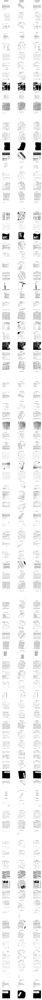

In [18]:
num_images = 100

display_examples(
    model, 
    test_filenames,
    num_images=num_images,
    size=(224, 224),
    crop_center=True,
    crop_largest_rect=True,
    preprocess_func=preprocess_input,
)

In [83]:
import numpy as np

In [83]:
absolute_path

'/home/paperspace/images/imagesa/a/a/a/aaa06d00/50486482-6482.tif'

In [75]:

img=cv2.imread(absolute_path)

In [76]:
img

In [90]:
img=cv2.imread('/home/paperspace/rvl-cdip/images/imagesk/k/o/j/koj64e00/1001817070_1001817074.tif')

In [91]:
img

array([[[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       ...,

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]],

       [[255, 255, 255],
        [255, 255, 255],
        [255, 255, 255],
        ...,
        [255, 255, 255],
        [255, 255, 255],
        [255, 255, 255]]

In [14]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = ""
import tensorflow as tf

from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())


[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 1722555419580896051
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 7563807949
locality {
  bus_id: 1
  links {
  }
}
incarnation: 18299400539384274558
physical_device_desc: "device: 0, name: Quadro P4000, pci bus id: 0000:00:05.0, compute capability: 6.1"
]


In [15]:
# Creates a graph.
a = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[2, 3], name='a')
b = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[3, 2], name='b')
c = tf.matmul(a, b)
# Creates a session with log_device_placement set to True.
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))
# Runs the op.
print(sess.run(c))

[[22. 28.]
 [49. 64.]]


In [18]:
import tensorflow as tf

In [19]:
# Creates a graph.
with tf.device('/cpu:0'):
  a = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[2, 3], name='a')
  b = tf.constant([1.0, 2.0, 3.0, 4.0, 5.0, 6.0], shape=[3, 2], name='b')
c = tf.matmul(a, b)
# Creates a session with log_device_placement set to True.
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))
# Runs the op.
print(sess.run(c))

[[22. 28.]
 [49. 64.]]


In [23]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
session = tf.Session(config=config)

In [33]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 6413832427670120678
, name: "/device:GPU:0"
device_type: "GPU"
memory_limit: 7574641050
locality {
  bus_id: 1
  links {
  }
}
incarnation: 3180013547586313028
physical_device_desc: "device: 0, name: Quadro P4000, pci bus id: 0000:00:05.0, compute capability: 6.1"
]


In [19]:
config.gpu_options.allow_growth = True


NameError: name 'config' is not defined

In [14]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 15901356172768689351
]


In [27]:
sess = tf.Session(config=tf.ConfigProto(log_device_placement=True))

In [28]:
sess

In [15]:
from keras import backend as K
K.tensorflow_backend._get_available_gpus()

[]

In [3]:
# Assume that you have 12GB of GPU memory and want to allocate ~4GB:
gpu_options = tf.GPUOptions(per_process_gpu_memory_fraction=0.8)

sess = tf.Session(config=tf.ConfigProto(gpu_options=gpu_options))

In [1]:
import tensorflow as tf

ModuleNotFoundError: No module named 'tensorflow'

In [16]:
from tensorflow.python.client import device_lib
print(device_lib.list_local_devices())

[name: "/device:CPU:0"
device_type: "CPU"
memory_limit: 268435456
locality {
}
incarnation: 2125473826885754399
]


In [30]:
from __future__ import print_function

import os
import cv2
import numpy as np
import argparse

from keras.applications.imagenet_utils import preprocess_input
from keras.models import load_model

#from utils import RotNetDataGenerator, crop_largest_rectangle, angle_error, rotate


def process_images(model, input_path, output_path,
                   batch_size=64, crop=True):
    extensions = ['.jpg', '.jpeg', '.bmp', '.png','.tif']

    output_is_image = False
    if os.path.isfile(input_path):
        image_paths = [input_path]
        if os.path.splitext(output_path)[1].lower() in extensions:
            output_is_image = True
            output_filename = output_path
            output_path = os.path.dirname(output_filename)
    else:
        image_paths = [os.path.join(input_path, f)
                       for f in os.listdir(input_path)
                       if os.path.splitext(f)[1].lower() in extensions]
        if os.path.splitext(output_path)[1].lower() in extensions:
            print('Output must be a directory!')

    predictions = model.predict_generator(
        RotNetDataGenerator(
            image_paths,
            input_shape=(224, 224, 3),
            batch_size=64,
            one_hot=True,
            preprocess_func=preprocess_input,
            rotate=False,
            crop_largest_rect=True,
            crop_center=True
        ),
        val_samples=len(image_paths)
    )

    predicted_angles = np.argmax(predictions, axis=1)

    if output_path == '':
        output_path = '.'

    if not os.path.exists(output_path):
        os.makedirs(output_path)

    for path, predicted_angle in zip(image_paths, predicted_angles):
        image = cv2.imread(path)
        rotated_image = rotate(image, -predicted_angle)
        if crop:
            size = (image.shape[0], image.shape[1])
            rotated_image = crop_largest_rectangle(rotated_image, -predicted_angle, *size)
        if not output_is_image:
            output_filename = os.path.join(output_path, os.path.basename(path))
        cv2.imwrite(output_filename, rotated_image)


if __name__ == '__main__':
    parser = argparse.ArgumentParser()
    parser.add_argument('model', help='Path to model')
    parser.add_argument('input_path', help='Path to image or directory')
    parser.add_argument('-o', '--output_path', help='Output directory')
    parser.add_argument('-b', '--batch_size', help='Batch size for running the network')
    parser.add_argument('-c', '--crop', dest='crop', default=False, action='store_true',
                        help='Crop out black borders after rotating')
    args = parser.parse_args()

    print('Loading model...')
    model_location = load_model(args.model, custom_objects={'angle_error': angle_error})
    output_path = args.output_path if args.output_path else args.input_path

    print('Processsing input image(s)...')
    process_images(model_location, args.input_path, output_path,
                   args.batch_size, args.crop)

usage: ipykernel_launcher.py [-h] [-o OUTPUT_PATH] [-b BATCH_SIZE] [-c]
                             model input_path
ipykernel_launcher.py: error: the following arguments are required: input_path


SystemExit: 2

/home/paperspace/anaconda3/lib/python3.6/site-packages/IPython/core/interactiveshell.py:2971: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


In [13]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

from __future__ import print_function

import os
import sys
import matplotlib.pyplot as plt

from keras.applications.imagenet_utils import preprocess_input
from keras.models import load_model

sys.path.append('..')
#from utils import display_examples, RotNetDataGenerator, angle_error
#from data.street_view import get_filenames

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [24]:
street_view_dir = os.path.join('..', 'data', 'street_view')

if os.path.exists(street_view_dir):
    test_filenames = get_filenames(street_view_dir)[1]
else:
    test_examples_path = os.path.join('..', 'data', 'test_examples')
    test_filenames = [
        os.path.join(test_examples_path, f) for f in os.listdir(test_examples_path)
    ]

FileNotFoundError: [Errno 2] No such file or directory: '../data/test_examples'

In [25]:
model_location=r"/home/paperspace/models/rotnet_street_view_resnet50.hdf5"
model = load_model(model_location, custom_objects={'angle_error': angle_error})

In [26]:
batch_size = 64
out = model.evaluate_generator(
    RotNetDataGenerator(
        test_filenames,
        input_shape=(224, 224, 3),
        batch_size=batch_size,
        preprocess_func=preprocess_input,
        crop_center=True,
        crop_largest_rect=True,
        shuffle=True
    ),
    steps=len(test_filenames) / batch_size
)

print('Test loss:', out[0])
print('Test angle error:', out[1])

Test loss: 1.0442166084527051
Test angle error: 8.180340739577609


In [85]:
out

[2.115520258624447, 19.785644186229096]

In [79]:
num_images = 30

display_examples(
    model, 
    test_filenames,
    num_images=num_images,
    size=(224, 224),
    crop_center=True,
    crop_largest_rect=True,
    preprocess_func=preprocess_input,
)

AttributeError: 'numpy.ndarray' object has no attribute 'append'

In [32]:
test_filenames


['/home/paperspace/rvl-cdip/images/imagesp/p/b/b/pbb60d00/517513462+-3463.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/b/pbb65e00/2046474778.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj98d00/50376887-6888.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj06d00/50504802-4803.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj32e00/2062100711.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj52e00/2040573212.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj84a00/2500072617_2624.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj66c00/2074660223.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj77d00/2076128551.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj82f00/tob07810.38.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj67d00/2042507082_7085.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj70d00/524113103+-3105.tif',
 '/home/paperspace/rvl-cdip/images/imagesp/p/b/j/pbj51f00/0000949113.tif'